## TOC:
* [Reading CVS files](#first-bullet)
* [Luminosity section](#second-bullet)
* [Trigger rate section](#third-bullet)
* [Model training section](#fourth-bullet)

In [1]:
import math
import numpy as np
import pandas as pd
import tensorflow as tf

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from mpl_toolkits.axes_grid1 import make_axes_locatable

from scipy import ndimage, misc
import datetime
from datetime import timedelta

import keras
from keras import backend as K
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.models import Sequential, load_model
from keras.layers import Dense, Flatten, Reshape, Conv1D, MaxPooling1D, AveragePooling1D,\
UpSampling1D, InputLayer

from scipy import ndimage, misc

from sklearn import svm
from sklearn.ensemble import IsolationForest
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, auc
from sklearn.model_selection import cross_val_score, train_test_split, StratifiedKFold, GridSearchCV
from sklearn.preprocessing import MaxAbsScaler
from sklearn.externals import joblib
#from sklearn.neighbors import LocalOutlierFactor
from sklearn import cluster, datasets

Using TensorFlow backend.


In [2]:
from pandas.tseries import converter
converter.register() 

/home/merve/anaconda3/envs/Env_Full/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: 'pandas.tseries.converter.register' has been moved and renamed to 'pandas.plotting.register_matplotlib_converters'. 
  


In [3]:
# Change presentation settings
%matplotlib inline

matplotlib.rcParams["figure.figsize"] = (15.0, 8.0)
matplotlib.rcParams["xtick.labelsize"] = 16
matplotlib.rcParams["ytick.labelsize"] = 16
matplotlib.rcParams["axes.spines.left"] = True
matplotlib.rcParams["axes.spines.bottom"] = True
matplotlib.rcParams["axes.spines.right"] = True
matplotlib.rcParams["axes.spines.top"] = True
matplotlib.rcParams["axes.titlesize"] = 16
matplotlib.rcParams["figure.titlesize"] = 16
matplotlib.rcParams["axes.labelsize"] = 14
matplotlib.rcParams["legend.fontsize"] = 14

In [4]:
import os
cwd = os.getcwd()
print (cwd)

/home/merve/working/RPCTriggerRateMonitoringWithML


In [5]:
#runs = [297179, 297180, 297181]
runs = [297219]
lumi_directory = "./lumi"
rates_directory = "./rates"
runs_ref = [306125]
#runs_ref = [304144]
lumi_directory_ref = "/home/merve/working/RPCTriggerRateMonitoringWithML/lumi"
rates_directory_ref = "/home/merve/working/RPCTriggerRateMonitoringWithML/rates"

# Reading cvs files <a class="anchor" id="first-bullet"></a>

Reading instantaneous luminosities from the cvs file produced with brilcalc and saving into a pandas dataframe:

In [6]:
df_rates = pd.DataFrame()
int_lumi2 = pd.DataFrame()
for run in runs:
    print("Loading %s" % run)
    path = "%s/lumi_%s.csv" % (lumi_directory, run)
    int_lumi2 = int_lumi2.append(pd.read_csv(path,
        names=["runfill", "ls", "time", "beamstatus", "energy", "delivered",\
               "recorded", "avgpu", "source"]), 
        ignore_index=True);    
    path = "%s/dt_rates_%s.csv" % (rates_directory, run)
    df_rates = df_rates.append(pd.read_csv(path, 
        names=["run", "time", "board", "RPC1", "RPC2", "RPC3", "RPC4",\
               "DT1", "DT2", "DT3", "DT4", "DT5"]), 
        ignore_index=True);
print("Done.")

Loading 297219
Done.


In [7]:
for run in runs_ref:
    print("Loading %s" % run)
    path = "%s/lumi_%s.csv" % (lumi_directory_ref, run)
    int_lumi2 = int_lumi2.append(pd.read_csv(path,
        names=["runfill", "ls", "time", "beamstatus", "energy", "delivered", "recorded", "avgpu", "source"]), 
        ignore_index=True);    
    path = "%s/dt_rates_%s.csv" % (rates_directory_ref, run)
    df_rates = df_rates.append(pd.read_csv(path, 
        names=["run", "time", "board", "RPC1", "RPC2", "RPC3", "RPC4",\
               "DT1", "DT2", "DT3", "DT4", "DT5"]), 
        ignore_index=True);
print("Done.")

Loading 306125
Done.


# Luminosity section <a class="anchor" id="second-bullet"></a>

Dropping useless rows inherited from the lumi CVS file:

In [8]:
int_lumi2["source"] = int_lumi2["source"].astype('str')
int_lumi2 = int_lumi2[int_lumi2["source"] != "nan"]
int_lumi2 = int_lumi2[int_lumi2["source"] != "source"]

Splitting run:fill field and the start and end lumi sections:

In [9]:
int_lumi2['run'], int_lumi2['fill'] = int_lumi2['runfill'].str.split(':', 1).str
int_lumi2['ls_start'], int_lumi2['ls_end'] = int_lumi2['ls'].str.split(':', 1).str

Converting run to integer and luminosities to float:

In [10]:
int_lumi2["run"] = int_lumi2["run"].astype('int')
int_lumi2["ls_start"] = int_lumi2["ls_start"].astype('int')
int_lumi2["ls_end"] = int_lumi2["ls_end"].astype('int')
int_lumi2["delivered"] = int_lumi2["delivered"].astype('float64')
int_lumi2["recorded"] = int_lumi2["recorded"].astype('float64') 

Converting time stamp to datetime:

In [11]:
def transform_time(data):
    from datetime import datetime
    time_str = data.time
    #print time_str
    datetime_object = datetime.strptime(time_str, "%m/%d/%y %H:%M:%S")
    #print datetime_object
    return datetime_object
int_lumi2["time"] = int_lumi2.apply(transform_time, axis=1);

Creating end time column from the start time:

In [12]:
int_lumi2["time_end"] = int_lumi2["time"]

Finding the runs and their start and end times:

In [13]:
boundaries = pd.DataFrame(columns=["run", "start", "end", "ls_start", "ls_end", "nLS"])
for i in runs+runs_ref:
    start = int_lumi2[int_lumi2["run"] == i]["time"]
    end = int_lumi2[int_lumi2["run"] == i]["time_end"]
    start_ls = int_lumi2[int_lumi2["run"] == i]["ls_start"]
    end_ls = int_lumi2[int_lumi2["run"] == i]["ls_end"]
    start =  start.reset_index(drop=True)
    end =  end.reset_index(drop=True)
    start_ls =  start_ls.reset_index(drop=True)
    end_ls =  end_ls.reset_index(drop=True)
    nLS = int(start_ls.iloc[-1]) - int(start_ls.iloc[0]) + 1
    print (i, start.iloc[0], start.iloc[-1], start_ls.iloc[0], start_ls.iloc[-1], nLS)
    boundaries = boundaries.append({"run": i, "start": start.iloc[0], "end": start.iloc[-1], 
                                   "ls_start": start_ls.iloc[0], "ls_end": start_ls.iloc[-1],\
                                    "nLS": nLS}, ignore_index = True)

297219 2017-06-20 14:26:08 2017-06-21 07:52:24 1 2694 2694
306125 2017-11-03 14:46:12 2017-11-04 10:14:06 1 3007 3007


In [14]:
boundaries = boundaries.sort_values('run')
boundaries = boundaries.reset_index()

Reindexing the dataframe after removing some lines:

In [15]:
int_lumi2.index = pd.RangeIndex(len(int_lumi2.index))

In [16]:
print (len(int_lumi2.index))

5701


Filling end time column:

In [17]:
def addTimeOffSet(startdate):
    enddate = pd.to_datetime(startdate) + pd.DateOffset(seconds=23)
    return enddate

def shiftElement(df, boundaries):
    run0 = boundaries["run"].iloc[0]
    for index, rows in df.iterrows():
        run = rows["run"]
        nls = int(boundaries[boundaries["run"] == run]["nLS"])
        if(run > run0):
            nls = nls + index
        #print run, nls
        if((index < nls) & (index < len(int_lumi2.index)-1)):
            #print index, run, rows["time"], df["time"][index+1]
            df.loc[index, "time_end"] = df["time"][index+1]
        elif (index == len(int_lumi2.index)-1):
            #print index, run, rows["time"], addTimeOffSet(rows["time"])
            df.loc[index, "time_end"] = addTimeOffSet(rows["time"])
                    
shiftElement(int_lumi2, boundaries)

Selecting only beam status STABLE BEAM:

In [18]:
#print int_lumi2["beamstatus"]
int_lumi2 = int_lumi2[int_lumi2["beamstatus"] == "STABLE BEAMS"]

In [19]:
int_lumi2.to_csv("int_lumi2.csv", sep='\t')

Plotting the instantaneous luminosities:

In [20]:
def plot_inst_lumi(x_val, y_val, z_val, title):
    fig, ax = plt.subplots()
    plt.xlabel("Time")
    plt.ylabel(r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]")
    xfmt = mdates.DateFormatter('%y-%m-%d %H:%M:%S')
    ax.xaxis.set_major_formatter(xfmt)
    ax.grid()
    fig.autofmt_xdate()
    plt.plot(x_val, y_val, 'ro-')
    plt.plot(x_val, z_val, 'bo-')
    plt.title(title)
    plt.legend(loc="best")
    plt.show();

In [21]:
#plot_inst_lumi(int_lumi2[int_lumi2["run"] == 297179]["time"], 
              # int_lumi2[int_lumi2["run"] == 297179]["delivered"], 
              # int_lumi2[int_lumi2["run"] == 297179]["recorded"], 
              # ("Instantaneous Luminosity for Run / Fill: %s / %s" % 
              # ("297179", int_lumi2["fill"].iloc[0])))

In [22]:
#plot_inst_lumi(int_lumi2[int_lumi2["run"] == 297180]["time"], 
              # int_lumi2[int_lumi2["run"] == 297180]["delivered"], 
              # int_lumi2[int_lumi2["run"] == 297180]["recorded"], 
              # ("Instantaneous Luminosity for Run / Fill: %s / %s" % 
              # ("297180", int_lumi2["fill"].iloc[0])))

In [23]:
#plot_inst_lumi(int_lumi2[int_lumi2["run"] == 297181]["time"], 
              # int_lumi2[int_lumi2["run"] == 297181]["delivered"], 
              # int_lumi2[int_lumi2["run"] == 297181]["recorded"], 
              # ("Instantaneous Luminosity for Run / Fill: %s / %s" % 
              # ("297181", int_lumi2["fill"].iloc[0])))

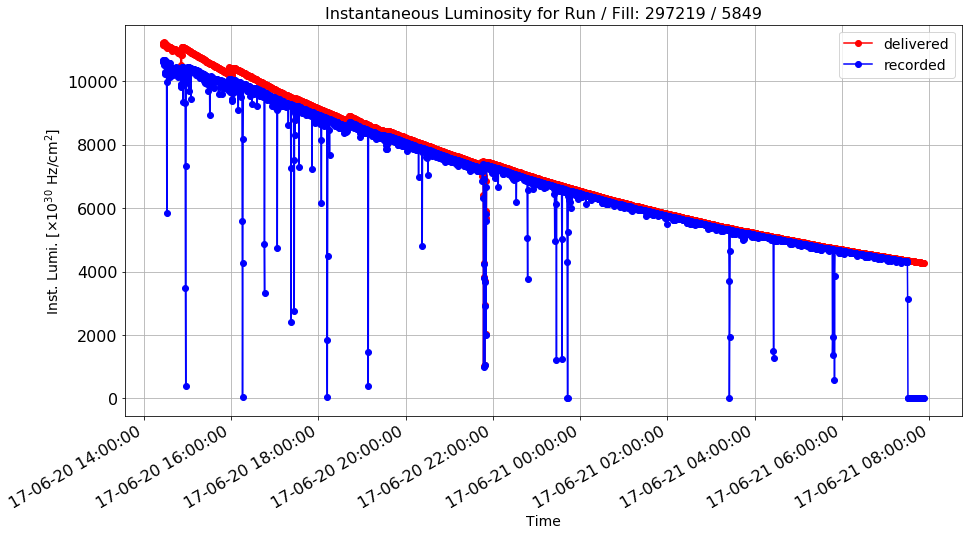

In [24]:
plot_inst_lumi(int_lumi2[int_lumi2["run"] == 297219]["time"], 
               int_lumi2[int_lumi2["run"] == 297219]["delivered"], 
               int_lumi2[int_lumi2["run"] == 297219]["recorded"], 
               ("Instantaneous Luminosity for Run / Fill: %s / %s" % 
               ("297219", int_lumi2["fill"].iloc[0])))

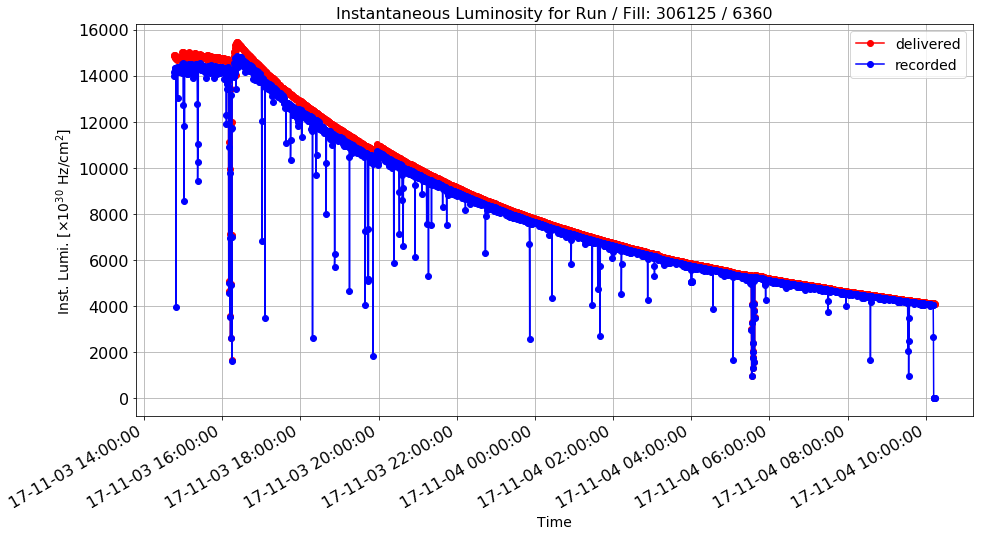

In [25]:
plot_inst_lumi(int_lumi2[int_lumi2["run"] == 306125]["time"], 
               int_lumi2[int_lumi2["run"] == 306125]["delivered"], 
               int_lumi2[int_lumi2["run"] == 306125]["recorded"], 
               ("Instantaneous Luminosity for Run / Fill: %s / %s" % 
               ("306125", int_lumi2[int_lumi2.run == 306125]["fill"].iloc[0])))

# Trigger rate section <a class="anchor" id="third-bullet"></a>

Converting columns to proper data types:

In [26]:
df_rates["time"] = pd.to_datetime(df_rates["time"])
df_rates["run"] = df_rates["run"].astype('int')
#print df_rates["time"]

Splitting, converting and adding new columns:

In [27]:
df_rates['wheel'], df_rates['sector'] = df_rates['board'].str.split('_', 1).str
df_rates["wheel"] = df_rates["wheel"].astype(str)
df_rates["sector"] = df_rates["sector"].astype(str)

In [28]:
df_rates["wheel"].replace(regex=True,inplace=True,to_replace=r'YB',value=r'')
df_rates["sector"].replace(regex=True,inplace=True,to_replace=r'S',value=r'')
df_rates["wheel"] = df_rates["wheel"].astype('int')
df_rates["sector"] = df_rates["sector"].astype('int')
df_rates["ls"] = -1
df_rates["lumi"] = -1.0
df_rates["score"] = -1
df_rates.to_csv("df_rates.csv", sep='\t')

Plotting the rate coming from one of the stations:

In [29]:
def plot_rate_vs_time(df, x_val, y_val, z_val, title):
    df_temp = df.copy()
    crit = df_temp["board"] == z_val
    df_temp = df_temp[crit]
    fig, ax = plt.subplots()
    plt.xlabel("Time")
    plt.ylabel("Rate [Hz]")
    ax.xaxis_date()
    xfmt = mdates.DateFormatter('%d-%m-%y %H:%M:%S')
    ax.xaxis.set_major_formatter(xfmt)
    ax.grid()
    fig.autofmt_xdate()
    plt.plot(df_temp[x_val], df_temp[y_val], 'ro-')
    plt.title(title)
    plt.legend(loc="best")
    plt.show()

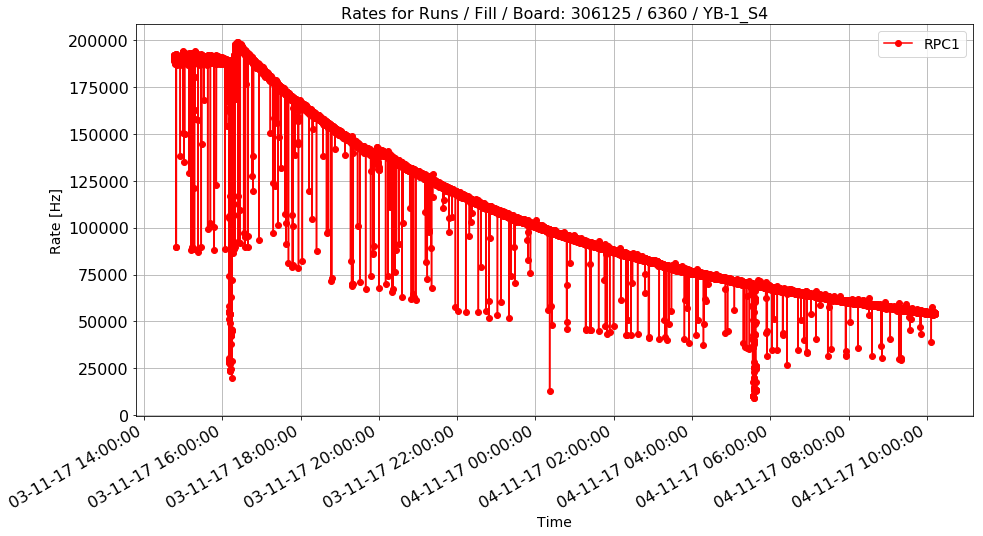

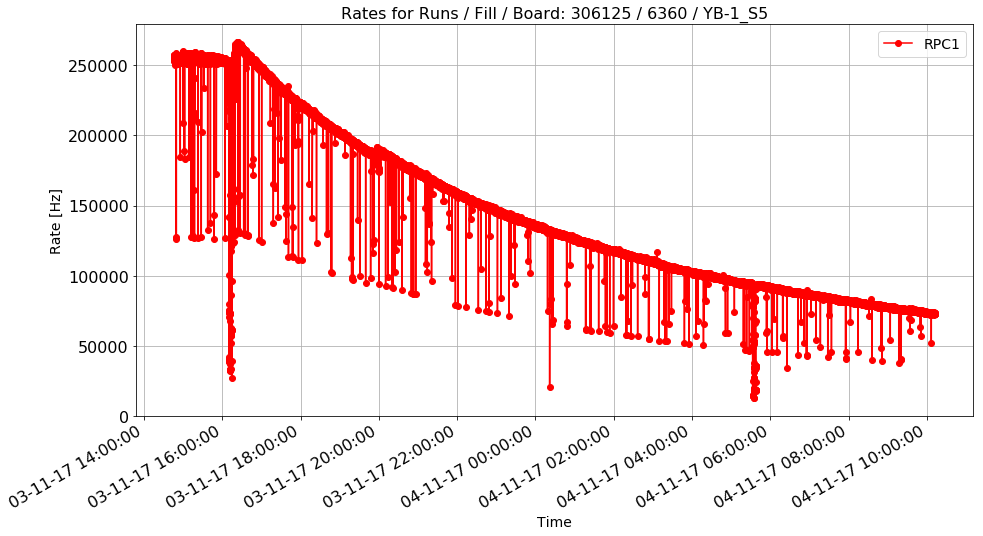

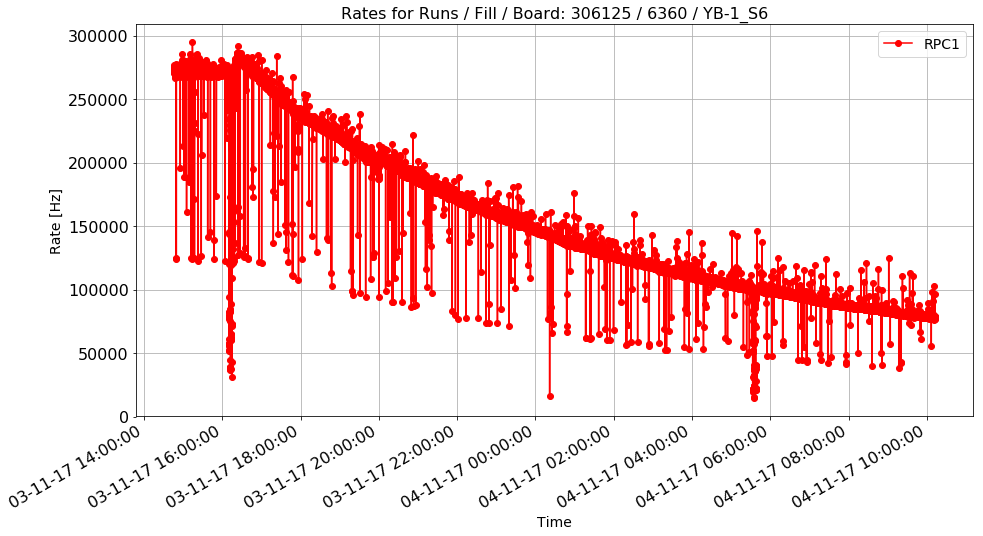

In [30]:
rule = (df_rates.run == 306125)
boards = ["YB-1_S4", "YB-1_S5", "YB-1_S6"]
for board in boards:
    plot_rate_vs_time(df_rates[rule],\
                      "time", "RPC1", board, "Rates for Runs / Fill / Board: %s / %s / %s" % 
                      ("306125", int_lumi2[int_lumi2.run == 306125]["fill"].iloc[0], board))

Associating a LS and an instantaneous luminosity to each rate:

In [31]:
#Just a backup copy
df_rates_backup = df_rates.copy()

In [32]:
#Uncomment to restore backup copy
#df_rates = df_rates_backup.copy()

Removing the measurements taken before and after the start and end time reported by the brilcalc output. All the 60 boards are measured at the same time. In order to speed-up the association, we take just one board, the first one. This reduces the dataframe and the time needed to go though it by a factor of 60.

In [33]:
time0 = boundaries["start"].iloc[0]
timeF = boundaries["end"].iloc[-1]
print (time0, timeF)
#print df_rates[(df_rates.time >= time0) & (df_rates.time <= timeF)]
df_rates = df_rates[(df_rates.time >= time0) & (df_rates.time <= timeF)]
rule = df_rates.duplicated(subset=["time"])
count = (rule == False).sum()
print ("Duplicates:", rule.sum())
df_rates_noduplicates = df_rates[rule == False]
#print df_rates_noduplicates

2017-06-20 14:26:08 2017-11-04 10:14:06
Duplicates: 1401486


In [34]:
print (len(df_rates_noduplicates))

23754


Assigning the LS and the inst. lumi. to the measurements for the selected board:

In [35]:
def assignLS(df1, df2, boundaries):
    temp = df1.copy()
    j = 1
    for index1, row1 in df1.iterrows():
        run1 = row1["run"]
        time1 = row1["time"]
        #print index1, run1, time1
        ti = time1 - 2*pd.DateOffset(seconds=23)
        tf = time1 + 2*pd.DateOffset(seconds=23)
        indexes2 = df2[(df2.run == run1) & (df2.time > ti) & (df2.time < tf)].index
        #print indexes2
        for i in indexes2:
            if((time1 >= df2["time"].loc[i]) & (time1 < df2["time_end"].loc[i])):
                #print time1, df2["time"].loc[i], df2["time_end"].loc[i]
                if(j%1000 == 0): 
                    print (j)
                j = j + 1
                ls = df2["ls_start"].loc[i]
                lumi = df2["delivered"].loc[i]
                #print index1, run1, time1, ls, lumi
                temp.loc[index1, "ls"] = ls
                temp.loc[index1, "lumi"] = lumi
                break
    return temp

temp = assignLS(df_rates_noduplicates, int_lumi2, boundaries)
df_rates_noduplicates = temp

1000
2000
3000
4000
5000
6000
7000
8000
9000
10000
11000
12000
13000
14000
15000
16000
17000
18000
19000
20000
21000
22000
23000


Removing the few cases not assigned and that are still at -1:

In [36]:
df_rates_noduplicates = df_rates_noduplicates[df_rates_noduplicates["ls"] > 0]
print (len(df_rates_noduplicates))

23750


Save in a csv file:

In [37]:
df_rates.to_csv("df_rates.csv", sep='\t')
df_rates_noduplicates.to_csv("df_rates_nodup.csv", sep='\t')

In [38]:
#Uncomment to restore backup copy
#df_rates = df_rates_backup.copy()

Assign the LS and the inst. lumi. to all the 60 boards for each time:

In [39]:
def assignLS_ext(df1, df2):
    temp = df1.copy()
    indexes = []
    for index in df2.index:
        if index%10000 == 0:
            print (index)
        time = df2["time"].loc[index]
        ls = df2["ls"].loc[index]
        lumi = df2["lumi"].loc[index]
        des = (temp["time"] == time)
        indexes = temp[des].index
        #print time, ls, indexes
        temp.loc[des, "ls"] = ls
        temp.loc[des, "lumi"] = lumi
    return temp
    
temp = assignLS_ext(df_rates, df_rates_noduplicates)

30000
60000
90000
120000
150000
180000
210000
240000
270000
300000
330000
360000
390000
420000
450000
480000
510000
540000
570000
600000
630000
660000
690000
720000
750000
780000
810000
840000
870000
900000
930000
960000
990000
1020000
1050000
1080000
1110000
1140000
1170000
1200000
1230000
1260000
1290000
1320000
1350000
1380000
1410000


In [40]:
df_rates = temp.copy()
#print df_rates[df_rates.ls <= 0]

Removing measurements without LS assignment:

In [41]:
df_rates_backup = df_rates.copy()
df_rates = df_rates[df_rates.ls > 0]
#print df_rates["ls"]

In [42]:
#print df_rates[df_rates.ls <= 0]
df_rates.to_csv("df_rates.csv", sep='\t')

Averaging the rates associated to the same LS:

In [43]:
df_boards = df_rates.copy()
df_boards = df_boards.groupby(['board']).size().reset_index(name='counts')
print (len(df_boards))
#print df_boards

60


Too slow to use all the measurements. Averaging over 10 LS:

In [44]:
#Uncomment to restore backup copy
#df_rates = df_rates_backup.copy()

In [45]:
#bunch = 10
bunch = 50
def assignGroup(data, div = bunch):
    res = int(data/div)
    #print data, res
    return res

df_rates["group"] = df_rates["ls"]
df_rates["group"] = df_rates["group"].apply(assignGroup)

In [46]:
#print df_rates["group"]

In [47]:
temp1 = df_rates.groupby(['run', 'group', 'board', 'wheel', 'sector'])\
[["ls", "lumi", "RPC1", "RPC2", "RPC3", "RPC4",\
  "DT1", "DT2", "DT3", "DT4", "DT5"]].mean().reset_index()

temp2 = df_rates.groupby(['run', 'group', 'board', 'wheel', 'sector'])\
[["lumi", "RPC1", "RPC2", "RPC3", "RPC4",\
  "DT1", "DT2", "DT3", "DT4", "DT5"]].std().reset_index()

temp3 = df_rates.groupby(['run', 'group', 'board', 'wheel', 'sector'])\
[["lumi", "RPC1", "RPC2", "RPC3", "RPC4",\
  "DT1", "DT2", "DT3", "DT4", "DT5"]].size().reset_index(name='counts')

temp2 = temp2.rename(index=str, columns={"lumi": "errLumi", "RPC1": "errRPC1", "RPC2": "errRPC2",\
                                         "RPC3": "errRPC3", "RPC4": "errRPC4", "DT1": "errDT1",\
                                         "DT2": "errDT2", "DT3": "errDT3", "DT4":\
                                         "errDT4", "DT5": "errDT5"})

cols_to_use2 = temp2.columns.difference(temp1.columns)
cols_to_use3 = temp3.columns.difference(temp1.columns)

temp2 = temp2[cols_to_use2]
temp3 = temp3[cols_to_use3]

#print temp1.iloc[100]
#print temp2.iloc[100]
#print temp3.iloc[100]

temp1.reset_index(drop=True, inplace=True)
temp2.reset_index(drop=True, inplace=True)
temp3.reset_index(drop=True, inplace=True)

df_rates = pd.concat([temp1, temp2, temp3], axis = 1)

Calculating the errors on the mean values calculated in the previous step:

In [48]:
import math
def applySqrt(data):
    return math.sqrt(data)

df_rates["counts"] = df_rates["counts"].apply(applySqrt)

for i in list(df_rates):
    if "err" in i:
        #print i
        df_rates[i] = df_rates[i]/df_rates["counts"]

In [49]:
#print df_rates

Check for null or NaN values:

In [50]:
print (df_rates.isnull().values.any())
null_columns=df_rates.columns[df_rates.isnull().any()]
print((df_rates[df_rates.isnull().any(axis=1)][null_columns].head()))
#df_rates = df_rates.fillna(0)
#print(df_rates[df_rates.isnull().any(axis=1)][null_columns].head())

False
Empty DataFrame
Columns: []
Index: []


In [51]:
#Another backup
#df_rates_backup = df_rates.copy()
df_rates.to_csv("df_rates.csv", sep='\t')

In [52]:
#Restore backup
#df_rates = df_rates_backup.copy()

In [53]:
print (len(df_rates))

6840


Uncomment to check just one case case:

In [54]:
#for index, row in df_rates.iterrows():
    #if row["board"] == "YB0_S1":
        #print "Index:", index,", Run:", row["run"],", Board: ",row["board"],",\
        #LS: ",row["ls"],", Rate: ",row["DT1"],", Error: ",row["errDT1"]

Plotting the result:

In [55]:
def plot_rate_vs_ls(df, run, x_val, y_val, z_val, x_err, y_err, title_x, title_y, title, opt, log,\
                    fit = True, fmin = 5000, fmax = 15000):
    df_temp = df.copy()
    fig, ax = plt.subplots()
    plt.xlabel(title_x)
    plt.ylabel(title_y)
    ax.grid()
    if log:
        ax.set_yscale('log')
    inter = []
    for i in range(len(run)):
        rule = ((df_temp["board"] == z_val) & (df_temp["run"] == run[i]))
        newstr = opt[i].replace("o", "")
        plt.errorbar(df_temp[rule][x_val], df_temp[rule][y_val], xerr=x_err,\
        yerr=df_temp[rule][y_err], fmt=opt[i], ecolor=newstr, label=str(run[i]))
        plt.legend(loc="best")
        
        if ((run[i] == 306125 ) & fit):
            rule2 = (df_temp[x_val] > fmin) & (df_temp[x_val] < fmax)
            val1 = df_temp[rule & rule2][x_val]
            val2 = df_temp[rule & rule2][y_val]
            coeff = np.polyfit(val1, val2, 1)
            inter.append(coeff)
            p = np.poly1d(coeff)
            xp = np.linspace(3000, 16000, 1000)
            _ = plt.plot(xp, p(xp), '-')
            print ("Linear fit parameters:", coeff)
        
    plt.title(title)
    plt.show()
    if ((run[i] == 306125) & fit):
        return inter[0]

Linear fit parameters: [  12.59668881 2451.89986378]


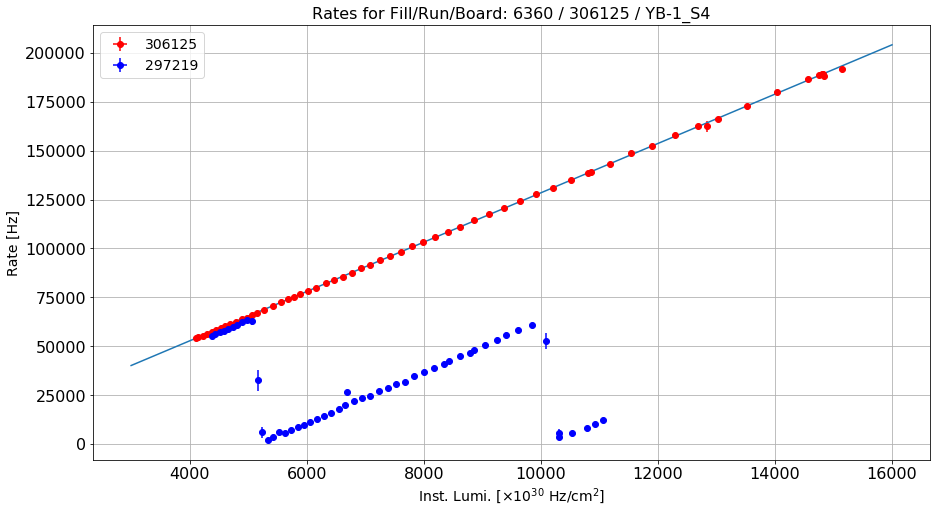

Linear fit parameters: [3.73126505e+00 6.10905559e+04]


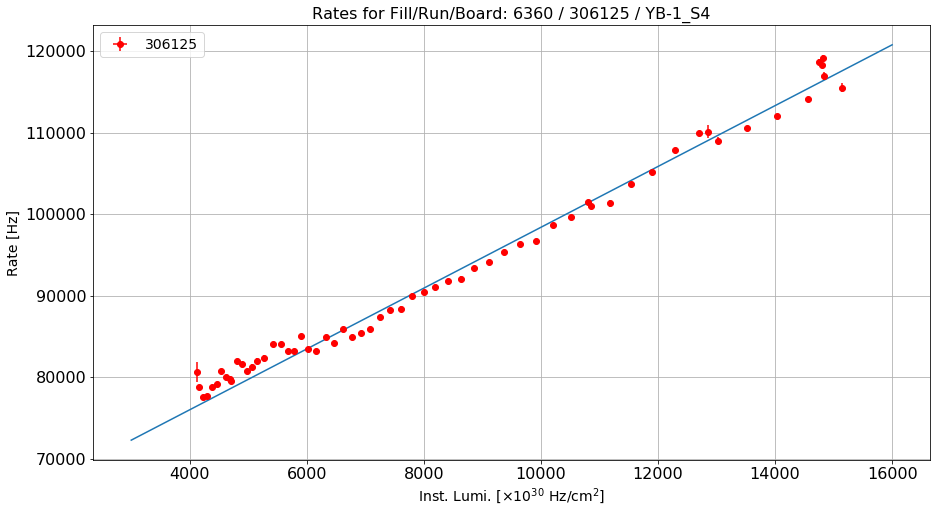

Linear fit parameters: [9.42529381e-01 1.42233967e+04]


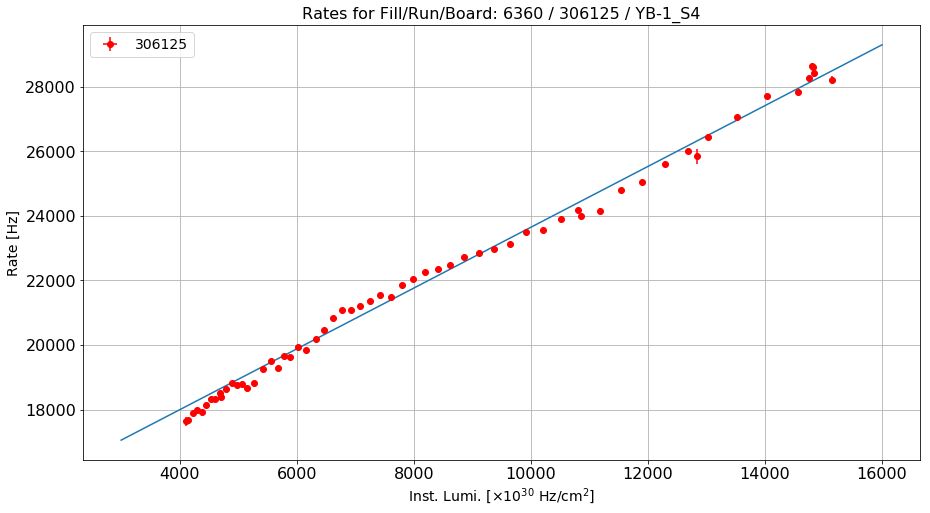

Linear fit parameters: [  28.34079322 8287.39325386]


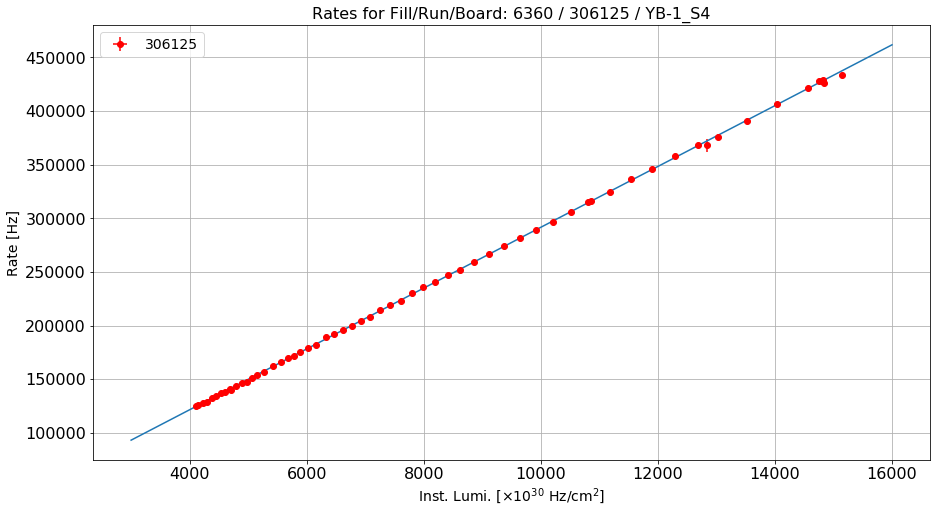

array([  28.34079322, 8287.39325386])

In [56]:
#boards = ["YB-1_S4", "YB-1_S5", "YB-1_S6"]    
    
title = "Rates for Fill/Run/Board: "+str(int_lumi2[int_lumi2.run == 306125]["fill"].iloc[0])+" / "\
+str(boundaries["run"].iloc[1])+" / YB-1_S4"

plot_rate_vs_ls(df_rates, [306125, 297219], "lumi", "RPC1", "YB-1_S4", 0, "errRPC1",\
                r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]",\
                "Rate [Hz]", title, ["ro", "bo"], False)
plot_rate_vs_ls(df_rates, [306125], "lumi", "RPC2", "YB-1_S4", 0, "errRPC2",\
                r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]",\
                "Rate [Hz]", title, ["ro"], False)
plot_rate_vs_ls(df_rates, [306125], "lumi", "RPC3", "YB-1_S4", 0, "errRPC3",\
                r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]",\
                "Rate [Hz]", title, ["ro"], False)
plot_rate_vs_ls(df_rates, [306125], "lumi", "RPC4", "YB-1_S4", 0, "errRPC4",\
                r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]",\
                "Rate [Hz]", title, ["ro"], False)

Create a new dataframe with the input features already organized in a numpy array:

In [57]:
print (len(df_rates))
algos = ['RPC1', 'RPC2', 'RPC3', 'RPC4']
df_rates_new_2 = pd.DataFrame(columns=['run', 'group', 'board', 'wheel', 'sector', 'ls',\
                                     'lumi', 'errLumi', 'rate', 'err', 'system', 'station'])

for i in algos:
    list_a = ['run', 'group', 'board', 'wheel', 'sector', 'ls', 'lumi', 'errLumi', i, 'err'+i,]
    temp = df_rates.copy()
    temp = temp[list_a]
    temp["system"] = -1
    temp["station"] = -1
    j = i
    if (i.find("RPC") != -1):
        temp["system"] = 1
        num = i.replace("RPC", "")
        temp["station"] = int(num)
    else:
        temp["system"] = 2
        num = i.replace("DT", "")
        temp["station"] = int(num)
    temp = temp.rename(columns={j: 'rate', 'err'+j: 'err'})
    #print temp.columns
    df_rates_new_2 = pd.concat([df_rates_new_2, temp], ignore_index=True)

print (len(df_rates_new_2))

6840
27360


Adding the lumi/rate ratio:

In [58]:
df_rates_new_2["CS"] = -1
df_rates_new_2["errCS"] = -1

df_rates_new_2["CS"] = df_rates_new_2["rate"]/df_rates_new_2["lumi"]
print ("Number of NaN's in CS before:")
print (len(df_rates_new_2["CS"][df_rates_new_2["CS"].isnull() == True]))
print ("Number of Inf's in CS before:")
print (len(df_rates_new_2["CS"][np.isinf(df_rates_new_2["CS"])]))

df_rates_new_2["CS"] = df_rates_new_2["CS"].replace([np.inf, -np.inf], np.nan)
df_rates_new_2["CS"] = df_rates_new_2["CS"].fillna(-1)

print ("Number of NaN's in CS after:")
print (len(df_rates_new_2["CS"][df_rates_new_2["CS"].isnull() == True]))
print ("Number of Inf's in CS after:")
print (len(df_rates_new_2["CS"][np.isinf(df_rates_new_2["CS"])]))

df_rates_new_2["errCS"] = (1/df_rates_new_2["lumi"])*\
np.sqrt(df_rates_new_2["err"]**2 + df_rates_new_2["CS"]**2 * df_rates_new_2["errLumi"]**2)

print ("Number of NaN's in errCS before:")
print (len(df_rates_new_2["errCS"][df_rates_new_2["errCS"].isnull() == True]))
print ("Number of Inf's in errCS before:")
print (len(df_rates_new_2["errCS"][np.isinf(df_rates_new_2["errCS"])]))

df_rates_new_2["errCS"] = df_rates_new_2["errCS"].replace([np.inf, -np.inf], np.nan)
df_rates_new_2["errCS"] = df_rates_new_2["errCS"].fillna(-1)

print ("Number of NaN's in errCS after:")
print (len(df_rates_new_2["errCS"][df_rates_new_2["errCS"].isnull() == True]))
print ("Number of Inf's in errCS after:")
print (len(df_rates_new_2["errCS"][np.isinf(df_rates_new_2["errCS"])]))

Number of NaN's in CS before:
0
Number of Inf's in CS before:
0
Number of NaN's in CS after:
0
Number of Inf's in CS after:
0
Number of NaN's in errCS before:
0
Number of Inf's in errCS before:
0
Number of NaN's in errCS after:
0
Number of Inf's in errCS after:
0


In [59]:
array = df_rates_new_2.as_matrix(columns=['system', 'wheel', 'sector', 'station',\
                                        'lumi', 'errLumi', 'rate', 'err',\
                                        'CS', 'errCS'])

/home/merve/anaconda3/envs/Env_Full/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """Entry point for launching an IPython kernel.


In [60]:
df_rates_new_2["content"] = np.empty((len(df_rates_new_2), 0)).tolist()
for index, rows in df_rates_new_2.iterrows():
    #print index, array[index]
    df_rates_new_2.at[index, "content"] = array[index]
df_rates_new_2["score"] = -1

Check if the two dataframes are exactly the same:

In [61]:
def plot_rate_vs_ls_2(df1, df2, x_val, y_val, x_err, y_err, title_x, title_y, title, opt, log = False):
    fig, ax = plt.subplots()
    plt.xlabel(title_x)
    plt.ylabel(title_y)
    ax.grid()
    if log:
        ax.set_yscale('log')
    plt.errorbar(df1[x_val], df1[y_val], xerr=x_err, yerr=df1[y_err], fmt='ro', ecolor='r')
    num = y_val
    num = num.replace("RPC", "")
    tmp = df2[df2.station == int(num)]
    plt.errorbar(tmp[x_val], tmp["rate"], xerr=x_err, yerr=tmp["err"], fmt='b+', ecolor='b')
    plt.title(title)
    plt.legend(loc="best")
    plt.show()

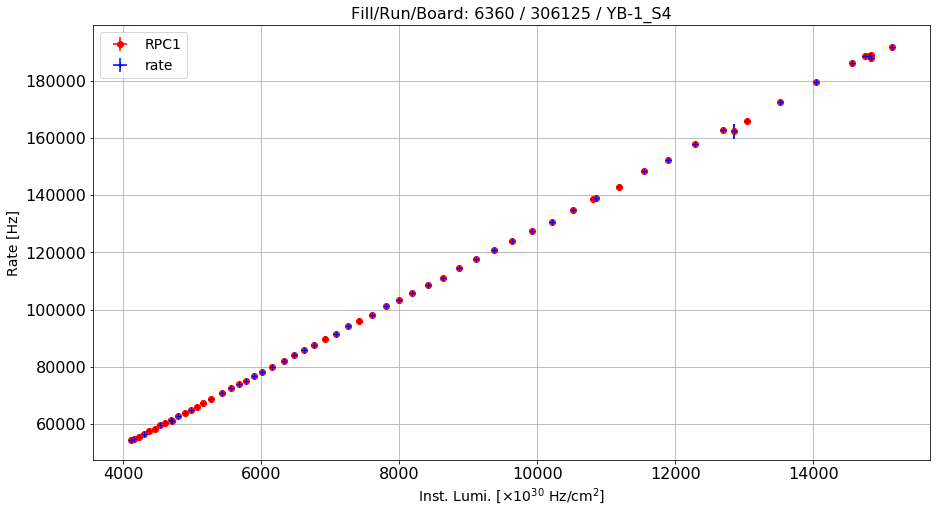

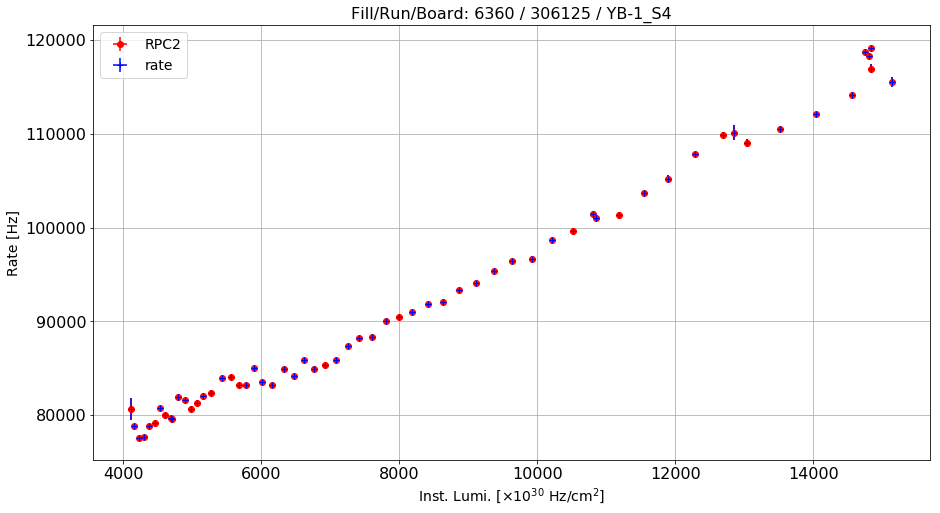

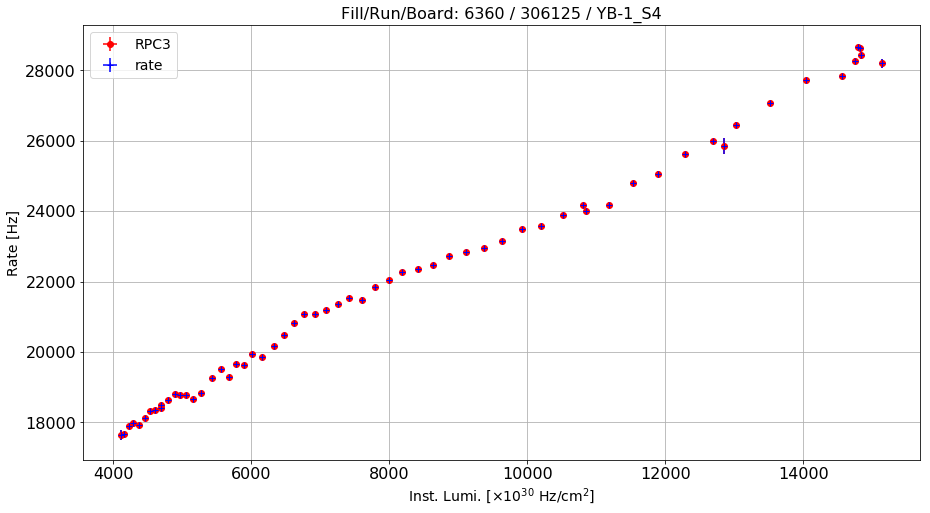

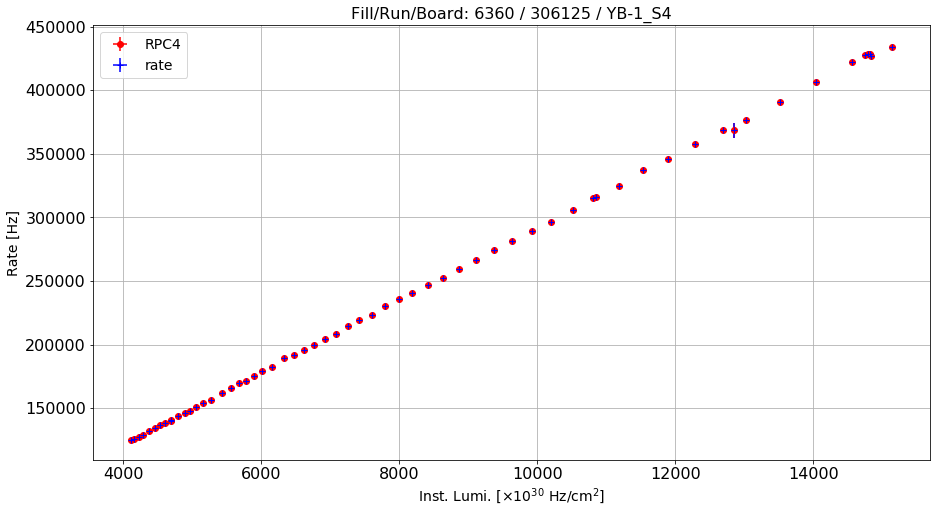

In [62]:
title = "Fill/Run/Board: "+str(int_lumi2[int_lumi2.run == 306125]["fill"].iloc[0])+\
" / "+str(boundaries["run"].iloc[1])+" / YB-1_S4"

rule_1 = ((df_rates["wheel"] == -1) & (df_rates["sector"] == 4) & (df_rates["run"] == 306125))
rule_2 = ((df_rates_new_2["wheel"] == -1) & (df_rates_new_2["sector"] == 4)\
          & (df_rates_new_2["run"] == 306125))

temp1 = df_rates[rule_1]
temp2 = df_rates_new_2[rule_2]

plot_rate_vs_ls_2(temp1, temp2, "lumi", "RPC1", 0, "errRPC1", r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]", 
                "Rate [Hz]", title, "ro")
plot_rate_vs_ls_2(temp1, temp2, "lumi", "RPC2", 0, "errRPC2", r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]", 
                "Rate [Hz]", title, "ro")
plot_rate_vs_ls_2(temp1, temp2, "lumi", "RPC3", 0, "errRPC3", r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]", 
                "Rate [Hz]", title, "ro")
plot_rate_vs_ls_2(temp1, temp2, "lumi", "RPC4", 0, "errRPC4", r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]", 
                "Rate [Hz]", title, "ro")

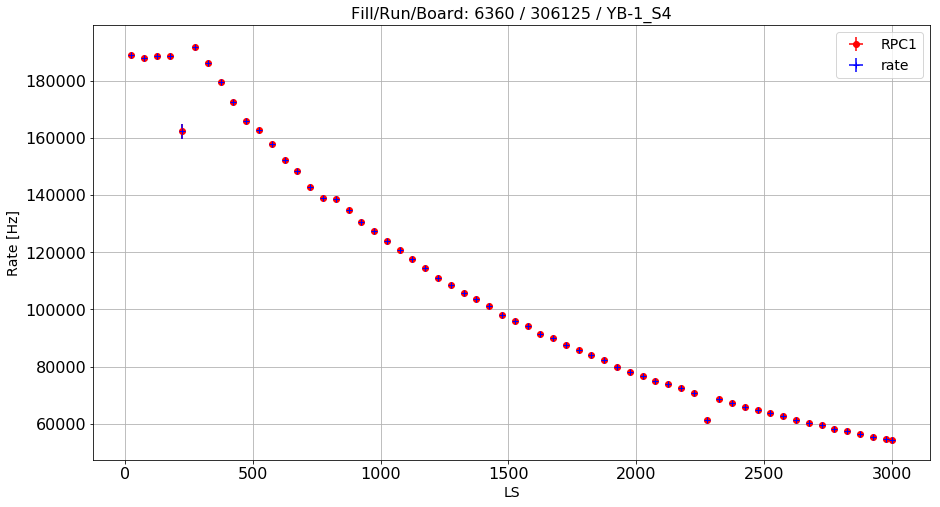

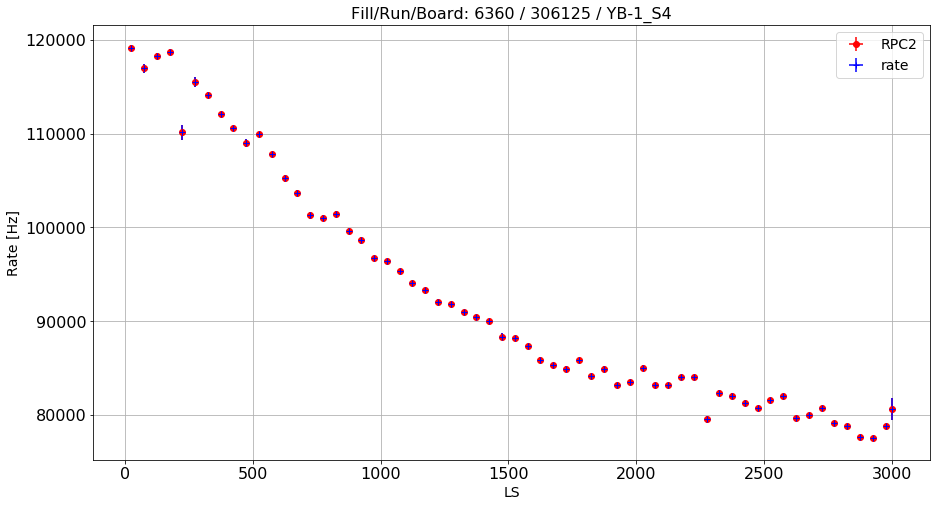

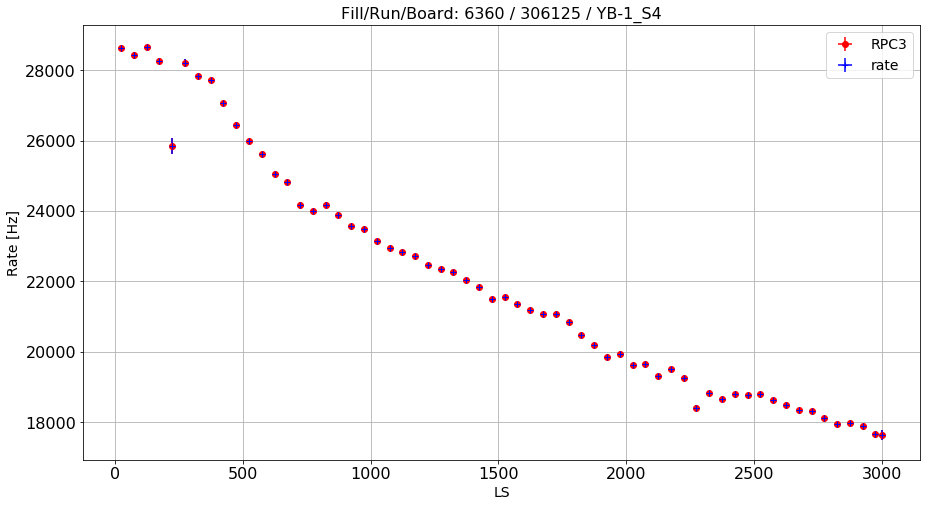

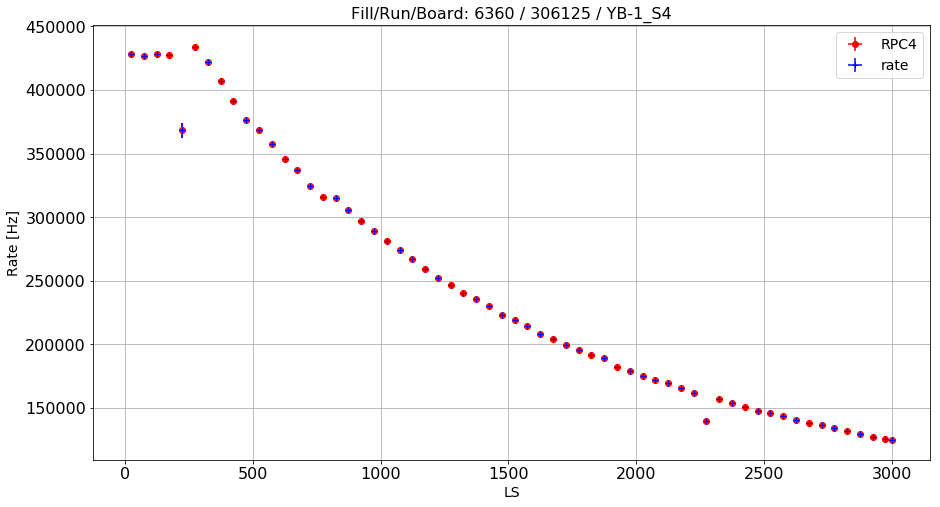

In [63]:
plot_rate_vs_ls_2(temp1, temp2, "ls", "RPC1", 0, "errRPC1", "LS", 
                "Rate [Hz]", title, "ro")
plot_rate_vs_ls_2(temp1, temp2, "ls", "RPC2", 0, "errRPC2", "LS", 
                "Rate [Hz]", title, "ro")
plot_rate_vs_ls_2(temp1, temp2, "ls", "RPC3", 0, "errRPC3", "LS", 
                "Rate [Hz]", title, "ro")
plot_rate_vs_ls_2(temp1, temp2, "ls", "RPC4", 0, "errRPC4", "LS", 
                "Rate [Hz]", title, "ro")

Checking cross-sections for some chambers:

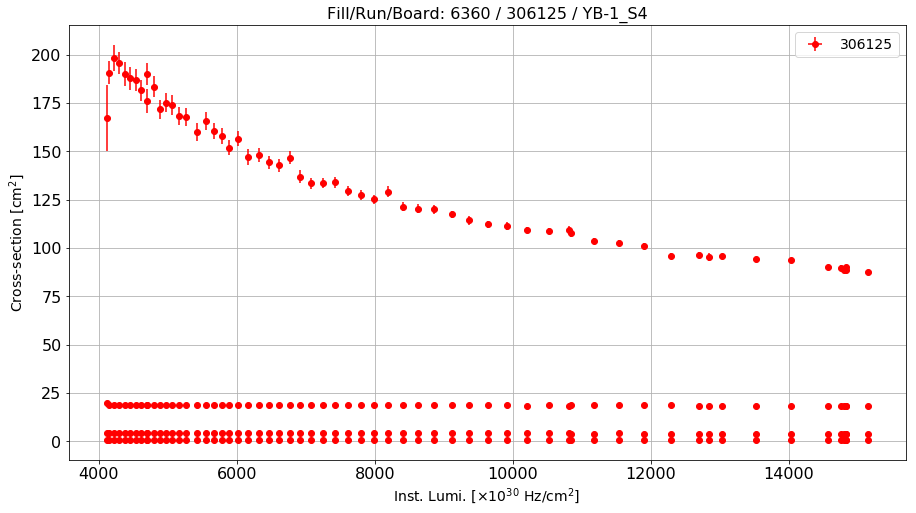

In [64]:
title = "Fill/Run/Board: "+str(int_lumi2[int_lumi2.run == 306125]["fill"].iloc[0])+\
" / "+str(boundaries["run"].iloc[1])+" / YB-1_S4"

plot_rate_vs_ls(df_rates_new_2, [306125], "lumi", "CS", "YB-1_S6", 0, "errCS",\
                r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]", 
                "Cross-section [cm$^{2}$]", title, ["ro"], False, False)

Defining the fit ranges for all the chambers:

In [65]:
df_rates_new_2["fmin"] = 5000
df_rates_new_2["fmax"] = 15000
df_rates_new_2["slope"] = 9999
df_rates_new_2["inter"] = 9999

In [66]:
def set_range(df, wh, sec, st, fmin, fmax):
    rule = (df_rates_new_2.wheel == wh) &\
           (df_rates_new_2.sector == sec) &\
           (df_rates_new_2.station == st)
    indexes = df[rule].index
    for m in indexes:
        df.loc[m, "fmin"] = fmin
        df.loc[m, "fmax"] = fmax

In [67]:
set_range(df_rates_new_2, -2, 7, 3, 5000, 10000)
set_range(df_rates_new_2, -2, 10, 3, 8000, 15000)
set_range(df_rates_new_2, 0, 3, 2, 5000, 12000)
set_range(df_rates_new_2, 0, 9, 2, 5000, 10000)
set_range(df_rates_new_2, +1, 8, 1, 6000, 15000)
set_range(df_rates_new_2, +1, 8, 3, 5000, 15000)

In [68]:
def plot_scatter_2(df, arg, wheel, norm = False, show = True, fit = False, fmin = 5000, fmax = 15000):
    wheel_s = "All"
    temp = df.copy()
    if wheel != -3:
        temp = temp[(temp["wheel"] == wheel)]
        wheel_s = str(wheel)
    else:
        return 1
    
    temp = temp.groupby(['run', 'wheel', 'sector', 'system', 'station'])\
    [[arg]].mean().reset_index()
    #print temp
    
    if fit:
        for j in range(1, 13):
            for k in range(1, 5):
    
                rule = (df.wheel == wheel) & (df.sector == j) & (df.station == k) & (df.system == 1)
                rule2 = (df.lumi > df.fmin) & (df.lumi < df.fmax)
                val1 = df[rule & rule2]["lumi"]
                val2 = df[rule & rule2]["rate"]
                coeff = np.polyfit(val1, val2, 1)
                #print "Linear fit parameters:", wheel, j, k, coeff[0]

                rule = (temp.sector == j) & (temp.station == k) & (temp.system == 1)
                ind = temp[rule].index
                temp.loc[ind[0], arg] = coeff[0]
                #print temp.loc[ind[0]]
    
    mat = []
    for i in [4, 3, 2, 1]:
        rule = (temp.station == i)
        temp2 = temp[rule].sort_values(["sector"], ascending=True)
        vec = list(temp2[arg].values)
        mat.append(vec)      
        #print i, temp[rule][arg].values
    if norm:
        mat = mat/np.matrix(mat).sum()
        mat = [100*i for i in mat]
    #print mat

    plt.figure()
    
    ax = plt.gca()
    ax.set_yticklabels(["1", "2", "3", "4"])
    ax.set_yticks([3, 2, 1, 0])
    ax.set_xticklabels(["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
    ax.set_xticks([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11])
    
    plt.xlabel("Sector")
    plt.ylabel("Station")
    title = "Wheel: "+wheel_s
    plt.title(title, loc="left")   

    im = ax.imshow(mat, interpolation="nearest")
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    
    if show:
        for i in range(0,4):
            for j in range(0,12):
                if (mat[i][j] == 0):
                    ax.text(j, i, -1,\
                    ha="center", va="center", color="r")
                else:
                    text = ax.text(j, i, round(mat[i][j], 2),\
                    ha="center", va="center", color="w")
    
    plt.colorbar(im, cax=cax, ticks=[np.min(np.nan_to_num(mat)), np.max(np.nan_to_num(mat))])
    plt.show()

Checking the slope of the rate vs. inst. lumi. for each chamber during the good reference run:

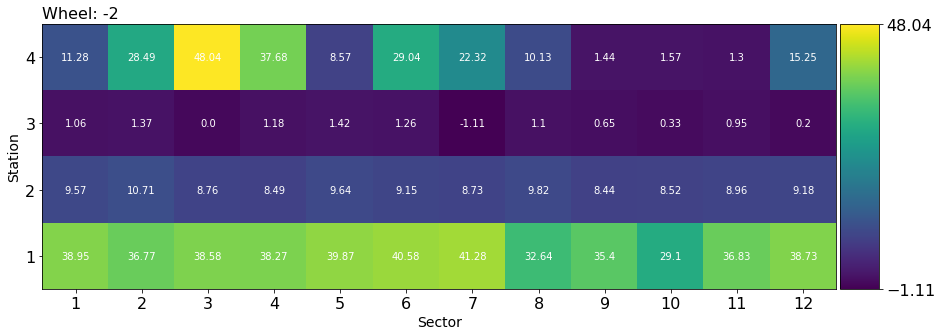

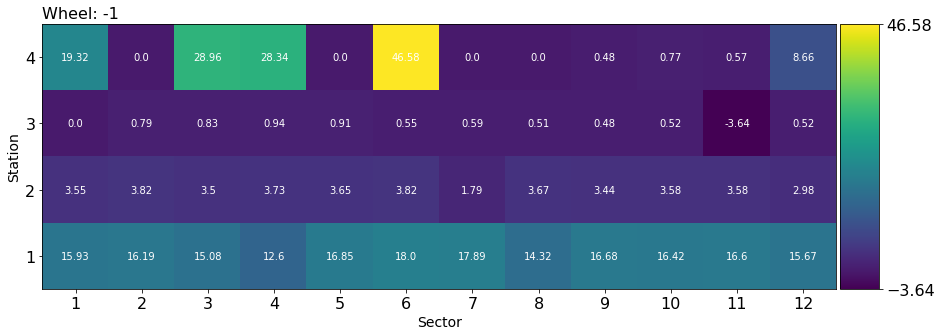

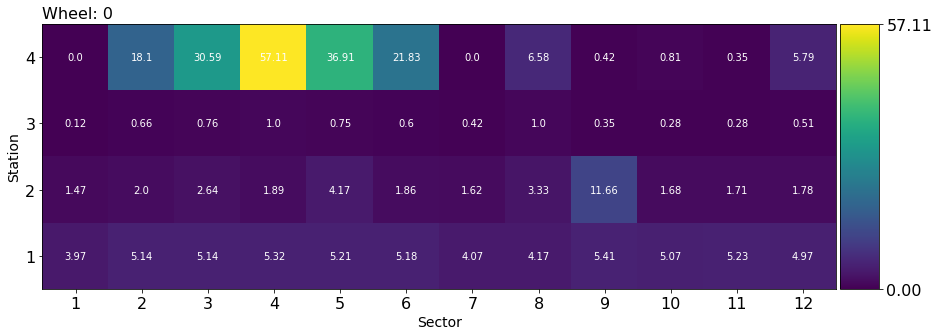

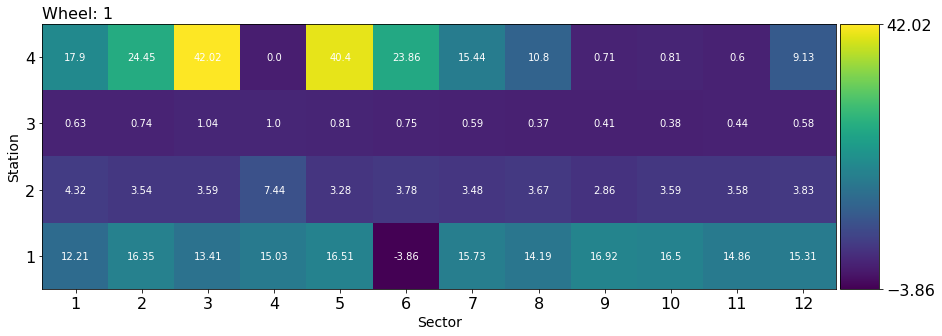

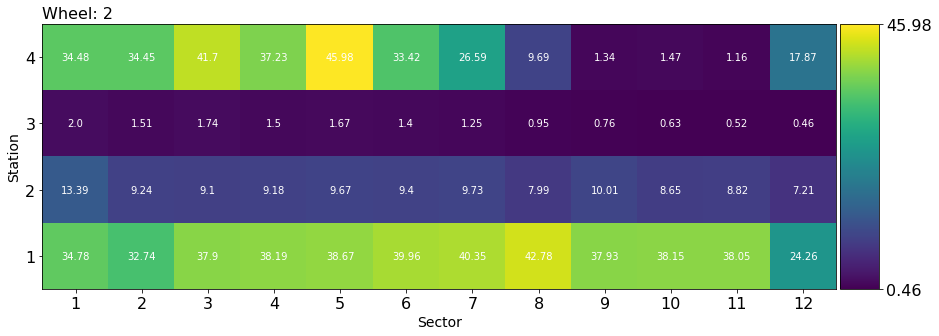

In [69]:
plot_scatter_2(df_rates_new_2[df_rates_new_2.run == 306125], "CS", -2, False, True, True)
plot_scatter_2(df_rates_new_2[df_rates_new_2.run == 306125], "CS", -1, False, True, True)
plot_scatter_2(df_rates_new_2[df_rates_new_2.run == 306125], "CS", 0, False, True, True)
plot_scatter_2(df_rates_new_2[df_rates_new_2.run == 306125], "CS", +1, False, True, True)
plot_scatter_2(df_rates_new_2[df_rates_new_2.run == 306125], "CS", +2, False, True, True)

Plotting the cross-sections for the good and anomalous runs on the same canvas:

In [70]:
def plot_ratio_vs_ls(df, run, x_val, y_val, z_val, x_err, y_err, title_x, title_y, title, opt, log,\
                     fit = False, fmin = 5000, fmax = 15000):
    df_temp = df.copy()
    fig, ax = plt.subplots()
    plt.xlabel(title_x)
    plt.ylabel(title_y)
    ax.grid()
    if log:
        ax.set_yscale('log')
    df_temp["ratio"] = df_temp[y_val]/df_temp[x_val]
    df_temp["errRatio"] = (1/df_temp[x_val])*\
    np.sqrt(df_temp[y_err]**2 + df_temp["errLumi"]**2*df_temp["ratio"]**2)
    inter = []
    for i in range(len(run)):
        rule = ((df_temp["board"] == z_val) & (df_temp["run"] == run[i]))
        
        if ((run[i] == 306125) & fit):
            rule2 = (df_temp[x_val] > fmin) & (df_temp[x_val] < fmax)
            val1 = df_temp[rule & rule2][x_val]
            val2 = df_temp[rule & rule2]["ratio"]
            coeff = np.polyfit(val1, val2, 2)
            inter.append(coeff)
            p = np.poly1d(coeff)
            xp = np.linspace(3000, 16000, 1000)
            _ = plt.plot(xp, p(xp), '-')
        
        newstr = opt[i].replace("o", "")
        plt.errorbar(df_temp[rule][x_val], df_temp[rule]["ratio"], xerr=x_err,\
        yerr=df_temp[rule]["errRatio"], fmt=opt[i], ecolor=newstr, label=str(run[i]))
        
    print ("Linear fit for the reference run:", inter[0])
    plt.legend(loc="best")
    plt.title(title)
    plt.show()

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S1_RB1
Linear fit for the reference run: [-3.15266036e-09 -1.27313394e-05  4.01847654e+01]


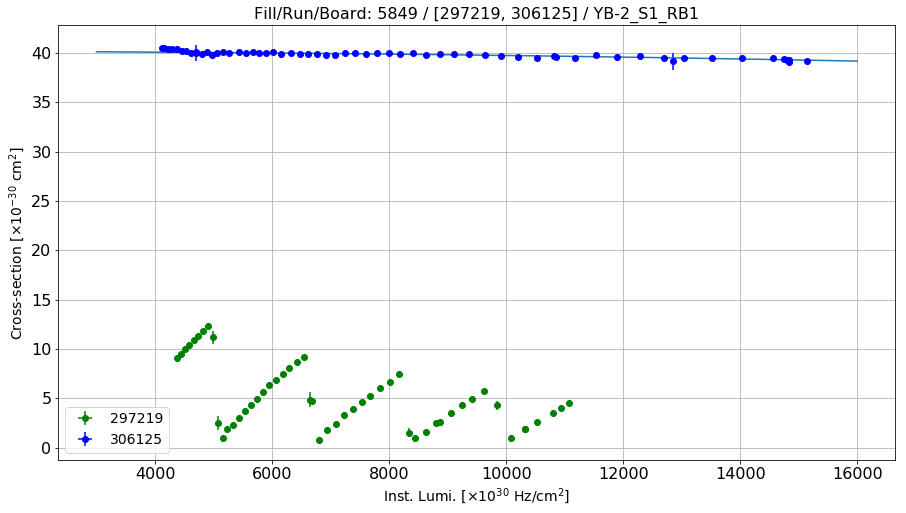

Linear fit parameters: [  38.94927231 6835.75861067]


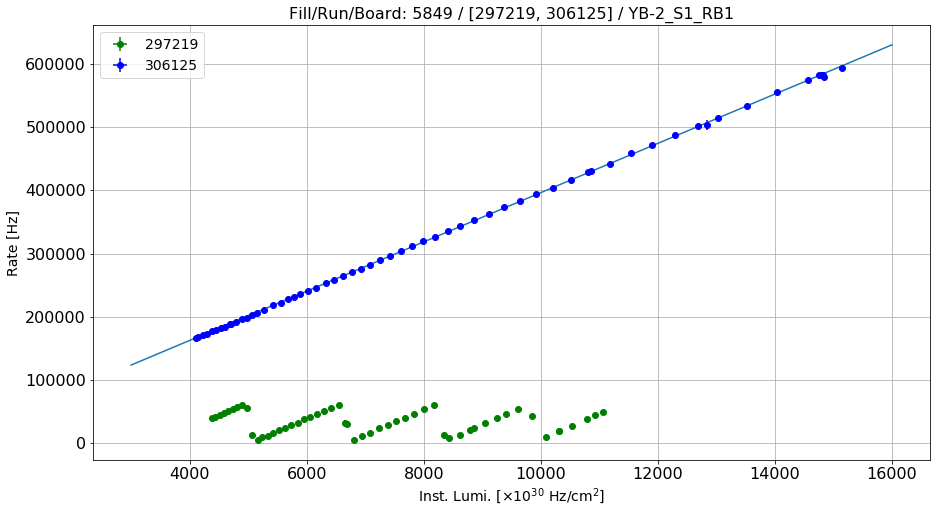

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S1_RB2
Linear fit for the reference run: [ 3.42357366e-09 -1.20465713e-04  1.08928164e+01]


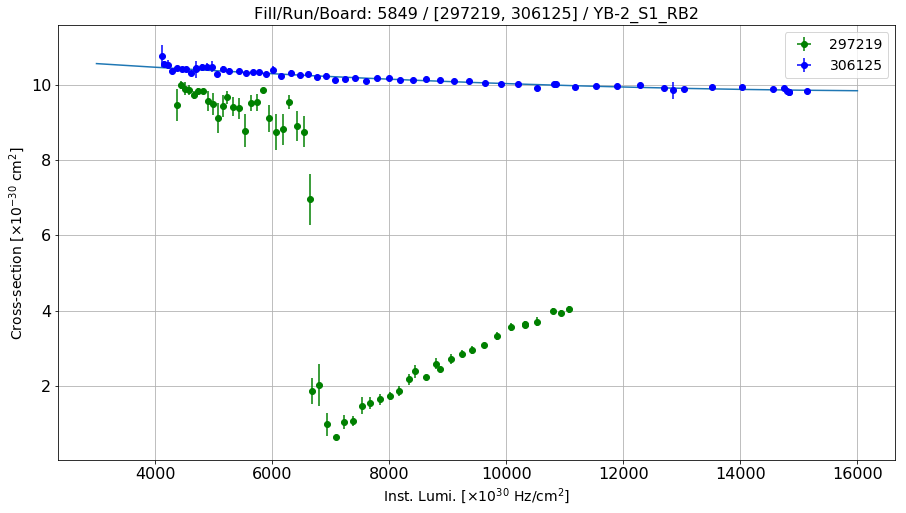

Linear fit parameters: [   9.57189766 4418.29297771]


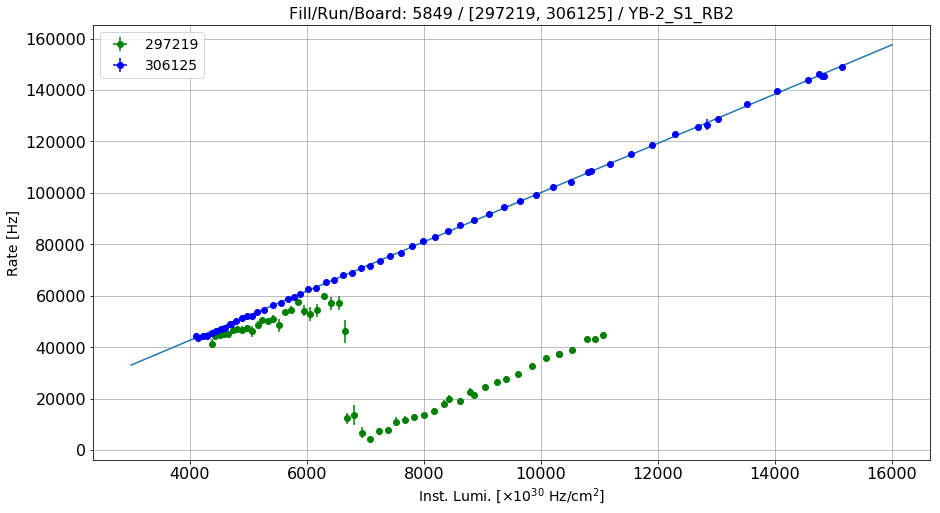

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S1_RB3
Linear fit for the reference run: [ 4.69336069e-09 -1.44393452e-04  2.45463011e+00]


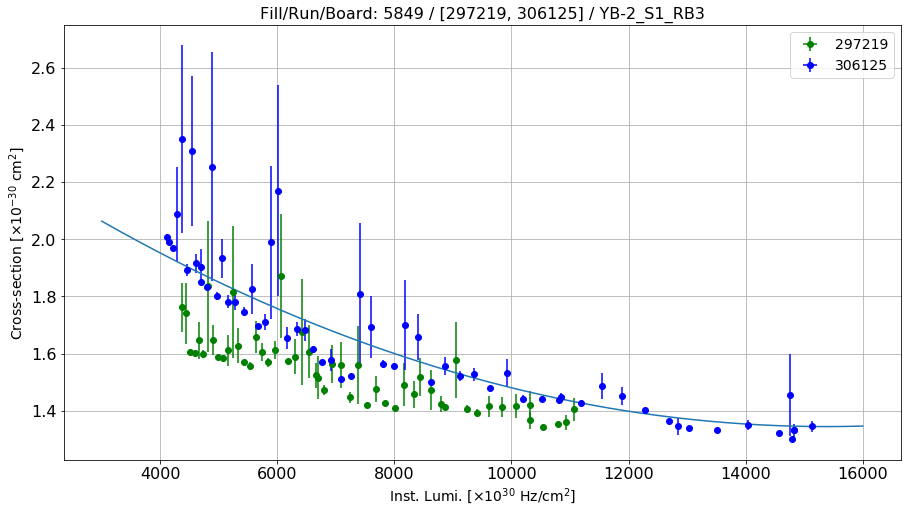

Linear fit parameters: [1.05524570e+00 4.22711923e+03]


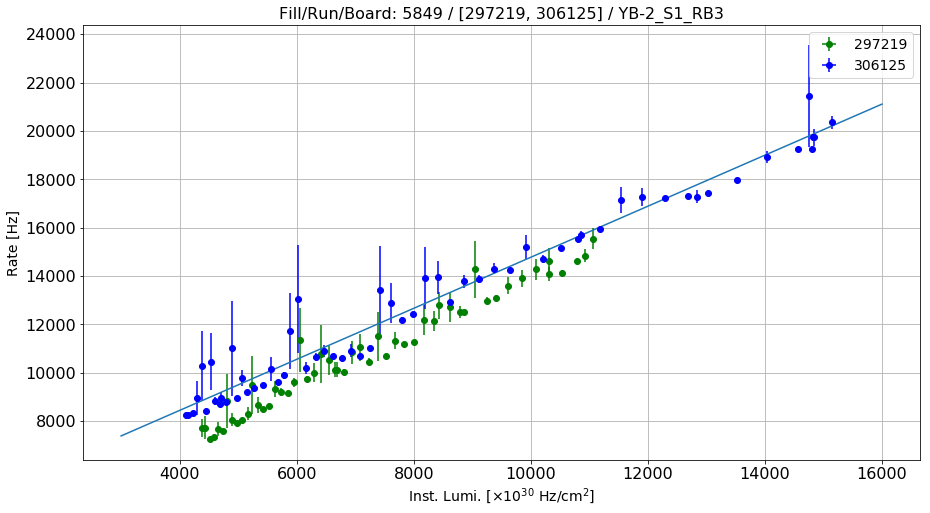

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S1_RB4
Linear fit for the reference run: [ 3.24942213e-10 -2.61059941e-05  1.16914504e+01]


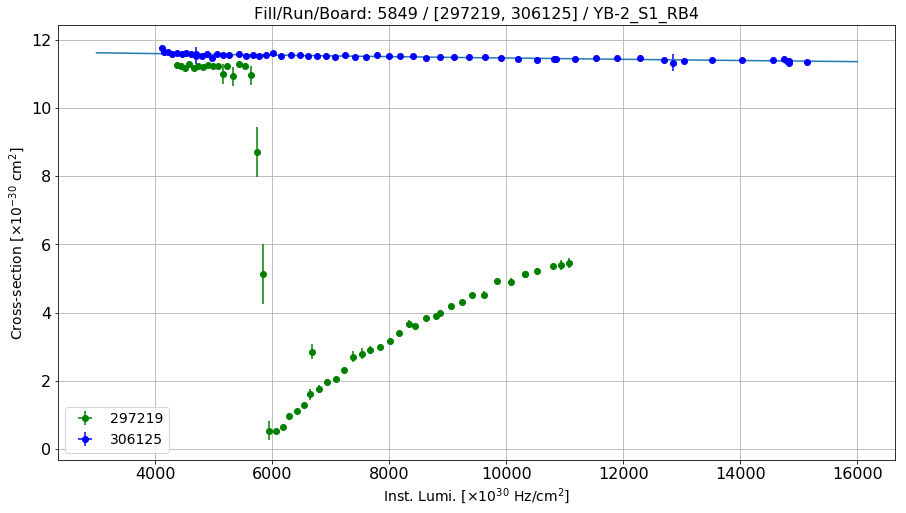

Linear fit parameters: [  11.27517294 1713.11402539]


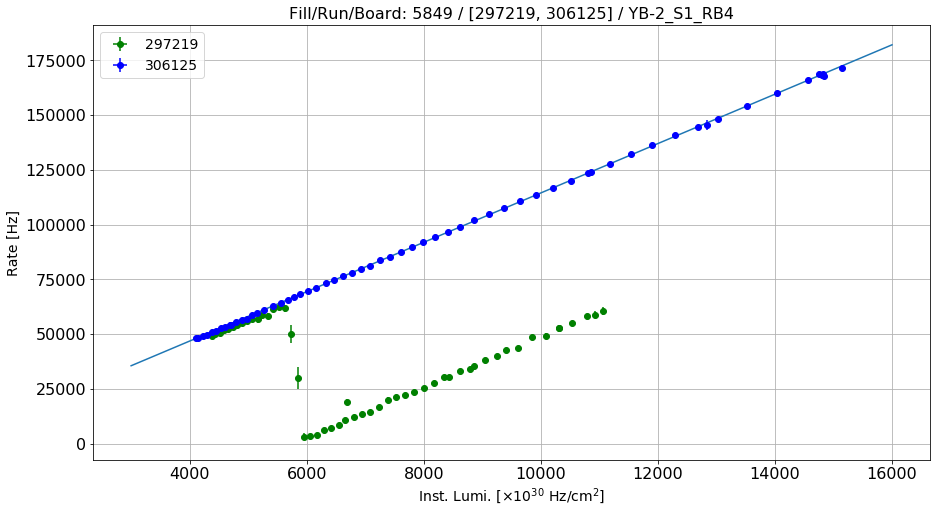

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S2_RB1
Linear fit for the reference run: [ 3.63174618e-09 -1.80223266e-04  3.92066793e+01]


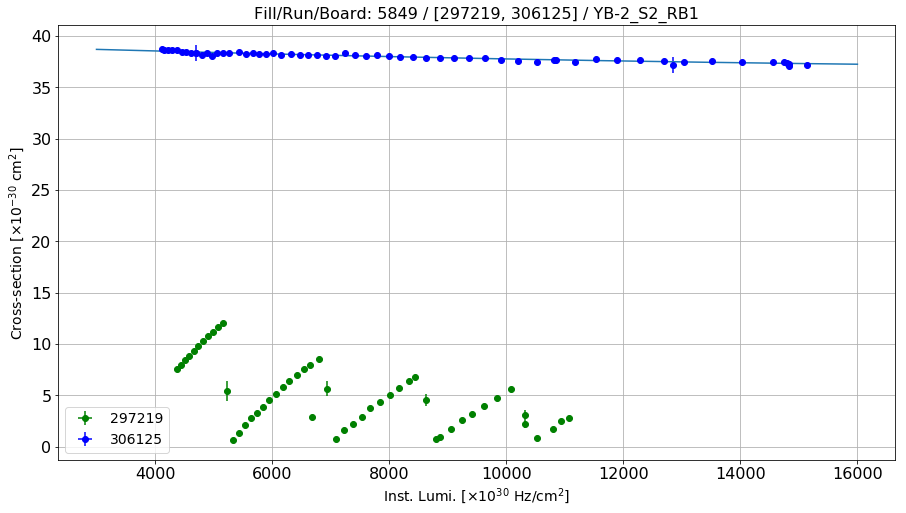

Linear fit parameters: [  36.76586466 9310.32522819]


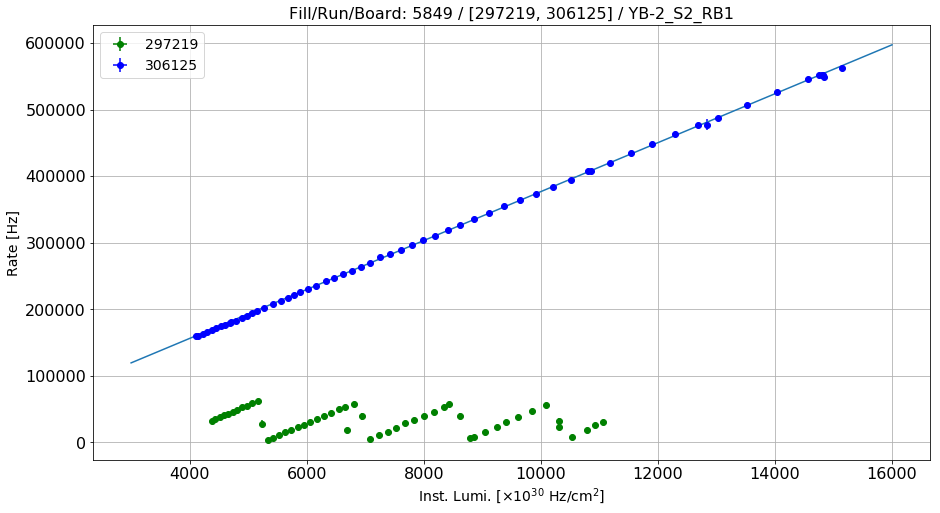

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S2_RB2
Linear fit for the reference run: [ 1.37500255e-08 -8.69878636e-04  2.36737266e+01]


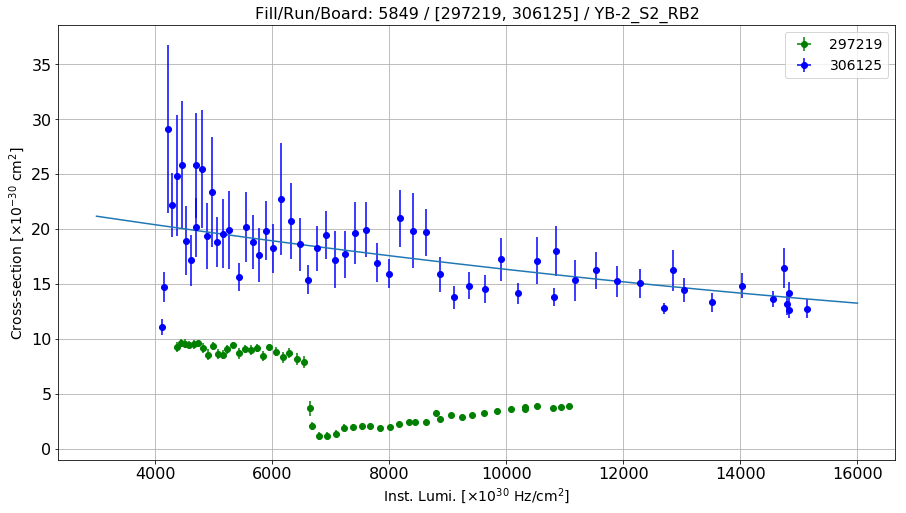

Linear fit parameters: [1.07142682e+01 5.17864634e+04]


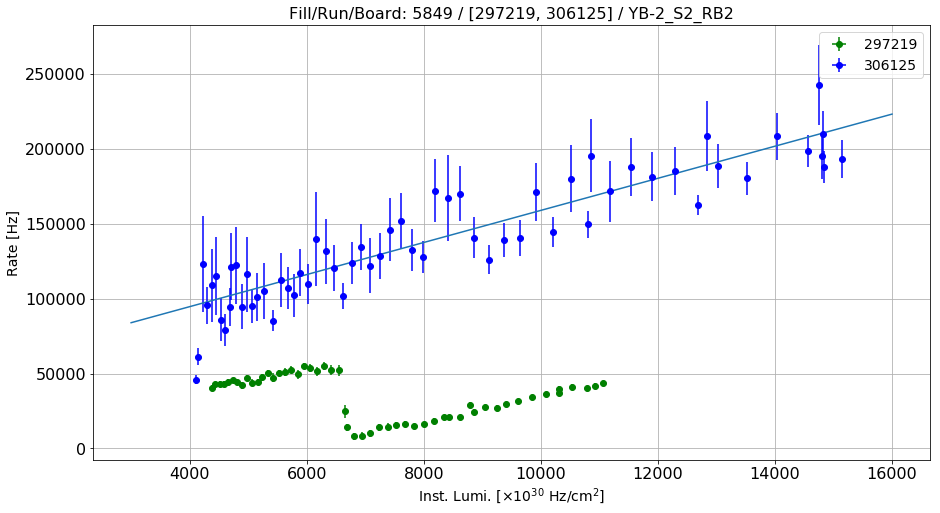

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S2_RB3
Linear fit for the reference run: [ 8.66641806e-09 -2.41276546e-04  3.44949833e+00]


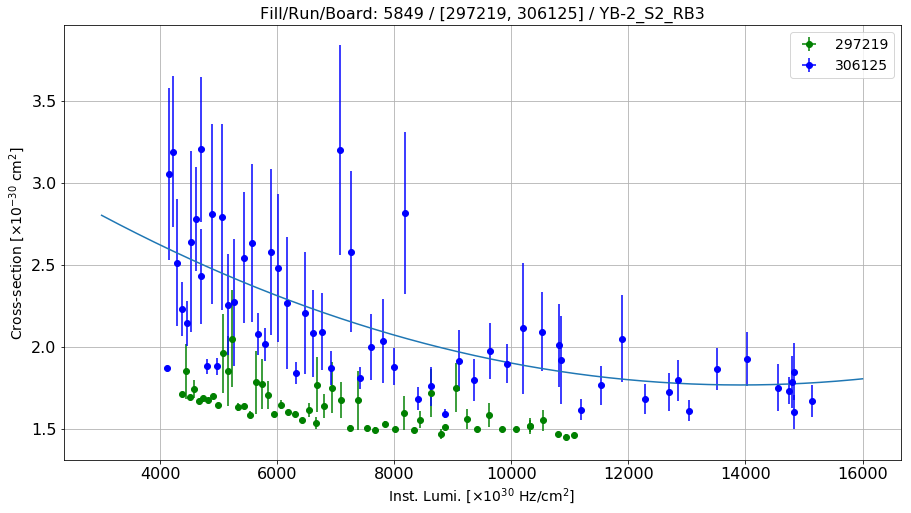

Linear fit parameters: [1.36810744e+00 5.57019931e+03]


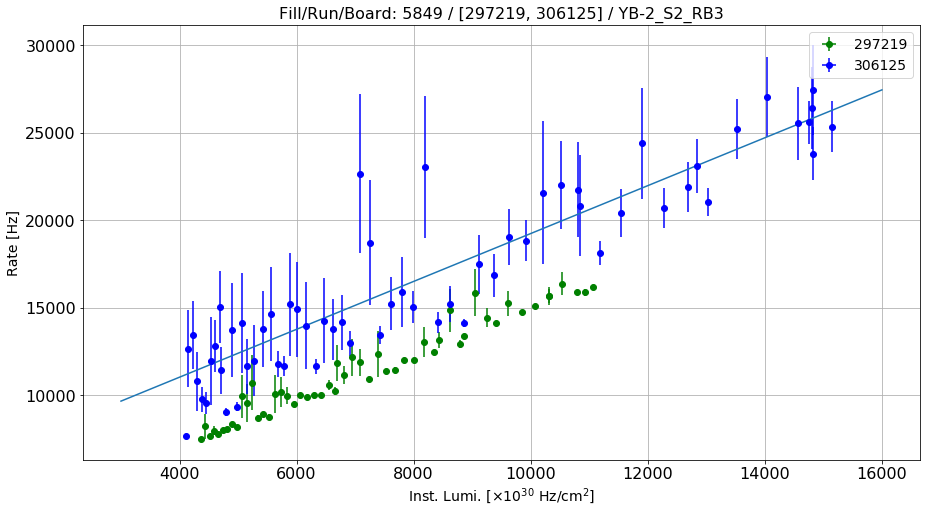

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S2_RB4
Linear fit for the reference run: [ 2.30171855e-08 -7.24531328e-04  3.56737523e+01]


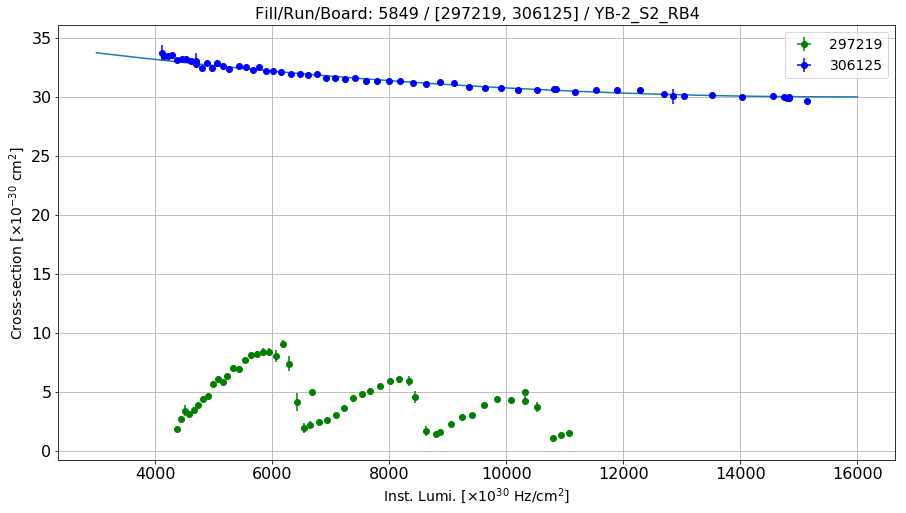

Linear fit parameters: [   28.48579174 22176.47122079]


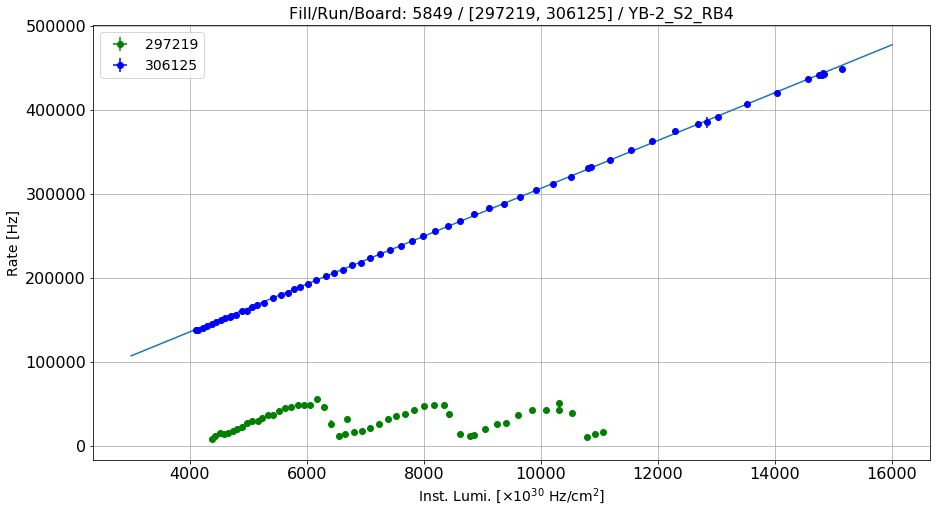

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S3_RB1
Linear fit for the reference run: [ 9.94512720e-09 -3.86534573e-04  4.31435712e+01]


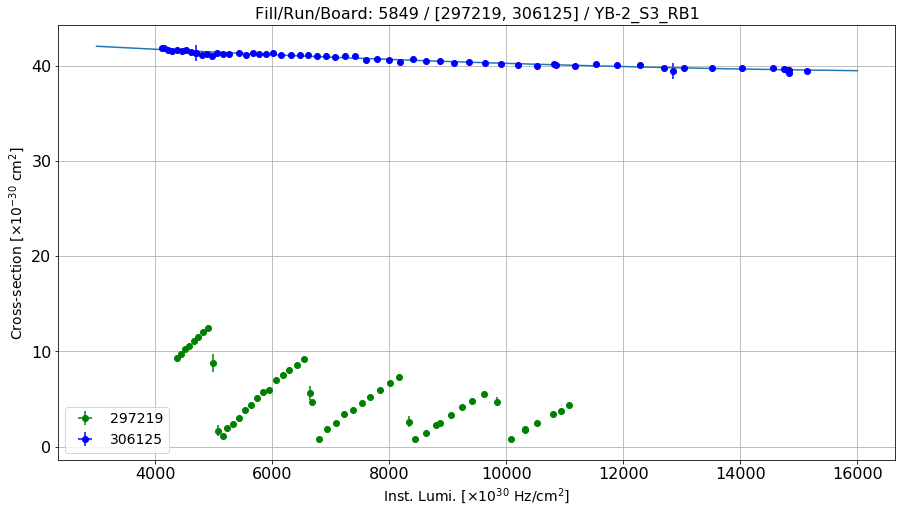

Linear fit parameters: [   38.58088964 16061.46598794]


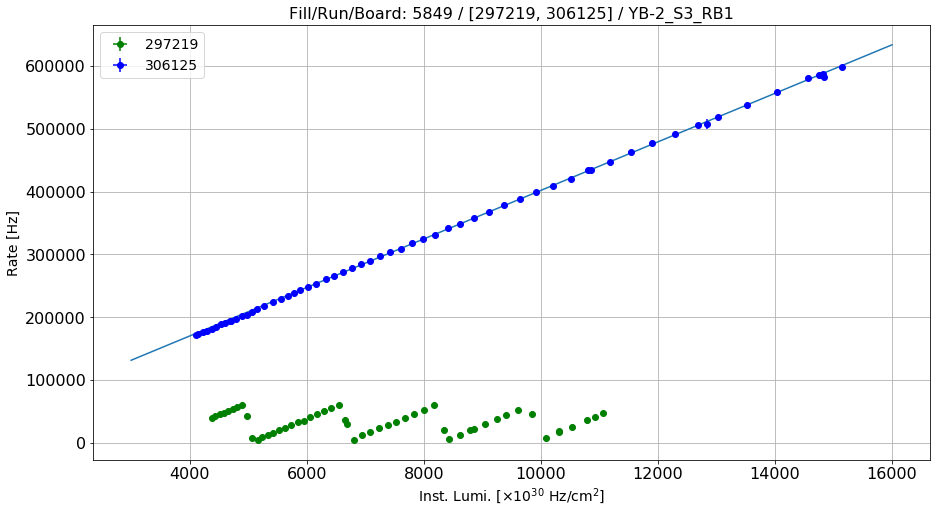

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S3_RB2
Linear fit for the reference run: [ 3.74501490e-09 -1.32550837e-04  1.02173548e+01]


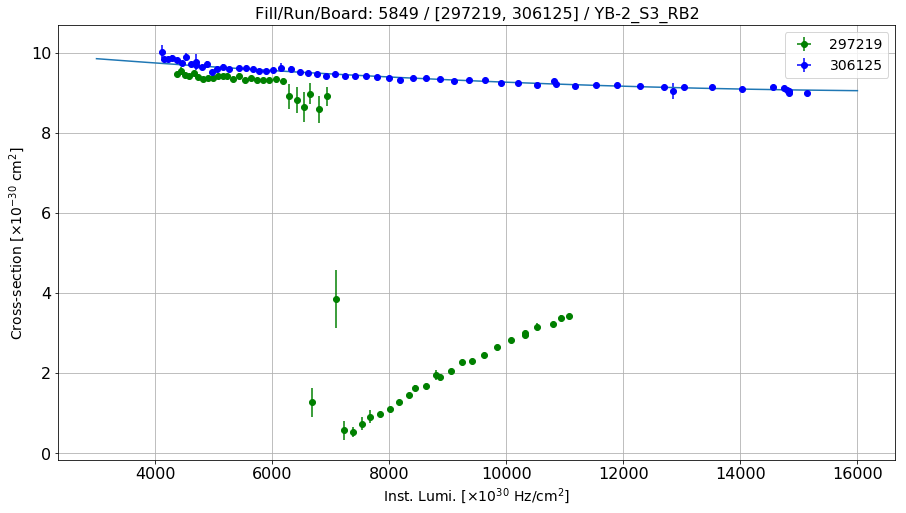

Linear fit parameters: [   8.75705772 4901.42516788]


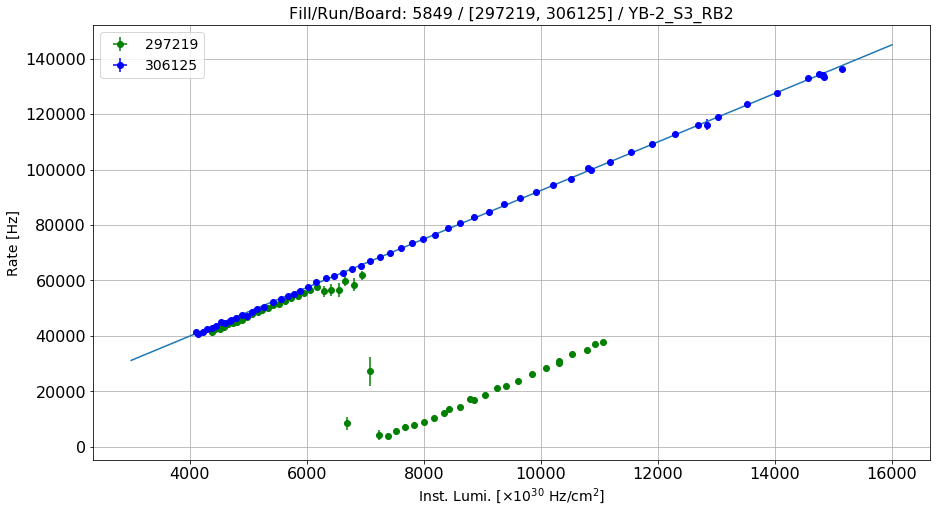

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S3_RB3
Linear fit for the reference run: [ 3.54991724e-12 -8.32109682e-08  6.85714527e-04]


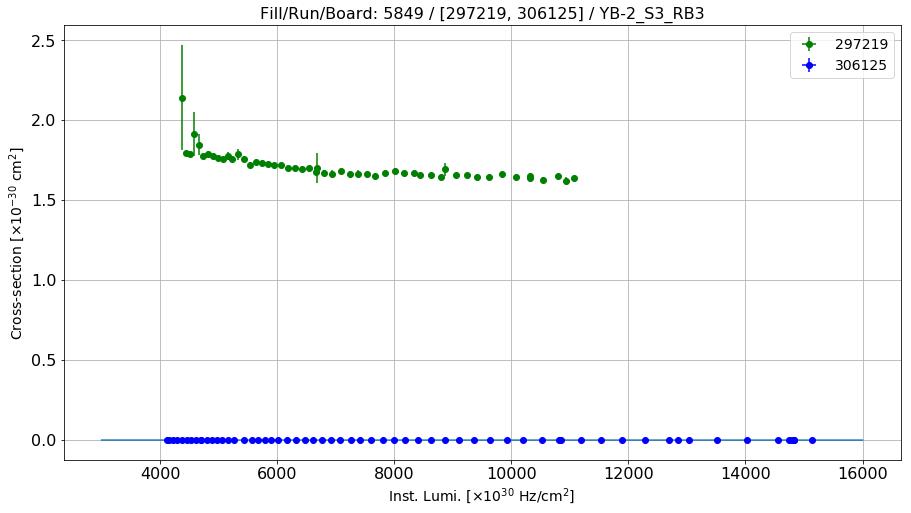

Linear fit parameters: [1.42839792e-04 9.04305059e-01]


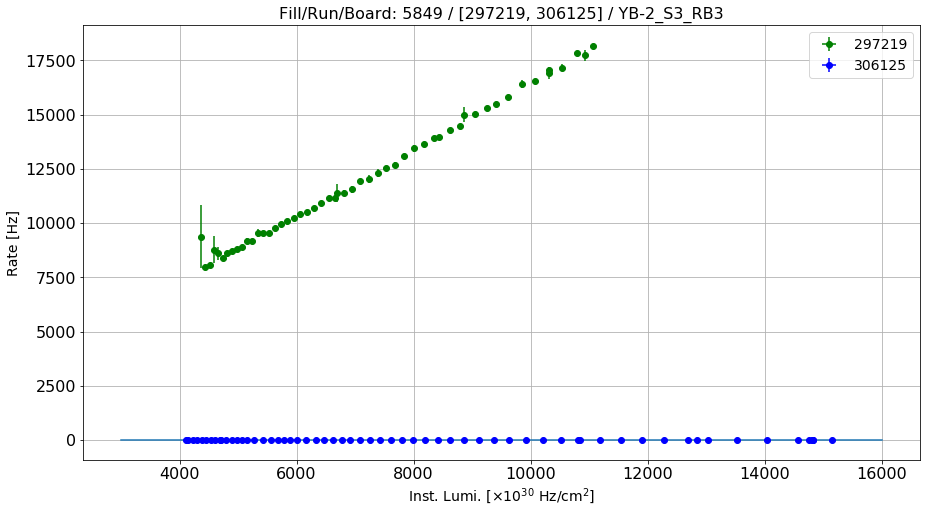

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S3_RB4
Linear fit for the reference run: [ 4.22487038e-08 -1.31222693e-03  6.08815978e+01]


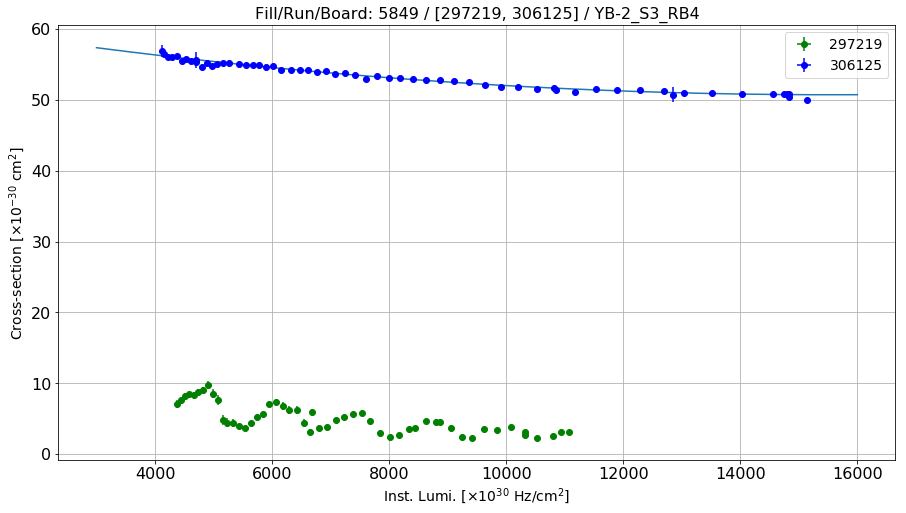

Linear fit parameters: [   48.0382537  39147.35482777]


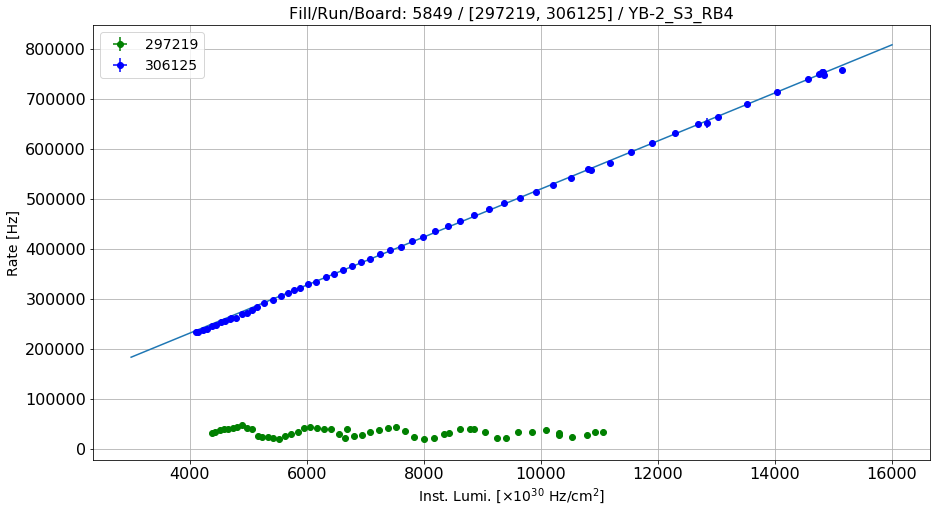

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S4_RB1
Linear fit for the reference run: [ 6.96705212e-08 -2.30234588e-03  6.21943885e+01]


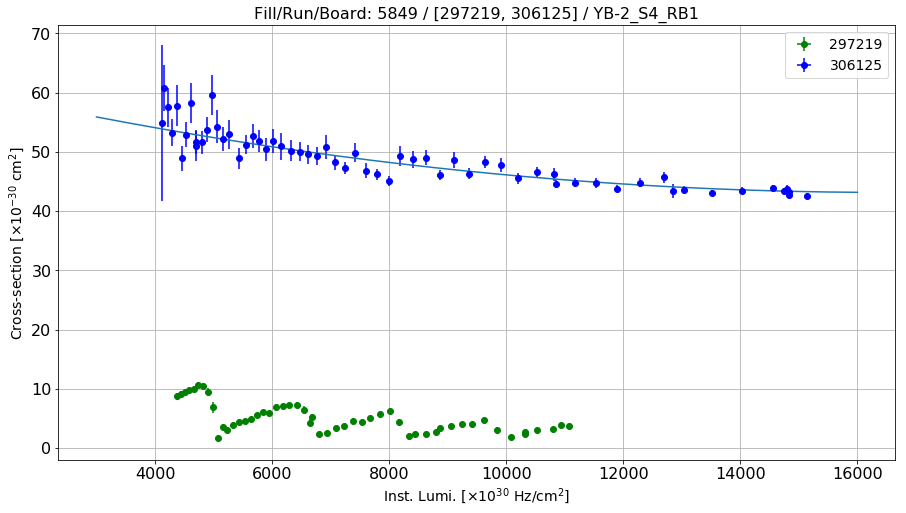

Linear fit parameters: [3.82707591e+01 7.67607756e+04]


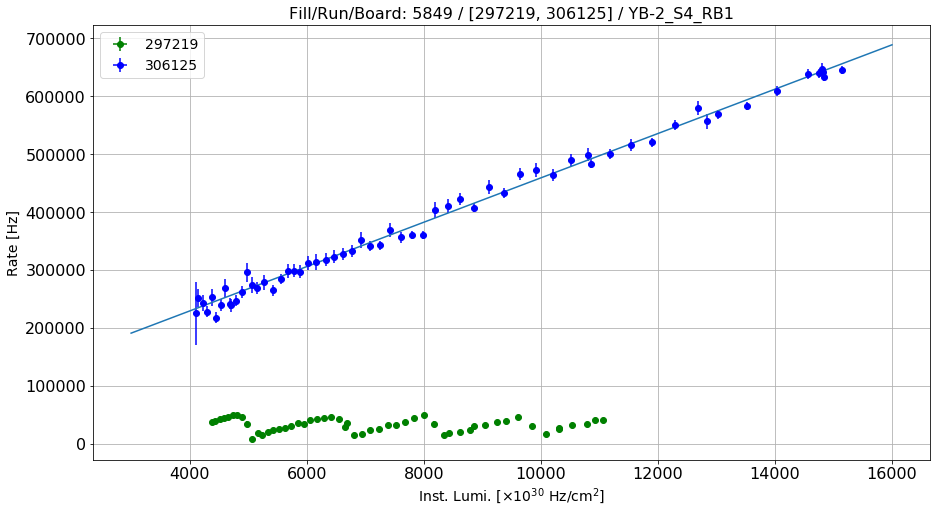

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S4_RB2
Linear fit for the reference run: [ 3.67239100e-09 -1.27731076e-04  9.87325852e+00]


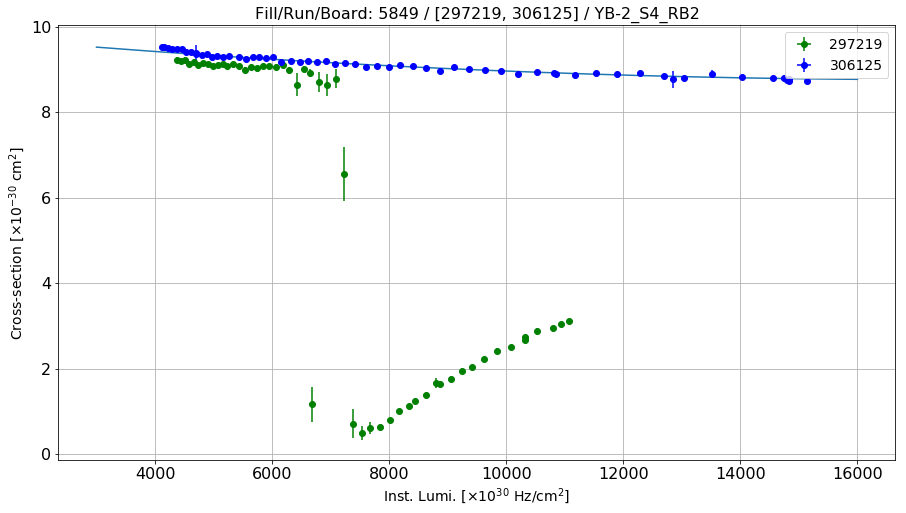

Linear fit parameters: [   8.48587678 4608.03692488]


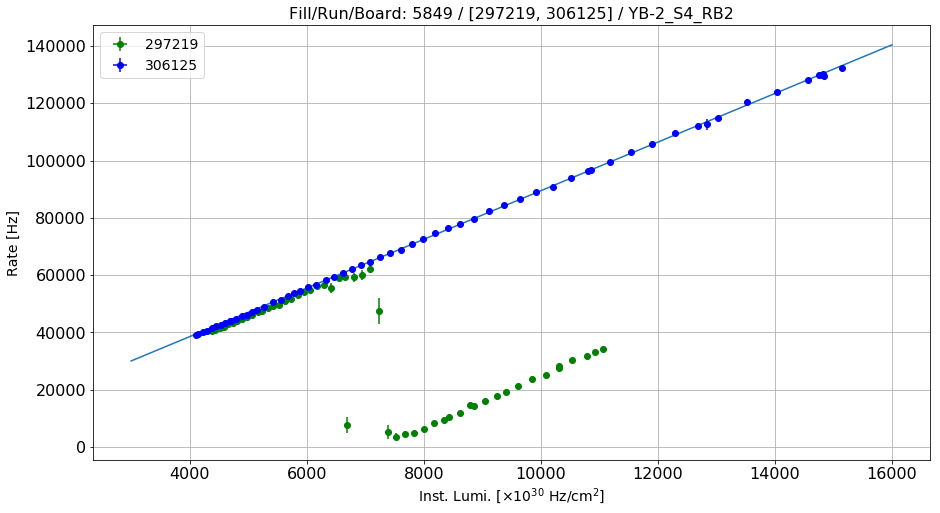

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S4_RB3
Linear fit for the reference run: [ 6.32933305e-09 -1.77838968e-04  2.73103315e+00]


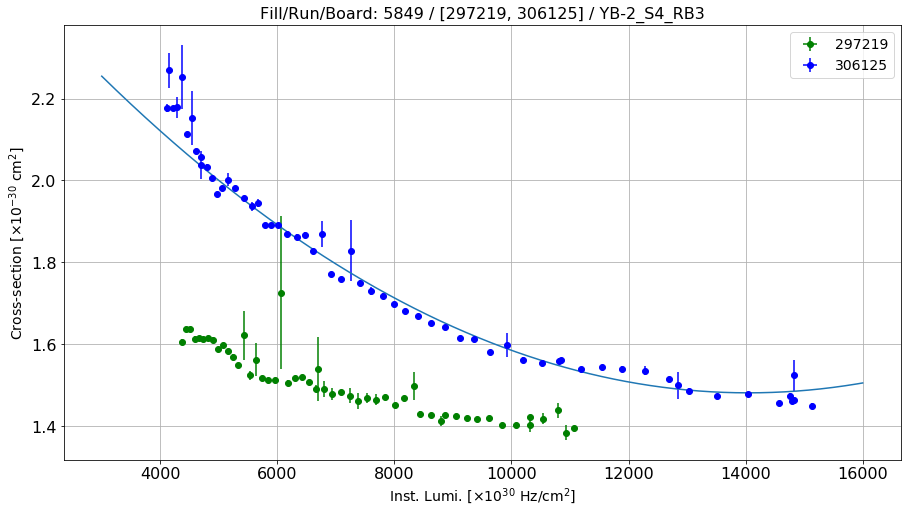

Linear fit parameters: [1.17865947e+00 4.21161171e+03]


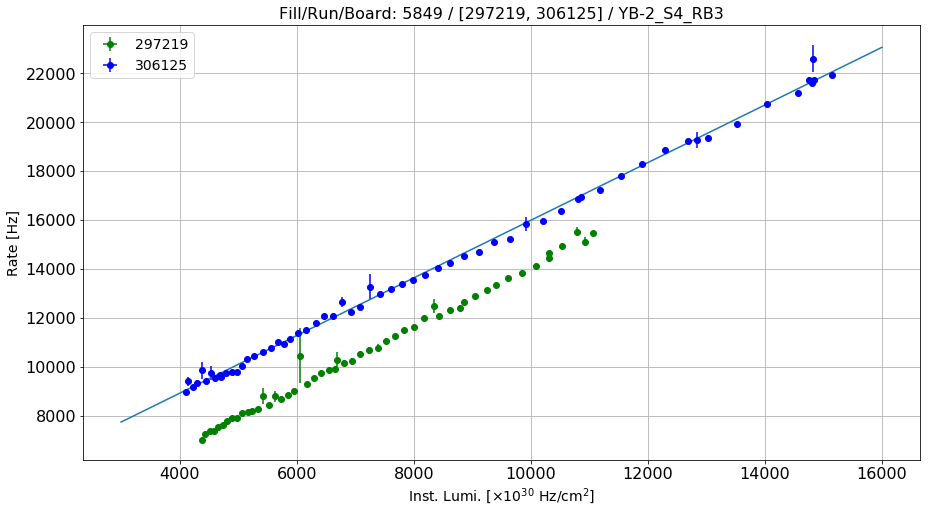

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S4_RB4
Linear fit for the reference run: [ 5.17948296e-09 -2.04968515e-04  4.01242687e+01]


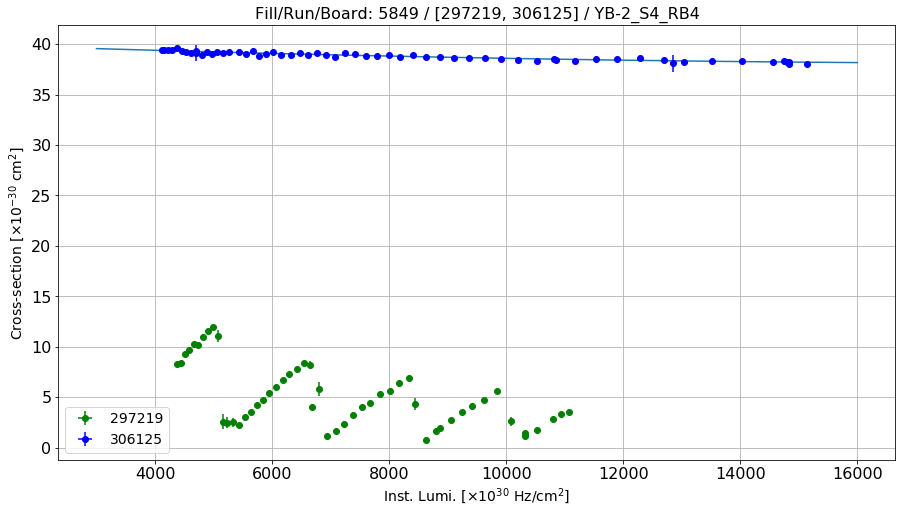

Linear fit parameters: [  37.67545052 8687.54679897]


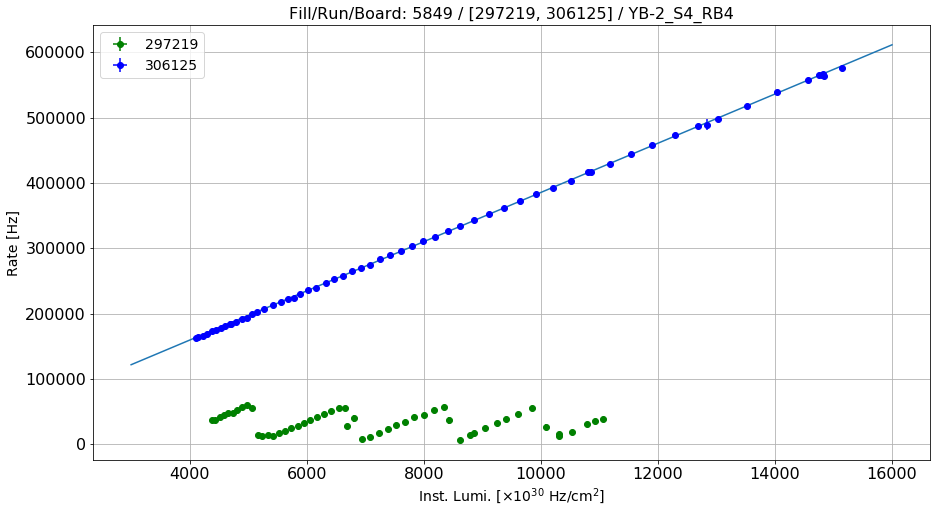

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S5_RB1
Linear fit for the reference run: [ 1.15261209e-09 -1.67159772e-04  4.28265835e+01]


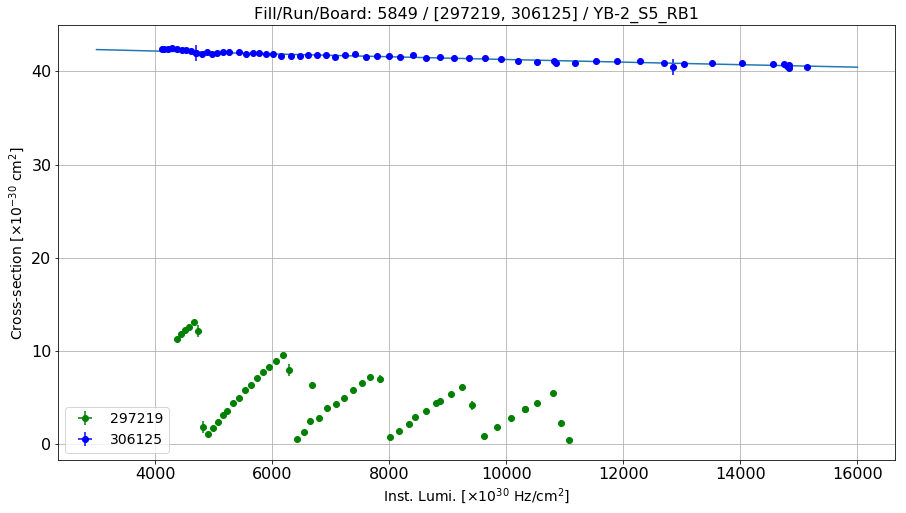

Linear fit parameters: [   39.8717285  12651.01784229]


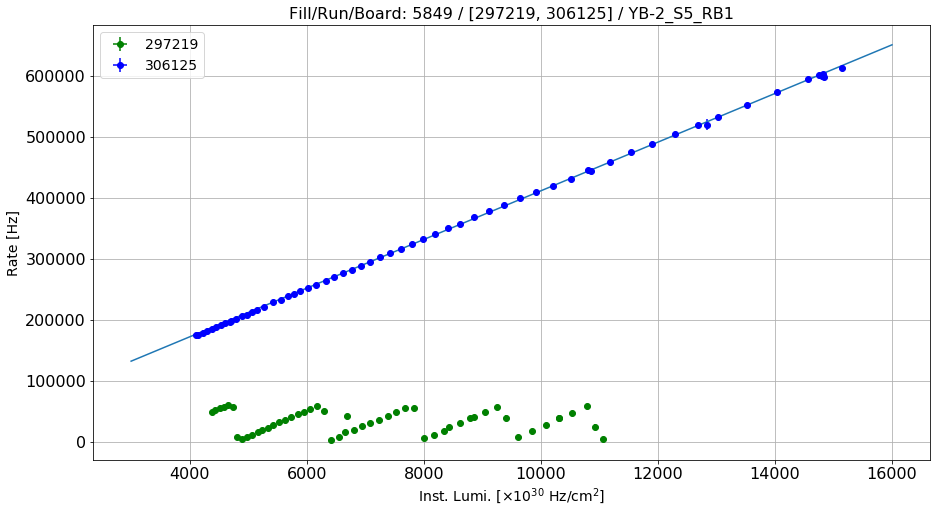

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S5_RB2
Linear fit for the reference run: [ 3.21554467e-09 -1.07812682e-04  1.07762834e+01]


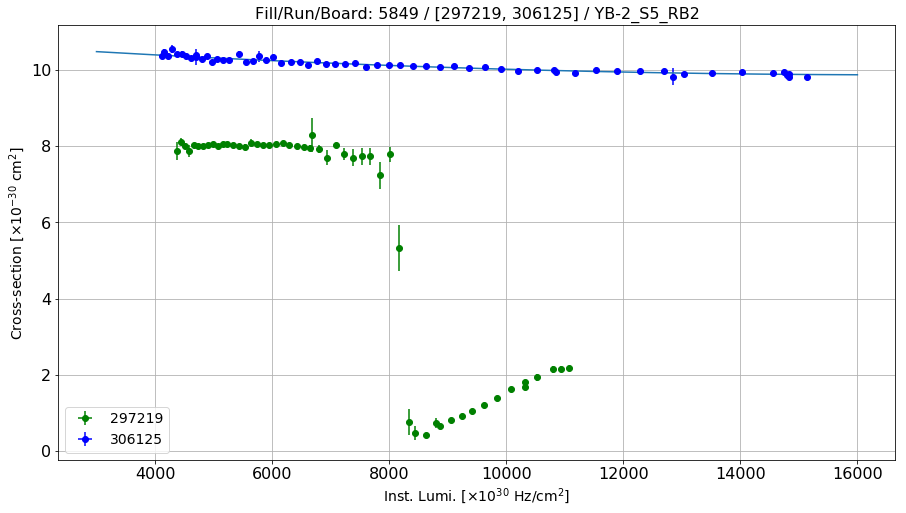

Linear fit parameters: [   9.64136739 3679.56233402]


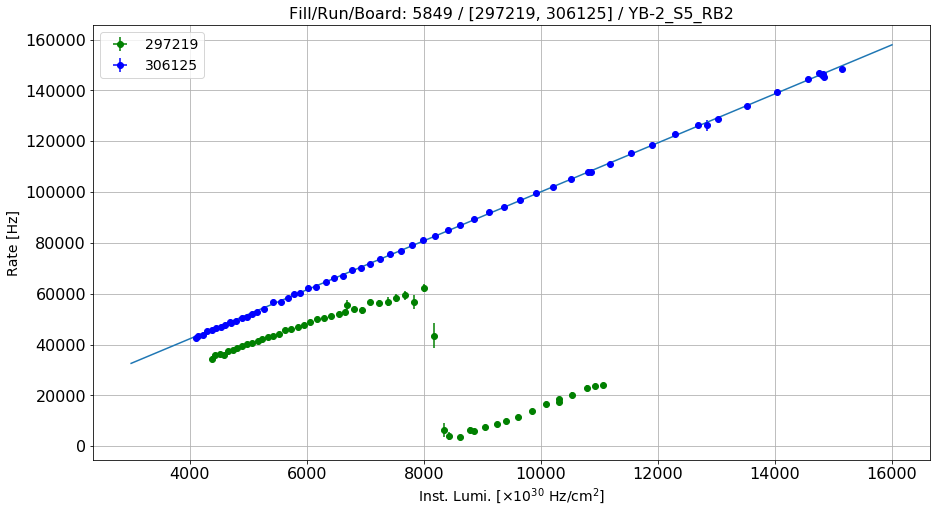

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S5_RB3
Linear fit for the reference run: [ 4.98508552e-09 -1.65349049e-04  3.14679298e+00]


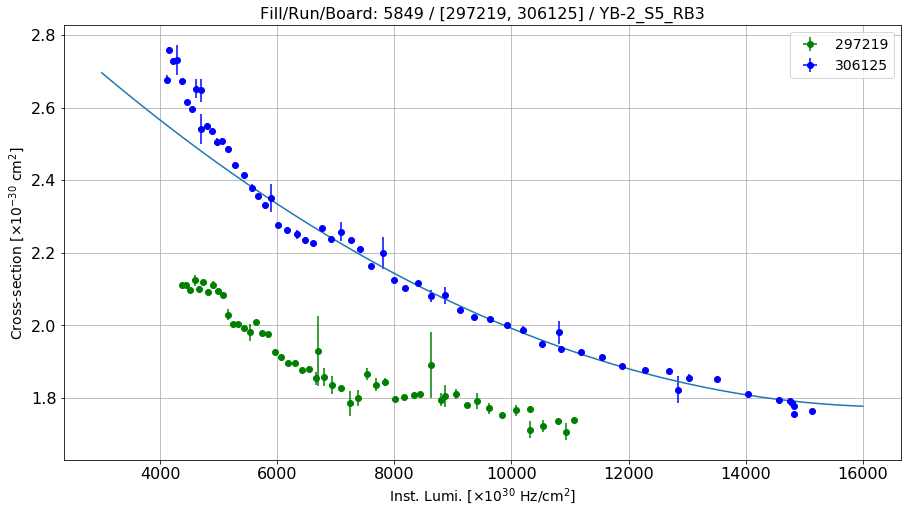

Linear fit parameters: [1.42288973e+00 5.54627916e+03]


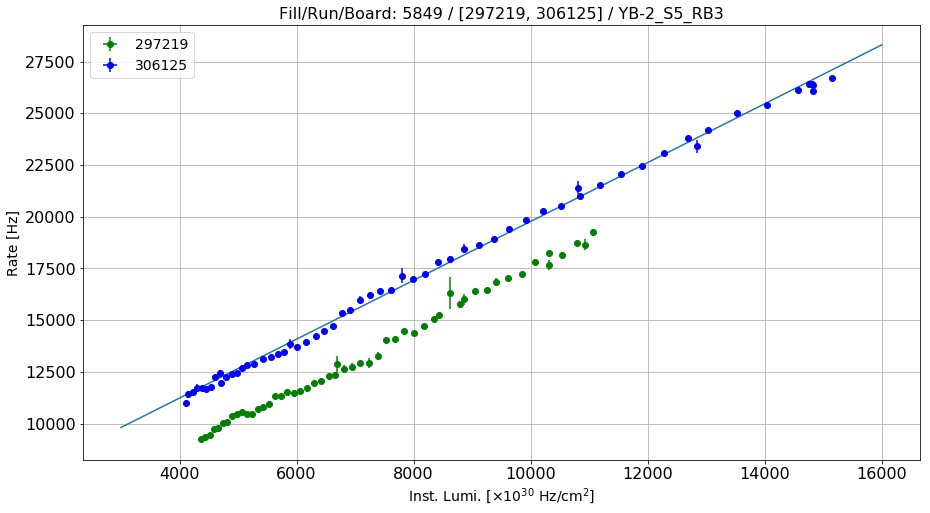

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S5_RB4
Linear fit for the reference run: [ 4.25212591e-08 -1.34328143e-03  2.19489546e+01]


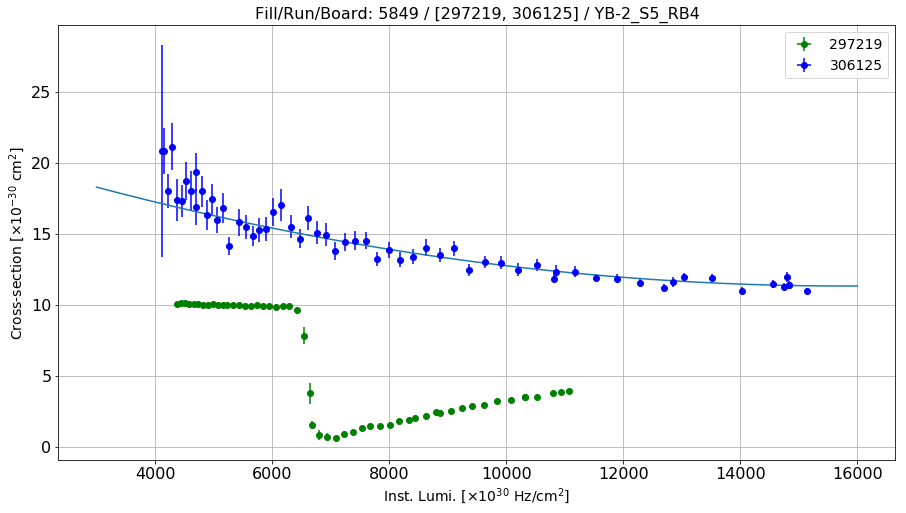

Linear fit parameters: [8.57488392e+00 4.13917498e+04]


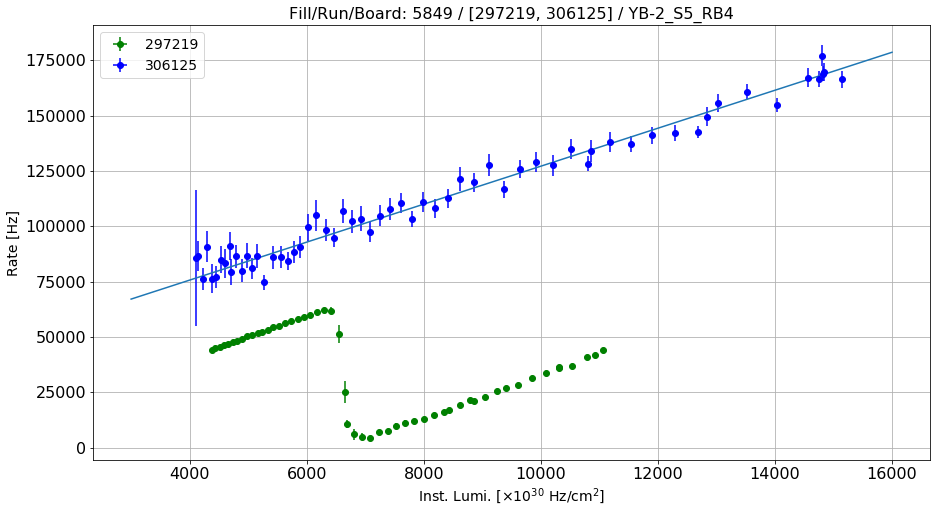

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S6_RB1
Linear fit for the reference run: [ 1.08151306e-09 -1.25229853e-04  4.27265605e+01]


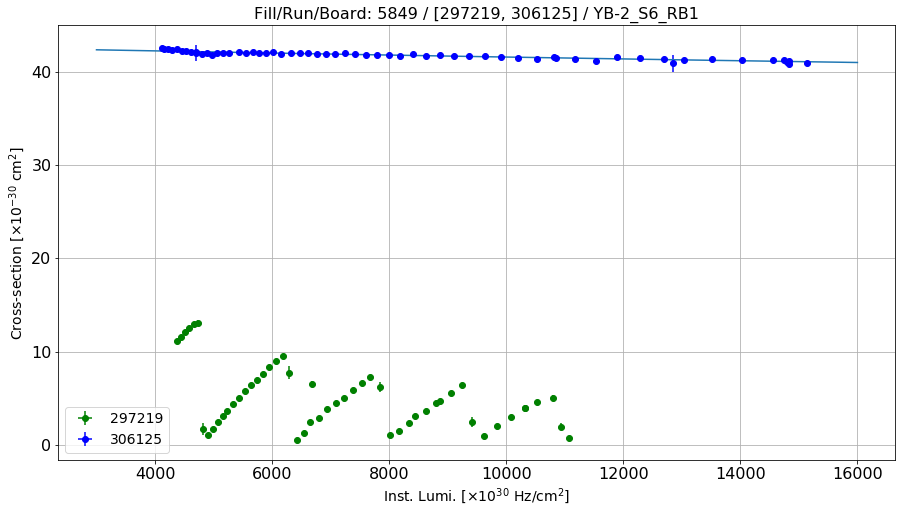

Linear fit parameters: [  40.58087687 9082.58300298]


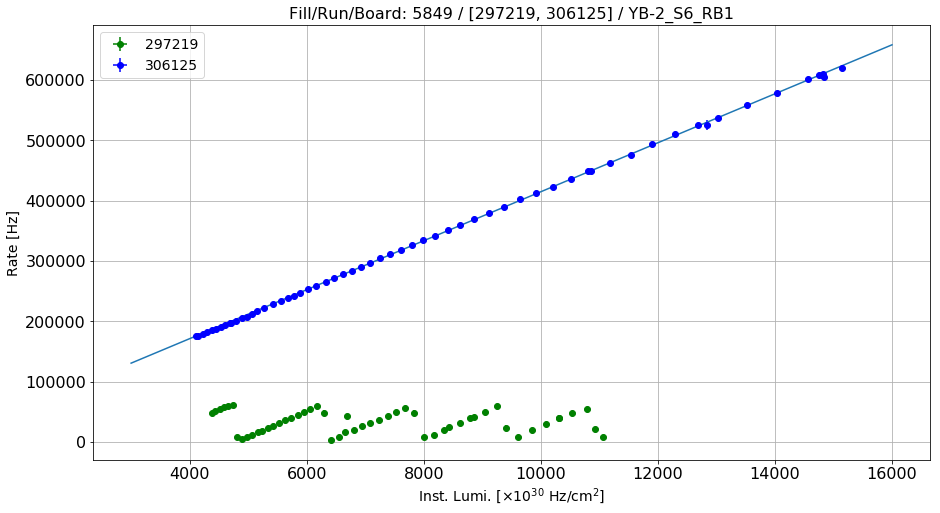

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S6_RB2
Linear fit for the reference run: [ 5.14264205e-09 -1.60254126e-04  1.07282046e+01]


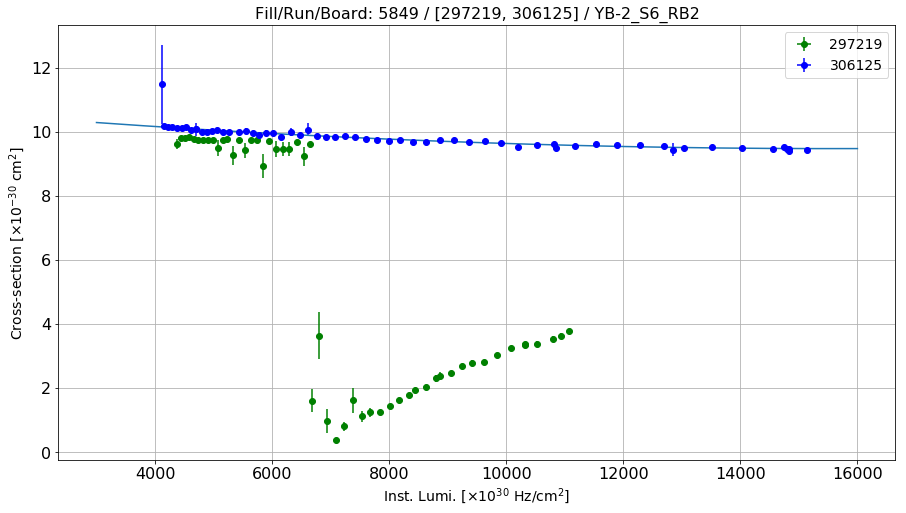

Linear fit parameters: [   9.15444769 4811.50285218]


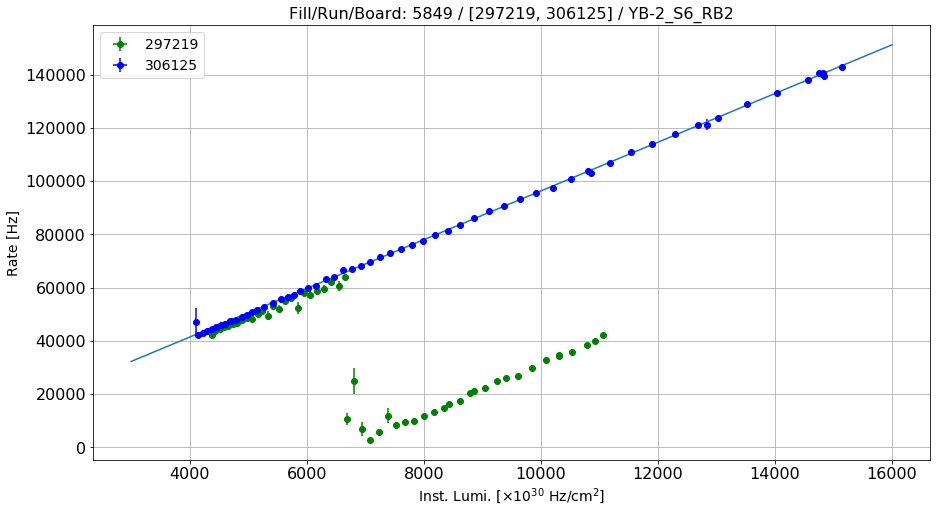

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S6_RB3
Linear fit for the reference run: [ 2.30940796e-09 -6.99689165e-05  1.93151040e+00]


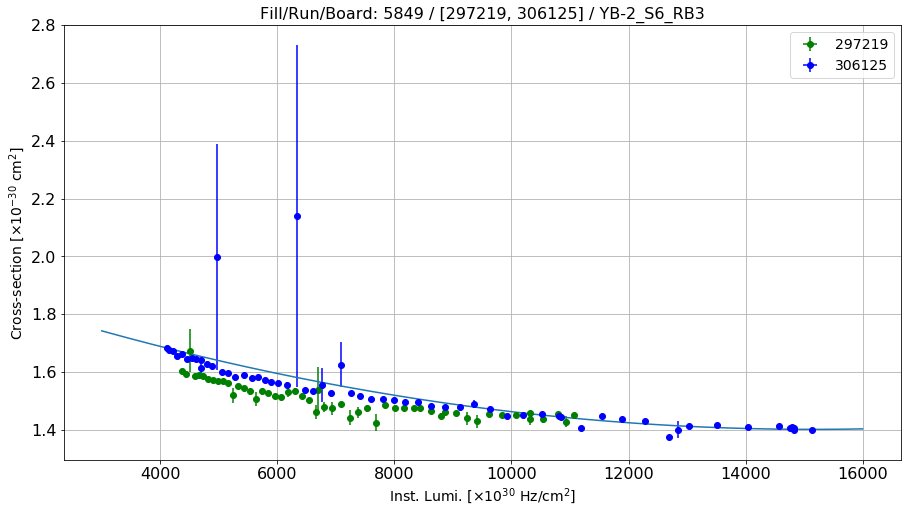

Linear fit parameters: [1.26436647e+00 1.98466050e+03]


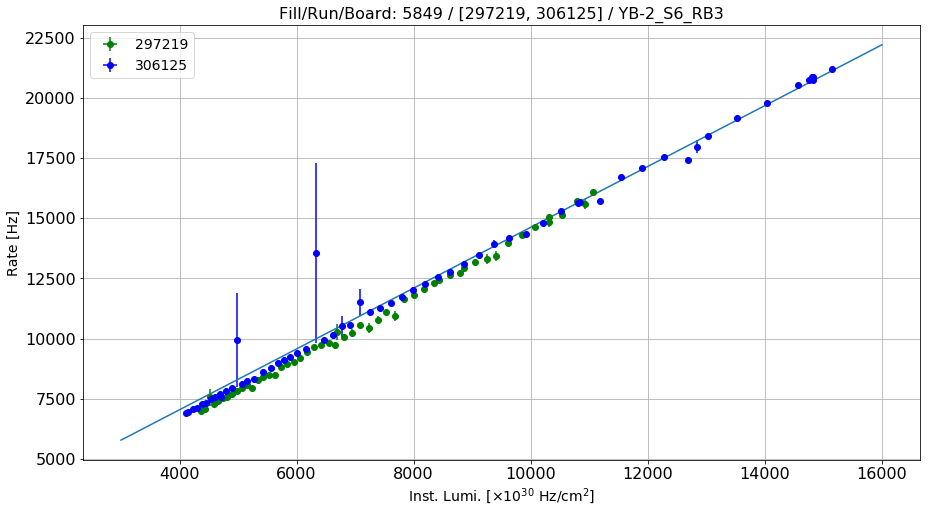

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S6_RB4
Linear fit for the reference run: [ 2.02996093e-08 -7.63289423e-04  3.78416134e+01]


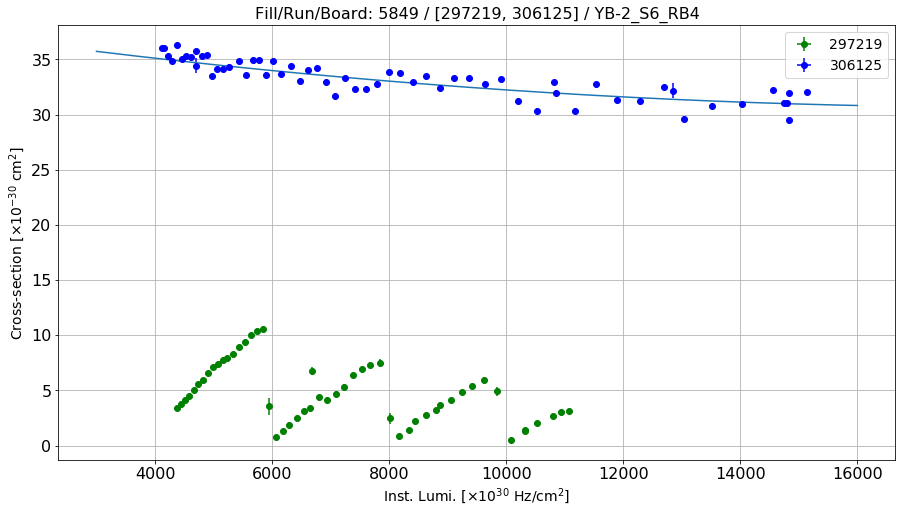

Linear fit parameters: [2.90377981e+01 3.05187613e+04]


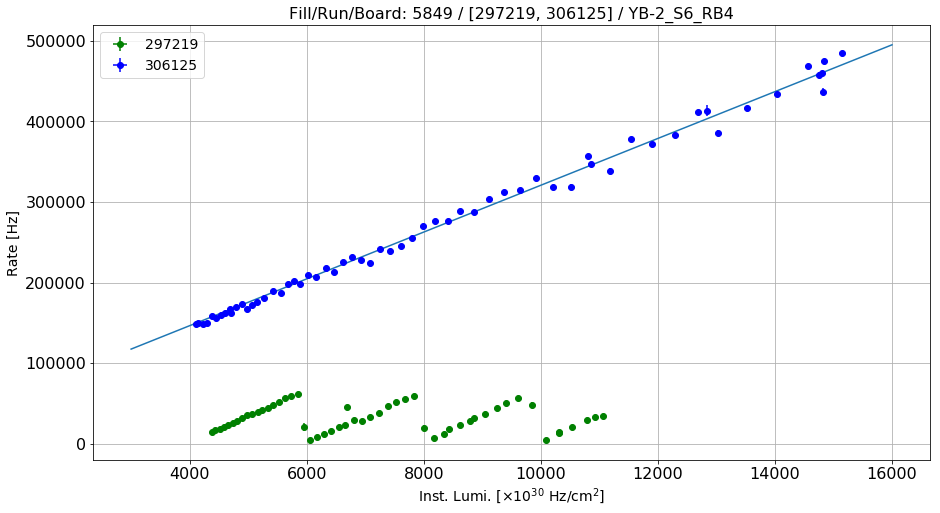

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S7_RB1
Linear fit for the reference run: [-6.00266996e-08  1.11538991e-03  3.78859721e+01]


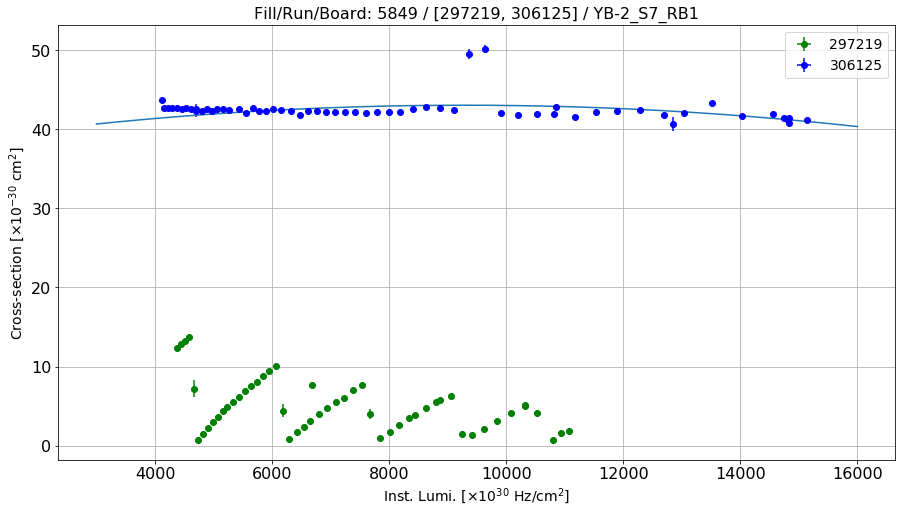

Linear fit parameters: [   41.28306707 10425.91194225]


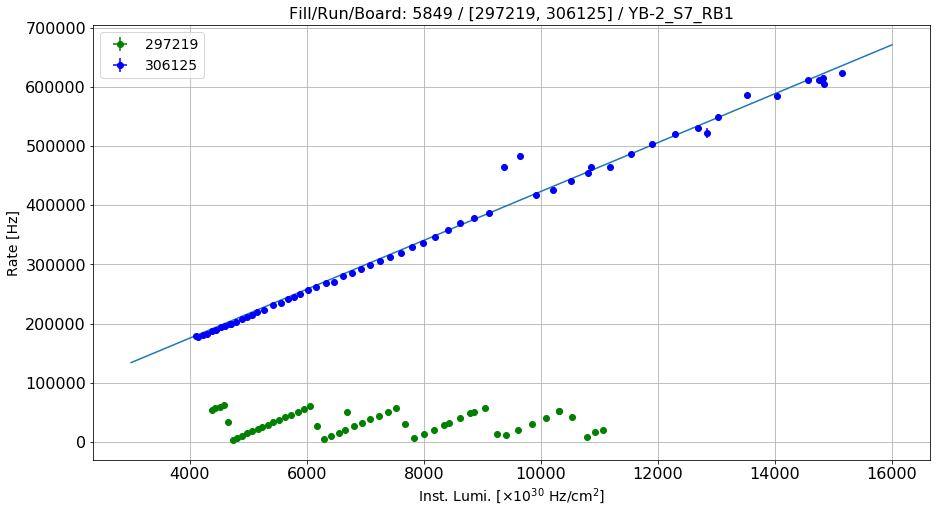

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S7_RB2
Linear fit for the reference run: [ 4.52845061e-09 -1.60297158e-04  1.05009012e+01]


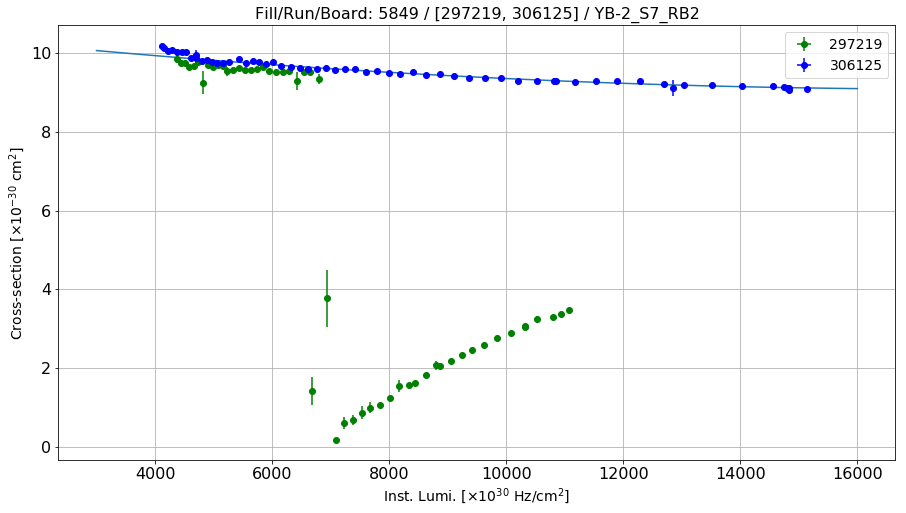

Linear fit parameters: [   8.73477253 5928.31343291]


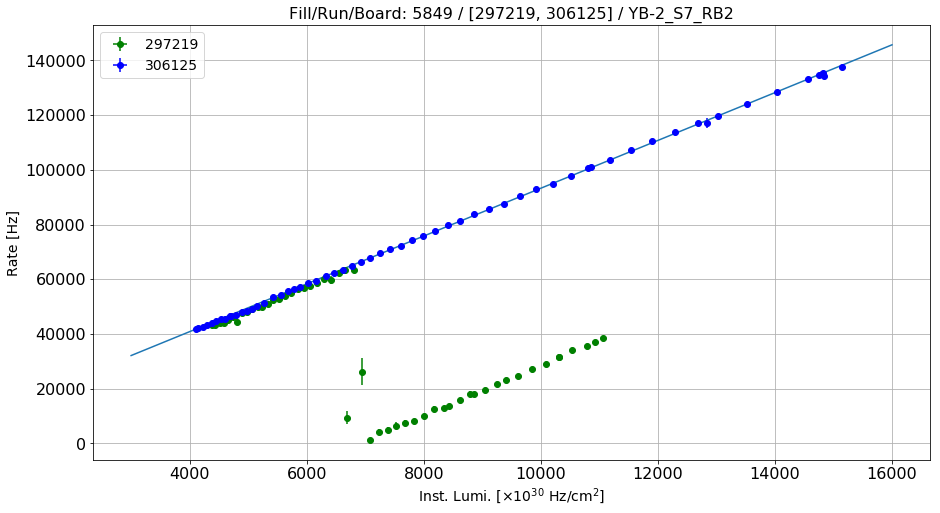

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S7_RB3
Linear fit for the reference run: [-2.83198908e-08 -8.27127228e-05  4.82092138e+00]


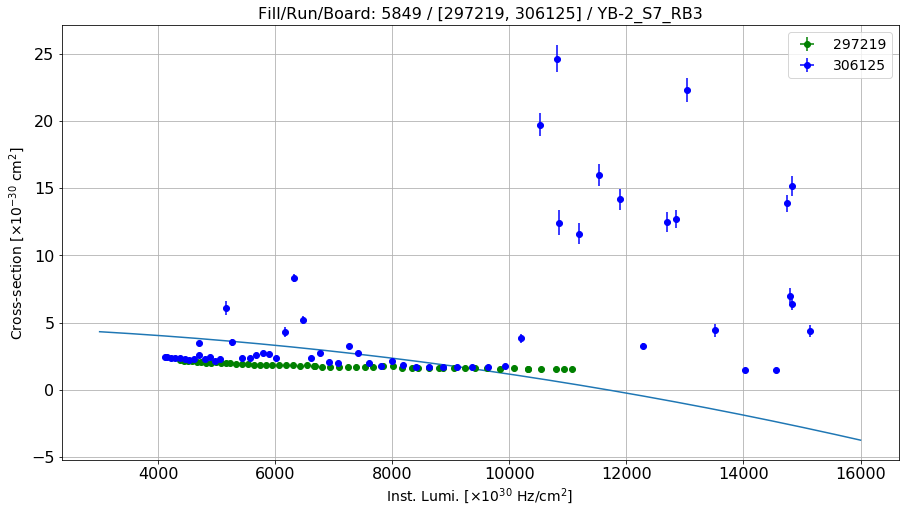

Linear fit parameters: [-1.11421032e+00  2.64227763e+04]


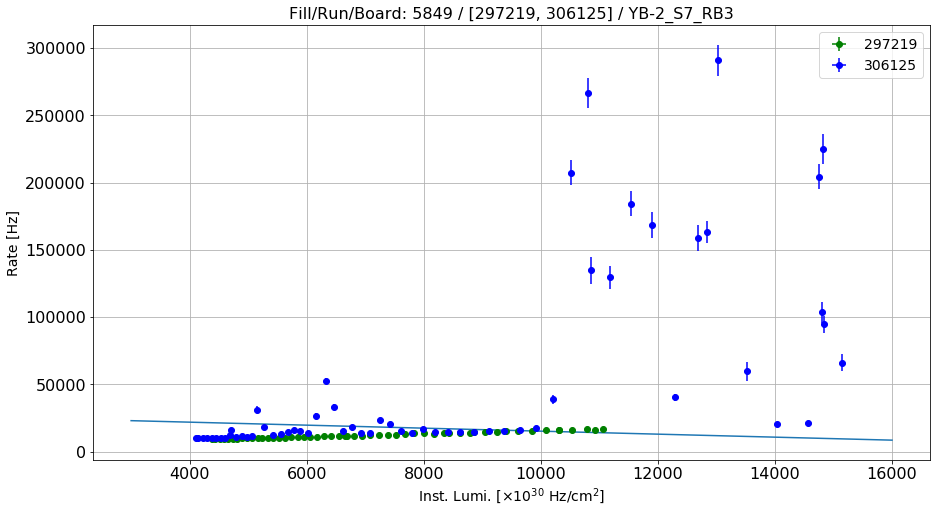

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S7_RB4
Linear fit for the reference run: [ 2.30366095e-09 -9.21154825e-05  2.34257533e+01]


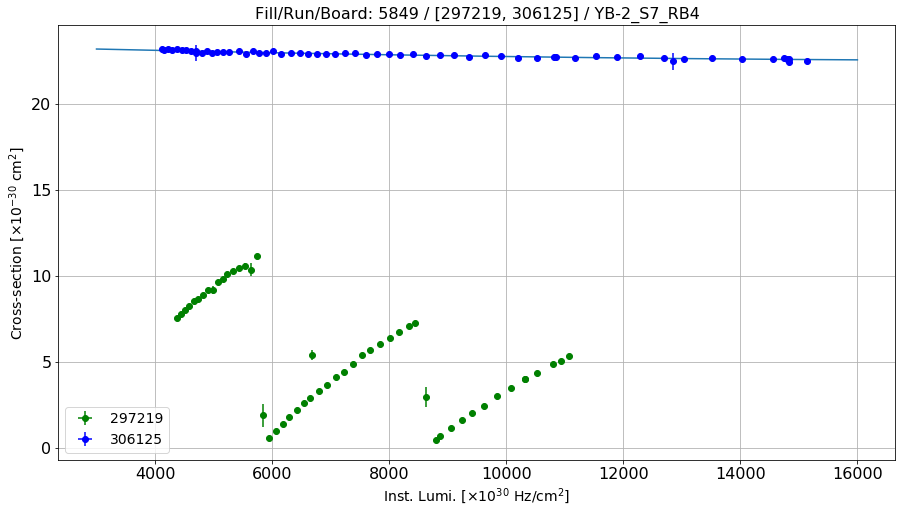

Linear fit parameters: [  22.31771893 3947.90520237]


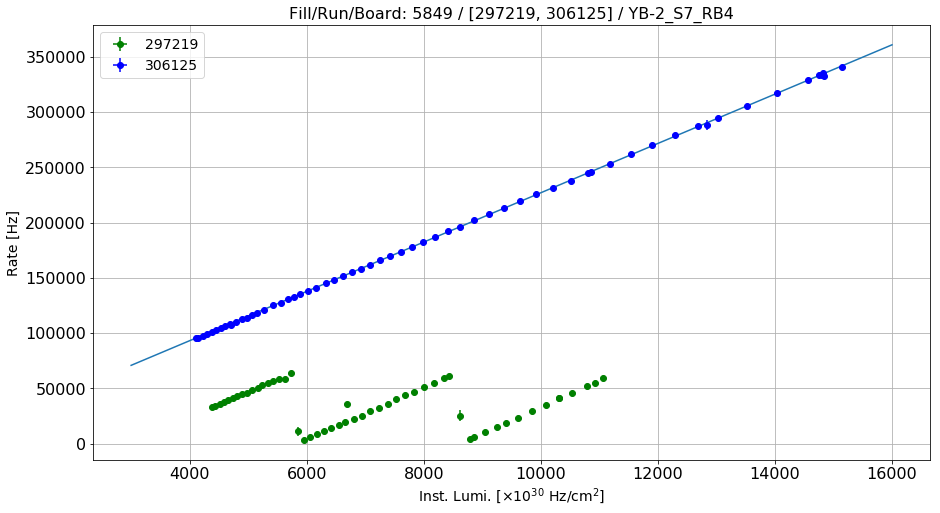

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S8_RB1
Linear fit for the reference run: [ 1.53059377e-08 -4.96423657e-04  3.77086939e+01]


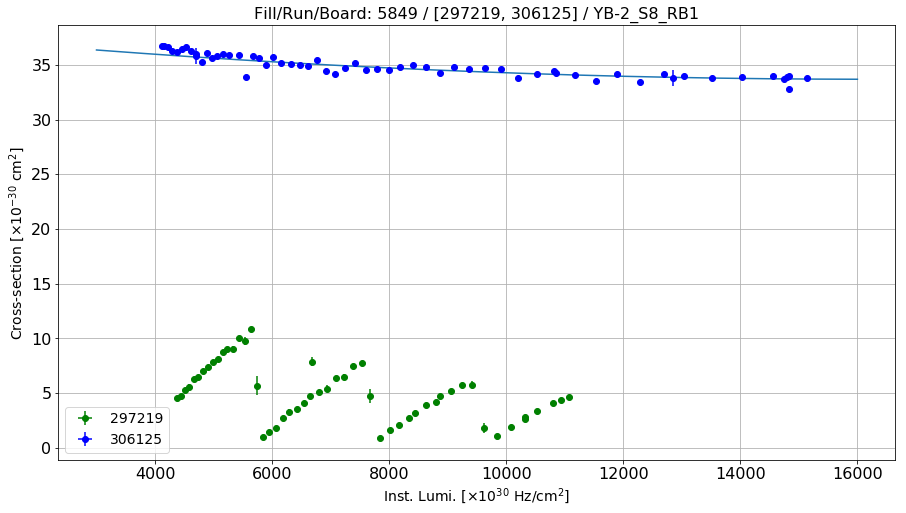

Linear fit parameters: [   32.63886933 16036.54515046]


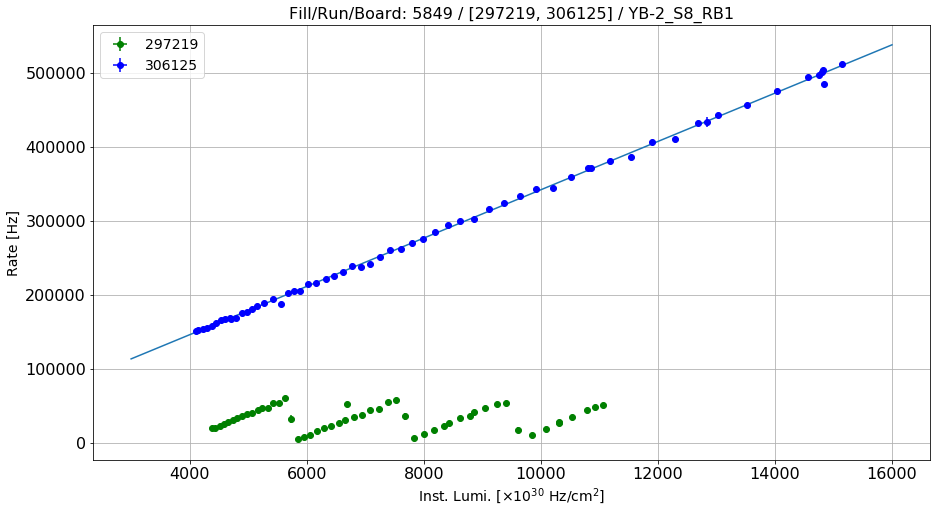

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S8_RB2
Linear fit for the reference run: [ 7.28189012e-09 -2.41600503e-04  1.23408830e+01]


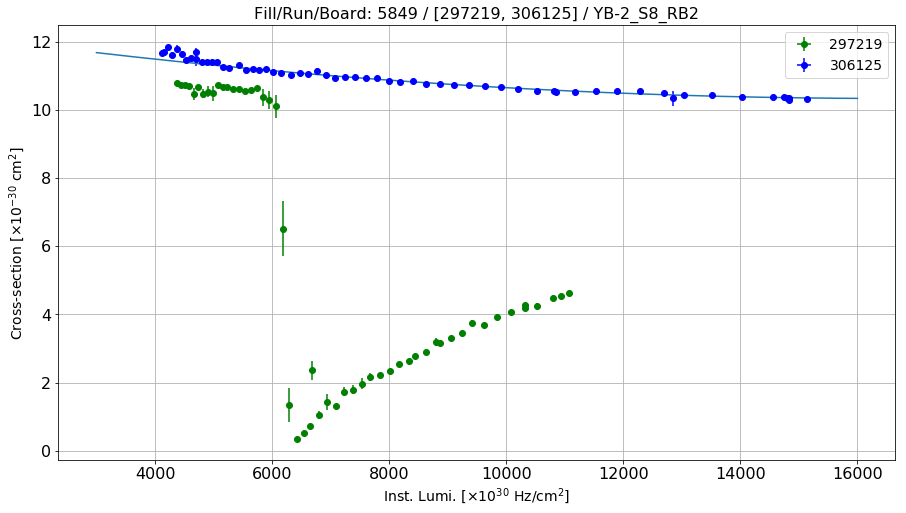

Linear fit parameters: [   9.82134236 8107.75789801]


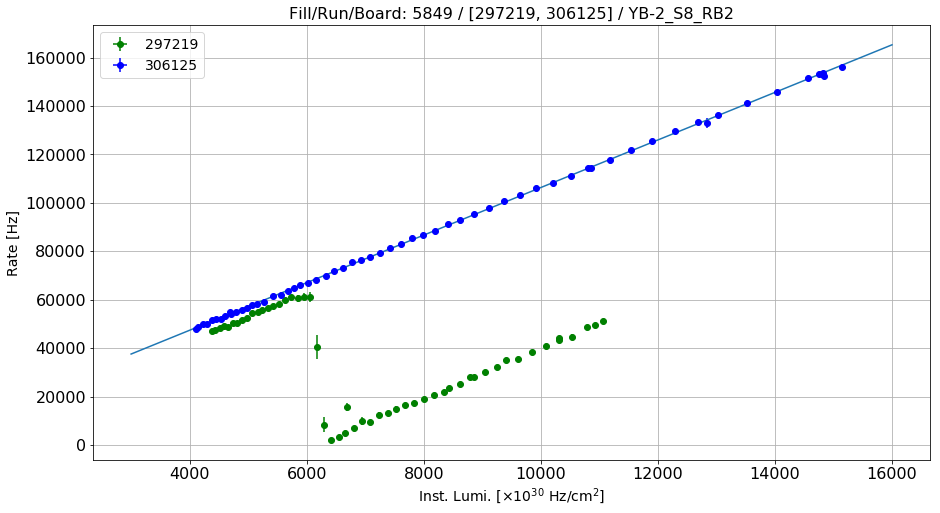

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S8_RB3
Linear fit for the reference run: [ 8.29648333e-09 -2.22586033e-04  2.92806391e+00]


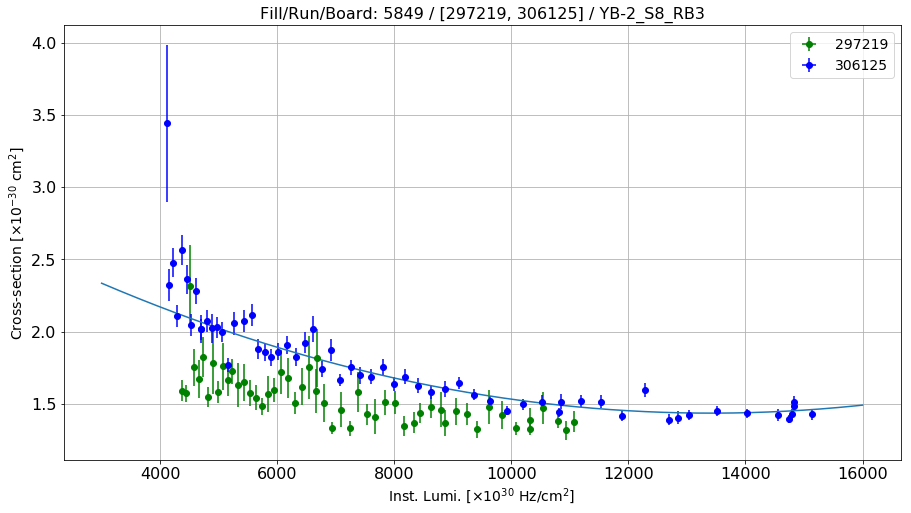

Linear fit parameters: [1.10189462e+00 4.59249817e+03]


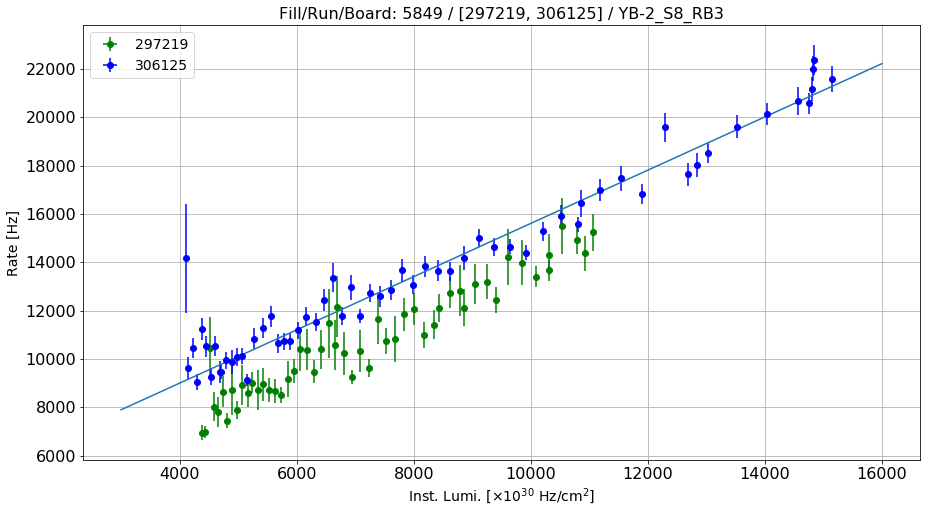

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S8_RB4
Linear fit for the reference run: [ 4.89140117e-09 -1.52451968e-04  1.16323195e+01]


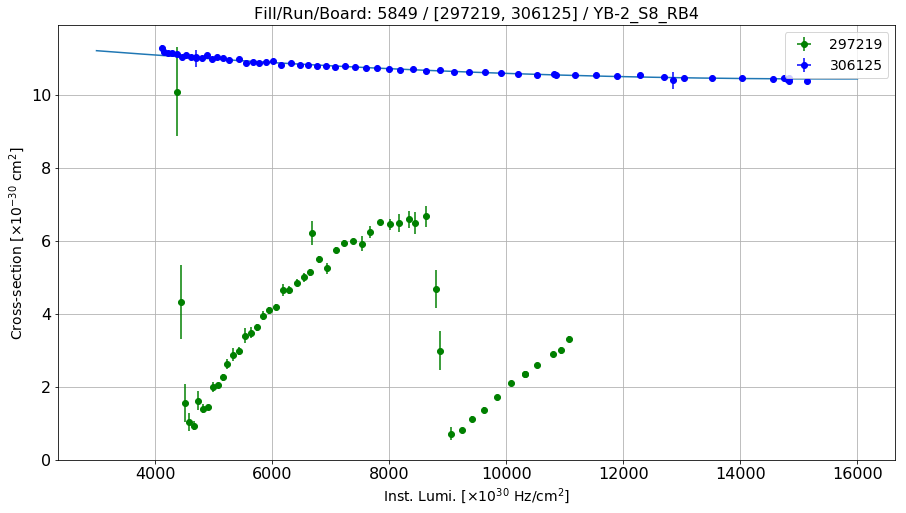

Linear fit parameters: [  10.13491292 4578.81750179]


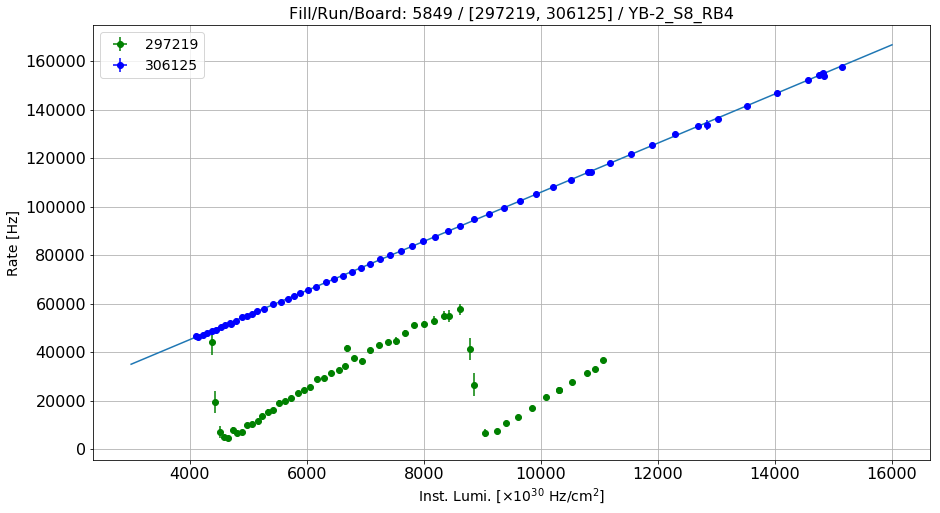

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S9_RB1
Linear fit for the reference run: [ 1.10894692e-07 -2.67009154e-03  5.37567129e+01]


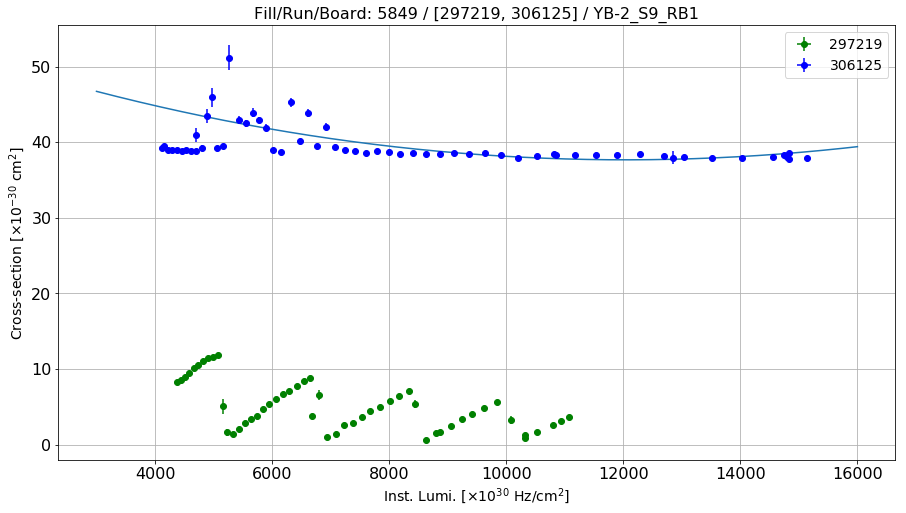

Linear fit parameters: [   35.39643108 34482.69934599]


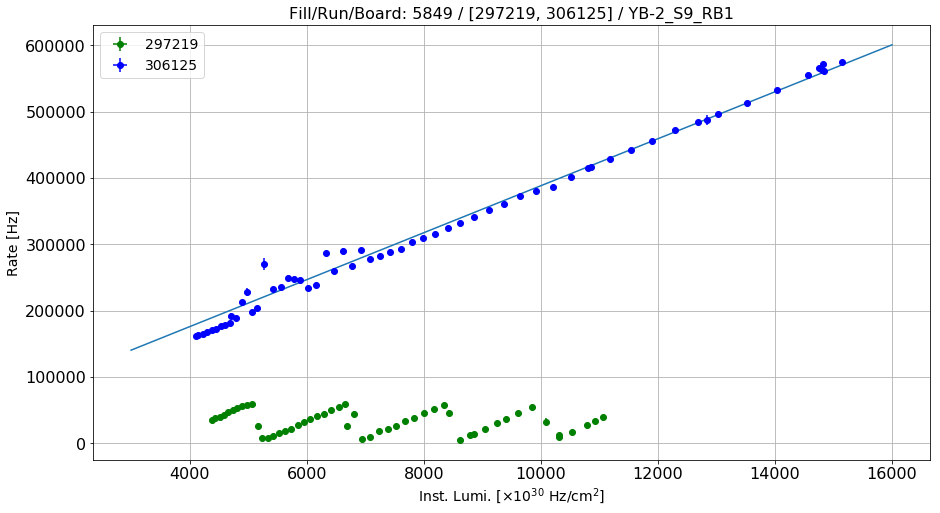

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S9_RB2
Linear fit for the reference run: [ 3.55296963e-09 -1.12090531e-04  9.55752468e+00]


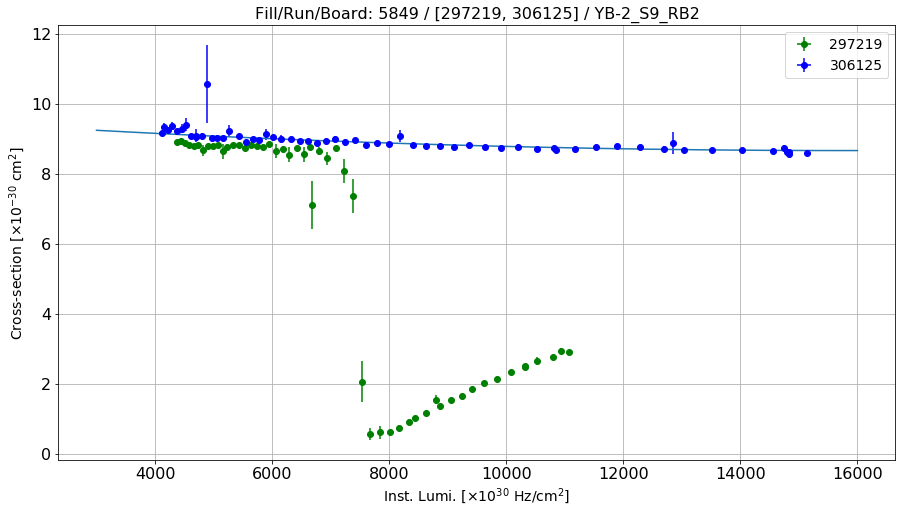

Linear fit parameters: [   8.44300869 3445.30298969]


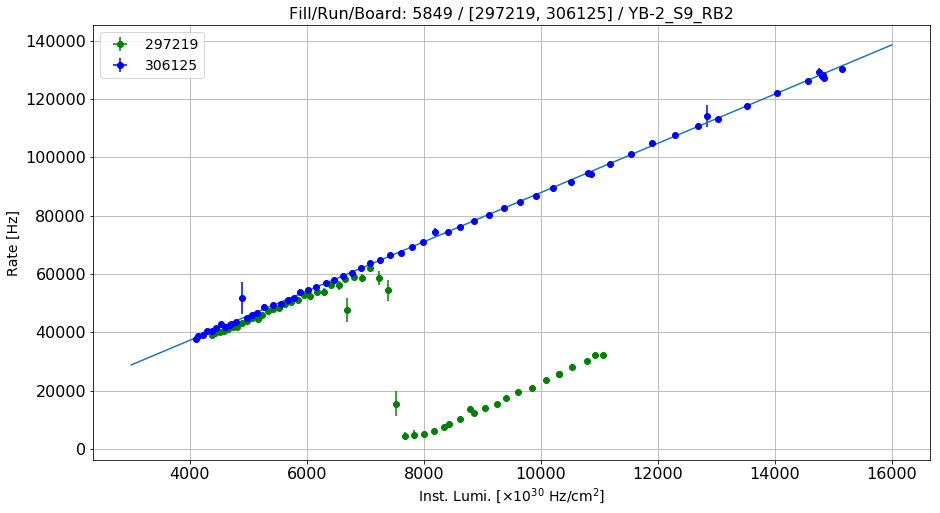

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S9_RB3
Linear fit for the reference run: [ 2.42026886e-09 -7.71732889e-05  1.42993476e+00]


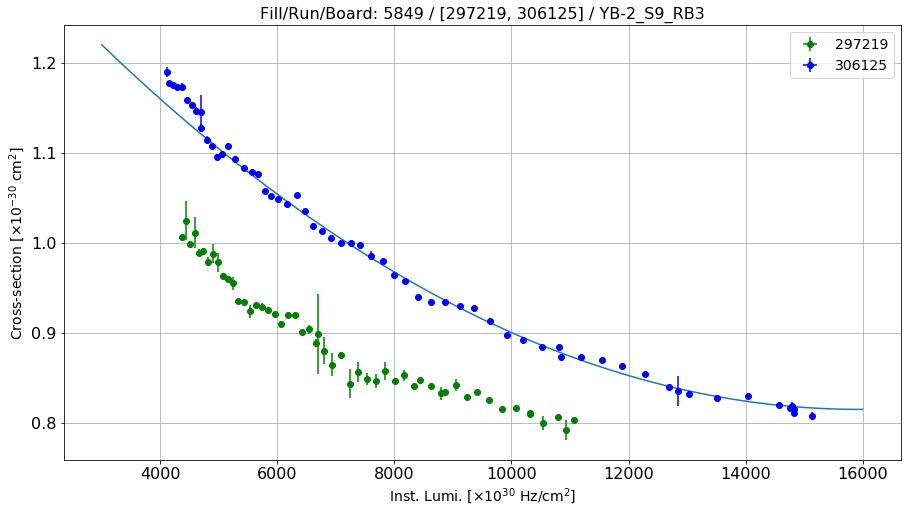

Linear fit parameters: [6.54519139e-01 2.41902626e+03]


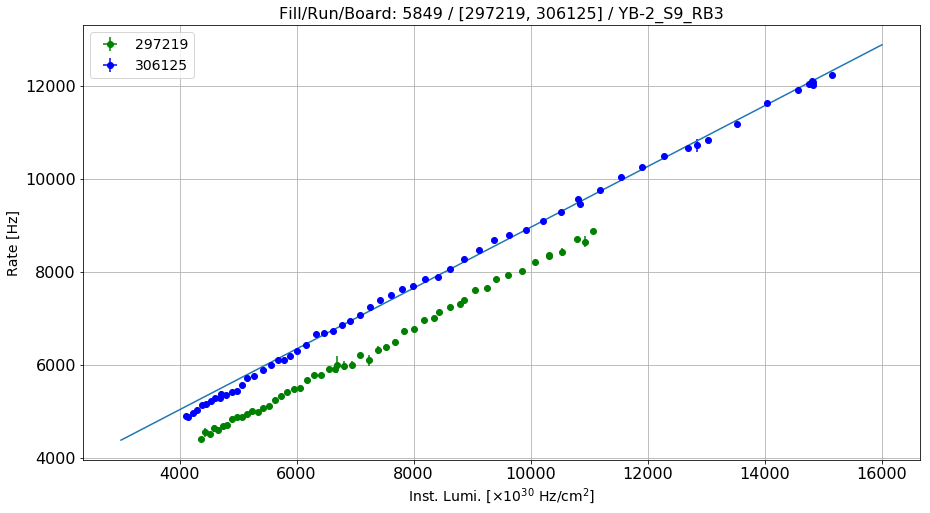

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S9_RB4
Linear fit for the reference run: [ 3.11100633e-09 -9.54813688e-05  2.36496046e+00]


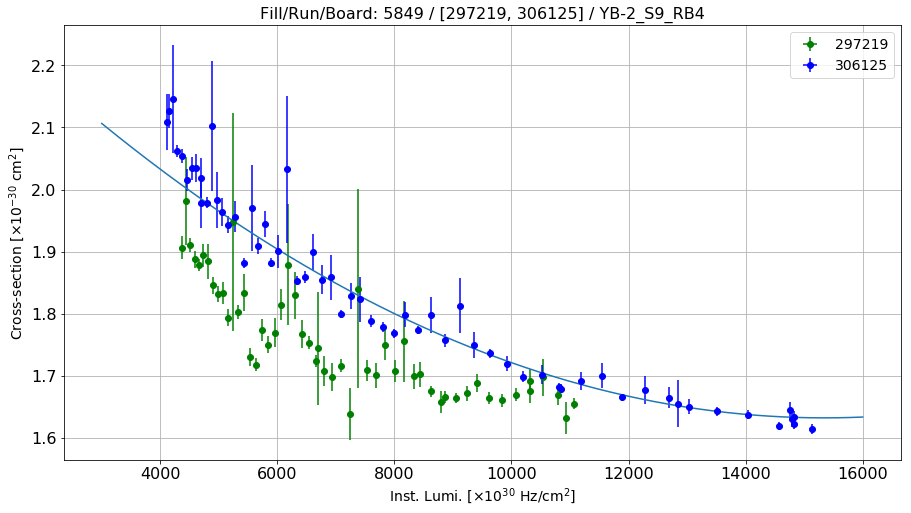

Linear fit parameters: [1.44193915e+00 2.78165794e+03]


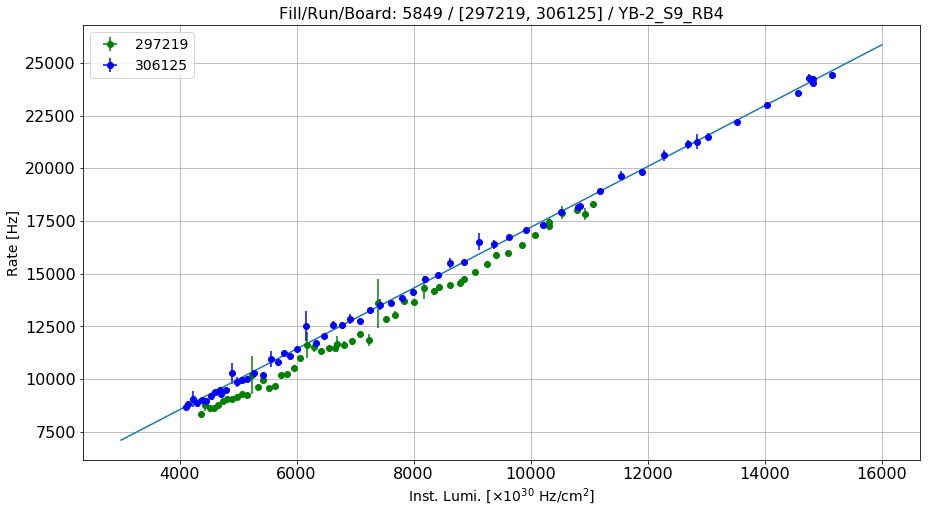

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S10_RB1
Linear fit for the reference run: [-1.47593851e-09 -5.07139541e-05  3.05666391e+01]


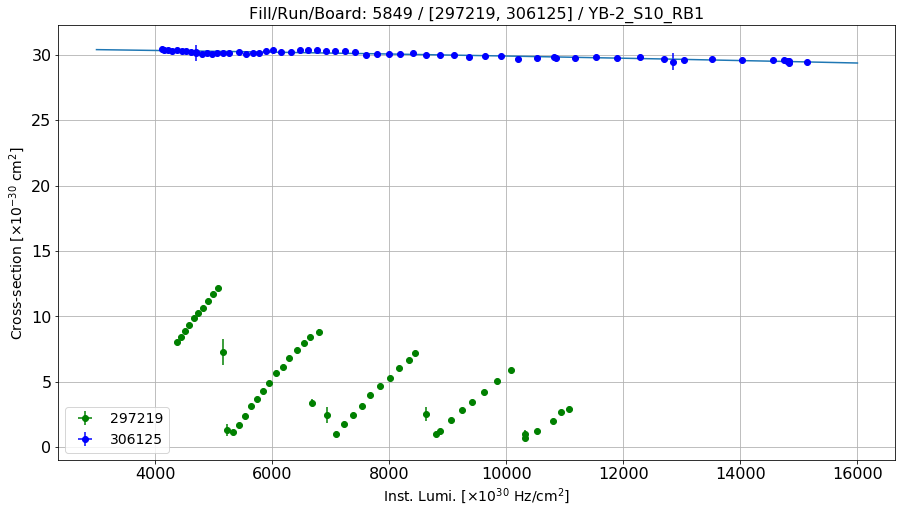

Linear fit parameters: [  29.10090661 7146.47656829]


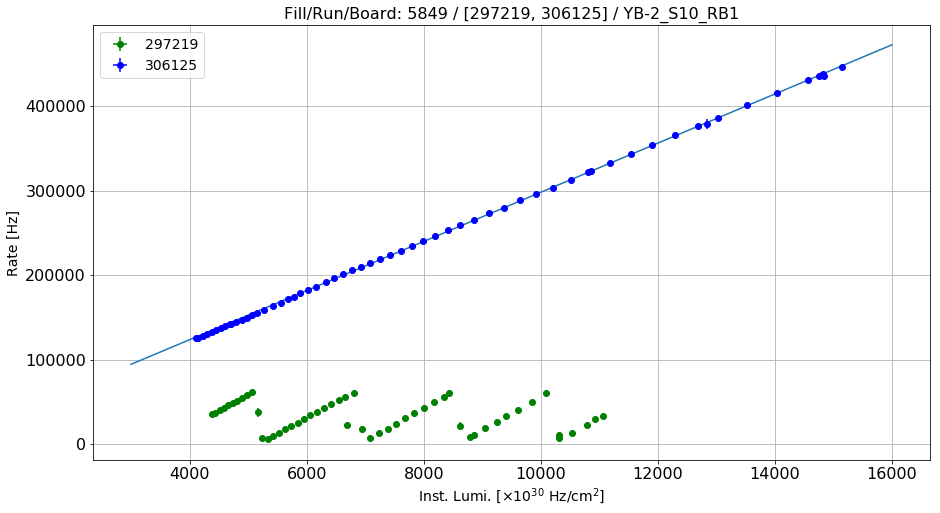

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S10_RB2
Linear fit for the reference run: [ 9.59993449e-09 -2.60496644e-04  1.06923977e+01]


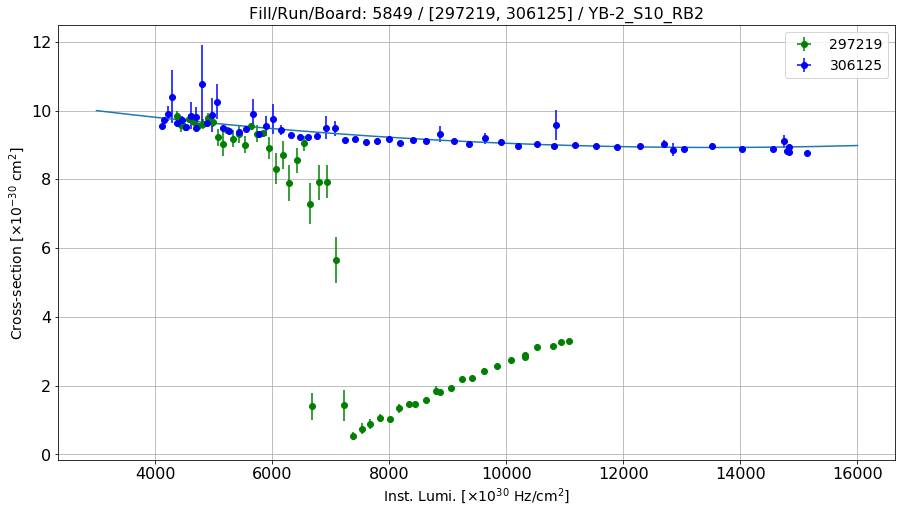

Linear fit parameters: [   8.52102254 5573.29504016]


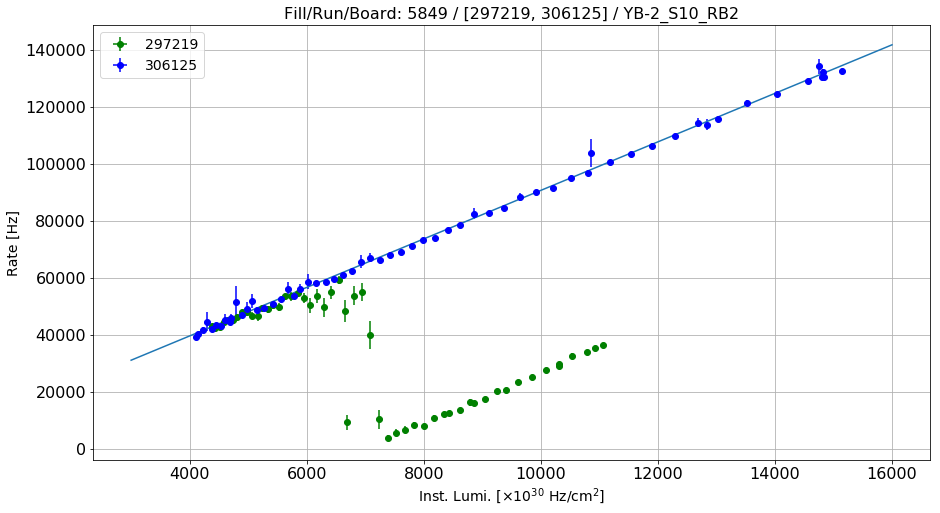

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S10_RB3
Linear fit for the reference run: [ 3.10197986e-09 -1.02150850e-04  1.41833252e+00]


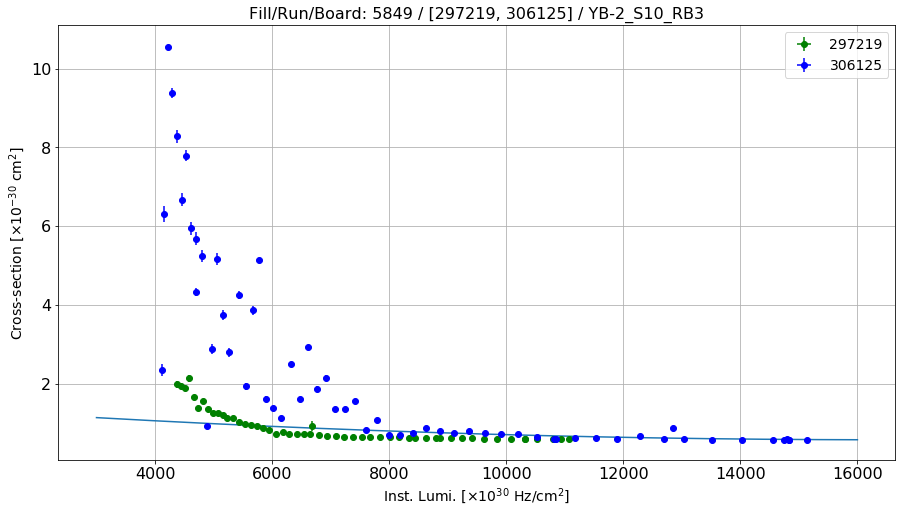

Linear fit parameters: [3.27020327e-01 3.78659323e+03]


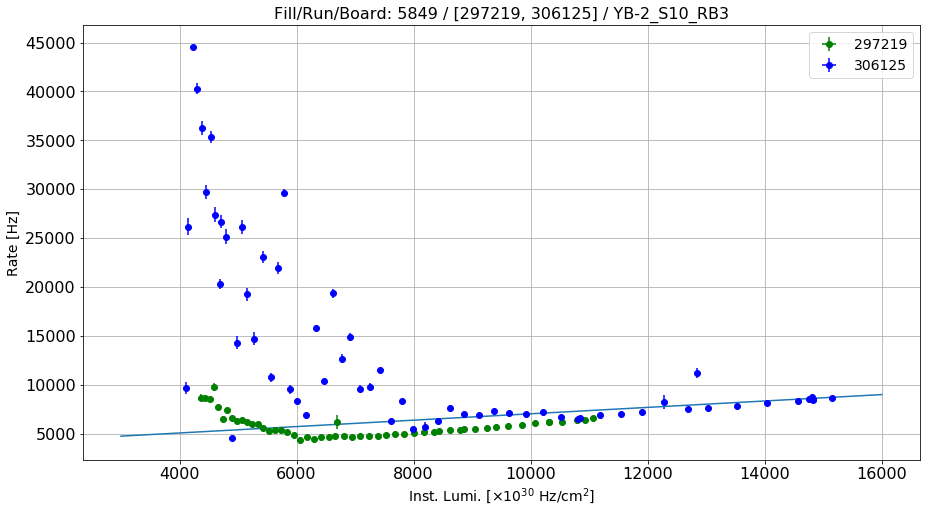

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S10_RB4
Linear fit for the reference run: [ 4.12806911e-09 -1.20660613e-04  2.67840500e+00]


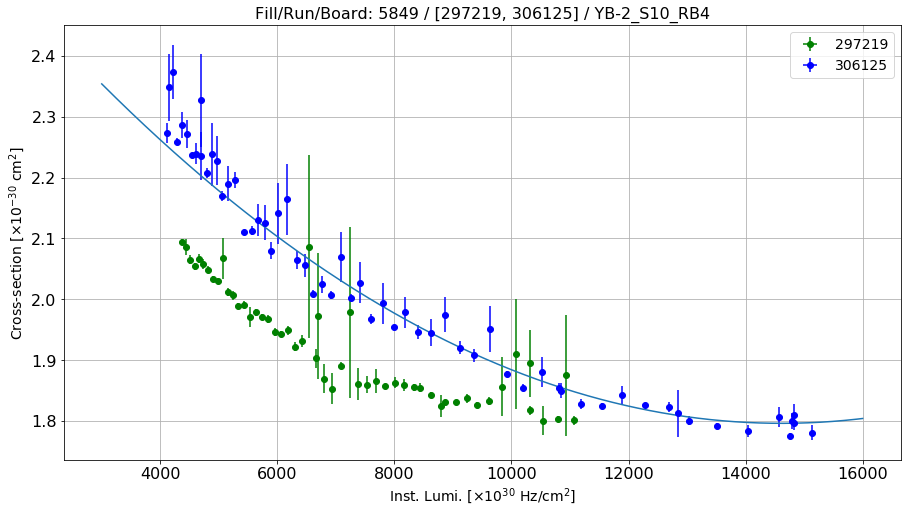

Linear fit parameters: [1.57329941e+00 3.15881693e+03]


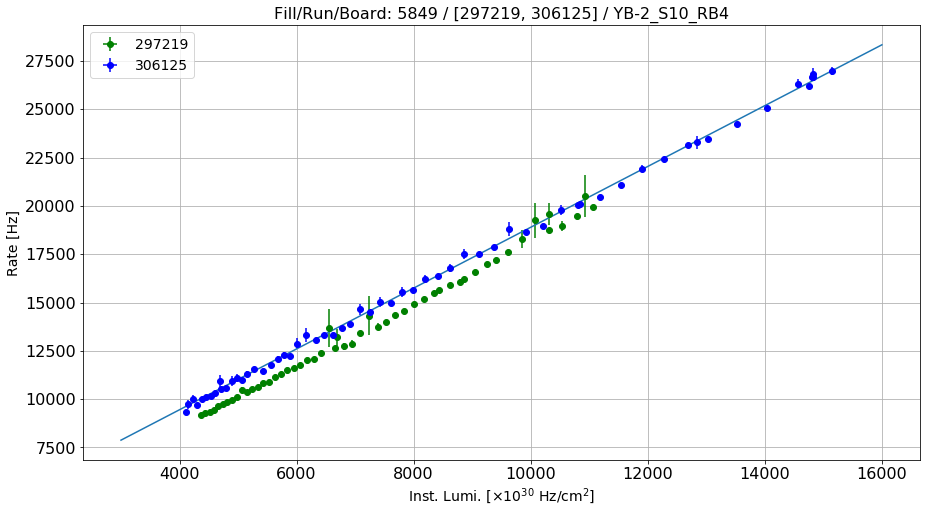

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S11_RB1
Linear fit for the reference run: [ 5.53686405e-09 -2.39549161e-04  3.98504323e+01]


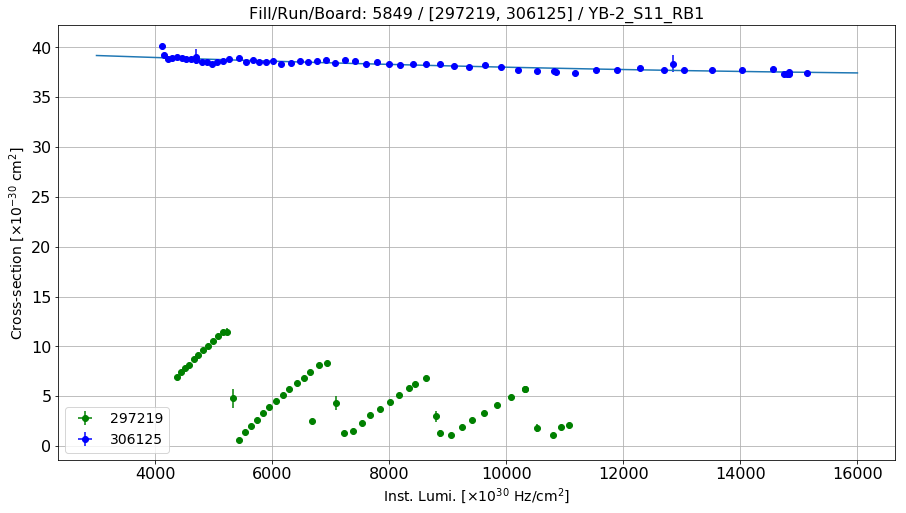

Linear fit parameters: [   36.82742546 11089.15035605]


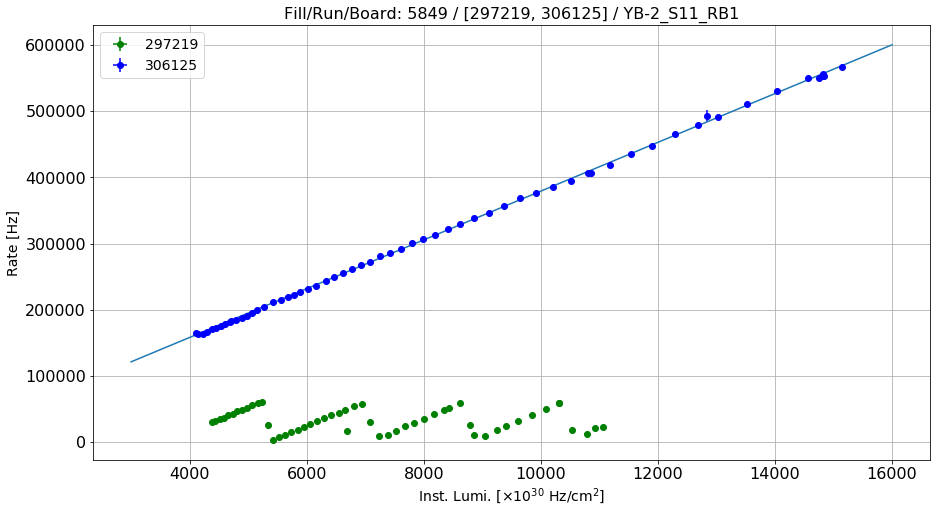

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S11_RB2
Linear fit for the reference run: [ 5.02002070e-09 -1.65749439e-04  1.06794347e+01]


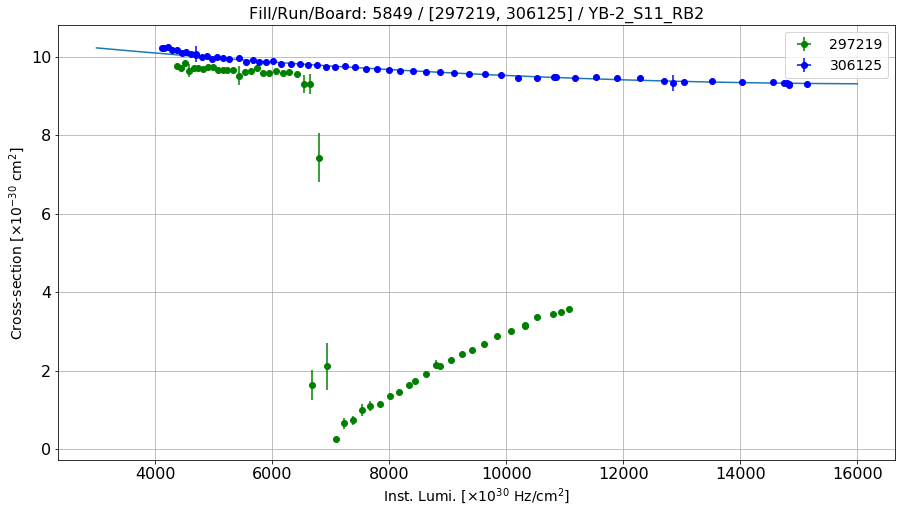

Linear fit parameters: [   8.95848647 5518.27623821]


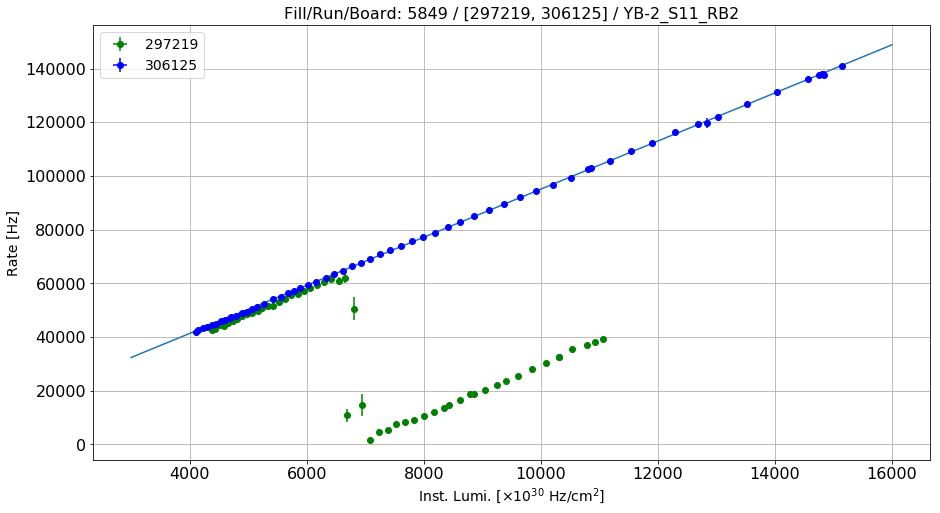

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S11_RB3
Linear fit for the reference run: [ 2.89795503e-09 -2.98970636e-04  5.97722259e+00]


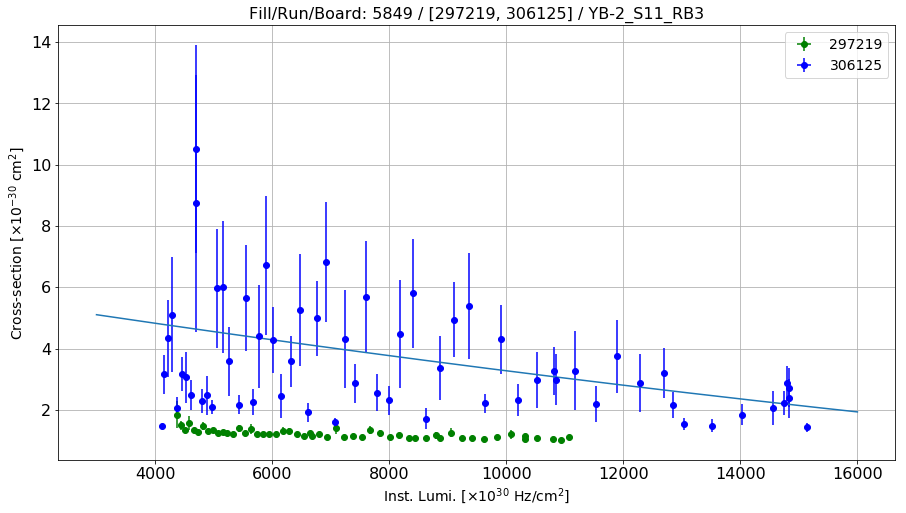

Linear fit parameters: [9.53199719e-01 2.11109291e+04]


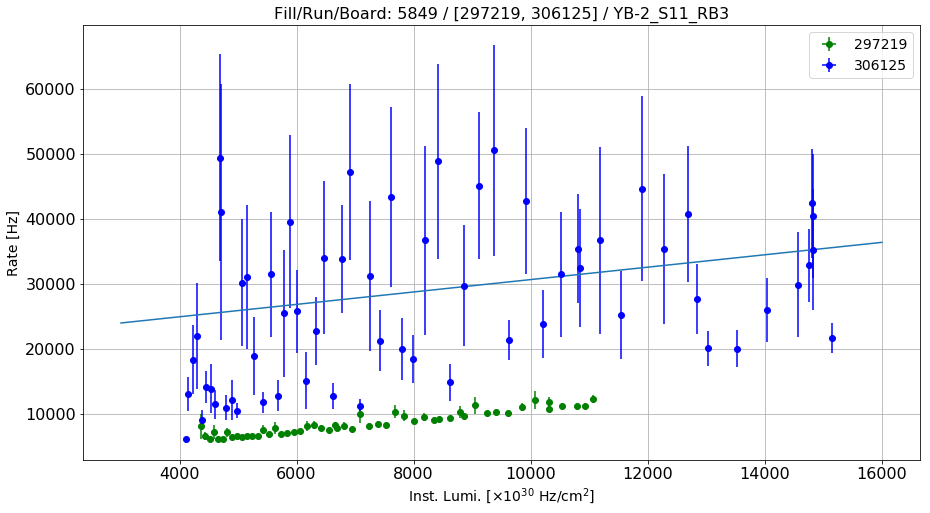

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S11_RB4
Linear fit for the reference run: [ 1.55662033e-09 -4.55167960e-05  1.71326589e+00]


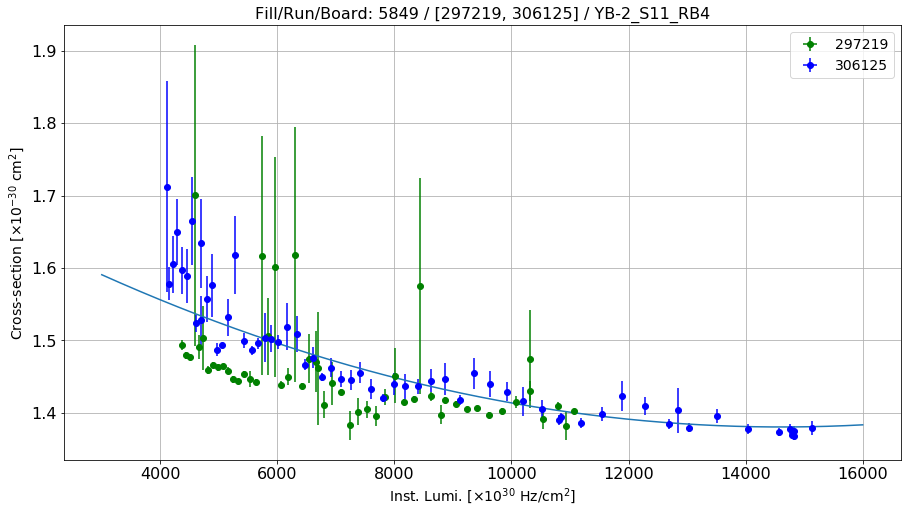

Linear fit parameters: [   1.29619647 1192.70743248]


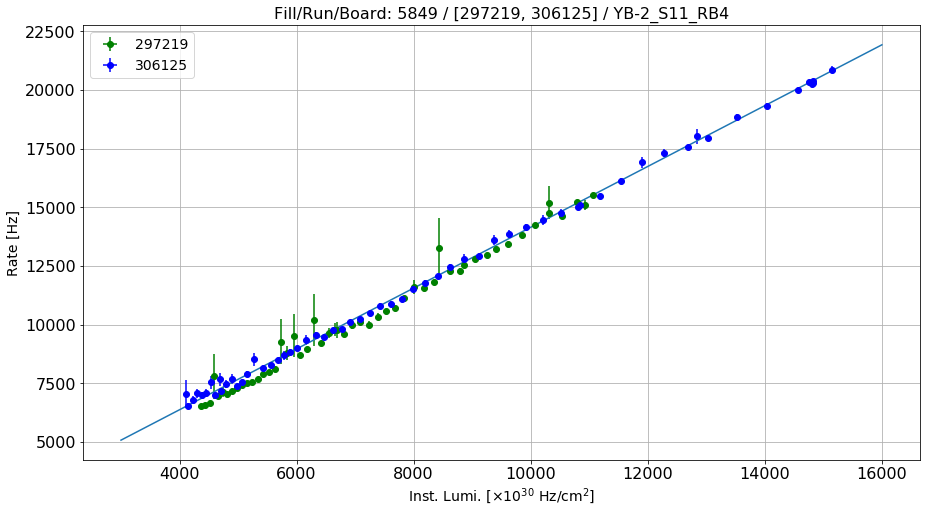

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S12_RB1
Linear fit for the reference run: [ 1.56068641e-08 -6.55275423e-04  4.68537771e+01]


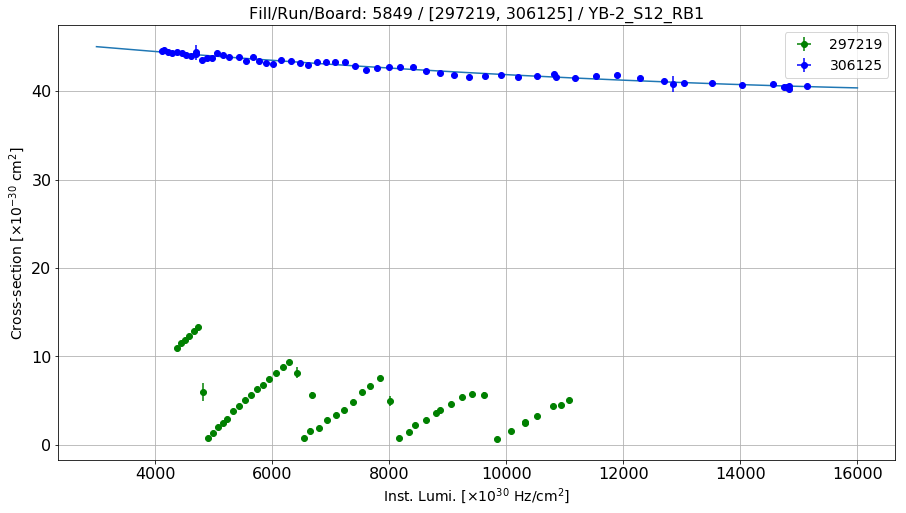

Linear fit parameters: [   38.72824527 29498.37804306]


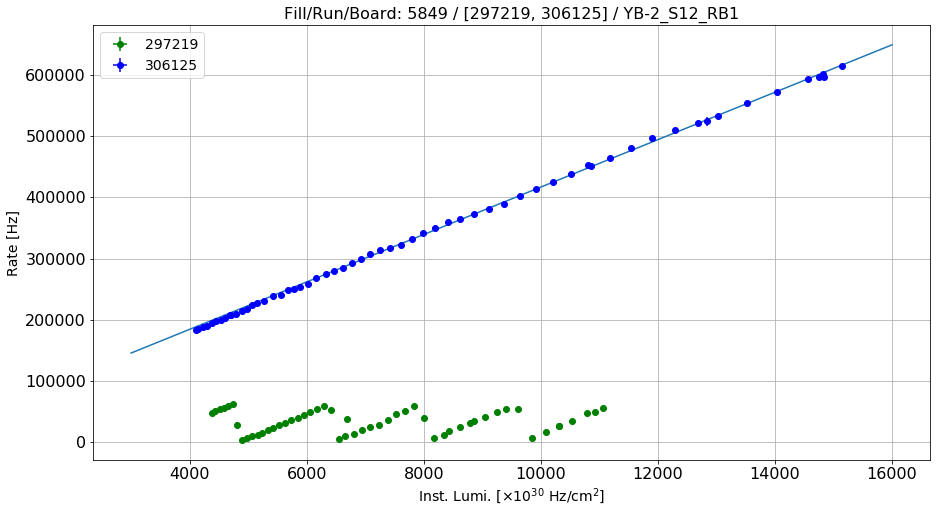

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S12_RB2
Linear fit for the reference run: [ 3.29663015e-09 -1.13222128e-04  1.03958254e+01]


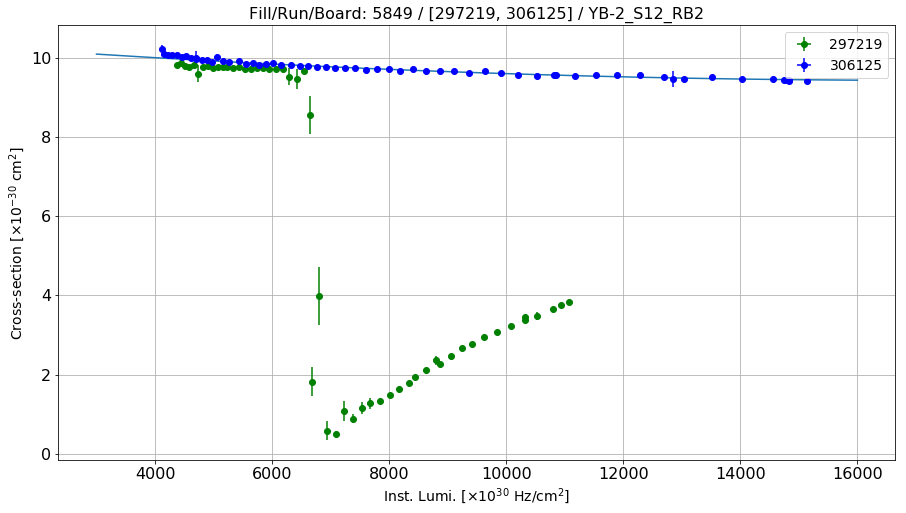

Linear fit parameters: [   9.17894099 4009.61386024]


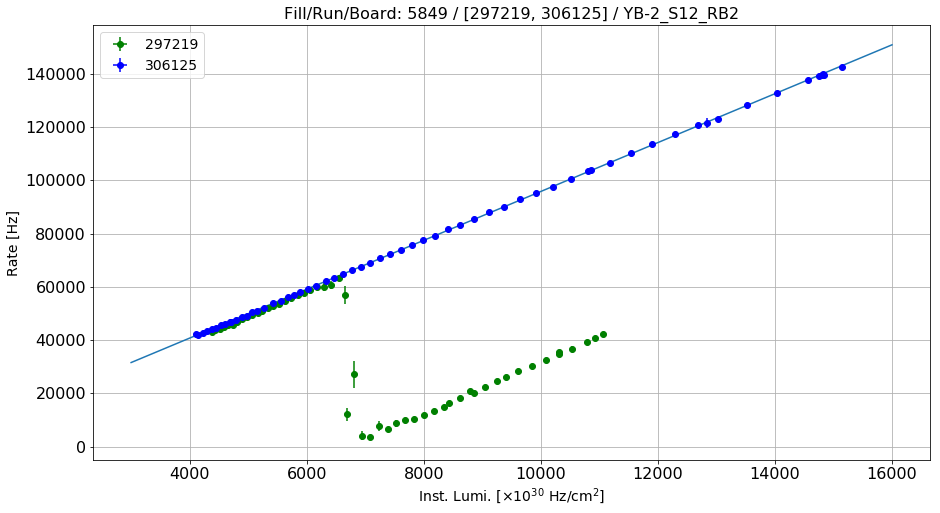

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S12_RB3
Linear fit for the reference run: [ 3.24671921e-09 -9.40248555e-05  1.05417210e+00]


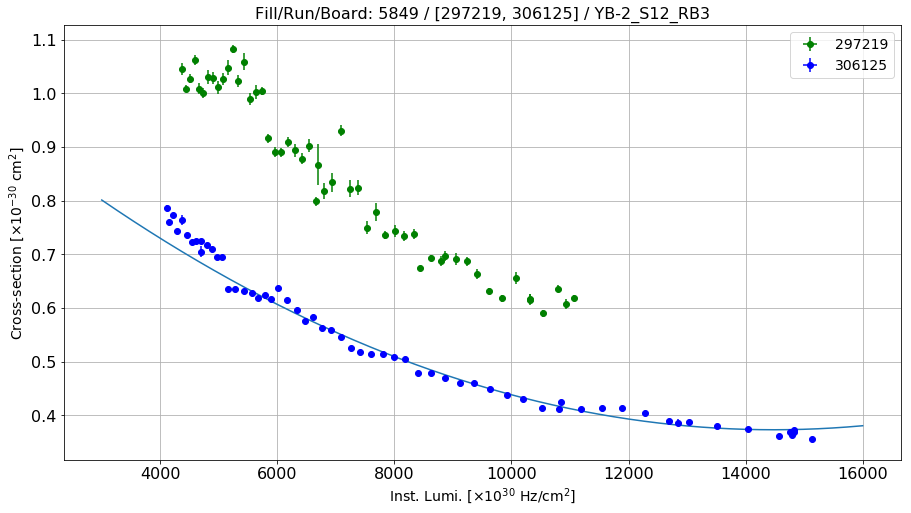

Linear fit parameters: [2.02347281e-01 2.40729204e+03]


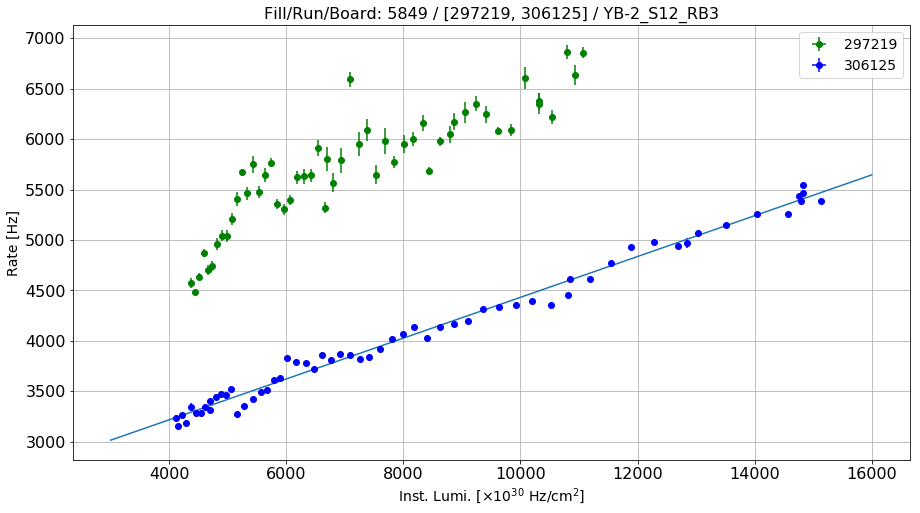

Fill/Run/Board: 5849 / [297219, 306125] / YB-2_S12_RB4
Linear fit for the reference run: [ 4.34517695e-09 -1.48792920e-04  1.68481340e+01]


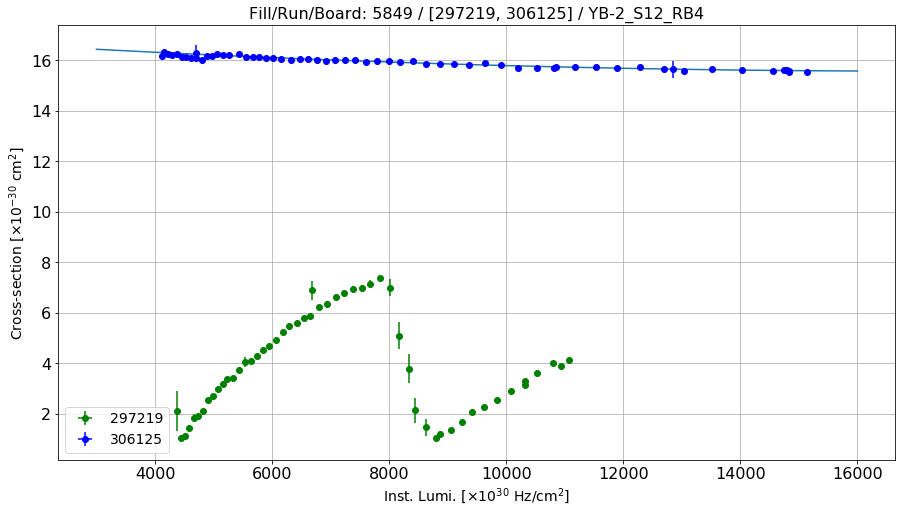

Linear fit parameters: [  15.25295021 5246.01987324]


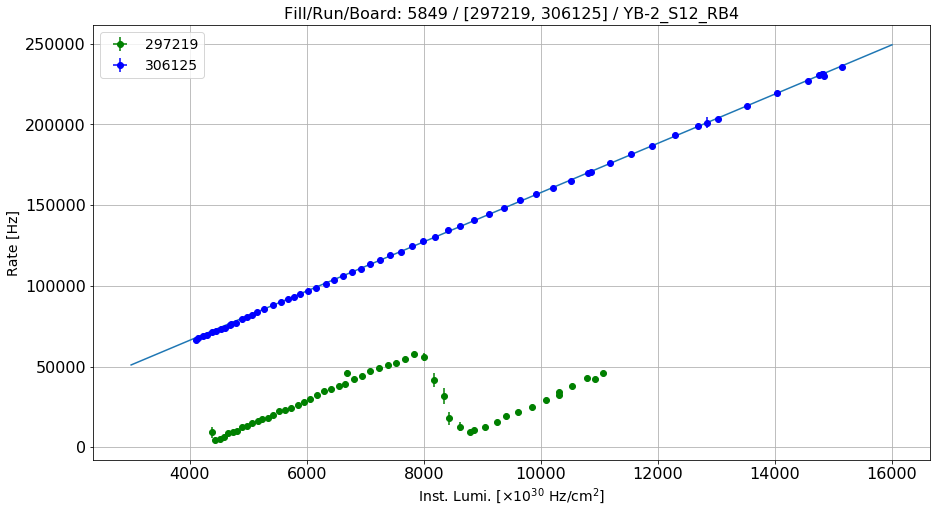

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S1_RB1
Linear fit for the reference run: [ 7.11608770e-10 -4.29750680e-05  1.65594722e+01]


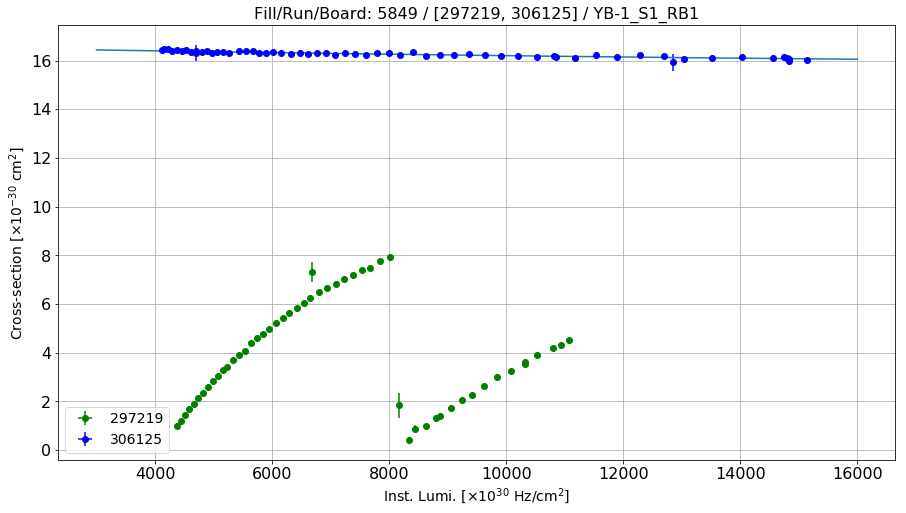

Linear fit parameters: [  15.929304   2499.88427102]


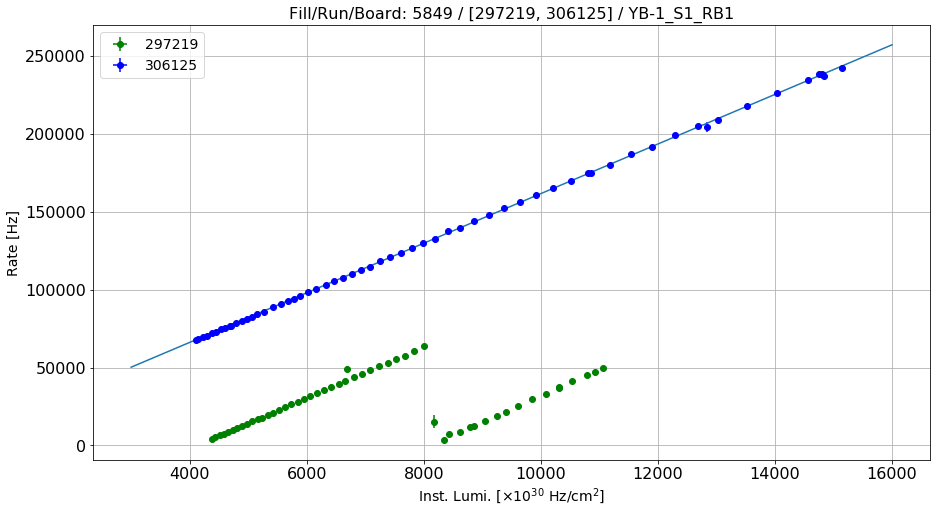

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S1_RB2
Linear fit for the reference run: [ 2.49173259e-09 -8.87493471e-05  4.52963469e+00]


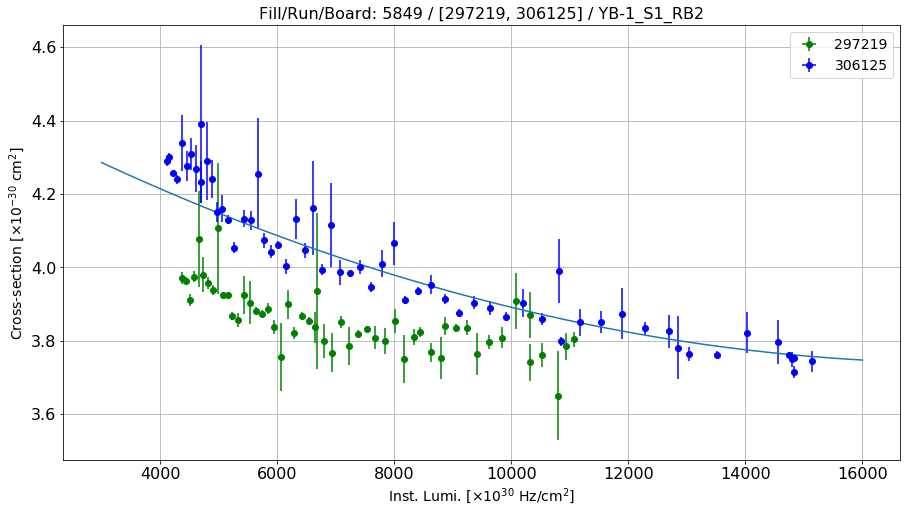

Linear fit parameters: [   3.54698536 3310.27077982]


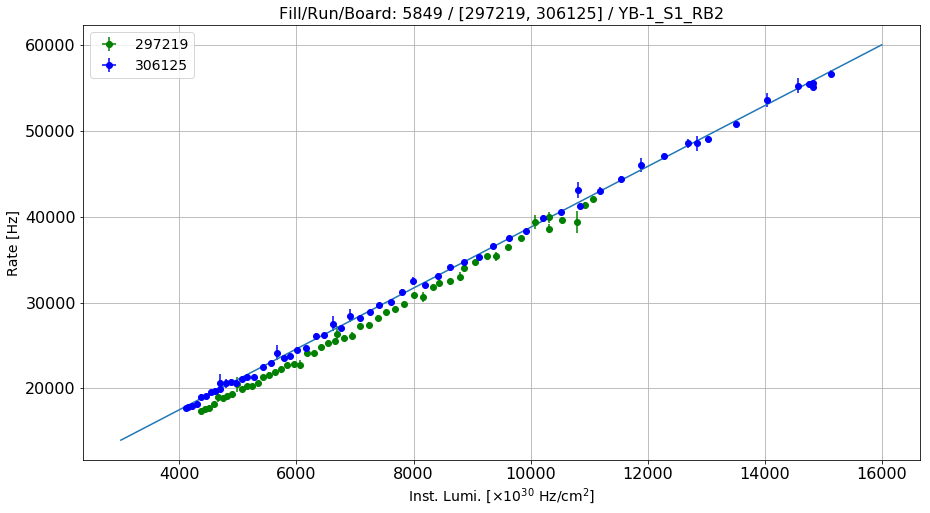

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S1_RB3
Linear fit for the reference run: [-3.50952511e-12  6.23788448e-08  2.78750658e-04]


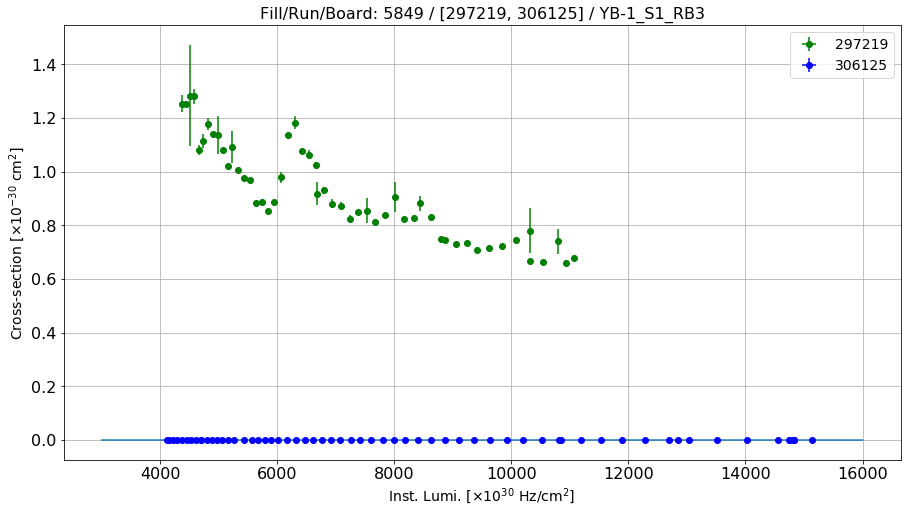

Linear fit parameters: [4.21183511e-04 8.59423558e-01]


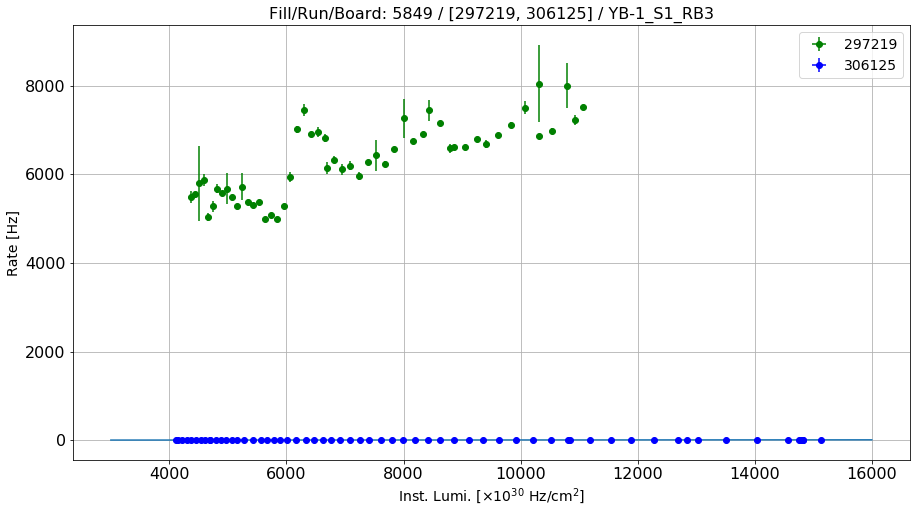

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S1_RB4
Linear fit for the reference run: [ 1.10819488e-08 -4.47702323e-04  2.47398163e+01]


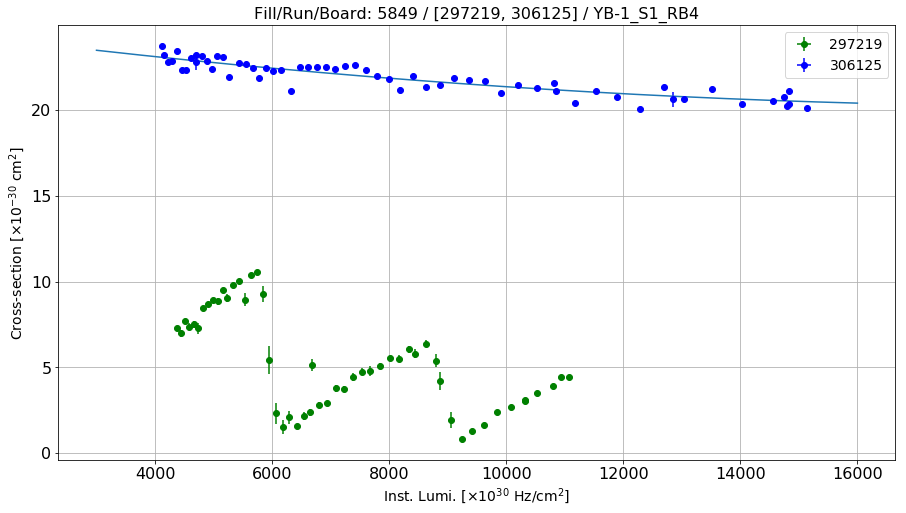

Linear fit parameters: [1.93188523e+01 1.93949809e+04]


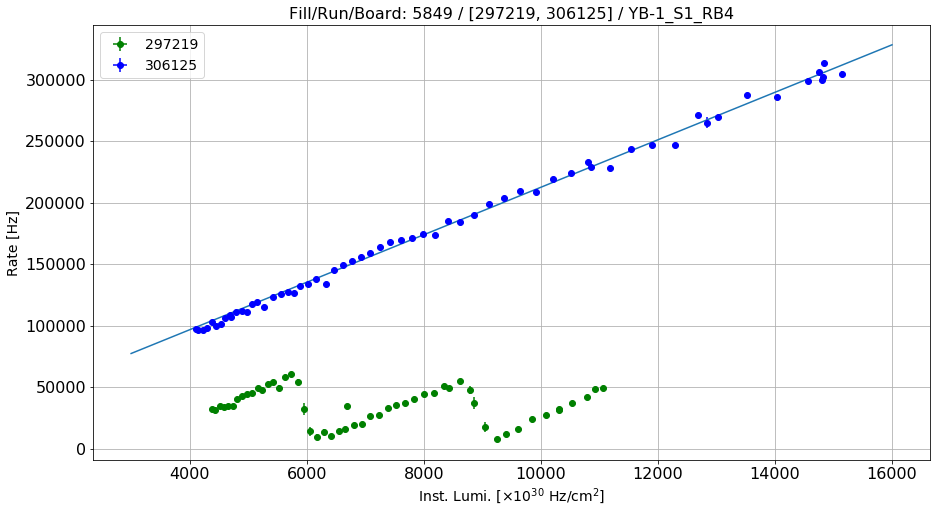

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S2_RB1
Linear fit for the reference run: [ 1.56170405e-08 -4.96576440e-04  2.11703113e+01]


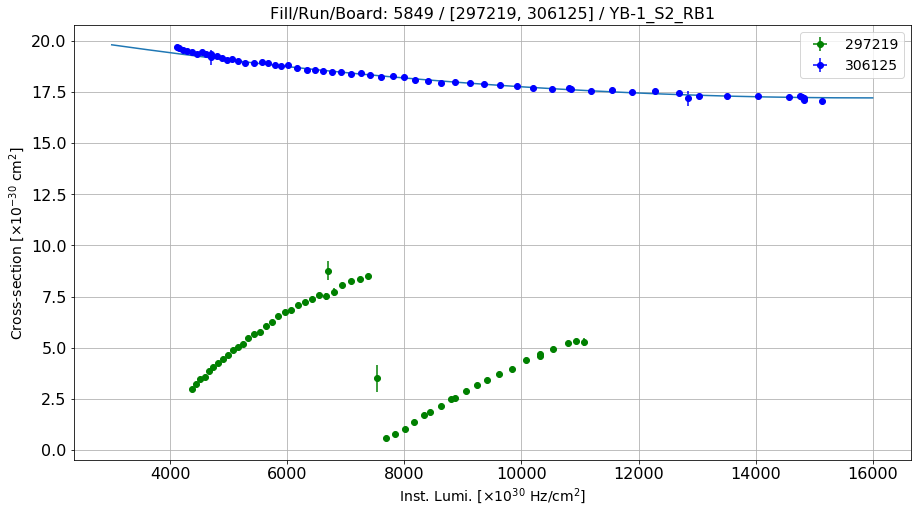

Linear fit parameters: [   16.19446627 15486.24756267]


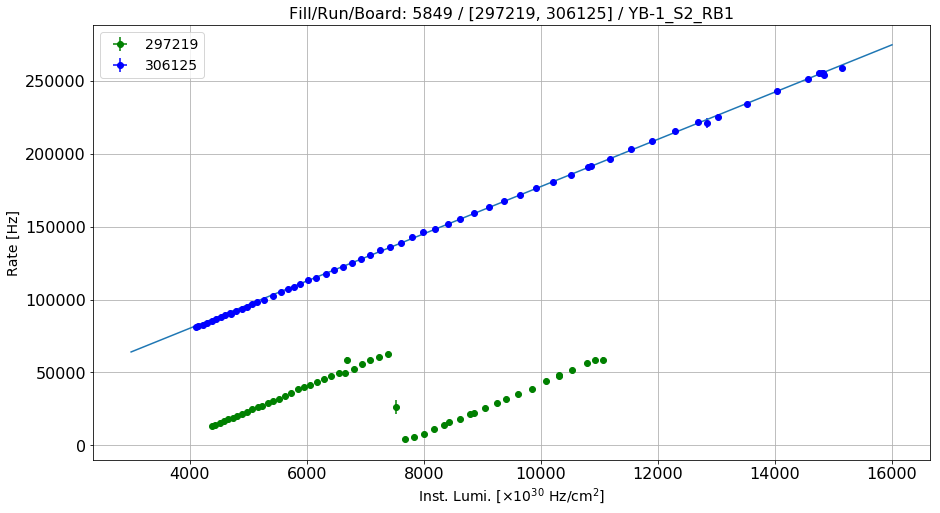

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S2_RB2
Linear fit for the reference run: [ 2.87950560e-09 -9.37119174e-05  4.77677700e+00]


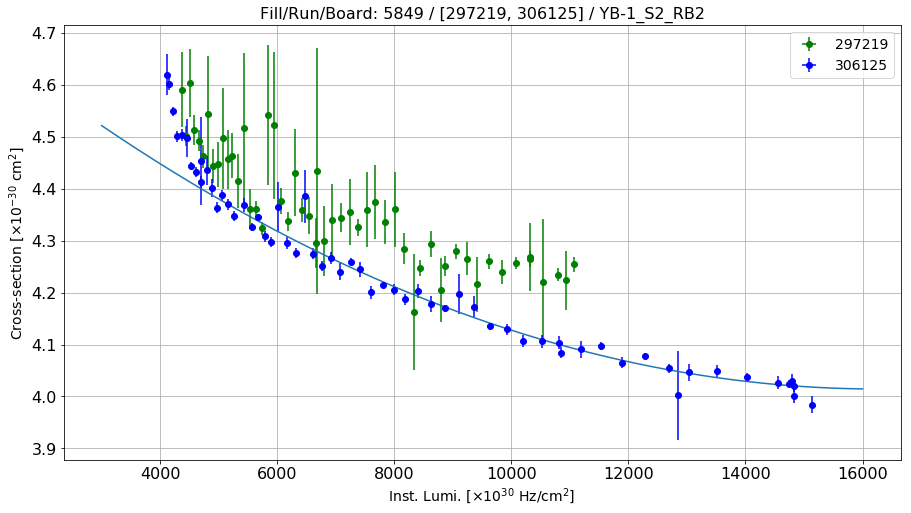

Linear fit parameters: [   3.81665139 3045.14952485]


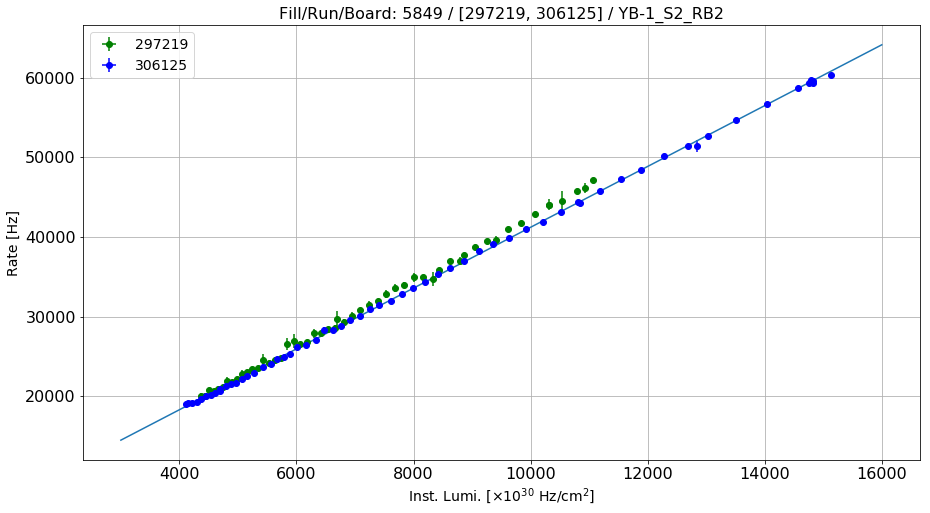

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S2_RB3
Linear fit for the reference run: [ 2.93910641e-09 -8.11511405e-05  1.48676066e+00]


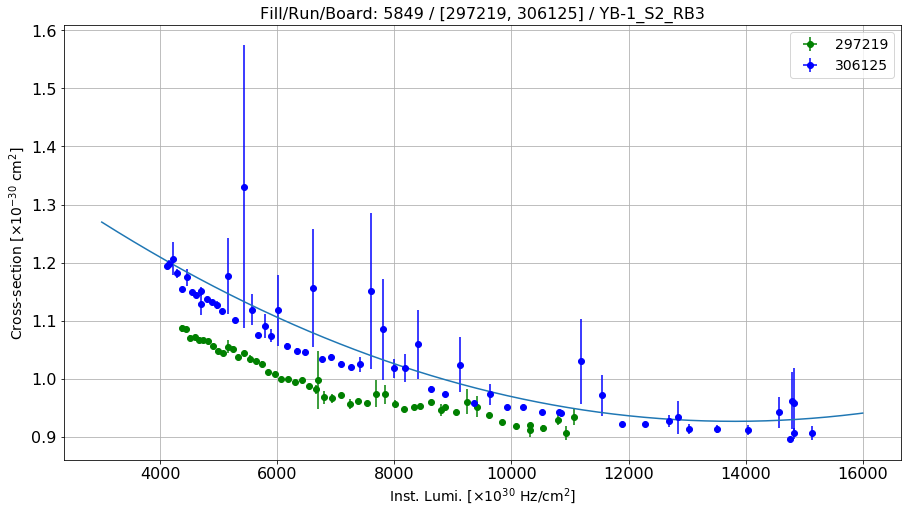

Linear fit parameters: [7.94261559e-01 1.82956436e+03]


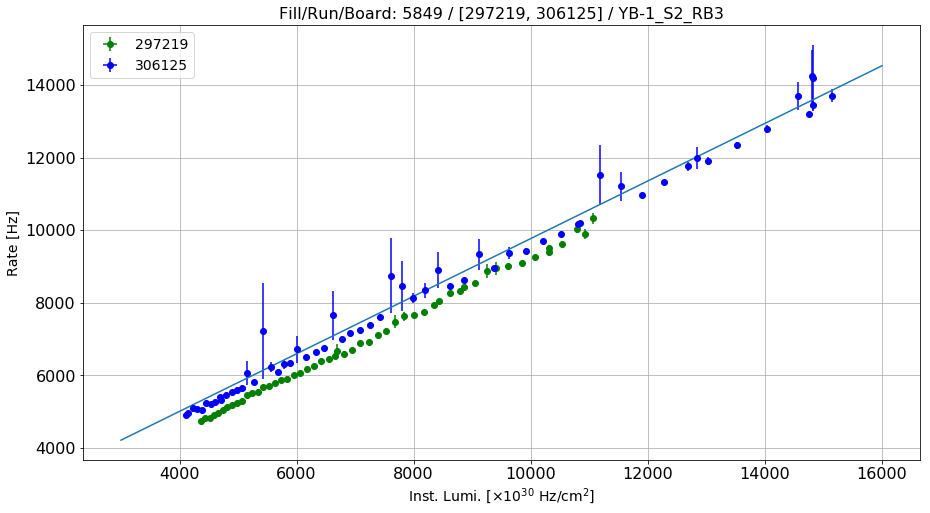

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S2_RB4
Linear fit for the reference run: [-2.71494671e-13 -1.19547259e-08  1.16186029e-03]


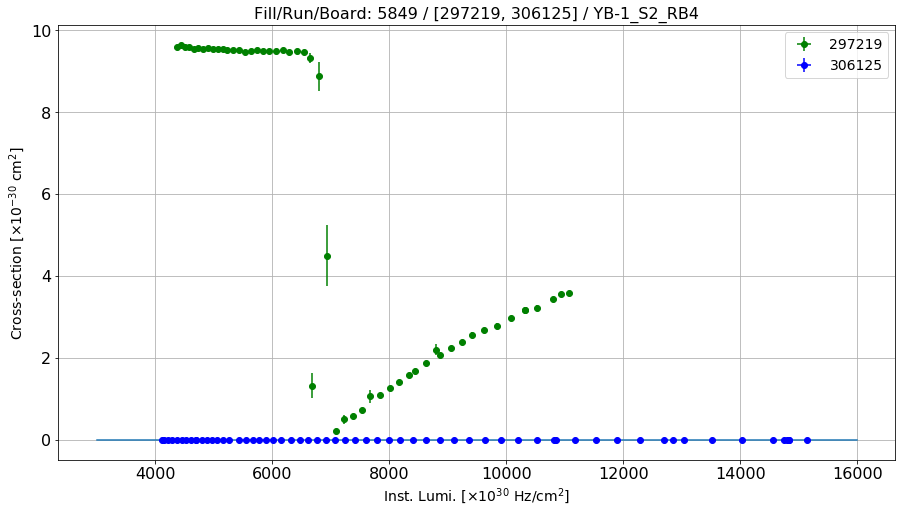

Linear fit parameters: [8.40176691e-04 1.54613165e+00]


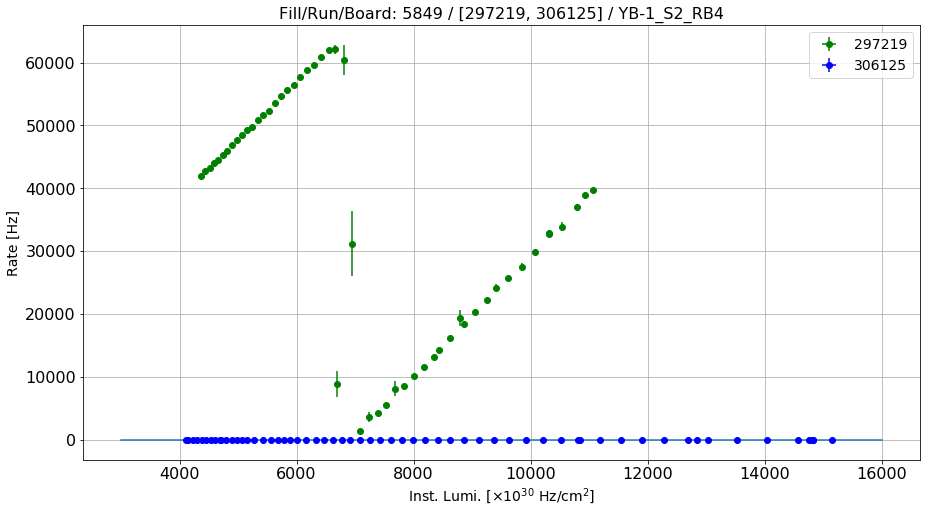

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S3_RB1
Linear fit for the reference run: [ 4.84676369e-09 -1.30783220e-04  1.61645587e+01]


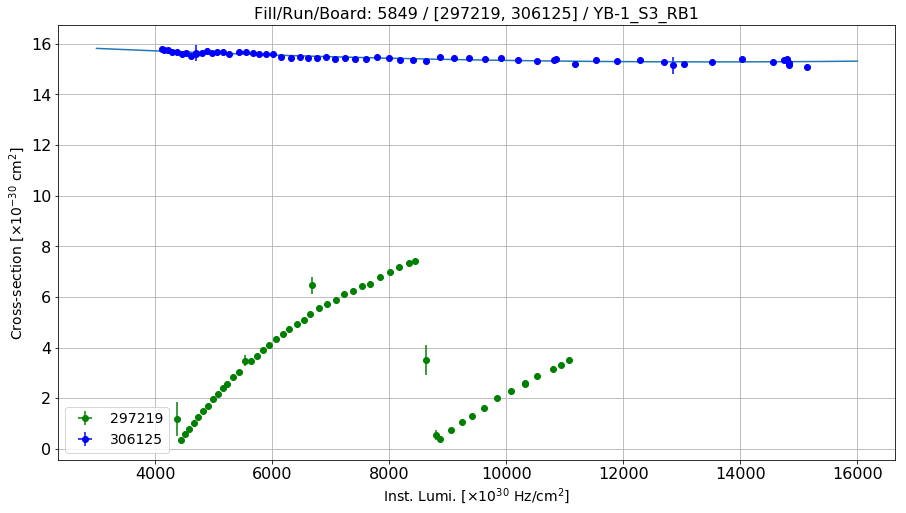

Linear fit parameters: [  15.08285793 2749.01062153]


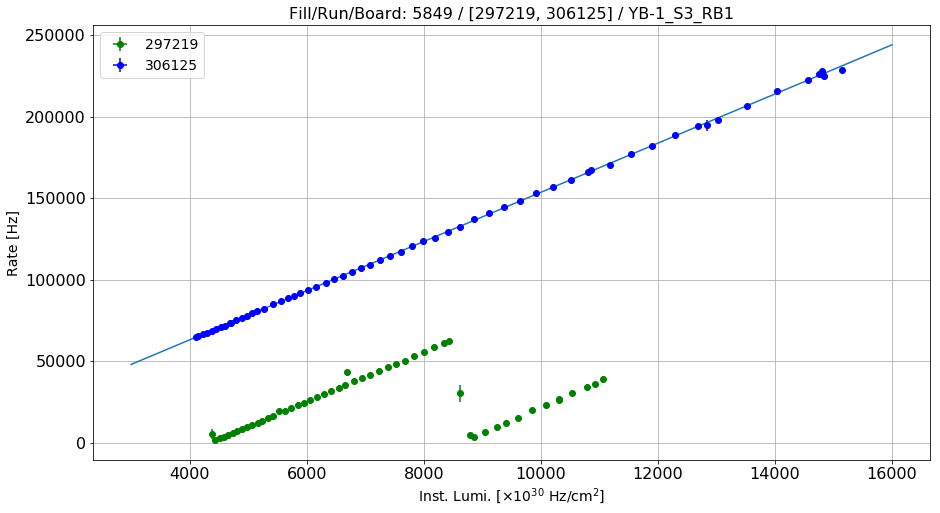

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S3_RB2
Linear fit for the reference run: [ 4.03735035e-09 -1.25090090e-04  4.72259626e+00]


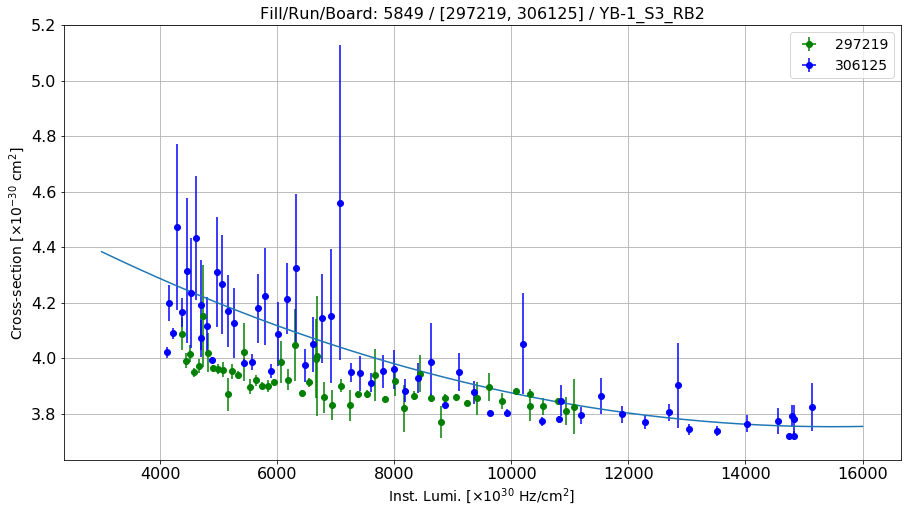

Linear fit parameters: [3.50137962e+00 3.71379471e+03]


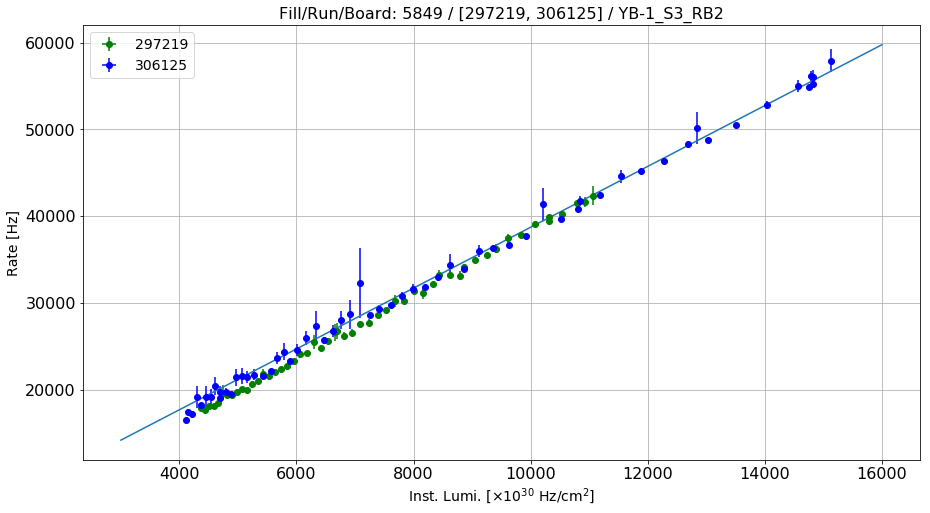

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S3_RB3
Linear fit for the reference run: [ 7.34589860e-09 -2.16449742e-04  2.83403583e+00]


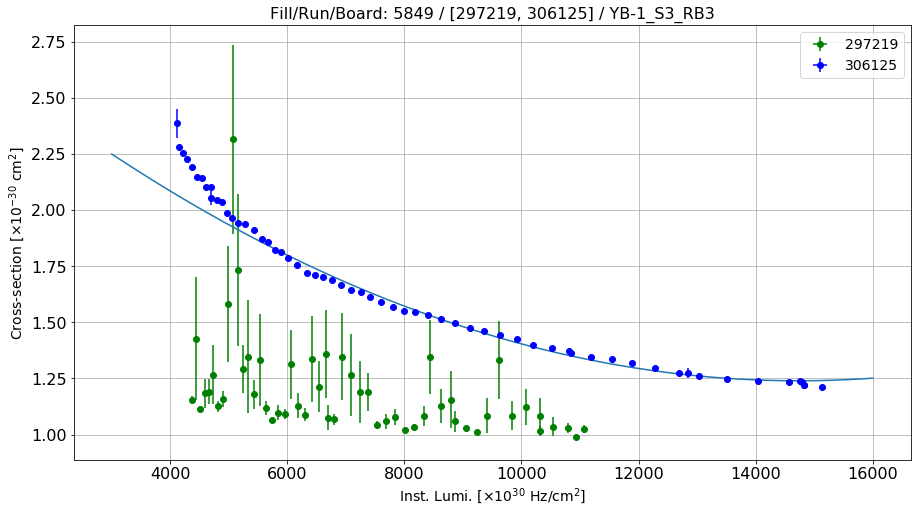

Linear fit parameters: [8.33116841e-01 5.77403124e+03]


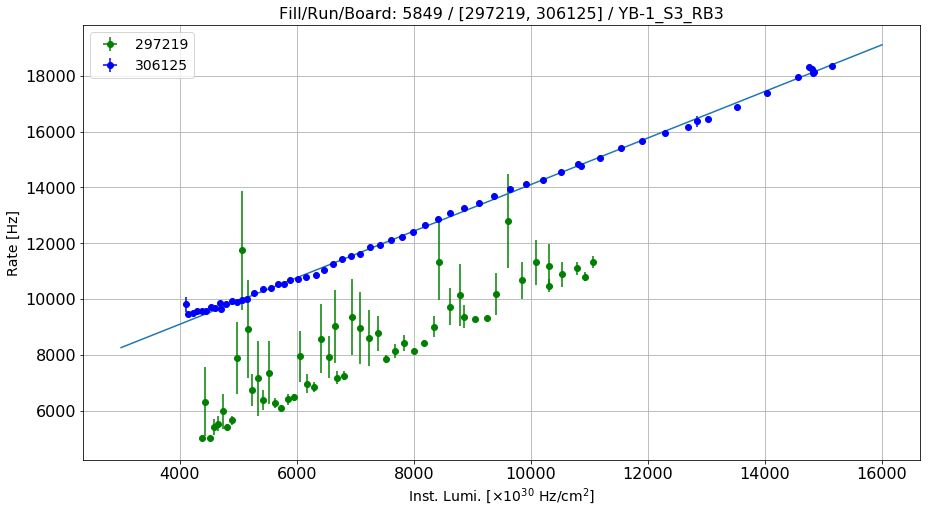

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S3_RB4
Linear fit for the reference run: [ 6.00608807e-09 -2.04172374e-04  3.11334770e+01]


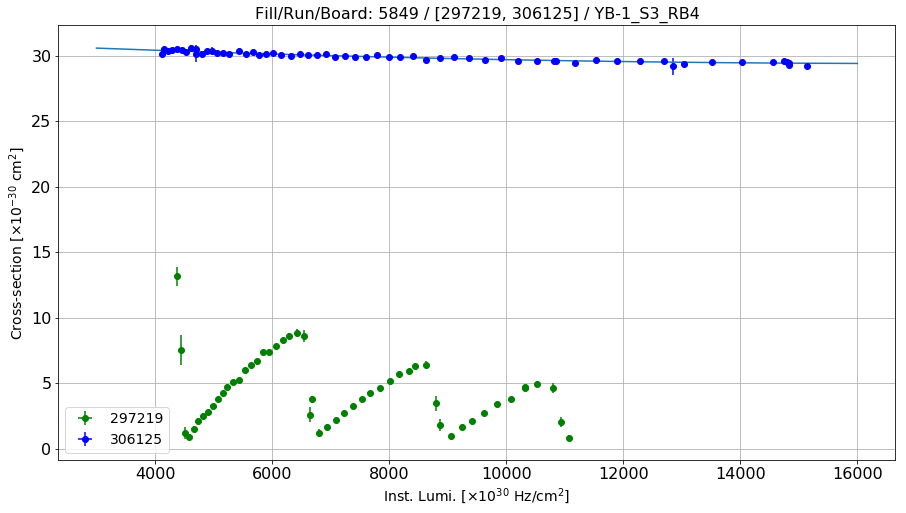

Linear fit parameters: [  28.95819773 7119.40036615]


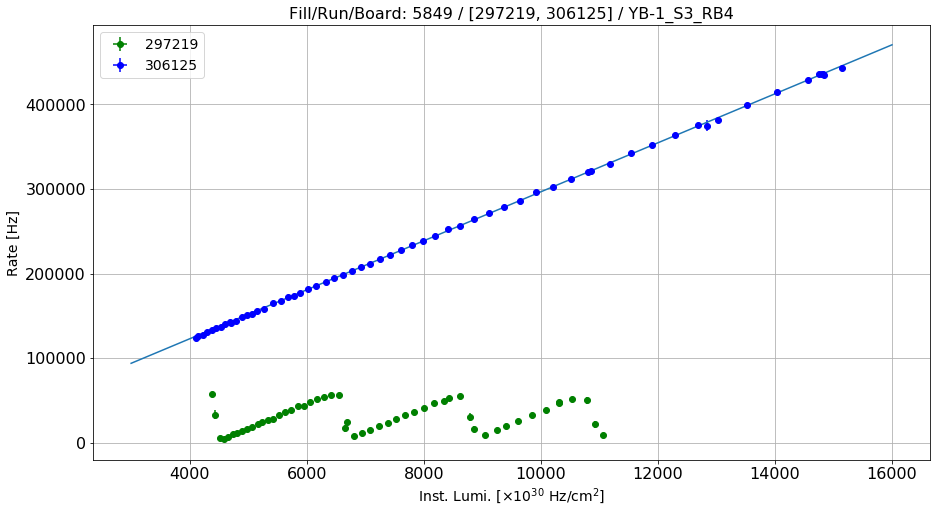

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S4_RB1
Linear fit for the reference run: [ 1.65893797e-09 -6.18997494e-05  1.33066770e+01]


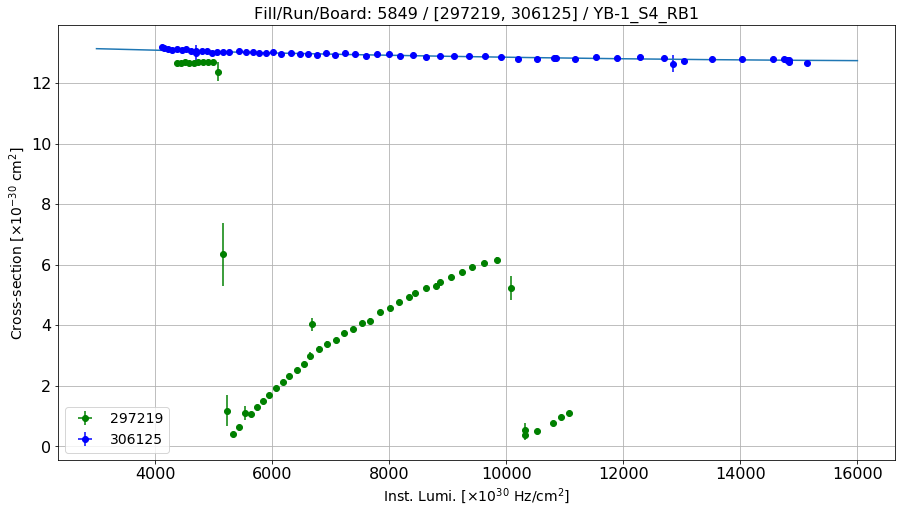

Linear fit parameters: [  12.59668881 2451.89986378]


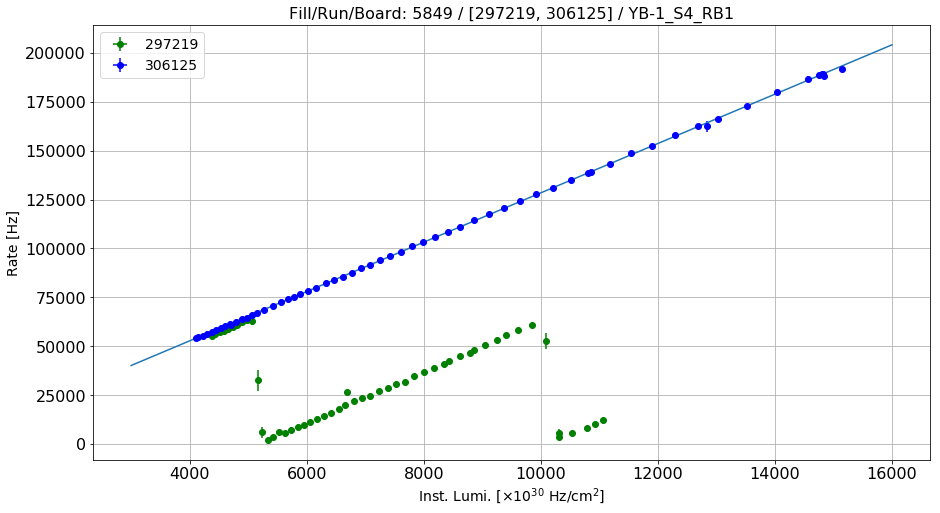

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S4_RB2
Linear fit for the reference run: [ 9.27420424e-08 -2.59878388e-03  2.63381354e+01]


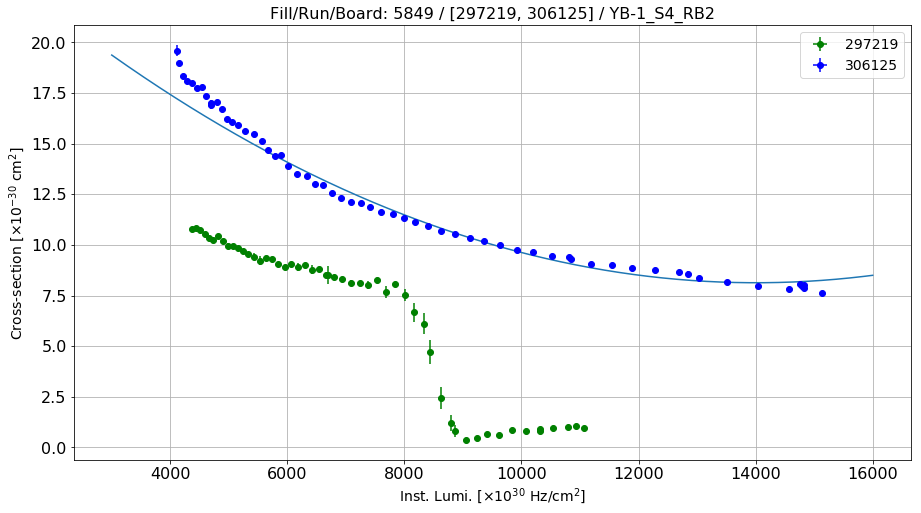

Linear fit parameters: [3.73126505e+00 6.10905559e+04]


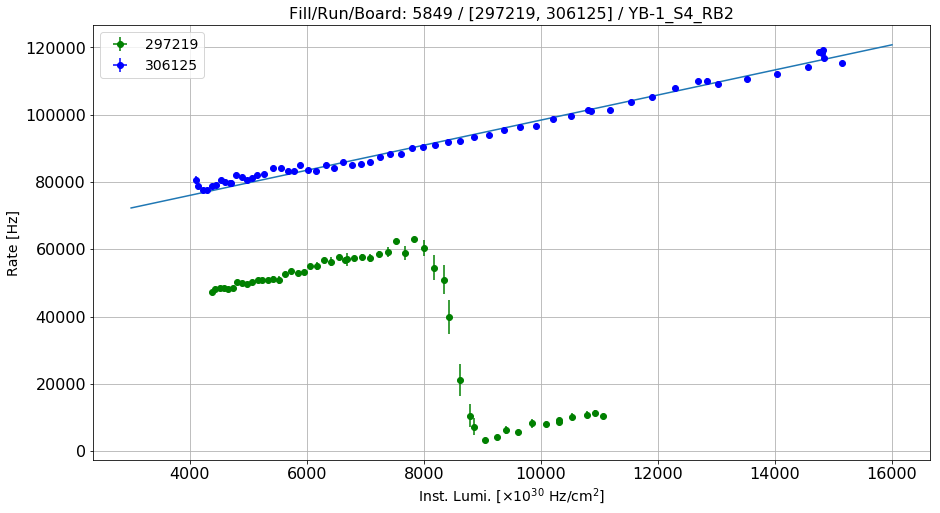

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S4_RB3
Linear fit for the reference run: [ 1.82722201e-08 -5.36822190e-04  5.88837992e+00]


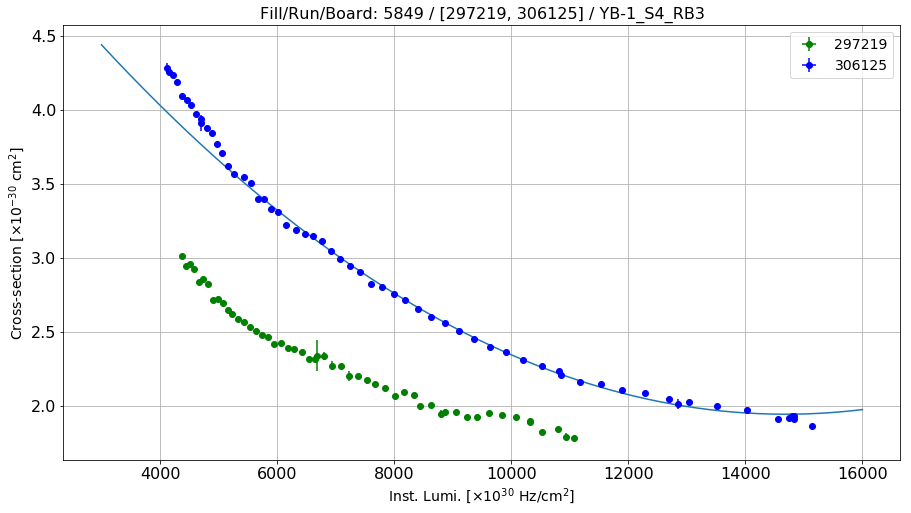

Linear fit parameters: [9.42529381e-01 1.42233967e+04]


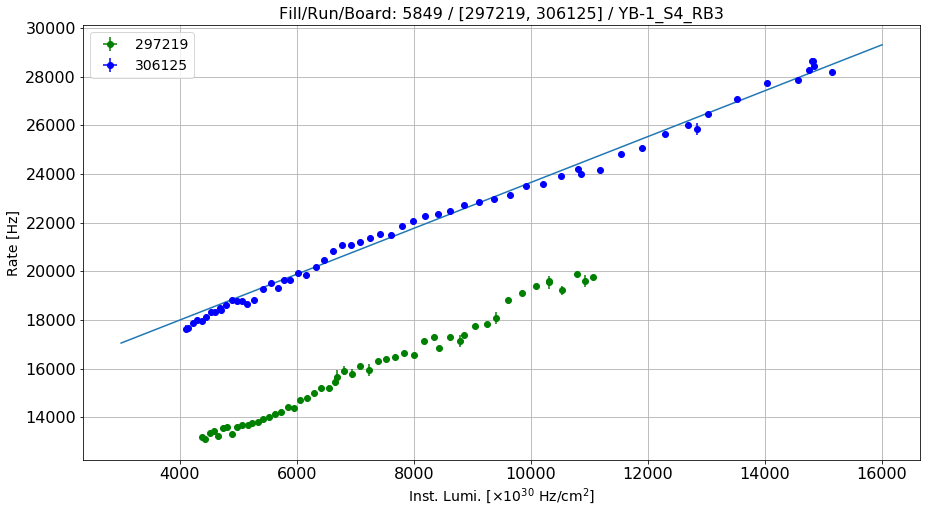

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S4_RB4
Linear fit for the reference run: [ 8.67744000e-09 -2.72318089e-04  3.10342057e+01]


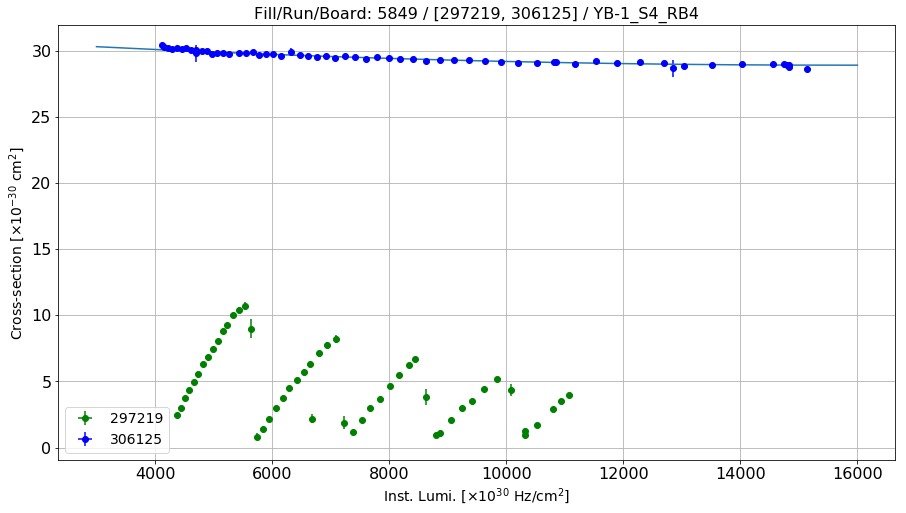

Linear fit parameters: [  28.34079322 8287.39325386]


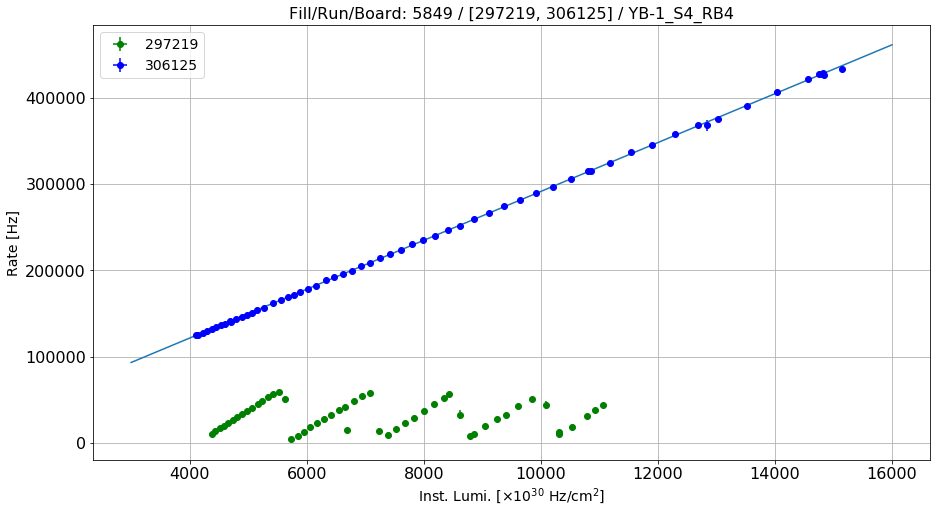

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S5_RB1
Linear fit for the reference run: [ 2.86437184e-09 -1.00385946e-04  1.79514070e+01]


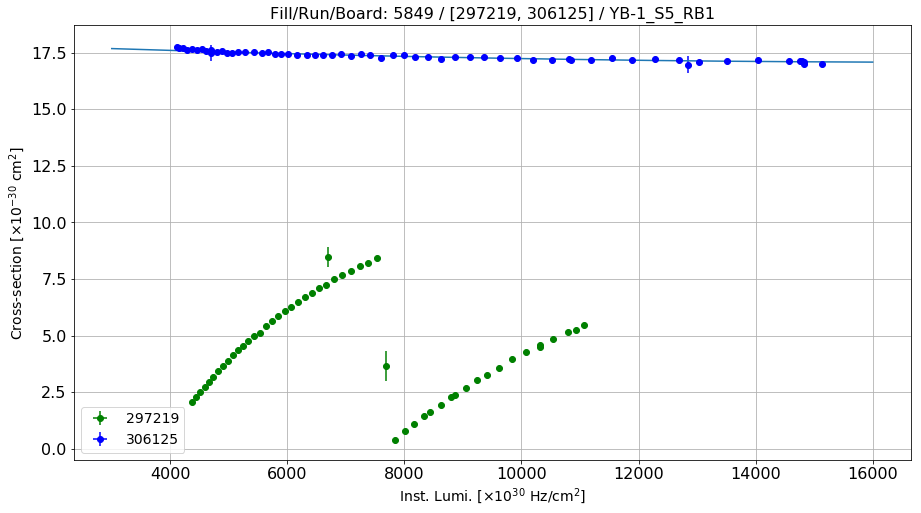

Linear fit parameters: [  16.85423686 3661.07392271]


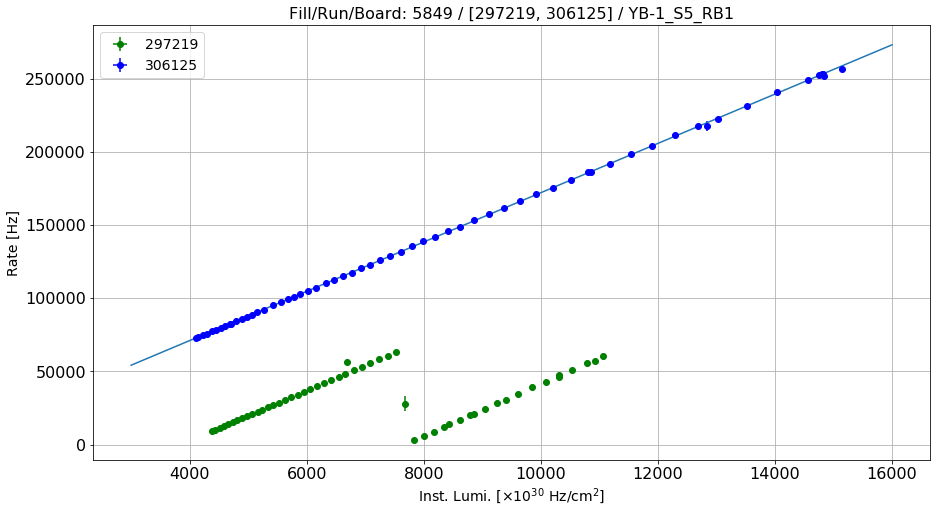

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S5_RB2
Linear fit for the reference run: [ 1.07028824e-09 -5.05584314e-05  4.32009520e+00]


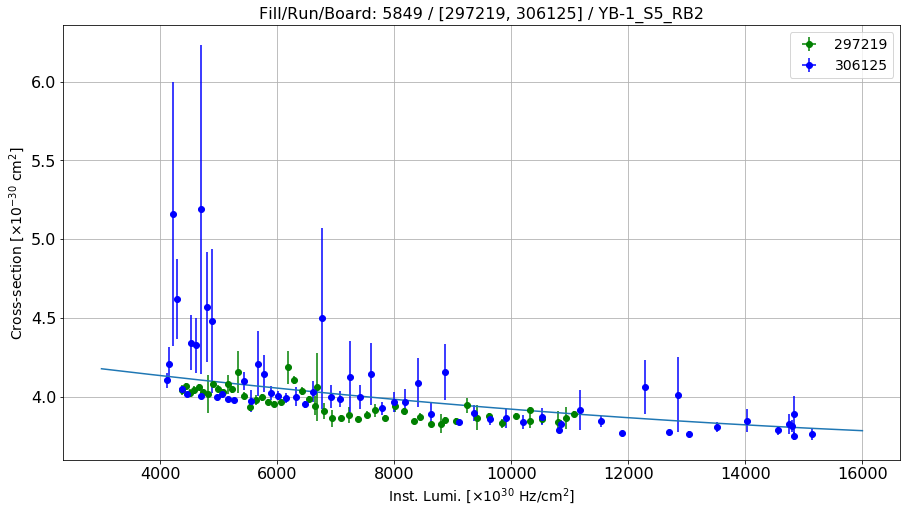

Linear fit parameters: [   3.65141645 2518.58044511]


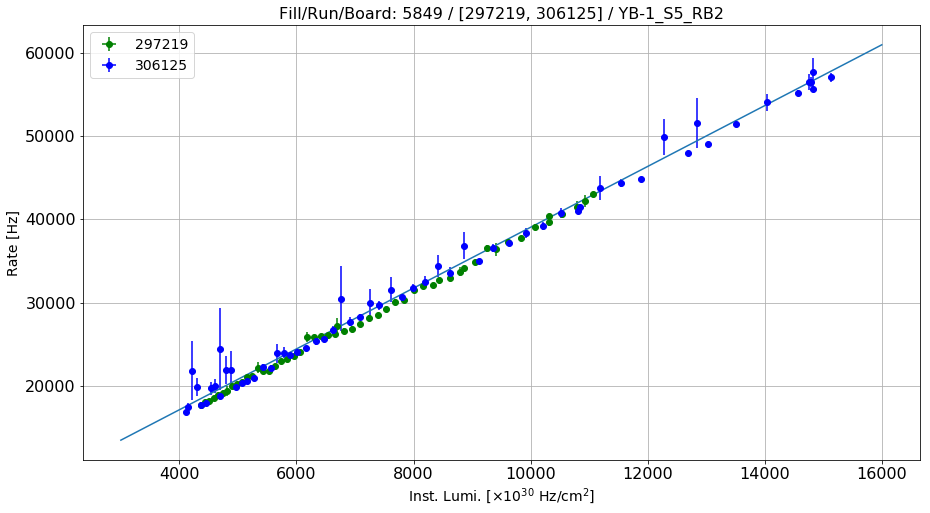

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S5_RB3
Linear fit for the reference run: [ 3.61766227e-09 -1.07344921e-04  1.91221770e+00]


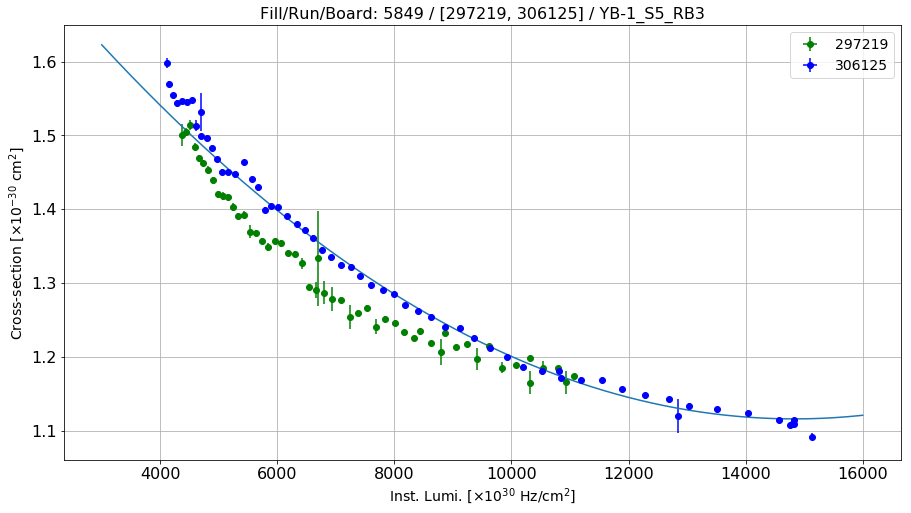

Linear fit parameters: [9.11965185e-01 2.90961297e+03]


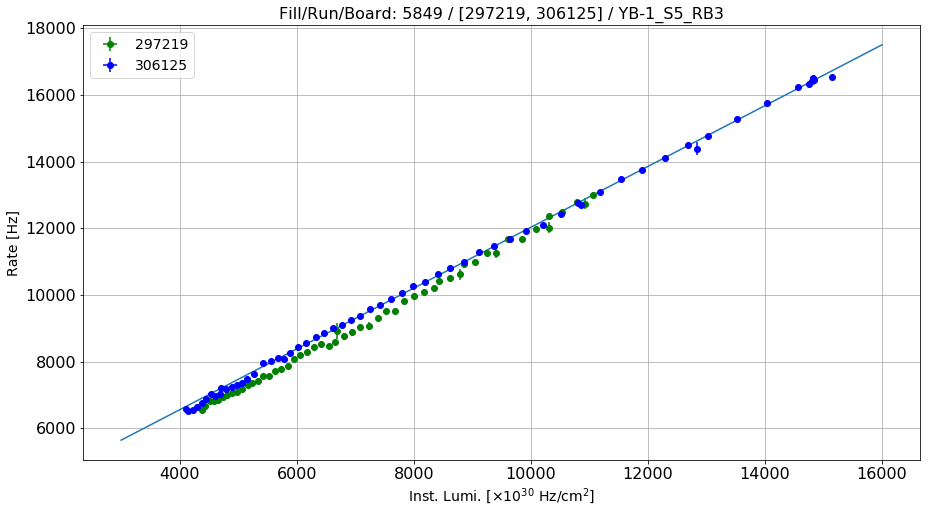

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S5_RB4
Linear fit for the reference run: [ 2.77445236e-12 -9.09159998e-08  1.75324109e-03]


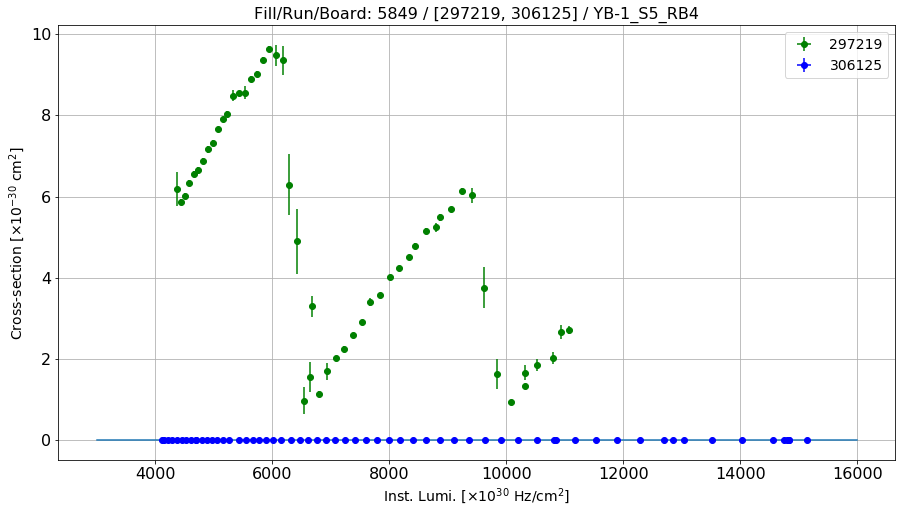

Linear fit parameters: [8.15792003e-04 2.98898611e+00]


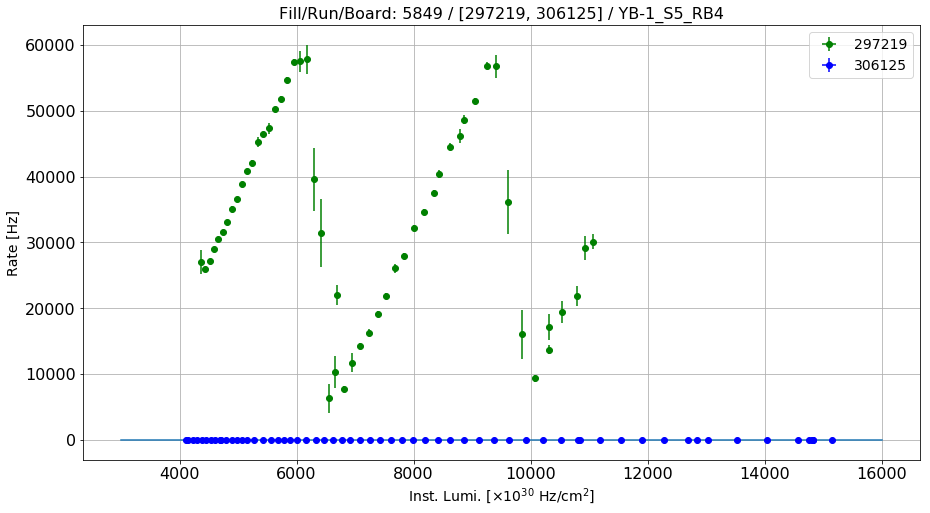

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S6_RB1
Linear fit for the reference run: [-3.12111946e-09  3.84645185e-06  1.88991251e+01]


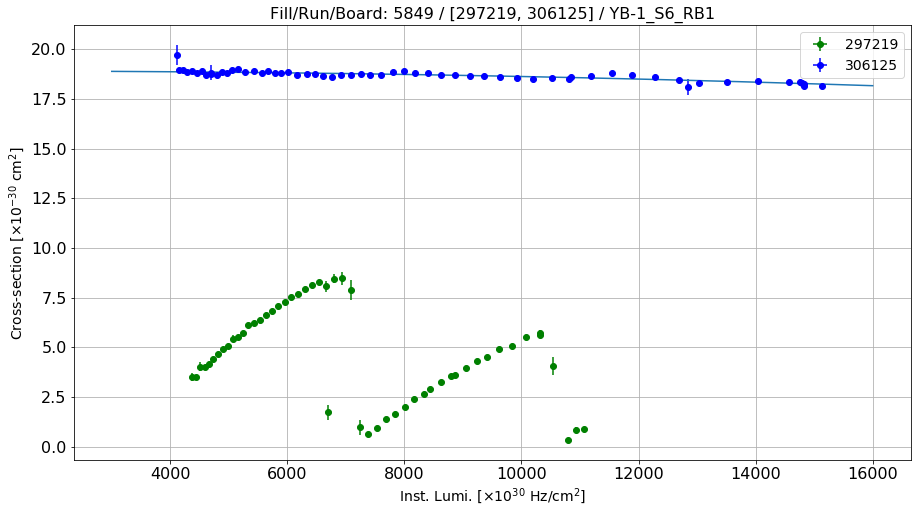

Linear fit parameters: [  18.00215385 5316.81211574]


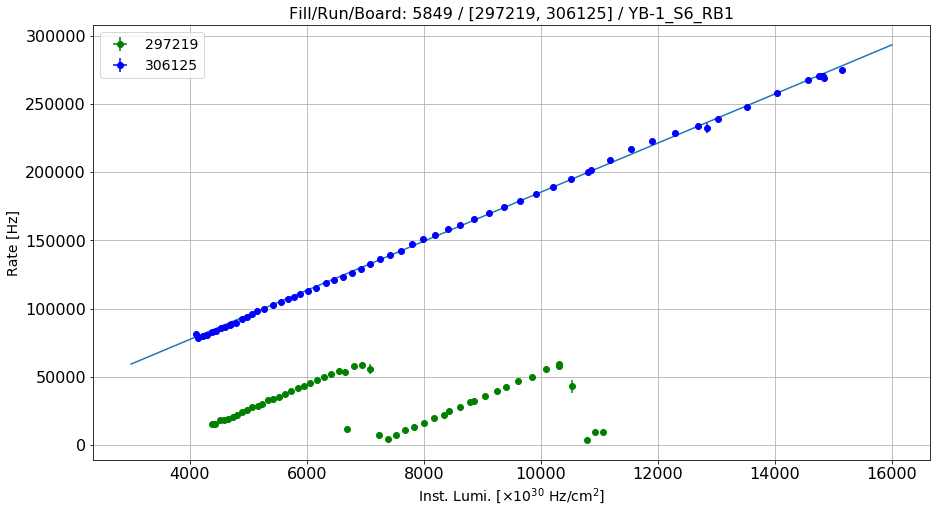

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S6_RB2
Linear fit for the reference run: [ 3.63272593e-09 -1.06034796e-04  4.79078624e+00]


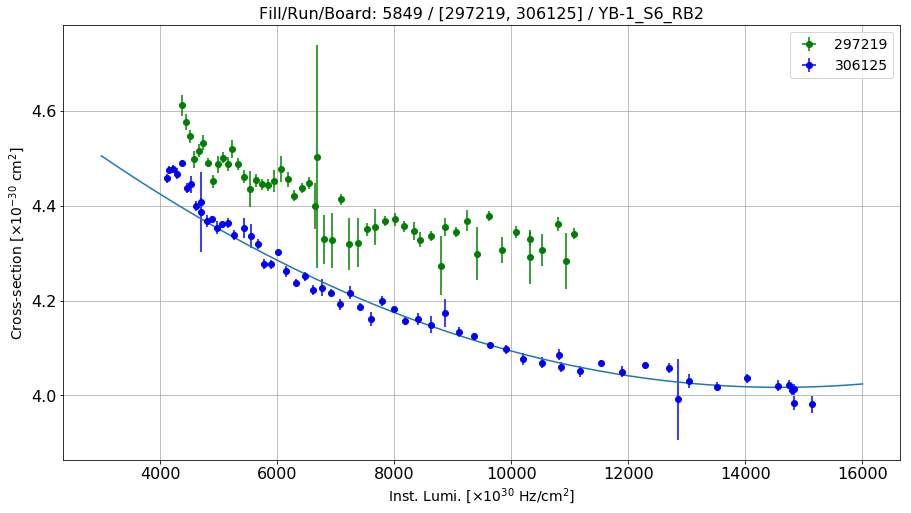

Linear fit parameters: [   3.82120666 2766.79152391]


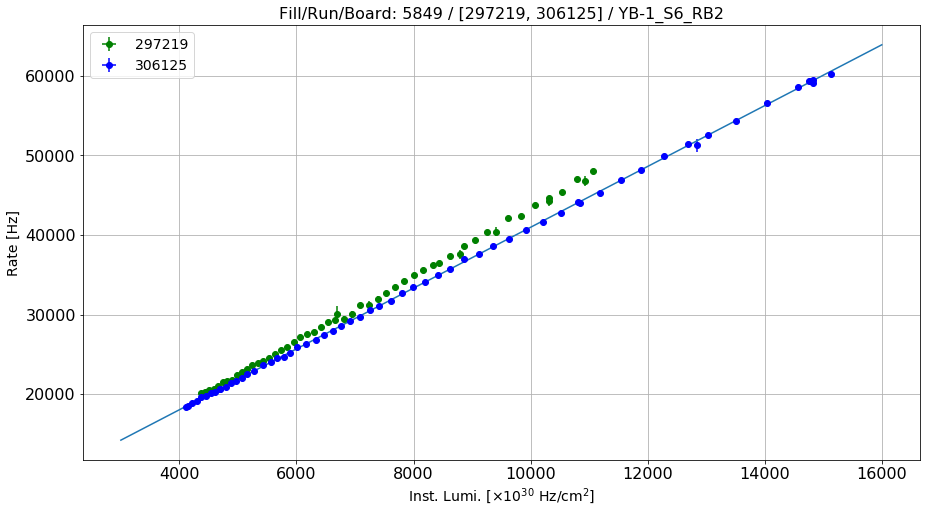

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S6_RB3
Linear fit for the reference run: [ 1.62506981e-09 -4.79119553e-05  9.89017628e-01]


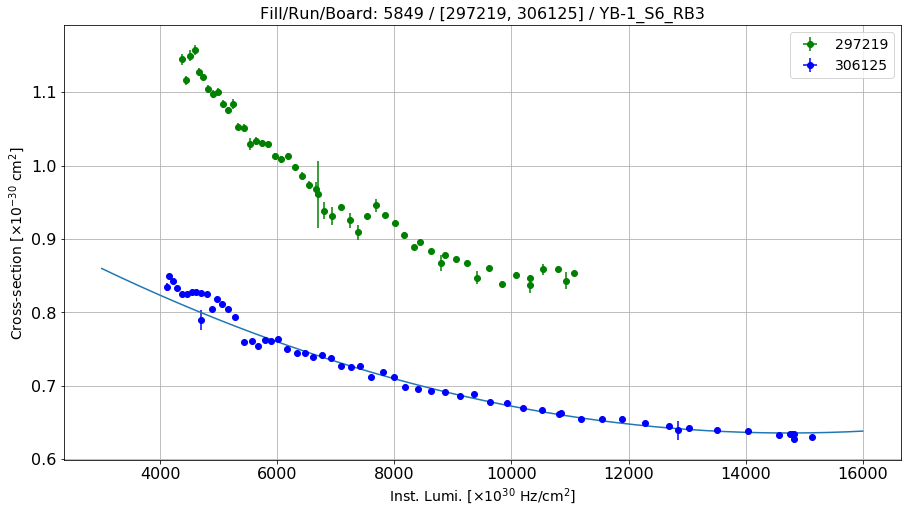

Linear fit parameters: [5.45803629e-01 1.27986499e+03]


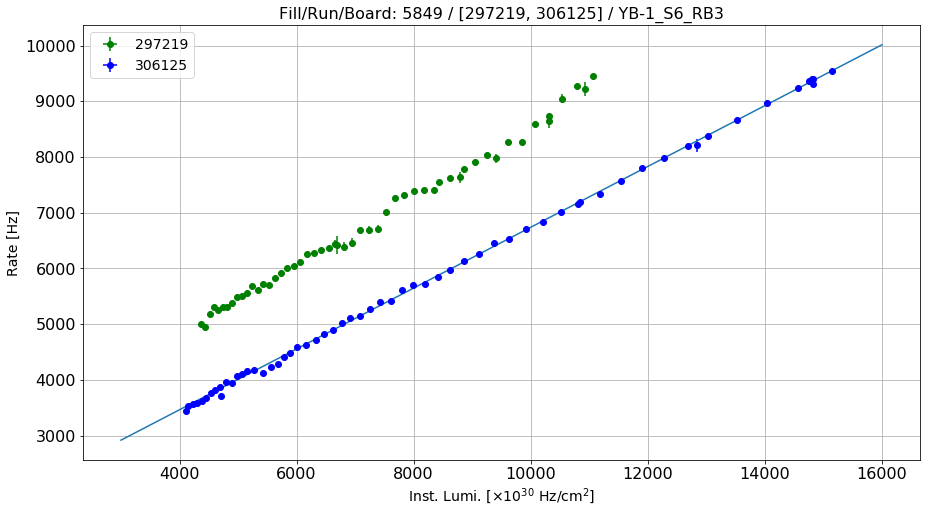

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S6_RB4
Linear fit for the reference run: [ 8.05590973e-07 -2.38138220e-02  2.67530687e+02]


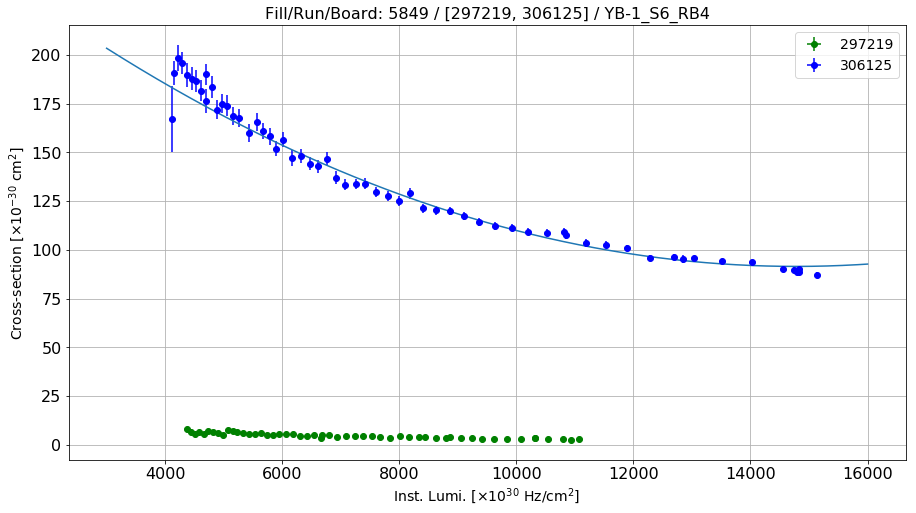

Linear fit parameters: [4.65769248e+01 6.39981107e+05]


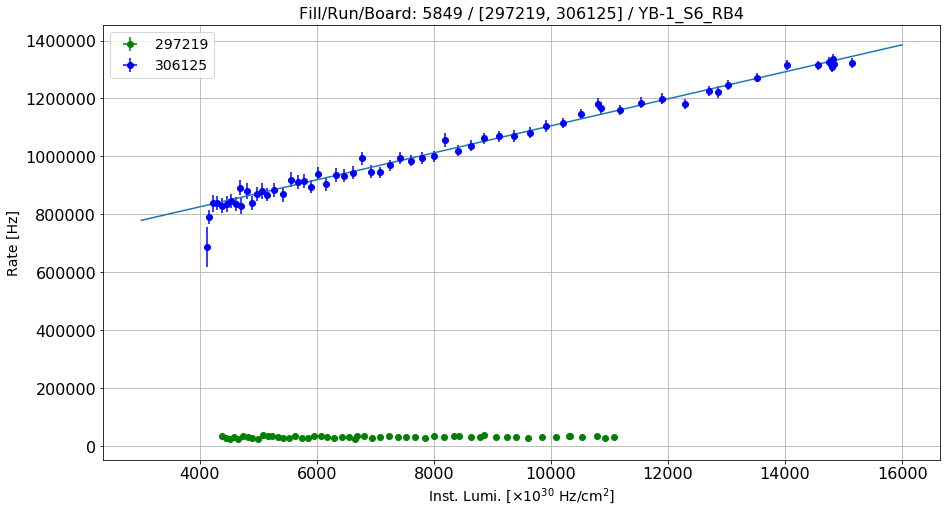

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S7_RB1
Linear fit for the reference run: [ 5.68782302e-10 -4.08881615e-05  1.85252585e+01]


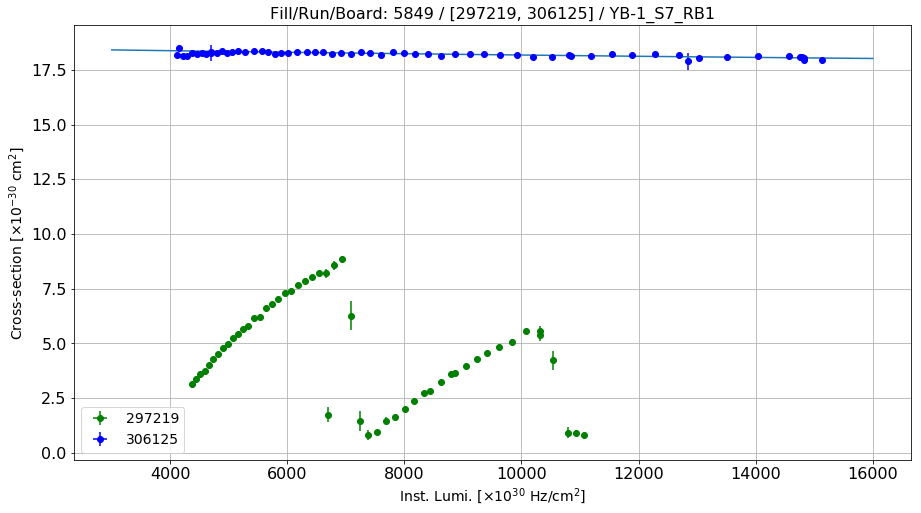

Linear fit parameters: [  17.89193076 2574.69104698]


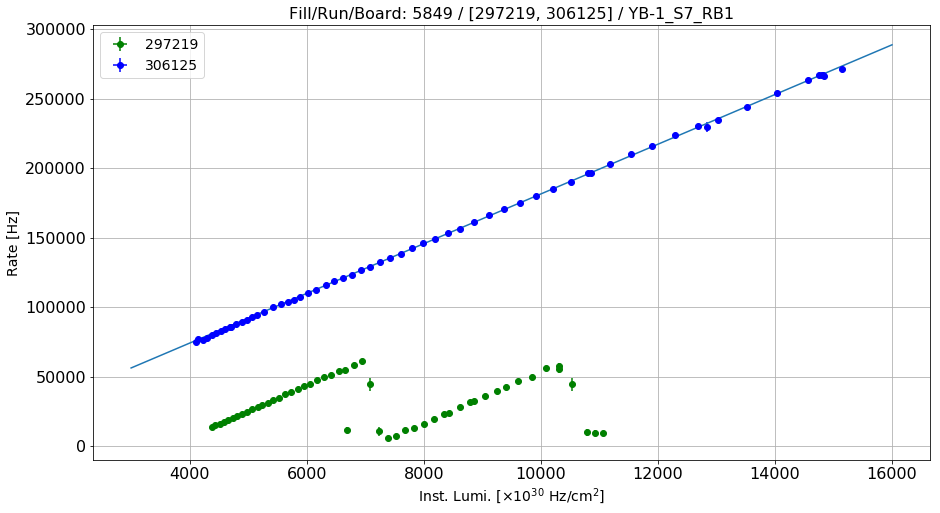

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S7_RB2
Linear fit for the reference run: [ 3.56801950e-09 -1.26573321e-04  3.18418897e+00]


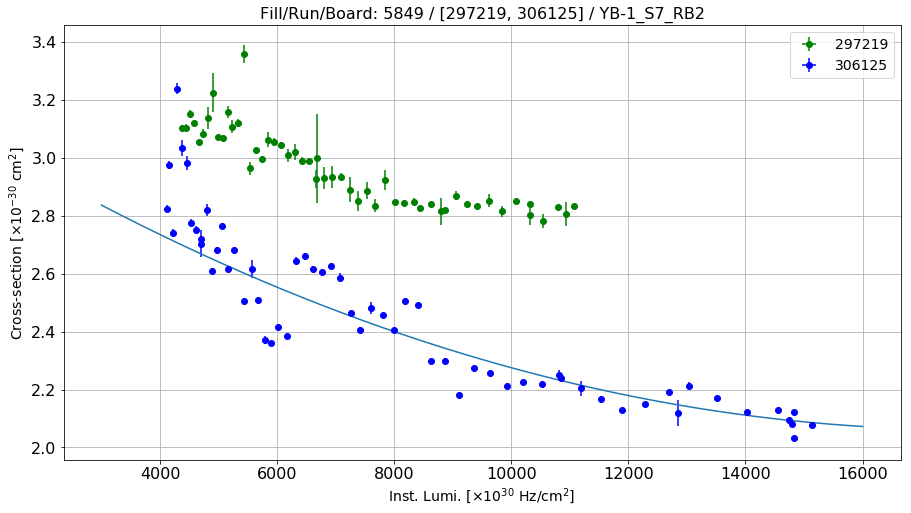

Linear fit parameters: [1.78721661e+00 4.69508723e+03]


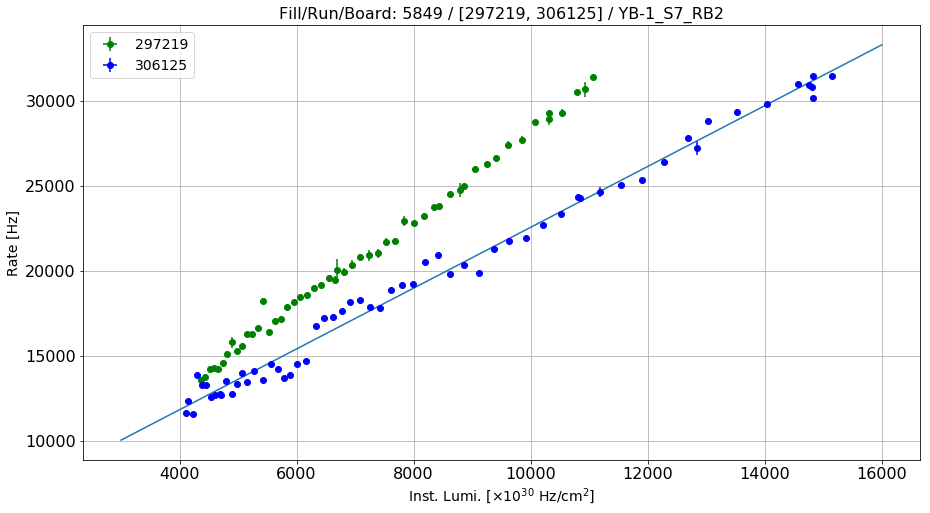

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S7_RB3
Linear fit for the reference run: [ 3.22741060e-09 -8.99623161e-05  1.36548941e+00]


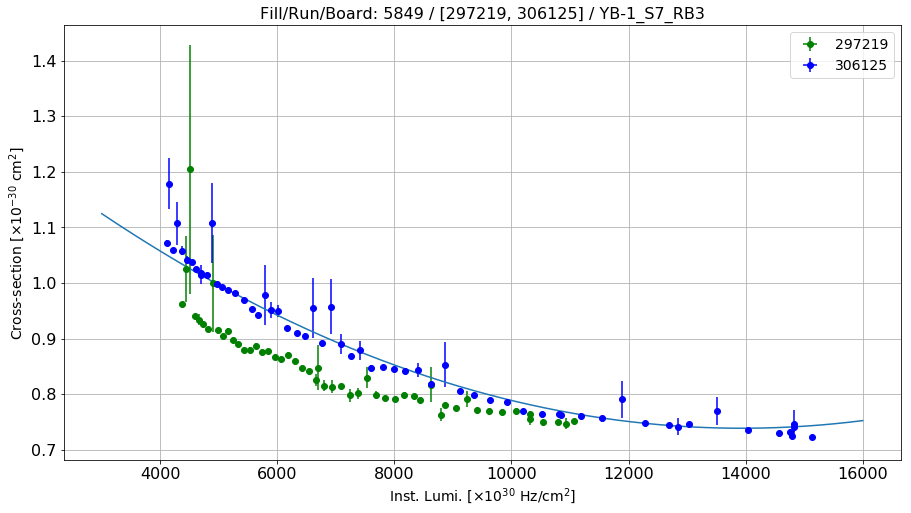

Linear fit parameters: [5.88191420e-01 2.08405763e+03]


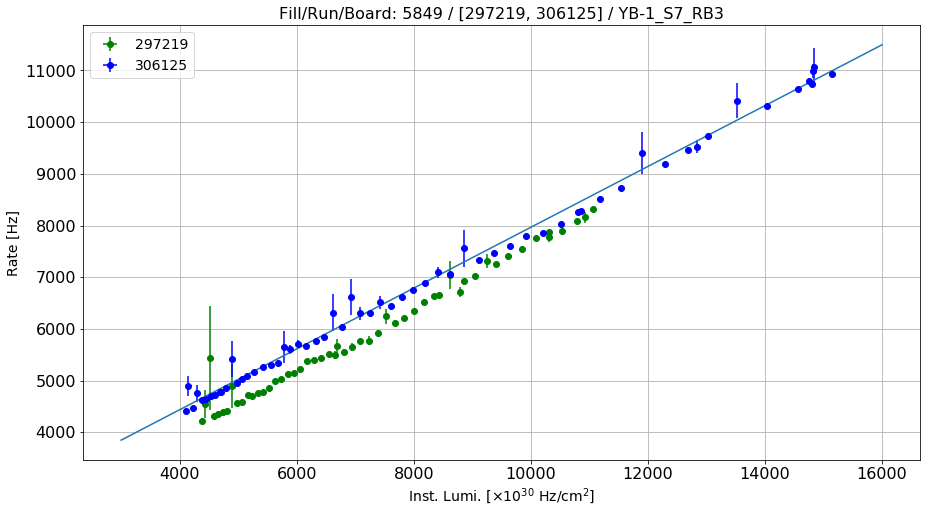

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S7_RB4
Linear fit for the reference run: [-9.92384161e-12  1.96172017e-07  9.32078914e-04]


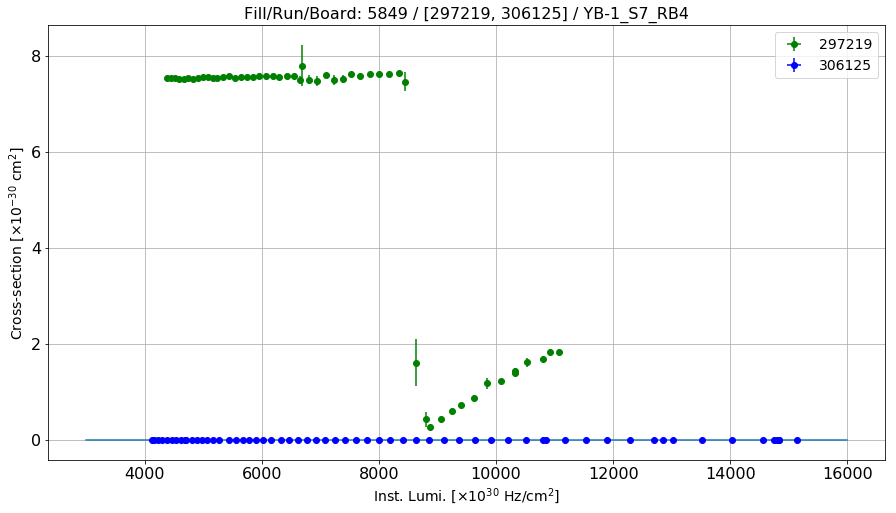

Linear fit parameters: [0.00172709 0.68566672]


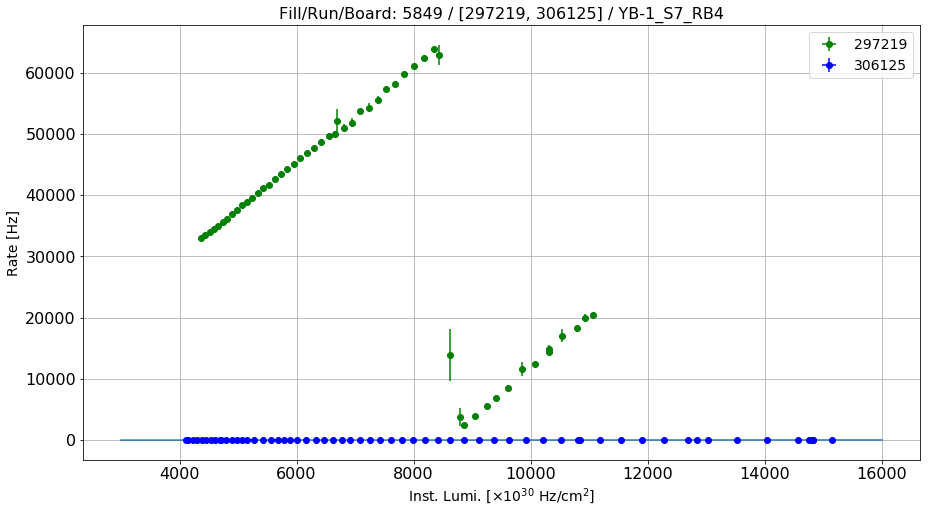

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S8_RB1
Linear fit for the reference run: [ 8.32357352e-09 -2.65040556e-04  1.69794687e+01]


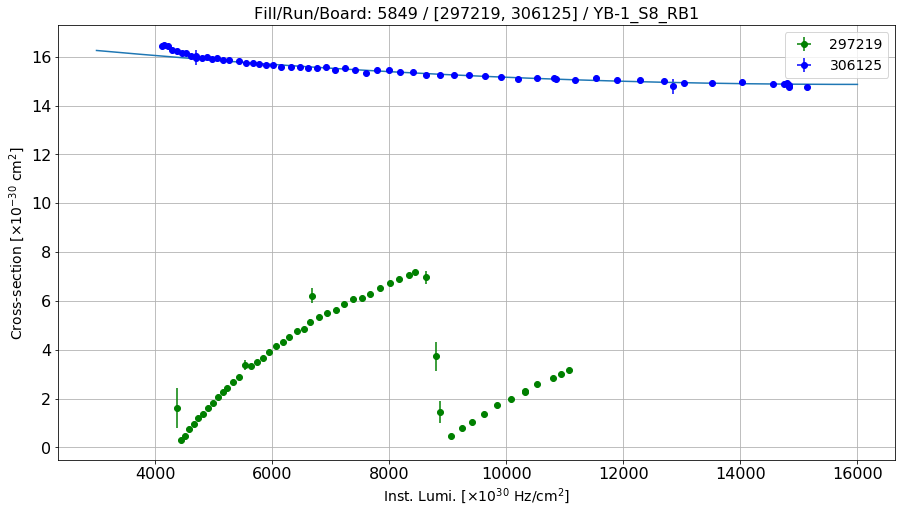

Linear fit parameters: [  14.32000385 8286.94259722]


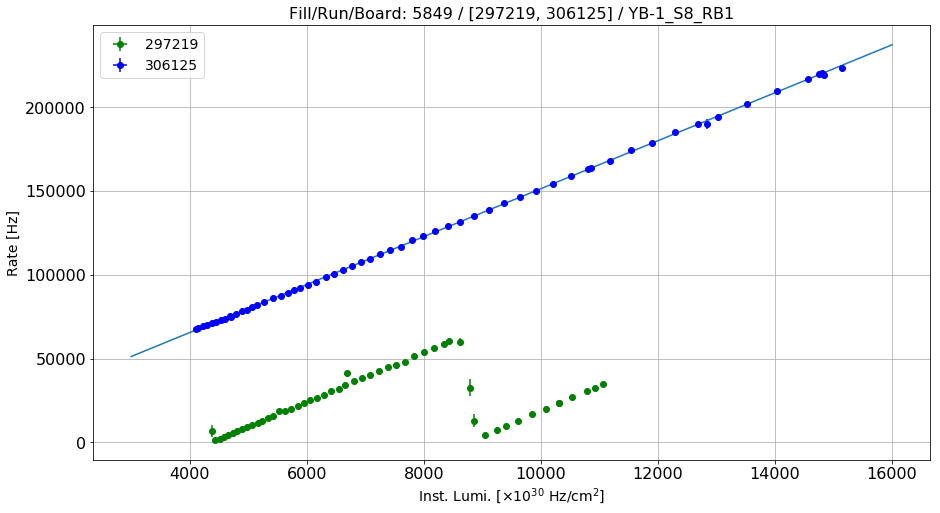

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S8_RB2
Linear fit for the reference run: [ 7.83859085e-09 -2.26881167e-04  5.72685084e+00]


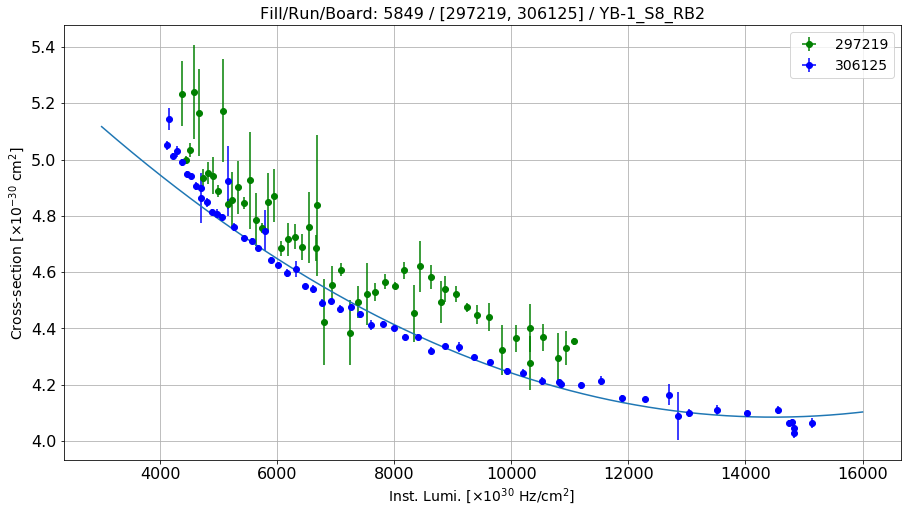

Linear fit parameters: [3.67274115e+00 5.80100923e+03]


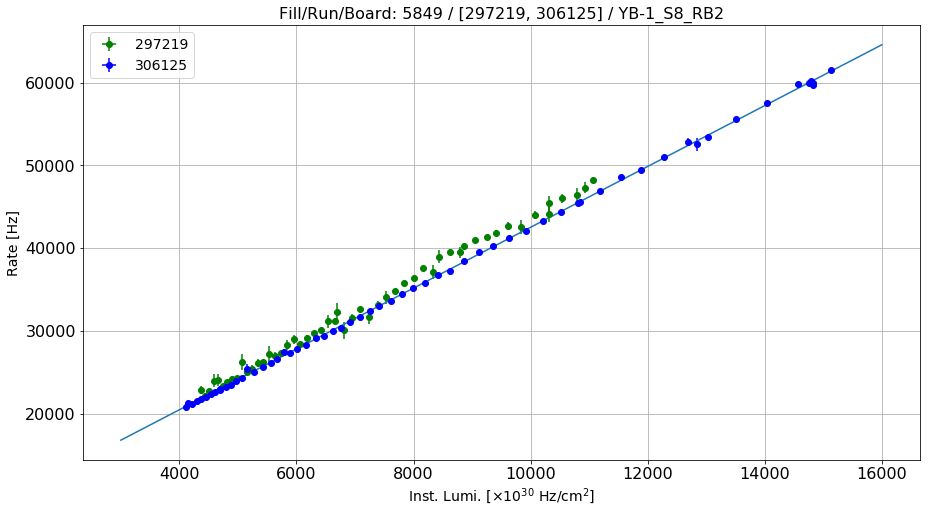

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S8_RB3
Linear fit for the reference run: [ 1.01422839e-08 -3.02838571e-04  3.34677872e+00]


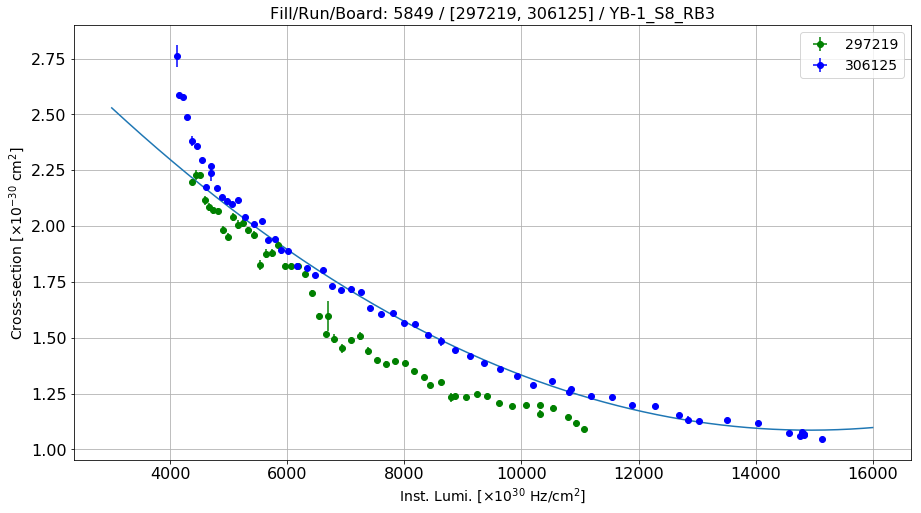

Linear fit parameters: [5.05009709e-01 8.32407645e+03]


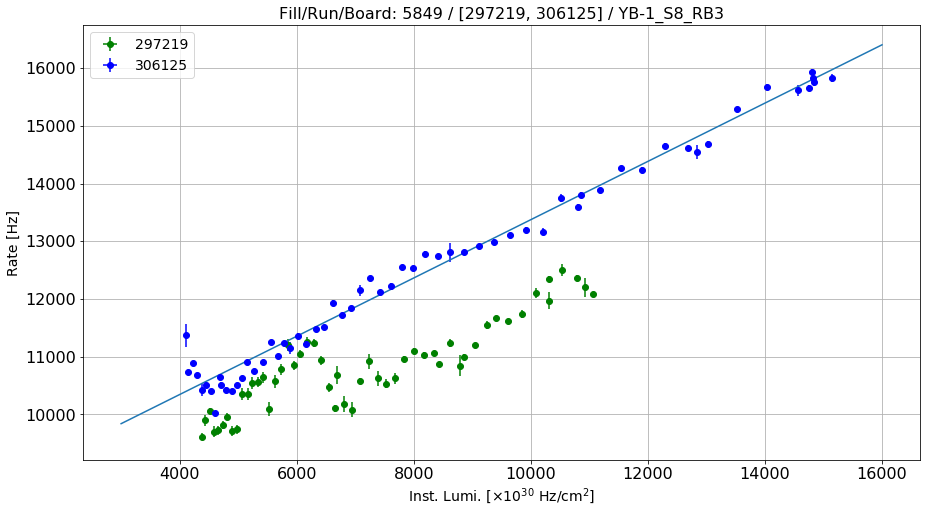

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S8_RB4
Linear fit for the reference run: [-2.06999312e-11  4.52490142e-07 -3.50604162e-04]


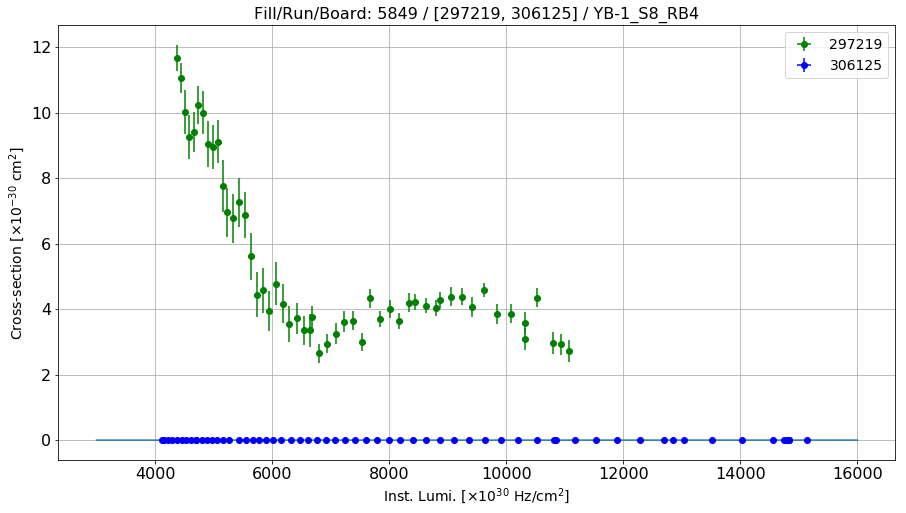

Linear fit parameters: [ 2.16618635e-03 -2.38778978e+00]


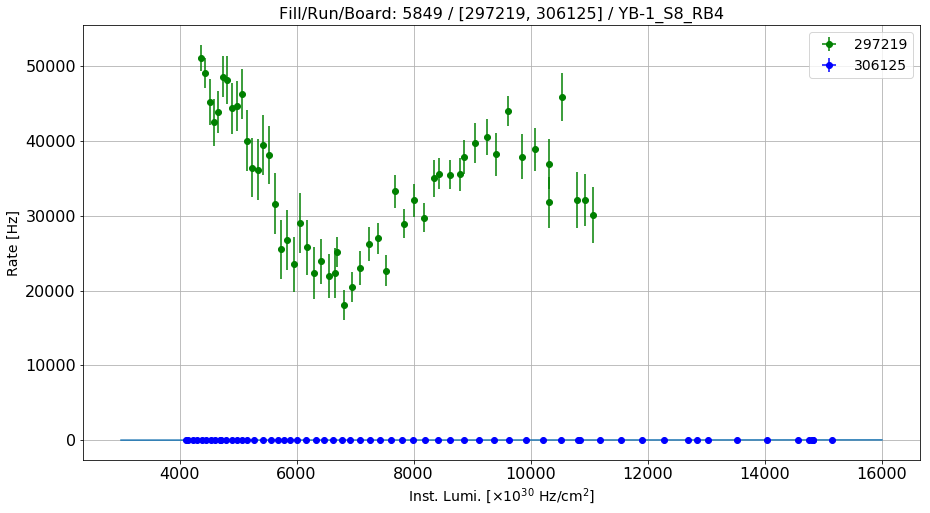

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S9_RB1
Linear fit for the reference run: [ 1.72394251e-09 -8.98011736e-05  1.79179786e+01]


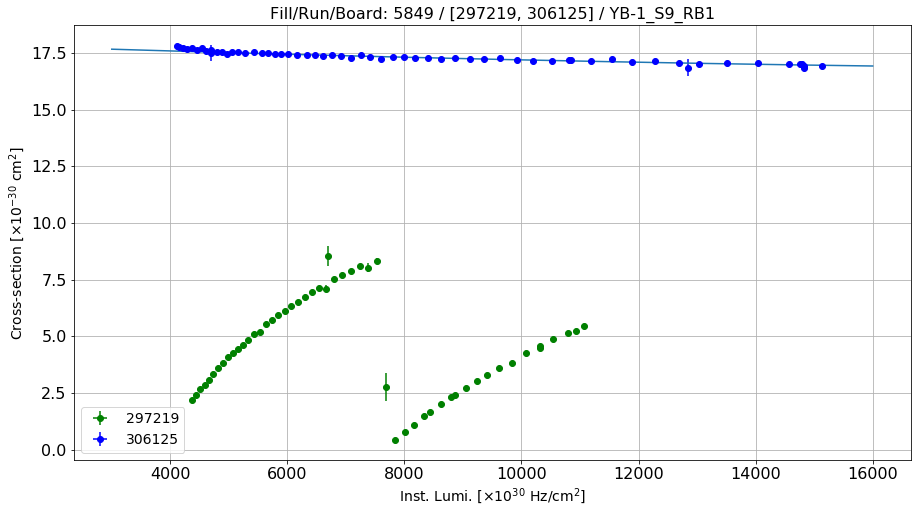

Linear fit parameters: [  16.67506076 4794.38044555]


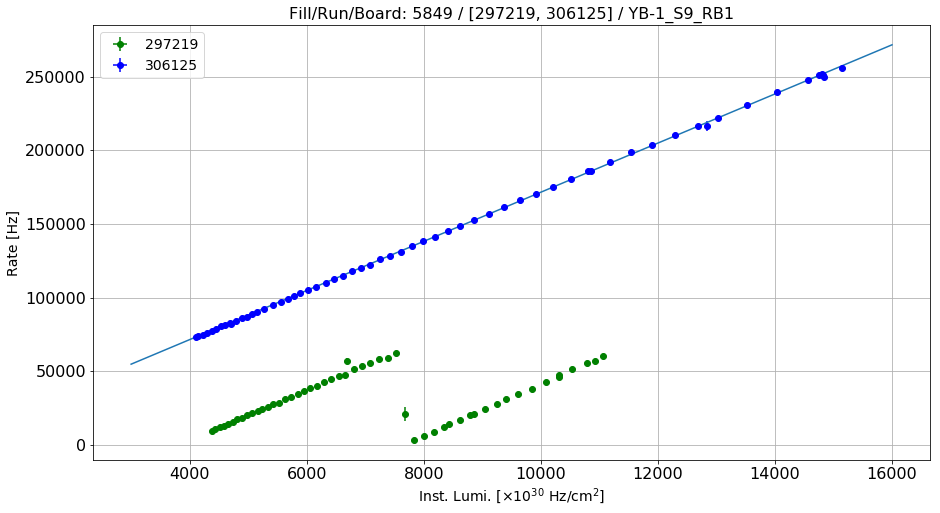

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S9_RB2
Linear fit for the reference run: [ 1.12158308e-07 -3.28451150e-03  3.35889735e+01]


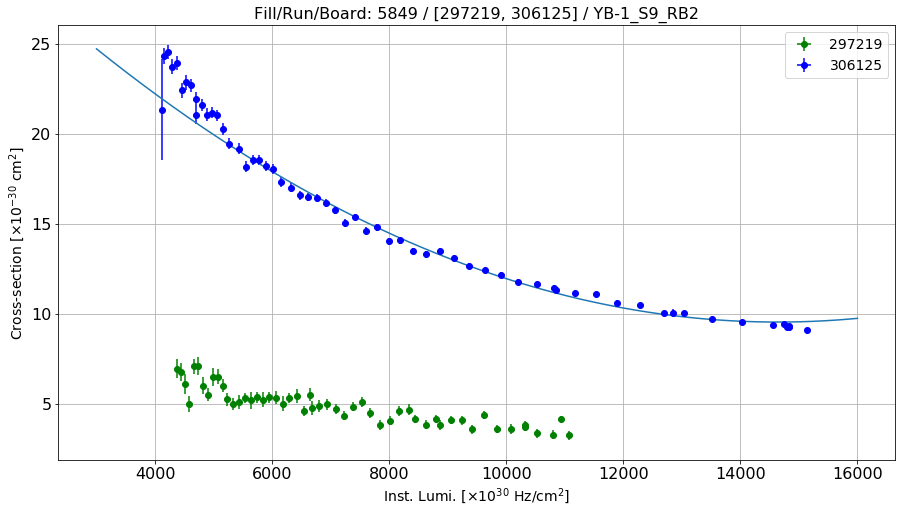

Linear fit parameters: [3.44065405e+00 8.63708707e+04]


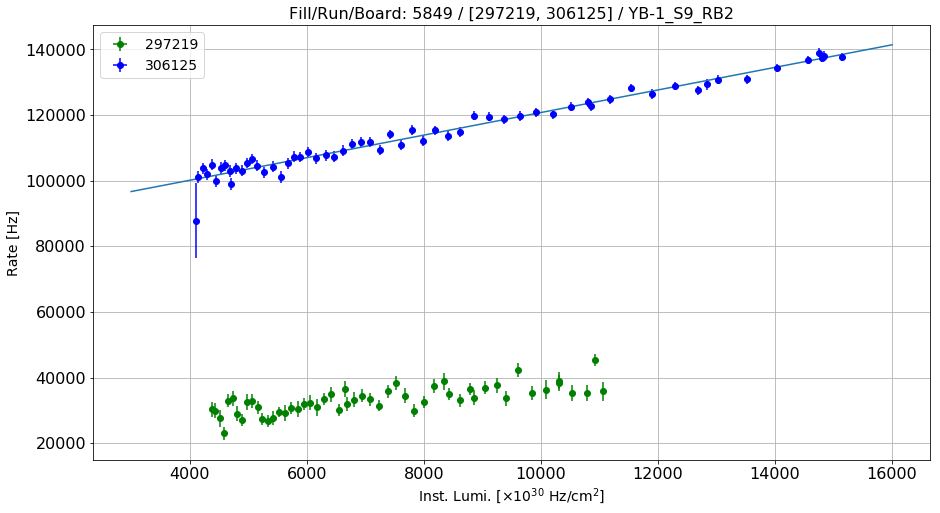

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S9_RB3
Linear fit for the reference run: [ 2.87014635e-09 -8.48686539e-05  1.27203464e+00]


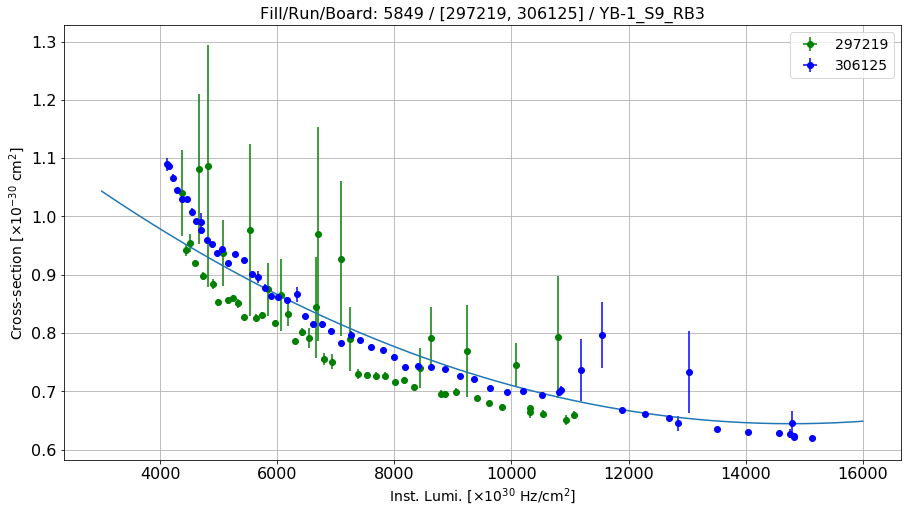

Linear fit parameters: [4.84325378e-01 2.28233261e+03]


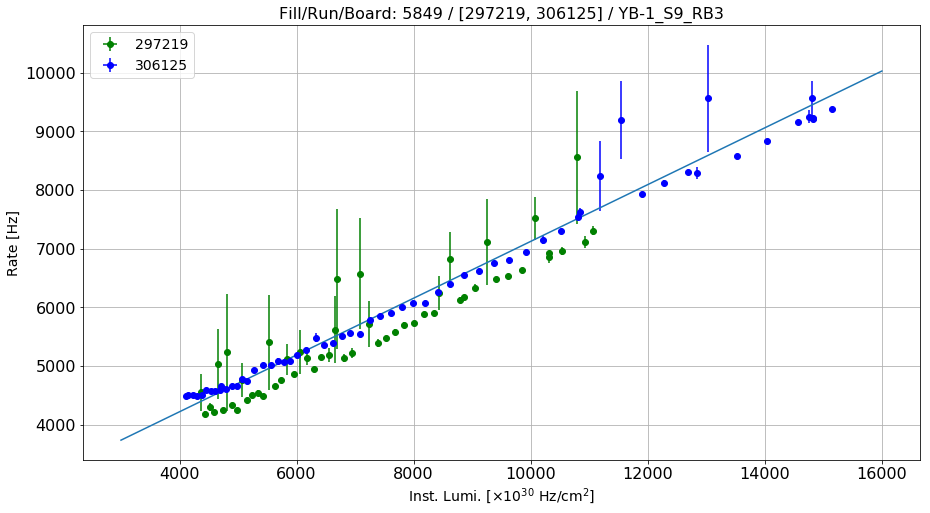

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S9_RB4
Linear fit for the reference run: [ 5.12428289e-09 -1.52370814e-04  1.90203805e+00]


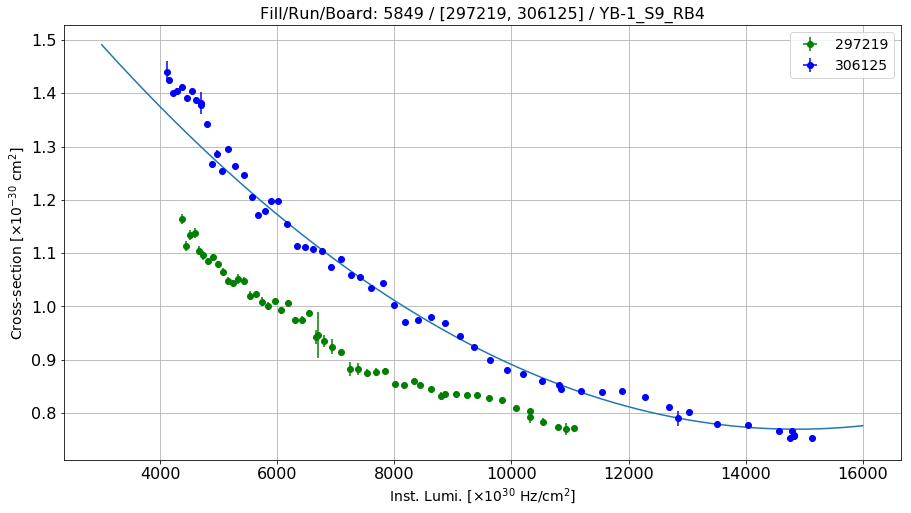

Linear fit parameters: [4.78858198e-01 4.14964148e+03]


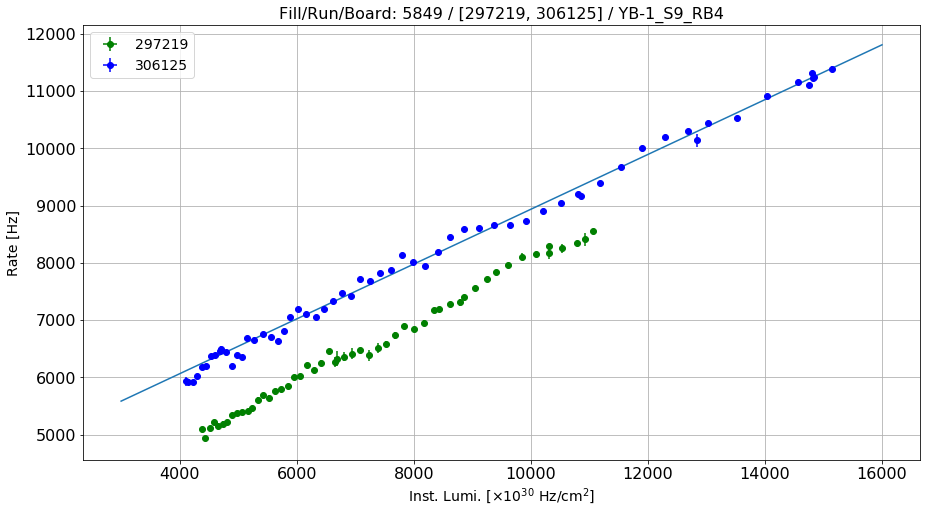

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S10_RB1
Linear fit for the reference run: [ 1.25978210e-09 -1.22653764e-04  1.84548124e+01]


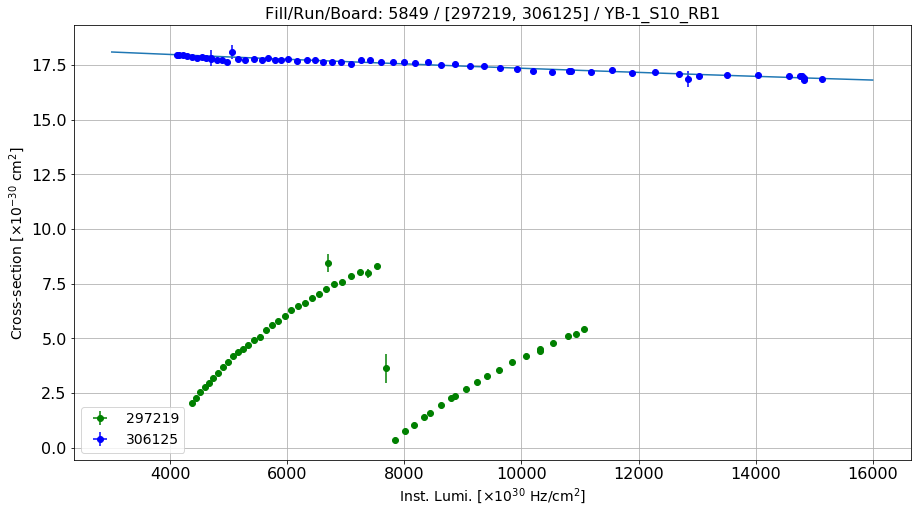

Linear fit parameters: [  16.41579293 8532.37685464]


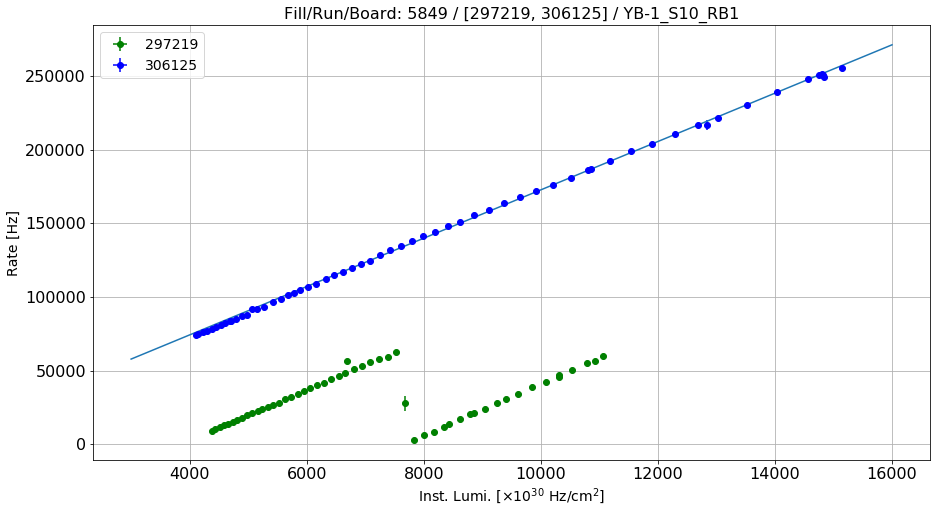

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S10_RB2
Linear fit for the reference run: [ 2.60664119e-09 -8.64487278e-05  4.47807828e+00]


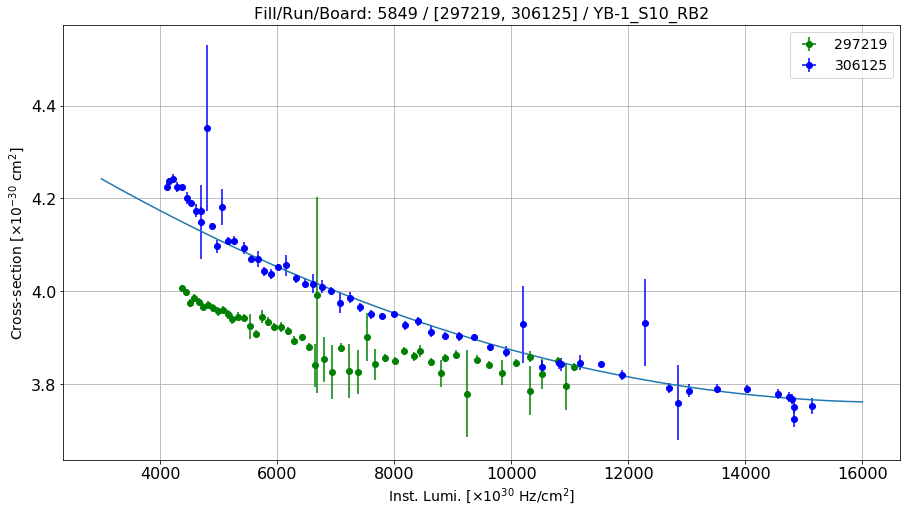

Linear fit parameters: [   3.57687422 2899.17446059]


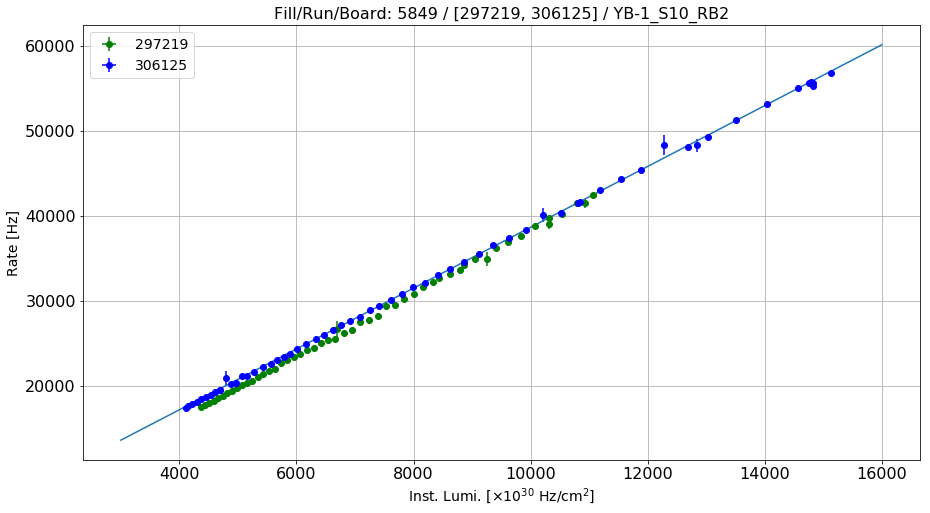

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S10_RB3
Linear fit for the reference run: [ 5.82510608e-09 -1.74370024e-04  2.15698659e+00]


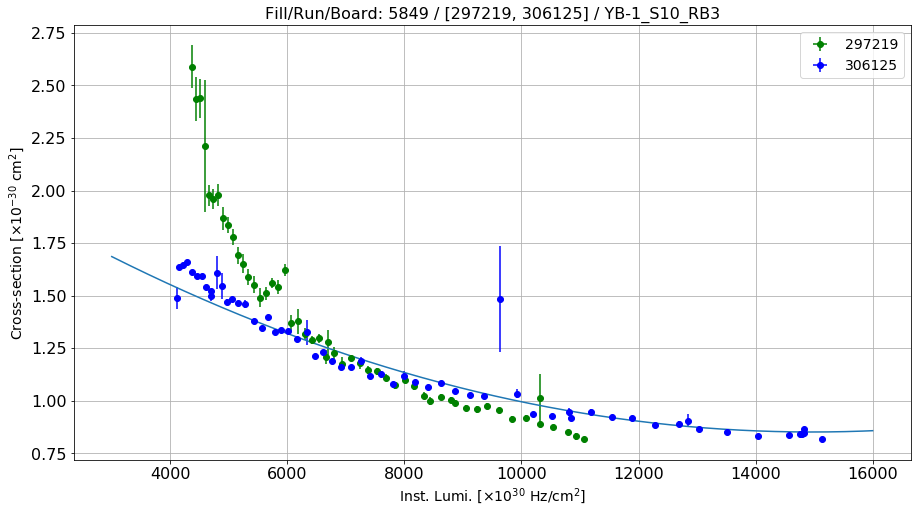

Linear fit parameters: [5.16162217e-01 4.81947107e+03]


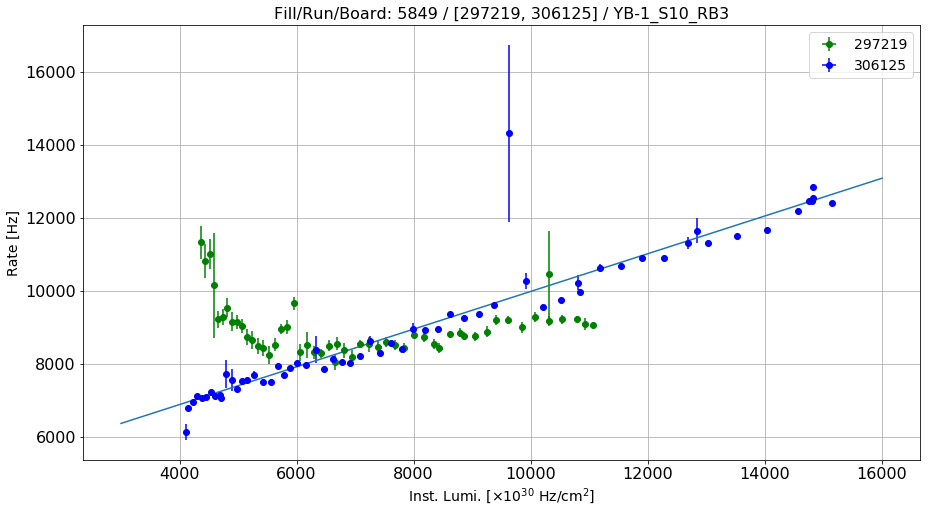

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S10_RB4
Linear fit for the reference run: [ 7.81762514e-09 -2.22105339e-04  2.73126993e+00]


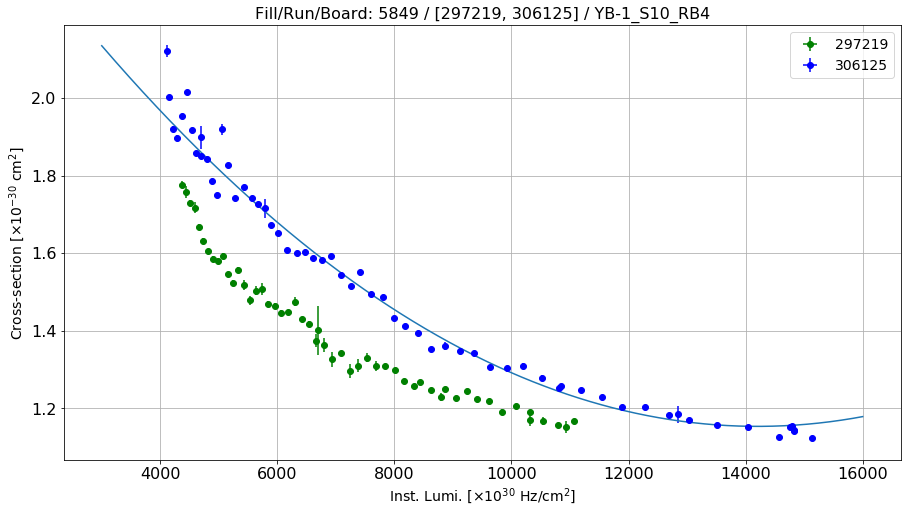

Linear fit parameters: [7.65312668e-01 5.41788171e+03]


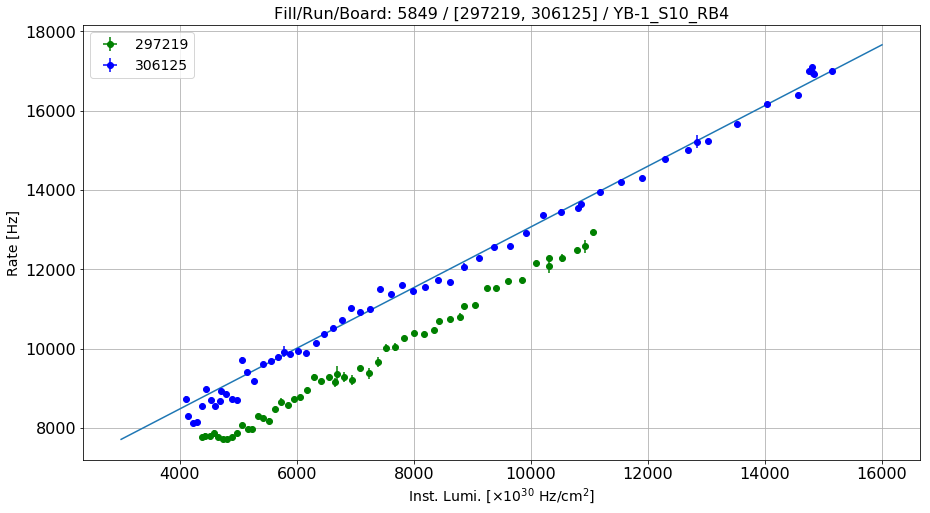

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S11_RB1
Linear fit for the reference run: [ 8.39053103e-09 -2.69482508e-04  1.93272977e+01]


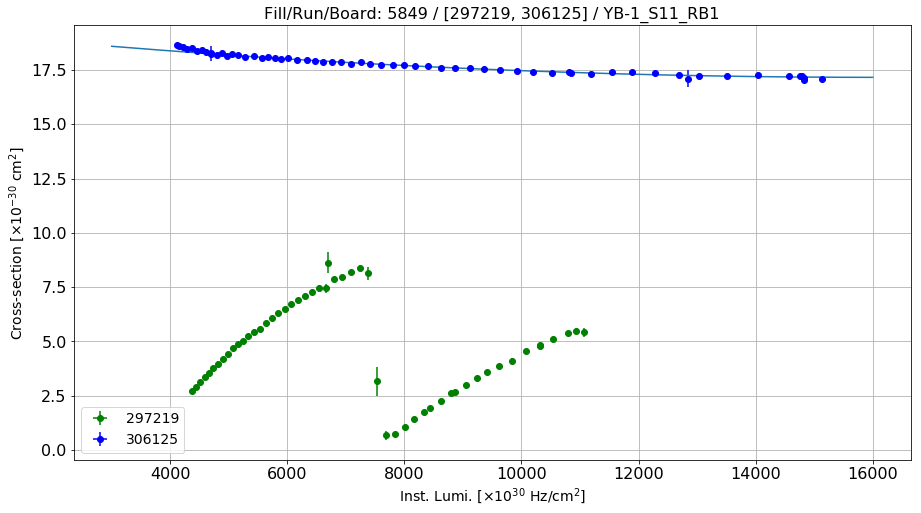

Linear fit parameters: [  16.60064149 8557.28499635]


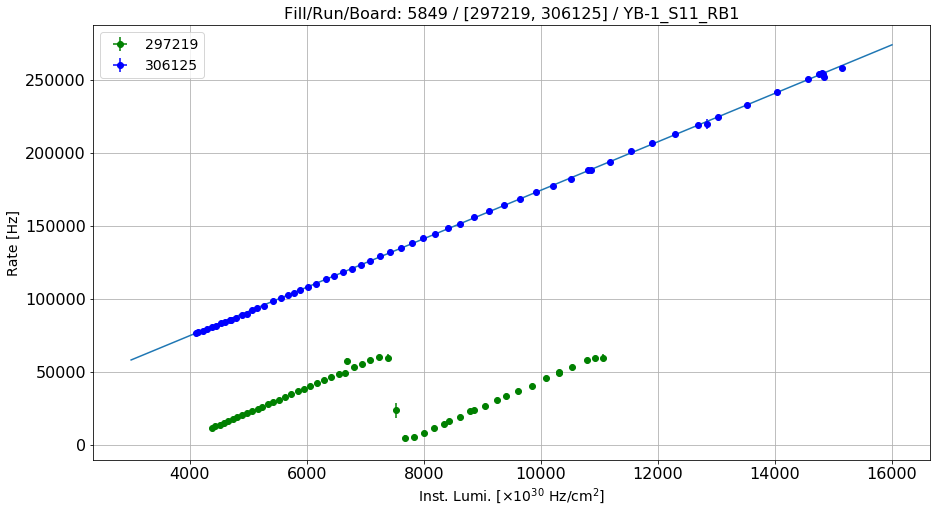

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S11_RB2
Linear fit for the reference run: [ 3.95281555e-09 -1.23307190e-04  4.78867623e+00]


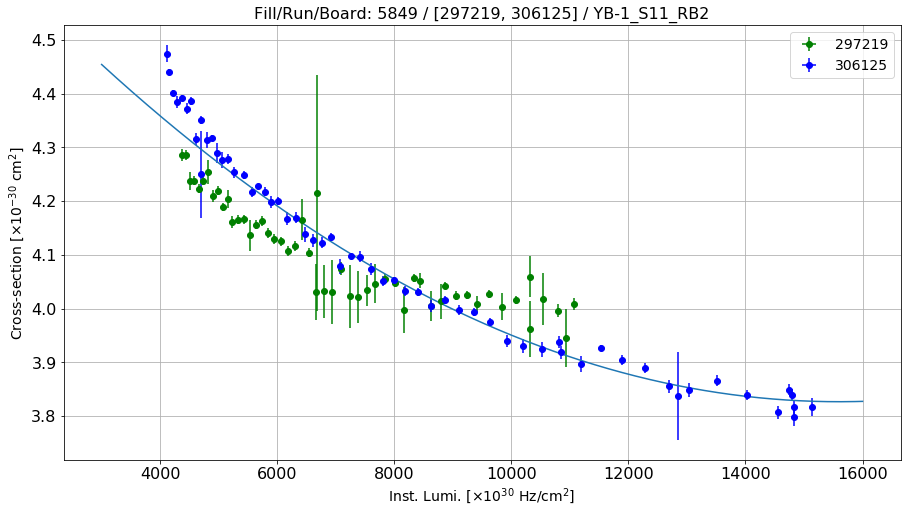

Linear fit parameters: [3.57644919e+00 3.70977390e+03]


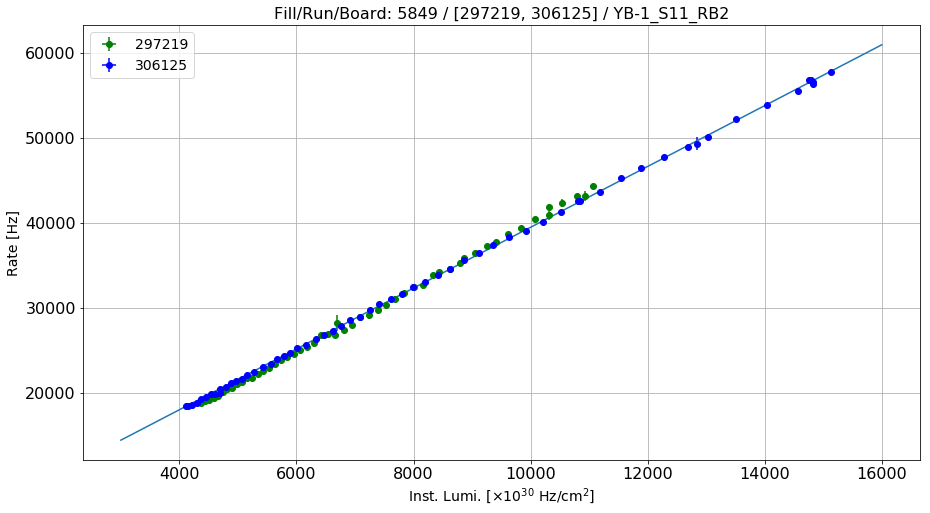

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S11_RB3
Linear fit for the reference run: [ 2.46784055e-07 -8.91925006e-03  9.62505599e+01]


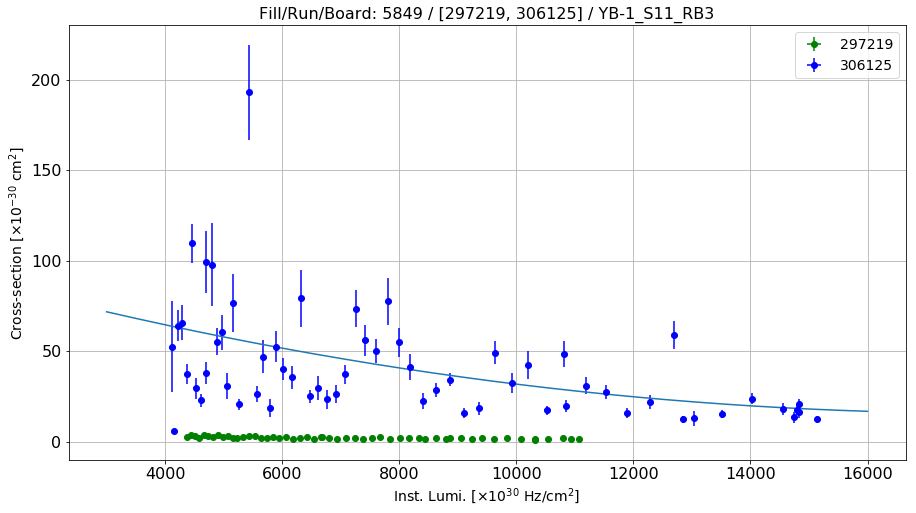

Linear fit parameters: [-3.63801827e+00  3.39264330e+05]


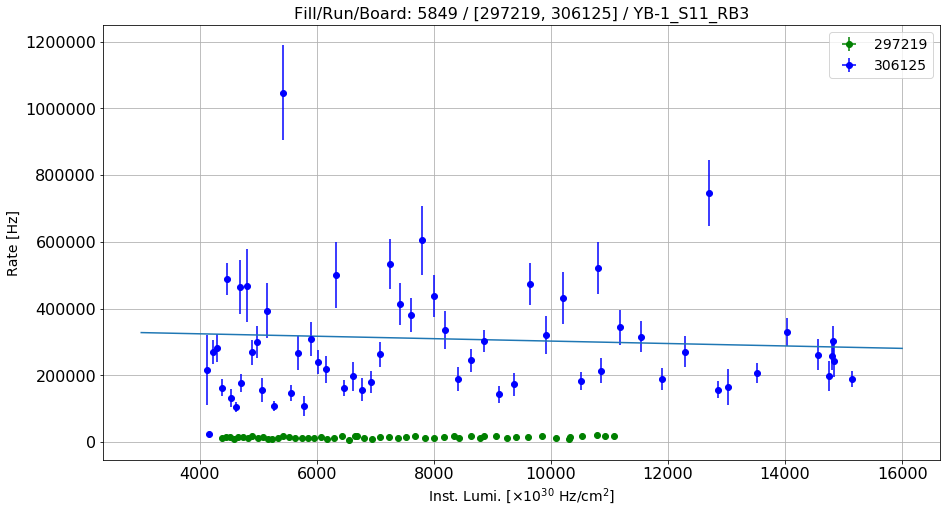

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S11_RB4
Linear fit for the reference run: [ 1.19558510e-09 -3.87634665e-05  9.68552626e-01]


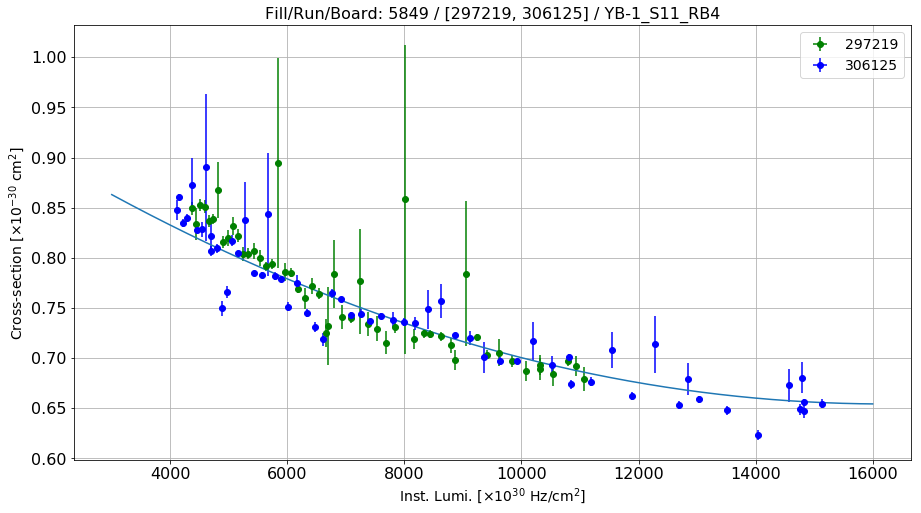

Linear fit parameters: [5.72802169e-01 1.25147065e+03]


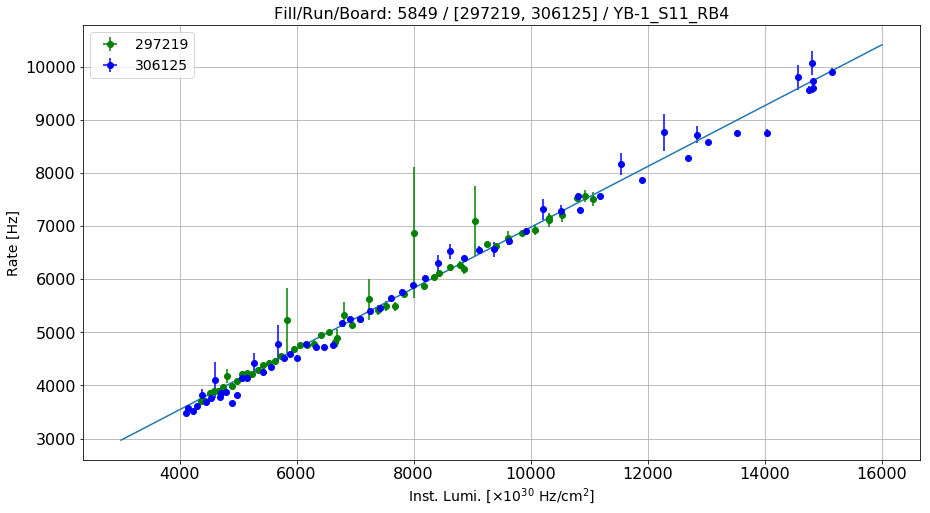

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S12_RB1
Linear fit for the reference run: [ 5.03843619e-09 -1.67959179e-04  1.74320468e+01]


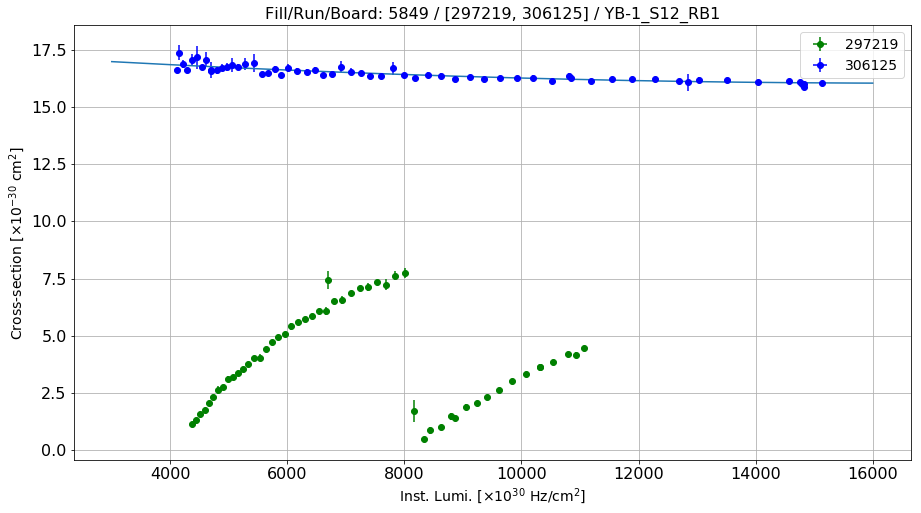

Linear fit parameters: [  15.67302863 5679.75386107]


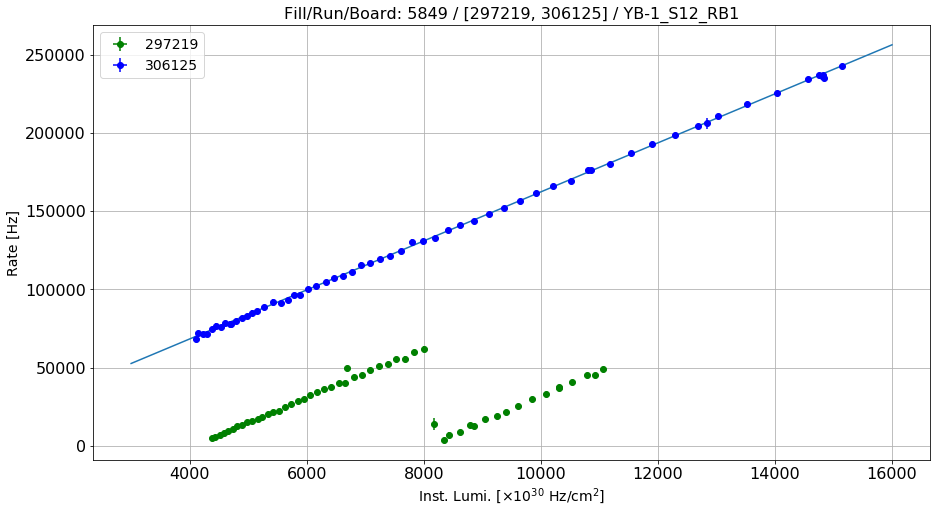

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S12_RB2
Linear fit for the reference run: [ 4.35705542e-09 -1.27683927e-04  4.15422637e+00]


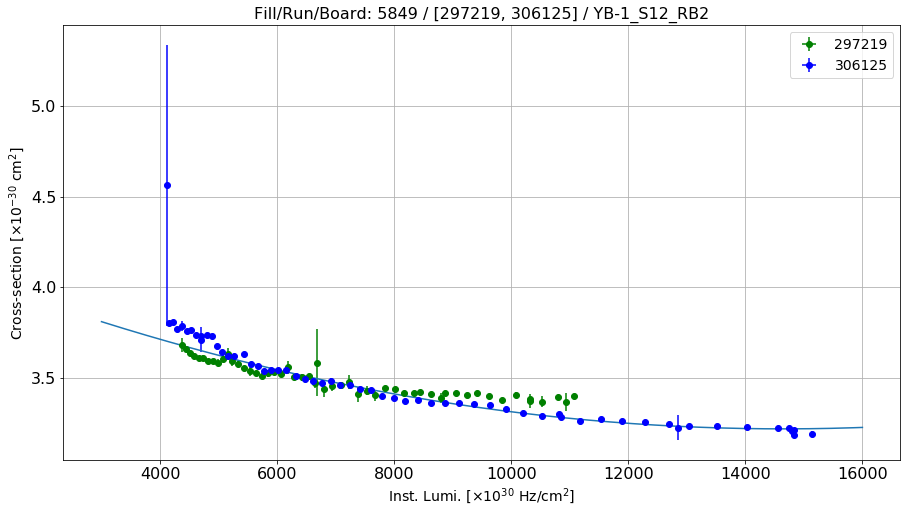

Linear fit parameters: [2.98127307e+00 3.36315464e+03]


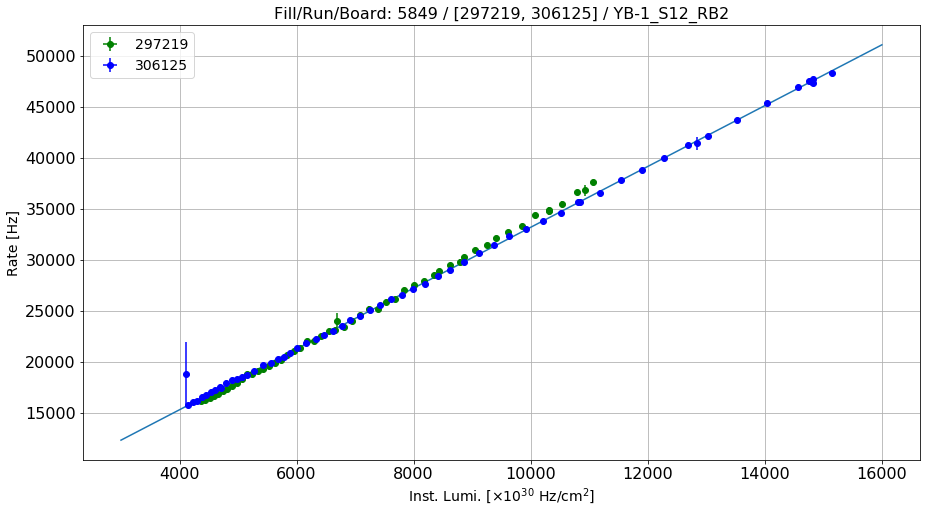

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S12_RB3
Linear fit for the reference run: [ 2.26093183e-09 -7.10219562e-05  1.22617426e+00]


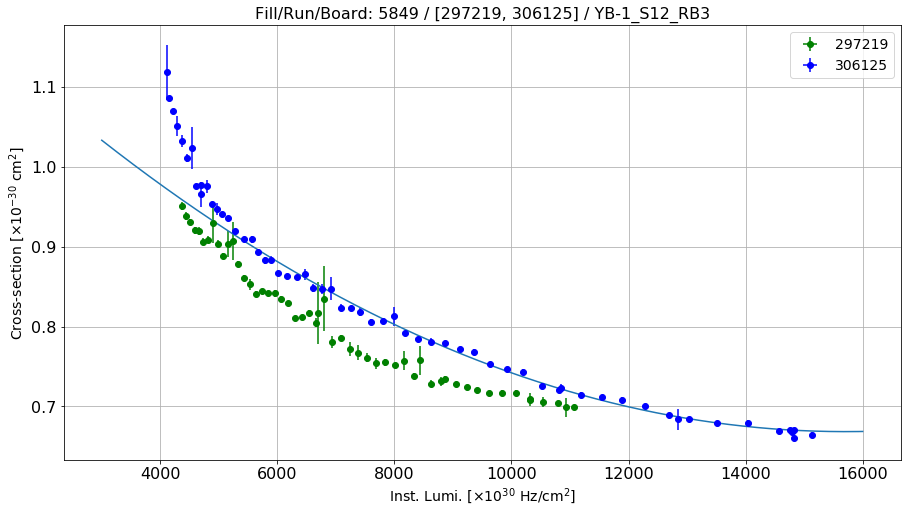

Linear fit parameters: [5.23035842e-01 2.16536173e+03]


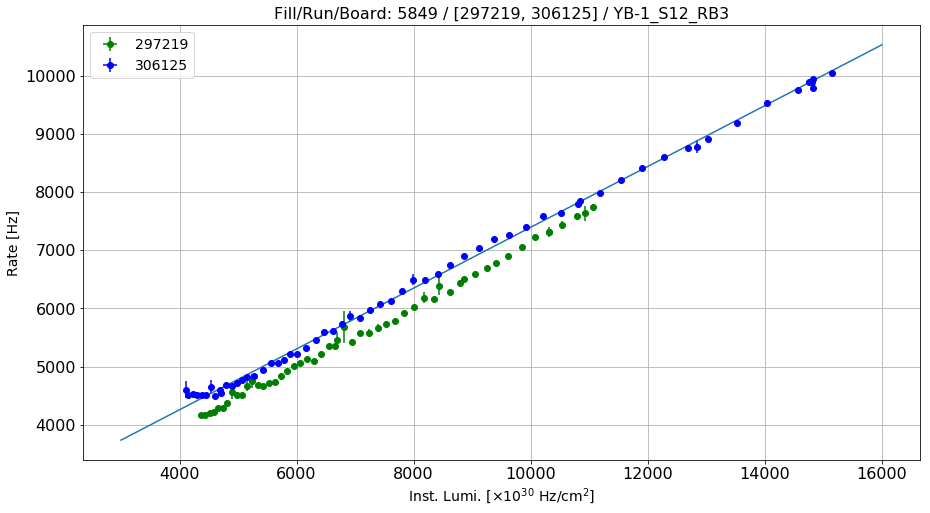

Fill/Run/Board: 5849 / [297219, 306125] / YB-1_S12_RB4
Linear fit for the reference run: [ 1.46345925e-07 -3.26480183e-03  2.77579951e+01]


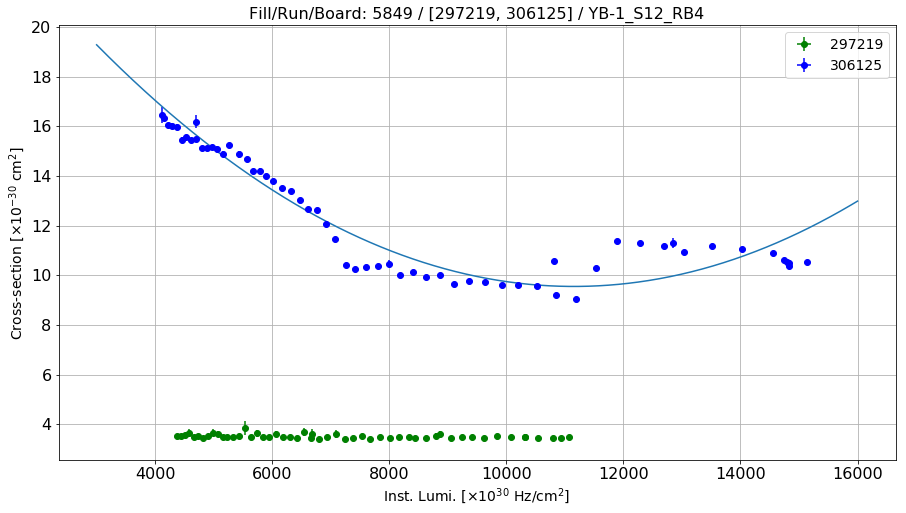

Linear fit parameters: [8.66091851e+00 2.26793247e+04]


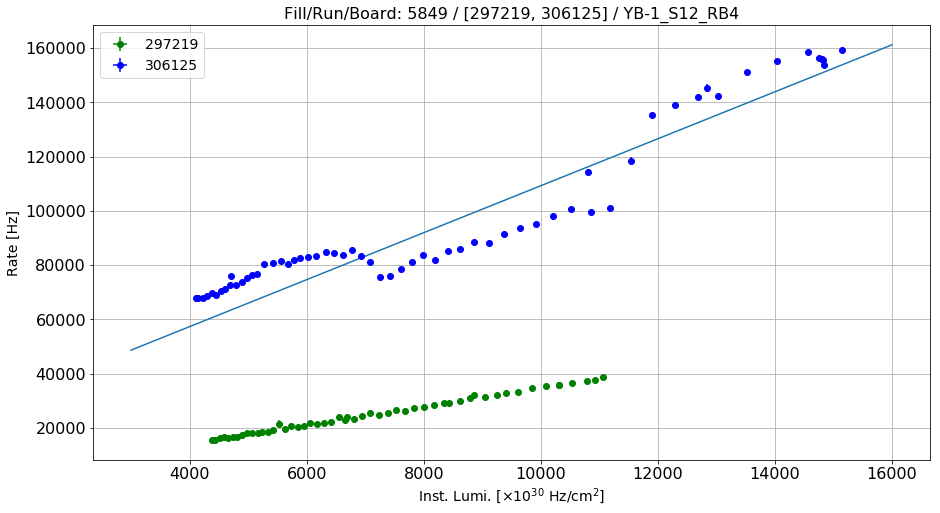

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S1_RB1
Linear fit for the reference run: [ 1.79450807e-09 -5.86108878e-05  4.57213967e+00]


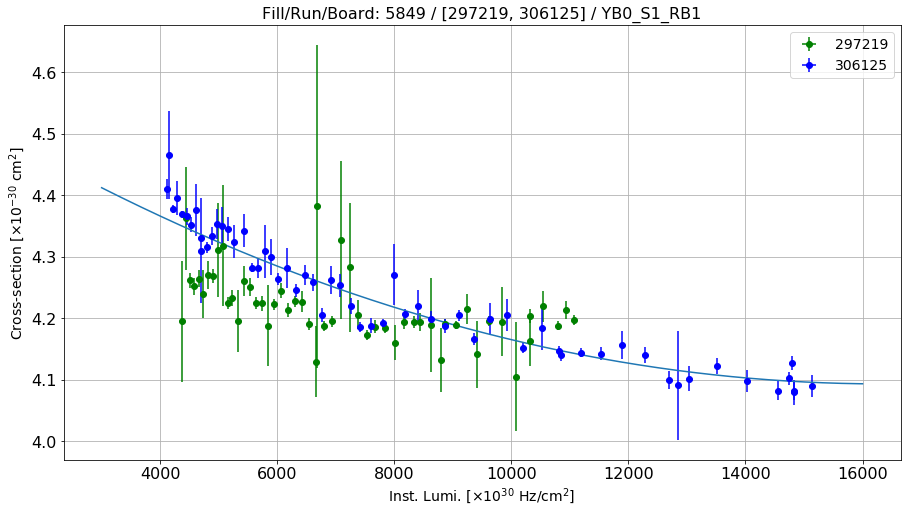

Linear fit parameters: [   3.96963331 1916.22070668]


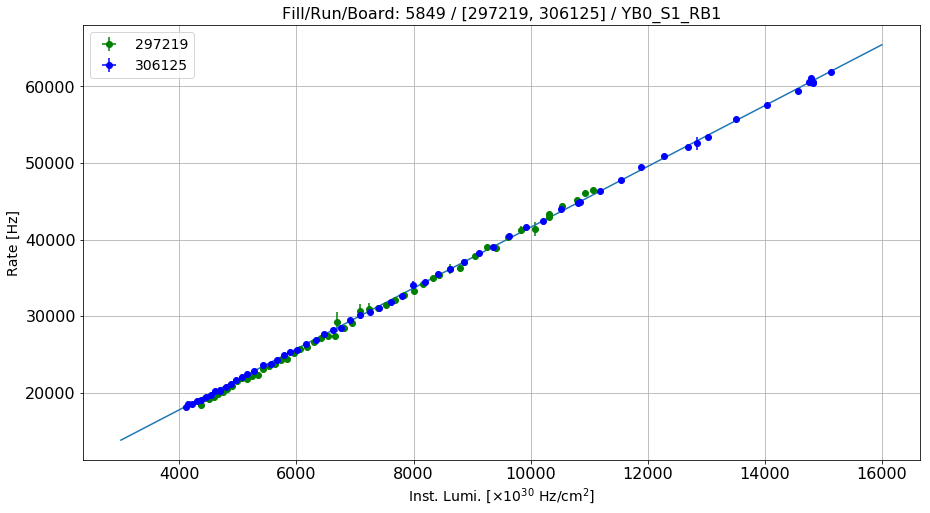

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S1_RB2
Linear fit for the reference run: [ 4.03690634e-09 -1.21930282e-04  2.63174742e+00]


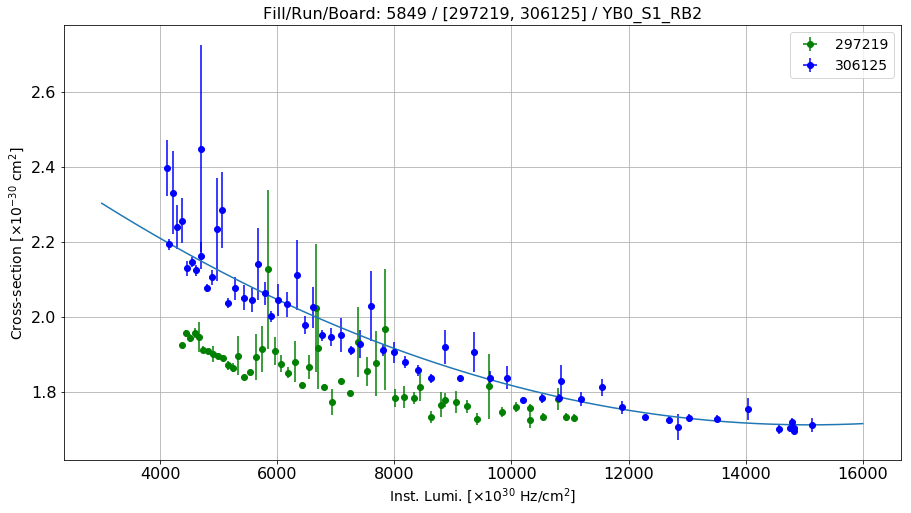

Linear fit parameters: [1.47304162e+00 3.43597515e+03]


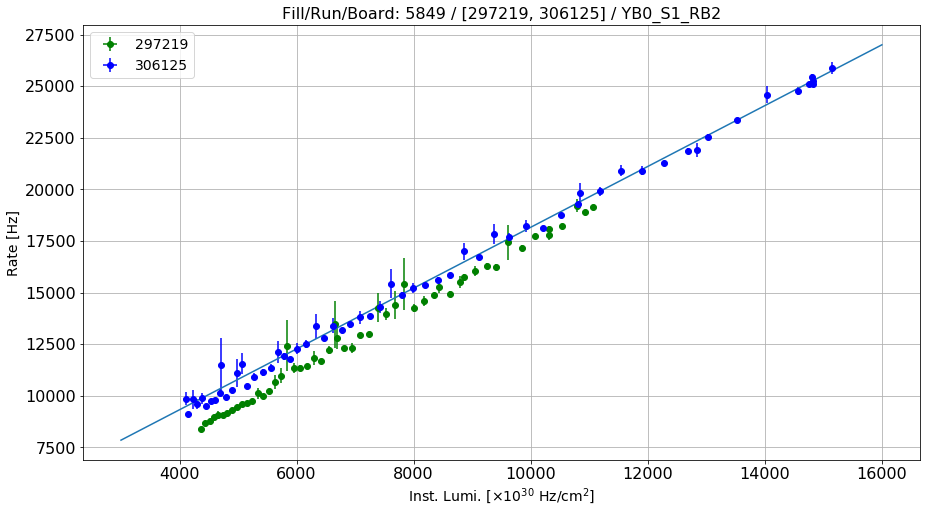

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S1_RB3
Linear fit for the reference run: [ 2.04236099e-07 -5.98213928e-03  5.50468806e+01]


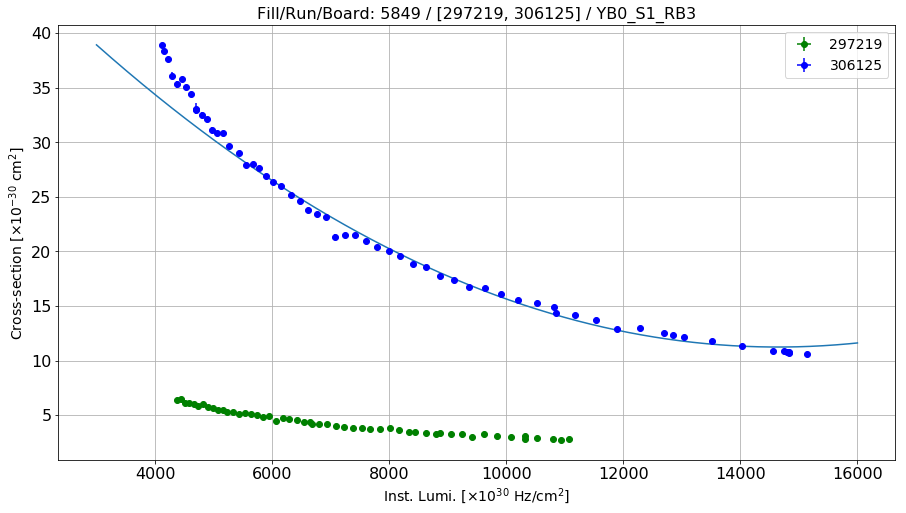

Linear fit parameters: [1.24791013e-01 1.57380976e+05]


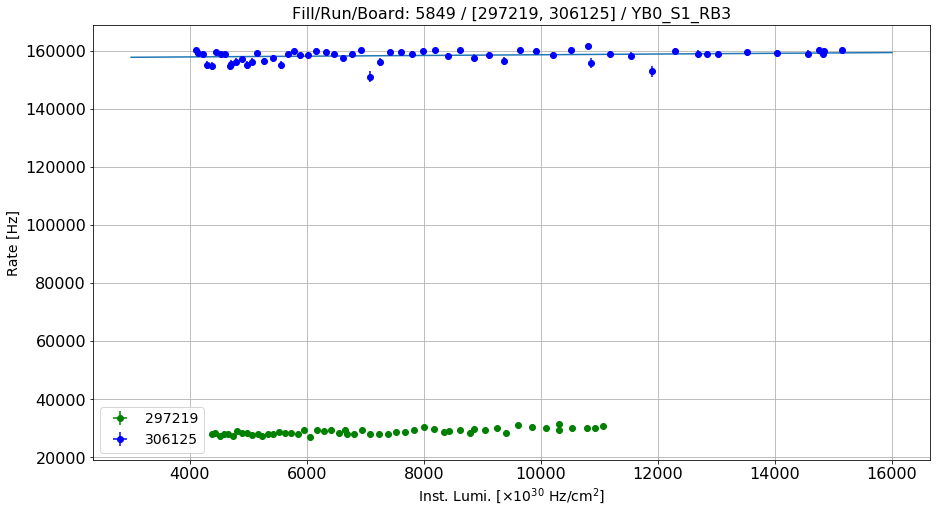

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S1_RB4
Linear fit for the reference run: [ 1.60916838e-11 -3.06479582e-07  2.58689168e-03]


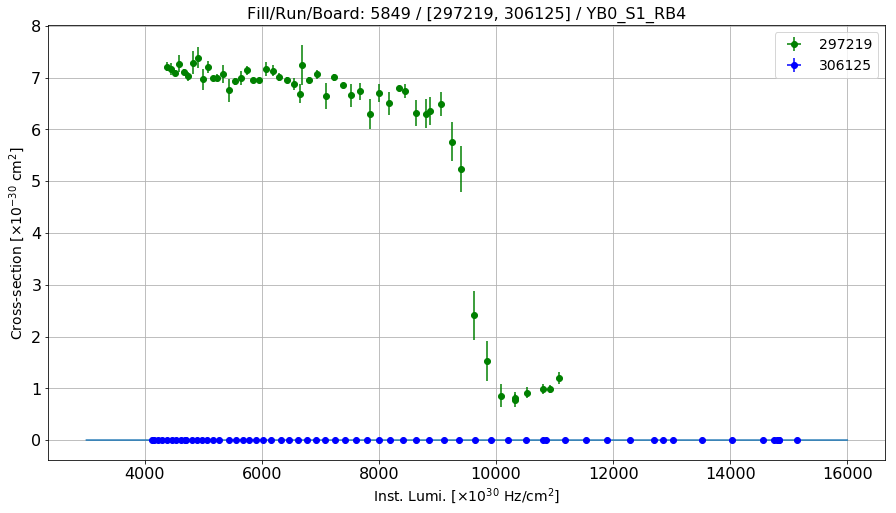

Linear fit parameters: [ 1.52808807e-03 -2.13616135e+00]


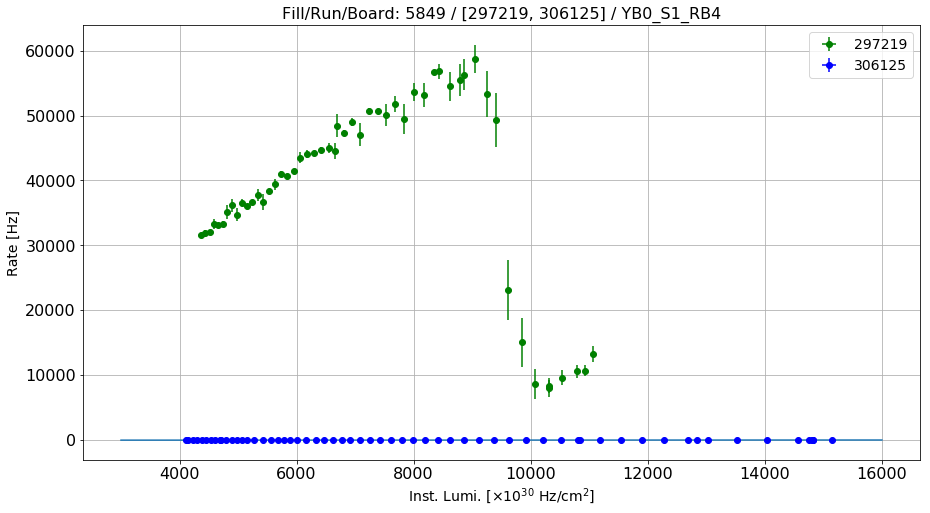

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S2_RB1
Linear fit for the reference run: [ 5.92303247e-09 -1.88385107e-04  7.02537436e+00]


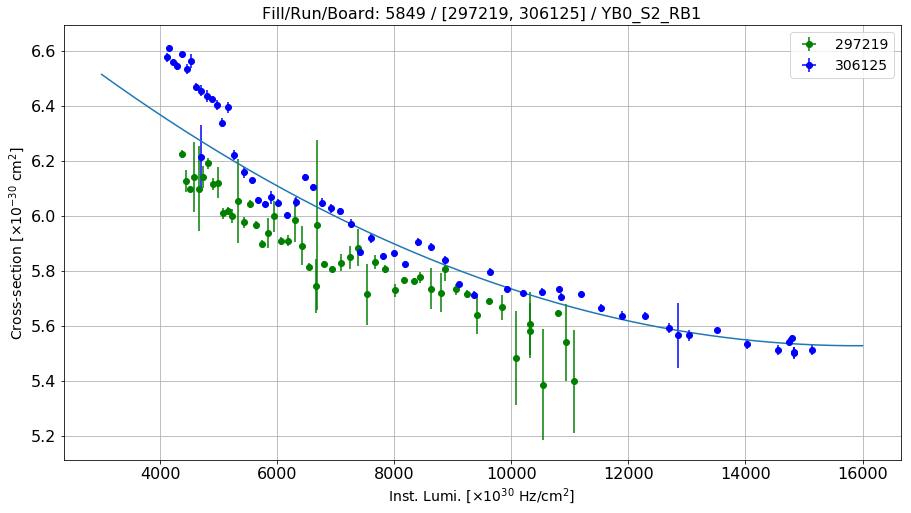

Linear fit parameters: [5.13720956e+00 5.87782812e+03]


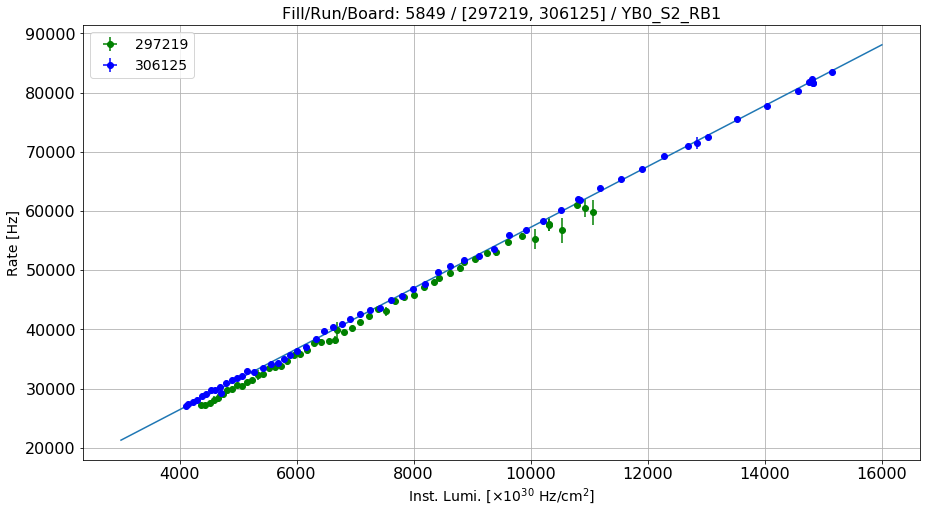

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S2_RB2
Linear fit for the reference run: [ 3.69844045e-09 -1.19530669e-04  3.21476568e+00]


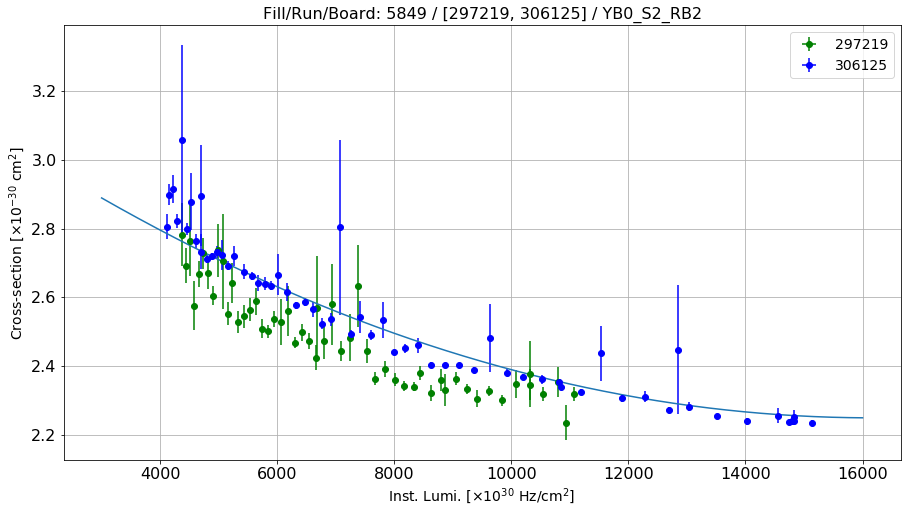

Linear fit parameters: [1.99809564e+00 3.83773908e+03]


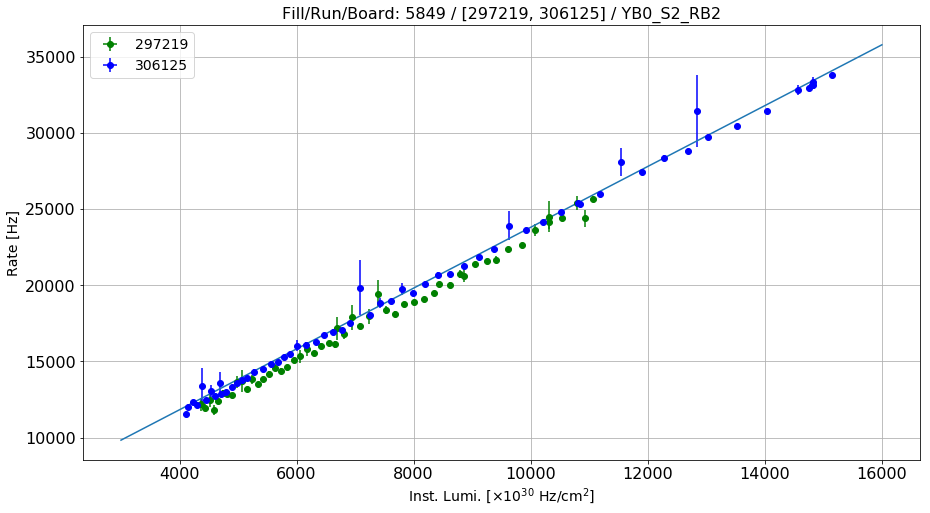

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S2_RB3
Linear fit for the reference run: [ 6.40722016e-08 -1.91206582e-03  1.85896843e+01]


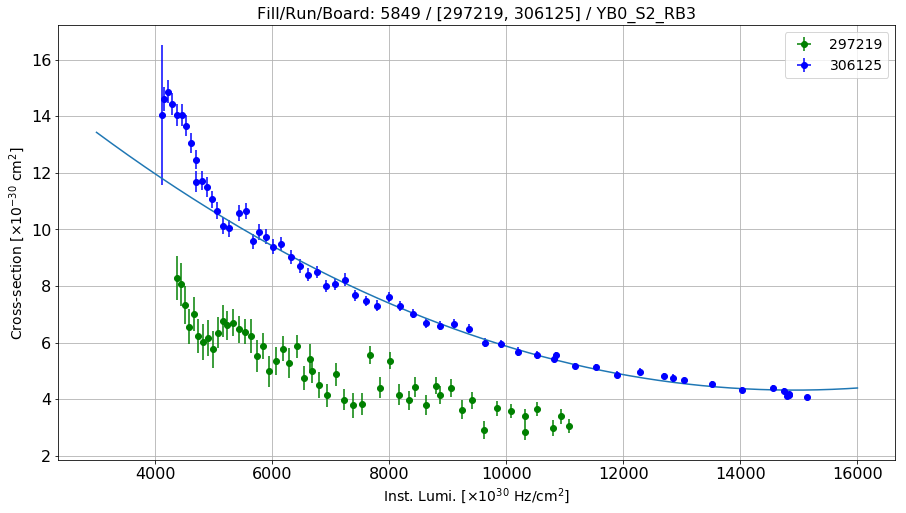

Linear fit parameters: [6.58429598e-01 5.24919095e+04]


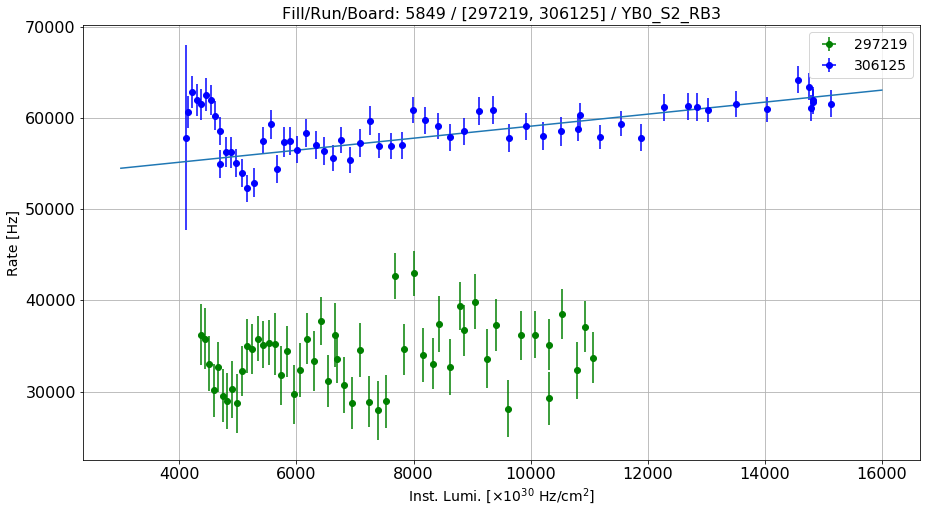

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S2_RB4
Linear fit for the reference run: [ 6.93074583e-09 -2.26965121e-04  2.04344978e+01]


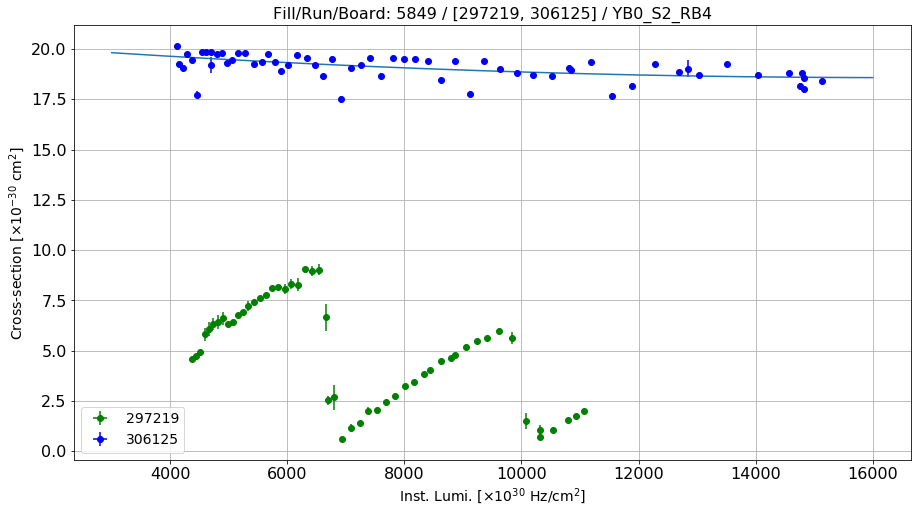

Linear fit parameters: [  18.09563727 7453.57688972]


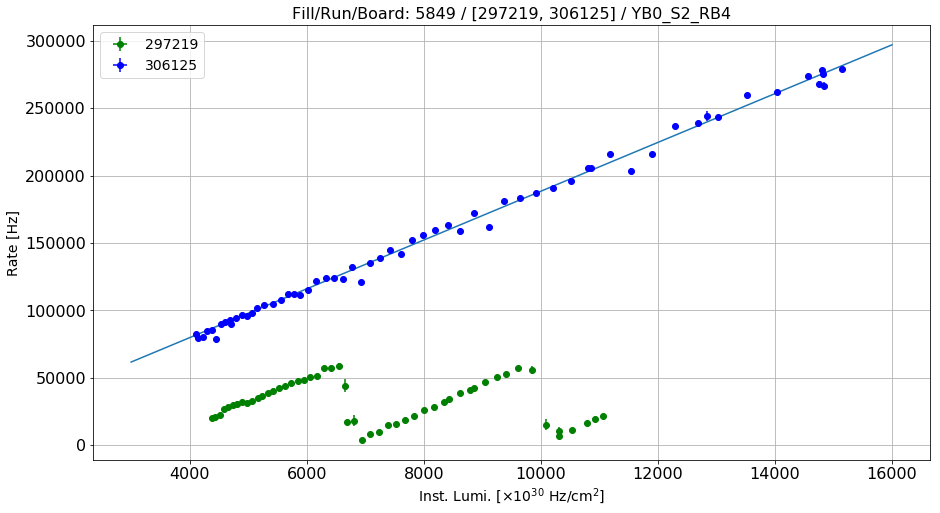

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S3_RB1
Linear fit for the reference run: [-1.42231337e-09 -1.37086855e-05  5.85697307e+00]


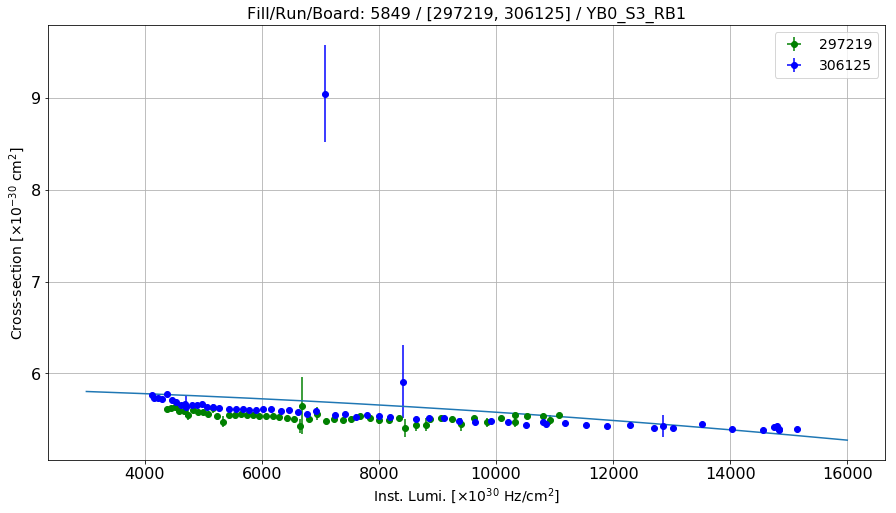

Linear fit parameters: [   5.14166292 3786.26468092]


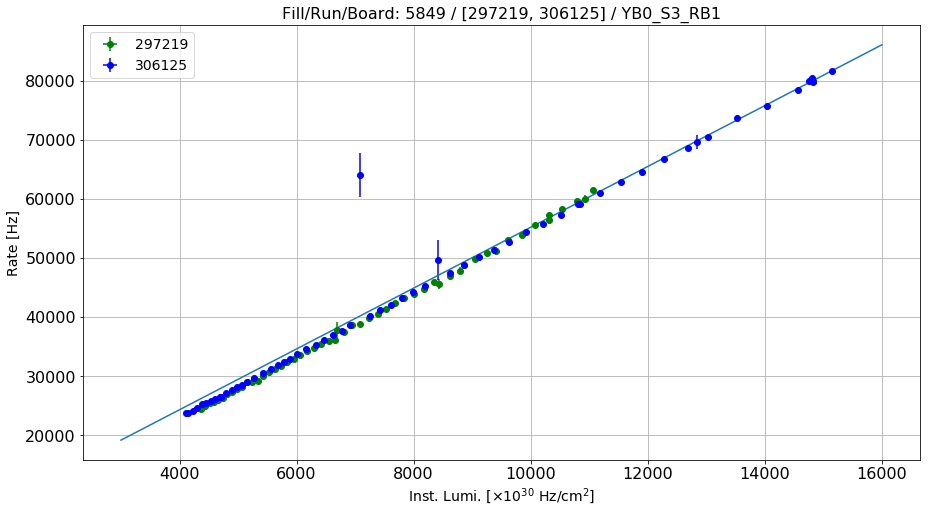

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S3_RB2
Linear fit for the reference run: [ 3.41323813e-08 -6.96315499e-04  6.89772300e+00]


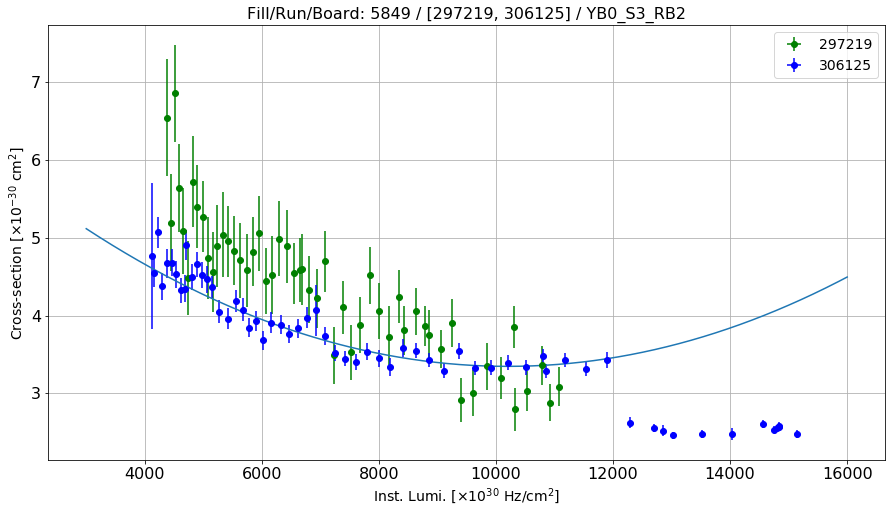

Linear fit parameters: [2.63821317e+00 7.58744469e+03]


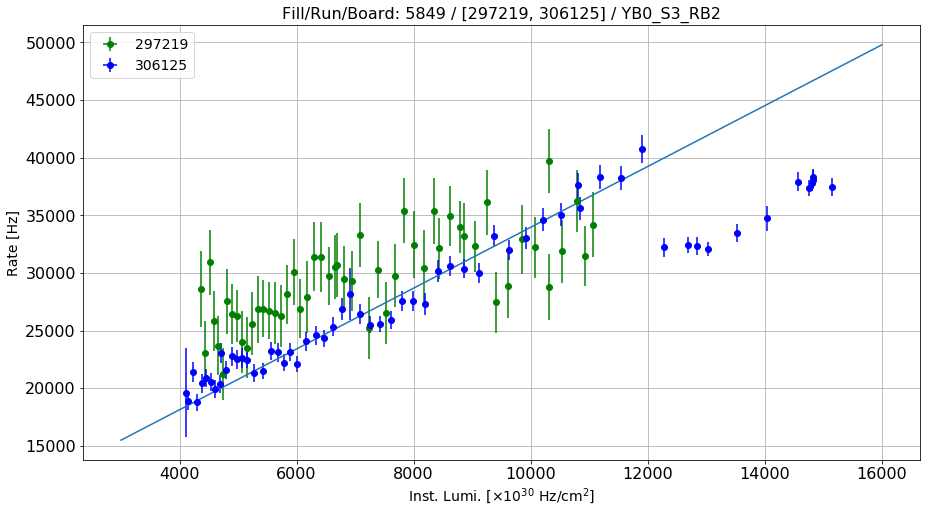

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S3_RB3
Linear fit for the reference run: [ 4.68433044e-09 -1.30237492e-04  1.88520093e+00]


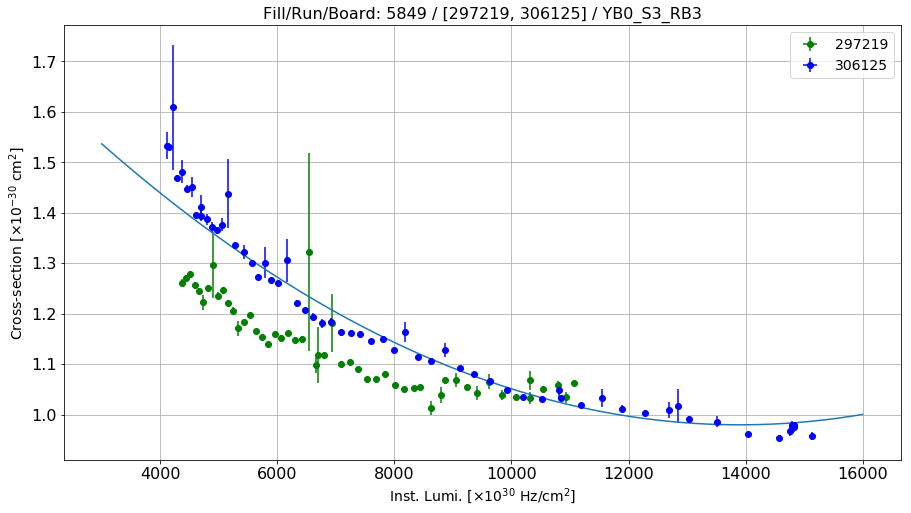

Linear fit parameters: [7.63669913e-01 2.99524554e+03]


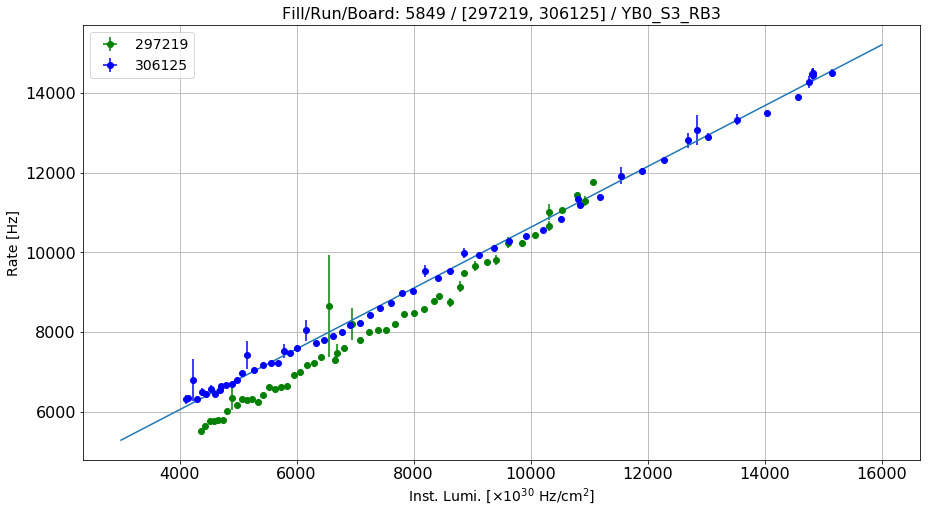

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S3_RB4
Linear fit for the reference run: [ 1.52680652e-08 -5.59064609e-04  3.69110217e+01]


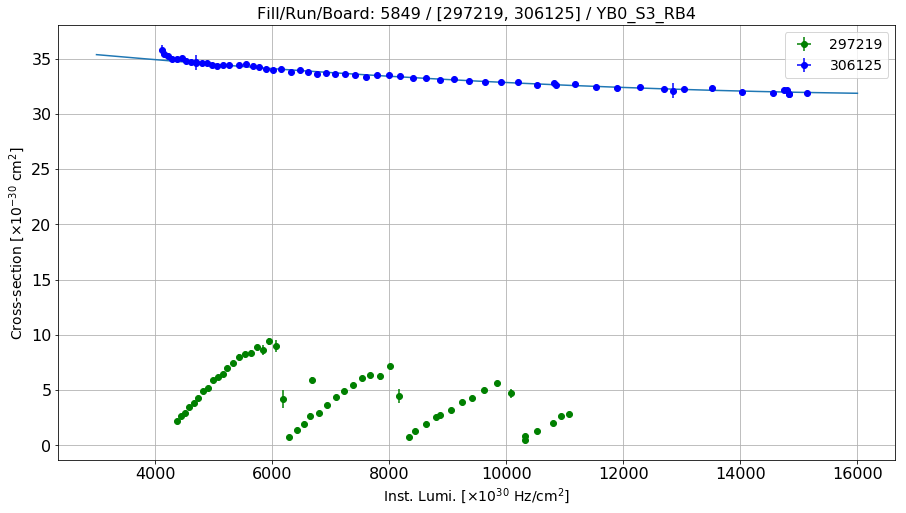

Linear fit parameters: [   30.58740988 21628.7026769 ]


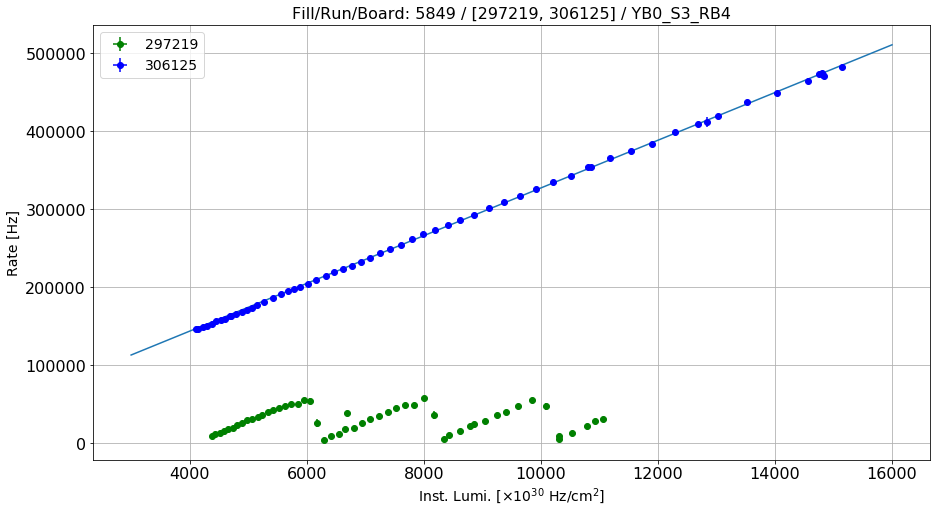

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S4_RB1
Linear fit for the reference run: [ 1.67932735e-09 -5.54598914e-05  5.89755684e+00]


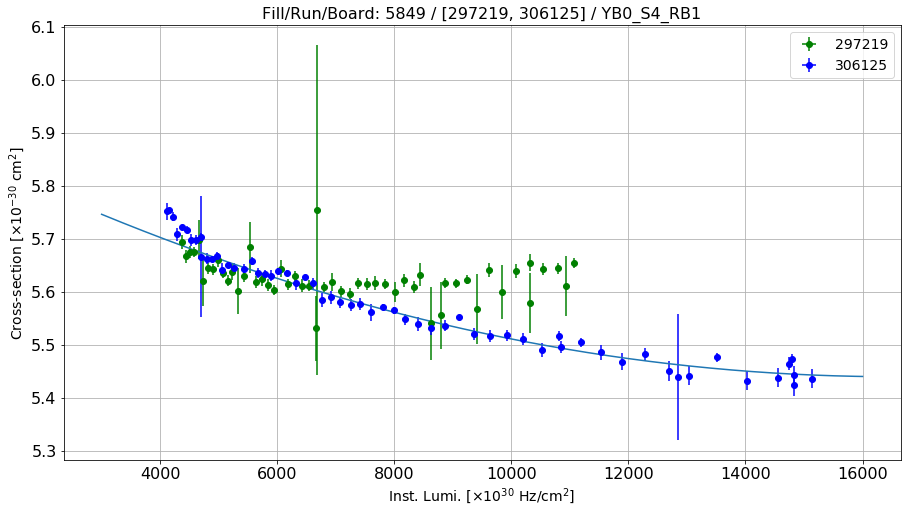

Linear fit parameters: [   5.32160915 1847.09999008]


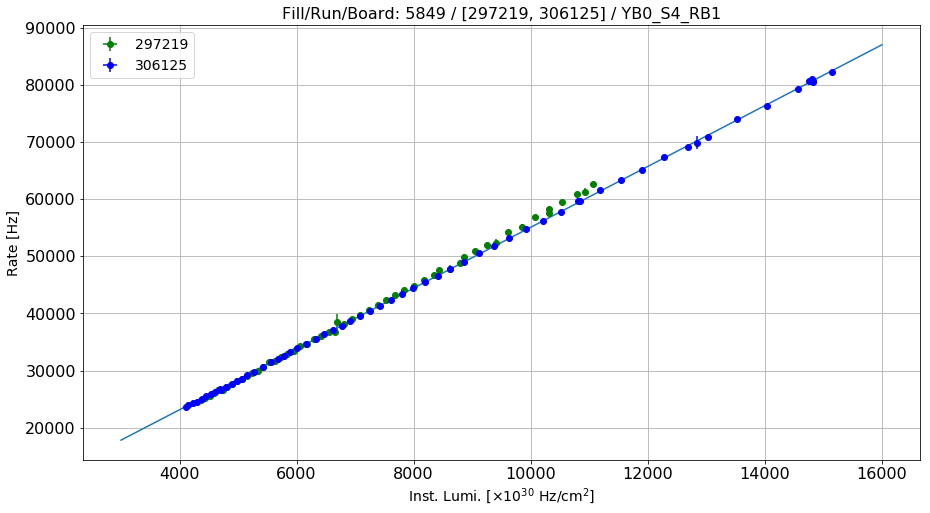

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S4_RB2
Linear fit for the reference run: [ 3.16961451e-09 -9.70005848e-05  2.82562434e+00]


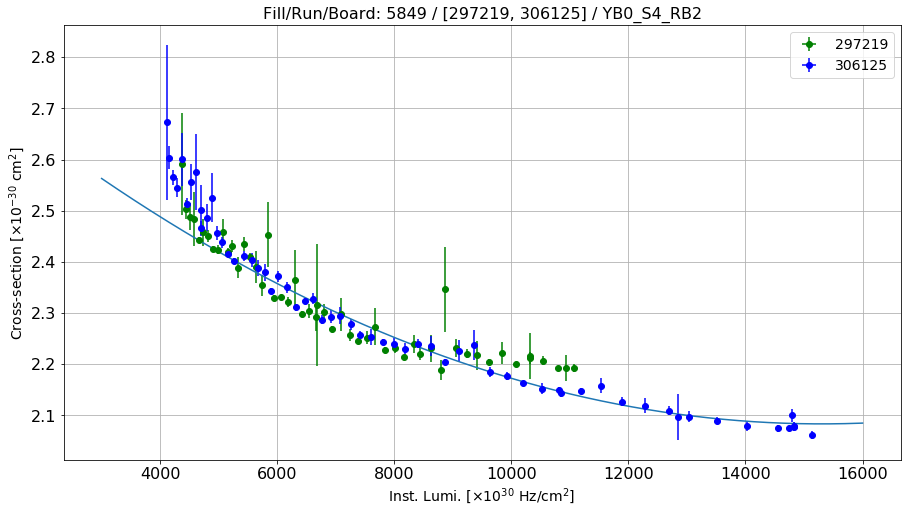

Linear fit parameters: [1.89075698e+00 2.80941102e+03]


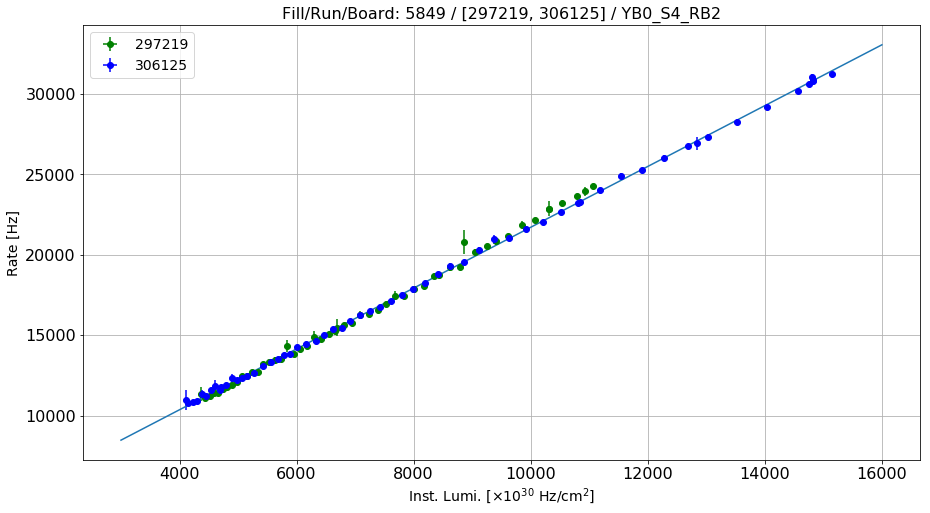

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S4_RB3
Linear fit for the reference run: [ 1.24540235e-09 -7.67747266e-05  2.13627876e+00]


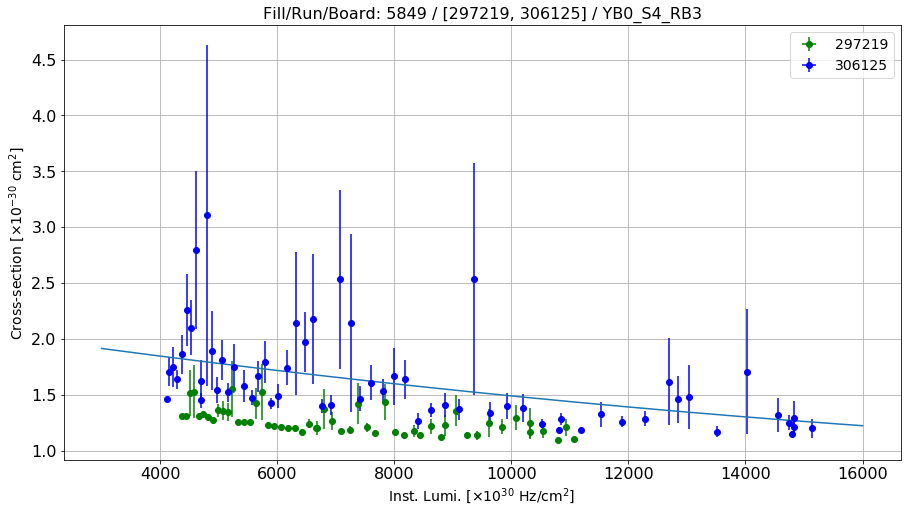

Linear fit parameters: [1.00241585e+00 4.51293376e+03]


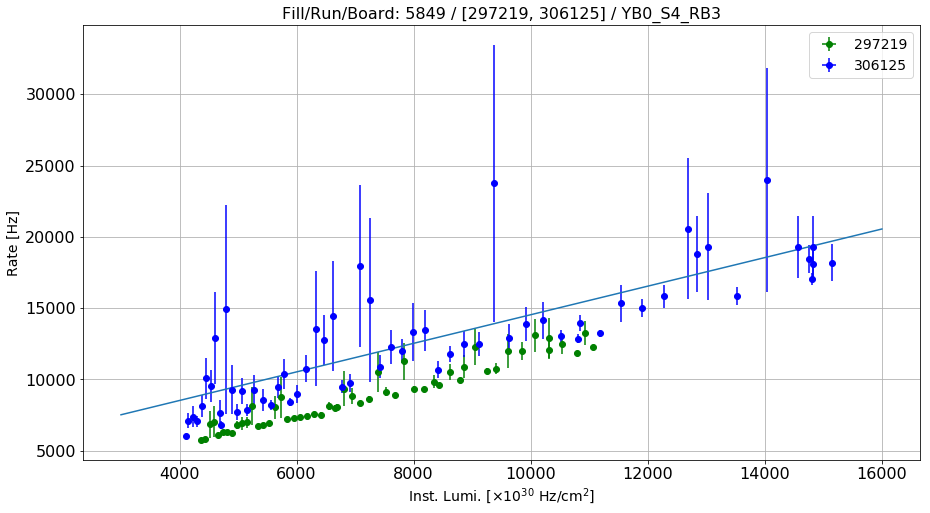

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S4_RB4
Linear fit for the reference run: [ 1.67778837e-08 -6.06187188e-04  6.38997730e+01]


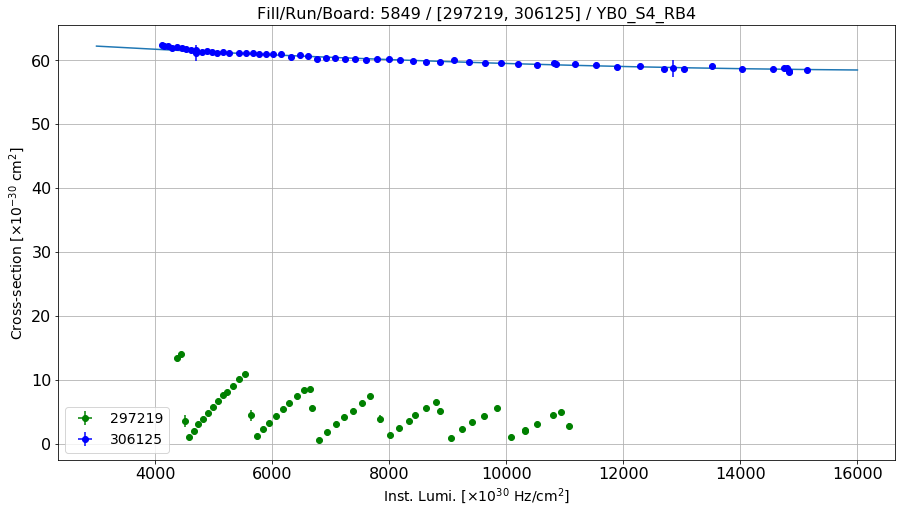

Linear fit parameters: [   57.1126601  23047.81681659]


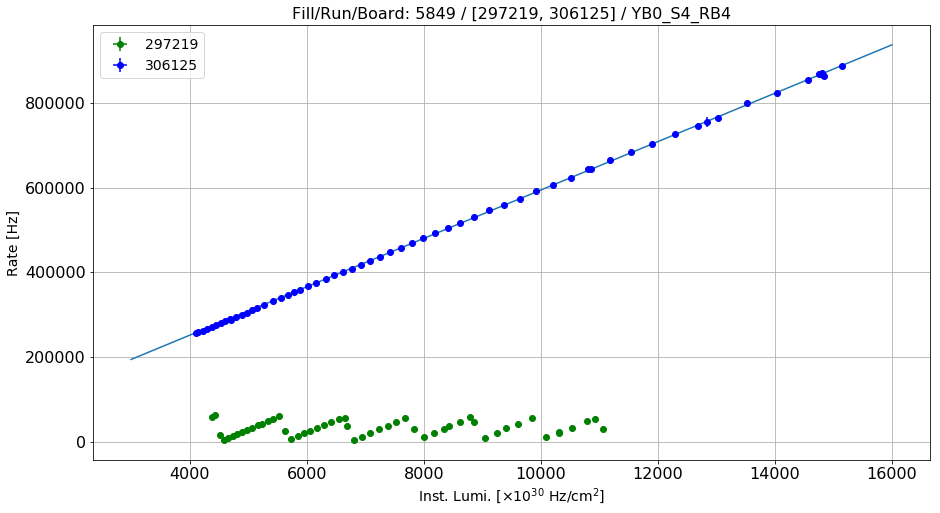

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S5_RB1
Linear fit for the reference run: [ 3.10426095e-08 -8.89340916e-04  1.31618494e+01]


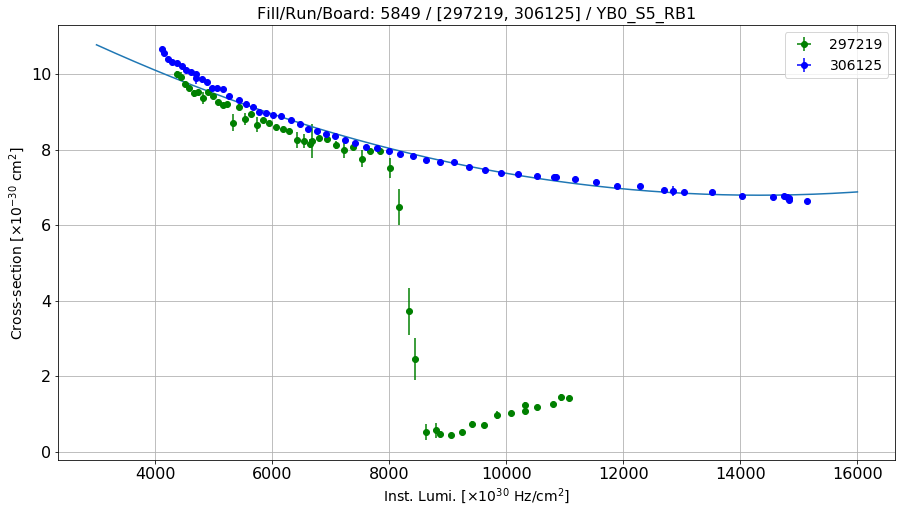

Linear fit parameters: [5.20872682e+00 2.21655875e+04]


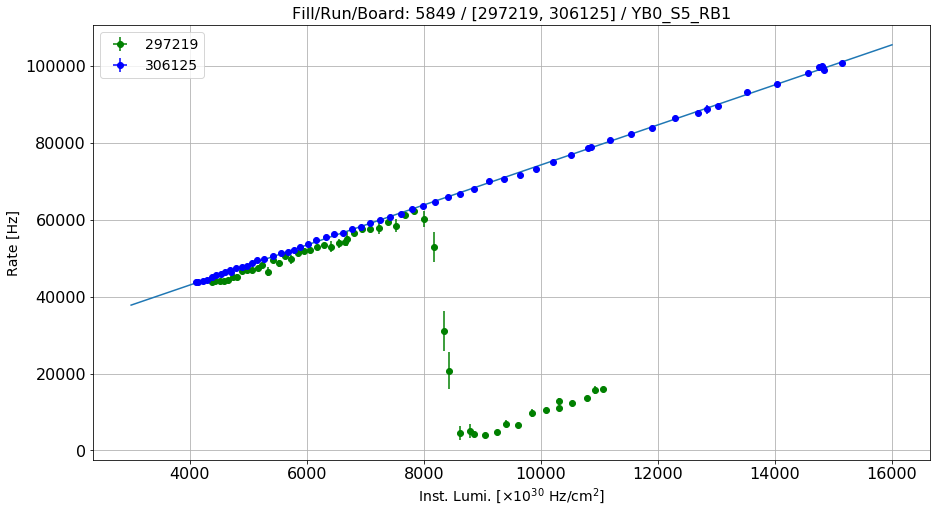

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S5_RB2
Linear fit for the reference run: [ 1.42255560e-07 -4.51999977e-03  4.94291496e+01]


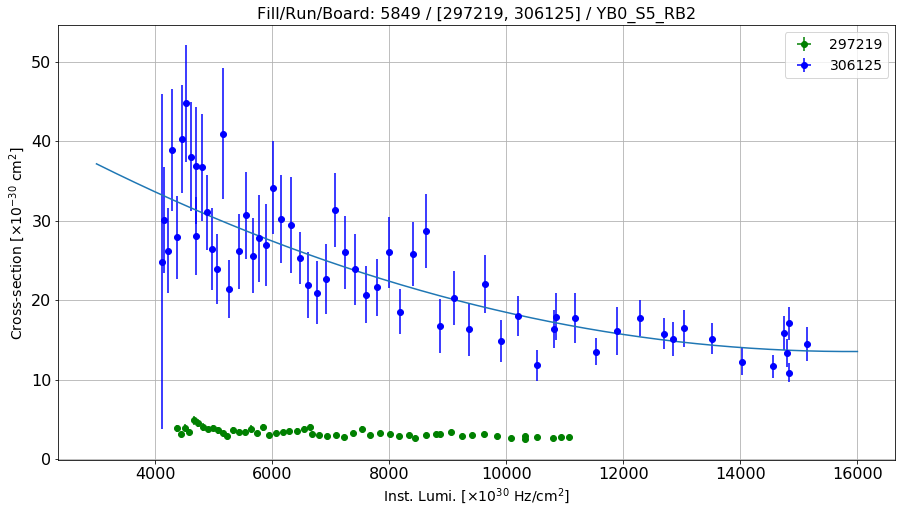

Linear fit parameters: [4.16988467e+00 1.40772032e+05]


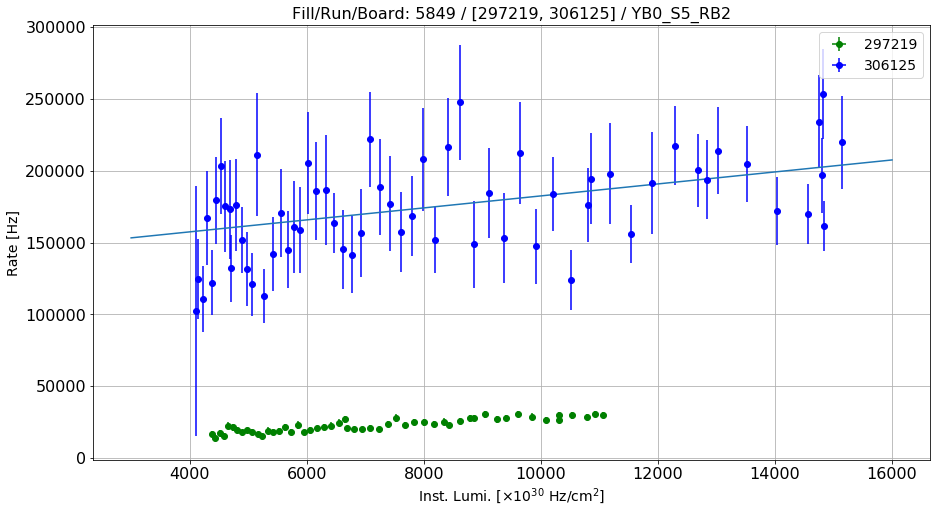

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S5_RB3
Linear fit for the reference run: [ 4.11523340e-09 -1.14660396e-04  1.74345371e+00]


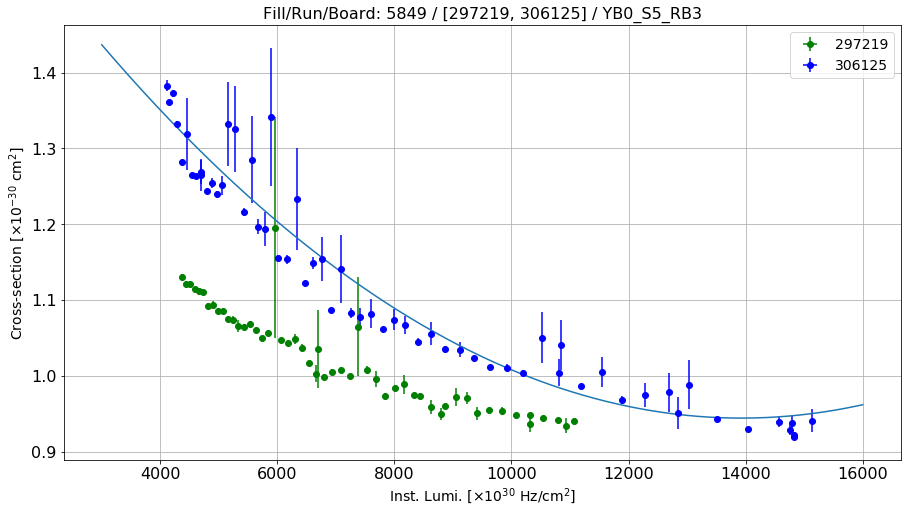

Linear fit parameters: [7.53311554e-01 2.65299280e+03]


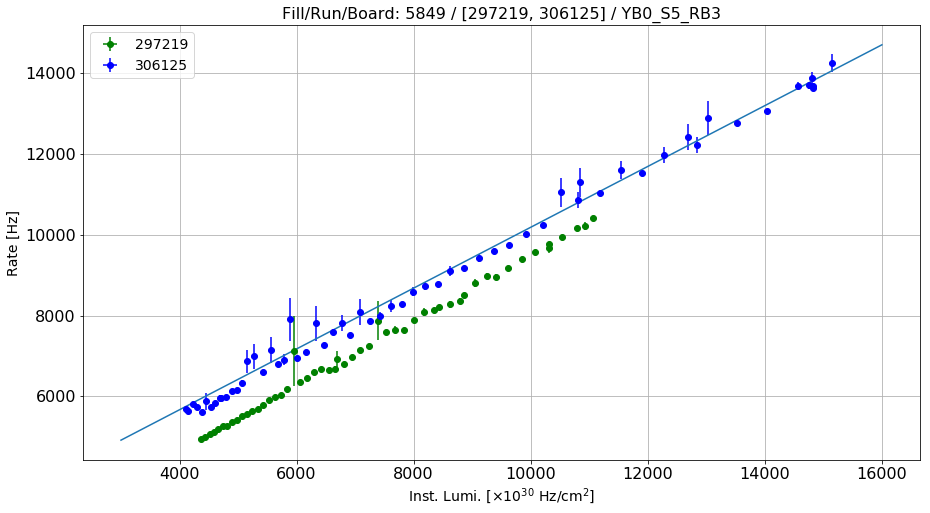

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S5_RB4
Linear fit for the reference run: [ 9.11517764e-09 -3.55504615e-04  4.11165048e+01]


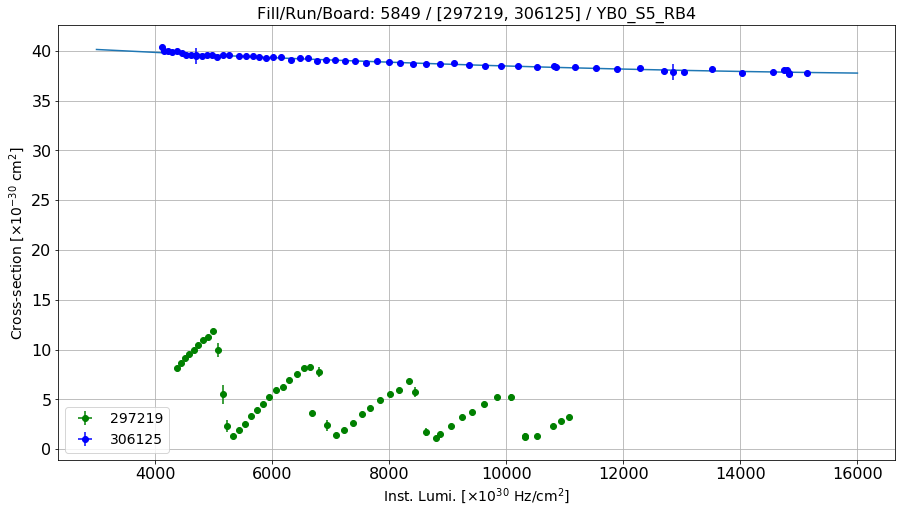

Linear fit parameters: [   36.91025527 14829.32543401]


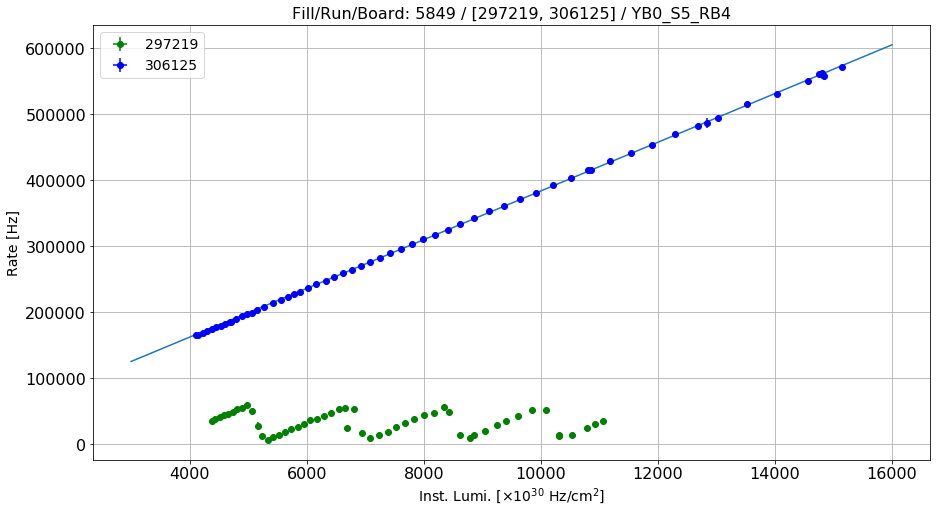

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S6_RB1
Linear fit for the reference run: [ 3.48899486e-09 -1.07241451e-04  6.21629881e+00]


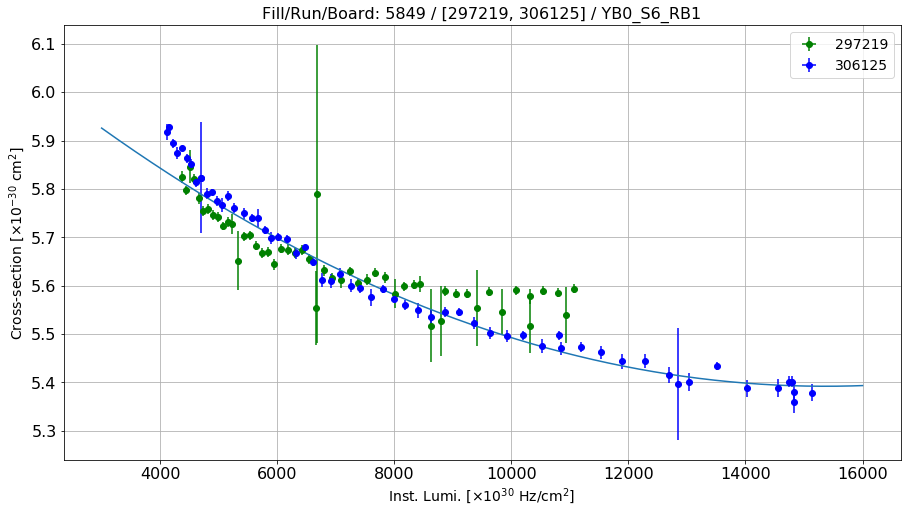

Linear fit parameters: [   5.17797641 3133.65583066]


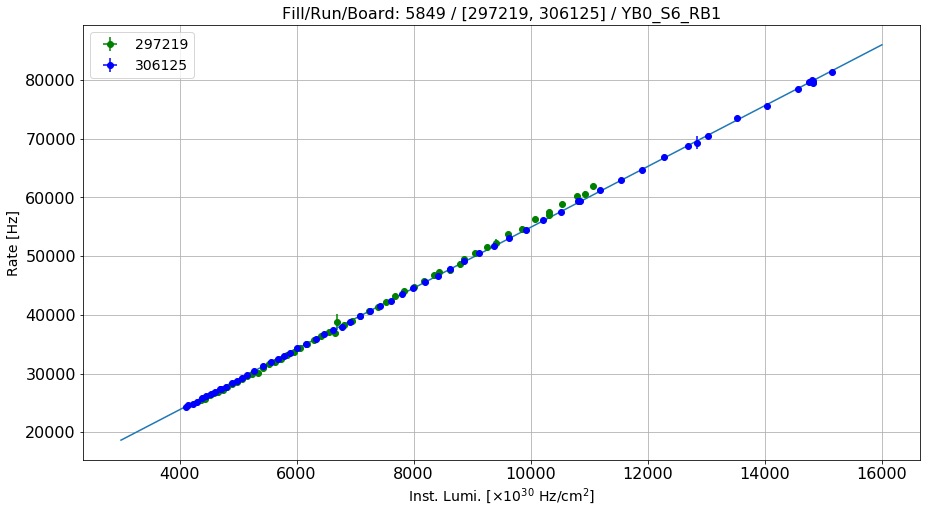

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S6_RB2
Linear fit for the reference run: [ 2.40959992e-09 -1.82729621e-04  4.72864847e+00]


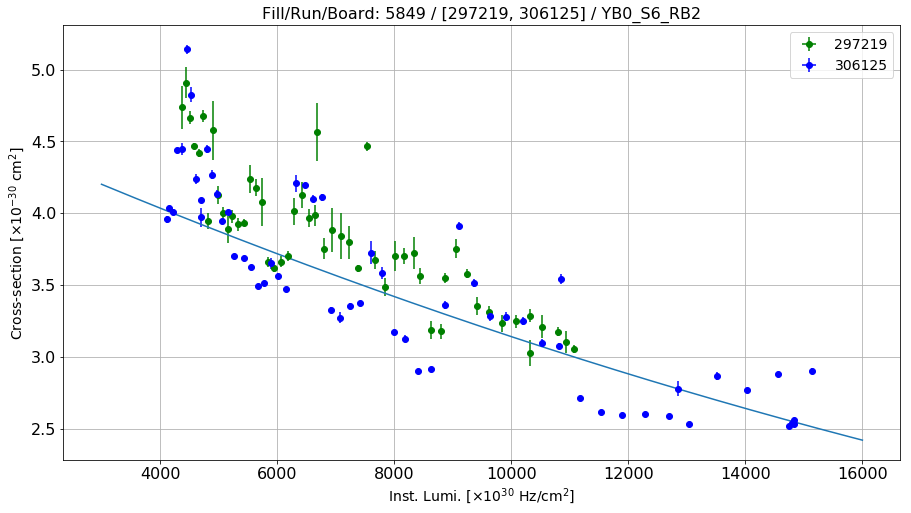

Linear fit parameters: [1.85704804e+00 1.17460600e+04]


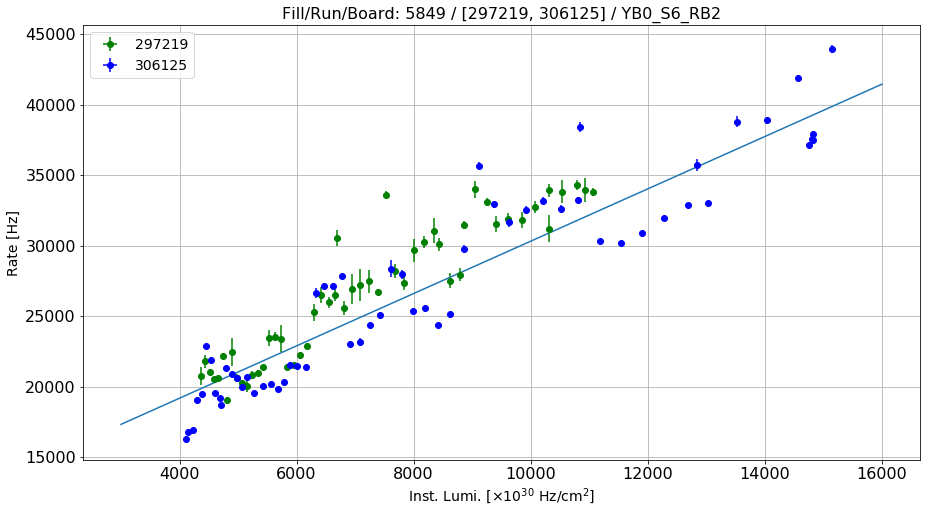

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S6_RB3
Linear fit for the reference run: [ 2.47781574e-09 -7.65160325e-05  1.34478558e+00]


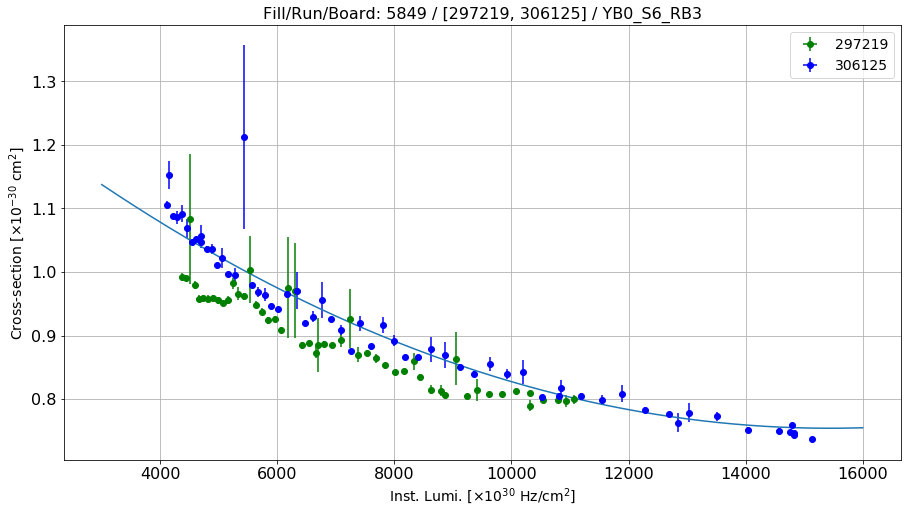

Linear fit parameters: [6.00345733e-01 2.25678657e+03]


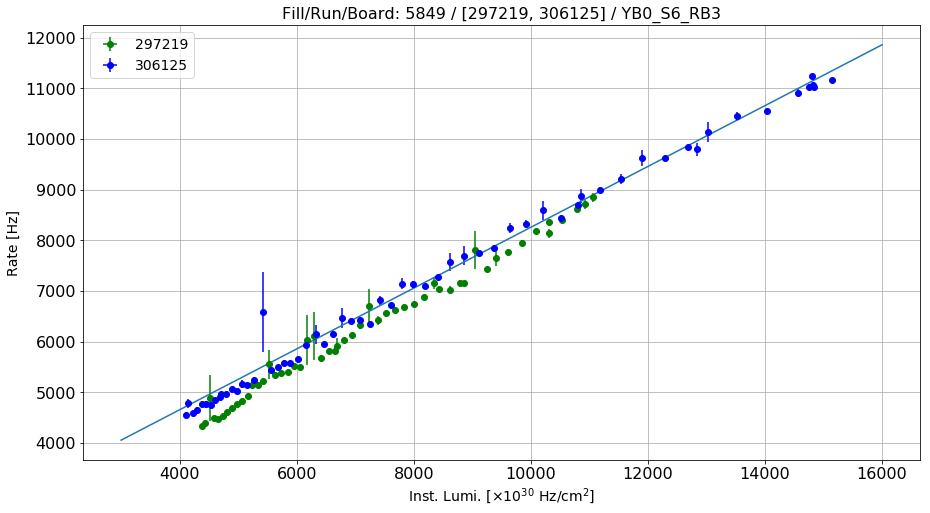

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S6_RB4
Linear fit for the reference run: [ 7.85907605e-09 -2.60869562e-04  2.45518881e+01]


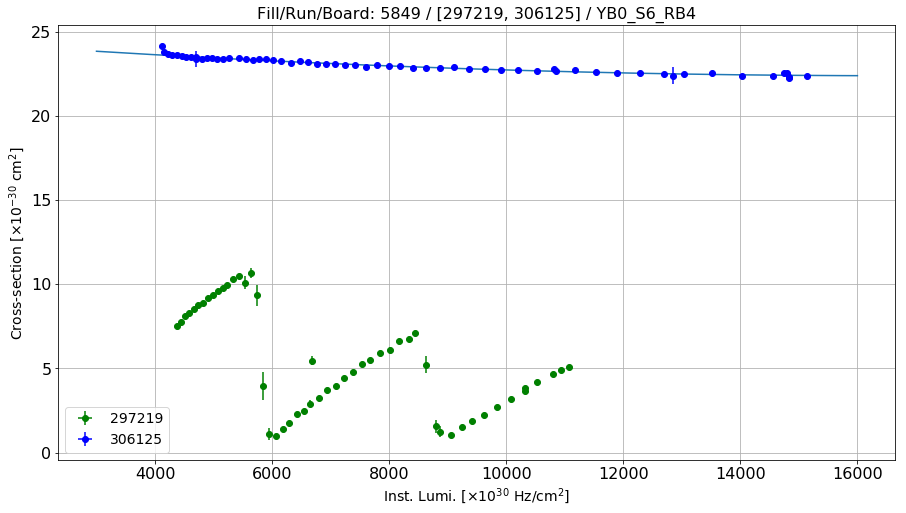

Linear fit parameters: [  21.83028066 8760.90045693]


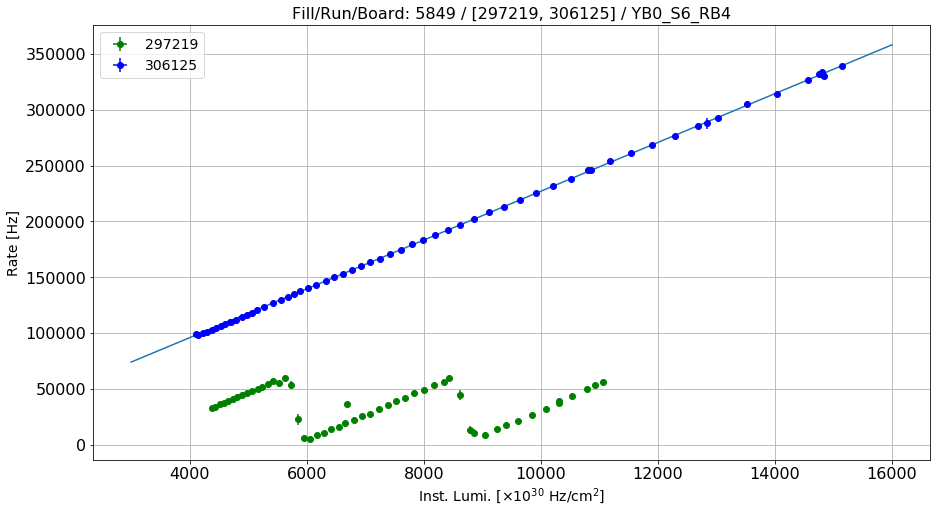

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S7_RB1
Linear fit for the reference run: [ 2.42617441e-09 -7.09125560e-05  4.71727293e+00]


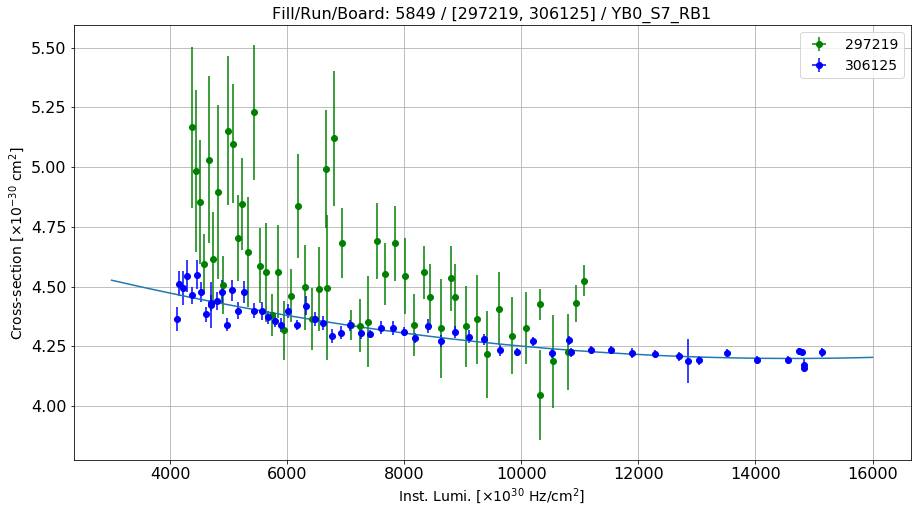

Linear fit parameters: [   4.0678299  1856.26827565]


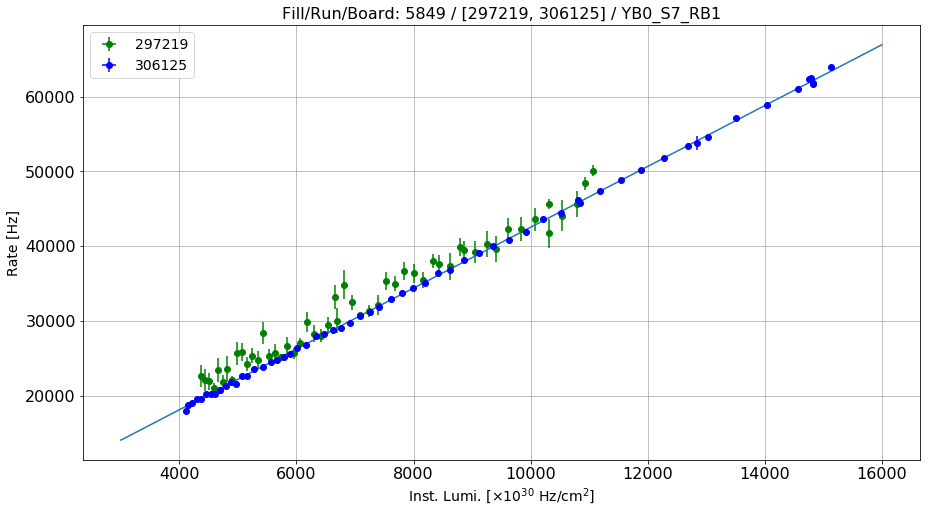

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S7_RB2
Linear fit for the reference run: [ 4.69535019e-09 -1.45530660e-04  3.03808217e+00]


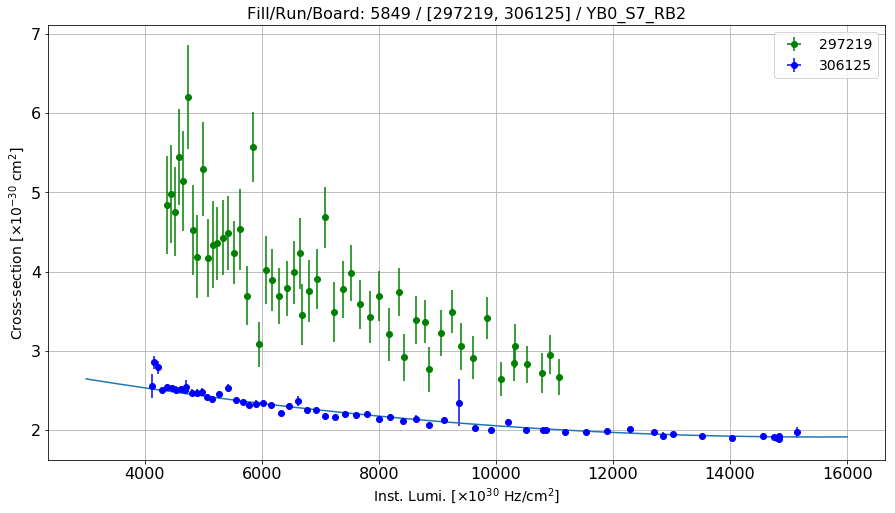

Linear fit parameters: [1.61677080e+00 4.32379013e+03]


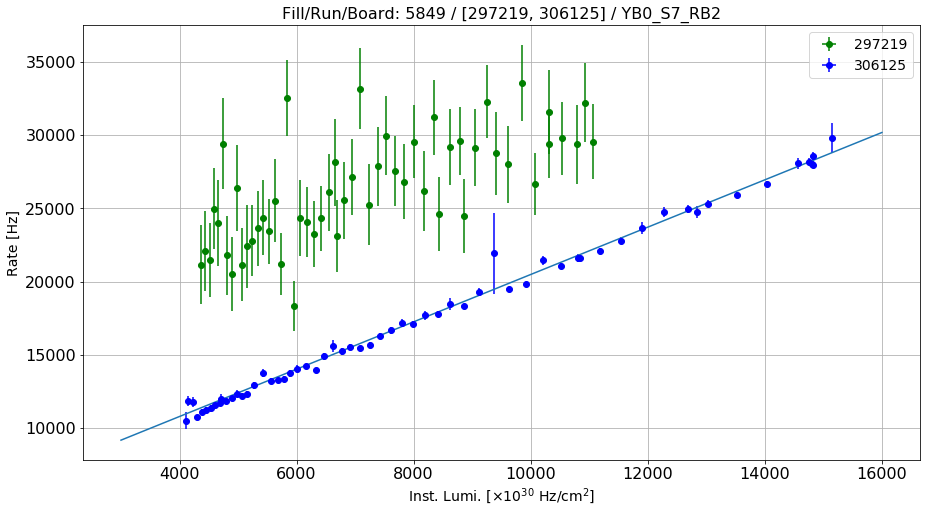

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S7_RB3
Linear fit for the reference run: [ 4.73707171e-09 -1.35322911e-04  1.62589572e+00]


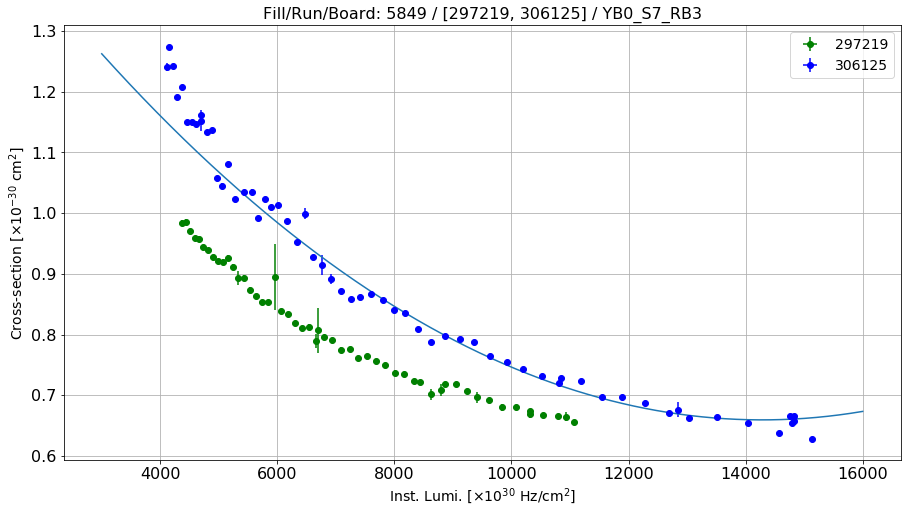

Linear fit parameters: [4.19982366e-01 3.34808949e+03]


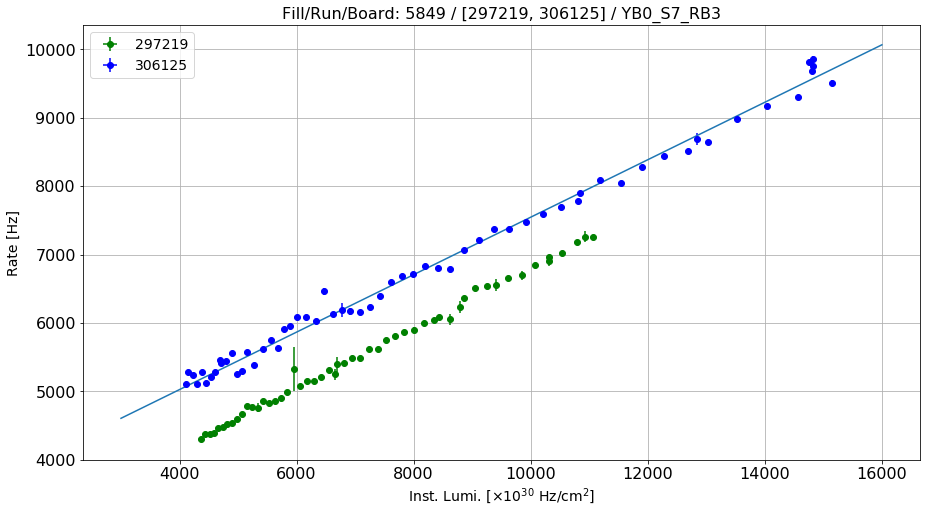

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S7_RB4
Linear fit for the reference run: [ 1.21025505e-11 -2.13250665e-07  2.22375120e-03]


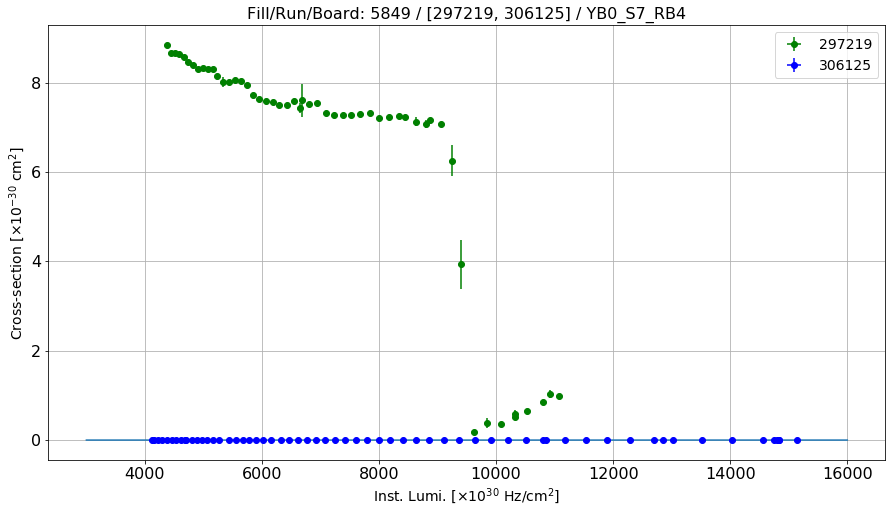

Linear fit parameters: [ 1.76949012e-03 -3.12789272e+00]


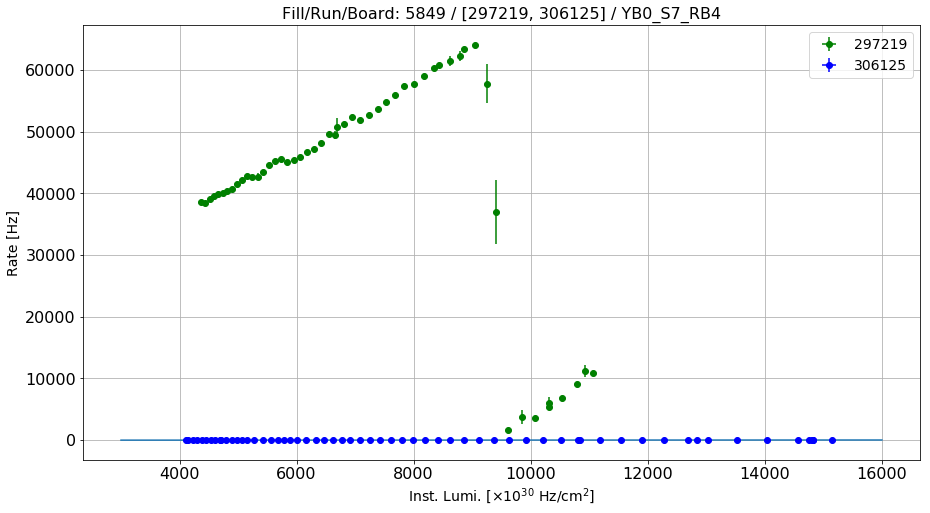

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S8_RB1
Linear fit for the reference run: [ 8.74236731e-11 -1.82223319e-05  4.50480174e+00]


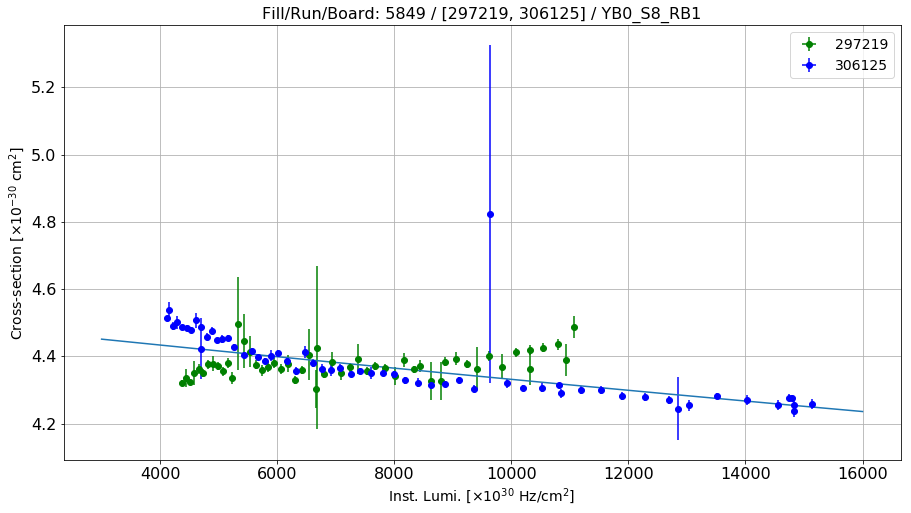

Linear fit parameters: [   4.17076949 1448.37466795]


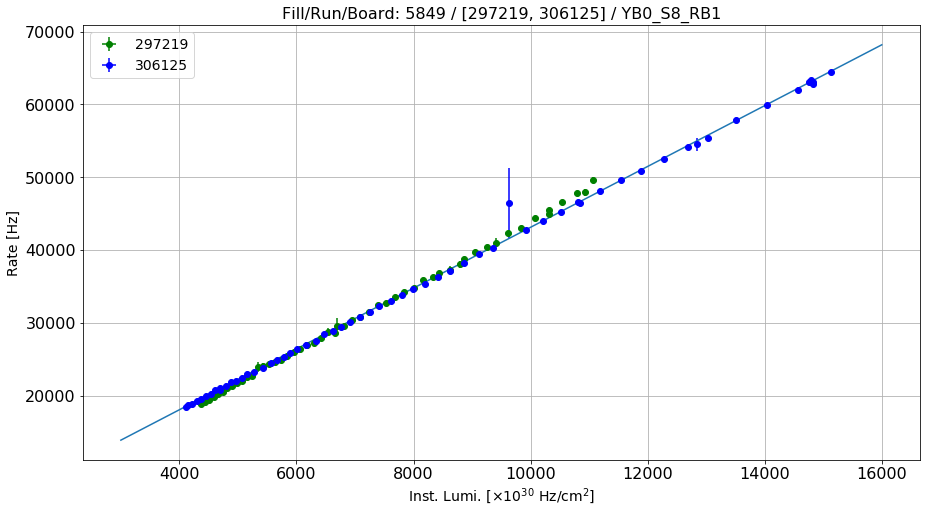

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S8_RB2
Linear fit for the reference run: [ 7.69613660e-08 -2.00947969e-03  1.91708966e+01]


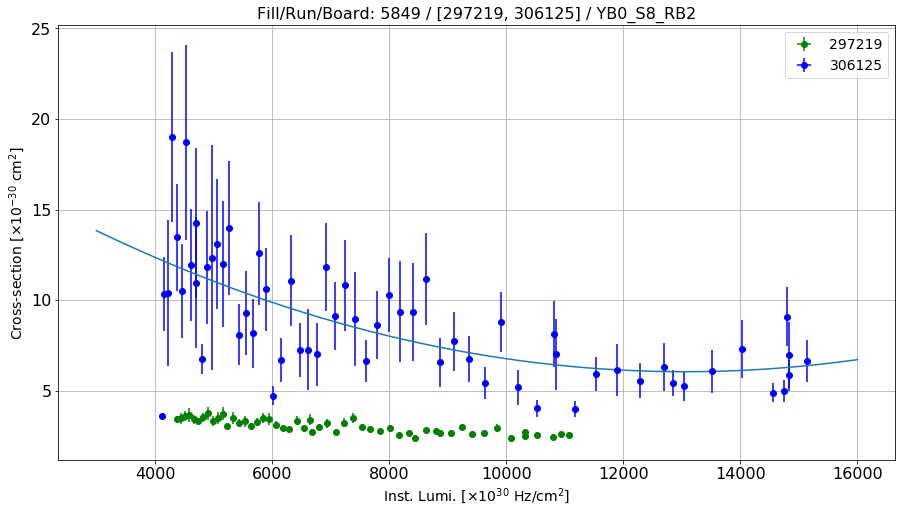

Linear fit parameters: [3.32735251e+00 3.77243373e+04]


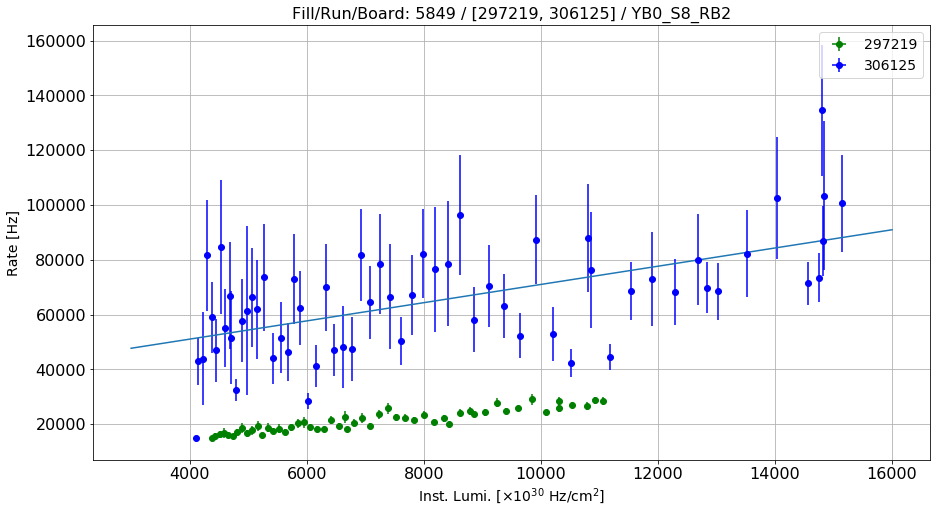

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S8_RB3
Linear fit for the reference run: [ 8.99354461e-08 -2.47770116e-03  2.20825880e+01]


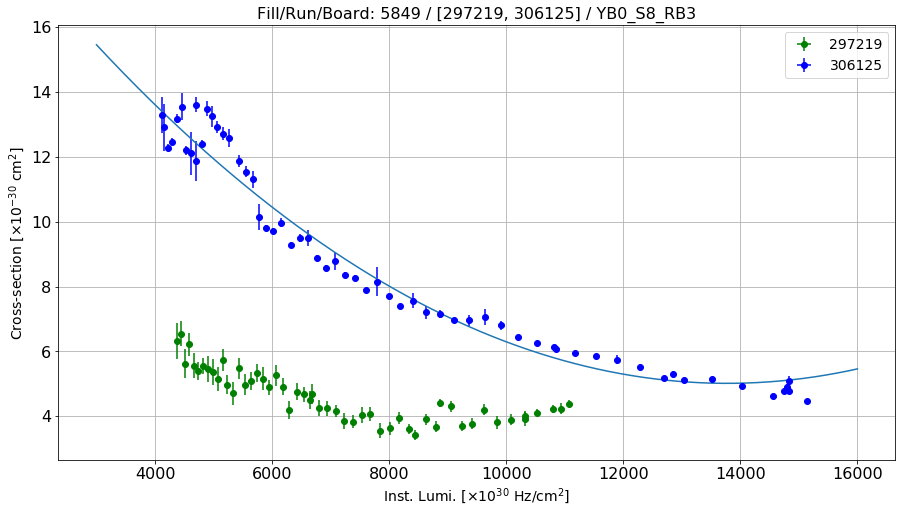

Linear fit parameters: [1.00125690e+00 5.54997926e+04]


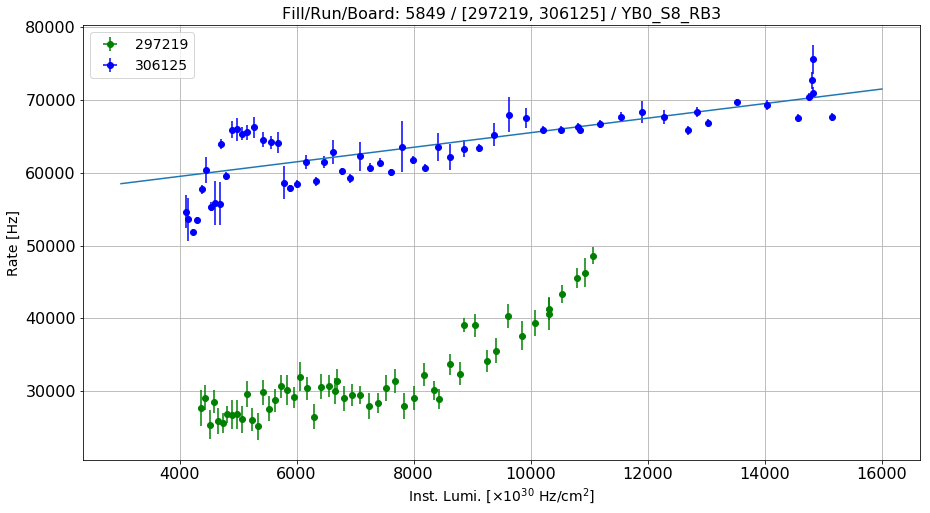

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S8_RB4
Linear fit for the reference run: [ 4.06520489e-09 -1.23743482e-04  7.76653634e+00]


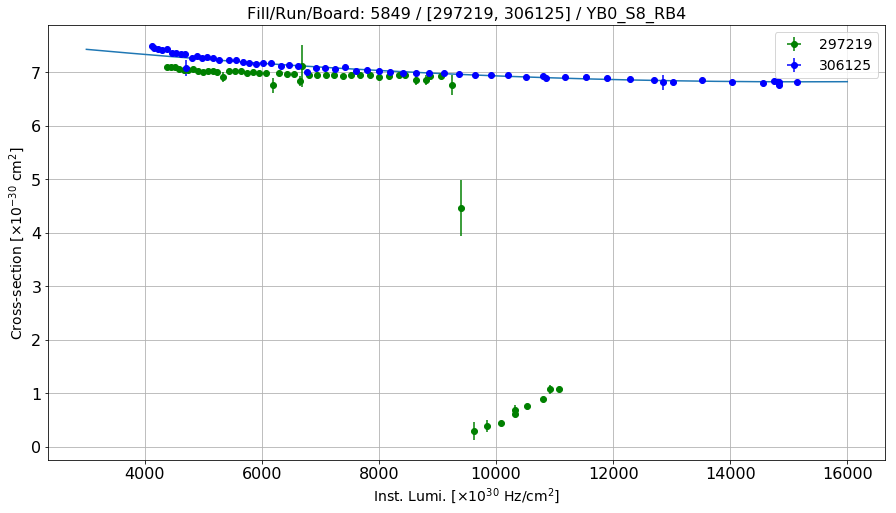

Linear fit parameters: [   6.58070448 3544.57705073]


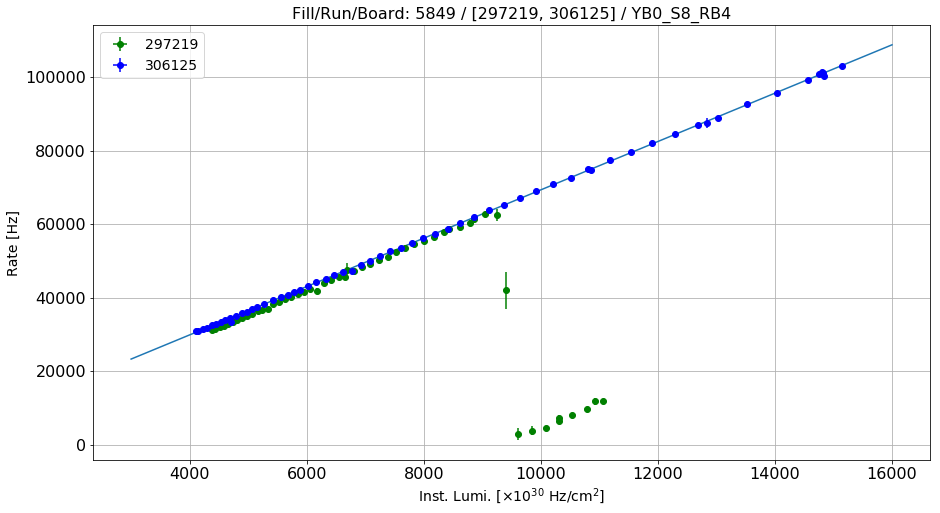

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S9_RB1
Linear fit for the reference run: [ 3.94318020e-09 -1.19580748e-04  6.54745996e+00]


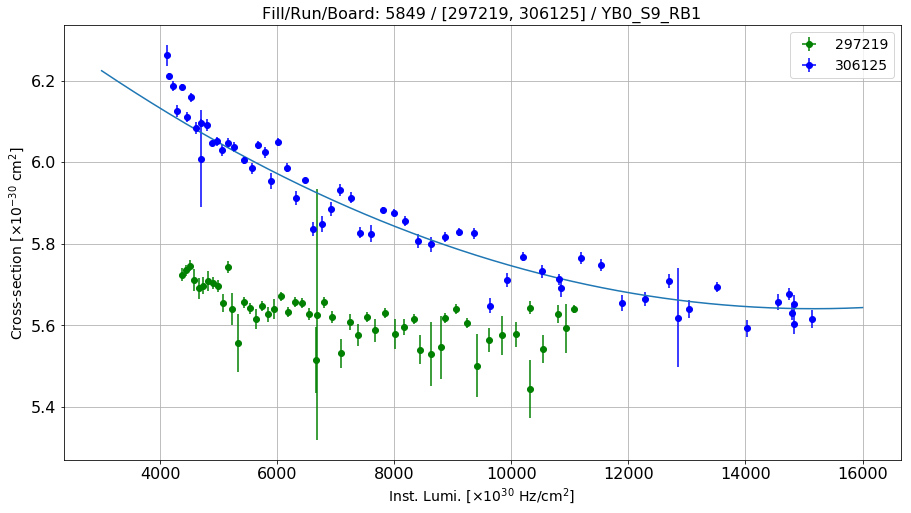

Linear fit parameters: [   5.40611231 3398.64618773]


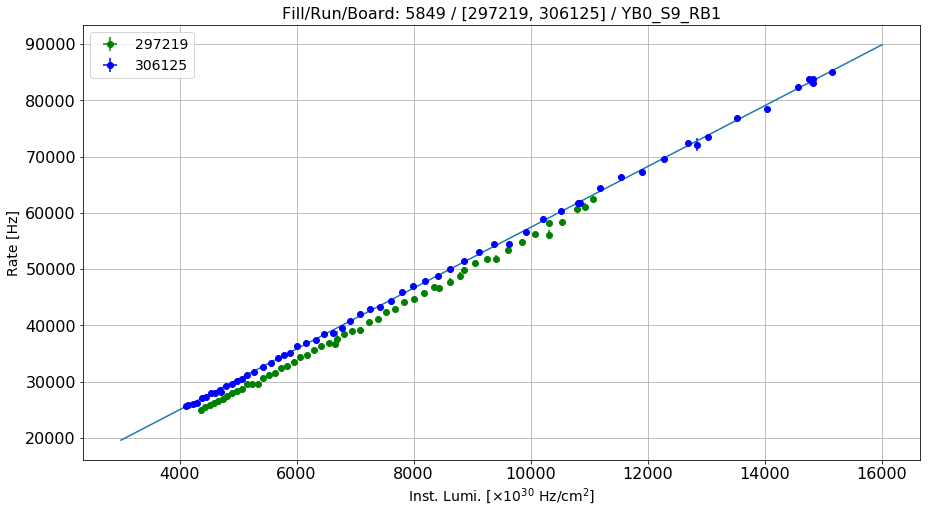

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S9_RB2
Linear fit for the reference run: [ 4.30474090e-07 -5.52810783e-03  2.13977475e+01]


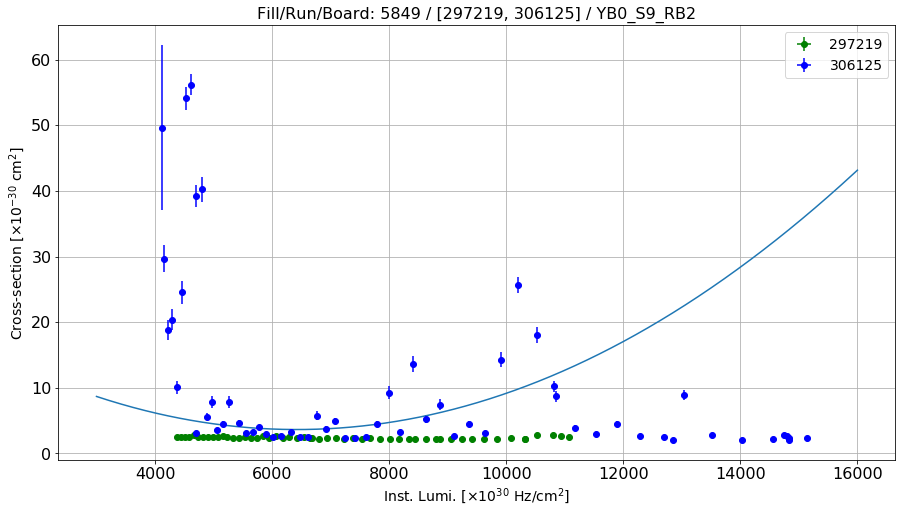

Linear fit parameters: [ 1.16589168e+01 -4.76727026e+04]


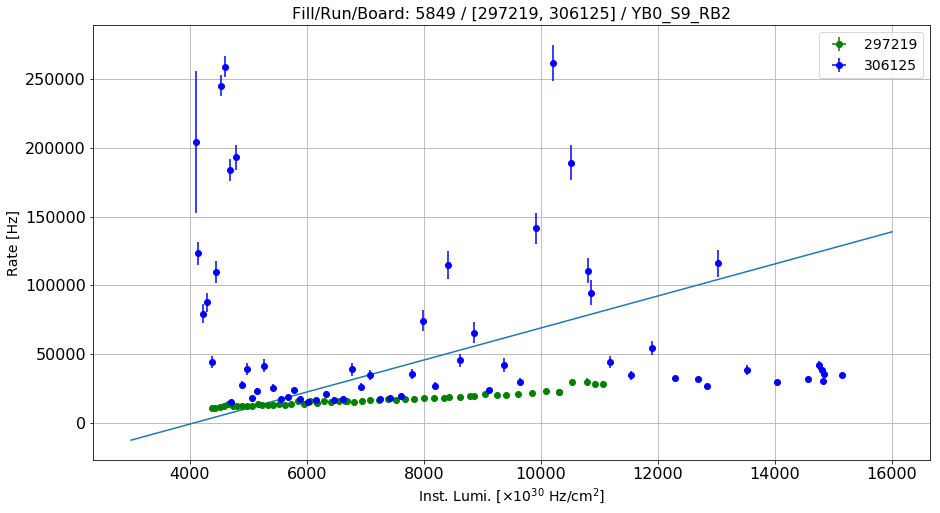

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S9_RB3
Linear fit for the reference run: [ 2.80985309e-09 -8.50144931e-05  1.16304255e+00]


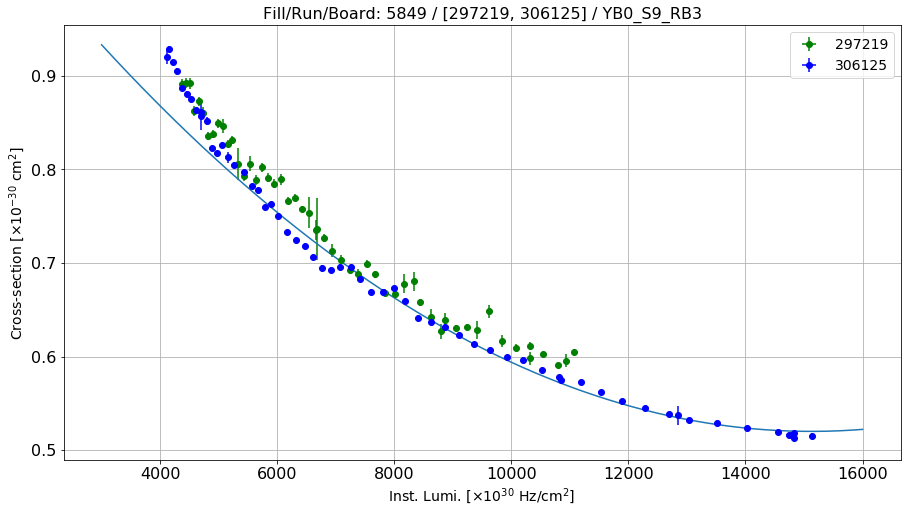

Linear fit parameters: [3.53640965e-01 2.40445368e+03]


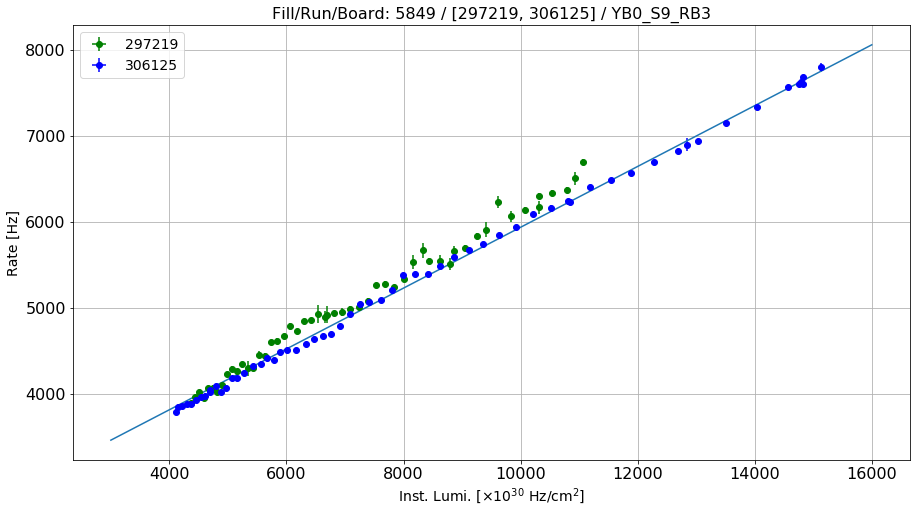

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S9_RB4
Linear fit for the reference run: [ 2.90444358e-09 -9.66489903e-05  1.42920196e+00]


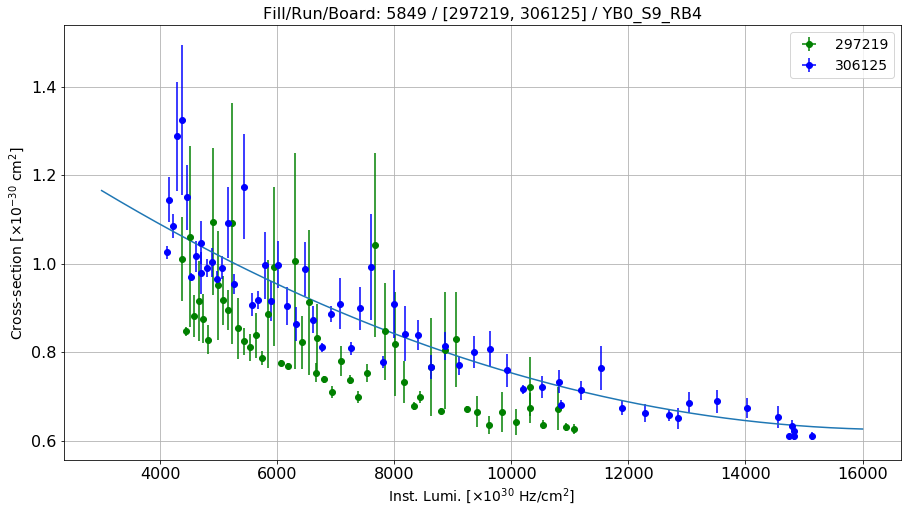

Linear fit parameters: [4.18619432e-01 3.25894172e+03]


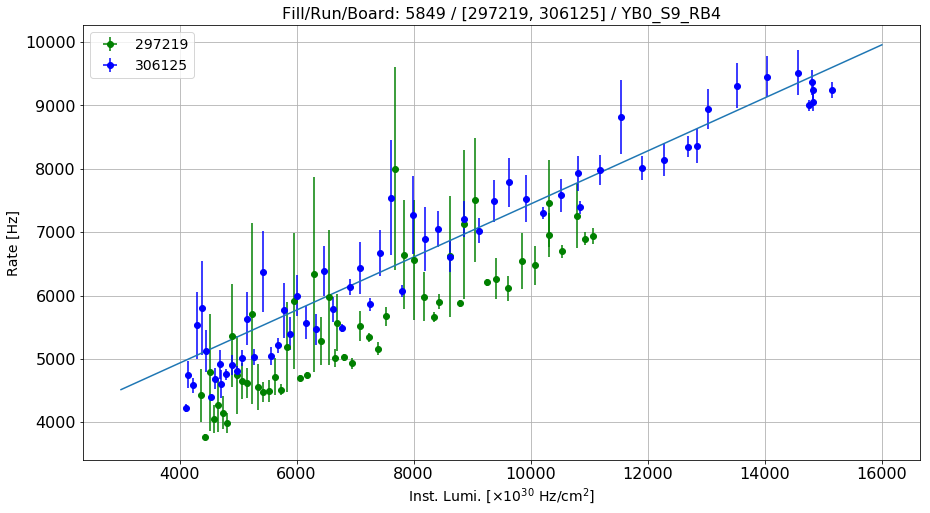

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S10_RB1
Linear fit for the reference run: [ 2.44401048e-09 -7.19940188e-05  5.73134625e+00]


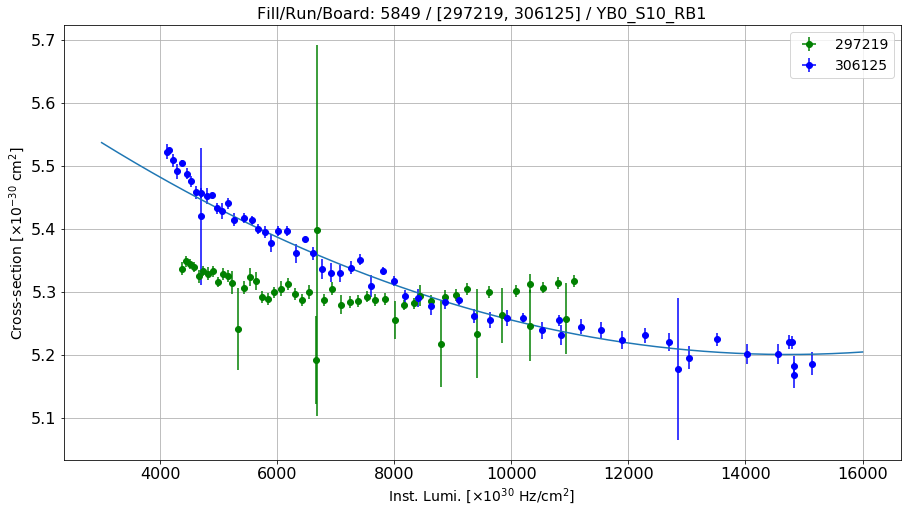

Linear fit parameters: [   5.06602281 1919.30713981]


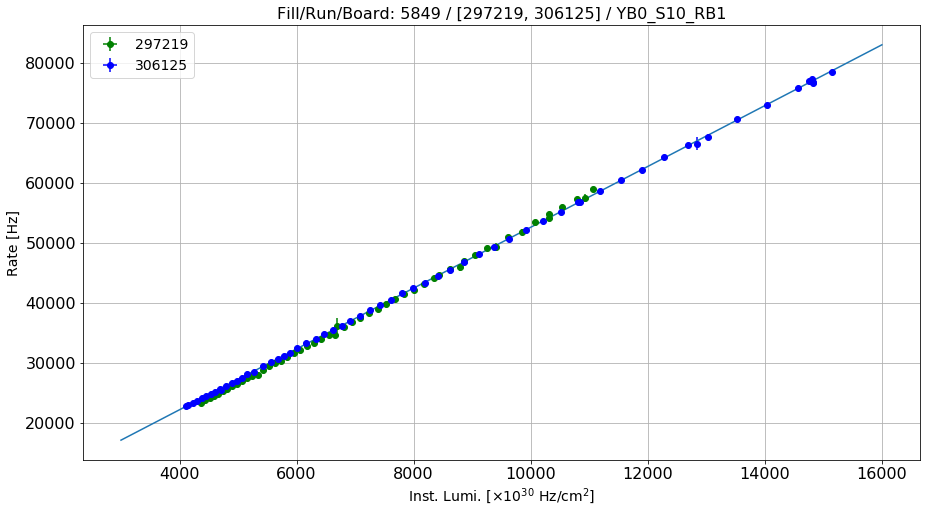

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S10_RB2
Linear fit for the reference run: [ 4.03535584e-09 -1.18187495e-04  2.76380222e+00]


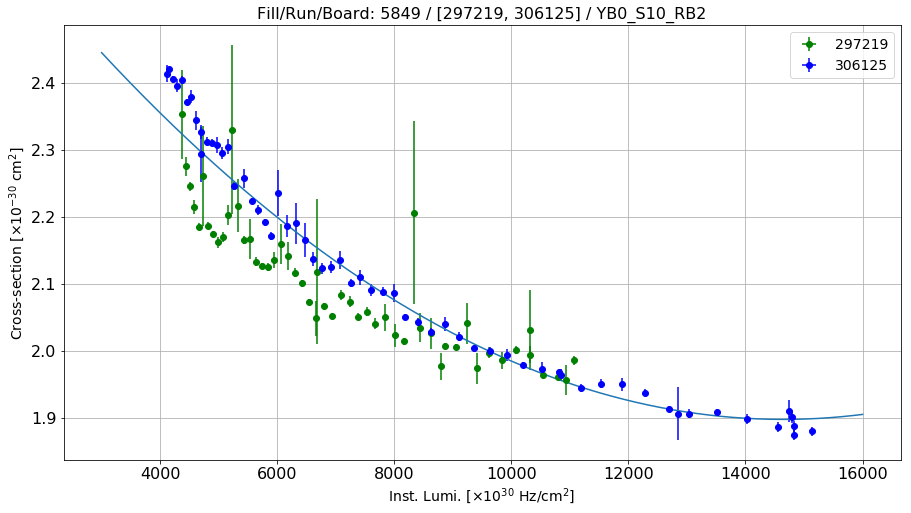

Linear fit parameters: [1.67882091e+00 3.10875513e+03]


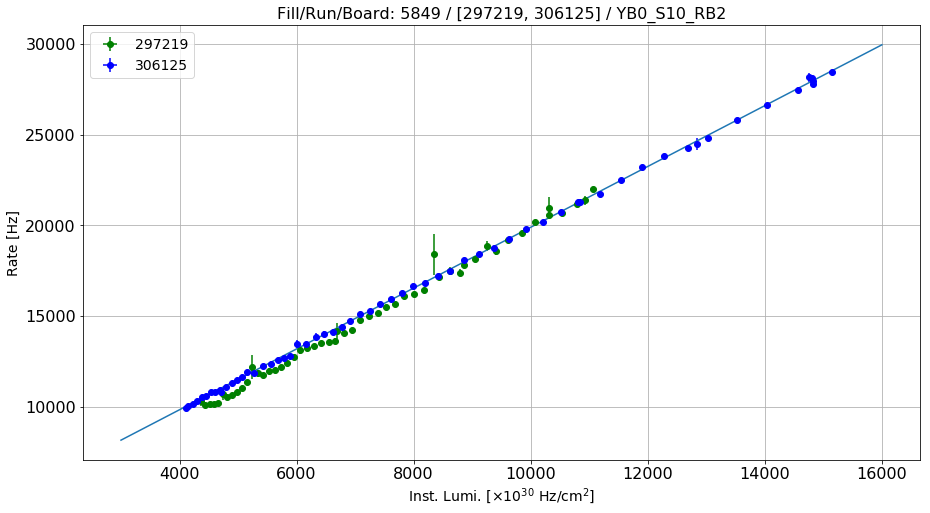

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S10_RB3
Linear fit for the reference run: [ 3.87002552e-09 -1.13048386e-04  1.31807992e+00]


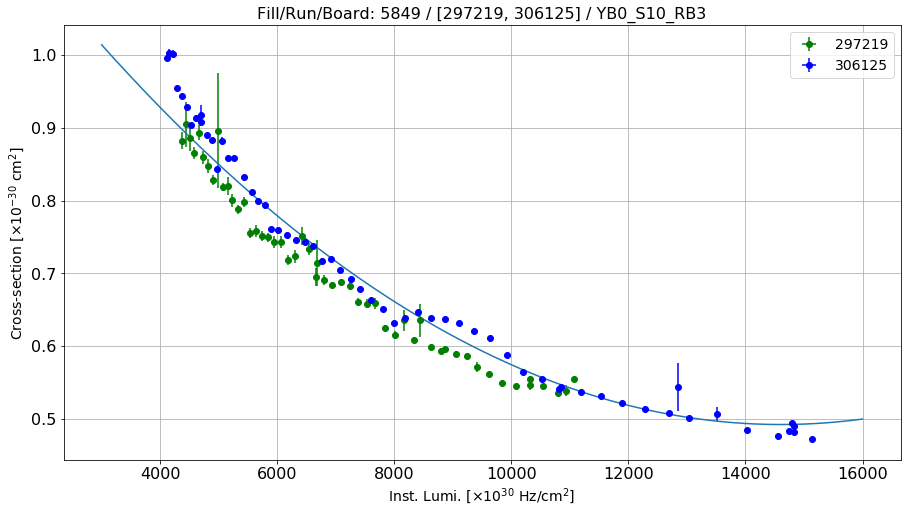

Linear fit parameters: [2.83437697e-01 2.95520678e+03]


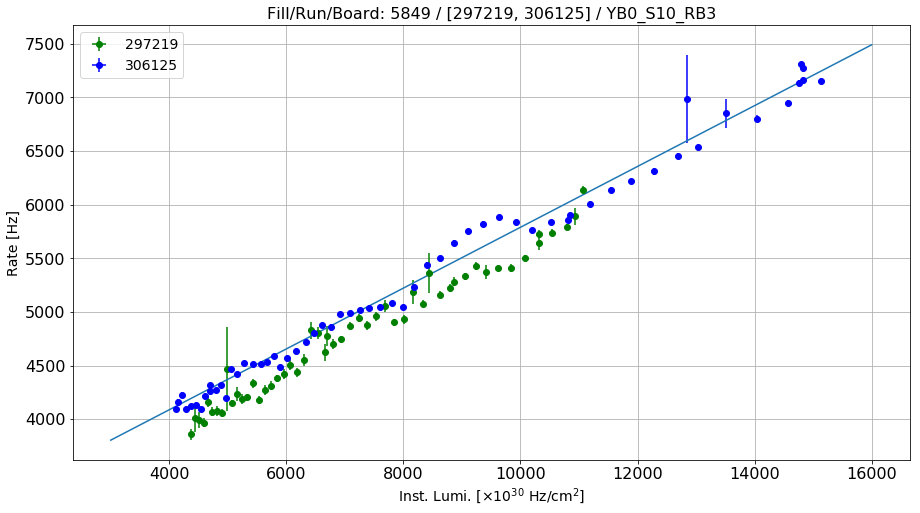

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S10_RB4
Linear fit for the reference run: [ 2.83170902e-09 -8.78012293e-05  1.67225300e+00]


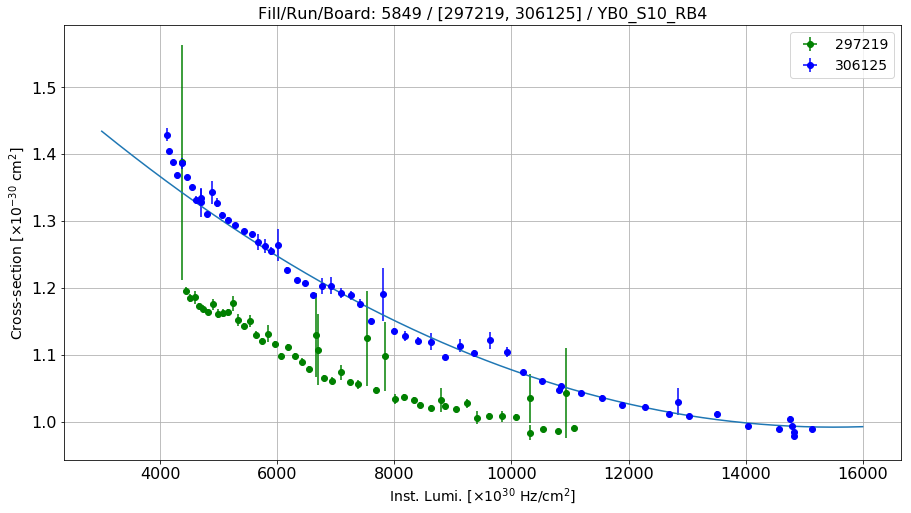

Linear fit parameters: [8.14414156e-01 2.61057474e+03]


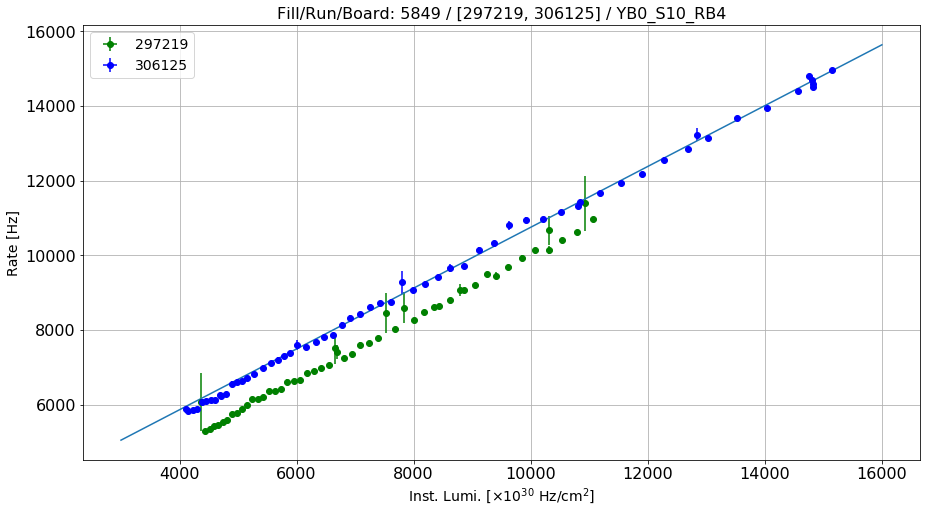

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S11_RB1
Linear fit for the reference run: [ 1.38032730e-08 -3.79035689e-04  8.44295287e+00]


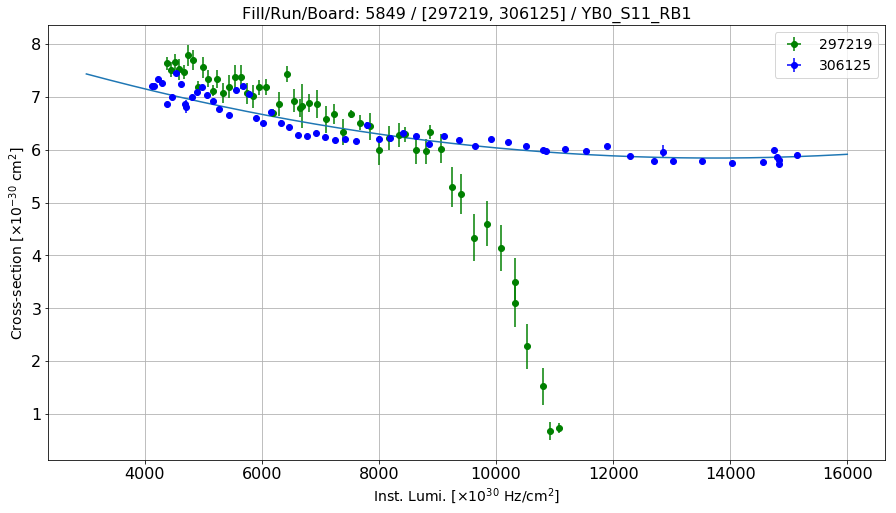

Linear fit parameters: [5.23200694e+00 8.40863672e+03]


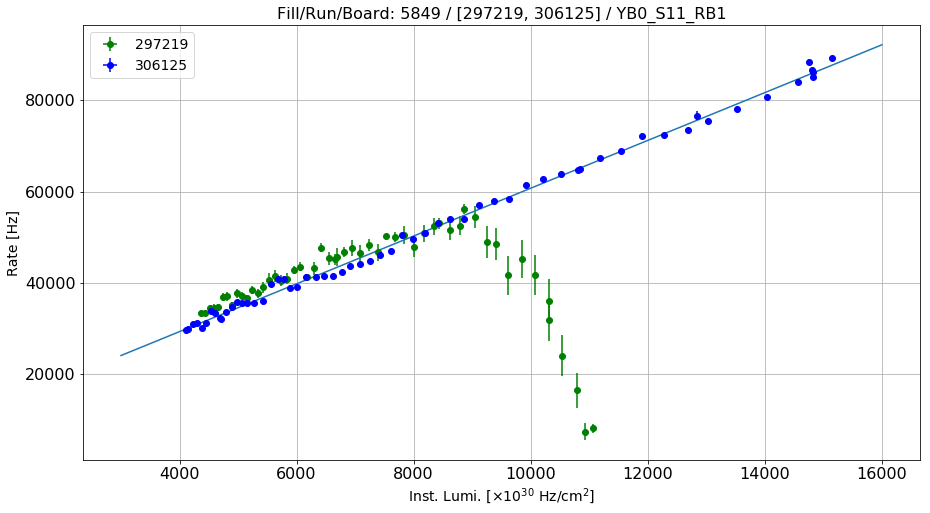

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S11_RB2
Linear fit for the reference run: [ 9.72803347e-09 -2.78581241e-04  4.20233294e+00]


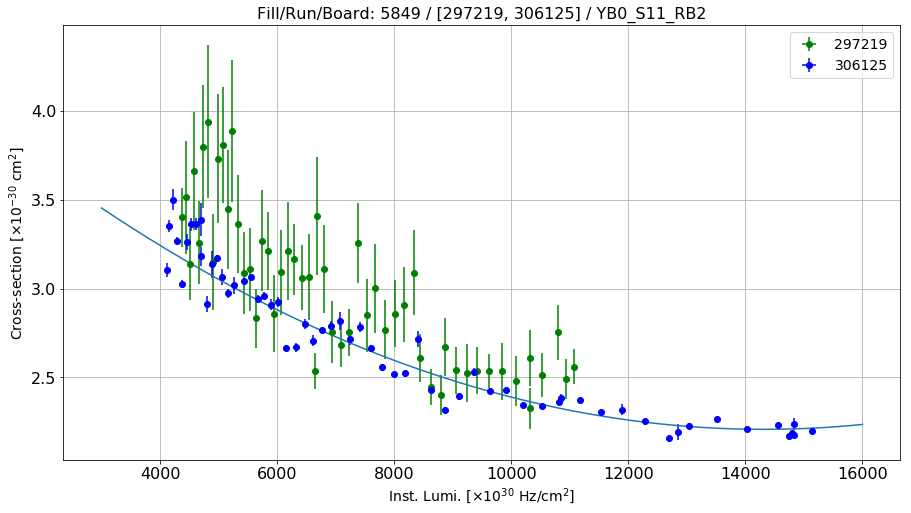

Linear fit parameters: [1.71233981e+00 6.93581422e+03]


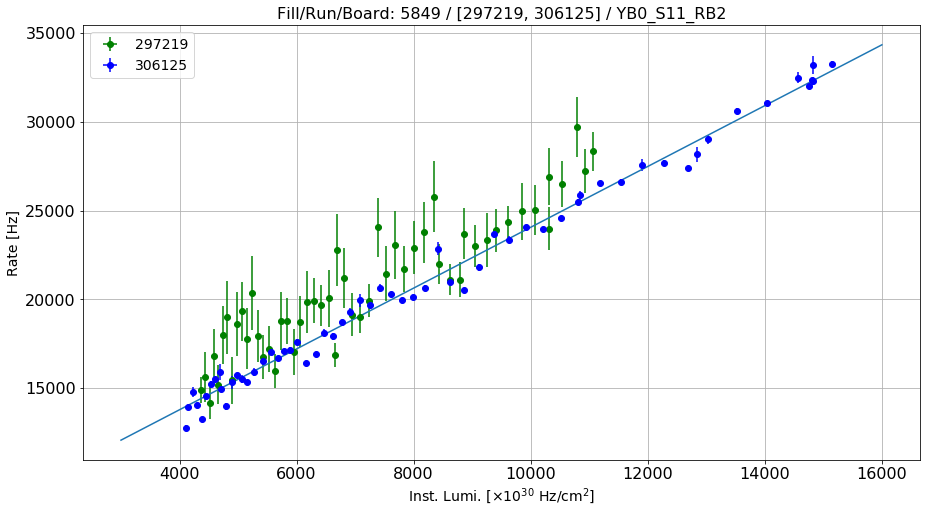

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S11_RB3
Linear fit for the reference run: [ 3.18462668e-09 -9.72837831e-05  1.21685092e+00]


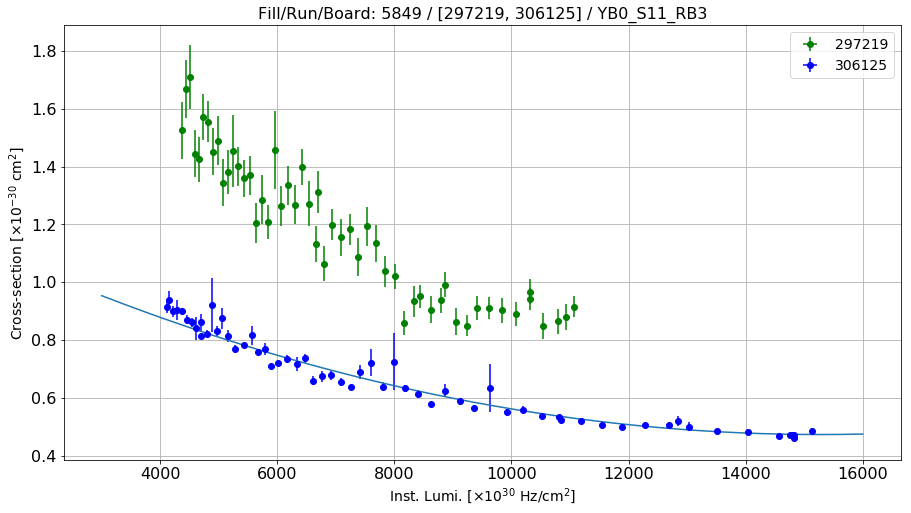

Linear fit parameters: [2.81049736e-01 2.80717823e+03]


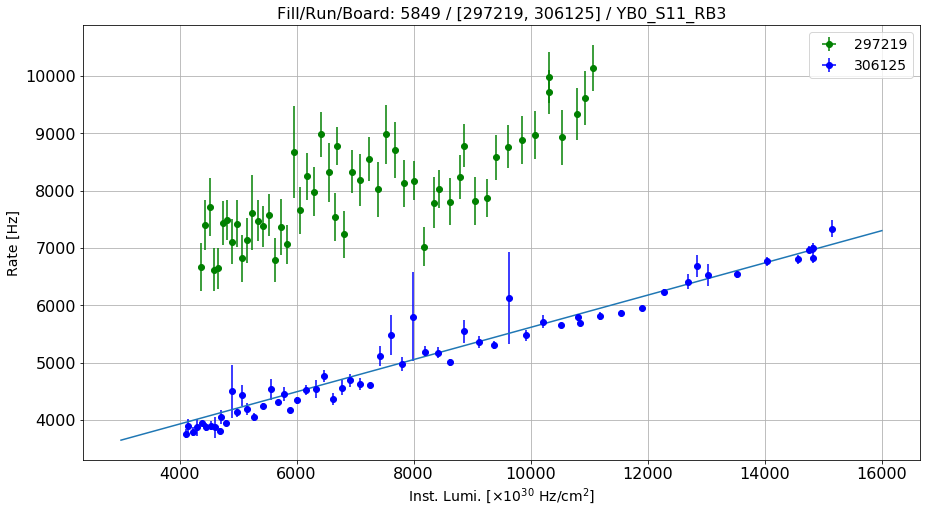

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S11_RB4
Linear fit for the reference run: [ 7.51669340e-09 -2.20465574e-04  2.37857793e+00]


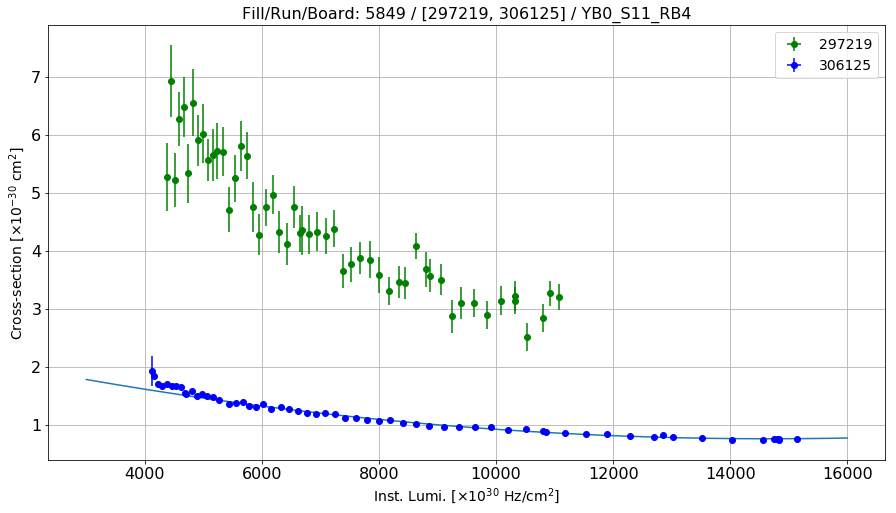

Linear fit parameters: [3.51294944e-01 5.81862915e+03]


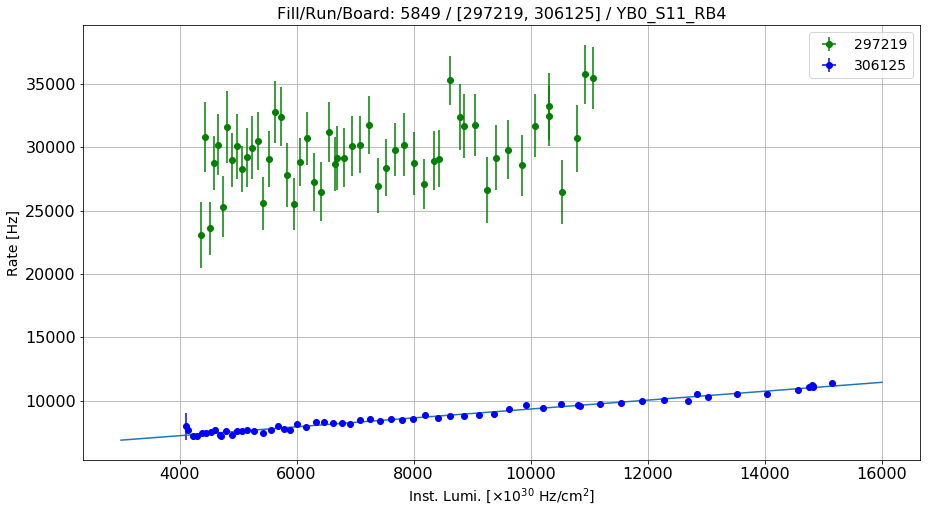

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S12_RB1
Linear fit for the reference run: [ 3.19922453e-09 -1.13409393e-04  6.21679611e+00]


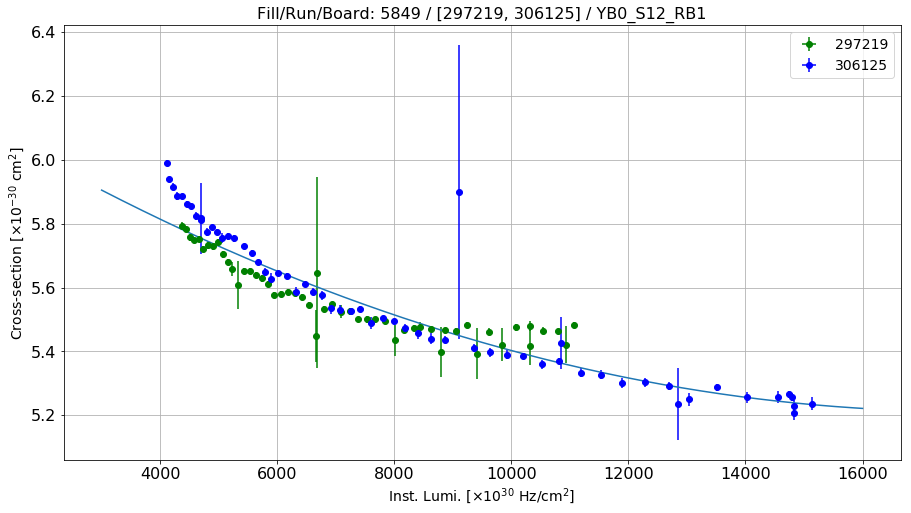

Linear fit parameters: [   4.96582553 4202.64144336]


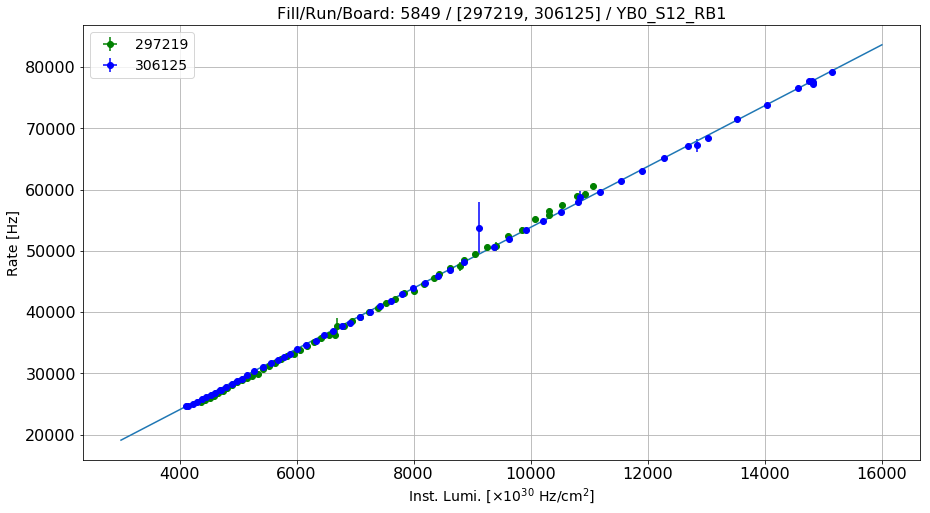

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S12_RB2
Linear fit for the reference run: [ 7.71318074e-09 -2.89232783e-04  5.10982020e+00]


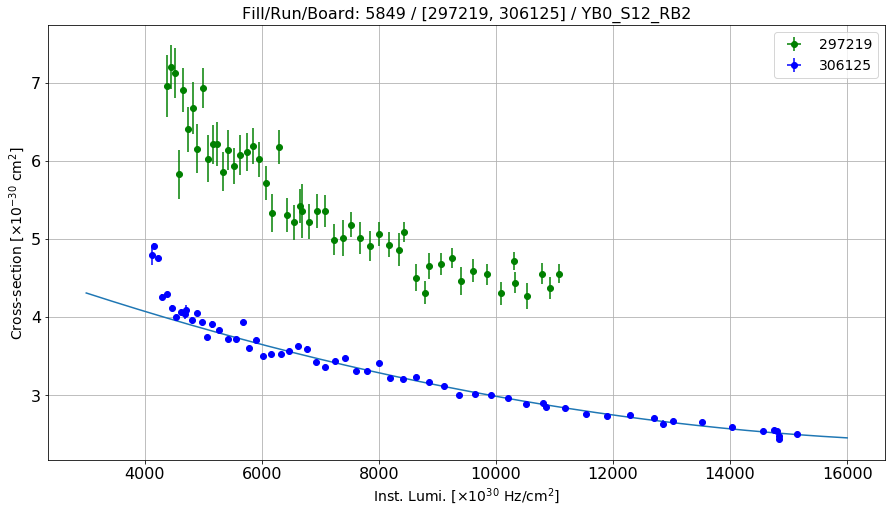

Linear fit parameters: [1.78036373e+00 1.15262864e+04]


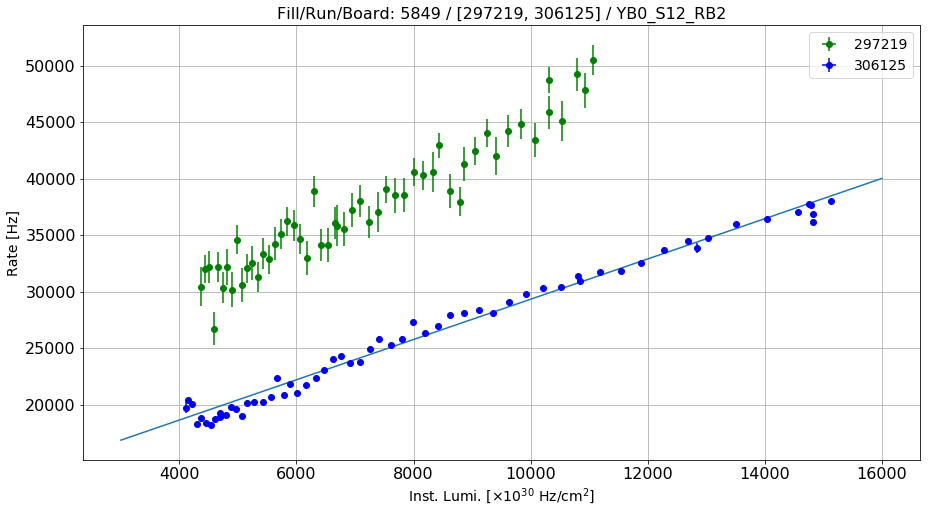

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S12_RB3
Linear fit for the reference run: [ 1.80104523e-08 -5.87559316e-04  6.54772275e+00]


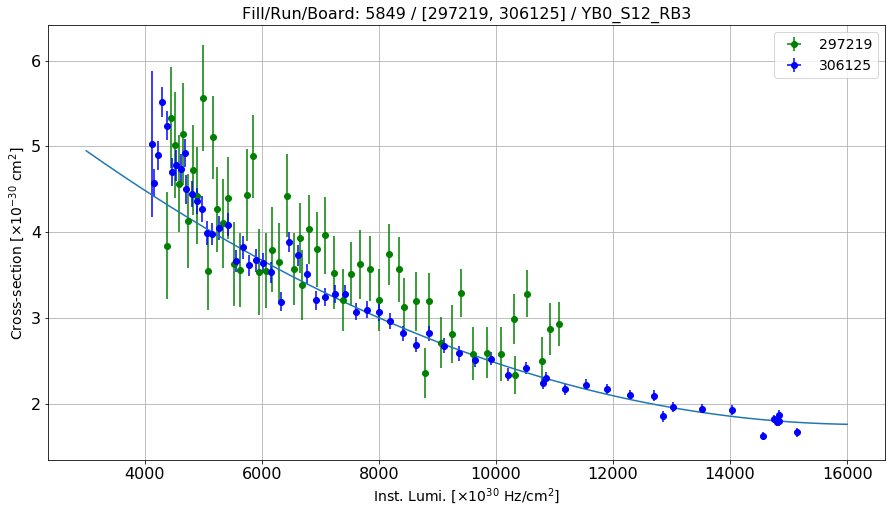

Linear fit parameters: [5.14285765e-01 1.91716390e+04]


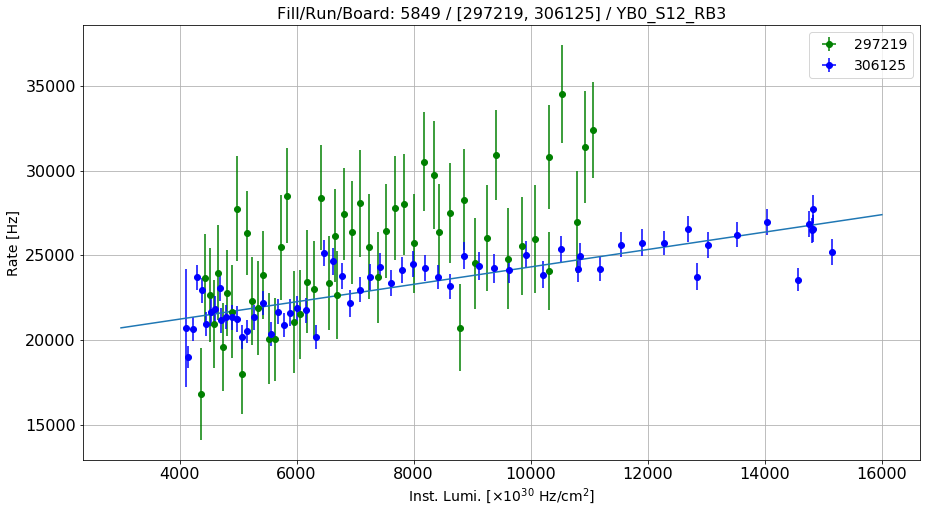

Fill/Run/Board: 5849 / [297219, 306125] / YB0_S12_RB4
Linear fit for the reference run: [ 3.36552455e-09 -1.09147957e-04  6.90004565e+00]


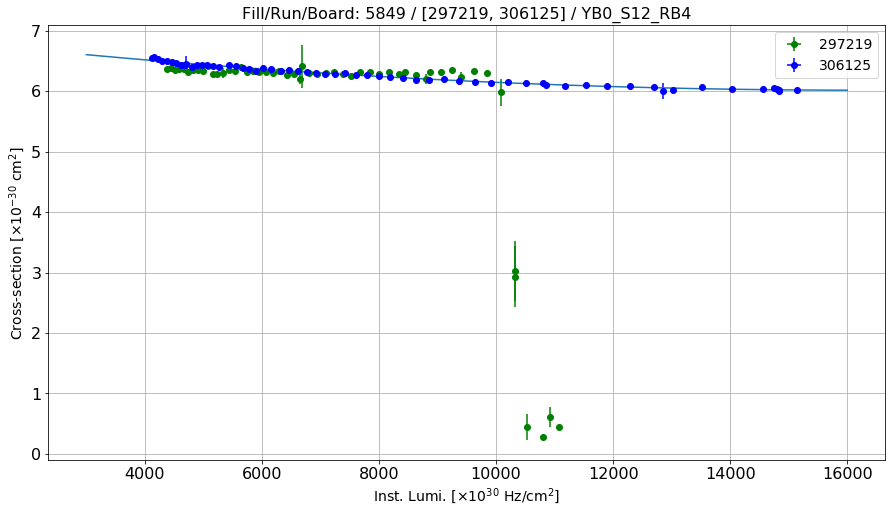

Linear fit parameters: [   5.78542231 3525.51537202]


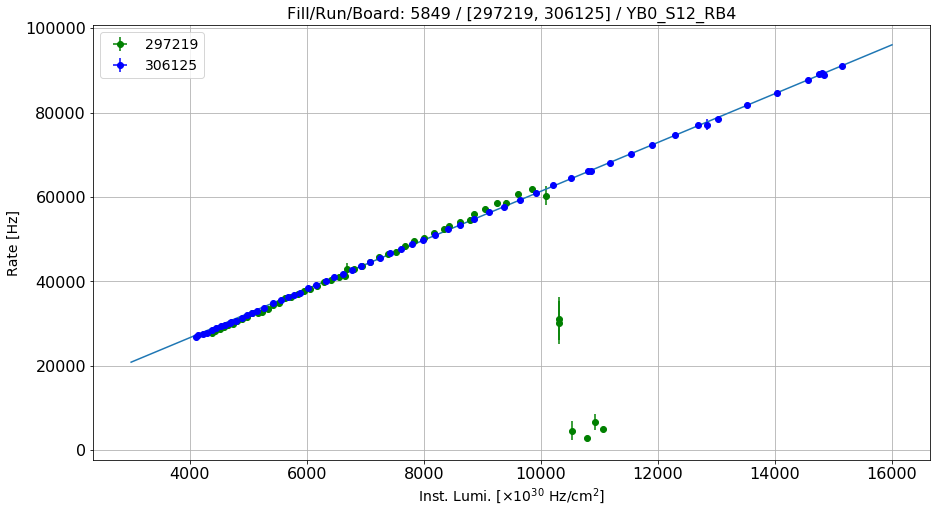

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S1_RB1
Linear fit for the reference run: [ 4.85199634e-11 -1.98263847e-05  1.25889895e+01]


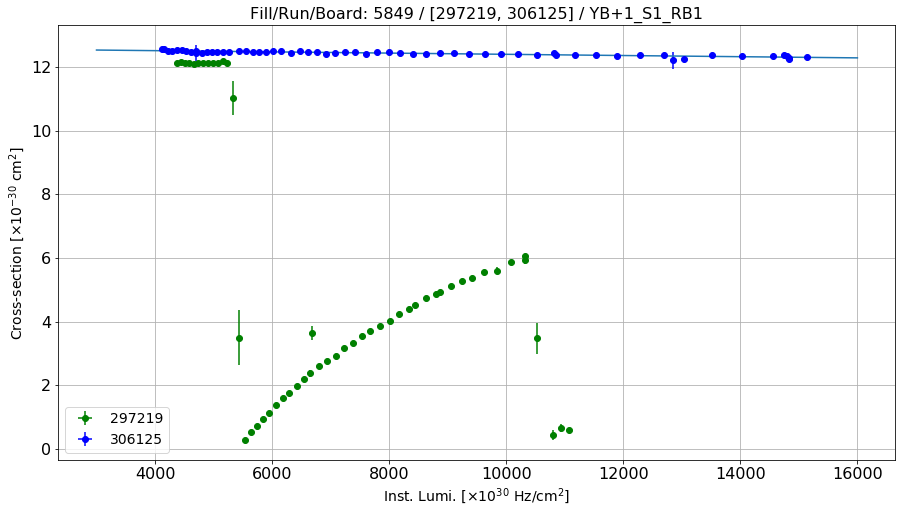

Linear fit parameters: [  12.2110228  1660.31606287]


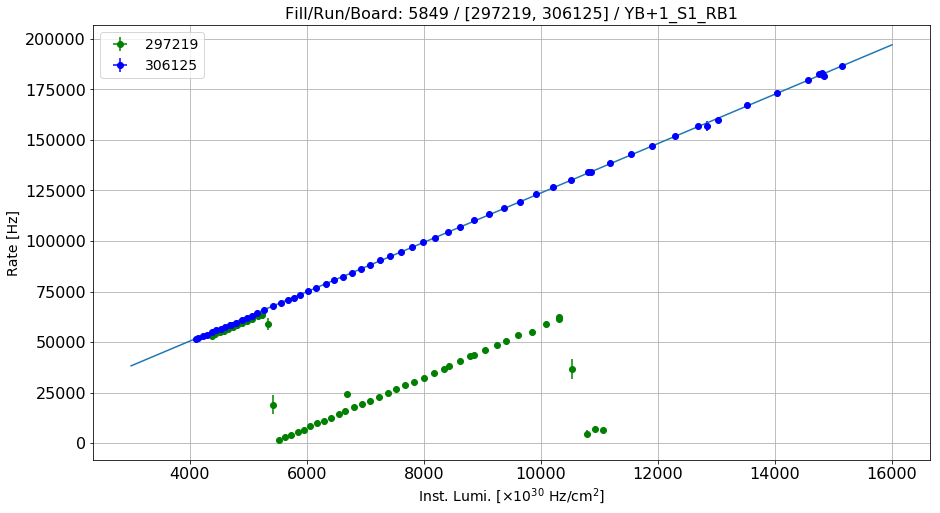

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S1_RB2
Linear fit for the reference run: [ 1.62133581e-09 -8.05570201e-05  5.41207534e+00]


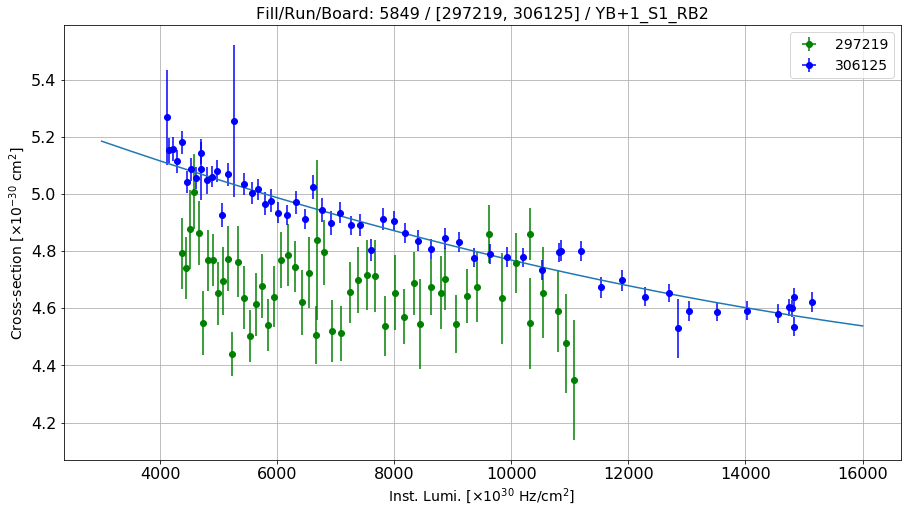

Linear fit parameters: [   4.32044559 4165.19378165]


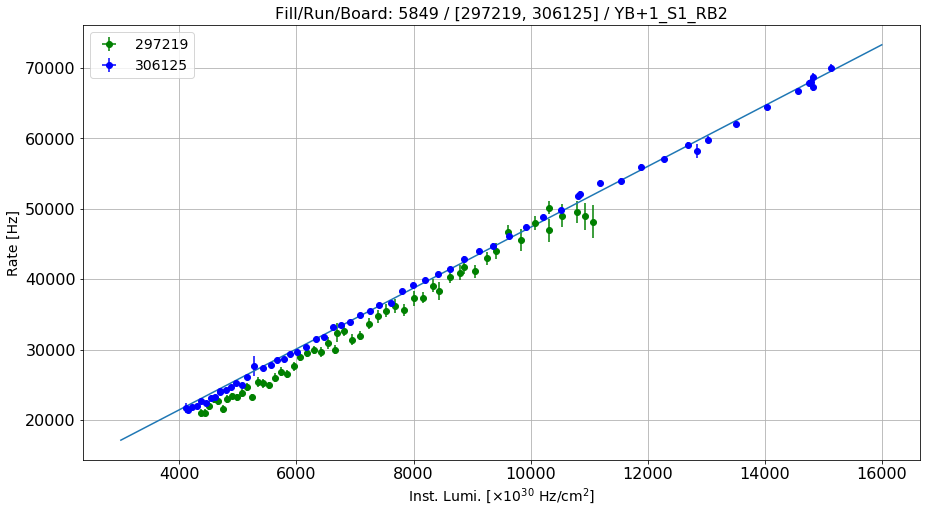

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S1_RB3
Linear fit for the reference run: [ 1.24189528e-07 -3.66142559e-03  3.45007325e+01]


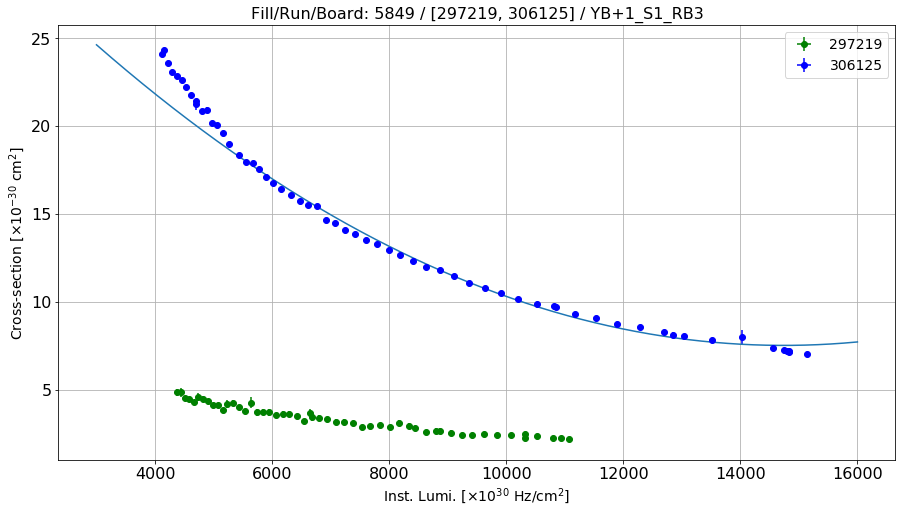

Linear fit parameters: [6.30965981e-01 9.78036838e+04]


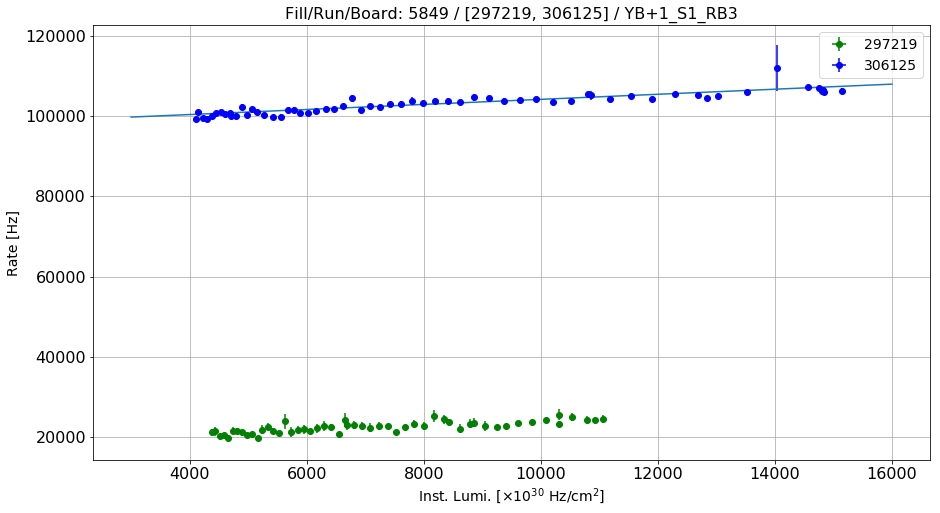

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S1_RB4
Linear fit for the reference run: [ 1.05081624e-08 -3.29154267e-04  2.11465405e+01]


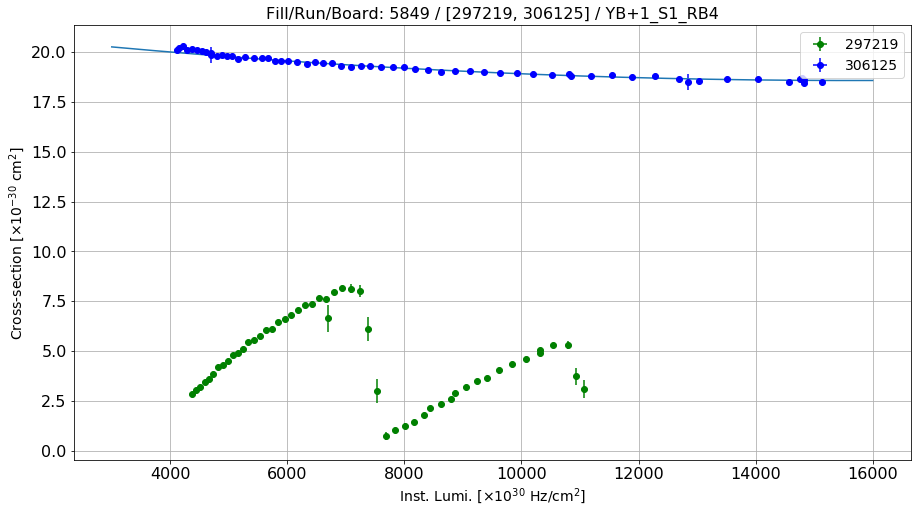

Linear fit parameters: [  17.8971011  9981.49815966]


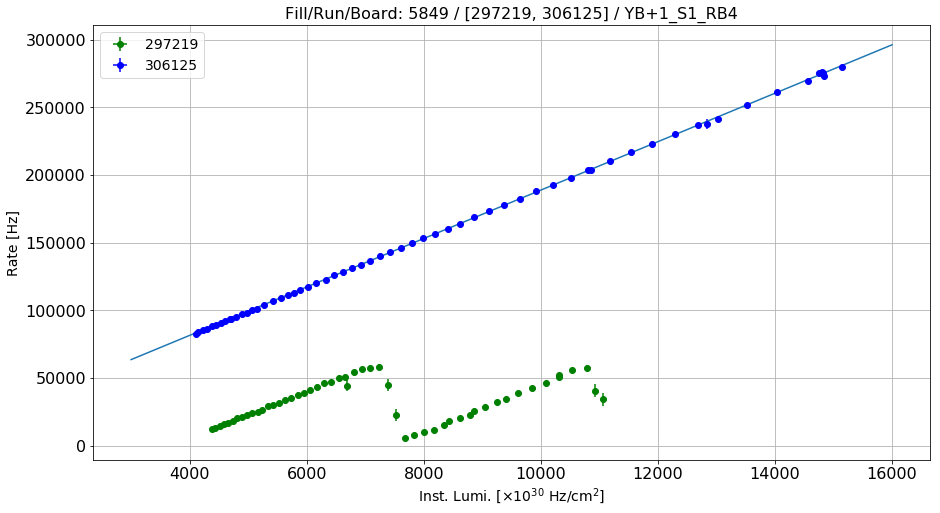

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S2_RB1
Linear fit for the reference run: [ 8.24366545e-09 -2.68683226e-04  1.91083649e+01]


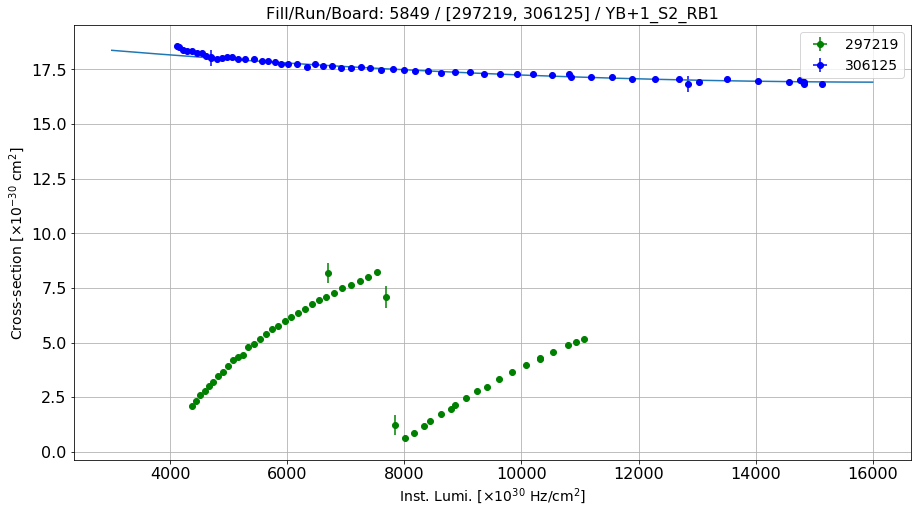

Linear fit parameters: [  16.35175997 8752.95091774]


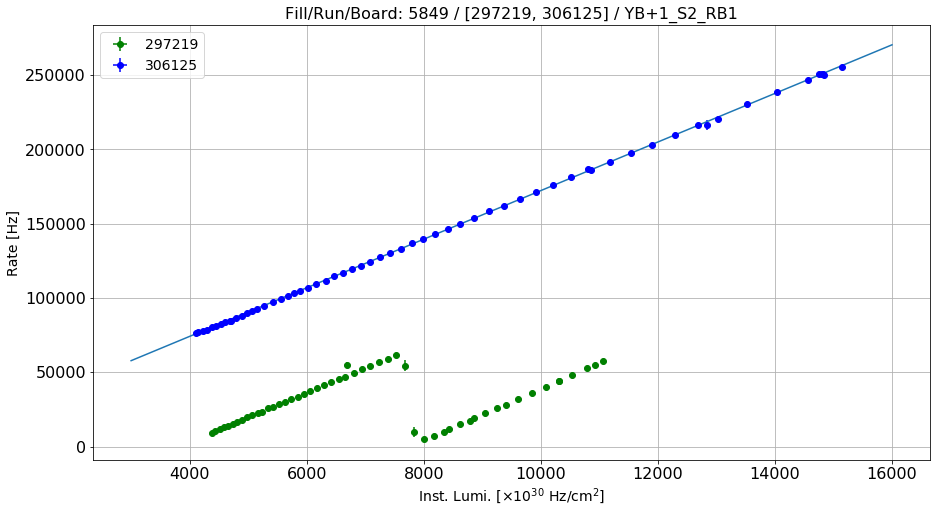

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S2_RB2
Linear fit for the reference run: [ 7.38108224e-09 -2.29504225e-04  5.79225473e+00]


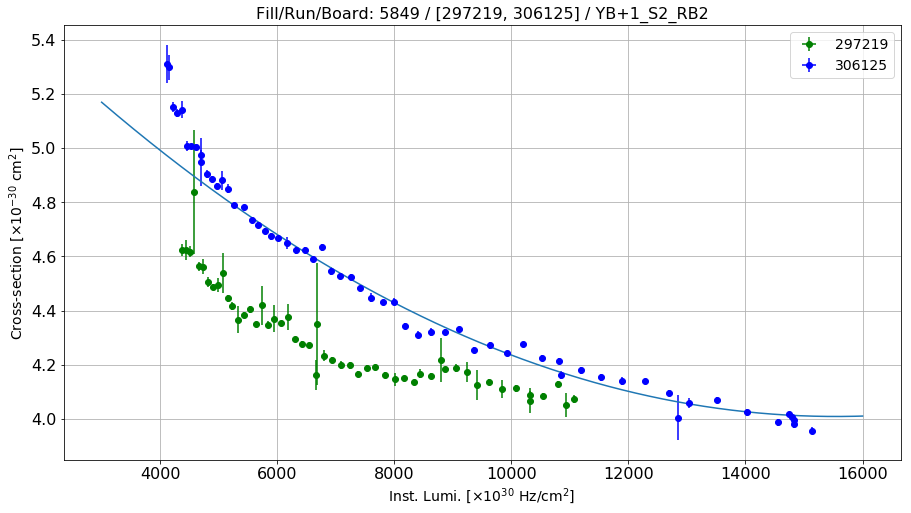

Linear fit parameters: [3.54347646e+00 6.86138516e+03]


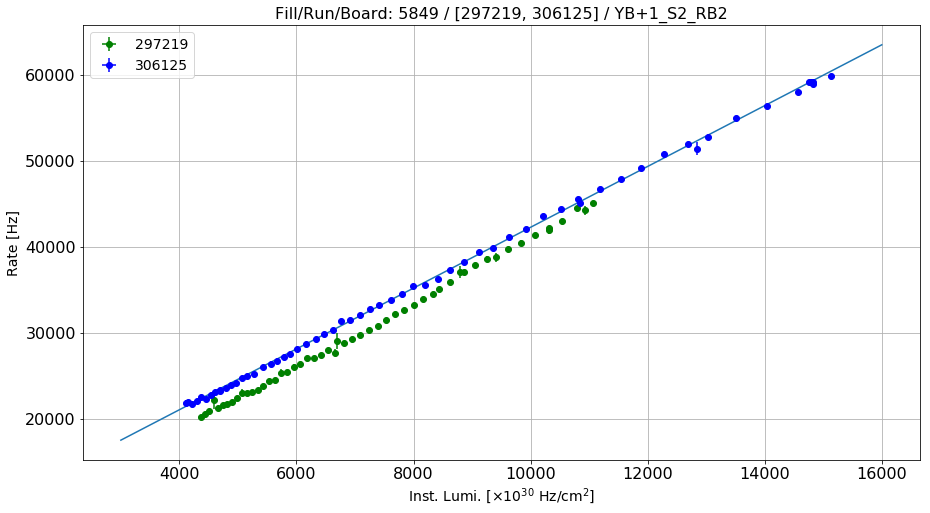

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S2_RB3
Linear fit for the reference run: [ 1.22625551e-08 -3.42629448e-04  3.70739586e+00]


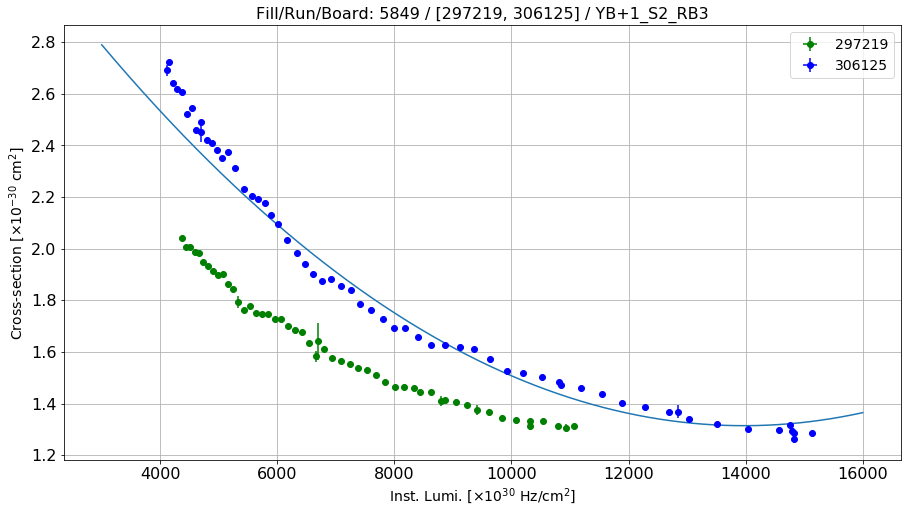

Linear fit parameters: [7.37843754e-01 7.99045790e+03]


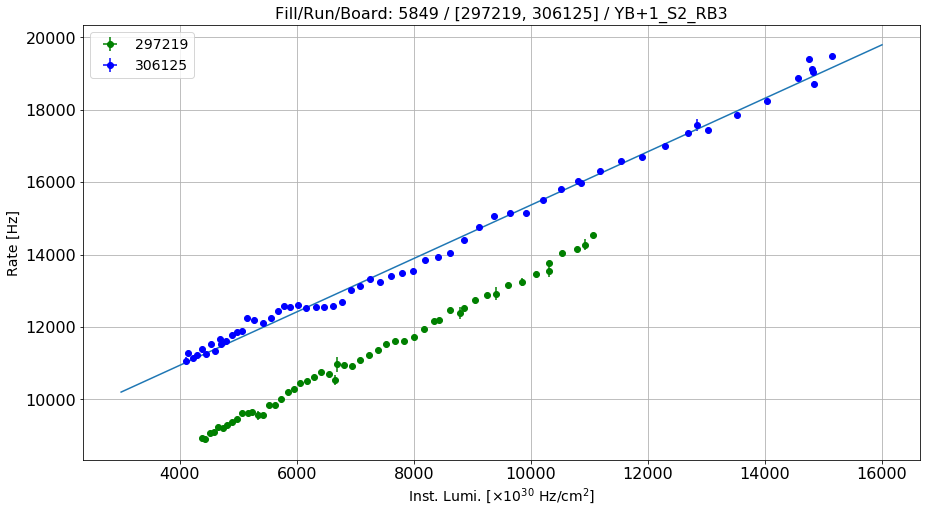

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S2_RB4
Linear fit for the reference run: [ 8.18873531e-09 -2.74786318e-04  2.73428818e+01]


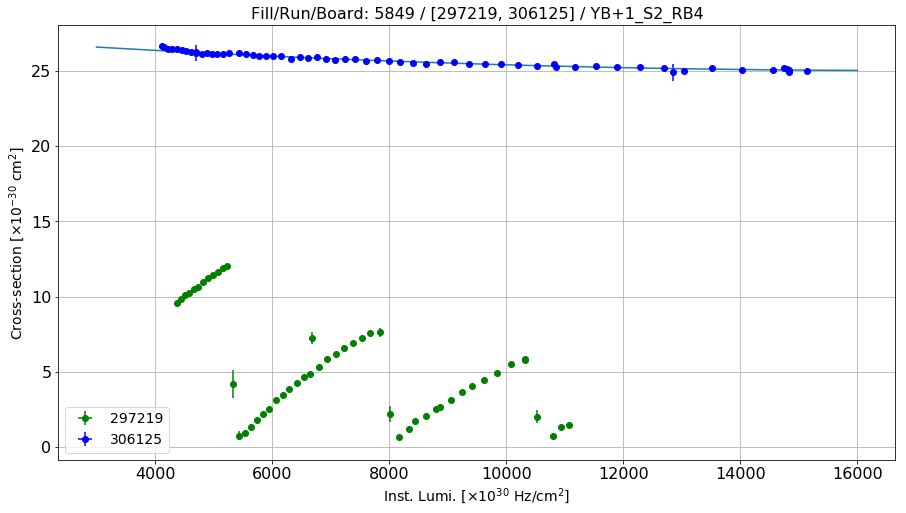

Linear fit parameters: [  24.44814287 9390.64912634]


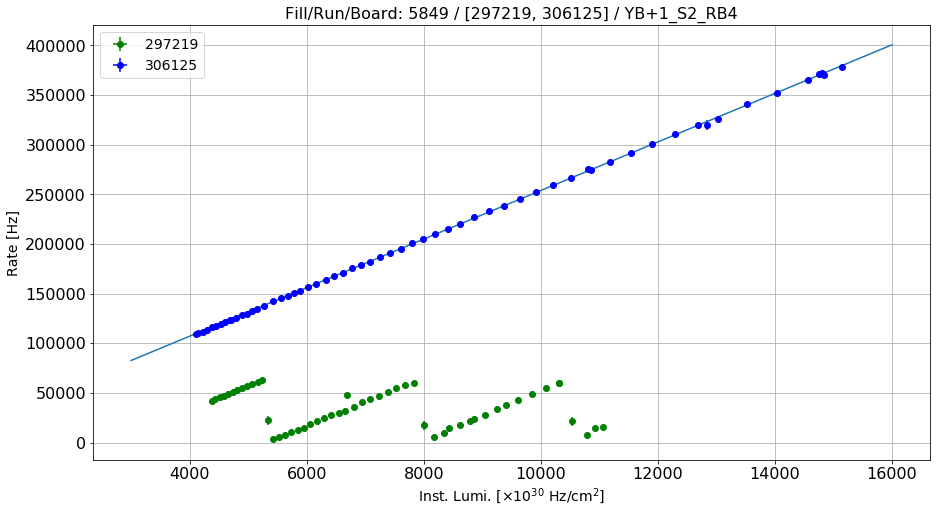

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S3_RB1
Linear fit for the reference run: [ 4.57212379e-09 -1.30773629e-04  1.45744321e+01]


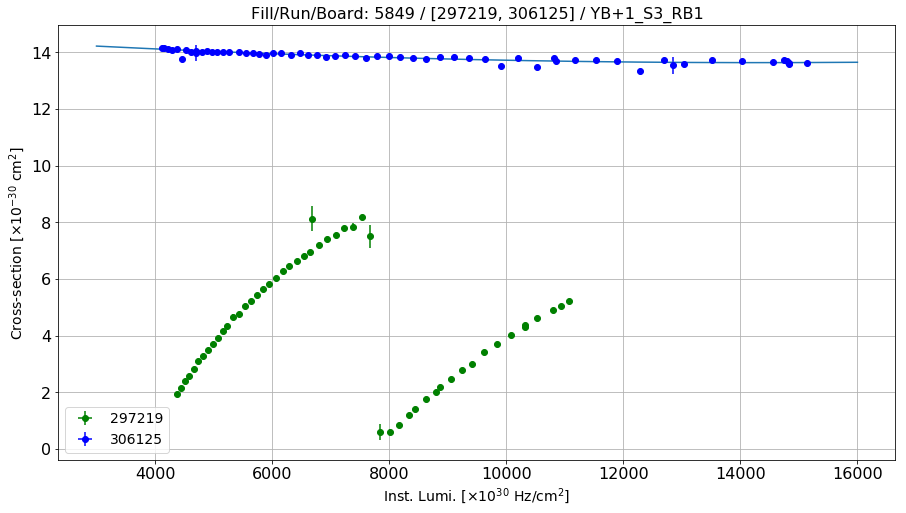

Linear fit parameters: [  13.4072826 3245.8576578]


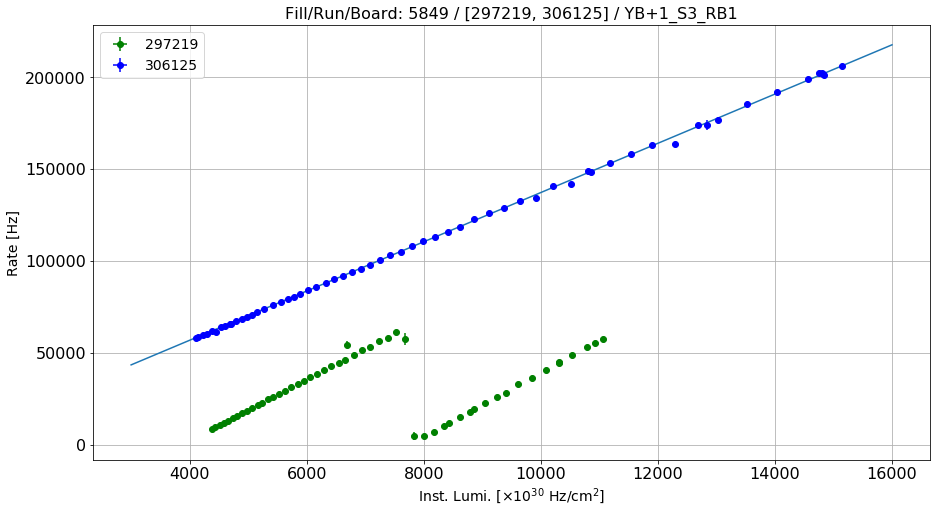

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S3_RB2
Linear fit for the reference run: [ 5.65251288e-09 -1.69366262e-04  5.18627142e+00]


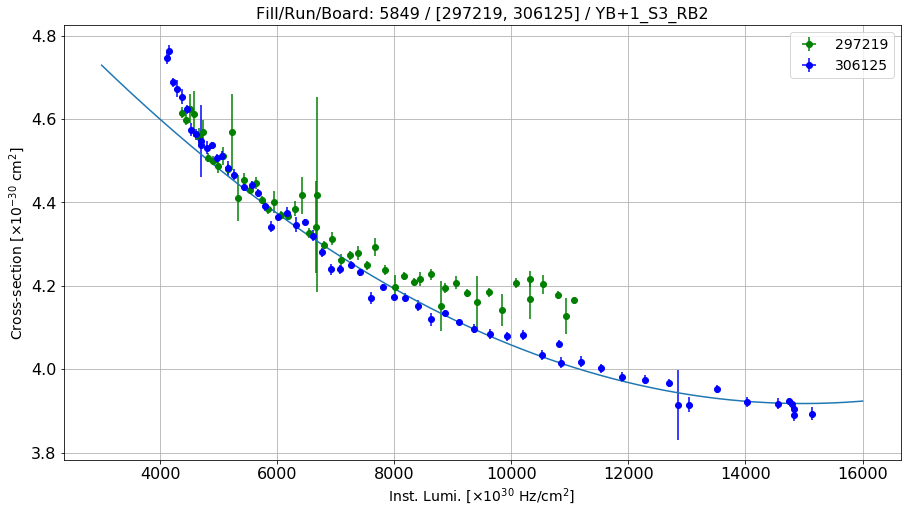

Linear fit parameters: [3.59083788e+00 4.69101887e+03]


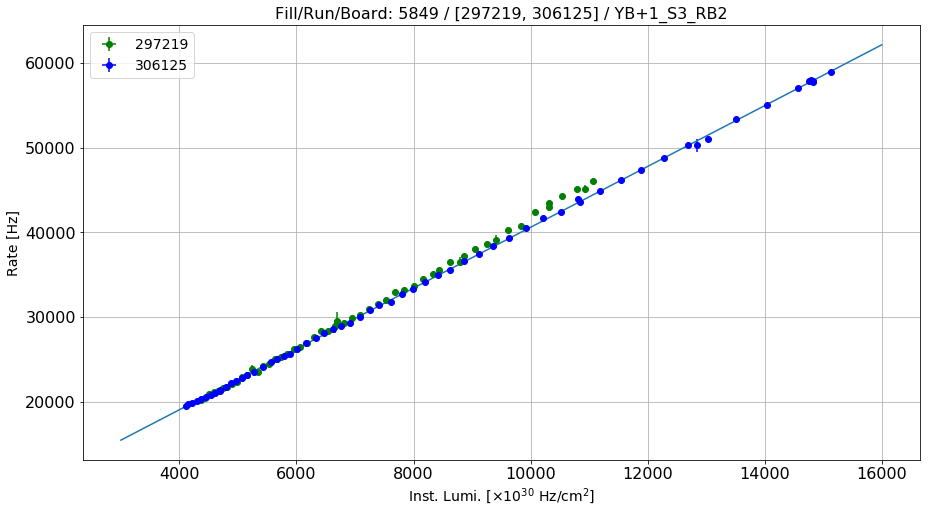

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S3_RB3
Linear fit for the reference run: [ 3.29996972e-09 -1.05083908e-04  2.09166543e+00]


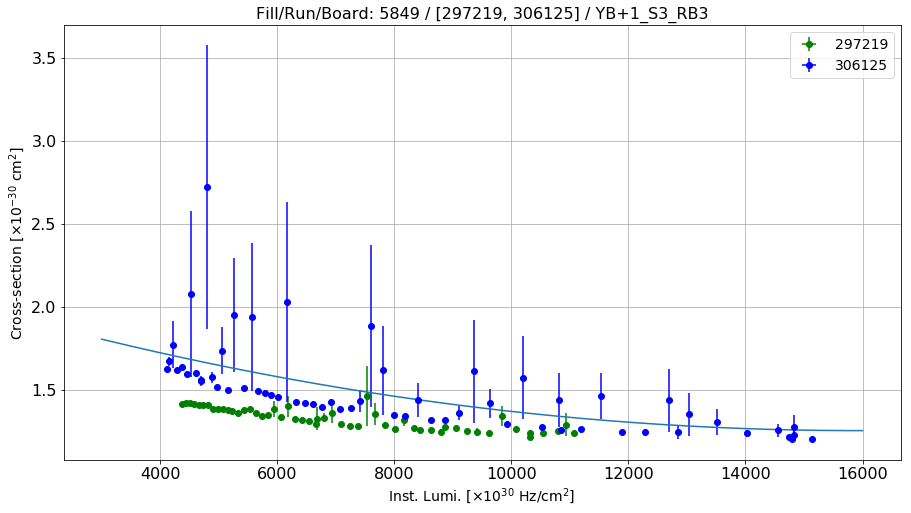

Linear fit parameters: [1.03717824e+00 3.28595363e+03]


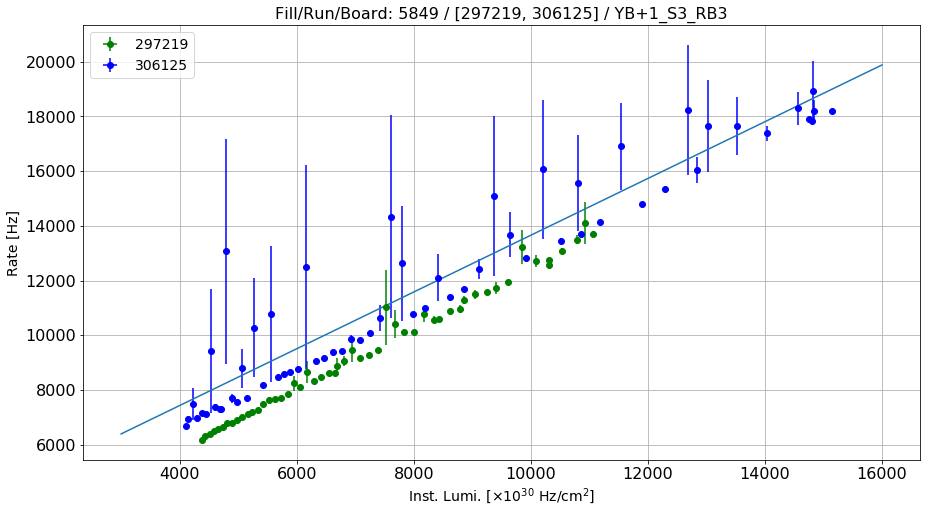

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S3_RB4
Linear fit for the reference run: [ 6.89959245e-09 -3.06018221e-04  4.59332035e+01]


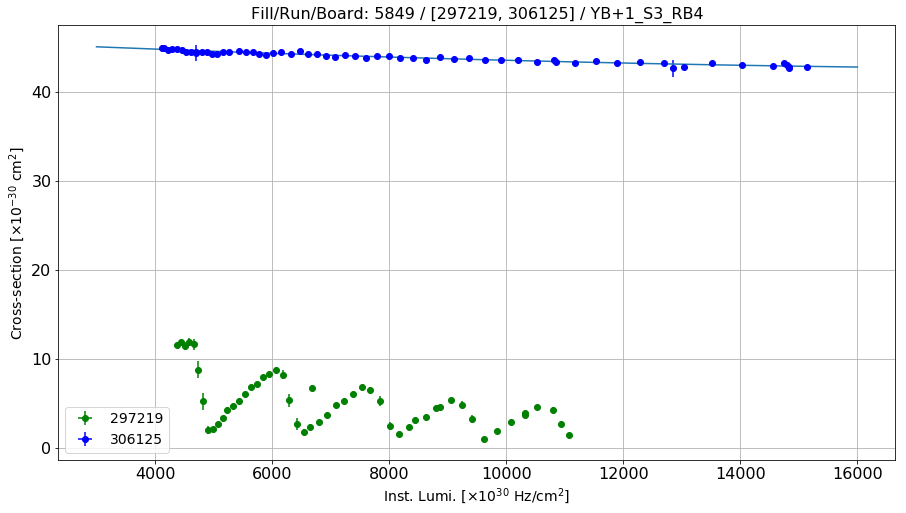

Linear fit parameters: [   42.01724839 14480.74147613]


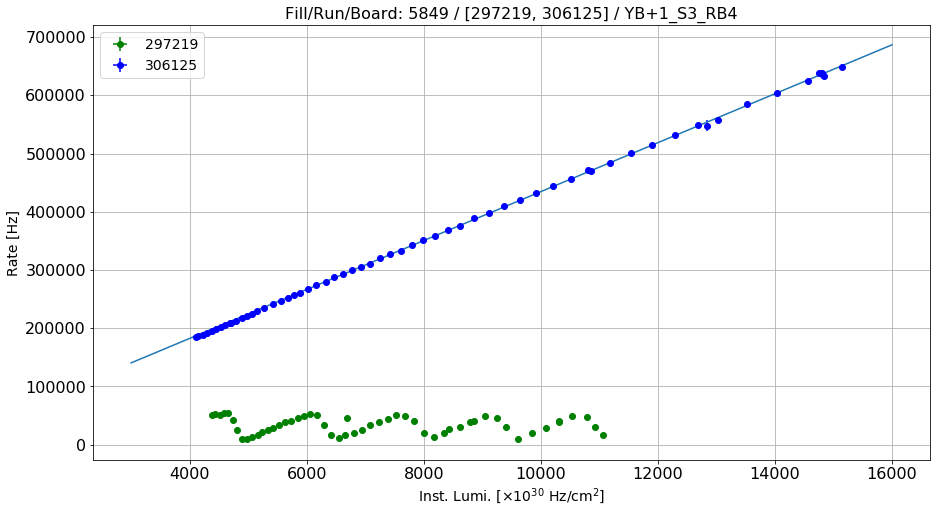

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S4_RB1
Linear fit for the reference run: [ 8.60758390e-10 -6.61600533e-05  1.60731424e+01]


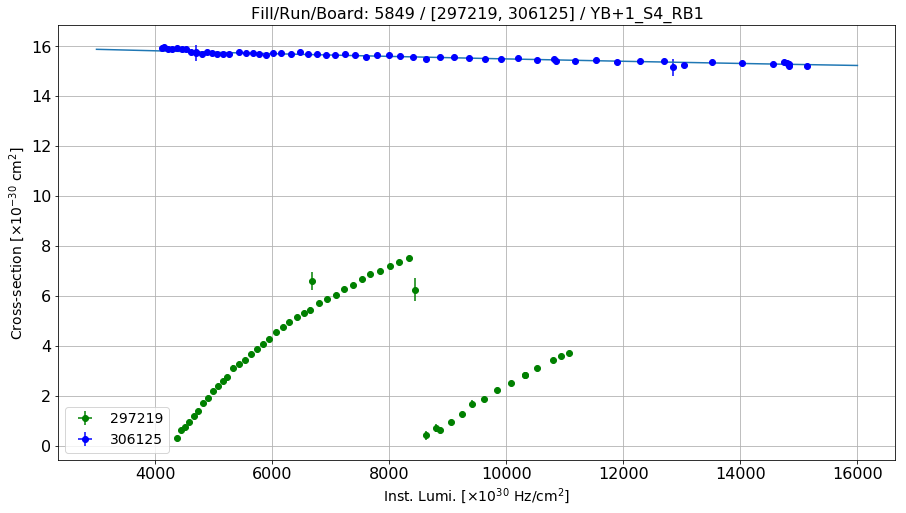

Linear fit parameters: [  15.02979528 4273.99601416]


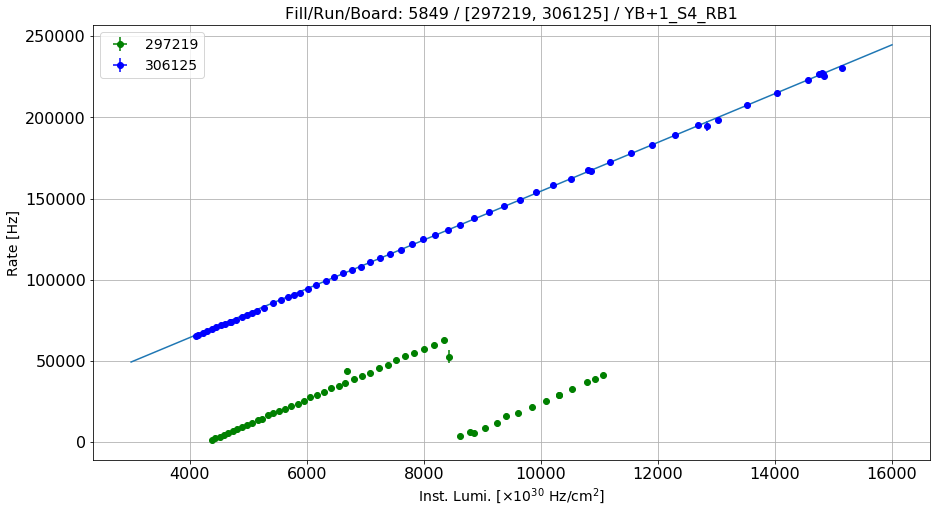

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S4_RB2
Linear fit for the reference run: [ 7.33433692e-07 -2.22773283e-02  2.20429304e+02]


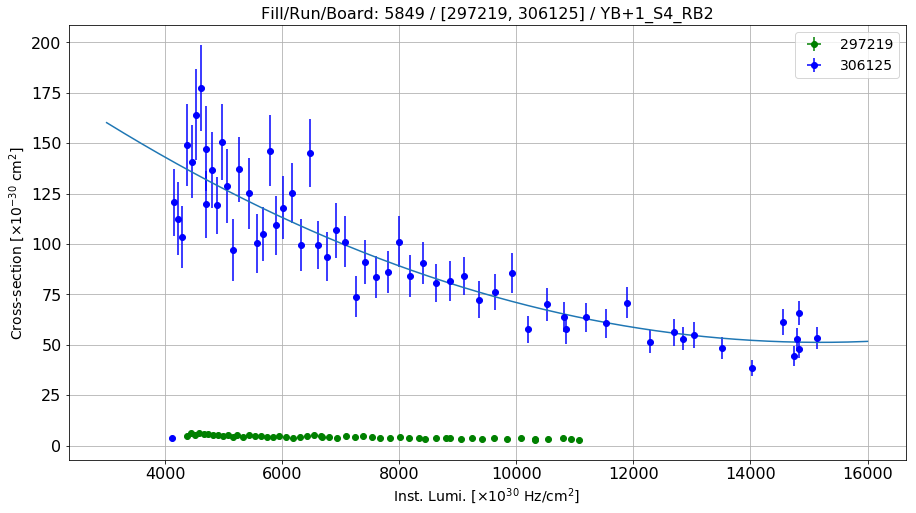

Linear fit parameters: [7.43924653e+00 6.35257727e+05]


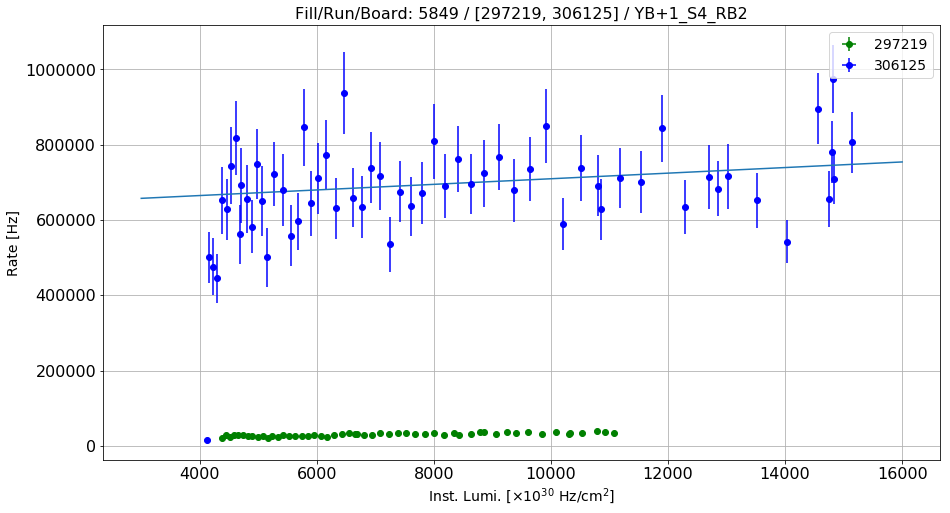

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S4_RB3
Linear fit for the reference run: [ 2.41135889e-09 -6.71813583e-05  1.58264600e+00]


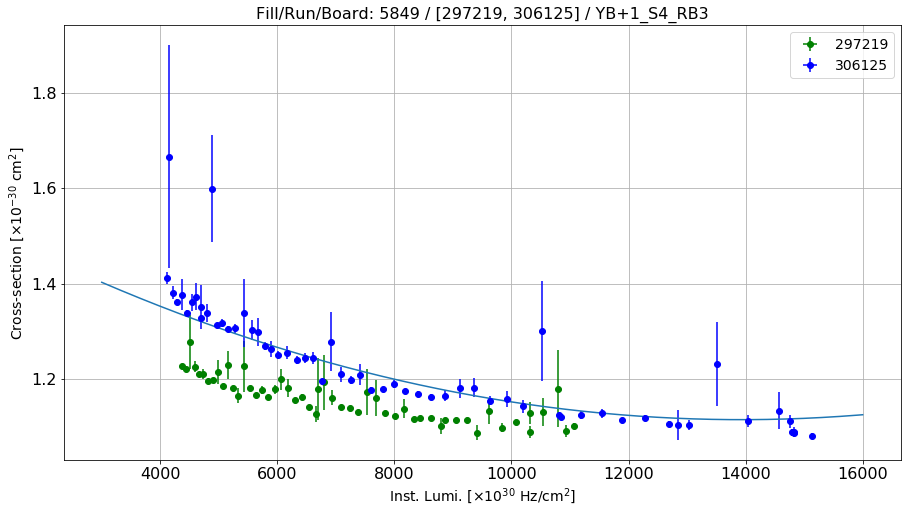

Linear fit parameters: [1.00256135e+00 1.55410853e+03]


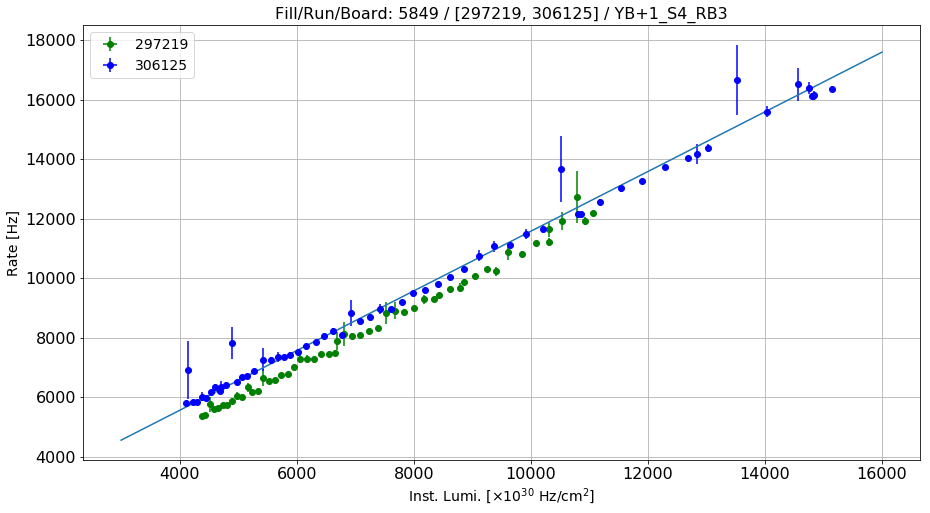

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S4_RB4
Linear fit for the reference run: [ 5.16741527e-13 -3.22924723e-09  3.11539691e-04]


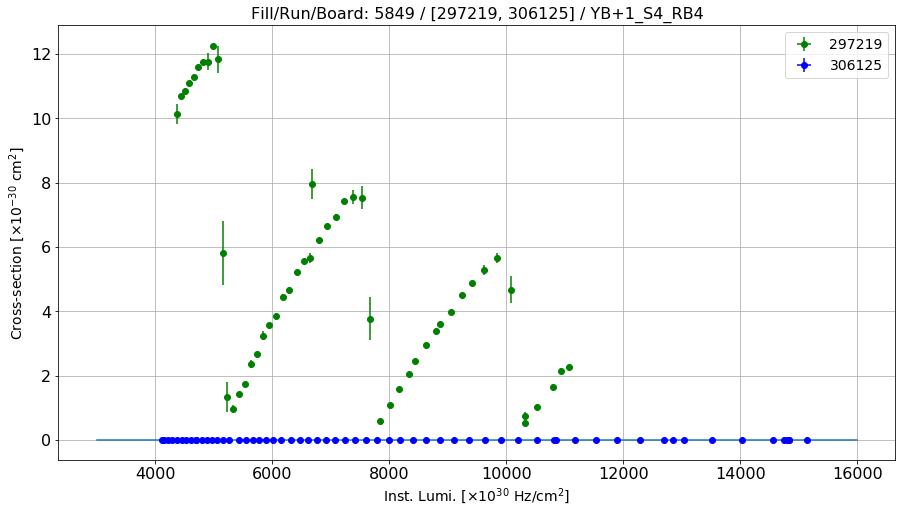

Linear fit parameters: [ 4.08645155e-04 -6.51673670e-01]


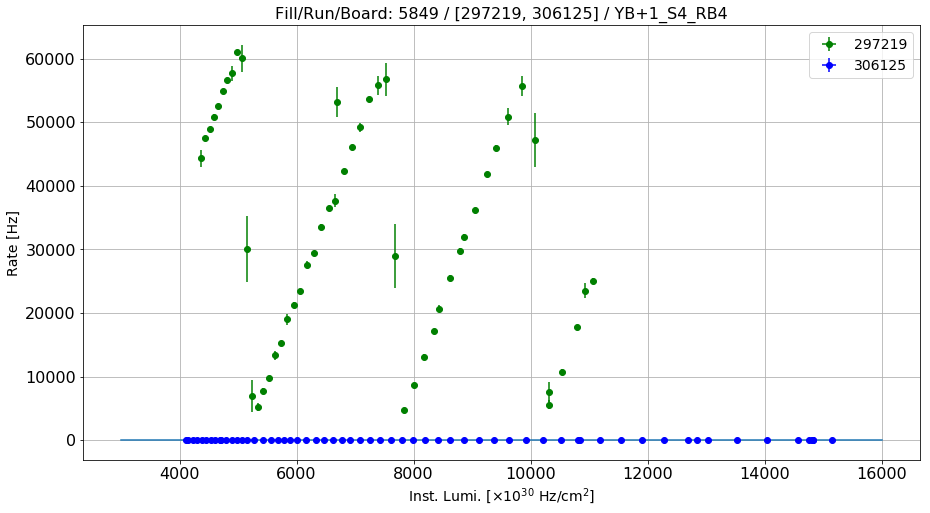

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S5_RB1
Linear fit for the reference run: [ 6.39446981e-09 -2.36027690e-04  1.91997604e+01]


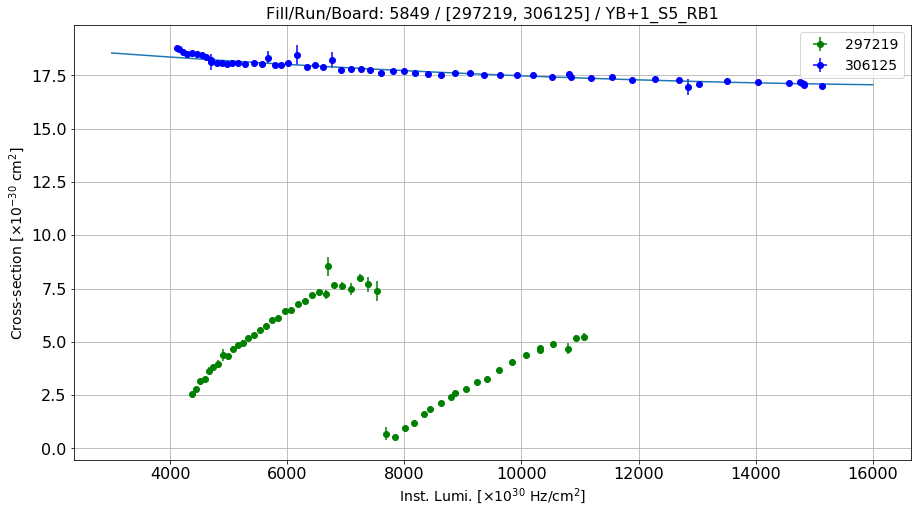

Linear fit parameters: [  16.51399408 9224.51263244]


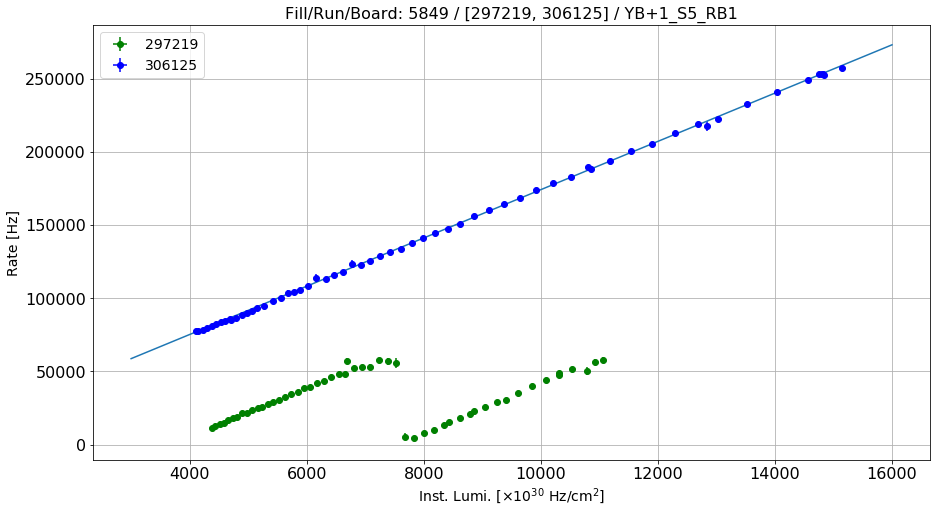

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S5_RB2
Linear fit for the reference run: [ 5.84232435e-09 -1.73500173e-04  4.89480924e+00]


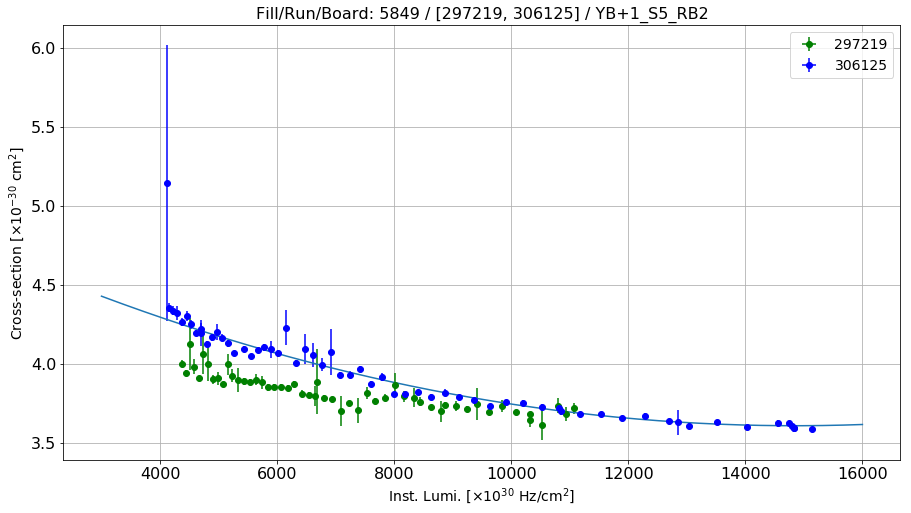

Linear fit parameters: [3.27660039e+00 4.71156732e+03]


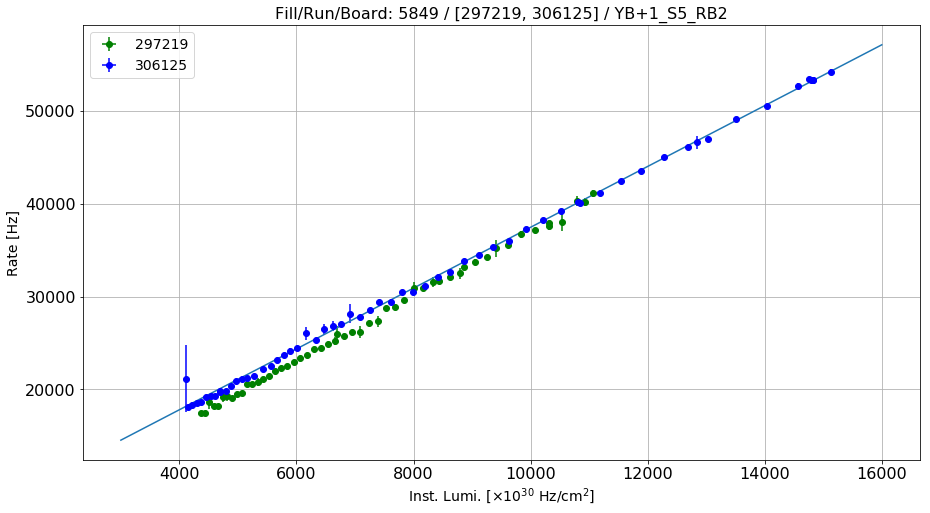

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S5_RB3
Linear fit for the reference run: [ 2.73339189e-09 -7.90680741e-05  1.52693310e+00]


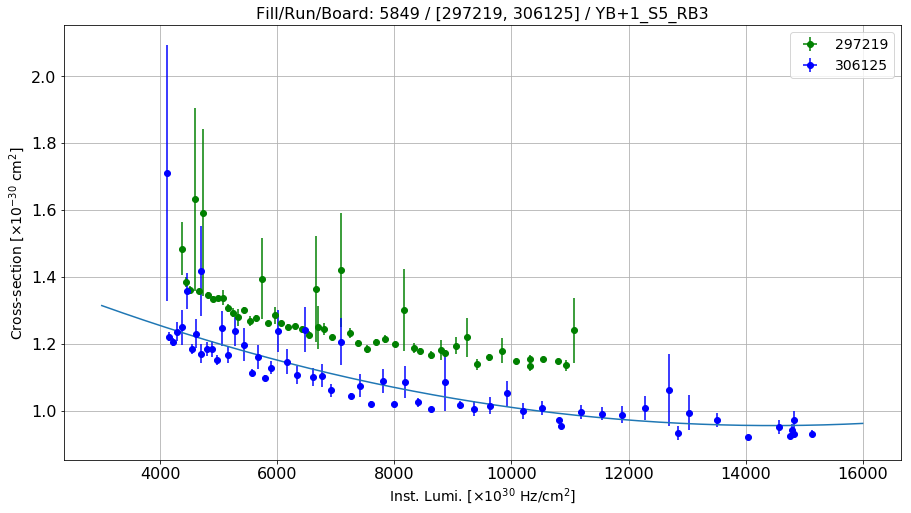

Linear fit parameters: [8.11588440e-01 2.01867327e+03]


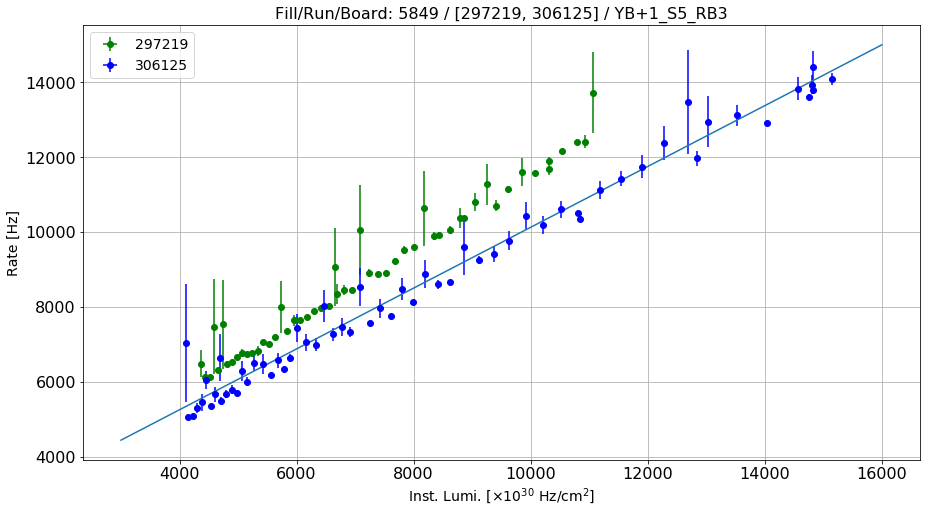

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S5_RB4
Linear fit for the reference run: [ 2.17006824e-08 -6.94580283e-04  4.74085203e+01]


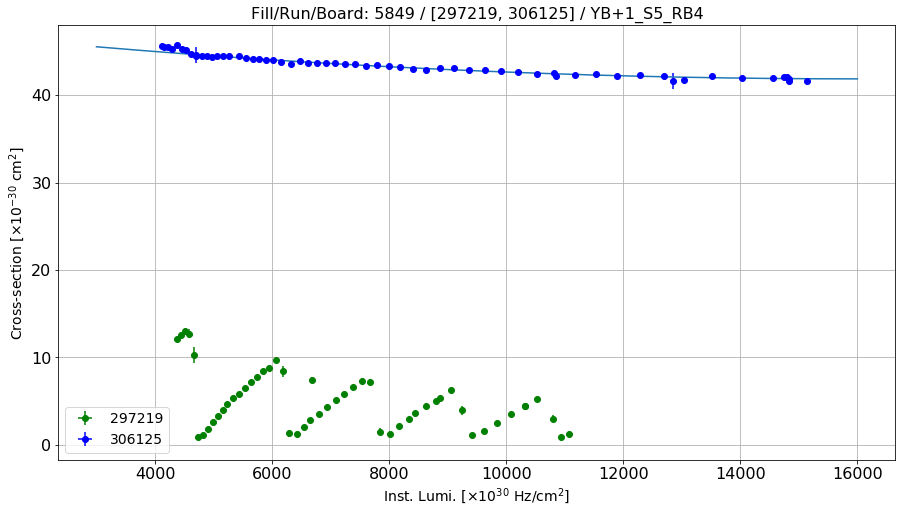

Linear fit parameters: [   40.40388204 21921.18159906]


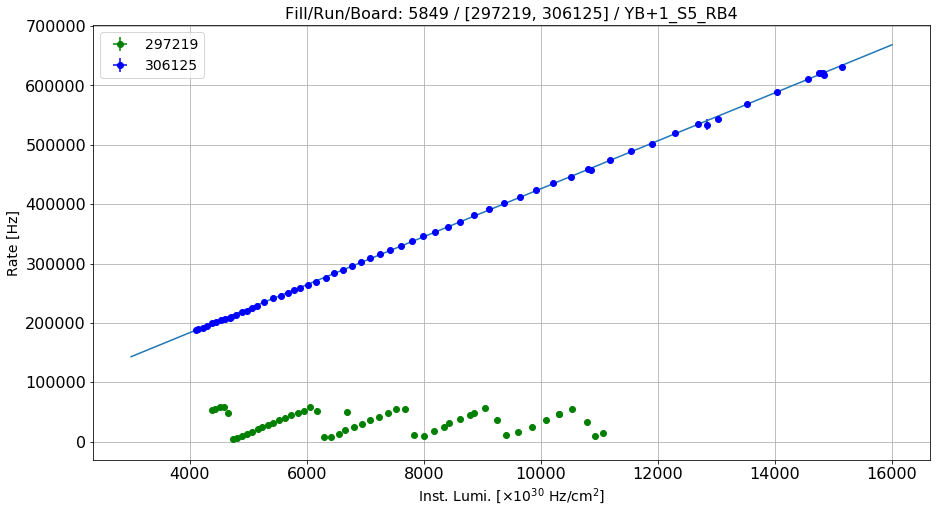

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S6_RB1
Linear fit for the reference run: [ 3.62058917e-06 -9.72964914e-02  7.96253796e+02]


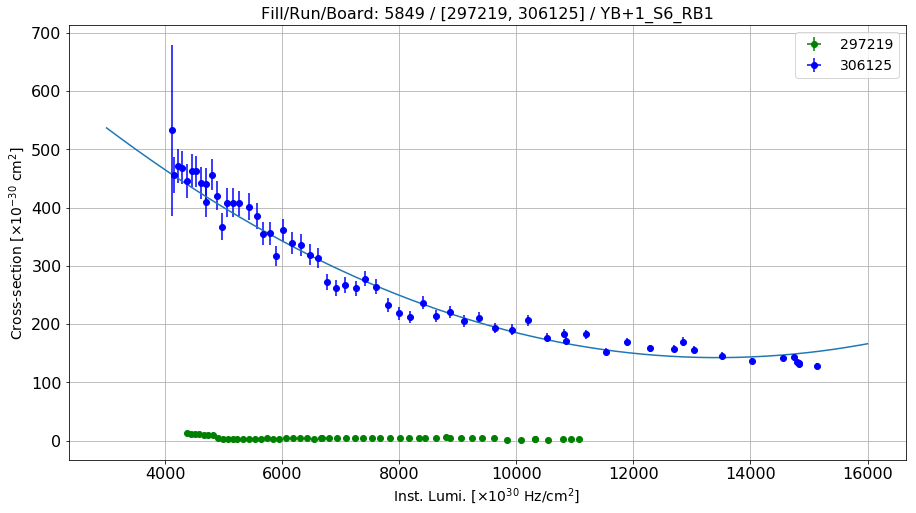

Linear fit parameters: [-3.85653726e+00  2.01826294e+06]


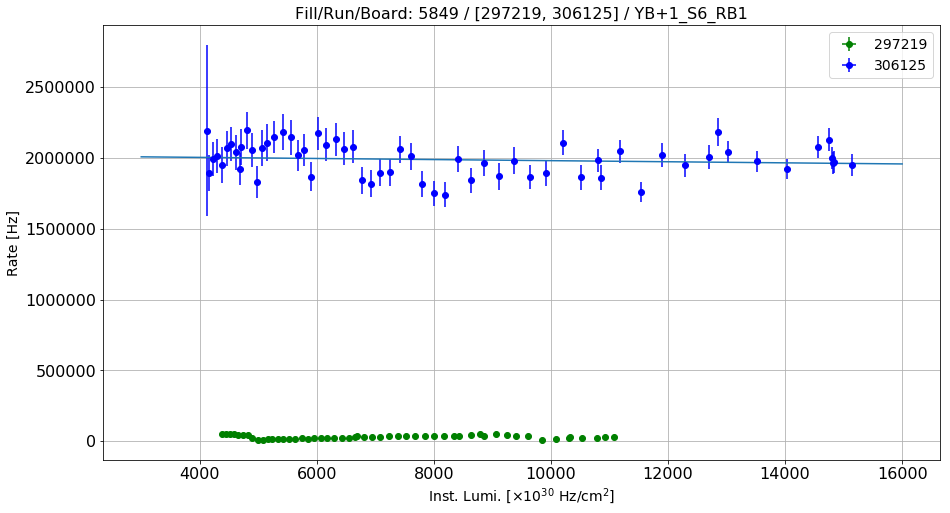

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S6_RB2
Linear fit for the reference run: [ 7.63939228e-09 -2.20874615e-04  5.77248566e+00]


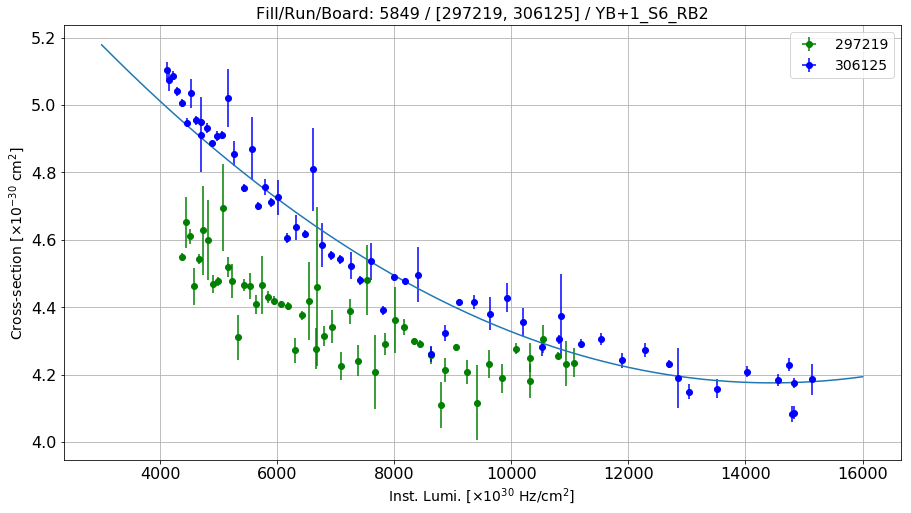

Linear fit parameters: [3.77535290e+00 5.63234677e+03]


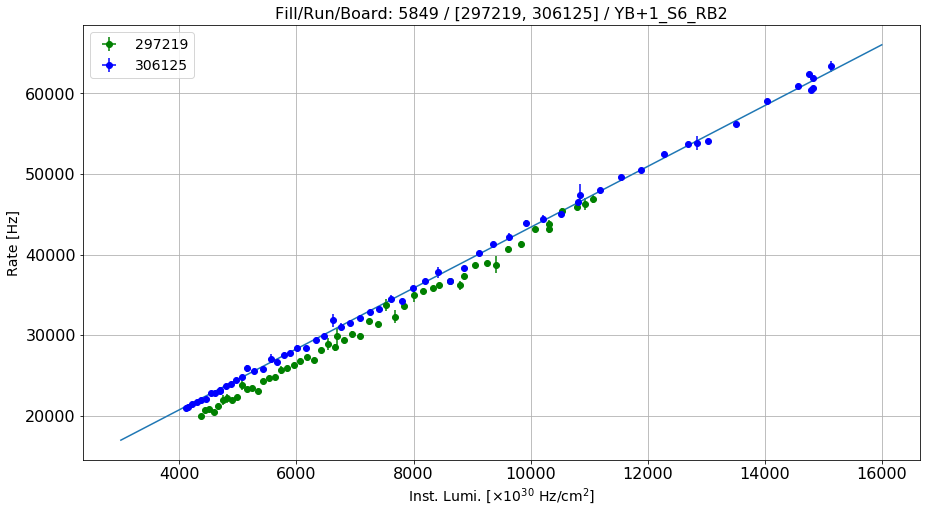

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S6_RB3
Linear fit for the reference run: [ 2.30261624e-08 -6.04008701e-04  5.54955355e+00]


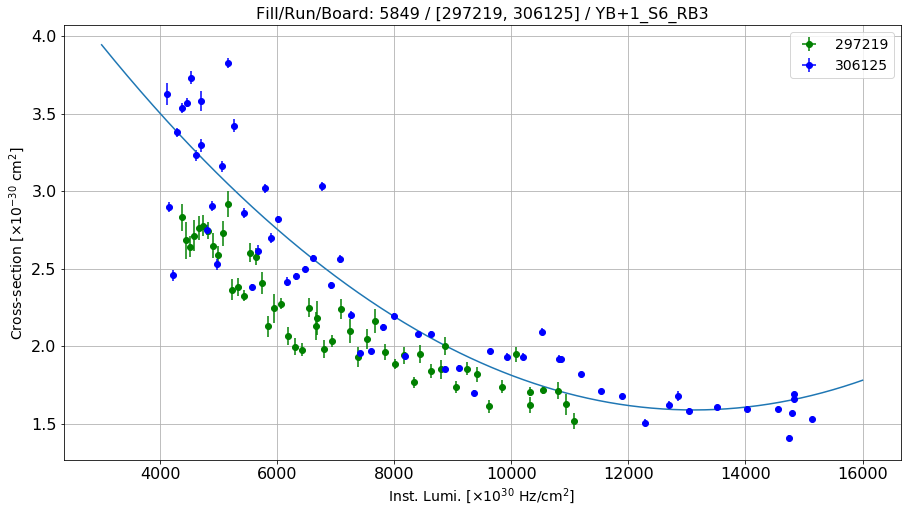

Linear fit parameters: [7.53985915e-01 1.15328123e+04]


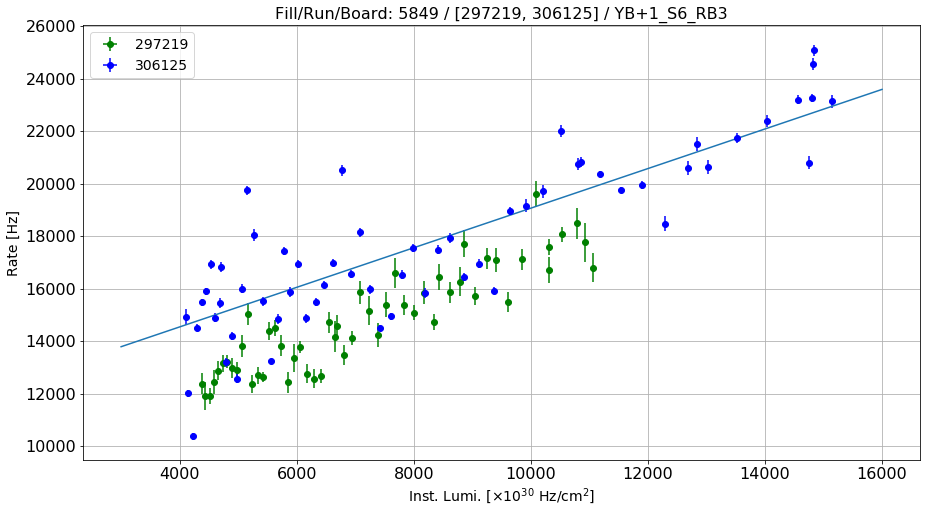

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S6_RB4
Linear fit for the reference run: [ 7.24717441e-09 -2.62699064e-04  2.68092580e+01]


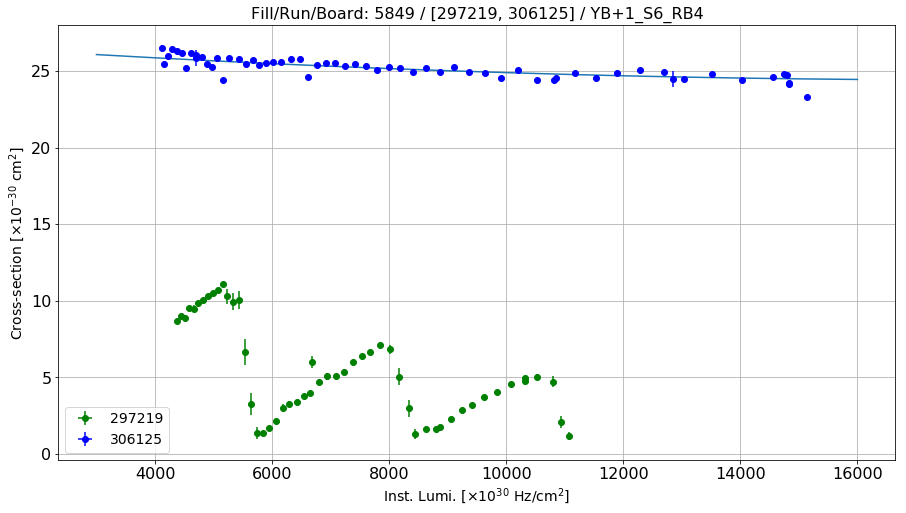

Linear fit parameters: [   23.86057257 10031.08809006]


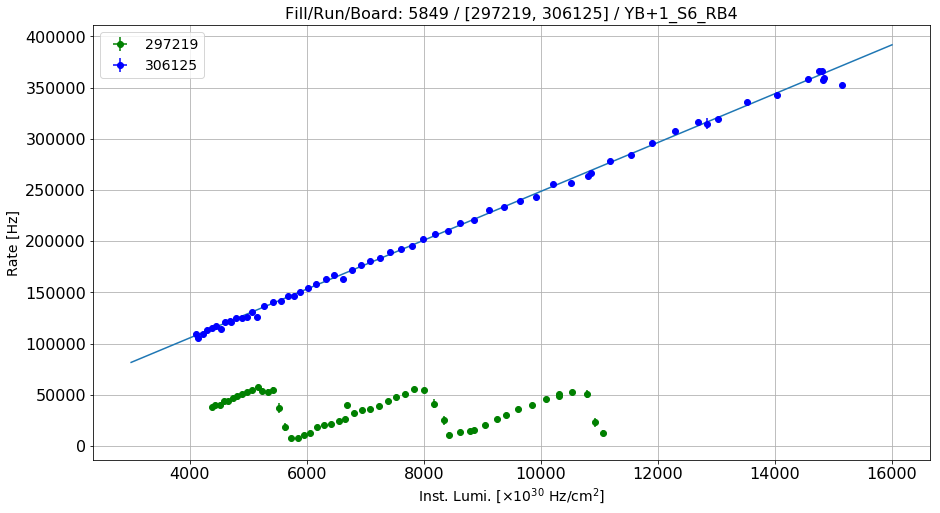

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S7_RB1
Linear fit for the reference run: [ 5.79916181e-09 -1.86006232e-04  1.76144827e+01]


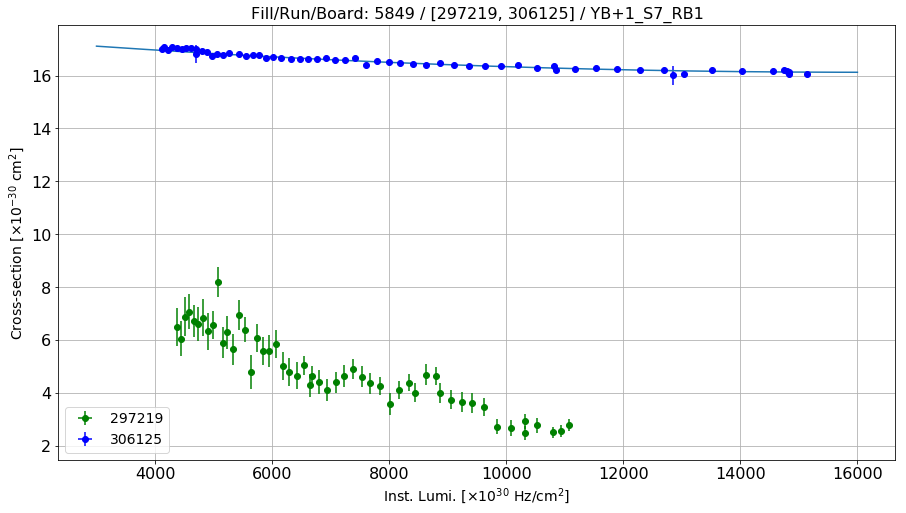

Linear fit parameters: [  15.73485809 5892.53872331]


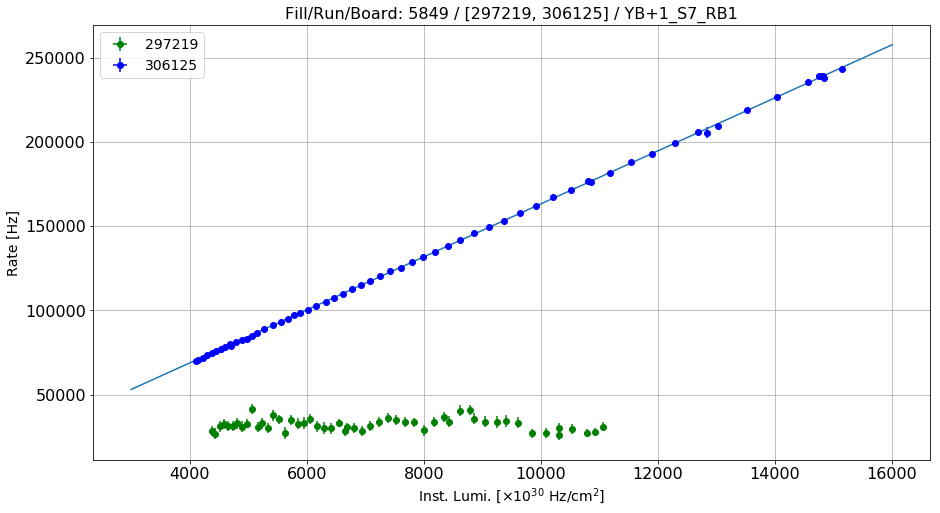

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S7_RB2
Linear fit for the reference run: [ 3.51156771e-09 -9.53233453e-05  4.27389491e+00]


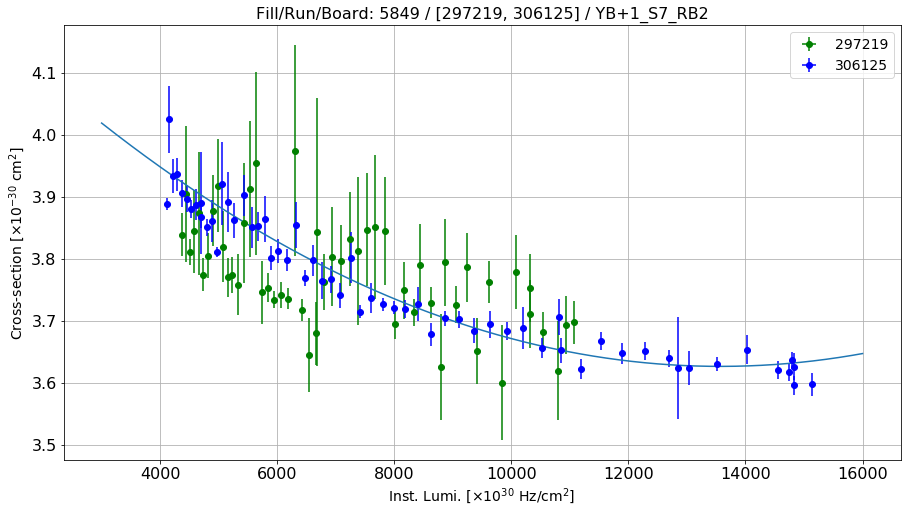

Linear fit parameters: [   3.47891069 2041.8405891 ]


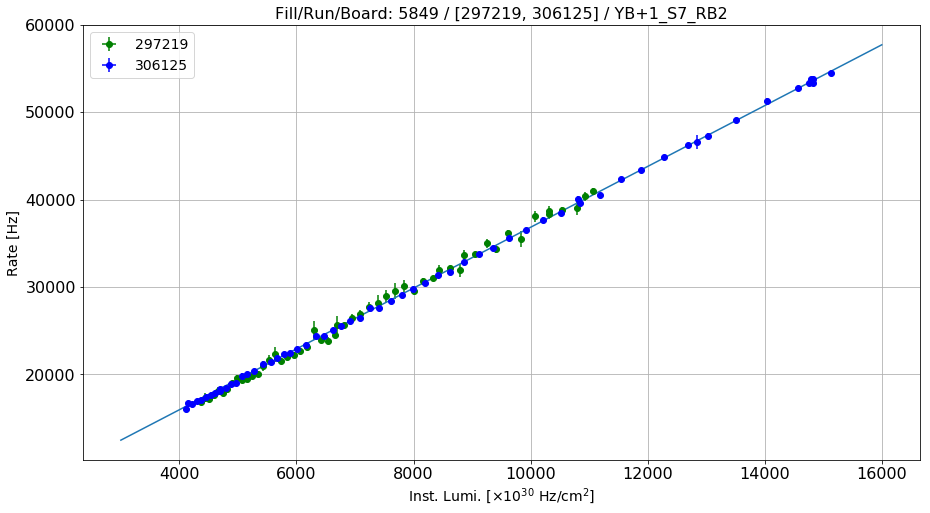

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S7_RB3
Linear fit for the reference run: [ 3.99962092e-09 -1.13012498e-04  1.58134610e+00]


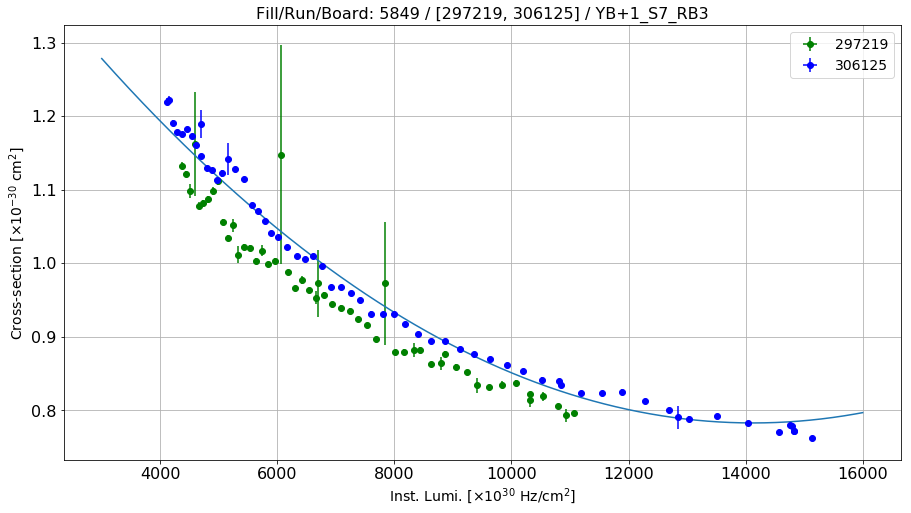

Linear fit parameters: [5.87826146e-01 2.71719407e+03]


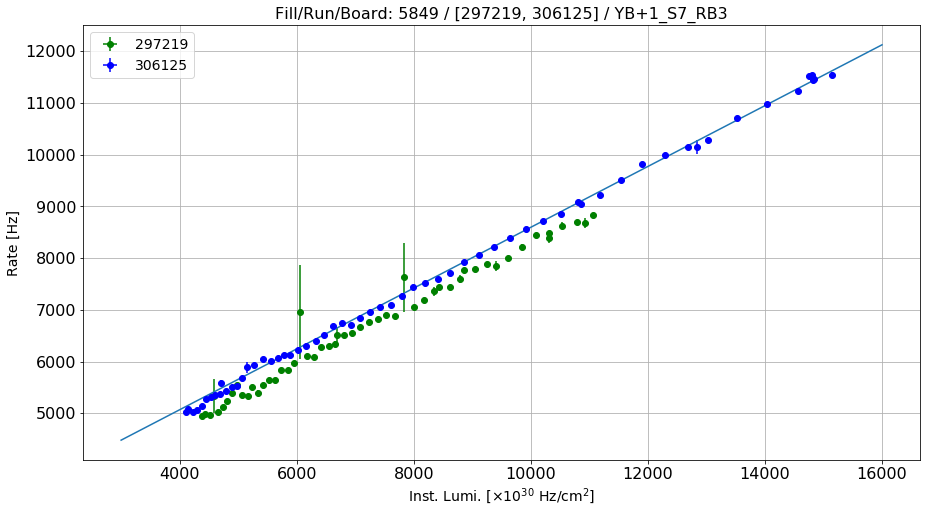

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S7_RB4
Linear fit for the reference run: [ 3.02130122e-08 -7.03076710e-04  1.99623379e+01]


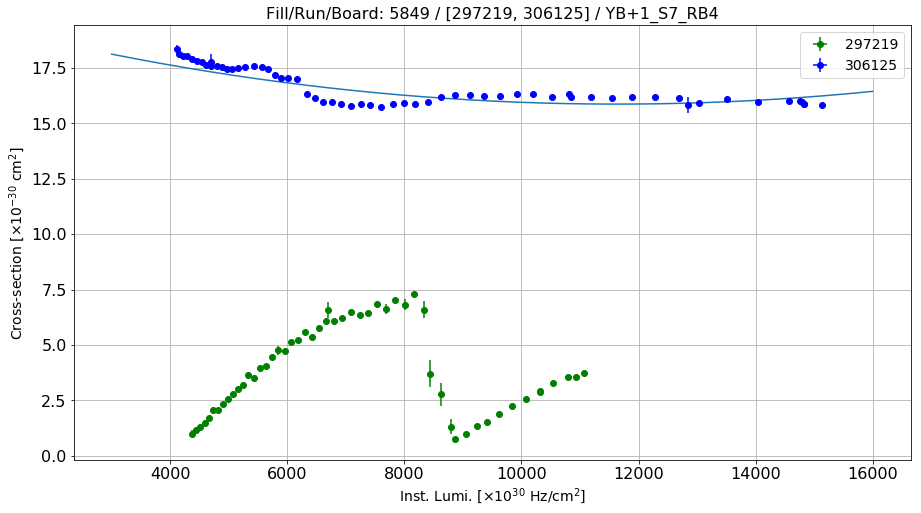

Linear fit parameters: [  15.44357568 7244.63133742]


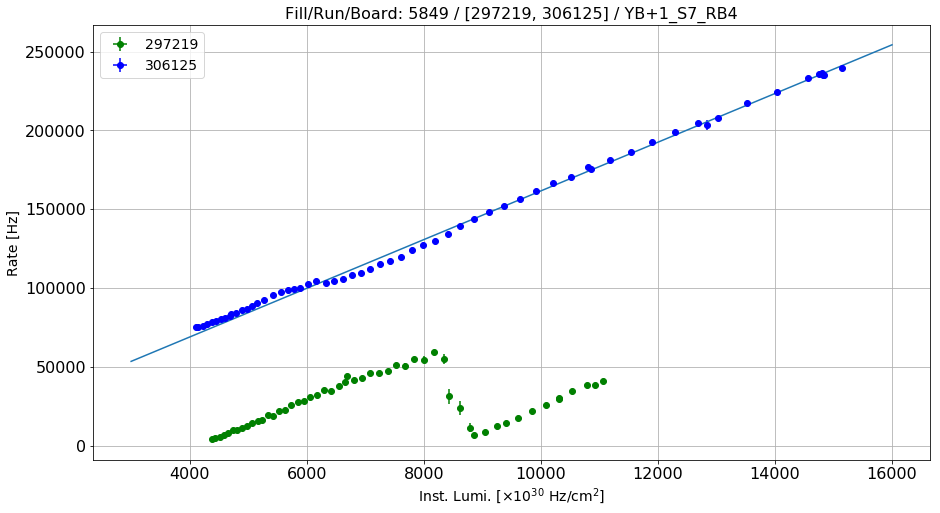

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S8_RB1
Linear fit for the reference run: [ 9.88441528e-09 -4.82498330e-04  2.09100732e+01]


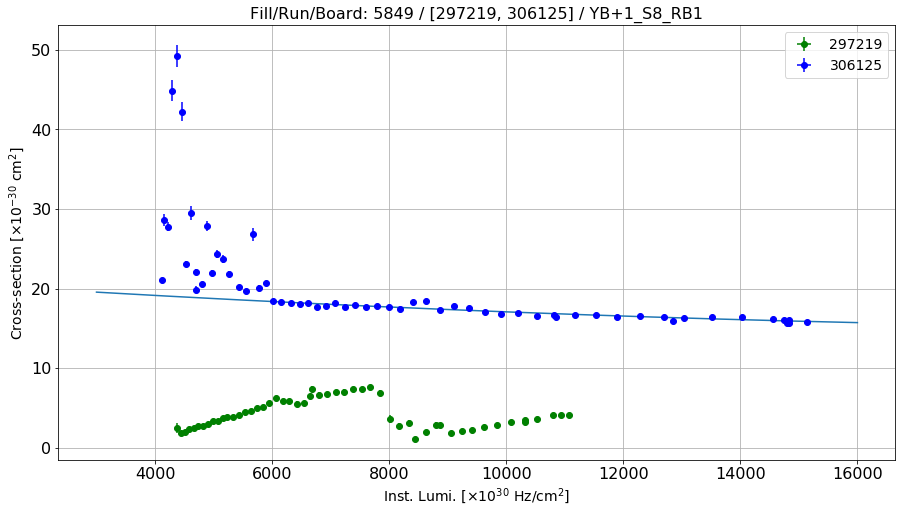

Linear fit parameters: [1.41915250e+01 2.73947135e+04]


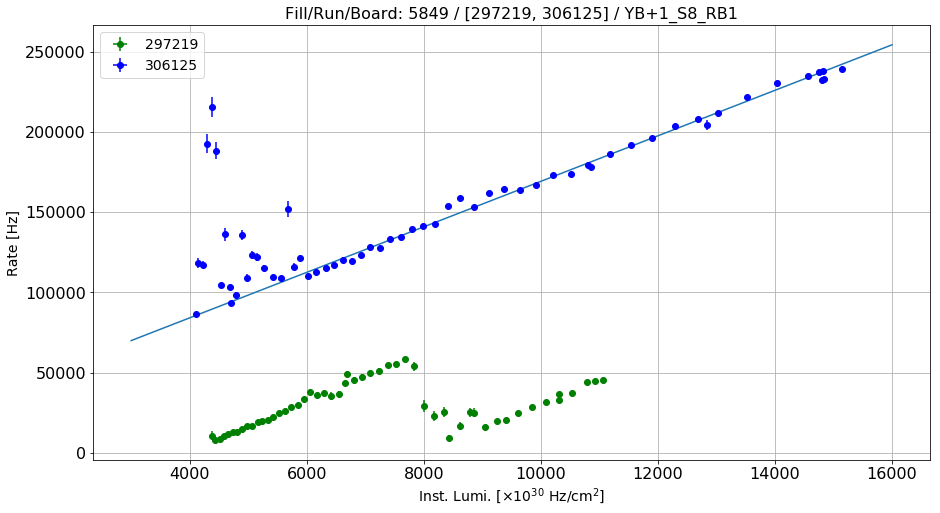

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S8_RB2
Linear fit for the reference run: [ 1.18130613e-08 -3.28491873e-04  6.50412518e+00]


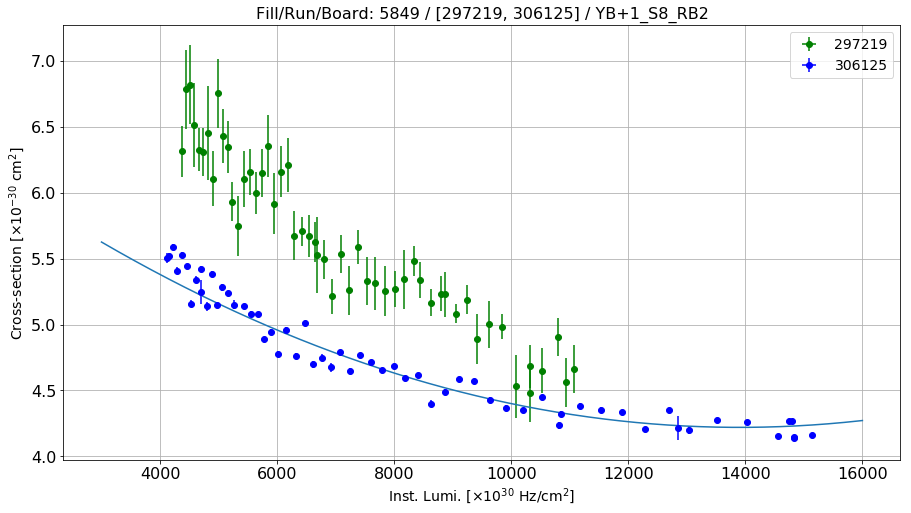

Linear fit parameters: [3.67471562e+00 7.55839778e+03]


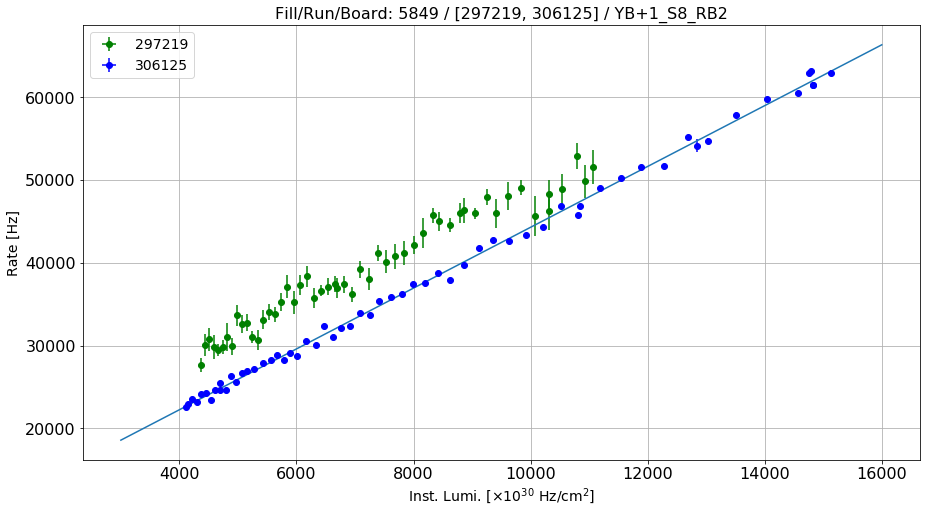

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S8_RB3
Linear fit for the reference run: [ 5.41292967e-08 -1.63048044e-03  1.58212956e+01]


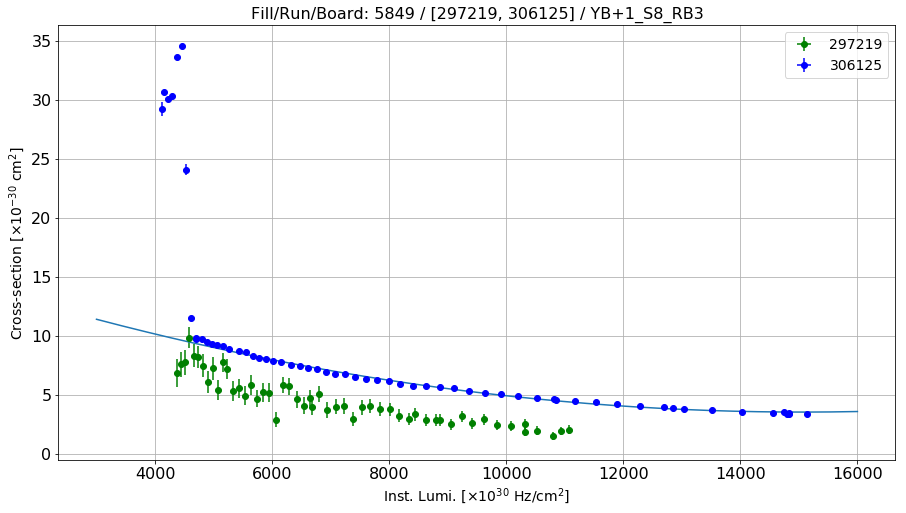

Linear fit parameters: [3.72594990e-01 4.56805807e+04]


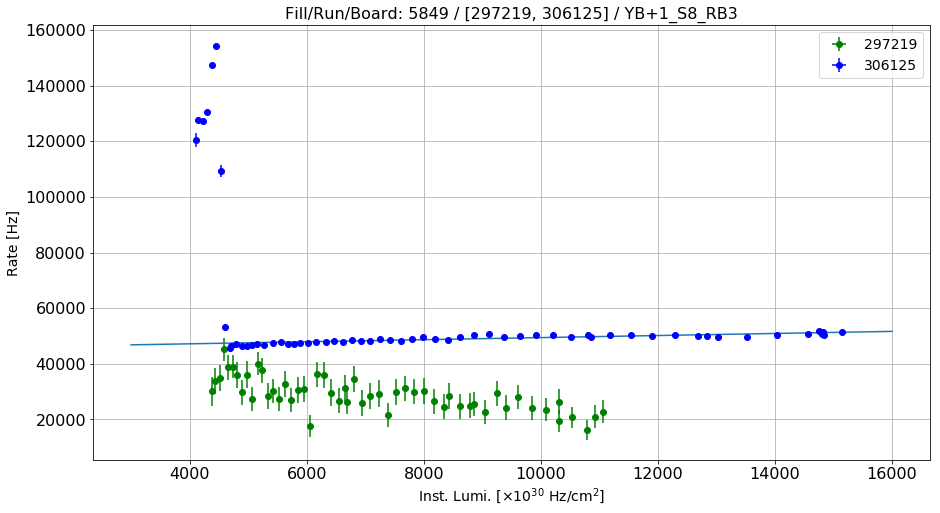

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S8_RB4
Linear fit for the reference run: [ 4.43801092e-09 -1.34696437e-04  1.20908088e+01]


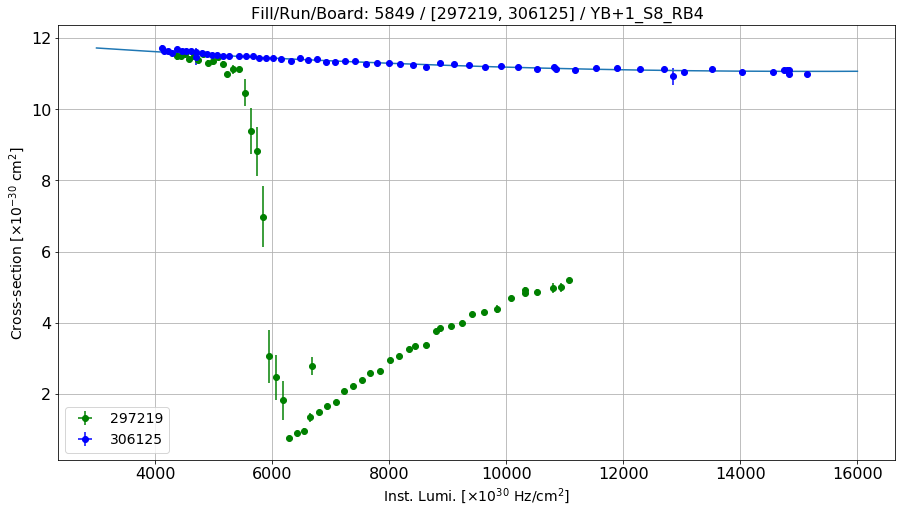

Linear fit parameters: [  10.80406267 3834.79593871]


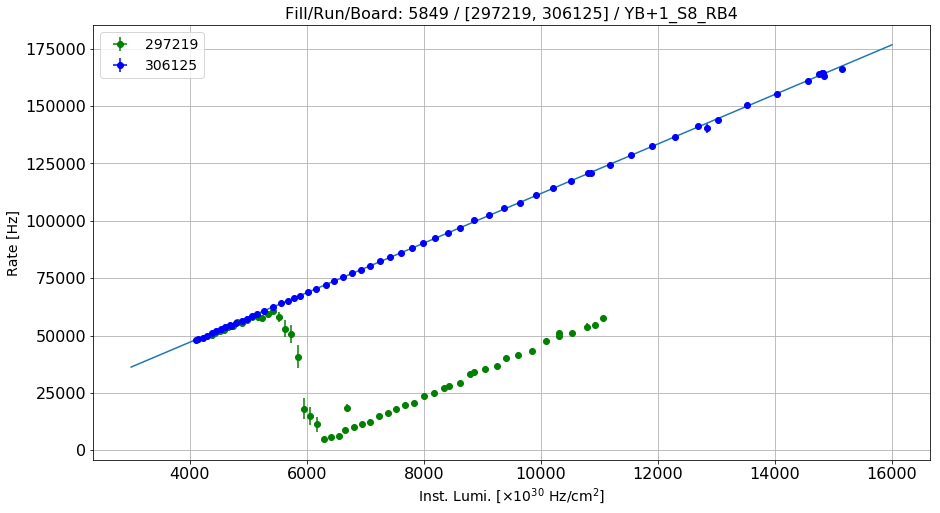

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S9_RB1
Linear fit for the reference run: [ 9.59475986e-09 -2.80273608e-04  1.94854614e+01]


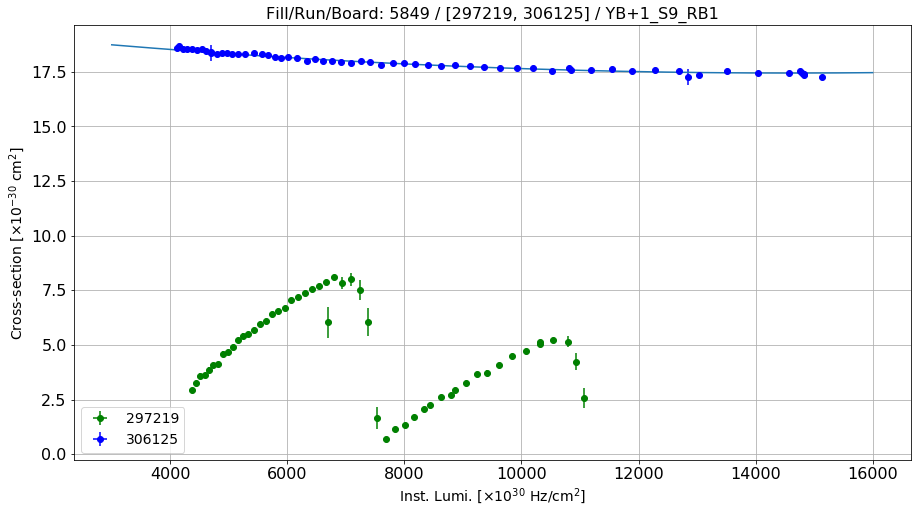

Linear fit parameters: [  16.92035615 7326.55678939]


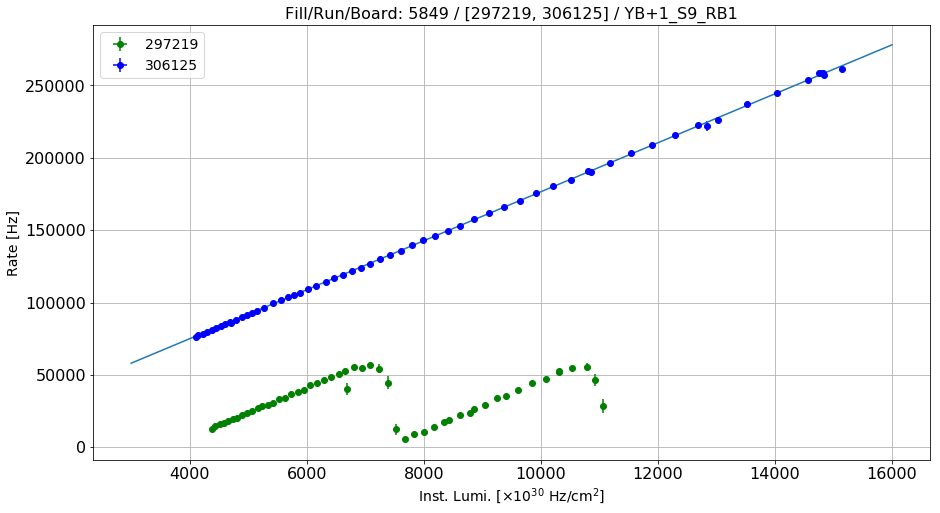

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S9_RB2
Linear fit for the reference run: [ 5.81998447e-09 -1.69780883e-04  4.41077306e+00]


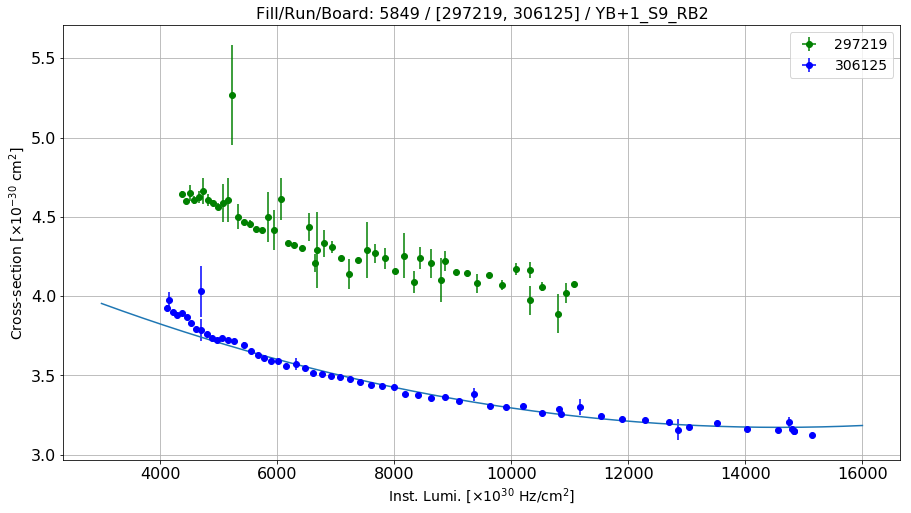

Linear fit parameters: [2.85934025e+00 4.42409295e+03]


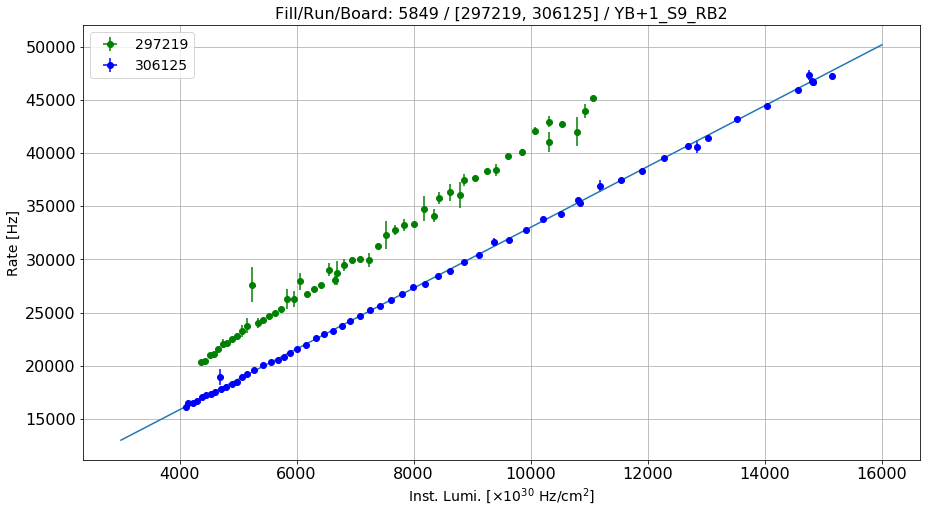

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S9_RB3
Linear fit for the reference run: [ 1.34043625e-09 -4.61444658e-05  9.11776593e-01]


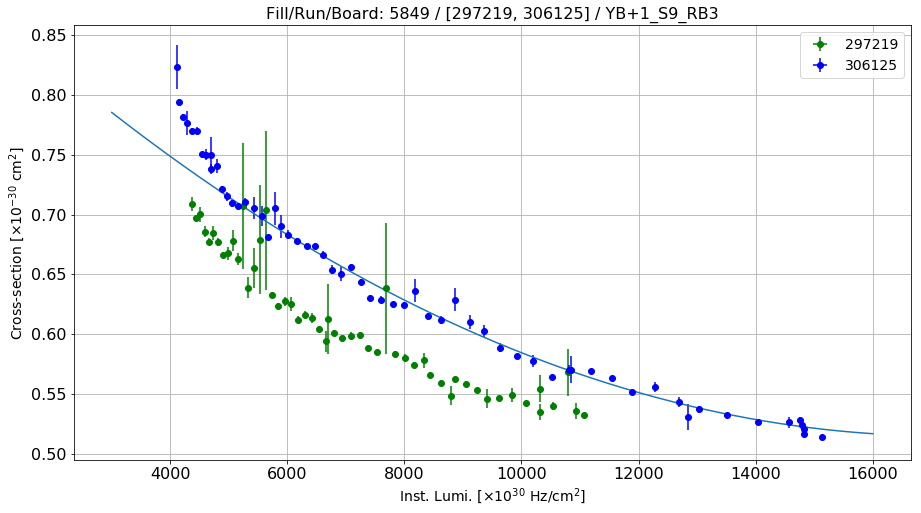

Linear fit parameters: [4.14851398e-01 1.63981501e+03]


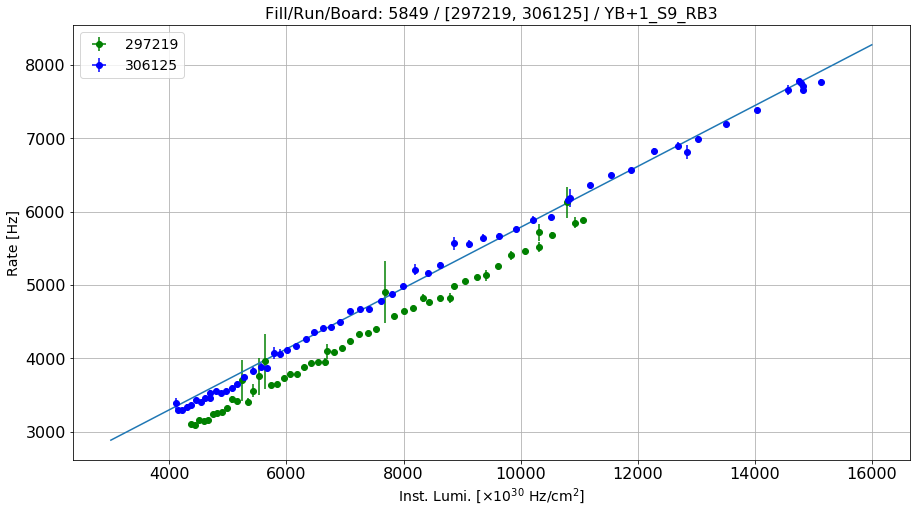

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S9_RB4
Linear fit for the reference run: [ 4.41802305e-09 -1.26825349e-04  1.84607519e+00]


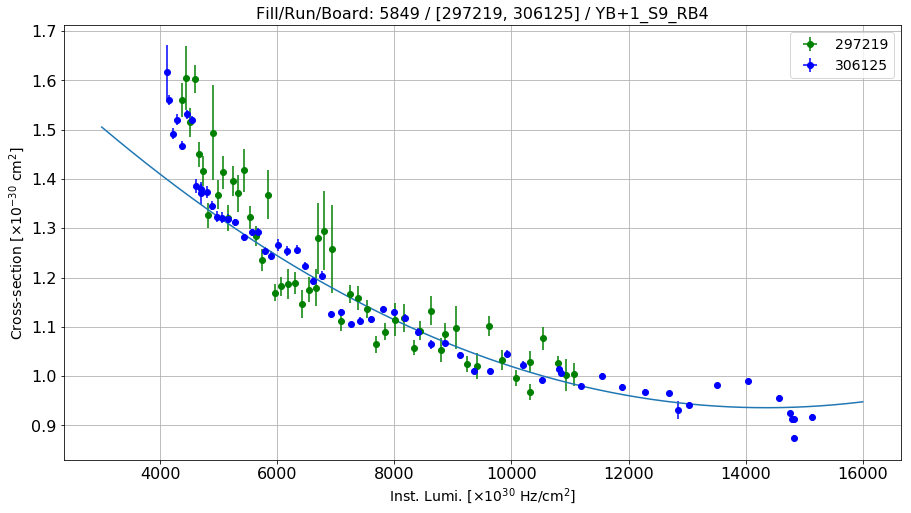

Linear fit parameters: [7.09155920e-01 3.17696394e+03]


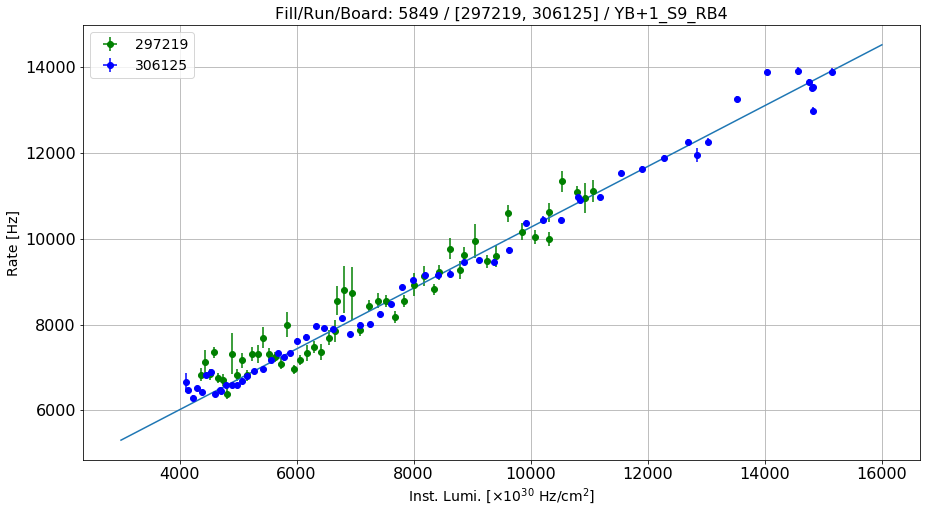

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S10_RB1
Linear fit for the reference run: [ 2.85465986e-08 -9.07853299e-04  2.56000764e+01]


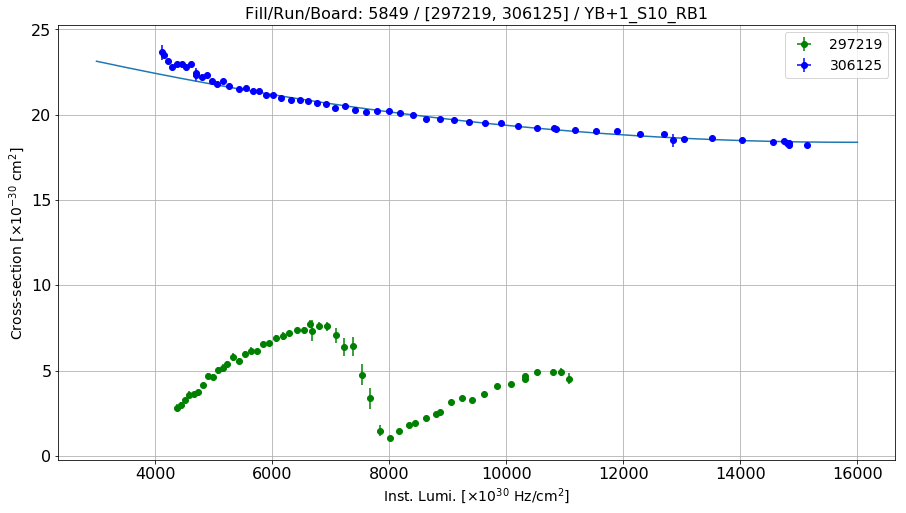

Linear fit parameters: [1.65015982e+01 2.83211475e+04]


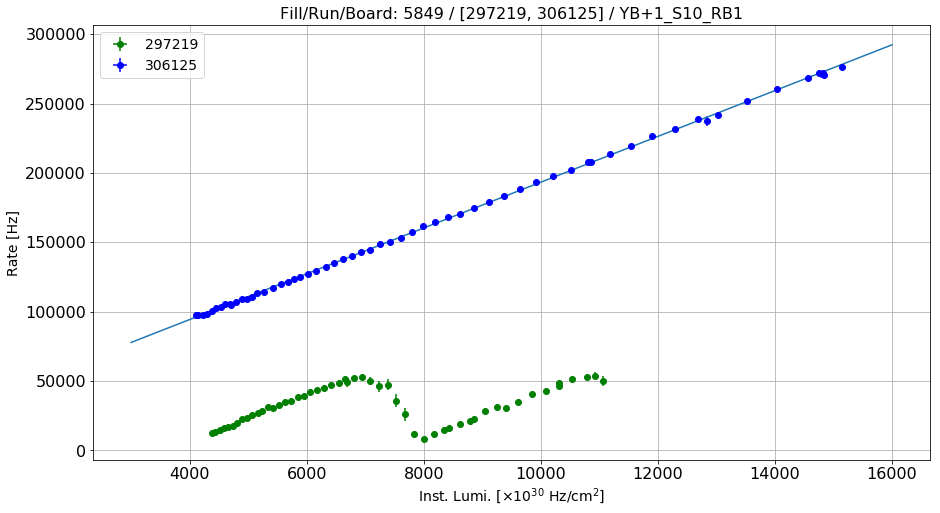

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S10_RB2
Linear fit for the reference run: [ 8.77651504e-09 -2.52034060e-04  5.85521258e+00]


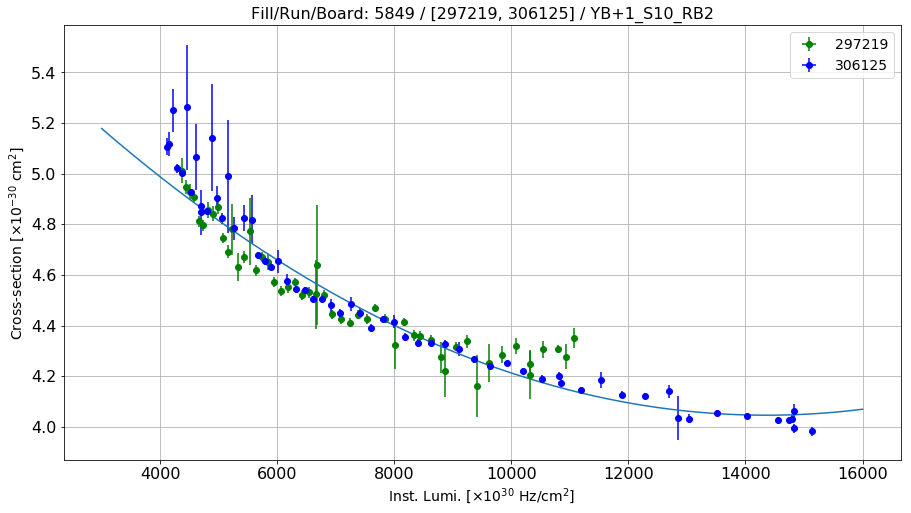

Linear fit parameters: [3.59486391e+00 6.31925678e+03]


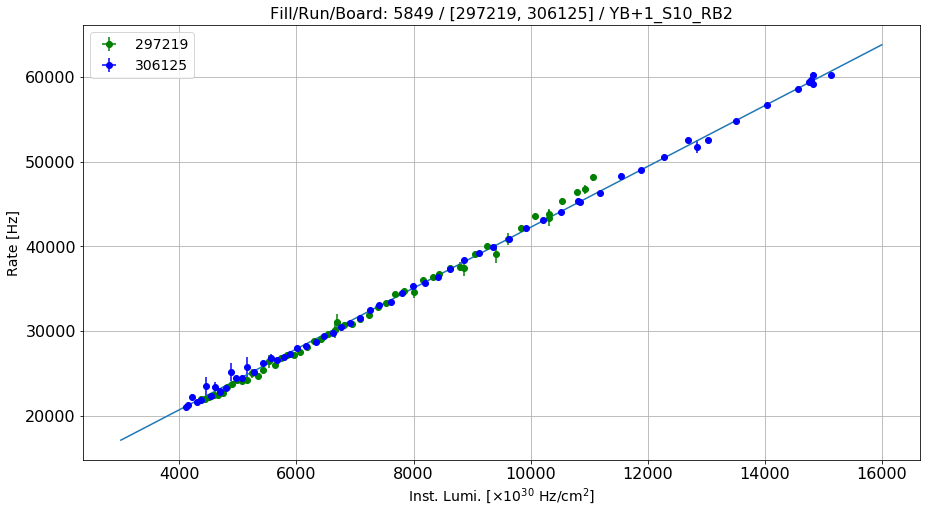

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S10_RB3
Linear fit for the reference run: [ 4.60339701e-09 -1.33146907e-04  1.58783503e+00]


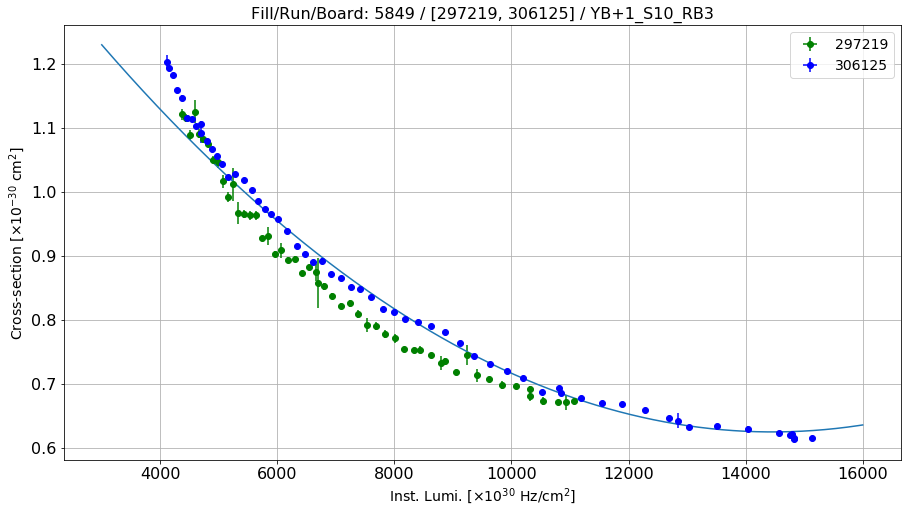

Linear fit parameters: [3.83382398e-01 3.39845536e+03]


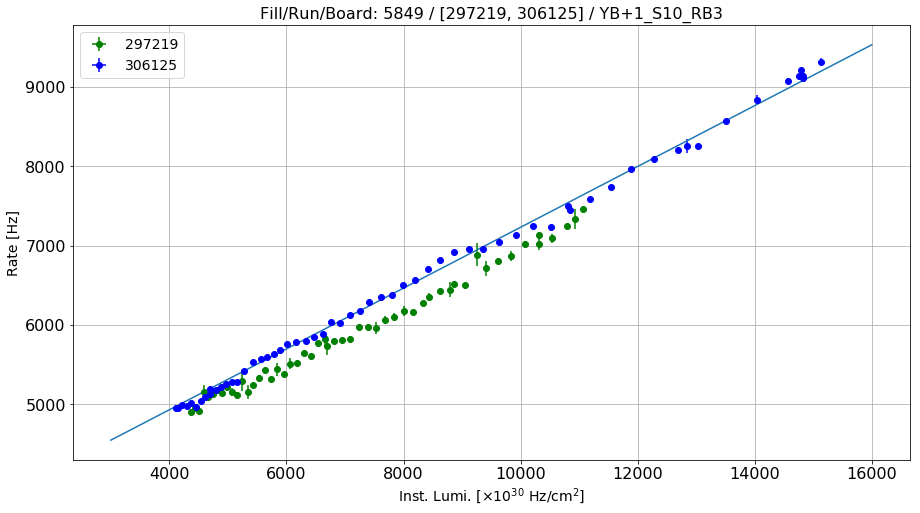

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S10_RB4
Linear fit for the reference run: [ 3.65269111e-09 -1.09940640e-04  1.85016087e+00]


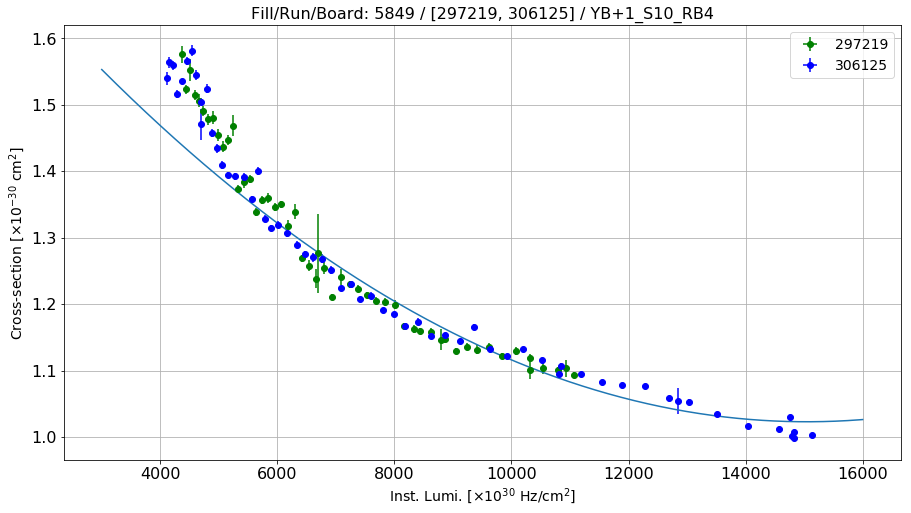

Linear fit parameters: [8.09365995e-01 3.07501907e+03]


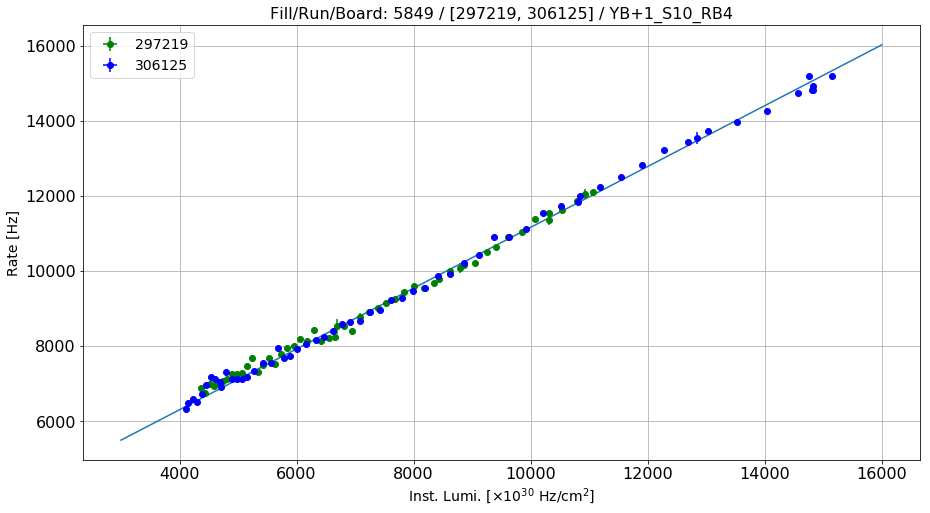

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S11_RB1
Linear fit for the reference run: [ 2.15107365e-08 -7.53965625e-04  2.31012959e+01]


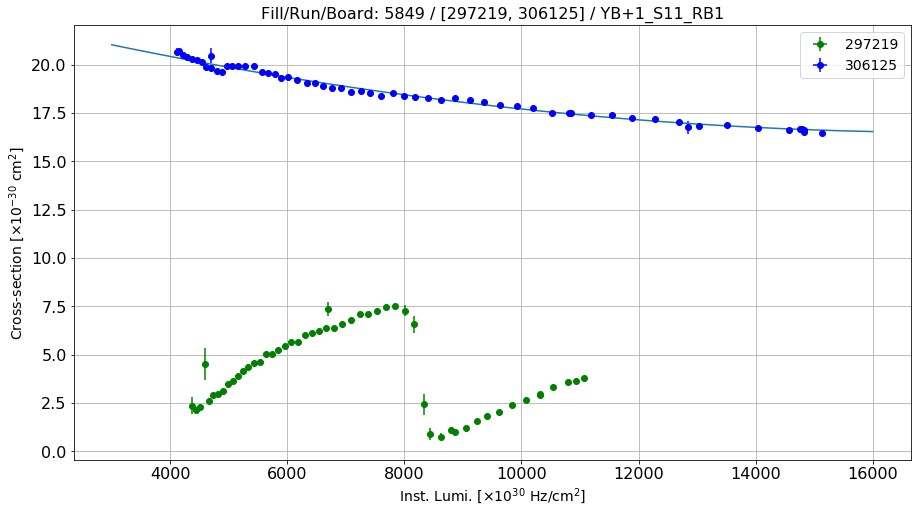

Linear fit parameters: [1.48599993e+01 2.75018496e+04]


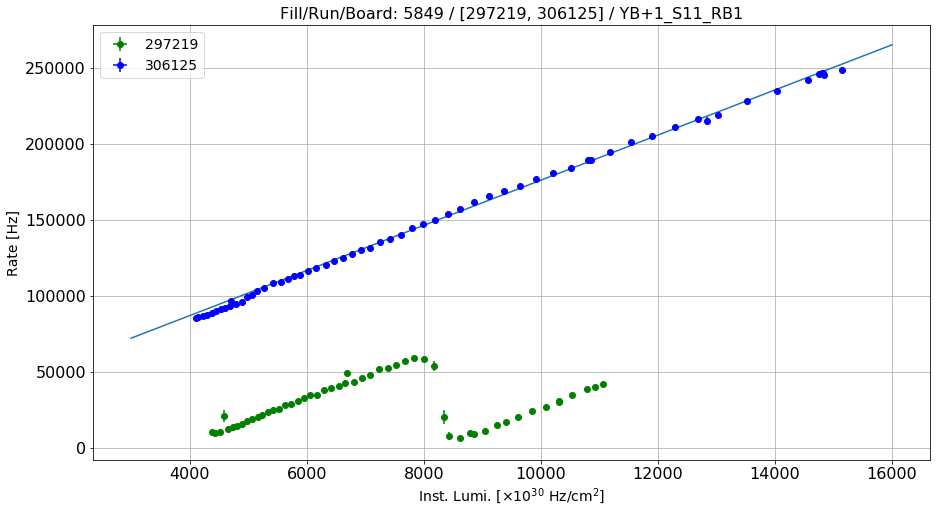

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S11_RB2
Linear fit for the reference run: [ 6.57669686e-09 -1.97884935e-04  5.45011701e+00]


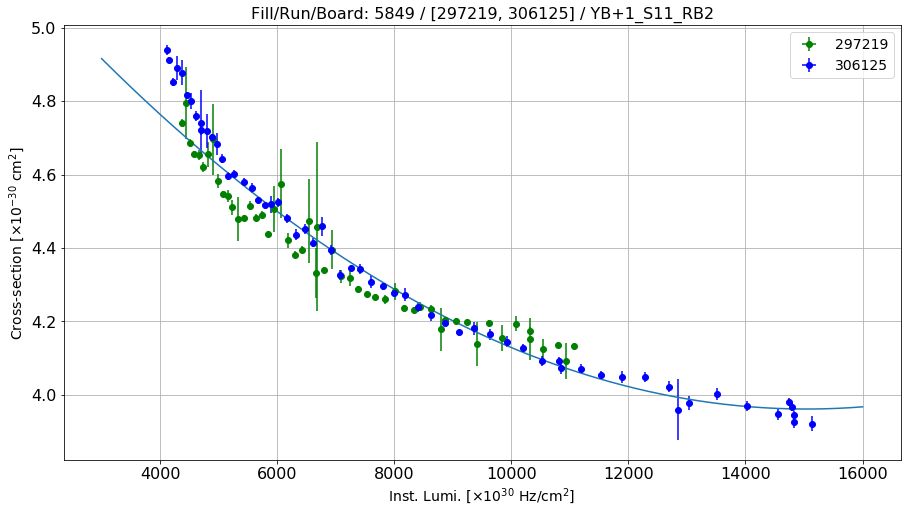

Linear fit parameters: [3.57742691e+00 5.53095214e+03]


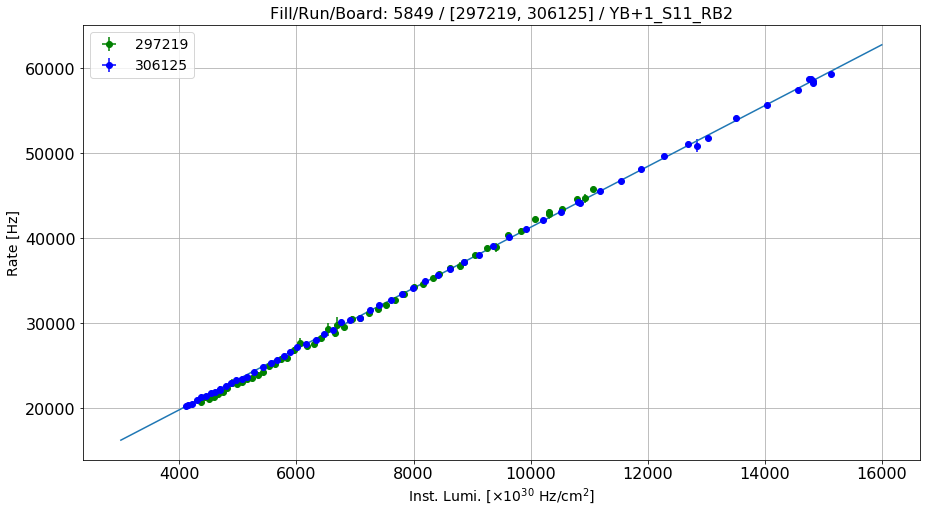

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S11_RB3
Linear fit for the reference run: [ 3.96435137e-09 -1.13128723e-04  1.45110358e+00]


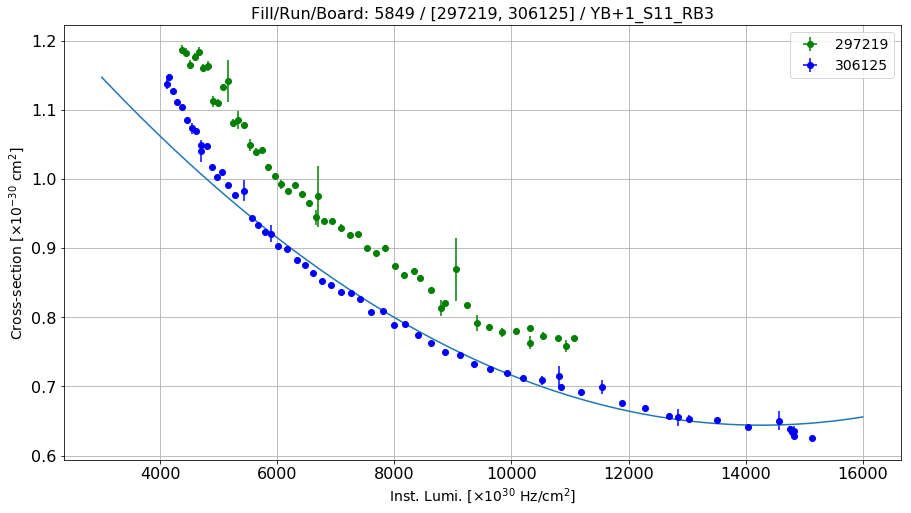

Linear fit parameters: [4.44281426e-01 2.79135669e+03]


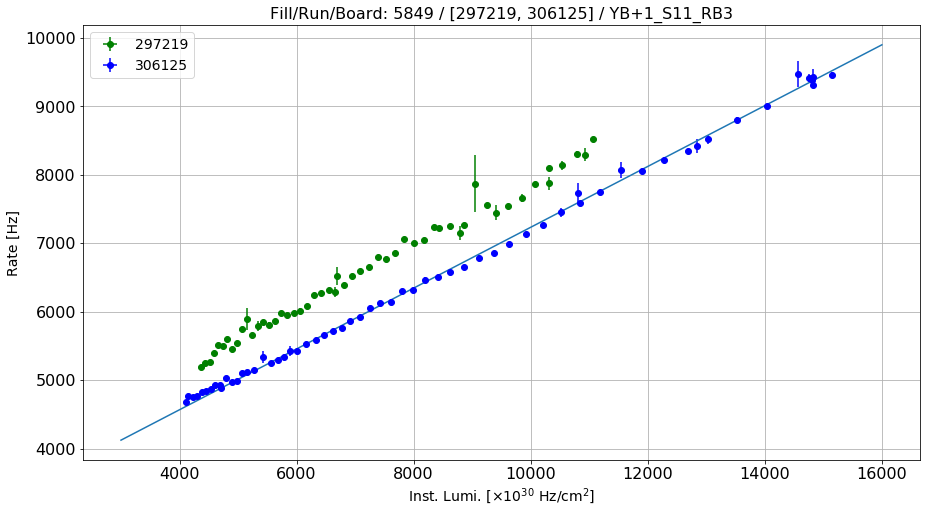

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S11_RB4
Linear fit for the reference run: [ 2.86512602e-09 -6.91625527e-05  1.07959742e+00]


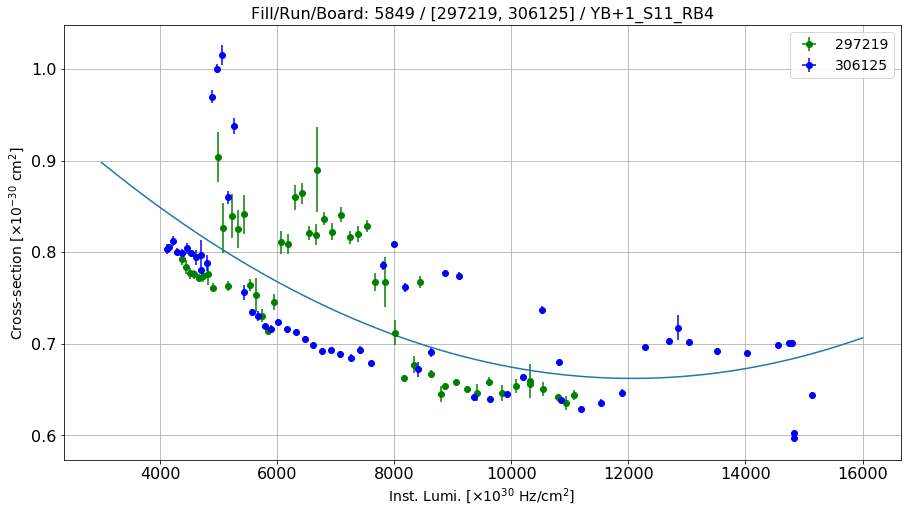

Linear fit parameters: [6.0172647e-01 9.0650461e+02]


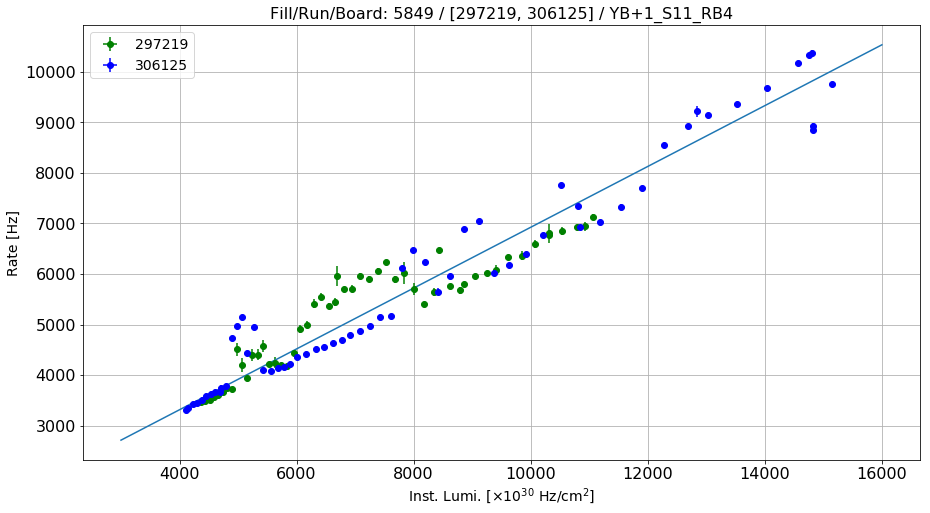

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S12_RB1
Linear fit for the reference run: [ 6.10288889e-09 -1.95991624e-04  1.72926546e+01]


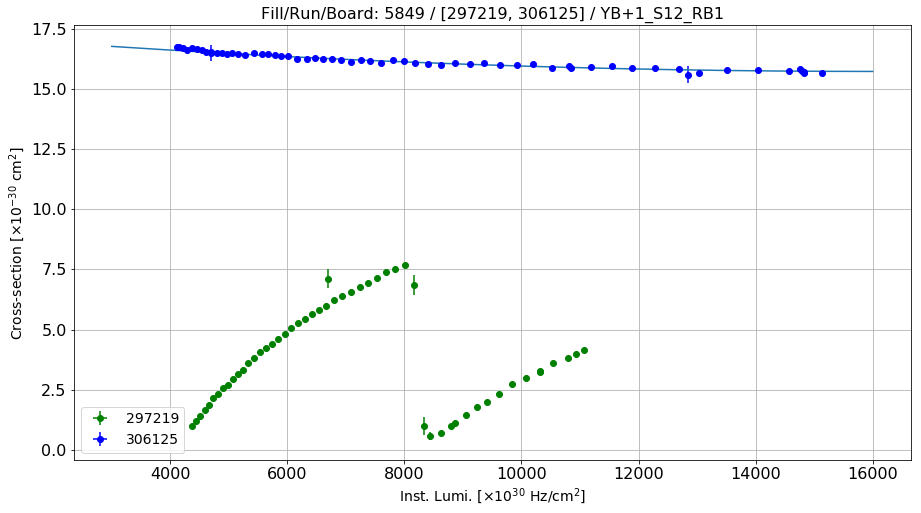

Linear fit parameters: [  15.30975919 6222.62270537]


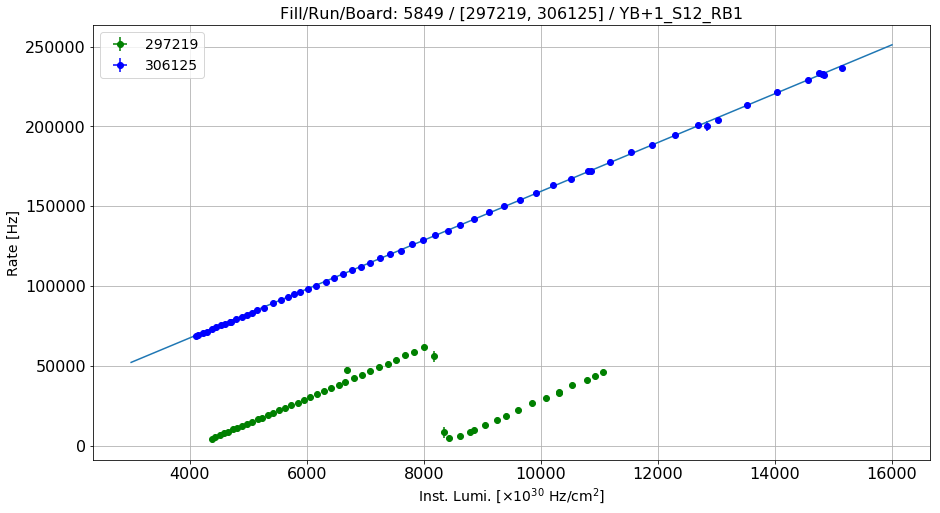

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S12_RB2
Linear fit for the reference run: [ 1.02881197e-07 -2.97671110e-03  3.07675640e+01]


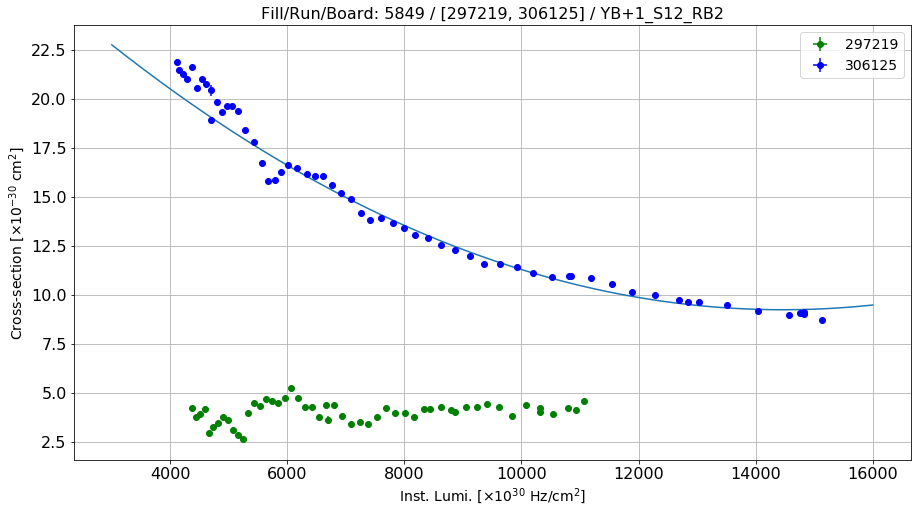

Linear fit parameters: [3.82917158e+00 7.60414365e+04]


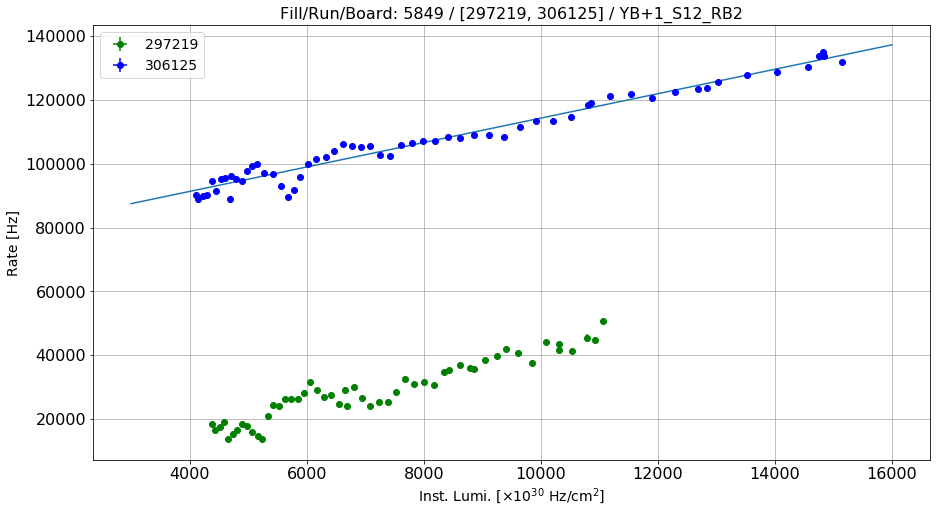

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S12_RB3
Linear fit for the reference run: [ 3.77039696e-09 -1.22820124e-04  1.83606518e+00]


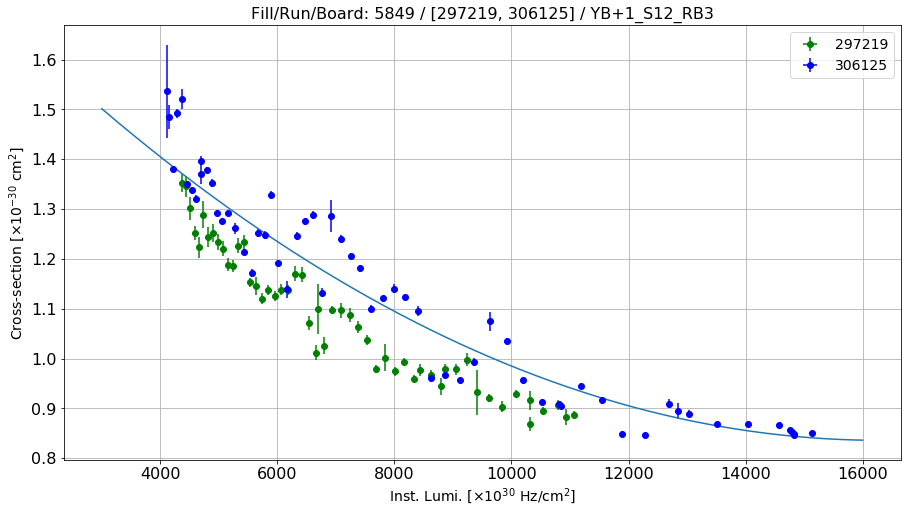

Linear fit parameters: [5.76612985e-01 3.99739818e+03]


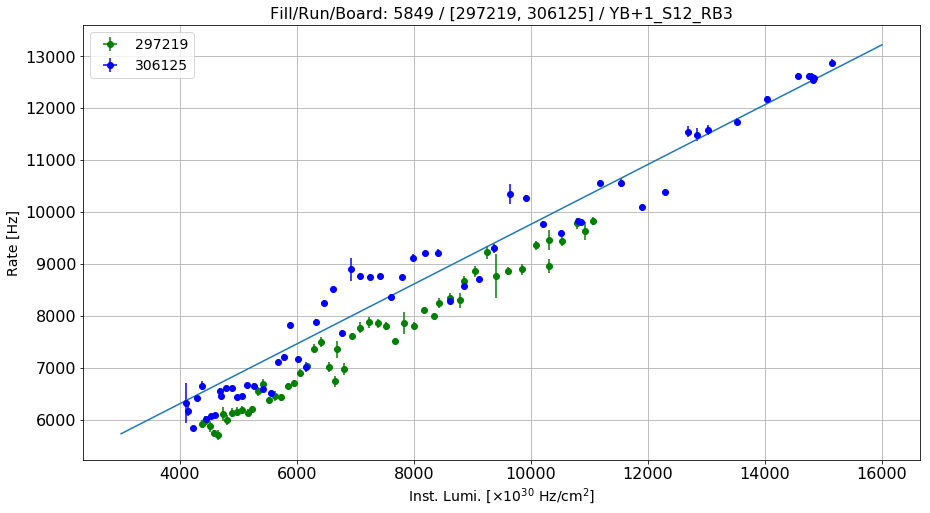

Fill/Run/Board: 5849 / [297219, 306125] / YB+1_S12_RB4
Linear fit for the reference run: [ 3.59259538e-09 -1.35923763e-04  1.07081346e+01]


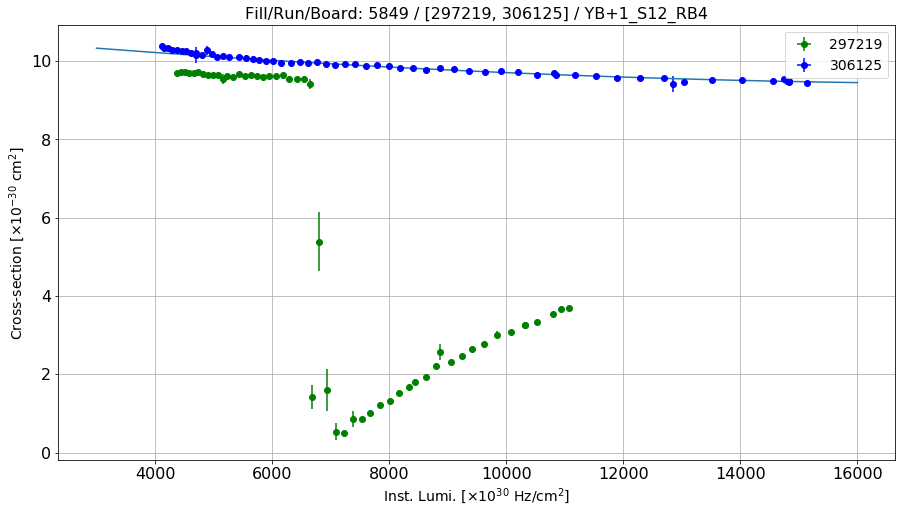

Linear fit parameters: [   9.13343496 5475.05090027]


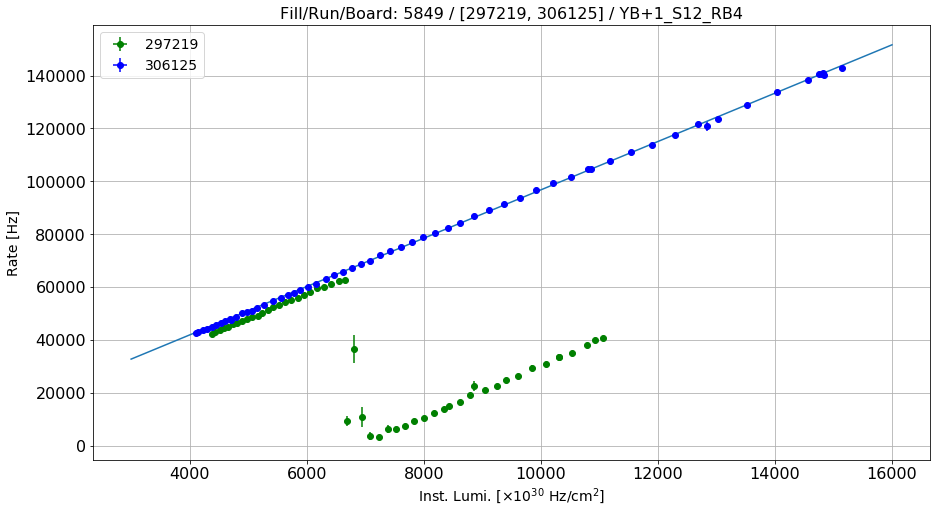

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S1_RB1
Linear fit for the reference run: [ 3.07192590e-09 -1.37273501e-04  3.65444300e+01]


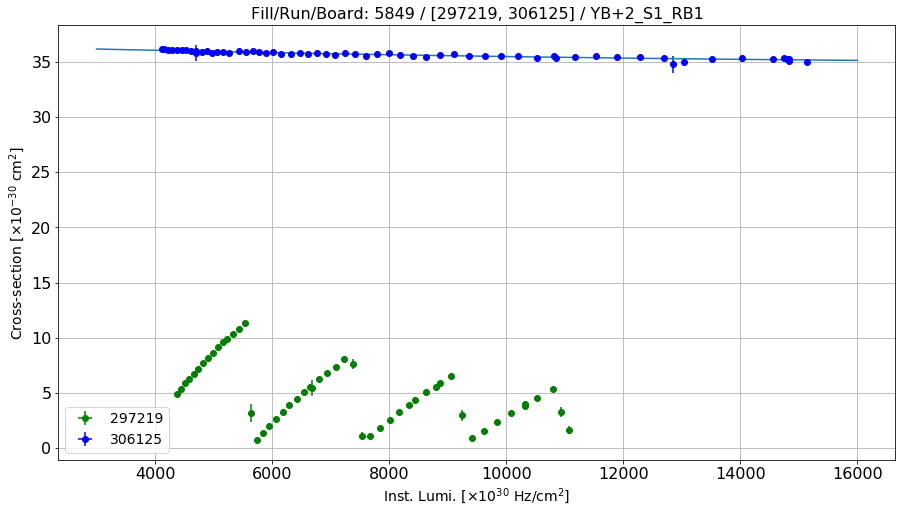

Linear fit parameters: [  34.78061285 6537.60635378]


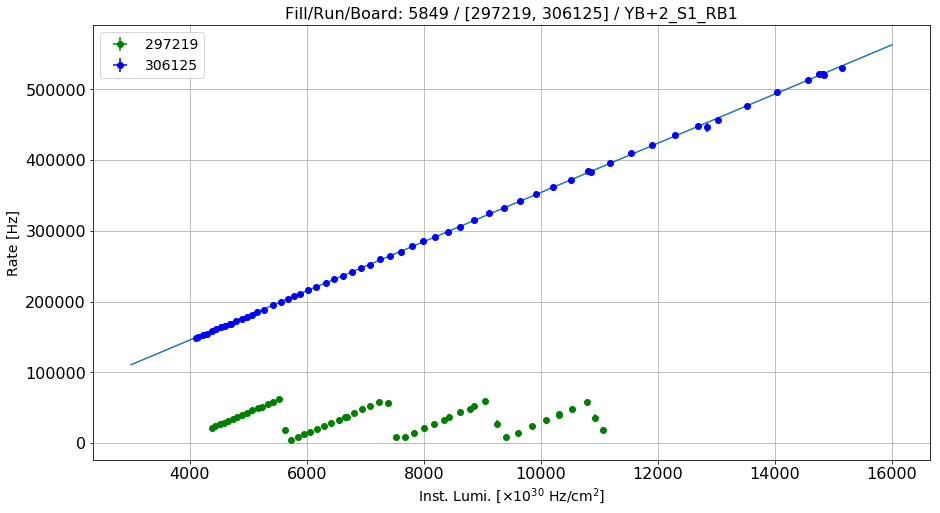

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S1_RB2
Linear fit for the reference run: [ 4.56545553e-08 -7.62746105e-04  1.42793401e+01]


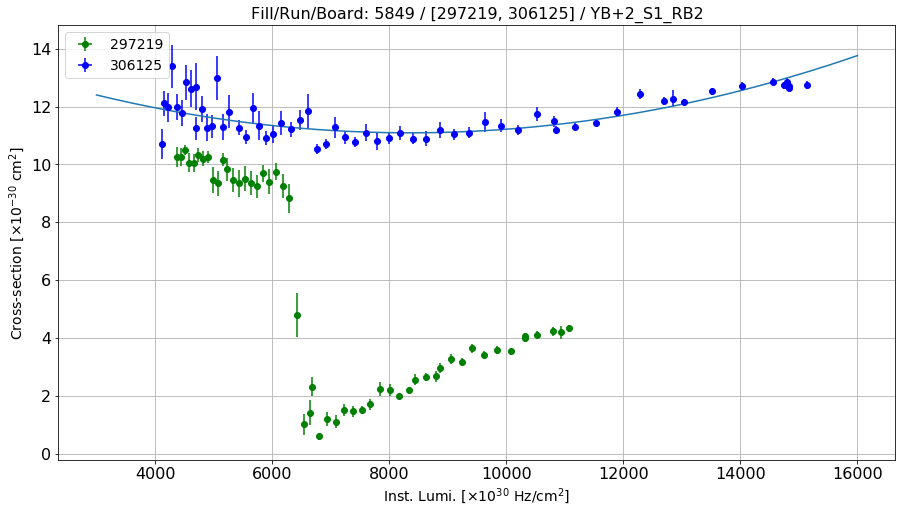

Linear fit parameters: [ 1.33925342e+01 -1.54764880e+04]


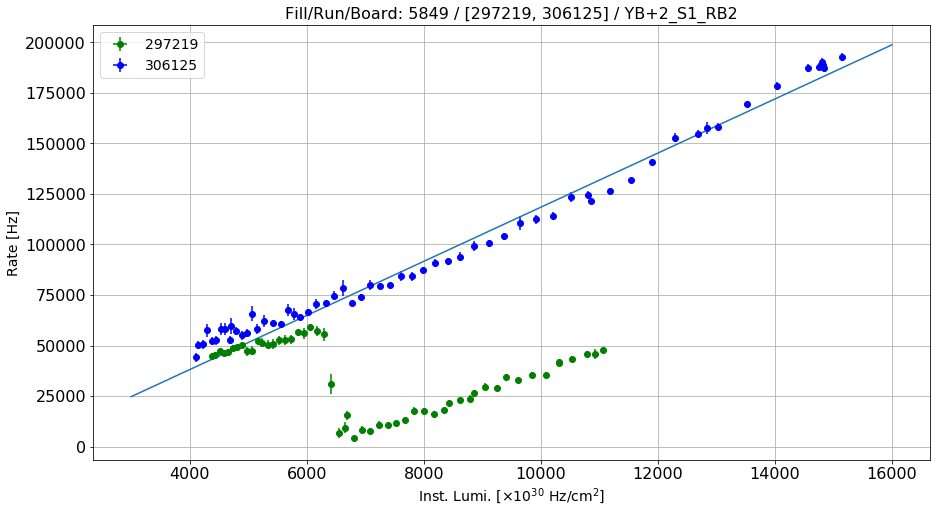

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S1_RB3
Linear fit for the reference run: [ 3.23573744e-08 -8.07275564e-04  7.91395936e+00]


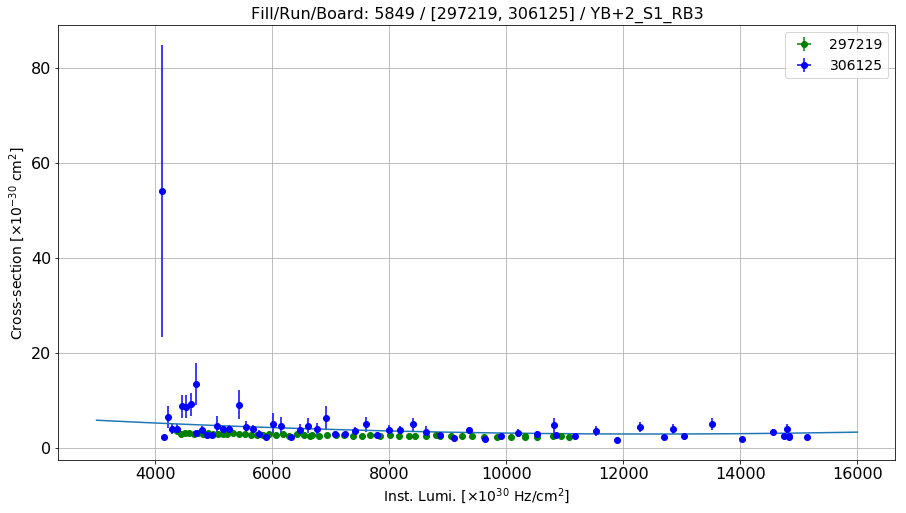

Linear fit parameters: [1.99791370e+00 1.25466944e+04]


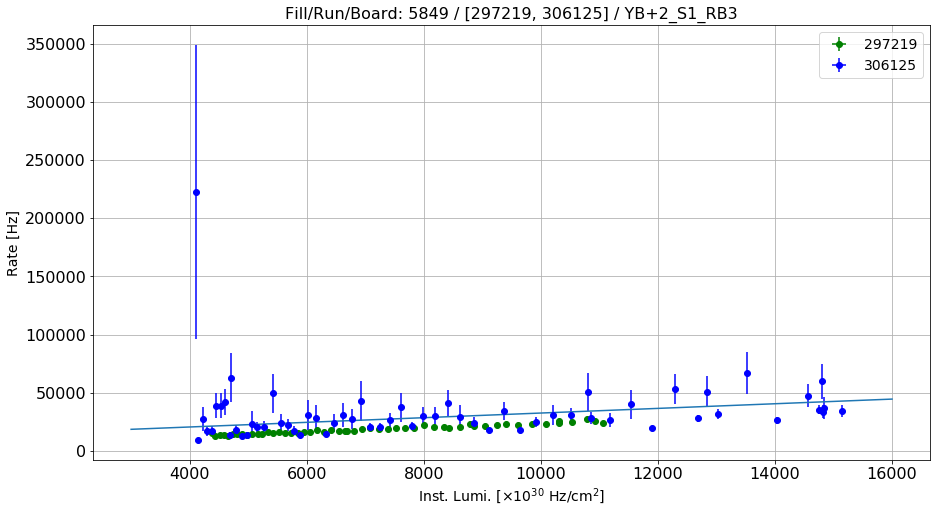

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S1_RB4
Linear fit for the reference run: [-5.39443099e-10 -1.91266959e-04  3.84423896e+01]


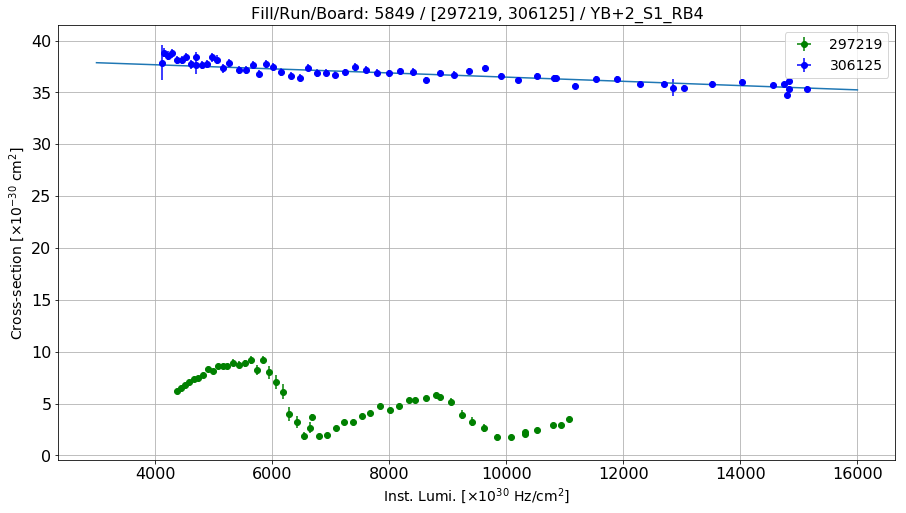

Linear fit parameters: [   34.48194266 17843.01363456]


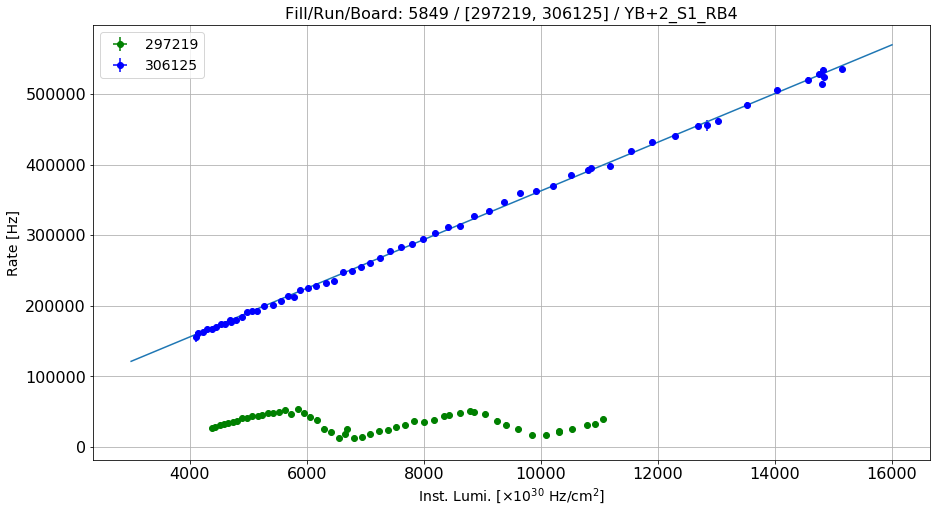

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S2_RB1
Linear fit for the reference run: [ 8.50745091e-09 -3.05421760e-04  3.61401818e+01]


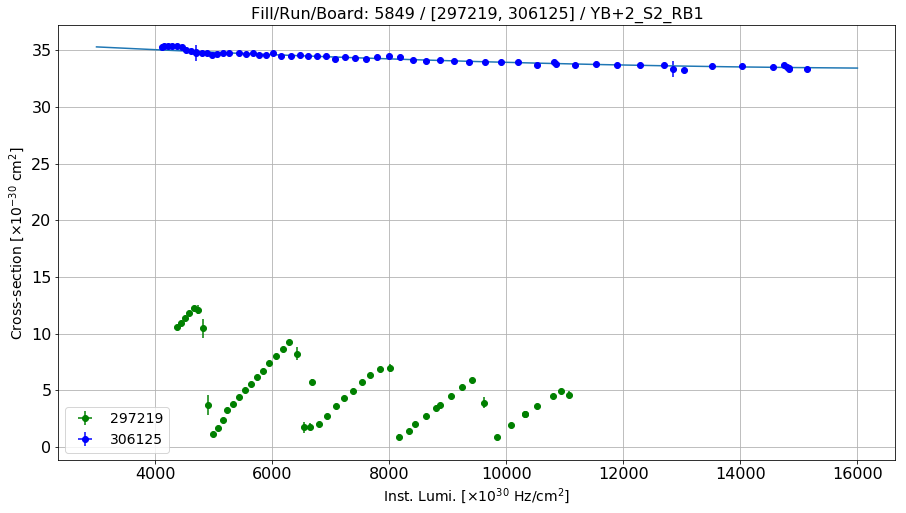

Linear fit parameters: [   32.73741876 11514.4424733 ]


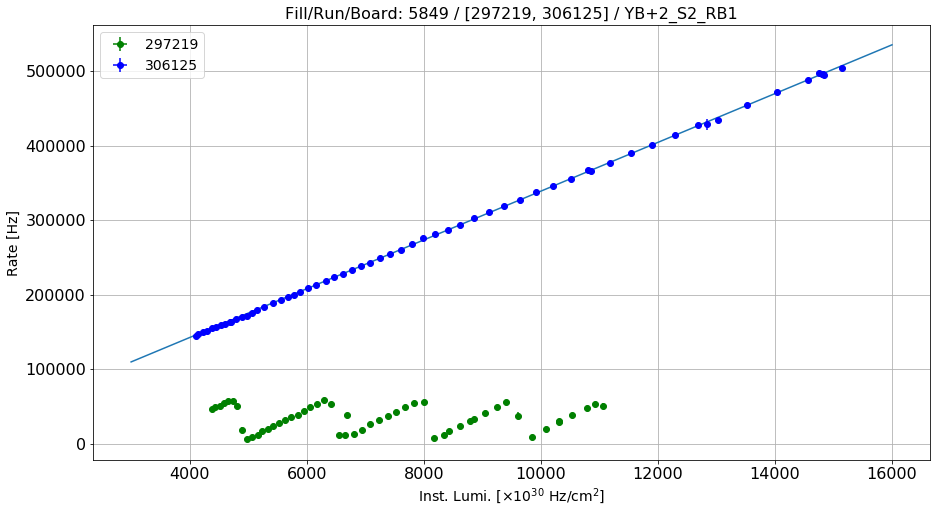

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S2_RB2
Linear fit for the reference run: [ 6.85928428e-09 -1.97060579e-04  1.10090648e+01]


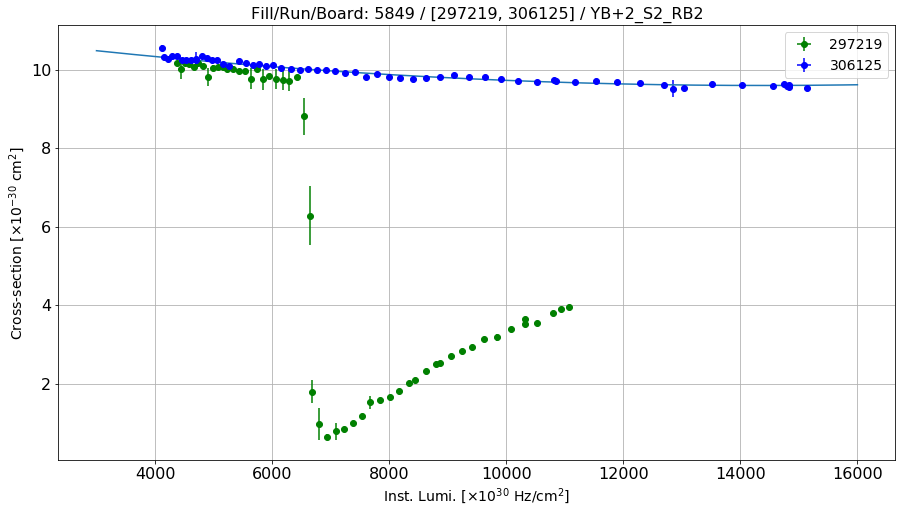

Linear fit parameters: [   9.24083623 4946.16748171]


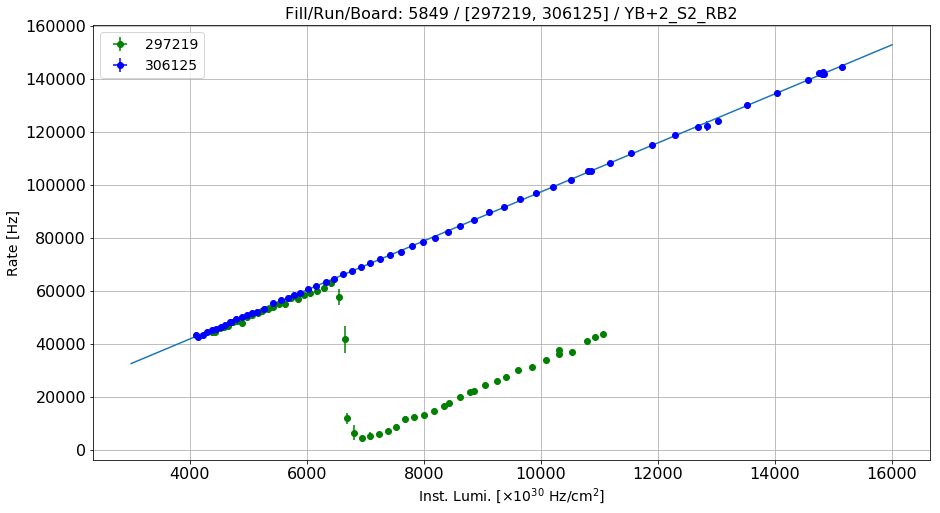

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S2_RB3
Linear fit for the reference run: [ 8.12406794e-09 -2.31983979e-04  3.57449085e+00]


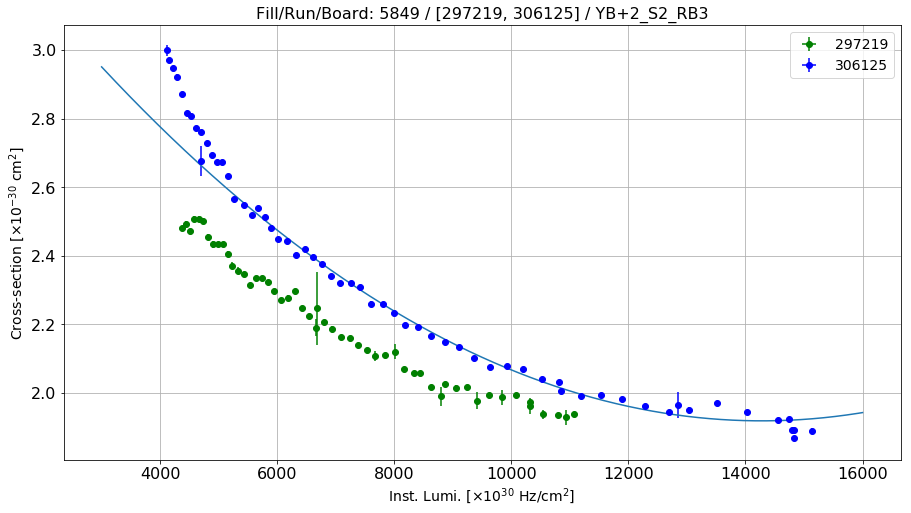

Linear fit parameters: [1.50822618e+00 5.73363118e+03]


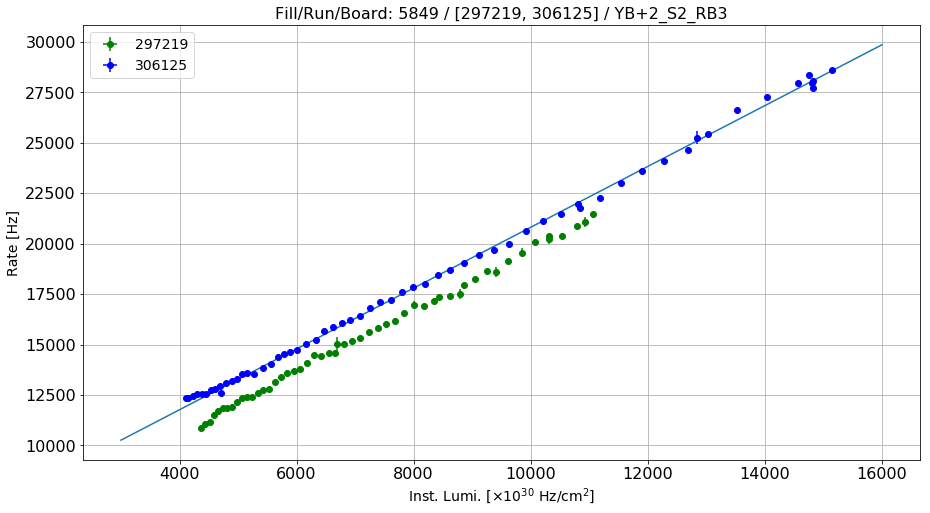

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S2_RB4
Linear fit for the reference run: [ 2.43632743e-08 -1.18721365e-03  5.03963328e+01]


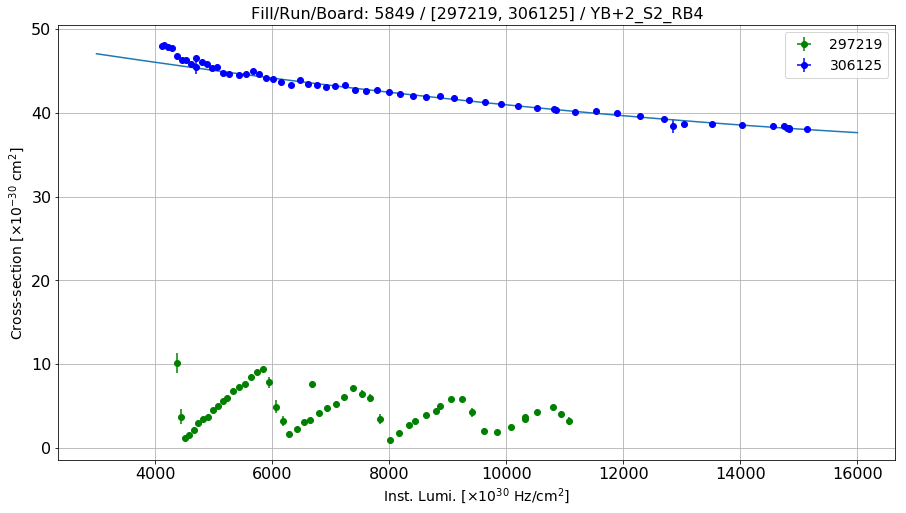

Linear fit parameters: [3.44545429e+01 6.05353344e+04]


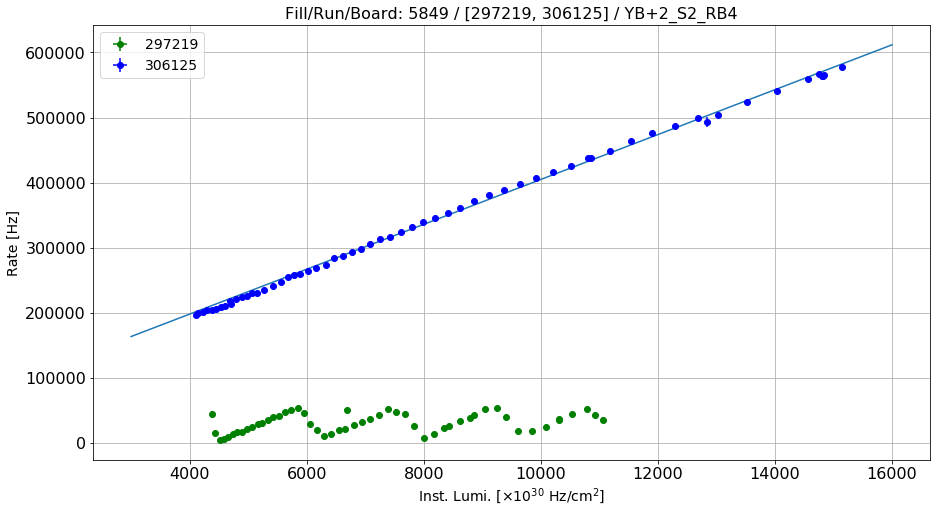

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S3_RB1
Linear fit for the reference run: [ 2.37059062e-08 -7.52821778e-04  4.54321984e+01]


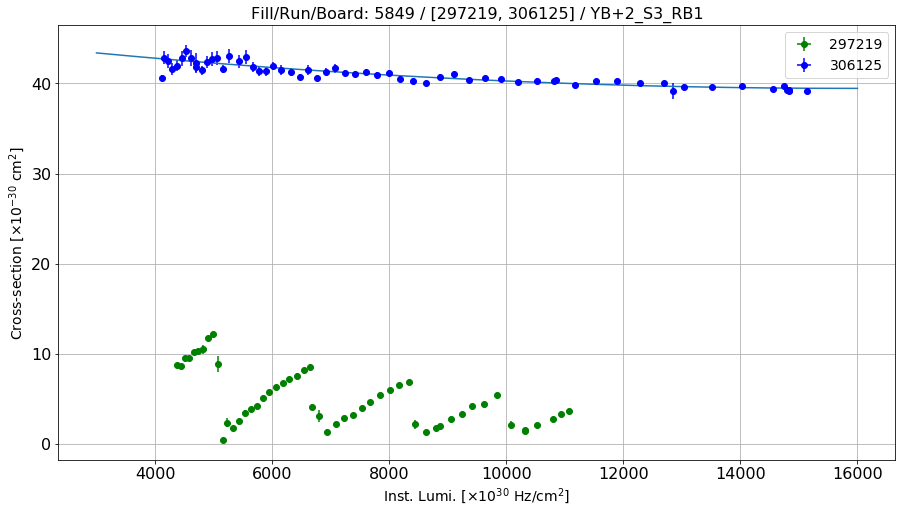

Linear fit parameters: [   37.89808355 23422.97871509]


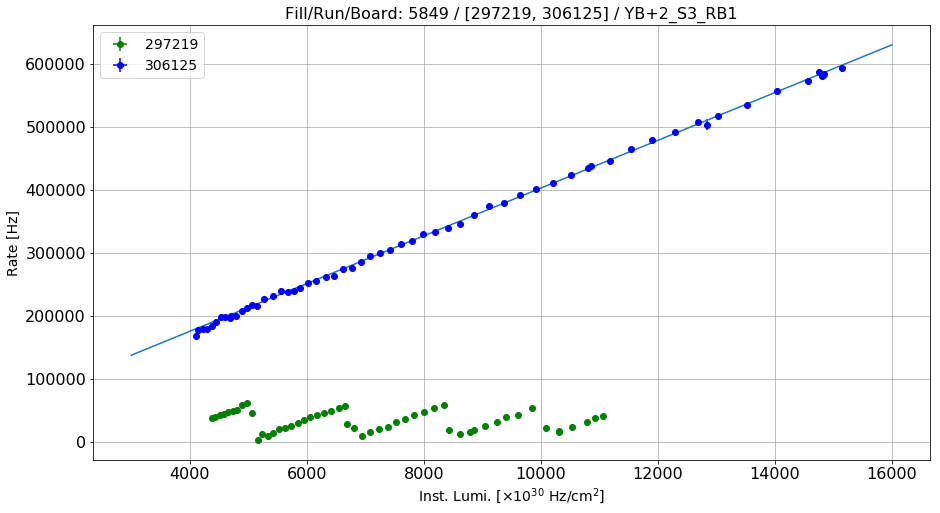

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S3_RB2
Linear fit for the reference run: [ 1.07184632e-06 -3.13837859e-02  2.97114082e+02]


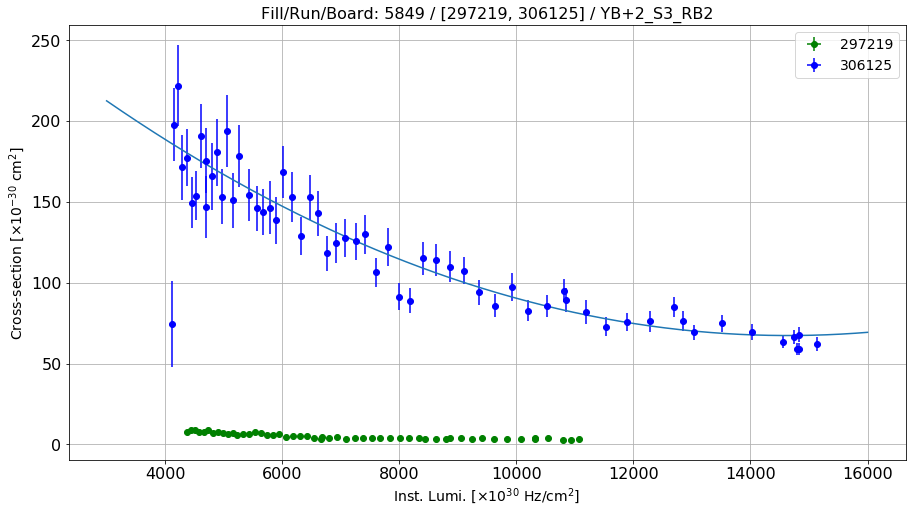

Linear fit parameters: [9.09552707e+00 8.24983481e+05]


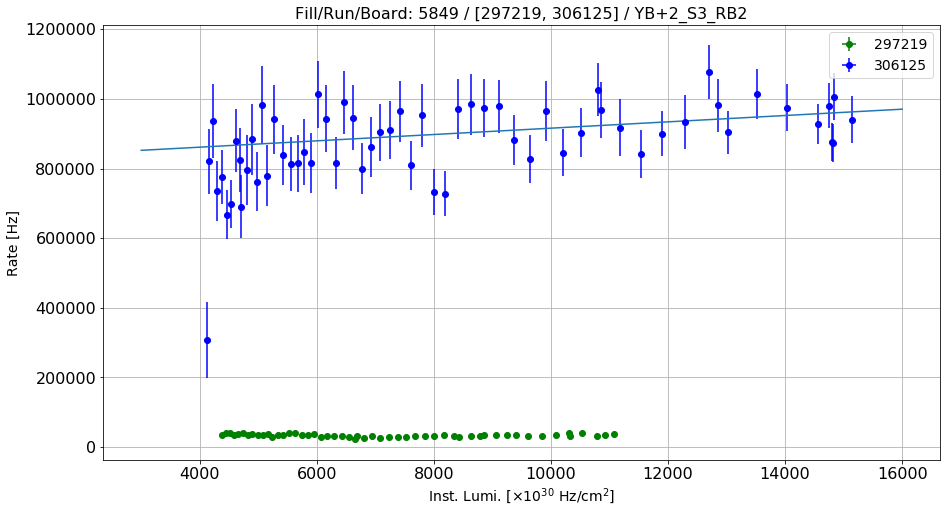

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S3_RB3
Linear fit for the reference run: [ 3.07913677e-09 -9.04711022e-05  2.57177196e+00]


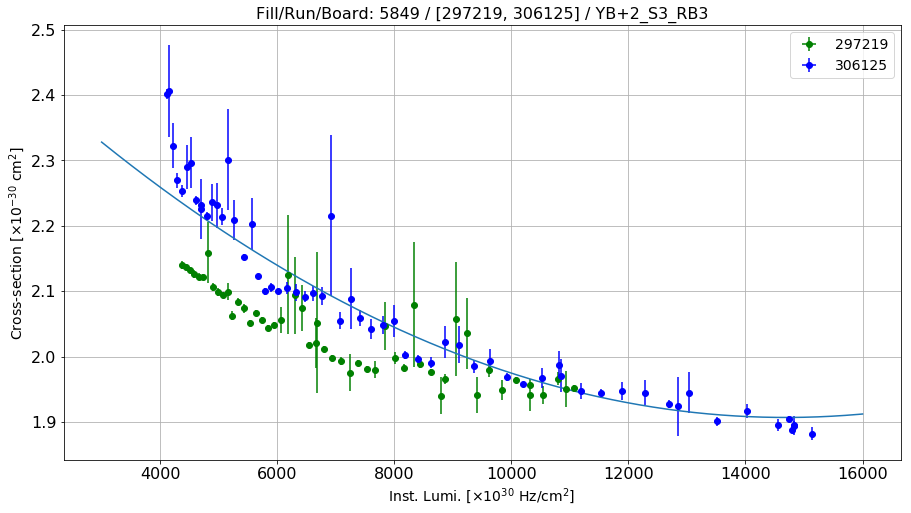

Linear fit parameters: [1.73815121e+00 2.39761777e+03]


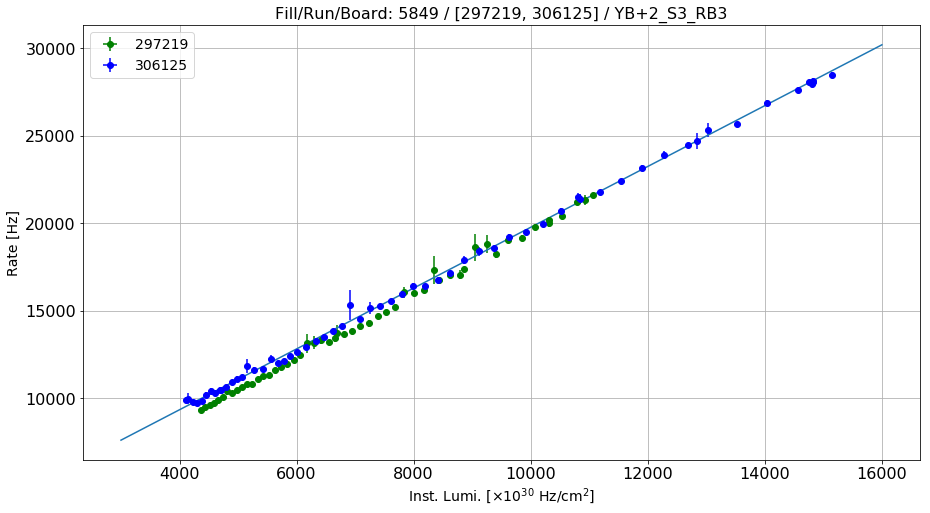

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S3_RB4
Linear fit for the reference run: [ 2.23946890e-08 -7.34446921e-04  4.92752014e+01]


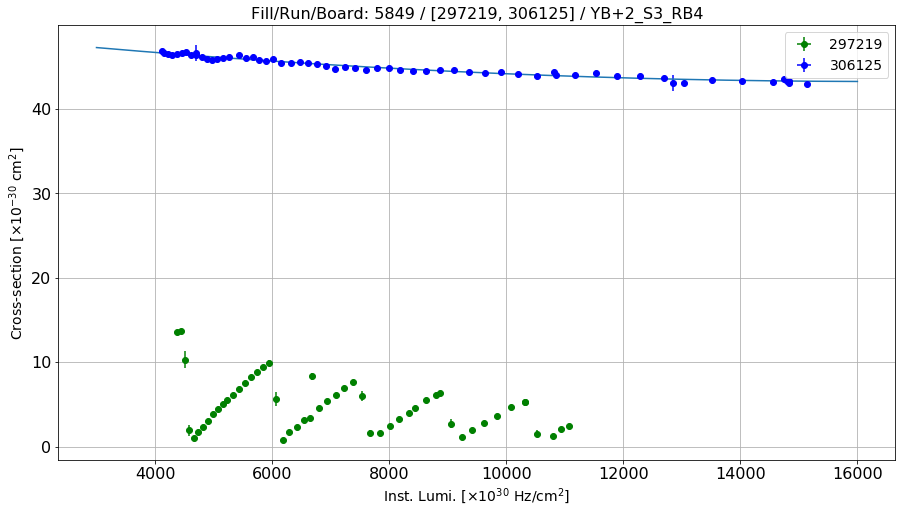

Linear fit parameters: [   41.69653686 24178.87020219]


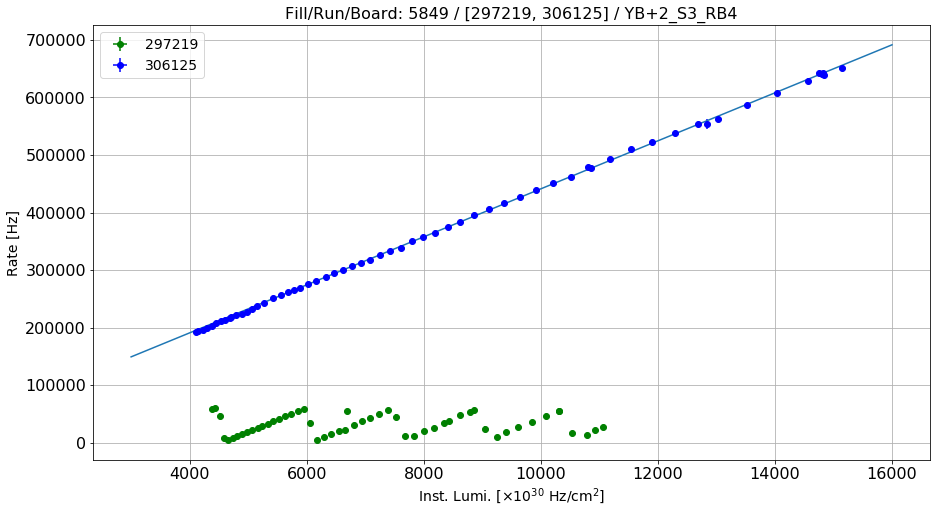

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S4_RB1
Linear fit for the reference run: [ 1.65200118e-08 -5.69425434e-04  4.43257868e+01]


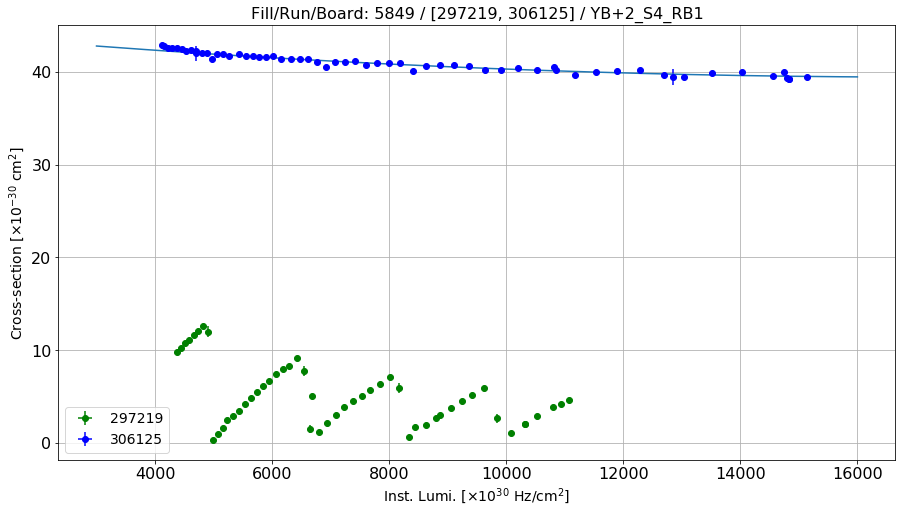

Linear fit parameters: [   38.18713643 20273.56148521]


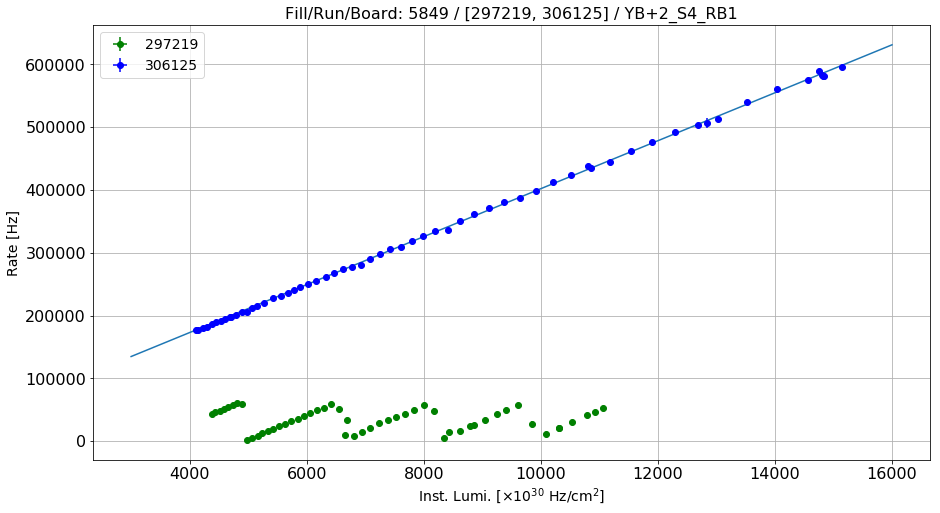

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S4_RB2
Linear fit for the reference run: [ 9.42043673e-09 -2.50364498e-04  1.12066395e+01]


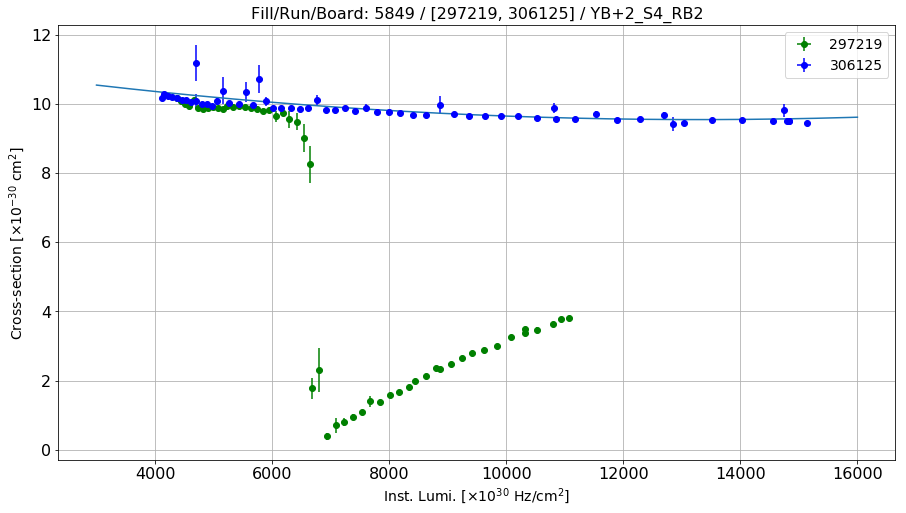

Linear fit parameters: [   9.18018227 5005.14668004]


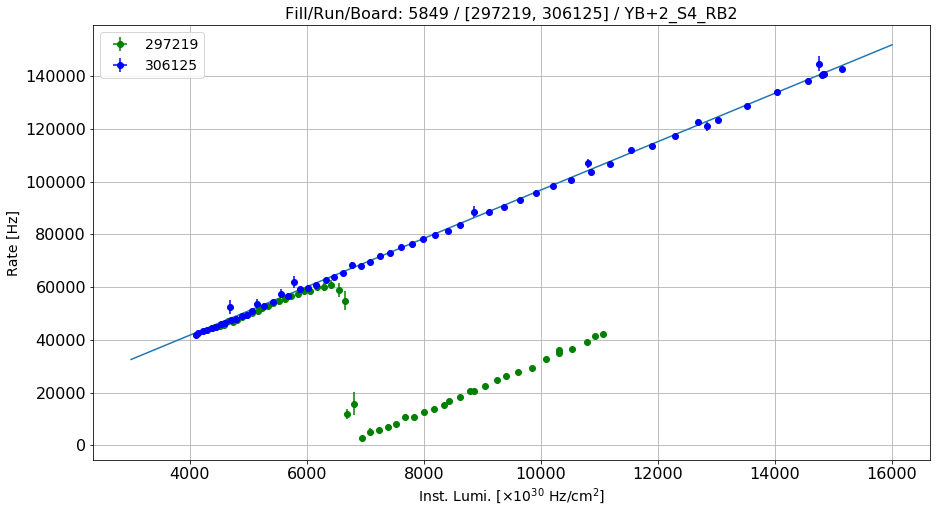

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S4_RB3
Linear fit for the reference run: [ 5.22558695e-09 -1.51155565e-04  2.86604736e+00]


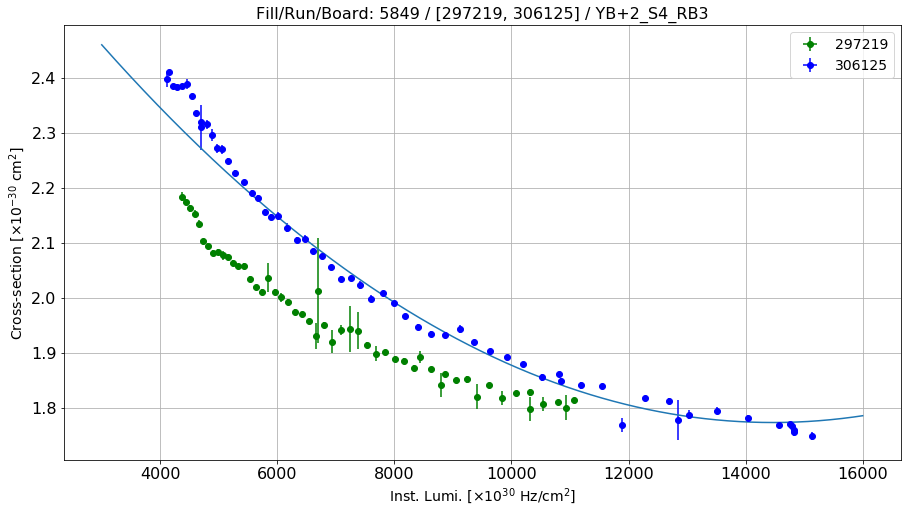

Linear fit parameters: [1.49855101e+00 3.85890419e+03]


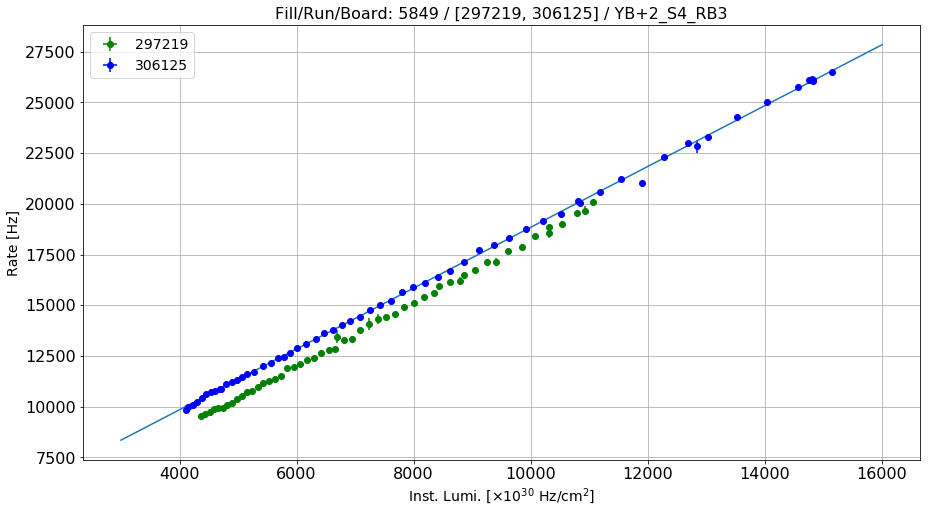

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S4_RB4
Linear fit for the reference run: [ 1.37170919e-08 -4.39723483e-04  4.16749395e+01]


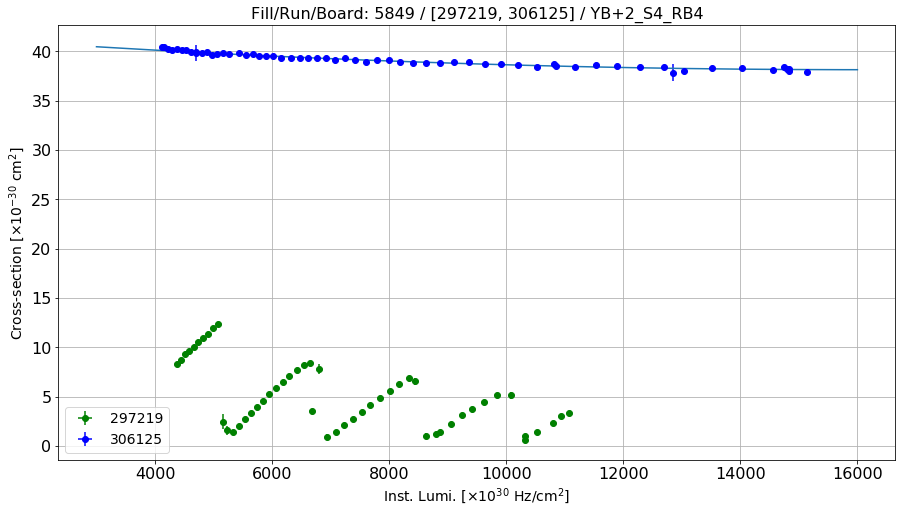

Linear fit parameters: [   37.2338677  13916.11272649]


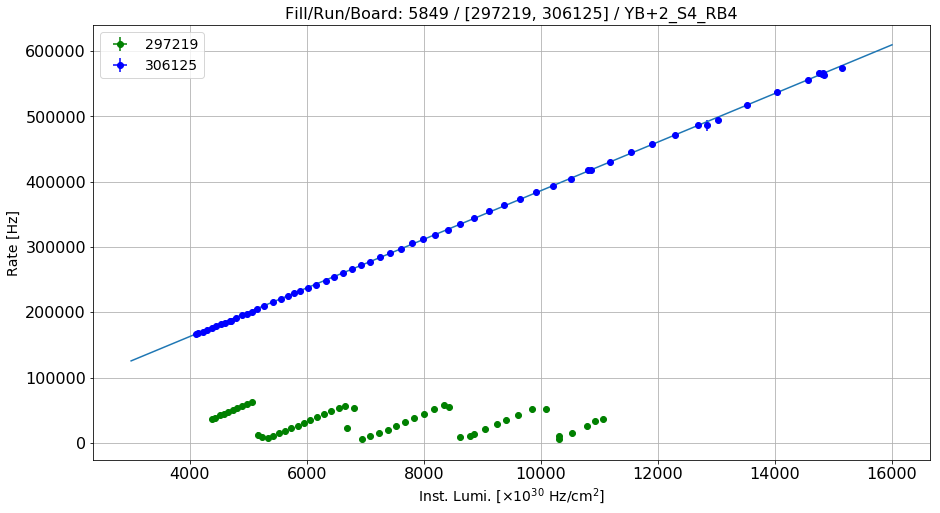

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S5_RB1
Linear fit for the reference run: [ 2.24300209e-08 -7.12631199e-04  4.58032058e+01]


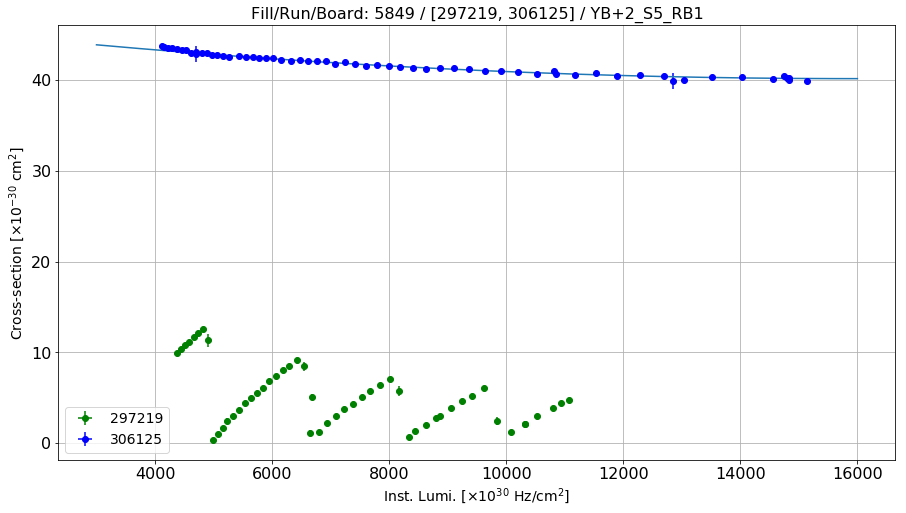

Linear fit parameters: [   38.6680973  22191.18585145]


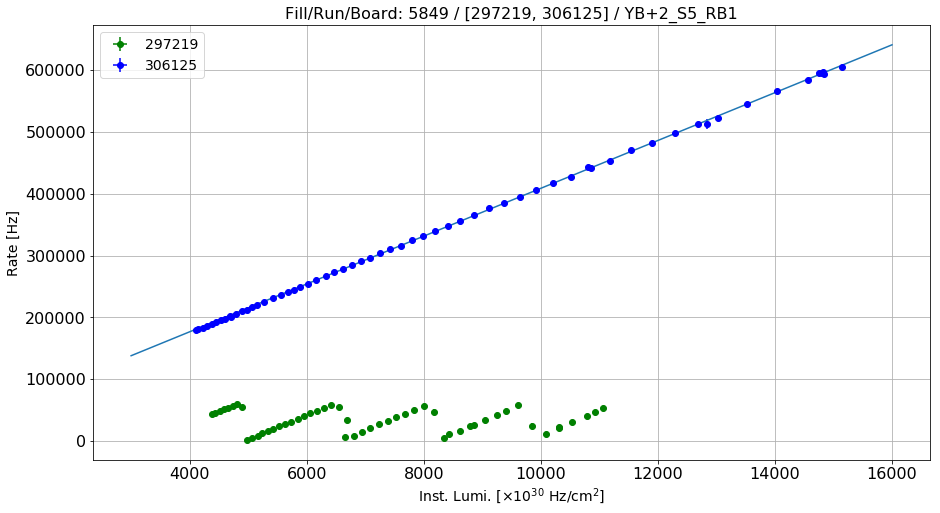

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S5_RB2
Linear fit for the reference run: [ 3.16404314e-08 -7.13425675e-04  1.39515518e+01]


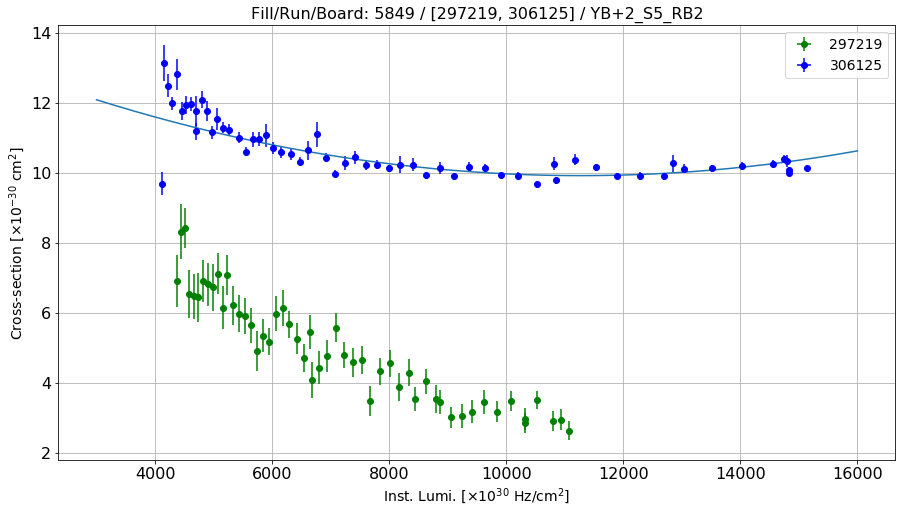

Linear fit parameters: [   9.67270249 5570.4590602 ]


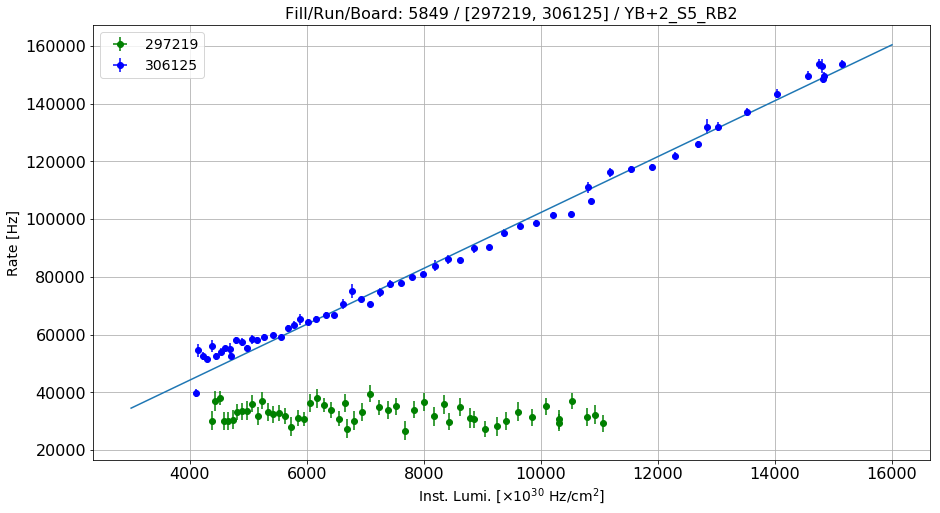

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S5_RB3
Linear fit for the reference run: [ 4.09511508e-09 -1.38776777e-04  3.13980538e+00]


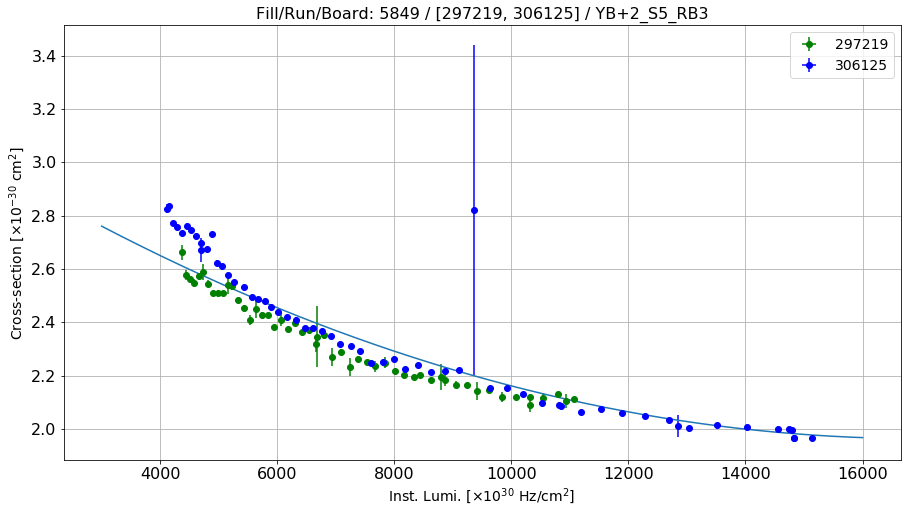

Linear fit parameters: [1.66523608e+00 4.81597419e+03]


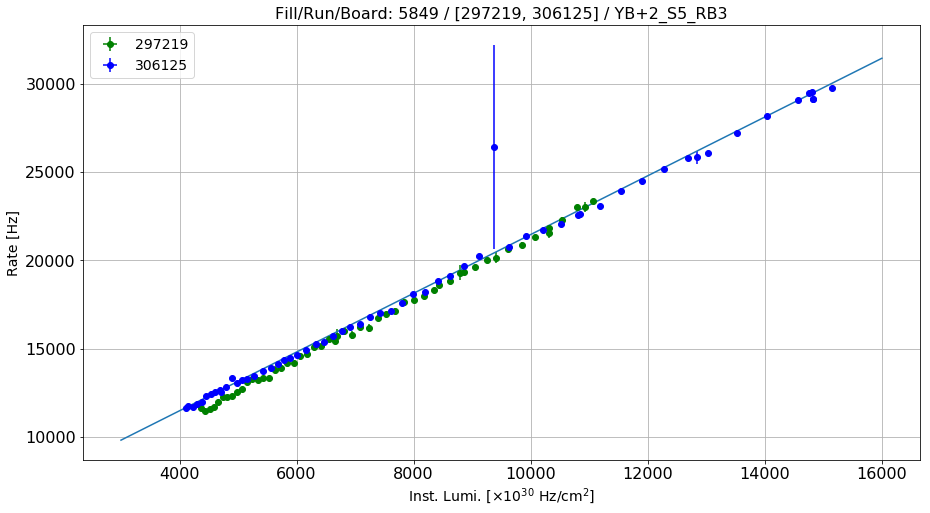

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S5_RB4
Linear fit for the reference run: [ 1.37394011e-08 -5.55864395e-04  5.27121527e+01]


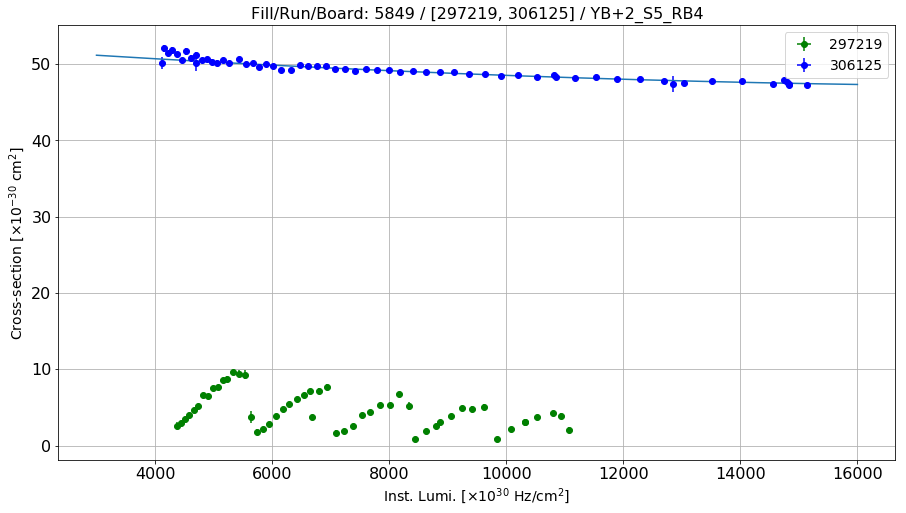

Linear fit parameters: [   45.97531974 24116.70687921]


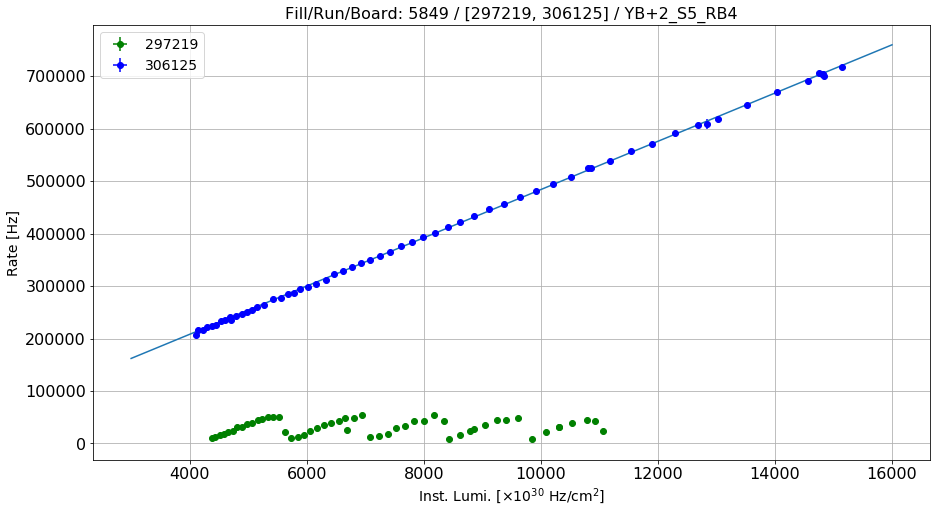

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S6_RB1
Linear fit for the reference run: [ 2.28938579e-09 -2.46938386e-04  4.41396243e+01]


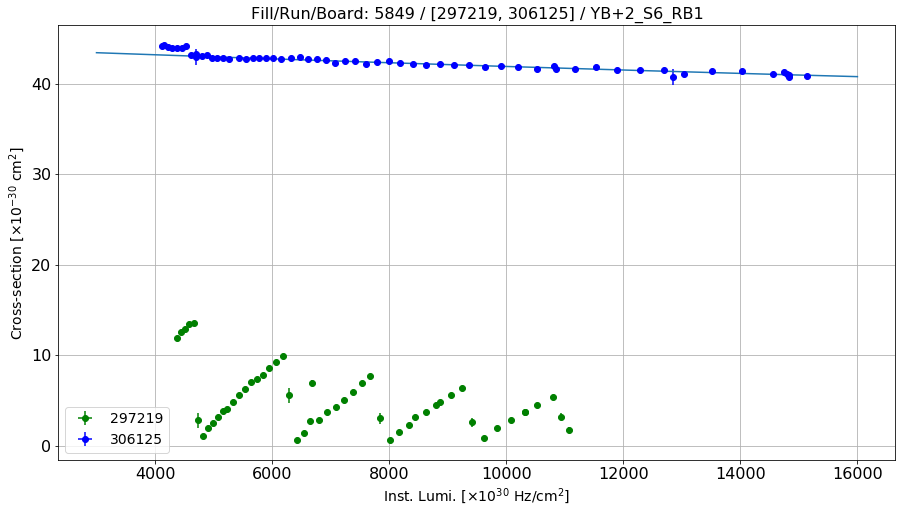

Linear fit parameters: [   39.9574757  17625.68002502]


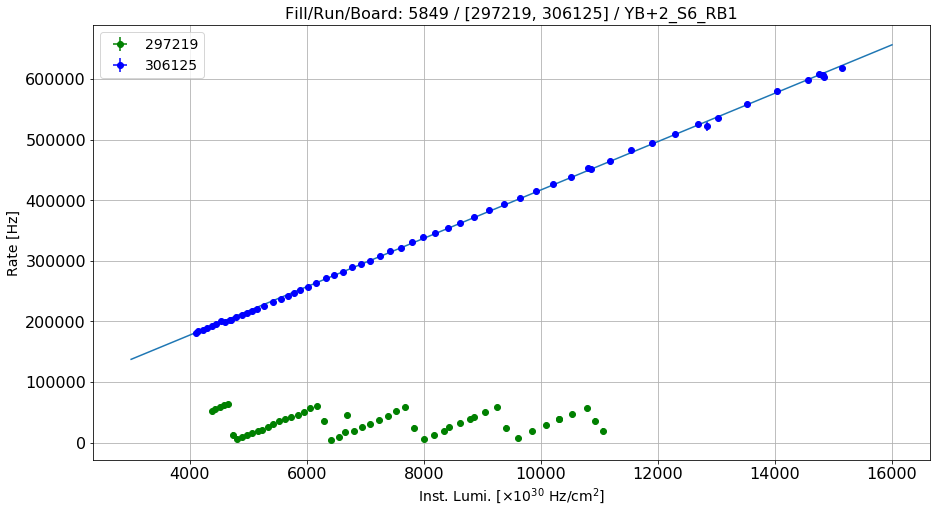

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S6_RB2
Linear fit for the reference run: [ 4.70831131e-09 -1.48941015e-04  1.08805641e+01]


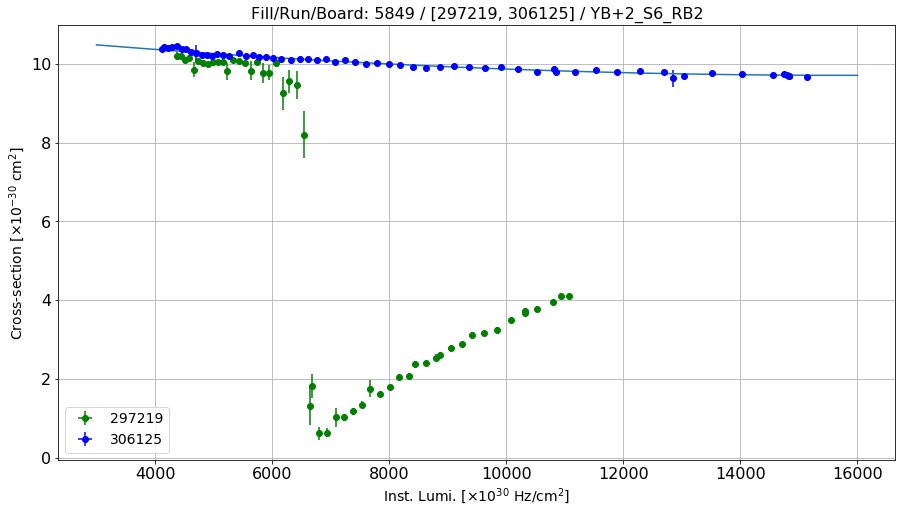

Linear fit parameters: [   9.39567743 4601.01922488]


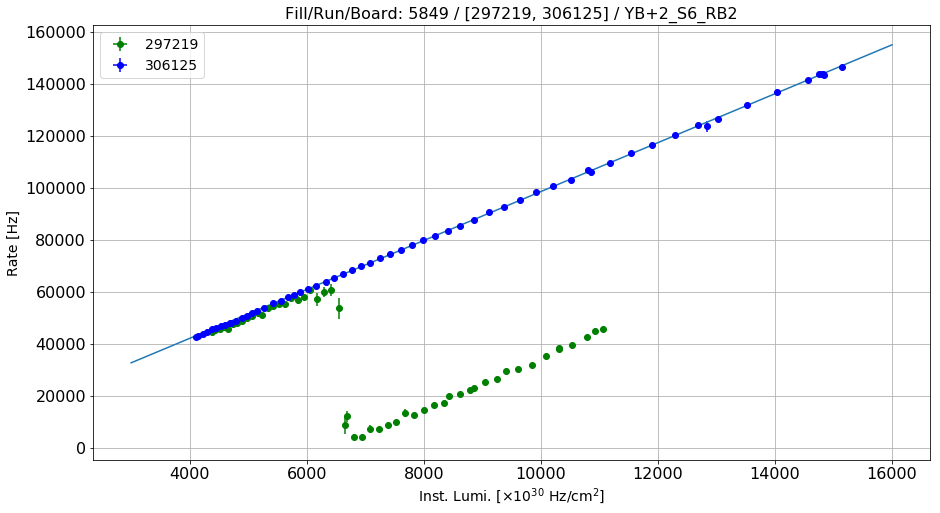

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S6_RB3
Linear fit for the reference run: [ 6.06251549e-09 -1.73536396e-04  2.94828817e+00]


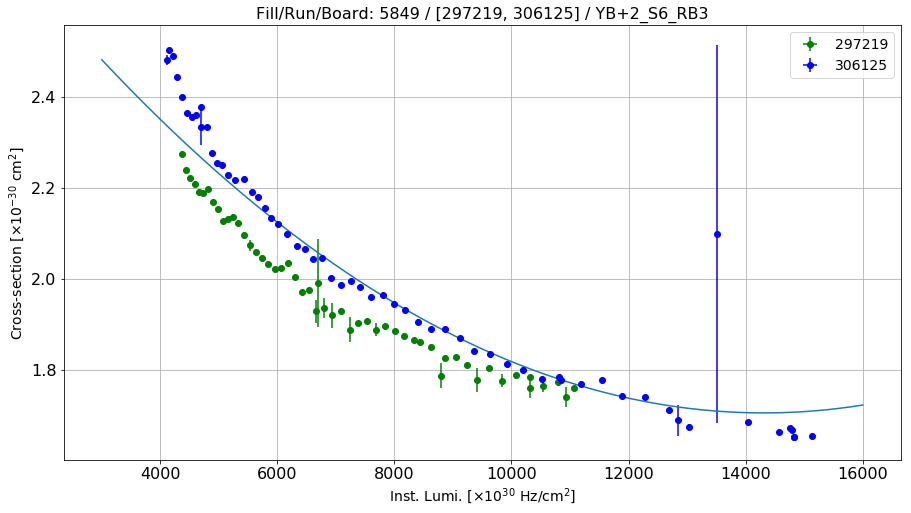

Linear fit parameters: [1.39802164e+00 4.31573875e+03]


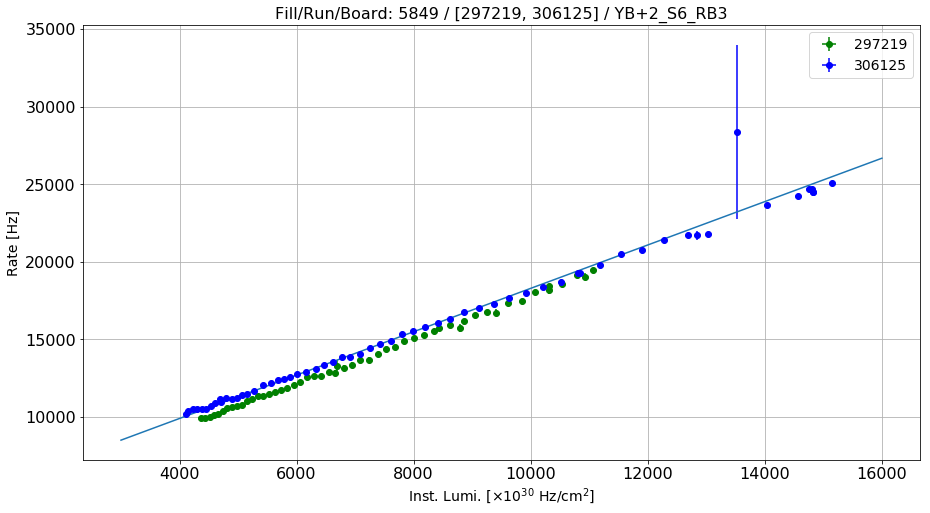

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S6_RB4
Linear fit for the reference run: [ 2.56309874e-08 -8.45038669e-04  4.21829558e+01]


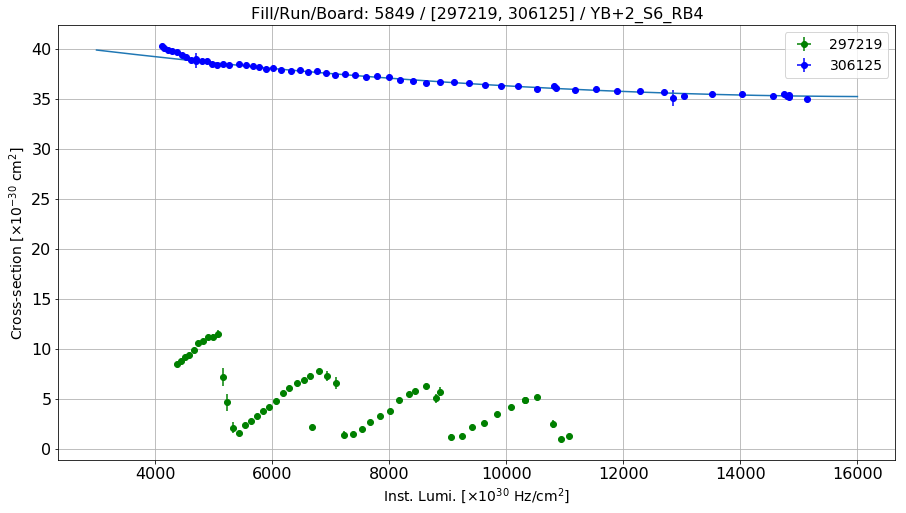

Linear fit parameters: [   33.42074639 28065.87461848]


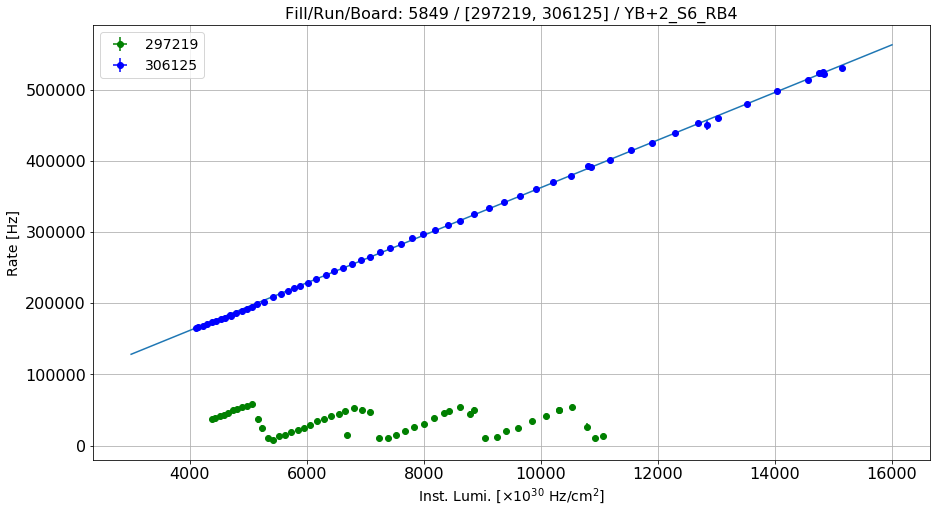

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S7_RB1
Linear fit for the reference run: [ 1.69639701e-08 -5.41552088e-04  4.57960856e+01]


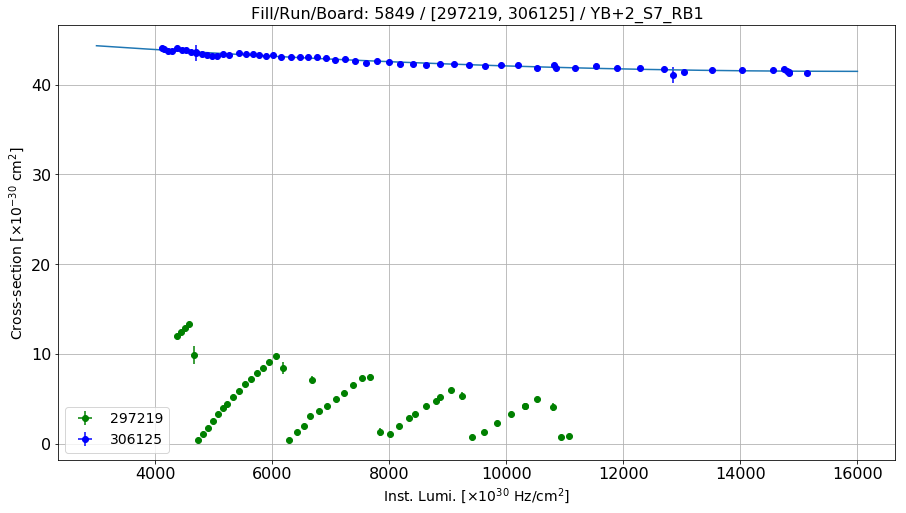

Linear fit parameters: [   40.34851422 17011.23210242]


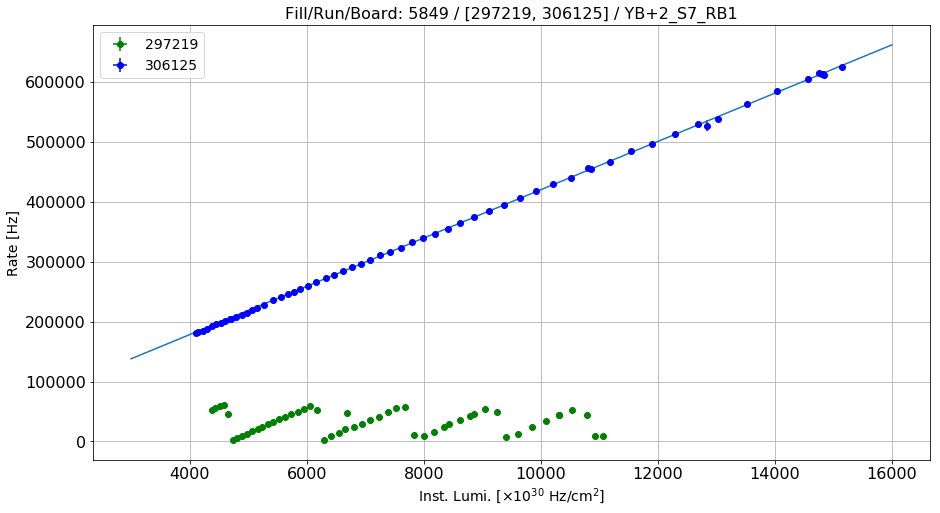

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S7_RB2
Linear fit for the reference run: [ 4.50064922e-09 -1.19499629e-04  1.06977531e+01]


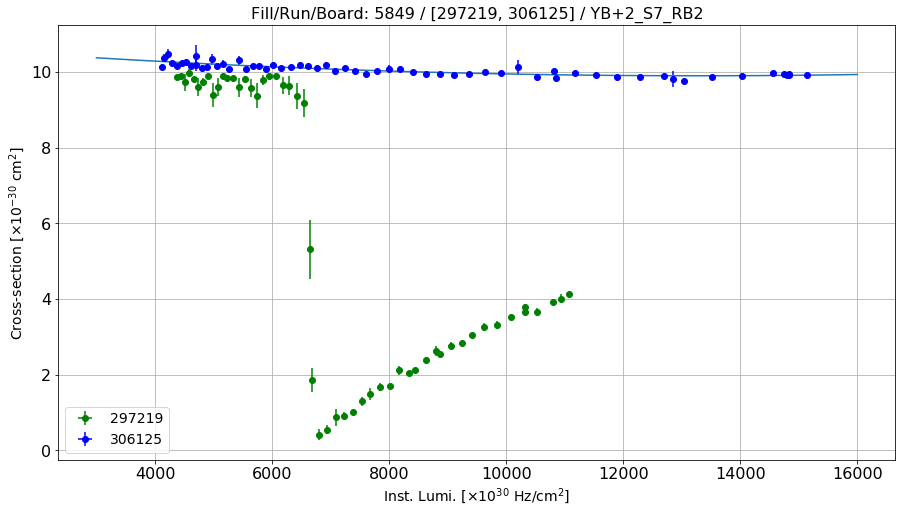

Linear fit parameters: [   9.73184501 2381.26760757]


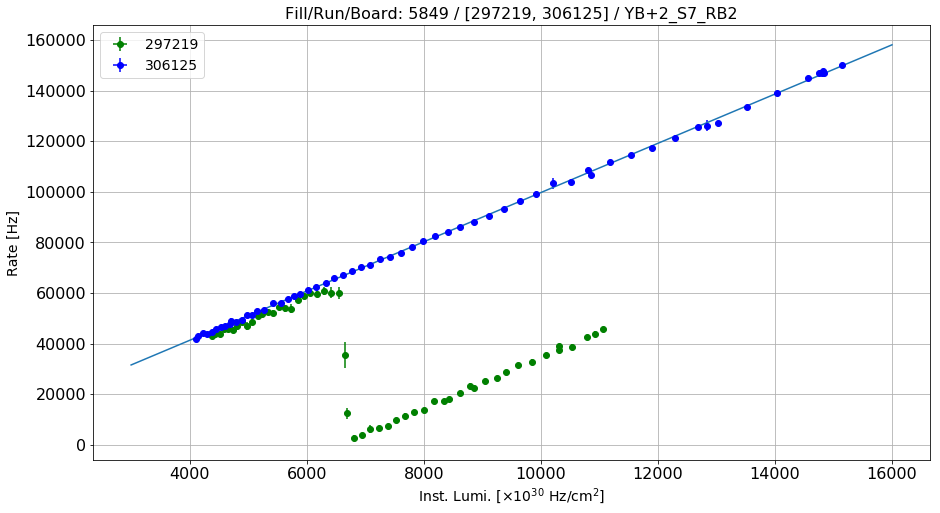

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S7_RB3
Linear fit for the reference run: [ 5.83759927e-09 -1.47265079e-04  2.35300465e+00]


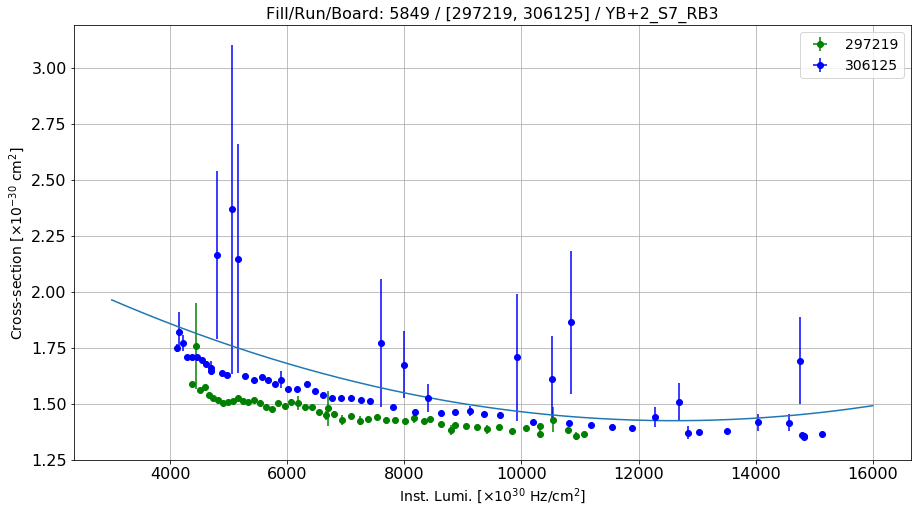

Linear fit parameters: [1.25348379e+00 2.40678337e+03]


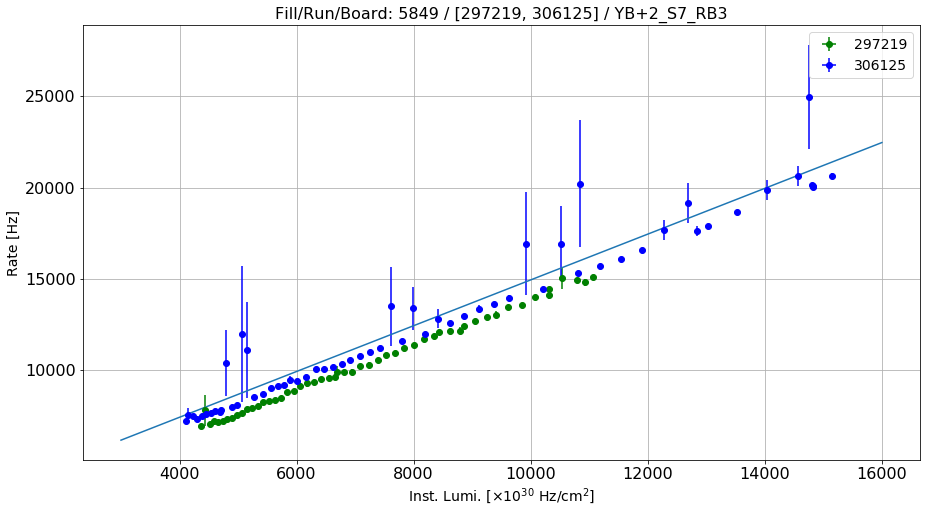

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S7_RB4
Linear fit for the reference run: [ 7.16872788e-09 -2.55751694e-04  2.94253680e+01]


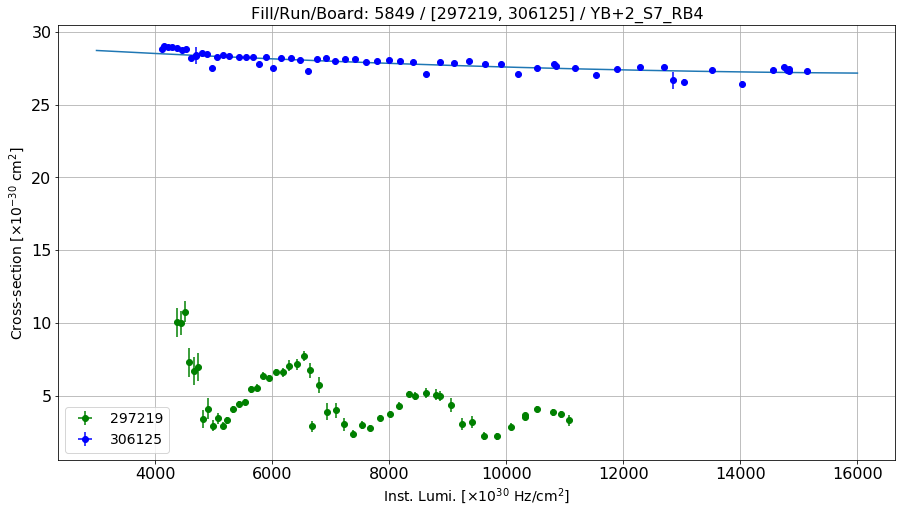

Linear fit parameters: [  26.58996618 9560.64402579]


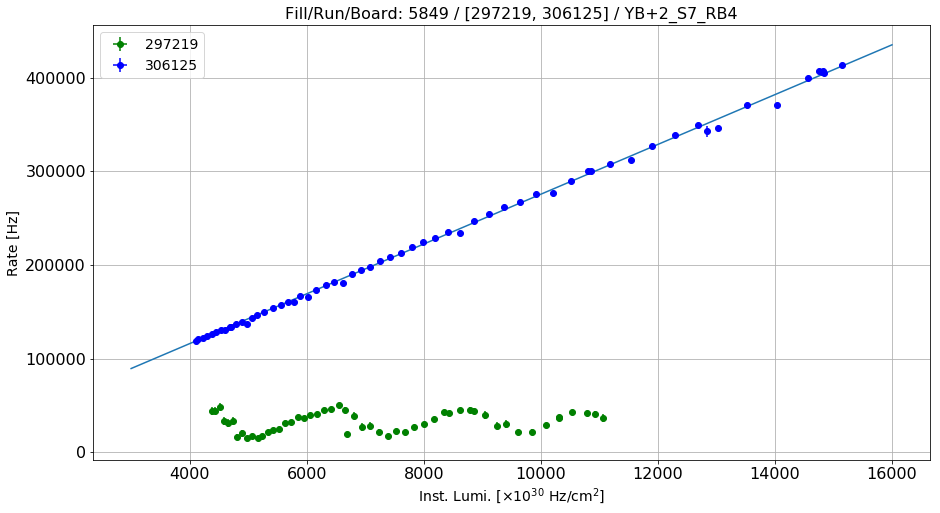

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S8_RB1
Linear fit for the reference run: [ 2.51767981e-07 -7.74164140e-03  1.17764324e+02]


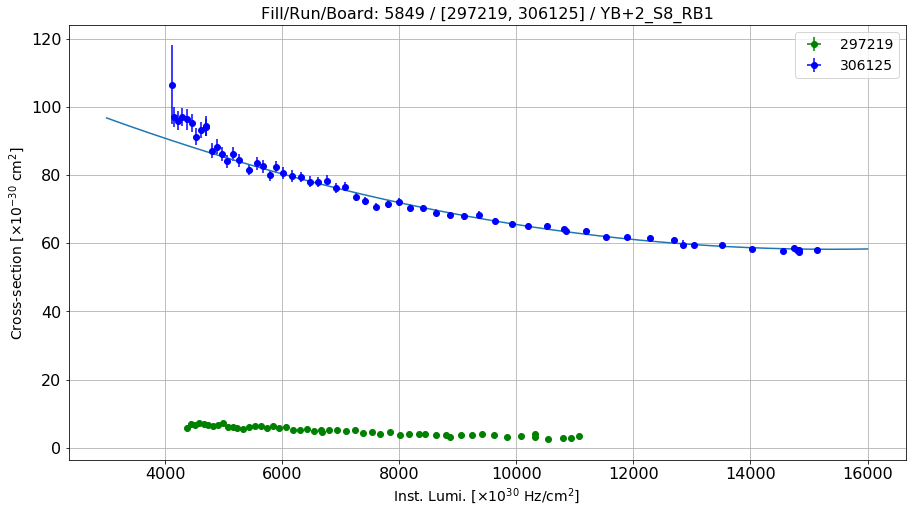

Linear fit parameters: [4.27782094e+01 2.26393974e+05]


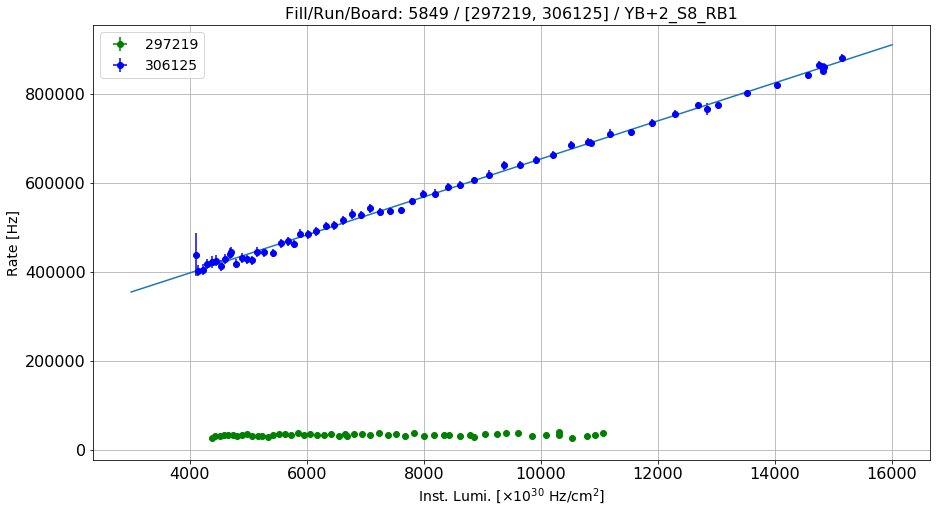

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S8_RB2
Linear fit for the reference run: [ 1.13012889e-07 -3.19841200e-03  3.61608722e+01]


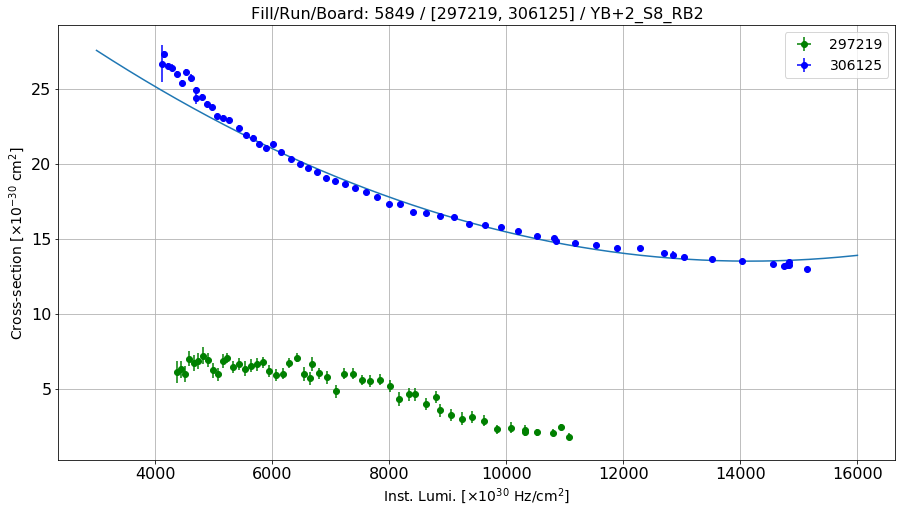

Linear fit parameters: [7.98611871e+00 7.72301864e+04]


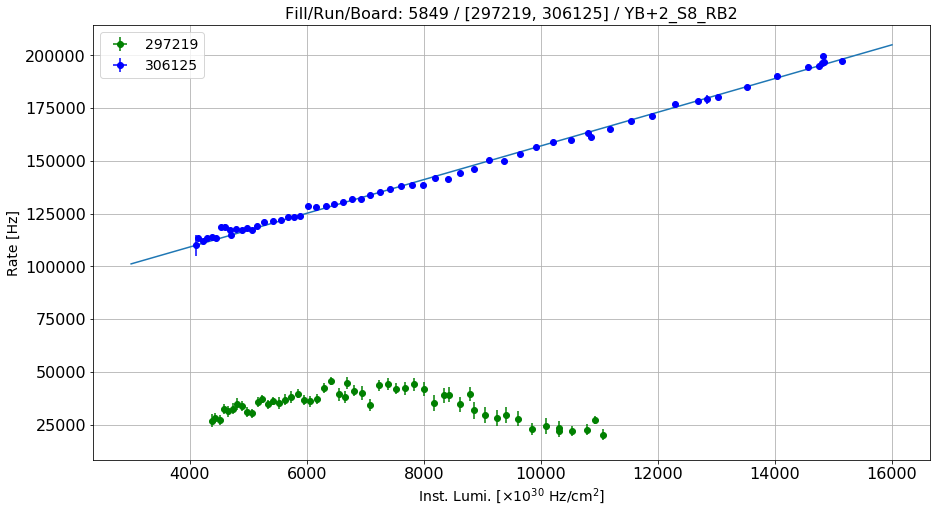

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S8_RB3
Linear fit for the reference run: [ 1.01026539e-08 -2.90842240e-04  3.56234484e+00]


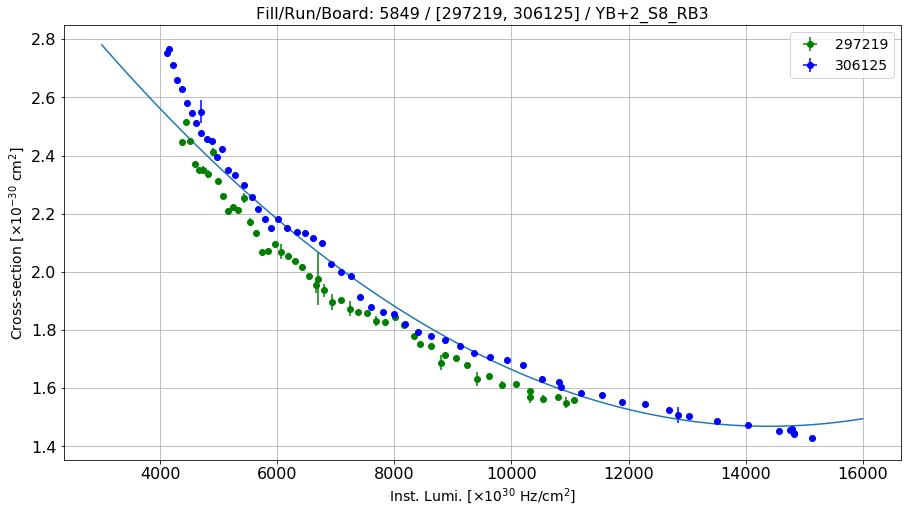

Linear fit parameters: [9.46068723e-01 7.33808531e+03]


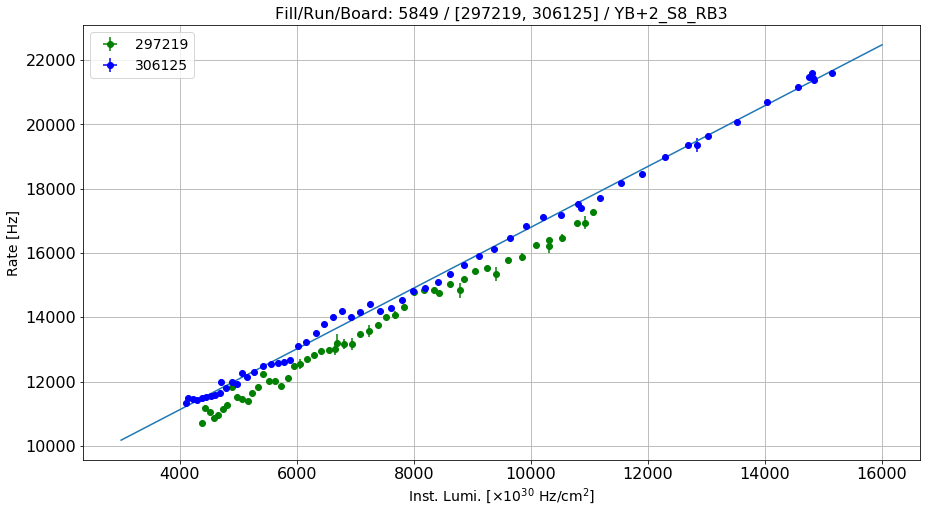

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S8_RB4
Linear fit for the reference run: [ 2.67225046e-09 -9.05695138e-05  1.06513851e+01]


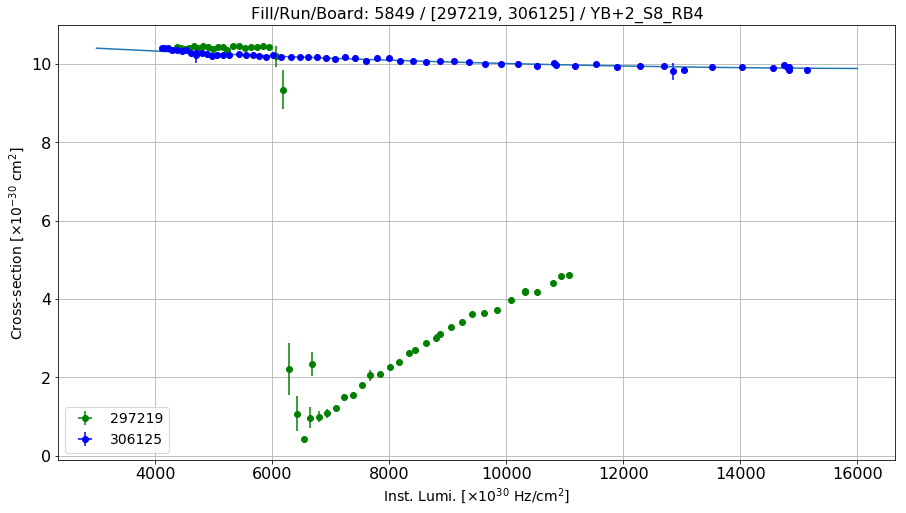

Linear fit parameters: [   9.6889369  3143.64050397]


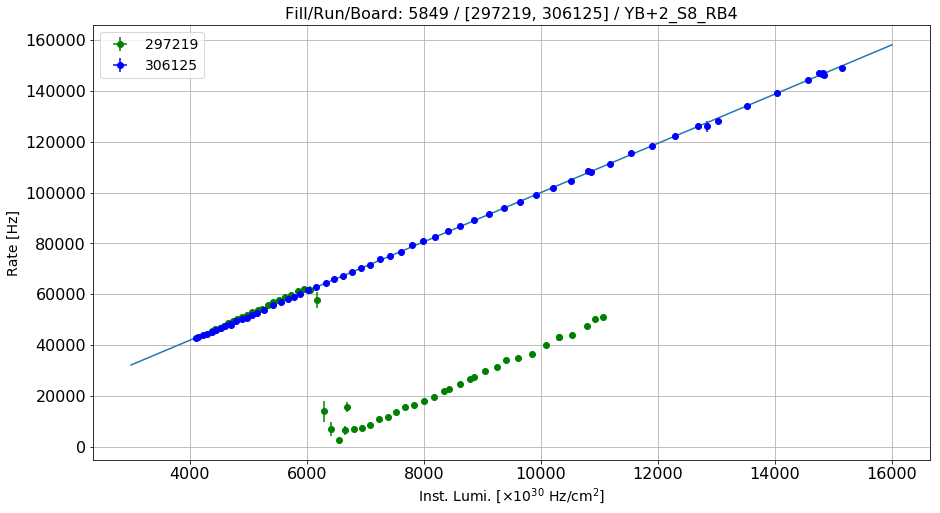

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S9_RB1
Linear fit for the reference run: [ 4.34957919e-08 -1.32428940e-03  5.06237223e+01]


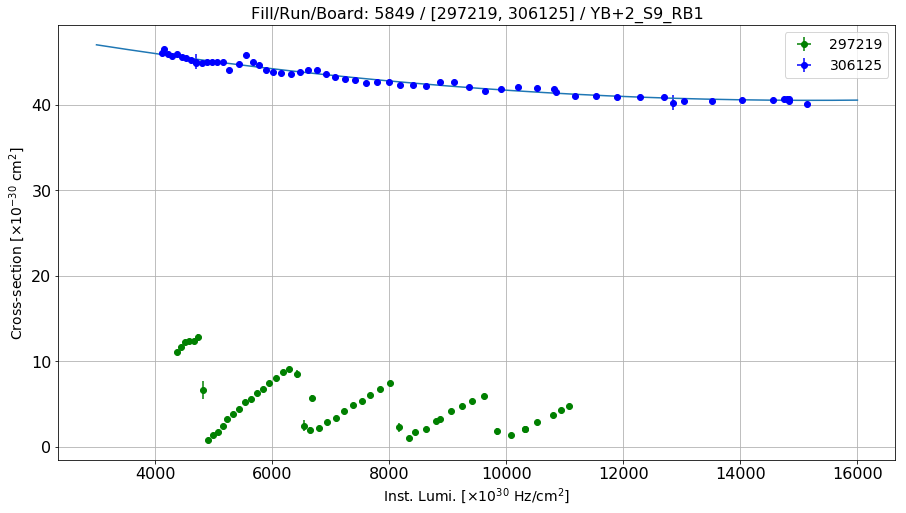

Linear fit parameters: [3.79300863e+01 3.79510650e+04]


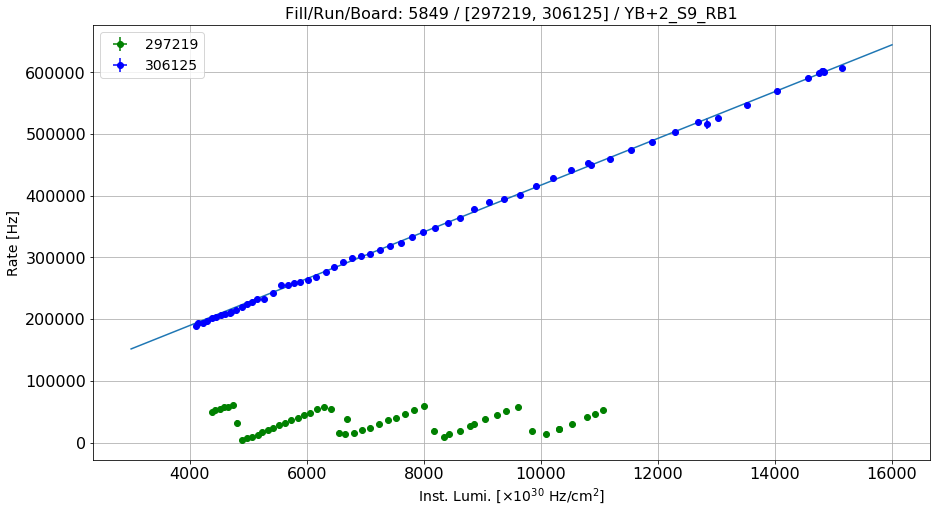

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S9_RB2
Linear fit for the reference run: [ 1.88359492e-08 -5.80331783e-04  1.56428844e+01]


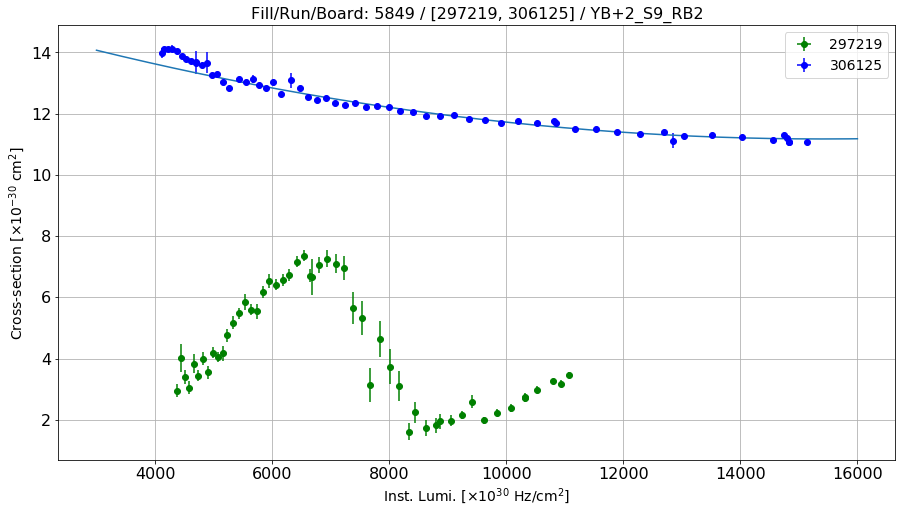

Linear fit parameters: [1.00101555e+01 1.70383965e+04]


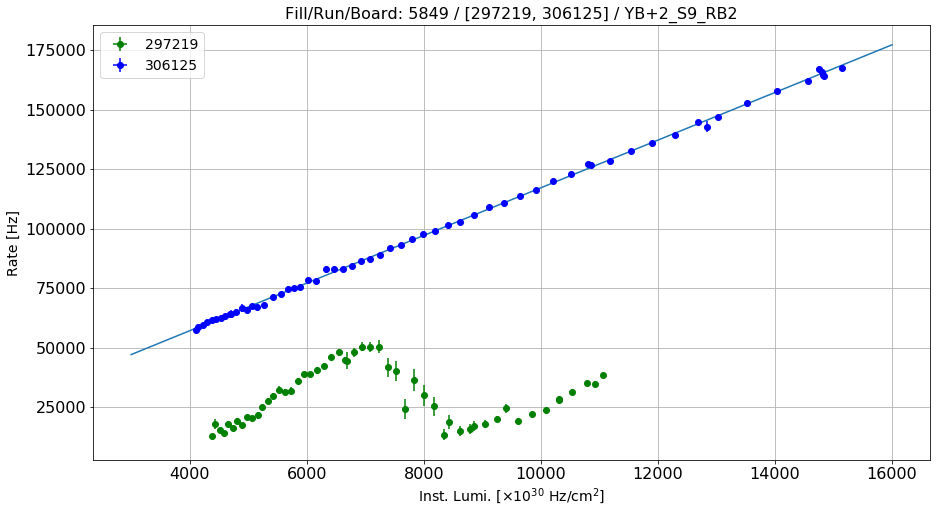

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S9_RB3
Linear fit for the reference run: [ 6.78056243e-09 -1.99114379e-04  2.58948273e+00]


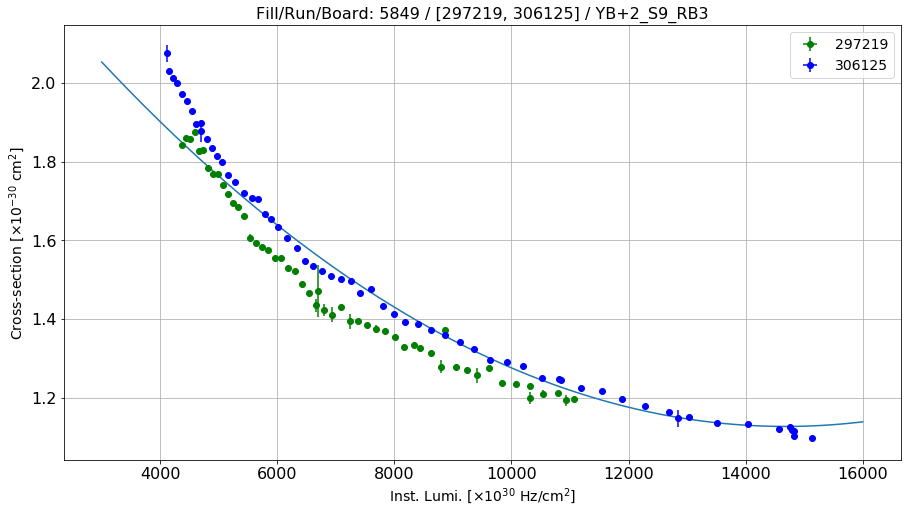

Linear fit parameters: [7.55986350e-01 5.26992354e+03]


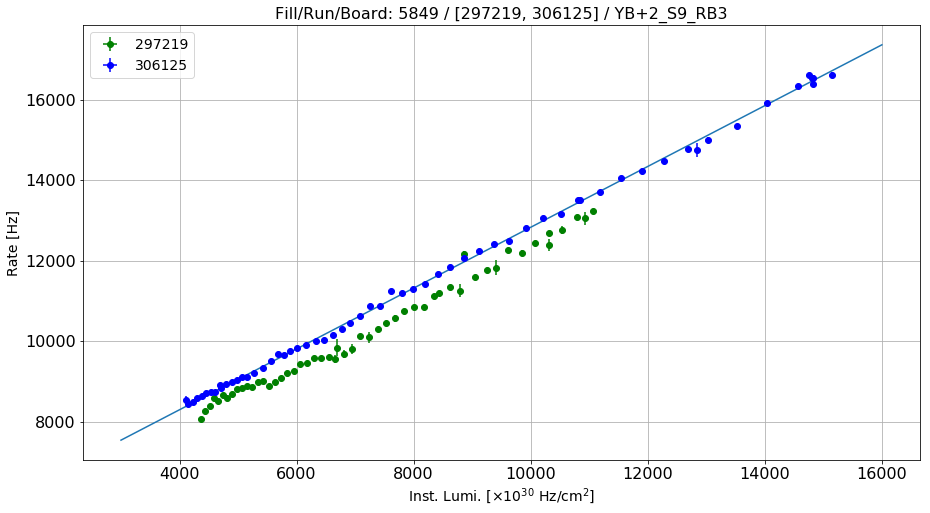

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S9_RB4
Linear fit for the reference run: [ 3.71550910e-09 -9.70937035e-05  2.10955298e+00]


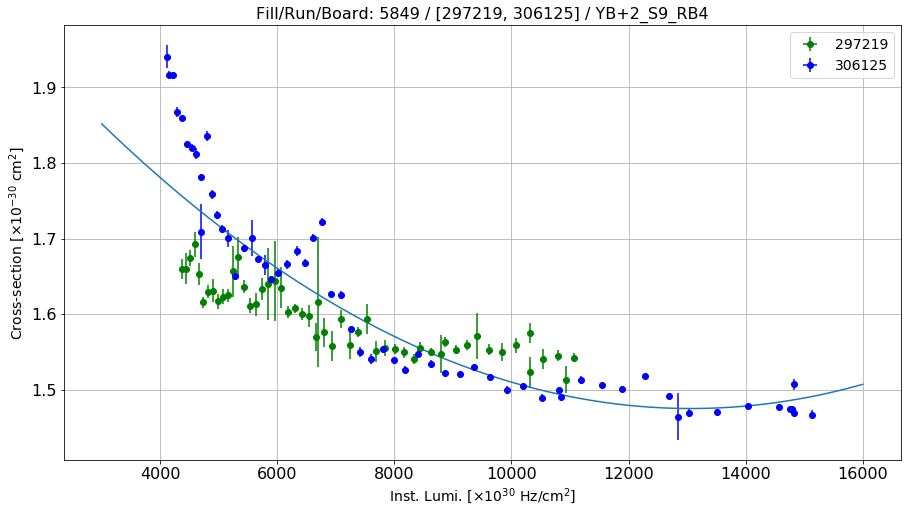

Linear fit parameters: [1.34306146e+00 1.82837104e+03]


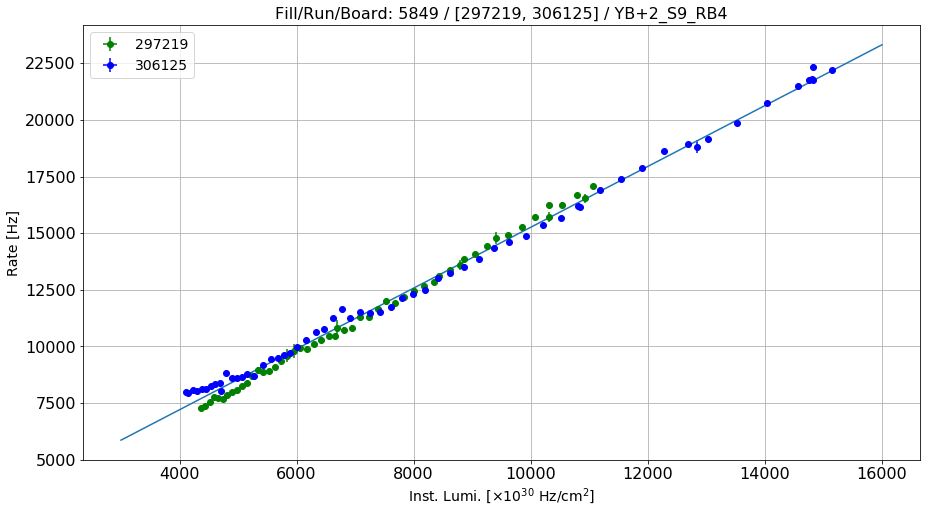

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S10_RB1
Linear fit for the reference run: [ 1.71463188e-08 -4.94561000e-04  4.26117964e+01]


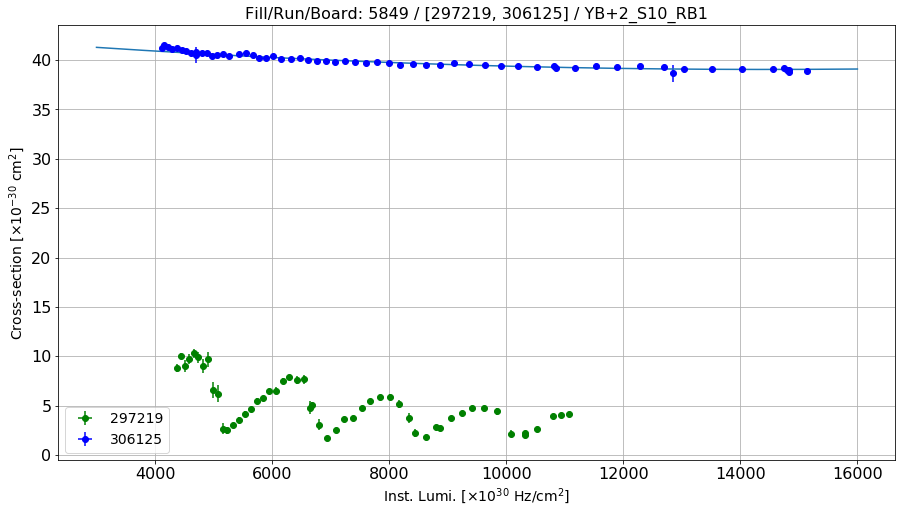

Linear fit parameters: [   38.15277445 12537.22676033]


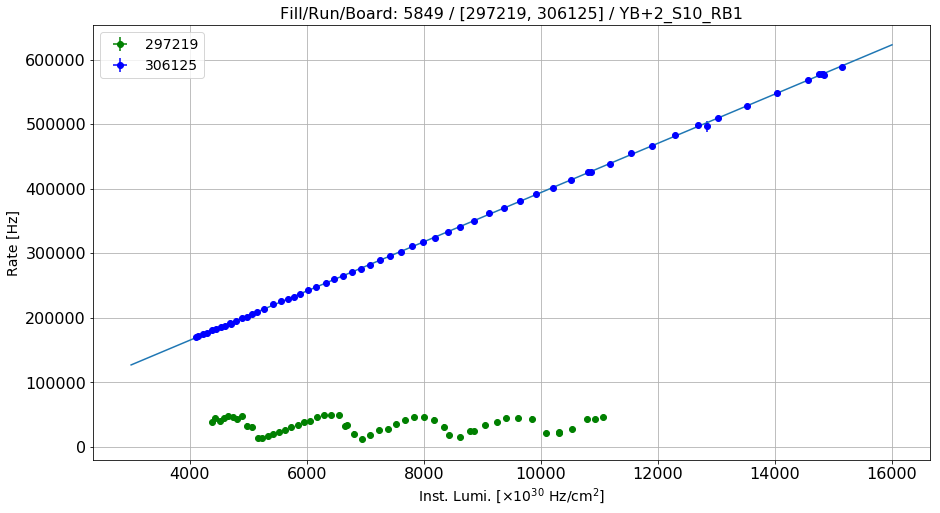

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S10_RB2
Linear fit for the reference run: [ 5.67607793e-09 -1.75136833e-04  1.03542936e+01]


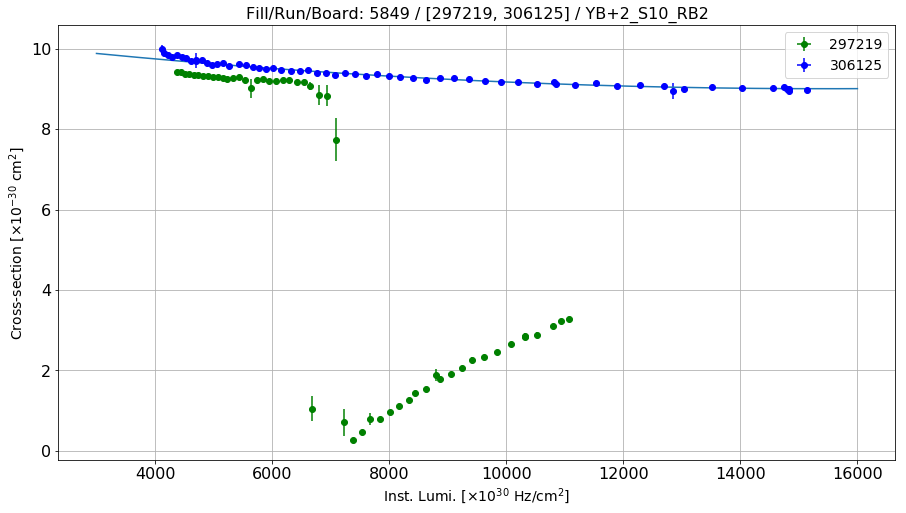

Linear fit parameters: [   8.65179548 5157.14992405]


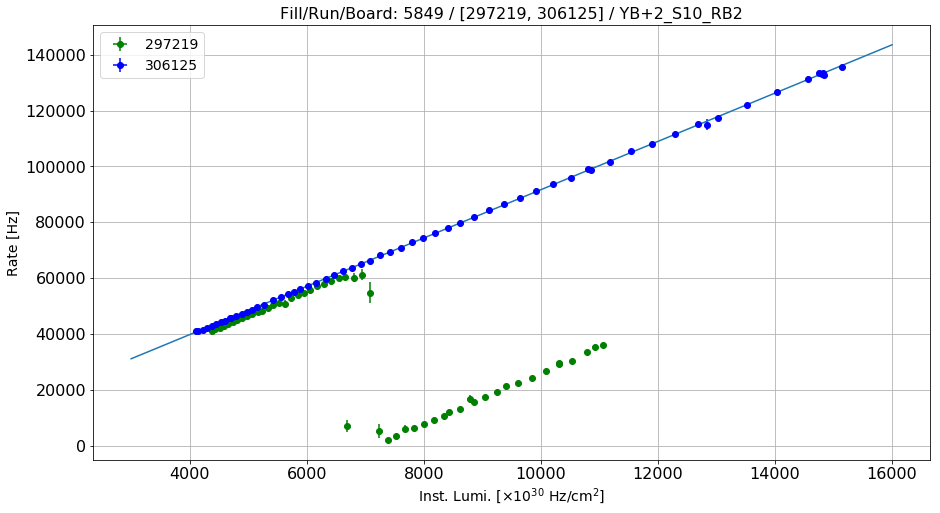

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S10_RB3
Linear fit for the reference run: [ 5.46850626e-09 -1.59741855e-04  2.09234225e+00]


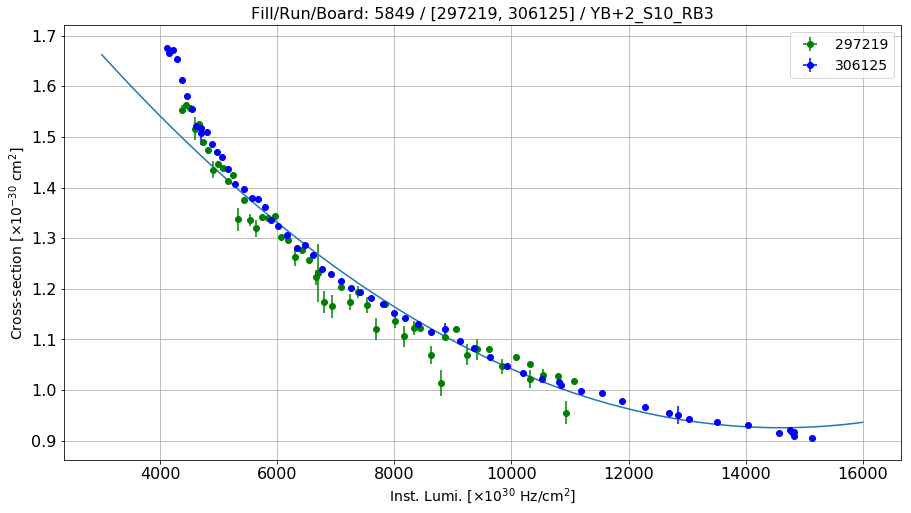

Linear fit parameters: [6.30353787e-01 4.17581245e+03]


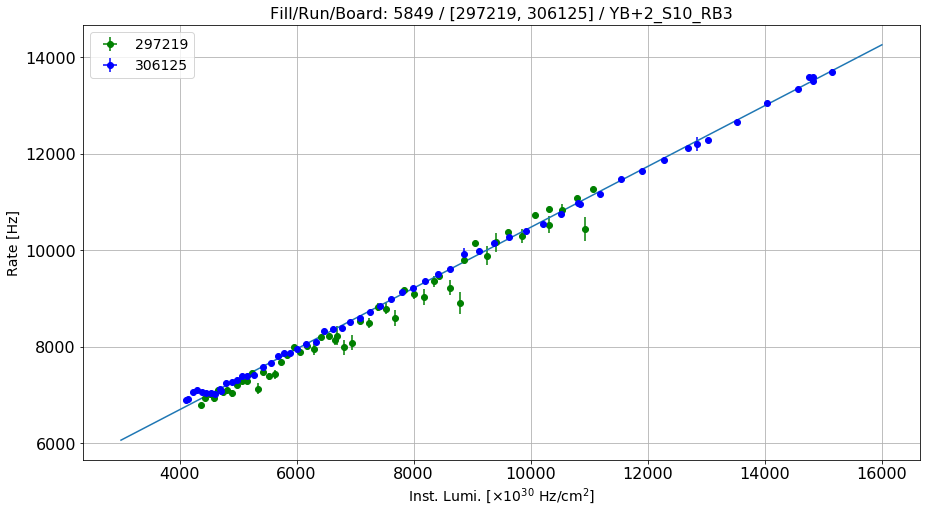

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S10_RB4
Linear fit for the reference run: [ 6.08128781e-09 -1.72049248e-04  2.98471692e+00]


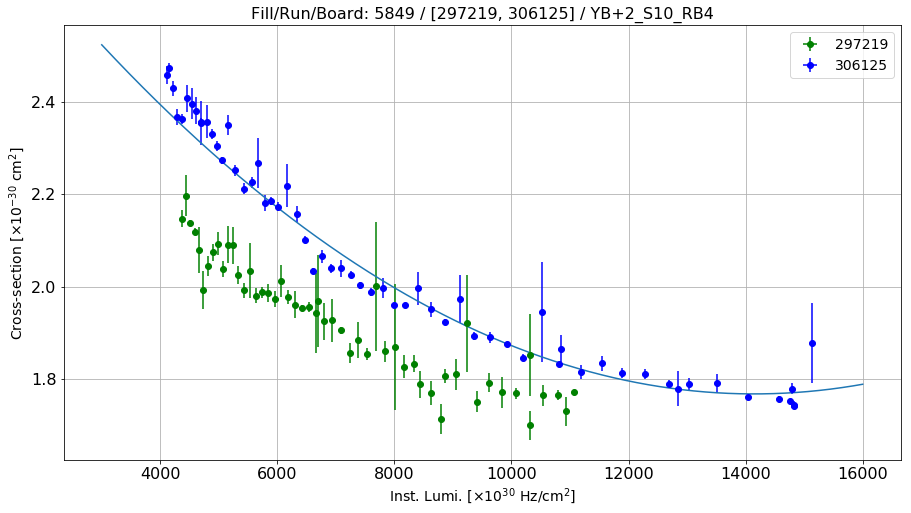

Linear fit parameters: [1.46978959e+00 4.15058714e+03]


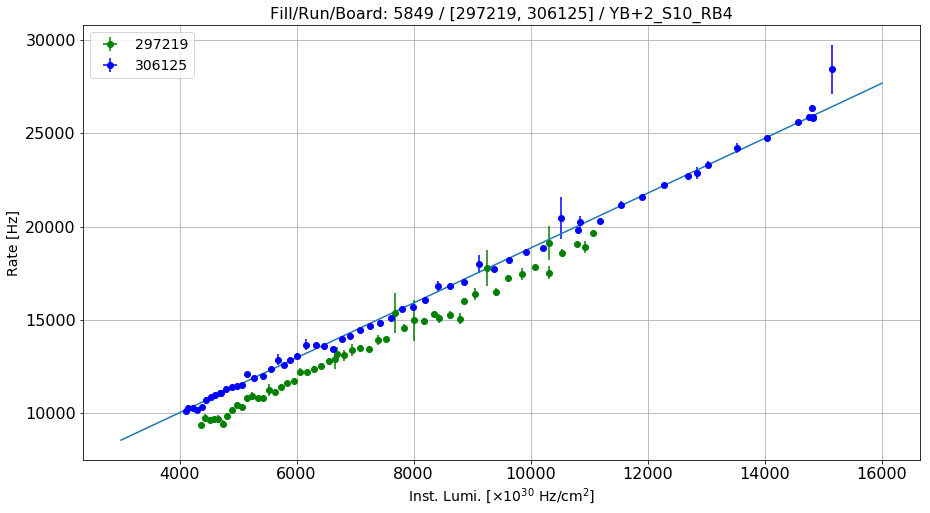

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S11_RB1
Linear fit for the reference run: [ 2.10389714e-08 -7.01550914e-04  4.53972451e+01]


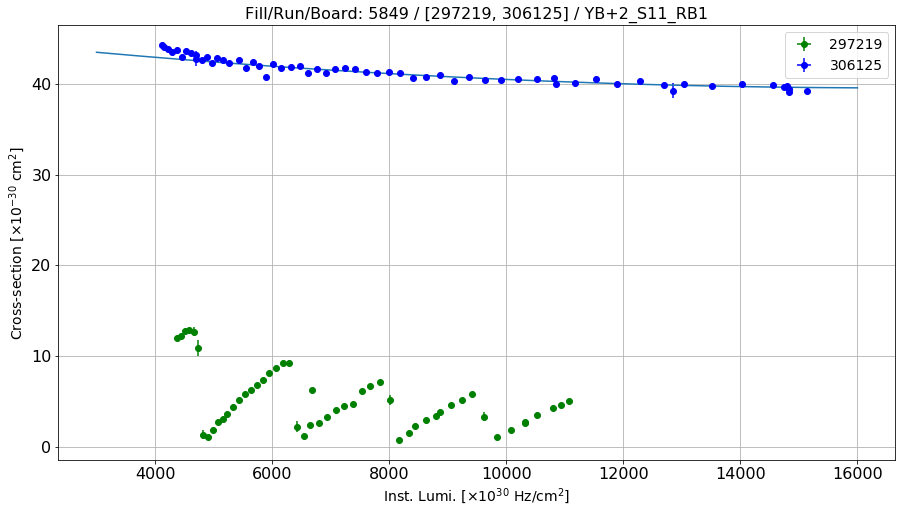

Linear fit parameters: [   38.0480644 23734.9642179]


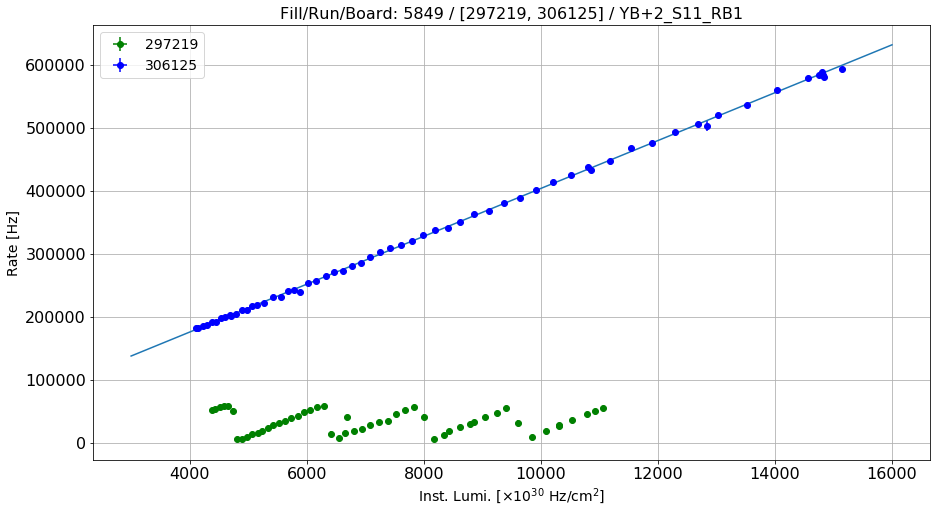

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S11_RB2
Linear fit for the reference run: [ 4.34839094e-09 -1.22505171e-04  9.89566994e+00]


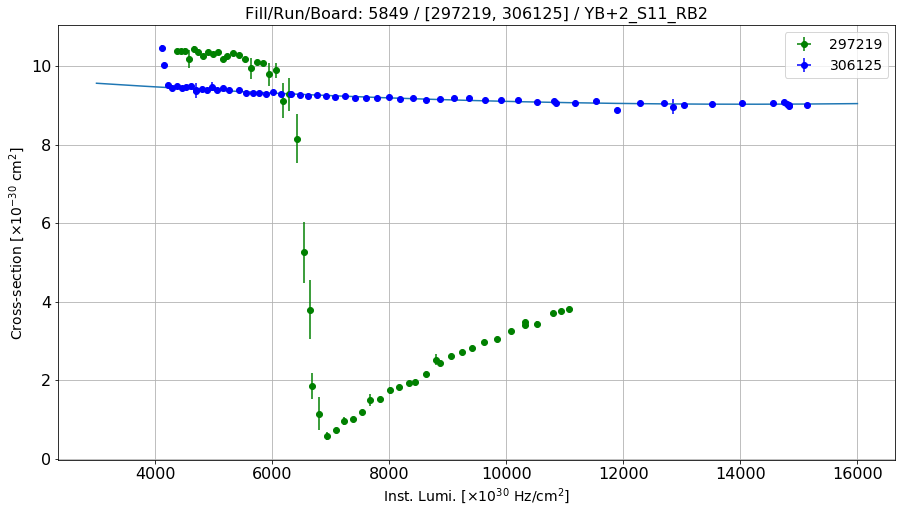

Linear fit parameters: [   8.82269369 2922.20605906]


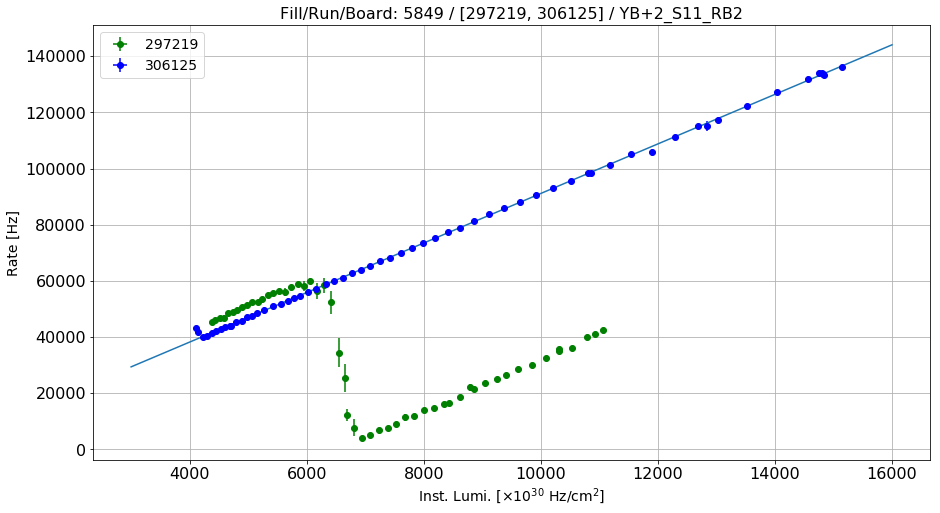

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S11_RB3
Linear fit for the reference run: [ 3.01806257e-08 -9.82619134e-04  1.05867783e+01]


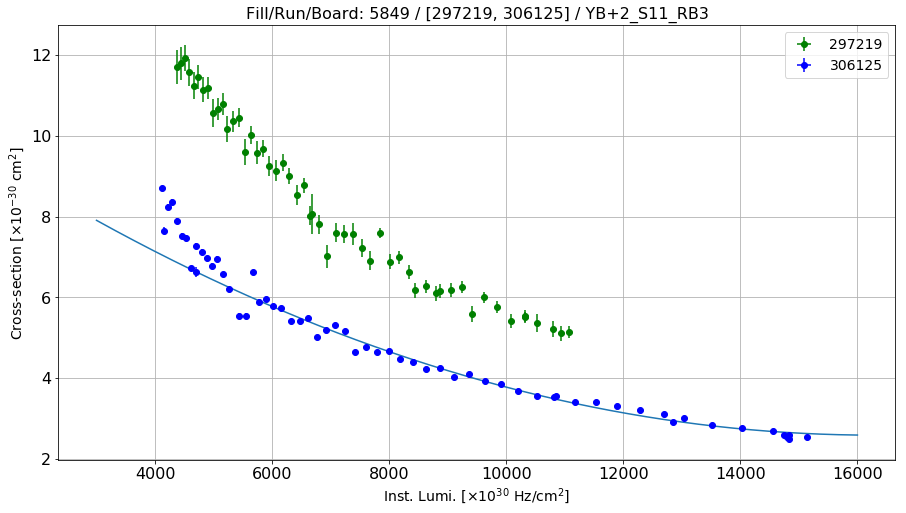

Linear fit parameters: [5.15449259e-01 3.19526900e+04]


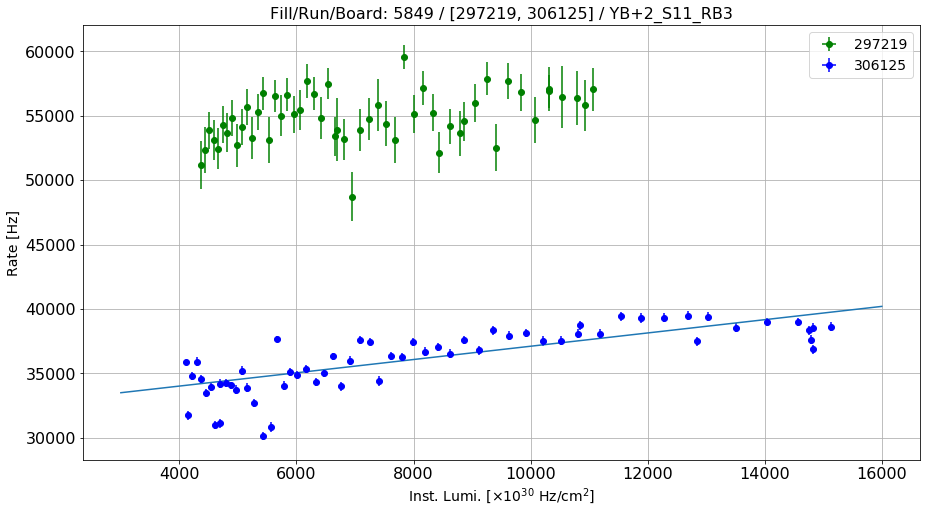

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S11_RB4
Linear fit for the reference run: [ 2.47400874e-08 -6.43033439e-04  6.19324582e+00]


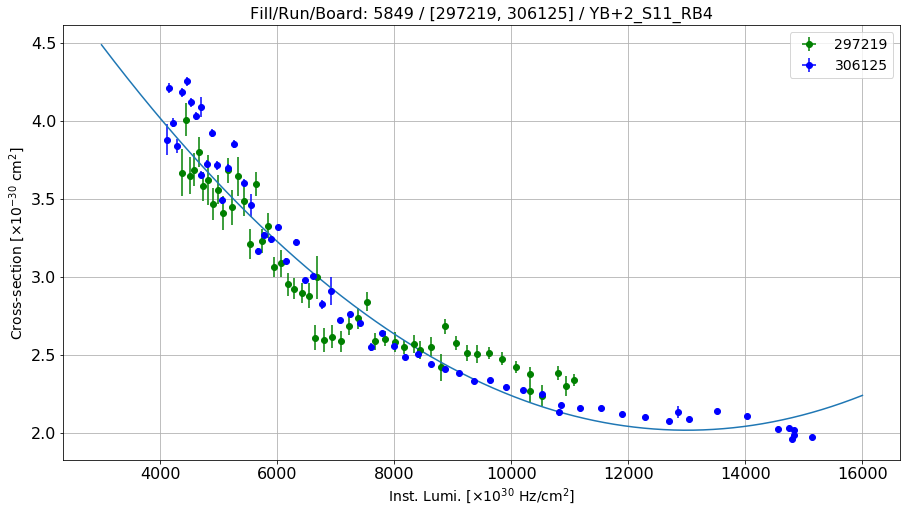

Linear fit parameters: [1.15837744e+00 1.18680040e+04]


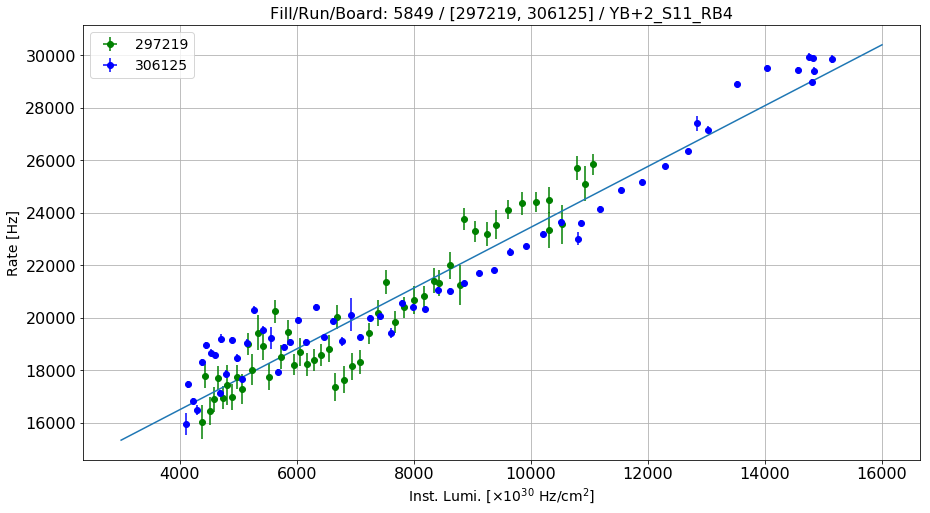

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S12_RB1
Linear fit for the reference run: [ 4.17082656e-08 -1.09283467e-03  3.29262810e+01]


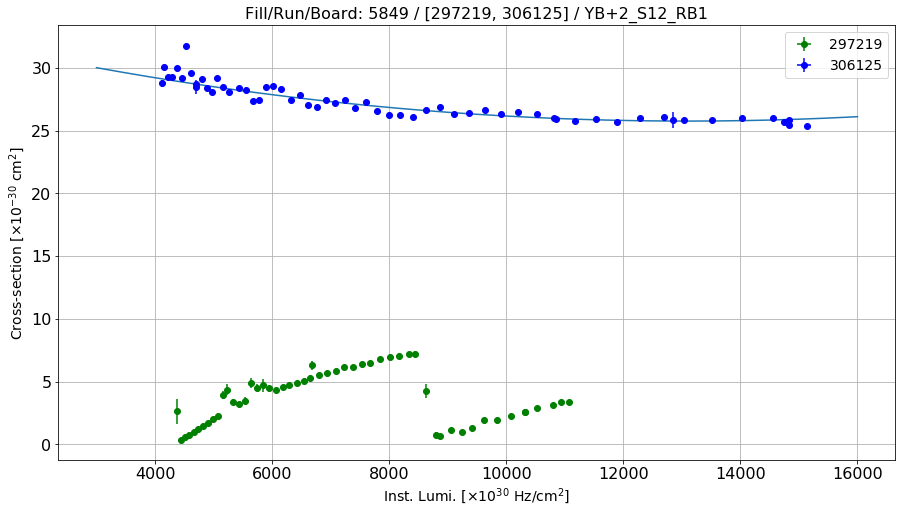

Linear fit parameters: [   24.26429116 20781.24379729]


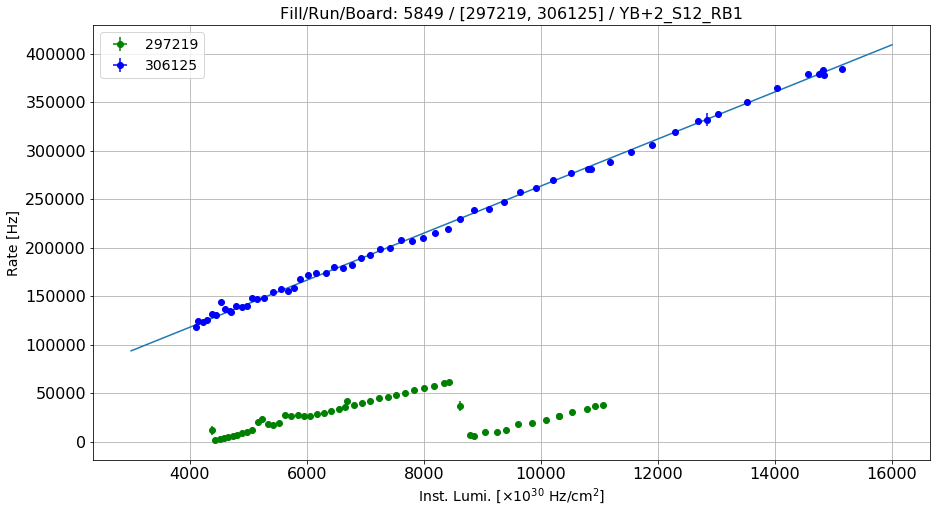

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S12_RB2
Linear fit for the reference run: [ 6.16376531e-08 -1.85650645e-03  2.48012423e+01]


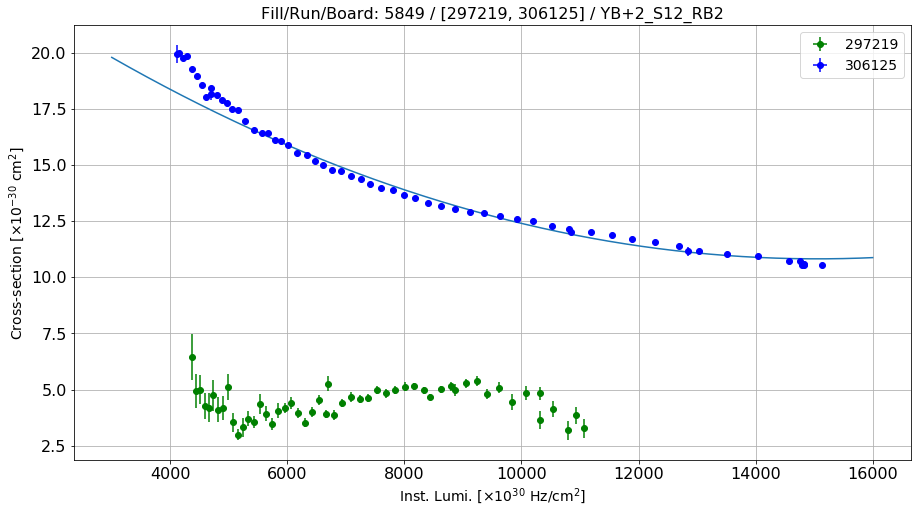

Linear fit parameters: [7.21241276e+00 5.20046236e+04]


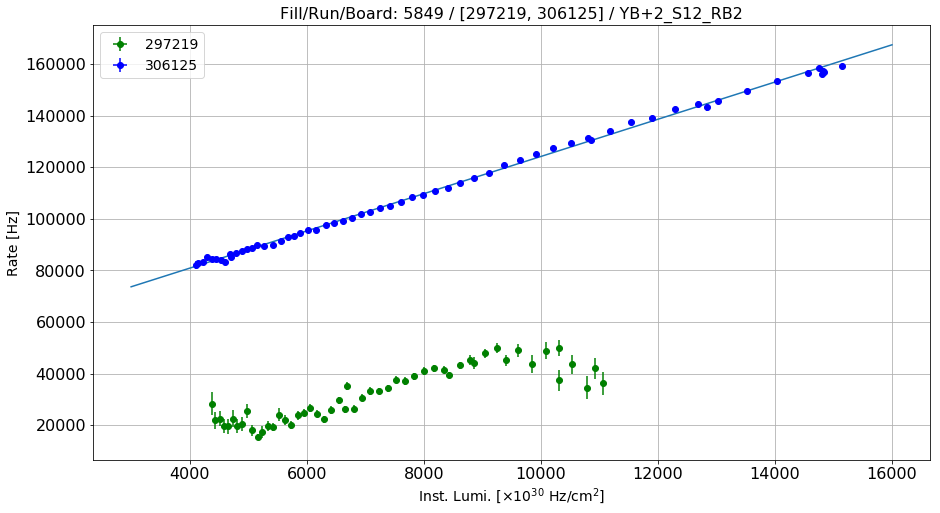

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S12_RB3
Linear fit for the reference run: [ 8.62841321e-10 -2.63568827e-05  7.17148799e-01]


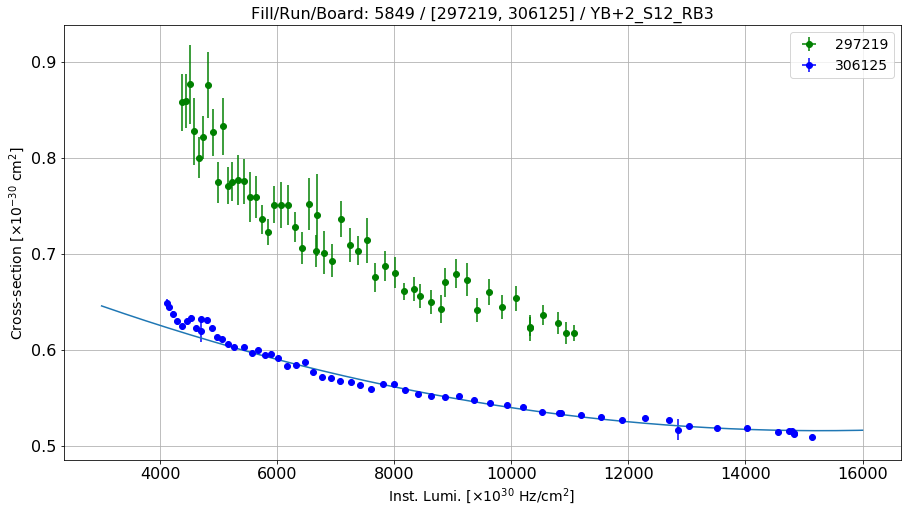

Linear fit parameters: [4.63625883e-01 7.60474935e+02]


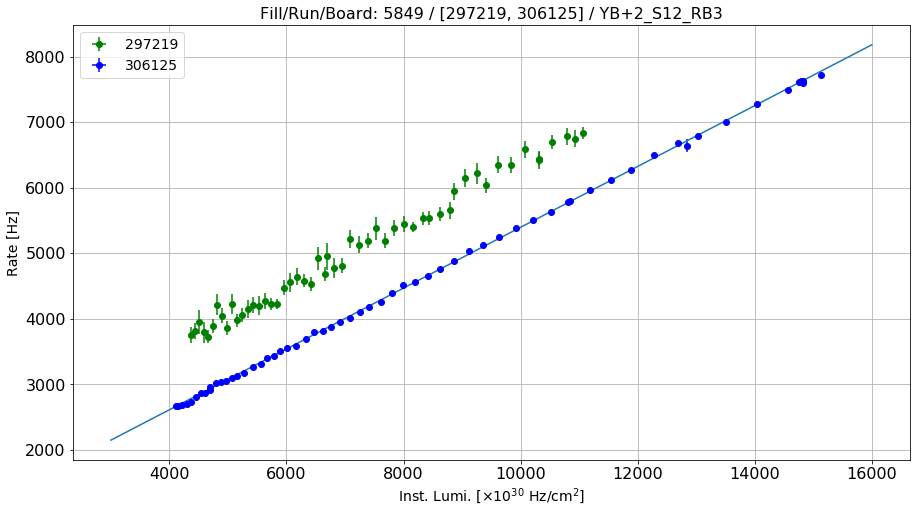

Fill/Run/Board: 5849 / [297219, 306125] / YB+2_S12_RB4
Linear fit for the reference run: [ 1.12747483e-07 -3.45393803e-03  5.11897098e+01]


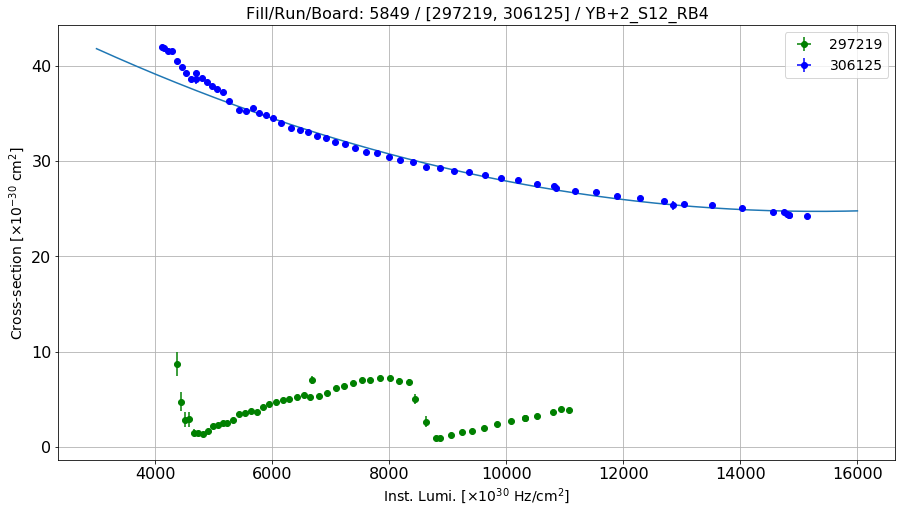

Linear fit parameters: [1.78659002e+01 1.00242807e+05]


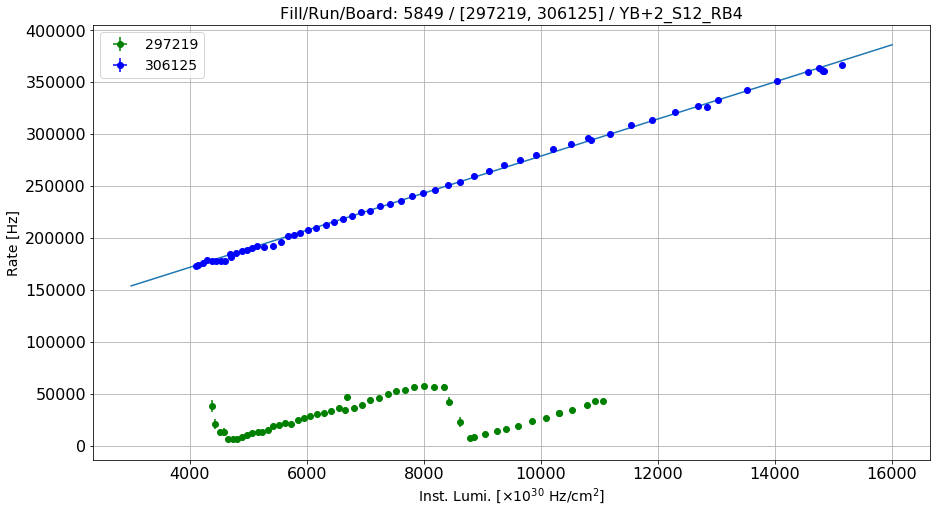

In [76]:
for i in [-2, -1, 0, +1, +2]:
#for i in [-1]: #Only anomalous wheels
    #for j in range(4, 7): #Only anomalous sectors
    for j in range(1, 13):
        range_ = range(1, 5)
        for k in range_:

            if (i > 0):
                board = "YB+" + str(i) + "_S" + str(j)
            else:
                board = "YB" + str(i) + "_S" + str(j)
            station = "RPC" + str(k)
            
            error = "err"+station
            
            #title = "Fill/Run/Board: "+str(int_lumi2["fill"].iloc[0])+\
                #            " / "+str("[297179, 297180, 297181, 306125]")+" / " + board + "_RB" + str(k)
            title = "Fill/Run/Board: "+str(int_lumi2["fill"].iloc[0])+\
                        " / "+str("[297219, 306125]")+" / " + board + "_RB" + str(k)
               
            print (title)
            
            fmin = df_rates_new_2[(df_rates_new_2.station == k) & (df_rates_new_2.board == board)]["fmin"].iloc[0]
            fmax = df_rates_new_2[(df_rates_new_2.station == k) & (df_rates_new_2.board == board)]["fmax"].iloc[0]
            #print fmin, fmax
                
           # plot_ratio_vs_ls(df_rates_new_2[df_rates_new_2.station == k],\
            #                [297179, 297180, 297181, 306125],\
             #                "lumi", "rate", board, 0,\
              #              "err", r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]", 
               #             r"Cross-section [$\times10^{-30}$ cm$^{2}$]",\
                #             title, ["mo", "go", "ro", "bo"], False, True, fmin, fmax)

           # coeff = plot_rate_vs_ls(df_rates_new_2[df_rates_new_2.station == k],\
            #                        [297179, 297180, 297181, 306125],\
             #                       "lumi", "rate", board, 0, "err",\
              #                      r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]",\
               #                     "Rate [Hz]", title, ["mo", "go", "ro", "bo"], False, True, fmin, fmax)
            
          #  plot_ratio_vs_ls(df_rates_new_2[df_rates_new_2.station == k],\
          #                  [297219, 306125],\
          #                   "lumi", "rate", board, 0,\
          #                  "err", r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]", 
          #                  r"Cross-section [$\times10^{-30}$ cm$^{2}$]",\
          #                   title, ["go", "bo"], False, True, fmin, fmax)

            coeff = plot_rate_vs_ls(df_rates_new_2[df_rates_new_2.station == k],\
                                    [297219, 306125],\
                                    "lumi", "rate", board, 0, "err",\
                                    r"Inst. Lumi. [$\times10^{30}$ Hz/cm$^2$]",\
                                    "Rate [Hz]", title, ["go", "bo"], False, True, fmin, fmax)
                                 
            
            #print coeff
            rule = (df_rates_new_2.station == k) & (df_rates_new_2.board == board) & (df_rates_new_2.run == 306125)
            indexes = df_rates_new_2[rule].index
            for m in indexes:
                df_rates_new_2.loc[m, "slope"] = coeff[0]
                df_rates_new_2.loc[m, "inter"] = coeff[1]



Calculating the number of hits as the area under the curve Rate vs. LS. Each point is the average rate over 10 LS.

In [72]:
def calcHits(data):
    # 230 is 10 lumisections times 23.3 seconds, the duration of one LS
    return data*10*23.3

df_rates_new_2["hits"] = df_rates_new_2["rate"].apply(calcHits)
#print df_rates_new_2["hits"]

In [73]:
temp = df_rates_new_2.groupby(["wheel", "sector", "station", "run", "system"])[["hits"]]\
.sum().reset_index()        

Normalizing the number of hits for each chamber to the total number of hits collected during the run:. N.B.: the numbers are percentages.

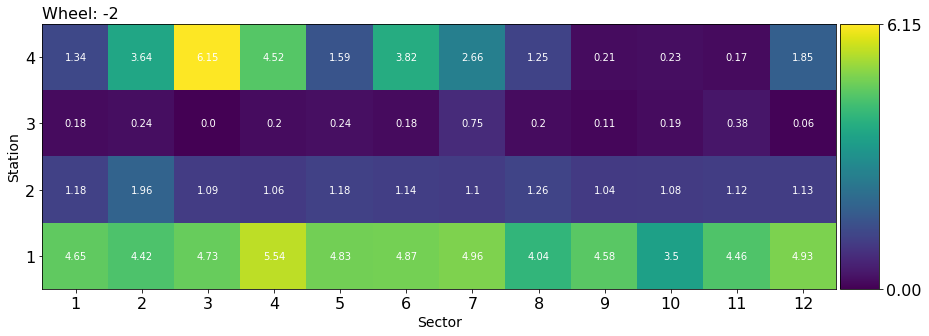

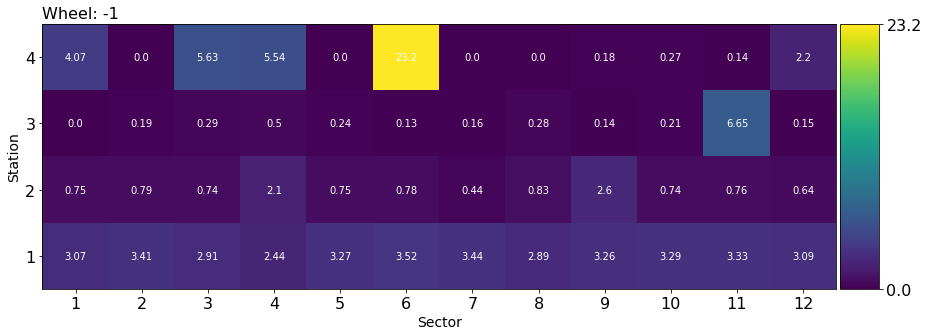

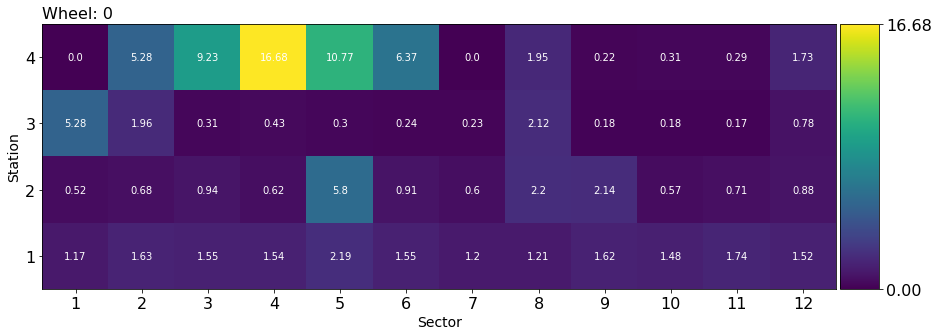

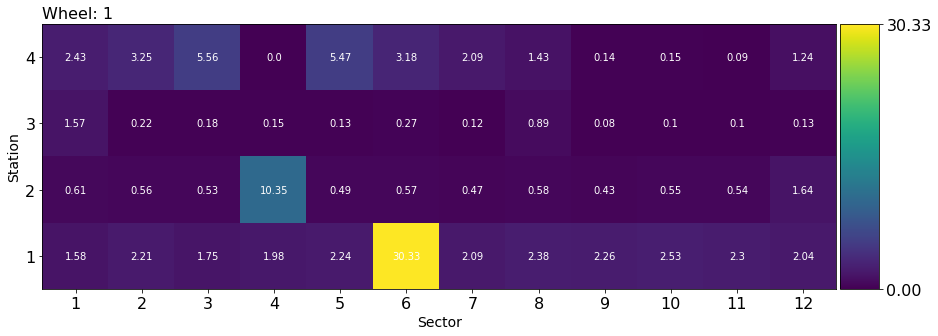

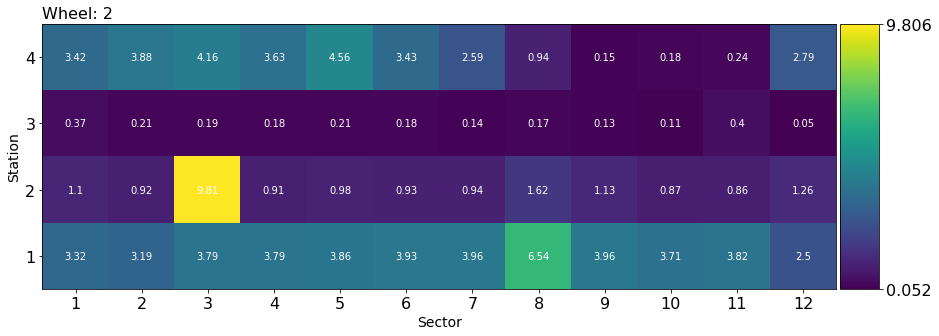

In [74]:
plot_scatter_2(temp[temp.run == 306125], "hits", -2, True)
plot_scatter_2(temp[temp.run == 306125], "hits", -1, True)
plot_scatter_2(temp[temp.run == 306125], "hits", 0, True)
plot_scatter_2(temp[temp.run == 306125], "hits", +1, True)
plot_scatter_2(temp[temp.run == 306125], "hits", +2, True)

/home/merve/anaconda3/envs/Env_Full/lib/python3.6/site-packages/matplotlib/axes/_base.py:3124: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=-0.5, right=-0.5
  'left=%s, right=%s') % (left, right))


IndexError: index 0 is out of bounds for axis 0 with size 0

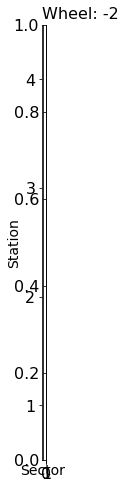

In [75]:
plot_scatter_2(temp[temp.run == 297179], "hits", -2, True)
plot_scatter_2(temp[temp.run == 297179], "hits", -1, True)
plot_scatter_2(temp[temp.run == 297179], "hits", 0, True)
plot_scatter_2(temp[temp.run == 297179], "hits", +1, True)
plot_scatter_2(temp[temp.run == 297179], "hits", +2, True)

# Model training section (NOT YET READY FOR RPC, STOP HERE) <a class="anchor" id="fourth-bullet"></a>

Creating train and test samples:

In [75]:
anomalies = df_rates_new_2.copy()

In [76]:
normalies = anomalies.copy()

In [77]:
print (len(normalies), len(anomalies))

79680 79680


In [78]:
rule = (normalies["wheel"] == -1) & (normalies["sector"] == 3) & (normalies["station"] == 3) 
print ("Normal chimney:")
print (normalies[rule]["content"].iloc[0])

rule = (normalies["wheel"] == 1) & (normalies["sector"] == 4) & (normalies["station"] == 3)
print ("Anomalous chimney:")
print (normalies[rule]["content"].iloc[0])

Normal chimney:
[1 -1 3 3 4935.698833333333 1.8105152382061425 5438.5 35.204876556143944
 1.1018703092804185 0.00714414643065285]
Anomalous chimney:
[1 1 4 3 4935.698833333333 1.8105152382061425 5951.333333333333
 36.73115541032952 1.2057731912532617 0.007455068373682317]


In [79]:
def assignScore(df, score):
    temp = df.copy()
    rule = (temp["wheel"] == 1) & (temp["sector"] == 4) & (temp["station"] == 3)
    indexes = temp[rule].index
    #print indexes
    for i in indexes:
        temp.loc[i, "score"] = score
    return temp

temp = assignScore(anomalies, 1)
anomalies = temp

In [80]:
#rule = (anomalies["wheel"] == 1) & (anomalies["sector"] == 4) & (anomalies["station"] == 3)
#print anomalies[rule]["score"]

In [118]:
def assignScore2(df, score, run, ls_in, ls_end, ls_string):
    temp = df.copy()
    rule = (temp["run"] == run)
    if ((ls_in != -1) & (ls_end != -1)):
        rule = rule & (temp[ls_string] >= ls_in) & (temp[ls_string] <= ls_end)
    elif (ls_in != -1):
        rule = rule & (temp[ls_string] >= ls_in)
    elif (ls_end != -1):
        rule = rule & (temp[ls_string] <= ls_end)
    indexes = temp[rule].index
    for w in indexes:
        temp.loc[w, "score"] = score

    #Correct score for the chambers with normal HV
    for i in [-2, 0, 2]: #wheels that are ok
        for j in [3, 4, 5]: #sectors that are ok
            if (i == 0):
                range_ = [1]
            elif (abs(i) == 2):
                range_ = [1, 4, 5]
            else:
                range_ = [1, 4]
            for k in range_: #stations that are ok
                rule = (temp["run"] == run) & (temp["wheel"] == i) \
                        & (temp["sector"] == j) & (temp["station"] == k)
                indexes = temp[rule].index
                for w in indexes:
                    temp.loc[w, "score"] = -1
    return temp

In [123]:
rule = ((anomalies["wheel"] == -1) & (anomalies["sector"] == 4) & (anomalies["station"] == 1))
print (anomalies[rule]["score"].iloc[1])
temp = assignScore2(anomalies, -1, 297179, -1, -1, "group")
anomalies = temp
#temp = assignScore2(temp, 1, 302635, 1, 404, "group")
#anomalies = temp
print (anomalies[rule]["score"].iloc[1])

-1
-1


In [113]:
rule = ((anomalies["wheel"] == 1) & (anomalies["sector"] == 3) & (anomalies["station"] == 1))
print (anomalies[rule]["score"].iloc[1])

-1


In [114]:
rule = ((anomalies["wheel"] == 2) & (anomalies["sector"] == 3) & (anomalies["station"] == 2))
print (anomalies[rule]["score"].iloc[1])
rule = ((anomalies["wheel"] == -2) & (anomalies["sector"] == 1) & (anomalies["station"] == 1))
print (anomalies[rule]["score"].iloc[1])

-1
-1


Forcing the rate to the one of the symmetric chimney chamber:

In [140]:
def assignRate(df):
    rule1 = (df["wheel"] == 1) & (df["sector"] == 4) & (df["station"] == 3)# not good
    indexes1 = df[rule1].index
    #print indexes
    for i in indexes1:
        group = df.loc[i]["group"]
        run = df.loc[i]["run"]
        rule2 = (df["wheel"] == -1) & (df["sector"] == 3) & (df["station"] == 3) &\
            (df["group"] == group) & (df["run"] == run)
        indexes2 = (df[rule2].index) #it should contain one index
        #print i, index, time
        if(len(indexes2) > 0):
            j = indexes2[0]
            array = df.loc[j]["content"]
            rate = array[6] #good rate from the symmetric sector
            err = array[7] #uncertainty on the good rate from the symmetric sector
            CS = array[8]
            errCS = array[9]
            content_orig = df.loc[i]["content"]
            content = list(content_orig)
            content[6] = rate
            content[7] = err
            content[8] = CS
            content[9] = errCS
            df.at[i, "content"] = content
            #print i, j, time, rate, content_orig, content
        else:
            content_orig = df.loc[i]["content"]
            content = list(content_orig)
            content[6] = -1
            content[7] = -1
            content[8] = -1
            content[9] = -1
            df.at[i, "content"] = content
            #print i, j, time, rate, content_orig, content

assignRate(normalies)

Check that the change affects only normalies:

In [141]:
rule = (normalies["wheel"] == -1) & (normalies["sector"] == 3) & (normalies["station"] == 3)
print "Normal chimney:"
print normalies[rule]["content"].iloc[0]

rule = (normalies["wheel"] == 1) & (normalies["sector"] == 4) & (normalies["station"] == 3)
print "Anomalous chimney:"
print normalies[rule]["content"].iloc[0]

Normal chimney:
[2 -1 3 3 14972.386553571416 20.1862083622483 3265.875 9.729125589705358
 0.21812654838389672 0.0013556592604652953]
Anomalous chimney:
[2, 1, 4, 3, 14972.386553571416, 20.1862083622483, 3265.875, 9.729125589705358, 0.21812654838389672, 0.0013556592604652953]


In [142]:
rule = (anomalies["wheel"] == -1) & (anomalies["sector"] == 3) & (anomalies["station"] == 3)
print "Normal chimney:"
print anomalies[rule]["content"].iloc[0]

rule = (anomalies["wheel"] == 1) & (anomalies["sector"] == 4) & (anomalies["station"] == 3)
print "Anomalous chimney:"
print anomalies[rule]["content"].iloc[0]

Normal chimney:
[2 -1 3 3 14972.386553571416 20.1862083622483 3265.875 9.729125589705358
 0.21812654838389672 0.0013556592604652953]
Anomalous chimney:
[2 1 4 3 14972.386553571416 20.1862083622483 2487.1964285714284
 8.244337672863274 0.16611890293322334 0.001351328555447277]


In [144]:
#Scale the data
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import minmax_scale
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing.data import QuantileTransformer
def scale_data(data, scaler_type = 2):
    
    types = ["RobustScaler", "MaxAbsScaler", "QuantileTransformerUniform",\
             "QuantileTransformerNormal", "Normalizer", "MinMaxScaler"]
    #print "Scaling data using:", types[scaler_type-1]
    
    # Need to reshape since scaler works per column
    data = data.reshape(-1, 1)
    if (scaler_type == 1):
        scaler = RobustScaler(quantile_range=(25, 75)).fit(data)
    if (scaler_type == 2):
        scaler = MaxAbsScaler().fit(data)
    if (scaler_type == 3):
        scaler = QuantileTransformer(output_distribution='uniform').fit(data)
    if (scaler_type == 4):
        scaler = QuantileTransformer(output_distribution='normal').fit(data)
    if (scaler_type == 5):
        scaler = Normalizer().fit(data)
    if (scaler_type == 6):
        scaler = MinMaxScaler().fit(data)
    return scaler.transform(data).reshape(1, -1)

In [145]:
anomalies["content"] = anomalies["content"].apply(np.array)
anomalies["content_scaled"] = anomalies["content"].apply(scale_data)

normalies["content"] = normalies["content"].apply(np.array)
normalies["content_scaled"] = normalies["content"].apply(scale_data)

In [146]:
#print anomalies["content_scaled"]
#print normalies["content_scaled"]

In [147]:
# Set a random seed to reproduce the results
rng = np.random.RandomState(0)
anomalies = anomalies[(anomalies.score == 1) & (anomalies.run != 305814)]
normalies = normalies[(normalies.score == -1) & (normalies.run != 305814)]
print("%s faults and %s good samples. In total: %s." %
      (len(anomalies), len(normalies), len(anomalies) + len(normalies)))

anomalies_train, anomalies_test = train_test_split(anomalies, test_size = 0.2, random_state=rng)
normalies_train, normalies_test = train_test_split(normalies, test_size = 0.2, random_state=rng)

neural_anomalies_train, neural_anomalies_val = train_test_split(anomalies_train,\
                                                                test_size = 0.2, random_state=rng)
neural_normalies_train, neural_normalies_val = train_test_split(normalies_train,\
                                                                test_size = 0.2, random_state=rng)

layers_train = pd.concat([anomalies_train, normalies_train])
layers_test = pd.concat([anomalies_test, normalies_test])

neural_train = pd.concat([neural_anomalies_train, neural_normalies_train])
neural_val = pd.concat([neural_anomalies_val, neural_normalies_val])

375 faults and 93750 good samples. In total: 94125.


In [148]:
print("Number of anomalies in the train set: %s" % len(anomalies_train))
print("Number of normal in the train set: %s" % len(normalies_train))
print("Number of anomalies in the test set: %s" % len(anomalies_test))
print("Number of normal in the test set: %s" % len(normalies_test))

Number of anomalies in the train set: 300
Number of normal in the train set: 75000
Number of anomalies in the test set: 75
Number of normal in the test set: 18750


In [149]:
sess = tf.Session()
sess.run(tf.global_variables_initializer())
K.set_session(sess)

In [150]:
def score_to_array(score):
    if score == -1:
        return np.asarray([1, 0]) #Normaly
    return np.asarray([0, 1]) #Anomaly

def nn_generate_input():  
    return (np.array(np.concatenate(neural_train.content_scaled.values)).reshape(-1, 10),
            np.concatenate(neural_train["score"].apply(score_to_array).values).reshape(-1, 2),
            np.array(np.concatenate(neural_val.content_scaled.values)).reshape(-1, 10),
            np.concatenate(neural_val["score"].apply(score_to_array).values).reshape(-1, 2),
            np.array(np.concatenate(layers_test.content_scaled.values)).reshape(-1, 10))

(train_x, train_y, val_x, val_y, test_x) = nn_generate_input()

In [151]:
def cae_generate_input():
    return np.array(np.concatenate(normalies.content_scaled.values)).reshape(-1, 10)

train_cae = cae_generate_input()

In [152]:
from sklearn.preprocessing import MaxAbsScaler
from sklearn.utils import class_weight

cw = class_weight.compute_class_weight("balanced",
                                       np.unique(np.argmax(train_y, axis=1)),
                                       np.argmax(train_y, axis=1))
cw = {0: cw[0], 1: cw[1]}
print cw

{0: 0.502, 1: 125.5}


Defining NN structure:

In [153]:
dim = 10
def neural_network_1():
    model = Sequential()
    model.add(Reshape((dim, 1), input_shape=(dim,), name='input_ann'))
    model.add(Flatten(name="flatten_ann"))
    model.add(Dense(32, activation='relu', name="dense_ann"))
    model.add(Dense(2, activation='softmax', name='output_ann'))
    return model

def neural_network_2():
    model = Sequential()
    model.add(Reshape((dim, 1), input_shape=(dim,), name='input_ann'))
    model.add(Flatten(name="flatten_ann"))
    model.add(Dense(32, activation='relu', name="dense_ann"))
    model.add(Dense(32, activation='relu', name="dense_ann2"))
    model.add(Dense(2, activation='softmax', name='output_ann'))
    return model

def neural_network_3():
    model = Sequential()
    model.add(Reshape((dim, 1), input_shape=(dim,), name='input_ann'))
    model.add(Flatten(name="flatten_ann"))
    model.add(Dense(32, activation='relu', name="dense_ann"))
    model.add(Dense(32, activation='relu', name="dense_ann2"))
    model.add(Dense(32, activation='relu', name="dense_ann3"))
    model.add(Dense(2, activation='softmax', name='output_ann'))
    return model

def neural_network_4():
    model = Sequential()
    model.add(Reshape((dim, 1), input_shape=(dim,), name='input_ann'))
    model.add(Flatten(name="flatten_ann"))
    model.add(Dense(32, activation='relu', name="dense_ann"))
    model.add(Dense(32, activation='relu', name="dense_ann2"))
    model.add(Dense(32, activation='relu', name="dense_ann3"))
    model.add(Dense(32, activation='relu', name="dense_ann4"))
    model.add(Dense(2, activation='softmax', name='output_ann'))
    return model

def autoencoder():
    from keras.layers import Input, Dense
    from keras.models import Model
    input_ = Input(shape=(10,))
    encoded = Dense(10, activation='relu')(input_)
    encoded = Dense(9, activation='relu')(encoded)
    encoded = Dense(8, activation='relu')(encoded)
    encoded = Dense(7, activation='relu')(encoded)
    encoded = Dense(6, activation='relu')(encoded)
    
    decoded = Dense(6, activation='relu')(encoded)
    decoded = Dense(7, activation='relu')(decoded)
    decoded = Dense(8, activation='relu')(decoded)
    decoded = Dense(9, activation='relu')(decoded)
    decoded = Dense(10, activation='sigmoid')(decoded)

    autoencoder = Model(input_, decoded)
    return autoencoder

In [154]:
ann_1 = neural_network_1()
ann_2 = neural_network_2()
ann_3 = neural_network_3()
ann_4 = neural_network_4()
#print("Neural Network Architecture:")
#ann_1.summary()
#ann_2.summary()
#ann_3.summary()
#ann_4.summary()

Training the NN:

In [155]:
# This may take some time...

def train_nn(model, x, y, batch_size, loss, name, validation_data=None, 
             validation_split=0.0, class_weight=None):

    model.compile(loss=loss, optimizer='Nadam')

    early_stopper = EarlyStopping(monitor="val_loss",
                                  patience=32,
                                  verbose=True,
                                  mode="auto")
    
    checkpoint_callback = ModelCheckpoint(("./model_keras/%s.h5" % name),
                                          monitor="val_loss",
                                          verbose=False,
                                          save_best_only=True,
                                          mode="min")
    return model.fit(x, y,
                     batch_size=batch_size,
                     epochs=8192,
                     verbose=False,
                     class_weight=class_weight,
                     shuffle=True,
                     validation_split=validation_split,
                     validation_data=validation_data,
                     callbacks=[early_stopper, checkpoint_callback])

In [156]:
history_ann_1 = train_nn(ann_1,
                       train_x,
                       train_y,
                       len(train_x),
                       keras.losses.categorical_crossentropy,
                       "ann_1",
                       validation_data=(val_x, val_y),
                       class_weight=cw)

Epoch 00350: early stopping


In [157]:
history_ann_2 = train_nn(ann_2,
                       train_x,
                       train_y,
                       len(train_x),
                       keras.losses.categorical_crossentropy,
                       "ann_2",
                       validation_data=(val_x, val_y),
                       class_weight=cw)

Epoch 07529: early stopping


In [158]:
history_ann_3 = train_nn(ann_3,
                       train_x,
                       train_y,
                       len(train_x),
                       keras.losses.categorical_crossentropy,
                       "ann_3",
                       validation_data=(val_x, val_y),
                       class_weight=cw)

Epoch 02991: early stopping


In [159]:
history_ann_4 = train_nn(ann_4,
                       train_x,
                       train_y,
                       len(train_x),
                       keras.losses.categorical_crossentropy,
                       "ann_4",
                       validation_data=(val_x, val_y),
                       class_weight=cw)

Epoch 01485: early stopping


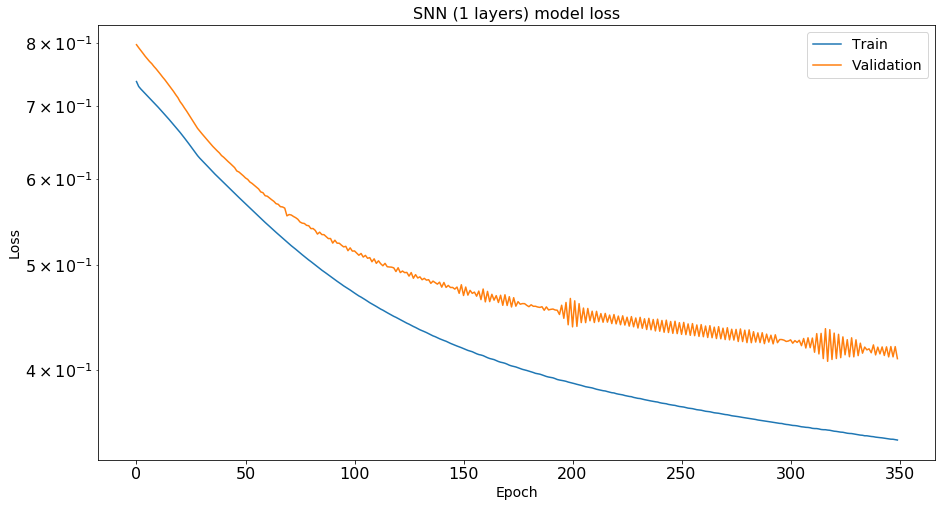

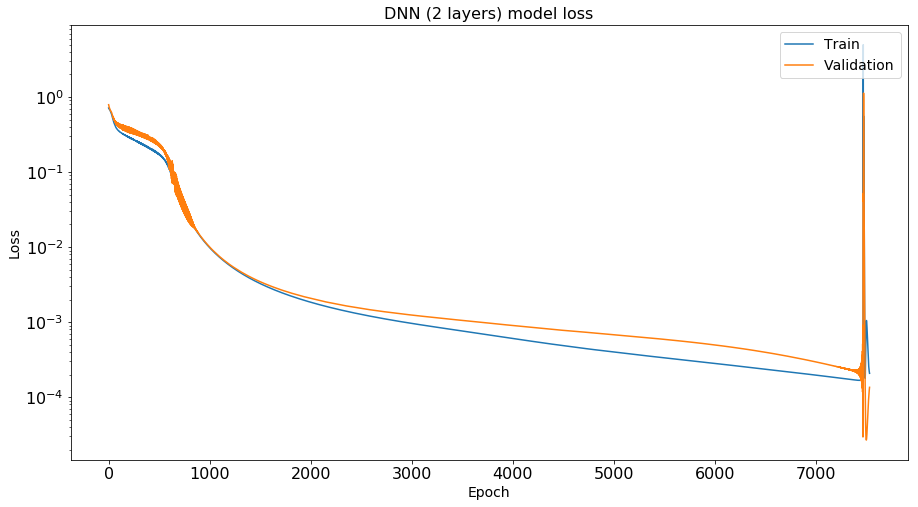

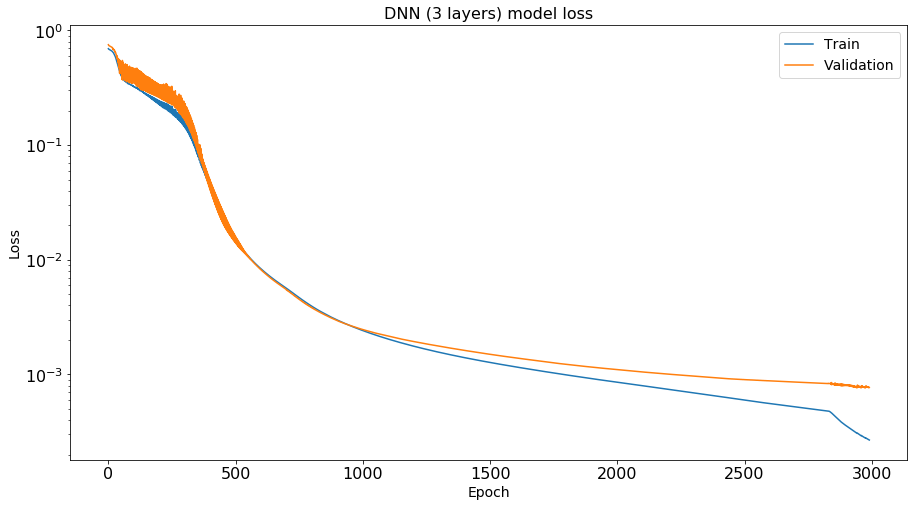

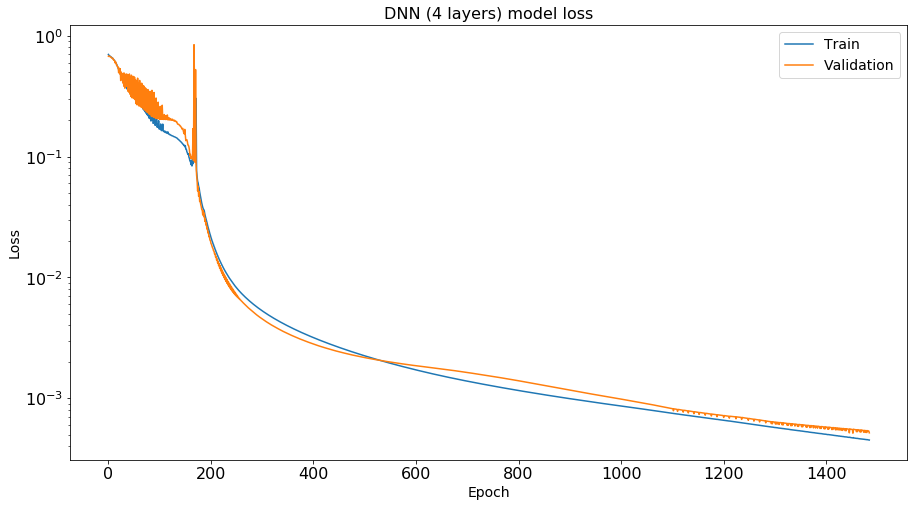

In [160]:
def plot_training_loss(data, title):
    """Plots the training and validation loss"""
    plt.figure()
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title(title)
    plt.plot(data["loss"])
    plt.plot(data["val_loss"])
    plt.legend(["Train", "Validation"], loc="upper right")
    plt.yscale("log")
    plt.show();

plot_training_loss(history_ann_1.history, "SNN (1 layers) model loss")
plot_training_loss(history_ann_2.history, "DNN (2 layers) model loss")
plot_training_loss(history_ann_3.history, "DNN (3 layers) model loss")
plot_training_loss(history_ann_4.history, "DNN (4 layers) model loss")

Making an inference using the model and the test sample:

In [161]:
ann_model_1 = load_model("./model_keras/ann_1.h5")
ann_model_2 = load_model("./model_keras/ann_2.h5")
ann_model_3 = load_model("./model_keras/ann_3.h5")
ann_model_4 = load_model("./model_keras/ann_4.h5")

In [162]:
layers_test["ann_score_1"] = ann_model_1.predict(np.array(test_x))[:, 1]
layers_test["ann_score_2"] = ann_model_2.predict(np.array(test_x))[:, 1]
layers_test["ann_score_3"] = ann_model_3.predict(np.array(test_x))[:, 1]
layers_test["ann_score_4"] = ann_model_4.predict(np.array(test_x))[:, 1]

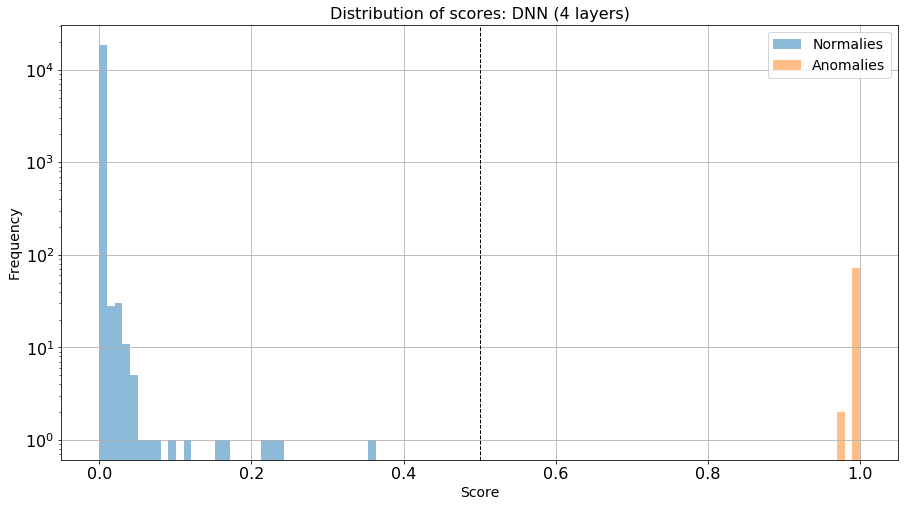

In [163]:
# Distribution of scores:
fig, ax = plt.subplots()
ax.set_yscale('log')
ax.grid()
bins = np.linspace(0, 1, 100)
plt.hist(layers_test[layers_test["score"] < 0]["ann_score_4"], bins=bins, alpha=0.5, label="Normalies")
plt.hist(layers_test[layers_test["score"] > 0]["ann_score_4"], bins=bins, alpha=0.5, label="Anomalies")
plt.title("Distribution of scores: DNN (4 layers)")
plt.legend(loc='best')
plt.ylabel('Frequency')
plt.xlabel('Score')
plt.axvline(0.5, color='k', linestyle='dashed', linewidth=1)
plt.show()

In [164]:
def get_roc_curve(test_df, models, working_point=None):
    """Generates ROC Curves for a given array"""
    fig, ax = plt.subplots()
    ax.grid()

    for legend_label, model_score in models:
        false_positive_rate, true_positive_rate, _ = roc_curve(test_df["score"],
                                                               test_df[model_score])
        #plt.xlim(0, 0.2)
        plt.plot(false_positive_rate, true_positive_rate, linewidth=2,
                 label=('%s, AUC: %s' % (legend_label,
                                         round(auc(false_positive_rate, true_positive_rate), 4))))
    if working_point:
        plt.plot(1-working_point[0],
                 working_point[1],
                 'o',
                 label="DNN working point")
    plt.title("ROC")
    plt.legend(loc='best')
    plt.ylabel('True positive rate')
    plt.xlabel('False positive rate')
    plt.show();

In [172]:
cae = autoencoder()
#print("Autoencoder Architecture:")
#cae.summary()

Epoch 00133: early stopping


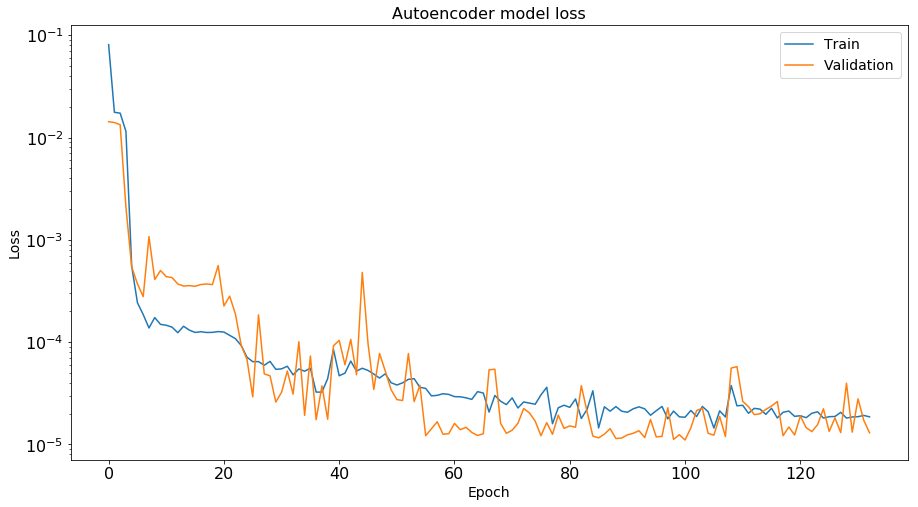

In [173]:
history_cae = train_nn(cae,
                       train_cae,
                       train_cae,
                       512,
                       keras.losses.mse,
                       "cae",
                       validation_split=0.2)
plot_training_loss(history_cae.history, "Autoencoder model loss")

In [174]:
cae_model = load_model("./model_keras/cae.h5")
layers_test["cae_score"] = np.sum(abs(test_x - cae_model.predict(np.array(test_x))), axis=1)

In [175]:
def benchmark(y_true, y_score, treshold):
    y_pred = 2*(y_score > treshold)-1
    y_true = 2*(y_true > treshold)-1
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    sensitivity = round(float(tp)/(tp+fn), 4)
    specificity = round(float(tn)/(tn+fp), 4)

    print("Model accuracy: %s" % round(accuracy_score(y_true, y_pred), 4))
    print("Model sensitivity: %s" % sensitivity)
    print("Model specificity: %s" % specificity)

    return specificity, sensitivity
    
print "DNN:"
specificity_ann, sensitivity_ann = benchmark(layers_test["score"], layers_test["ann_score_4"], 0.5)
print "AE:"
specificity_cae, sensitivity_cae = benchmark(layers_test["score"], layers_test["cae_score"], 0.035)

DNN:
Model accuracy: 1.0
Model sensitivity: 1.0
Model specificity: 1.0
AE:
Model accuracy: 0.9648
Model sensitivity: 0.9867
Model specificity: 0.9647


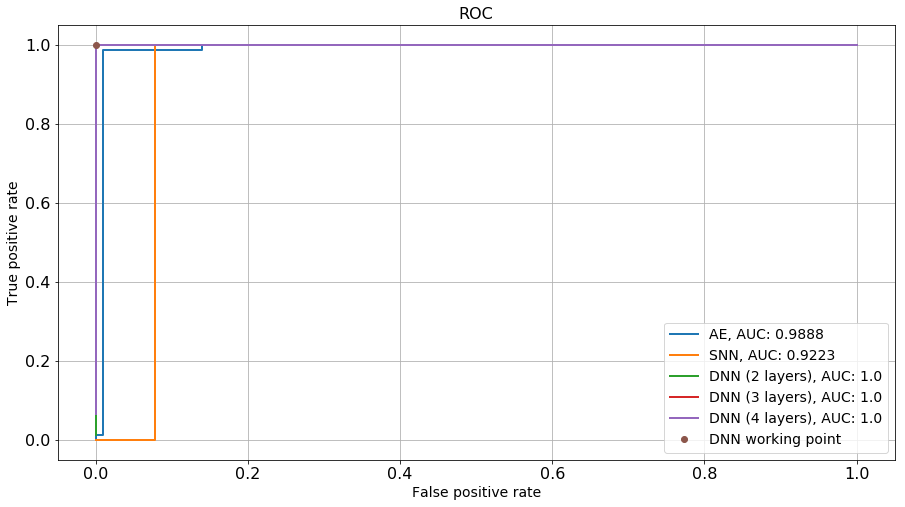

In [176]:
get_roc_curve(layers_test, 
              [
               ("AE", "cae_score"),
               ("SNN", "ann_score_1"),
               ("DNN (2 layers)", "ann_score_2"),
               ("DNN (3 layers)", "ann_score_3"),
               ("DNN (4 layers)", "ann_score_4"),
               ], (specificity_ann, sensitivity_ann))

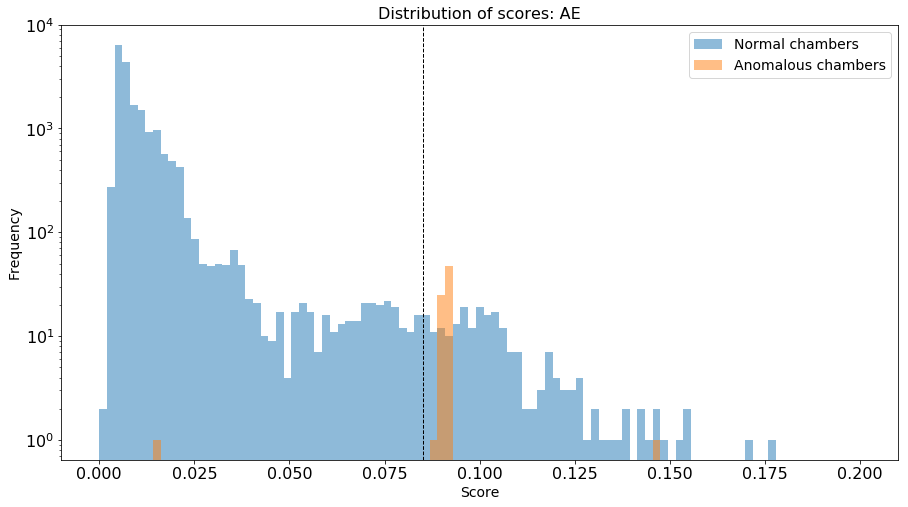

In [196]:
fig, ax = plt.subplots()
ax.set_yscale('log')
#ax.grid()
bins = np.linspace(0, 0.2, 100)
plt.hist(layers_test[layers_test["score"] < 0]["cae_score"], bins=bins,\
         alpha=0.5, label="Normal chambers")
plt.hist(layers_test[layers_test["score"] > 0]["cae_score"], bins=bins,\
         alpha=0.5, label="Anomalous chambers")
plt.title("Distribution of scores: AE")
plt.legend(loc='best')
plt.ylabel('Frequency')
plt.xlabel('Score')
plt.axvline(0.085, color='k', linestyle='dashed', linewidth=1)
plt.show()

Setting thresholds:

In [197]:
th_dnn = 0.5
th_ae = 0.085

In [180]:
import itertools
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

Normalized confusion matrix
[[ 1.  0.]
 [ 0.  1.]]


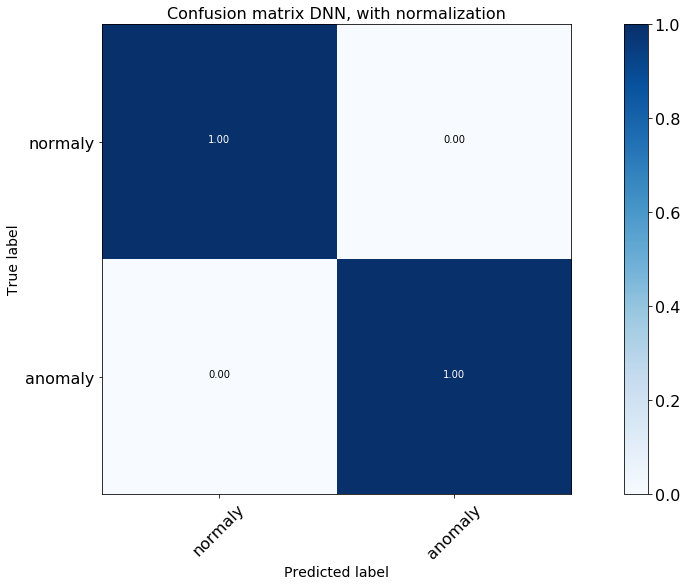

In [181]:
threshold = th_dnn
y_pred = 2*(layers_test["ann_score_4"] > threshold)-1
layers_test["score"] = 2*(layers_test["score"] > threshold)-1

cnf_matrix = confusion_matrix(layers_test["score"], y_pred)
# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=["normaly","anomaly"], normalize=True,
                      title='Confusion matrix DNN, with normalization')

Normalized confusion matrix
[[ 0.98842667  0.01157333]
 [ 0.01333333  0.98666667]]


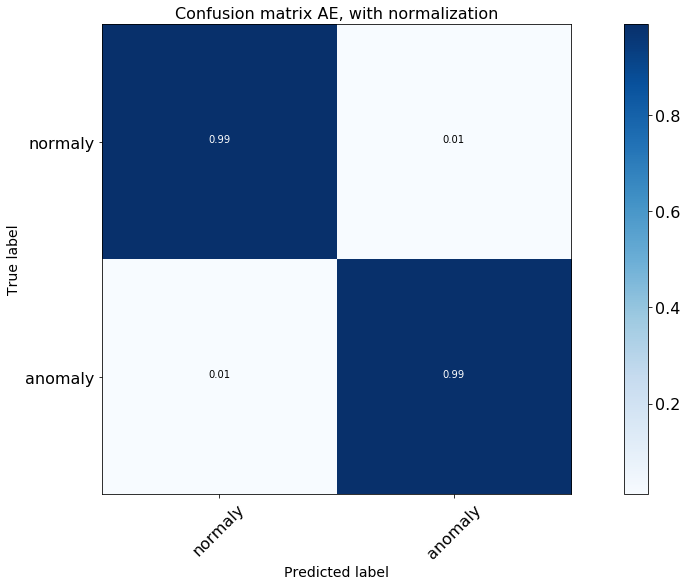

In [198]:
threshold = th_ae
y_pred = 2*(layers_test["cae_score"] > threshold)-1
cnf_matrix = confusion_matrix(layers_test["score"].astype(int), y_pred)
# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=["normaly","anomaly"], normalize=True,
                      title='Confusion matrix AE, with normalization')

In [183]:
print "Number of FPs for the DNN:", len(layers_test[(layers_test["score"] == -1) &\
                                                    (layers_test["ann_score_4"] > th_dnn)])

Number of FPs for the DNN: 0


In [199]:
print "Number of FPs for the AE:", len(layers_test[(layers_test["score"] == -1) &\
                                                   (layers_test["cae_score"] > th_ae)])

Number of FPs for the AE: 217


In [200]:
layers_test["name"] = ("W" + layers_test["wheel"].astype(str) + "_S" + layers_test["sector"].astype(str) +\
       "_St" + layers_test["station"].astype(str))

Where are the FPs located?

In [201]:
def count_fp(df, dis_nn, th, filt):
    df_temp = df[(layers_test["score"] == -1) & (layers_test[dis_nn] > th)].copy()
    df_temp = df_temp.groupby(['run', 'wheel', 'sector', 'station', 'name'])\
    .size().reset_index(name='counts')
    if filt:
        df_temp = df_temp[df_temp["counts"] > 1]
    #print df_temp
    return len(df_temp), df_temp

num_fp_ann, fp_ann = count_fp(layers_test, "ann_score_4", th_dnn, False)
num_fp_cae, fp_cae = count_fp(layers_test, "cae_score", th_ae, True)

print "Number of chambers with false positives DNN:", num_fp_ann
print "Number of chambers with false positives AE:", num_fp_cae
fp_cae.set_index("name",drop=True,inplace=True)
fp_ann.set_index("name",drop=True,inplace=True)

Number of chambers with false positives DNN: 0
Number of chambers with false positives AE: 41


In [189]:
#fp_ann["counts"].plot(kind='bar', title ="False positives DNN", legend=True, fontsize=12)

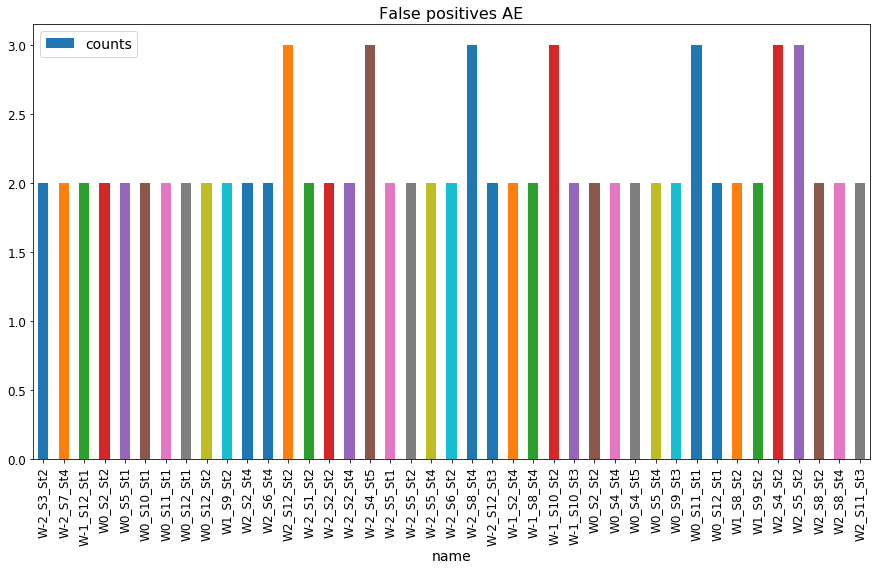

In [202]:
fp_cae["counts"].plot(kind='bar', title ="False positives AE", legend=True, fontsize=12)

In [190]:
def get_matrix(df):
    x = np.zeros((5,12),dtype=int)
    for i in range(len(df)):
        a = int(5-df["station"].iloc[i])
        b = int(df["sector"].iloc[i]-1)
        x[a,b] = x[a,b] + 1
    return x

def deduceLS(data):
    return data*10+5
layers_test["averageLS"] = layers_test["group"].apply(deduceLS)

[[0 0 0 1 0 0 0 0 0 0 0 0]
 [2 2 0 0 1 2 1 0 0 0 0 0]
 [0 0 0 0 0 0 0 0 0 0 0 0]
 [0 2 3 2 1 2 0 0 1 0 0 2]
 [1 1 2 2 1 2 1 1 0 1 1 1]]
36


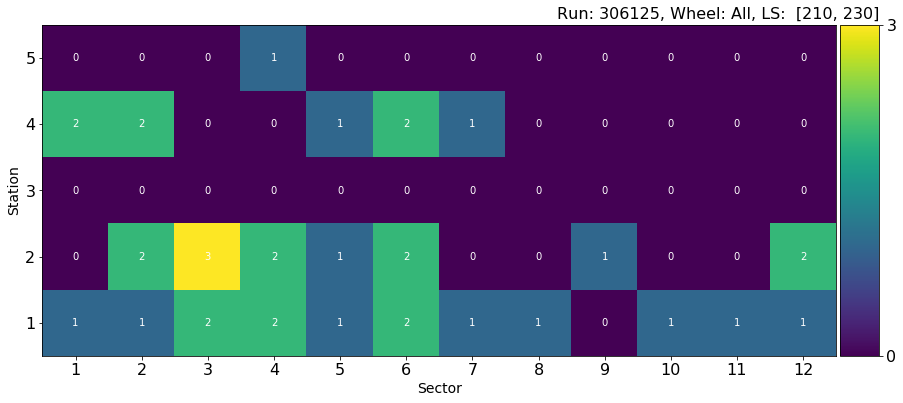

[[0 0 0 3 0 0 0 0 0 0 0 0]
 [1 3 1 0 2 2 2 3 0 1 0 1]
 [0 0 0 0 0 0 0 0 0 1 1 2]
 [2 3 3 2 2 3 1 2 1 0 1 1]
 [0 1 0 0 2 0 1 0 0 0 0 1]]
49


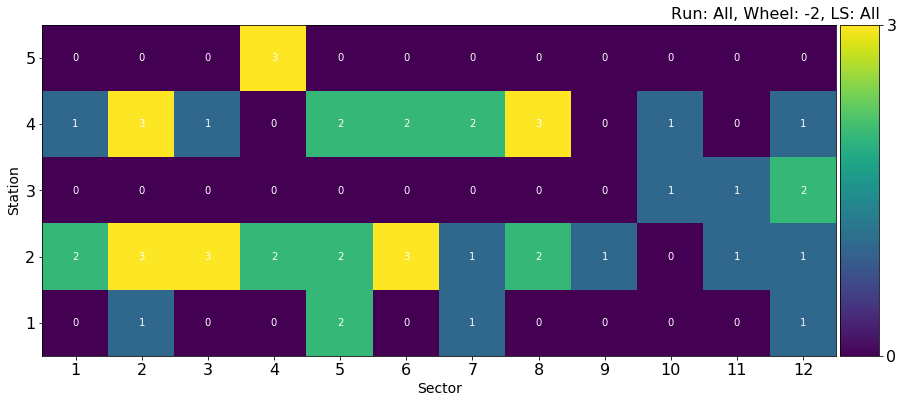

[[0 0 0 2 0 0 0 0 0 0 0 0]
 [0 2 1 0 0 1 1 2 0 1 0 0]
 [0 0 0 0 0 0 0 0 1 2 0 0]
 [1 1 2 1 1 1 0 0 0 3 2 1]
 [1 1 1 1 0 0 0 1 0 0 1 2]]
34


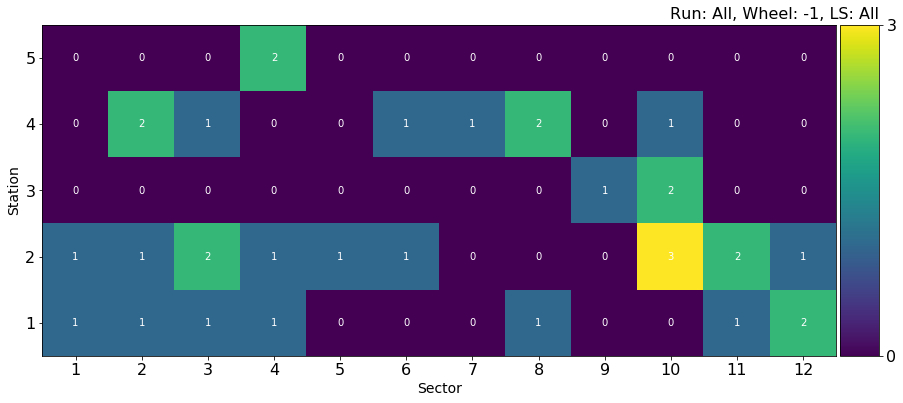

[[0 0 0 3 0 0 0 0 0 0 0 0]
 [0 1 0 2 3 0 1 0 1 0 0 1]
 [0 0 0 0 0 0 0 0 2 0 0 1]
 [1 4 1 0 1 1 0 0 1 1 2 3]
 [0 2 1 0 3 2 1 2 0 2 5 4]]
52


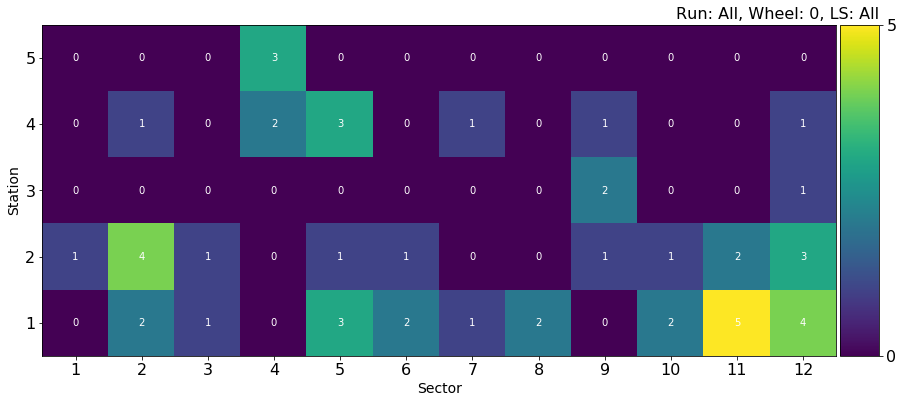

[[0 0 0 2 0 0 0 0 0 0 0 0]
 [1 0 0 1 0 1 0 0 0 1 0 0]
 [0 0 0 0 0 1 1 1 1 1 0 1]
 [0 1 2 0 1 2 1 3 4 1 1 0]
 [1 0 0 2 0 2 1 1 1 0 1 2]]
39


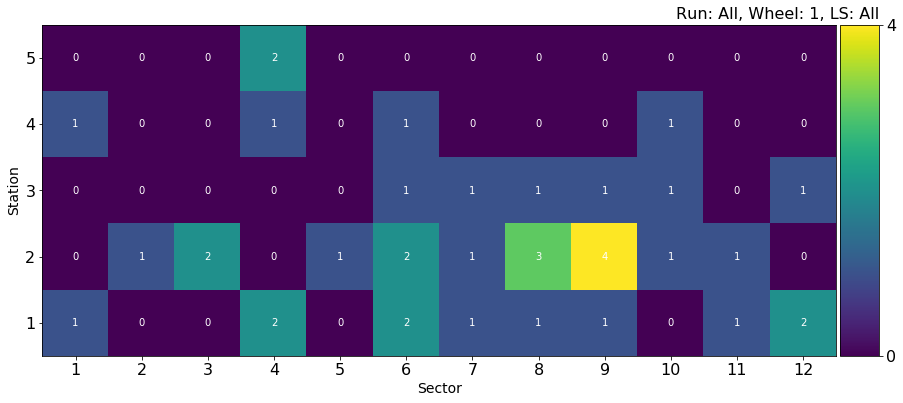

[[0 0 0 1 0 0 0 0 0 0 0 0]
 [2 2 1 0 2 3 1 2 0 0 0 0]
 [0 0 0 0 0 0 1 0 0 1 2 0]
 [1 1 0 4 3 1 1 2 1 2 1 3]
 [1 1 0 0 1 0 0 1 1 0 0 0]]
43


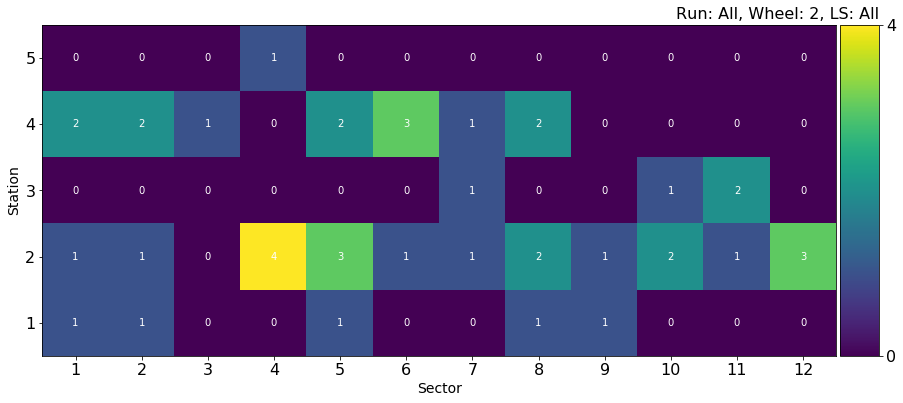

In [203]:
def plot_scatter(df, run, wheel, ls_min, ls_max):
    run_s = "All"
    wheel_s = "All"
    ls_s = "All"
    temp = df.copy()
    if wheel != -3:
        temp = temp[(temp["wheel"] == wheel)]
        wheel_s = str(wheel)
    if run != -1:
        temp = temp[(temp["run"] == run)]
        run_s = str(run)
    if ((ls_min != -1) & (ls_max == -1)):
        temp = temp[(temp["averageLS"] >= ls_min)]
        ls_s = "> "+str(ls_min)
    elif ((ls_min == -1) & (ls_max != -1)):
        temp = temp[(temp["averageLS"] <= ls_max)]
        ls_s = "< "+str(ls_max)
    elif ((ls_min != -1) & (ls_max != -1)):
        temp = temp[(temp["averageLS"] >= ls_min) & (temp["averageLS"] <= ls_max)]
        ls_s = " ["+str(ls_min)+", "+str(ls_max)+"]"
    mat = get_matrix(temp)
    print mat
    print mat.sum()

    plt.figure()
    
    ax = plt.gca()
    ax.set_yticklabels(["1", "2", "3", "4", "5"])
    ax.set_yticks([4, 3, 2, 1, 0])
    ax.set_xticklabels(["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
    ax.set_xticks([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11])
    
    plt.xlabel("Sector")
    plt.ylabel("Station")
    
    im = ax.imshow(mat, interpolation="nearest")
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    
    for i in range(0,5):
        for j in range(0,12):
            text = ax.text(j, i, mat[i, j],\
            ha="center", va="center", color="w")
    
    plt.colorbar(im, cax=cax, ticks=[np.min(np.nan_to_num(mat)), np.max(np.nan_to_num(mat))])
    title = "Run: "+run_s+", Wheel: "+wheel_s+", LS: "+ls_s
    plt.title(title, loc="right")   
    plt.show()

th = th_ae
dis_nn = "cae_score"
rule = (layers_test["score"] == -1) & (layers_test[dis_nn] > th)
plot_scatter(layers_test[rule], 306125, -3, 210, 230)

plot_scatter(layers_test[rule], -1, -2, -1, -1)
plot_scatter(layers_test[rule], -1, -1, -1, -1)
plot_scatter(layers_test[rule], -1, 0, -1, -1)
plot_scatter(layers_test[rule], -1, +1, -1, -1)
plot_scatter(layers_test[rule], -1, +2, -1, -1)

Where are the FPs located in time?

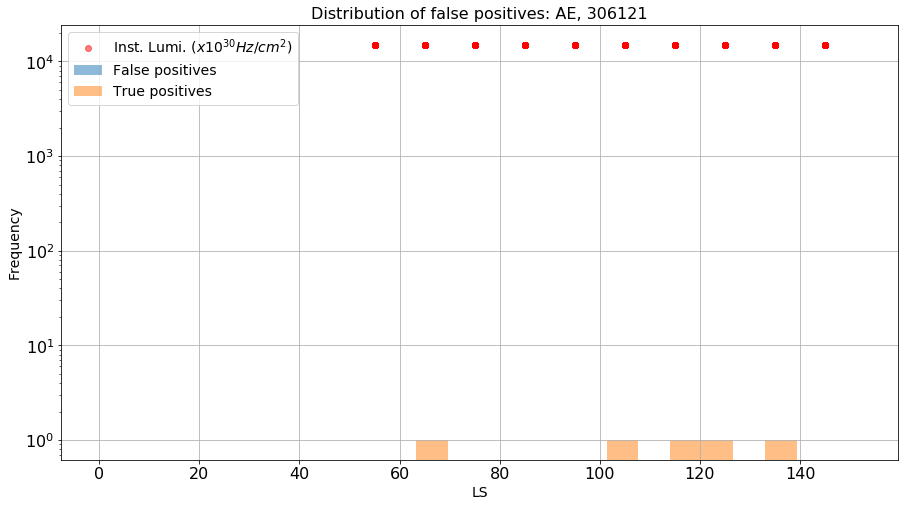

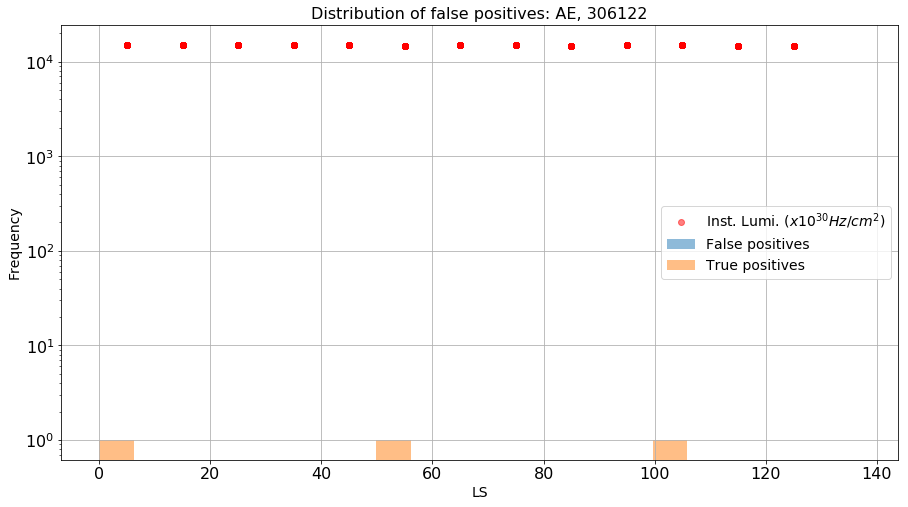

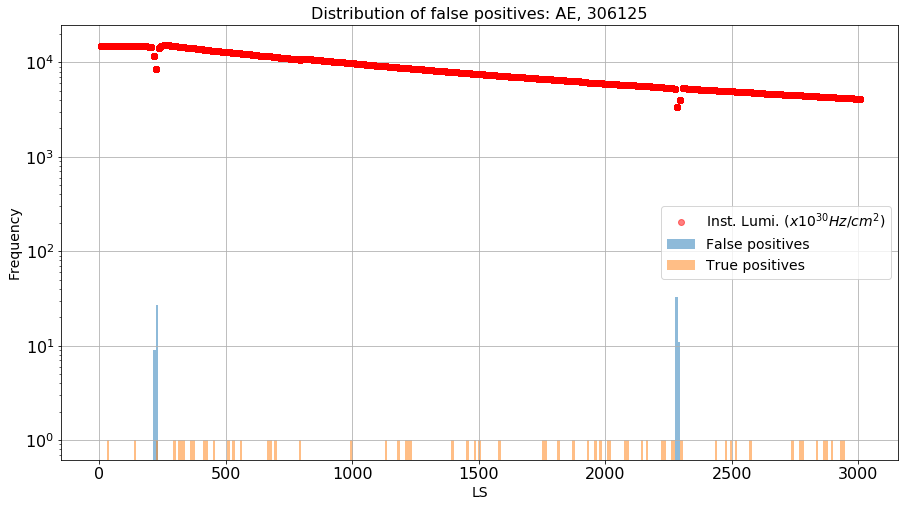

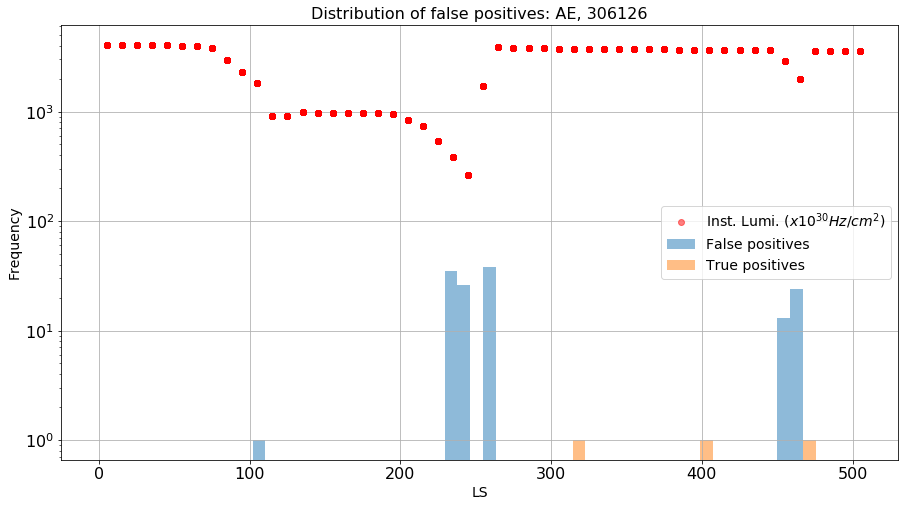

In [205]:
def plotFpVsLs(run, wheel, sector, station, title, df, algo, threshold, log, bound):
    fig, ax = plt.subplots()
    if log:
        ax.set_yscale('log')
    bins = np.linspace(0, bound, int(bound/10)+10)
    (n, bins, patches) = plt.hist(df[(df["score"] == -1) & (df[algo] > threshold)
                         #& (df["wheel"] == 2) &\
                         #& (df["sector"] == 4) &\
                         #& (df["station"] == 2) &\
                         & (df["run"] == run)\
                        ]["averageLS"],
             bins=bins, alpha=0.5, label="False positives")
    plt.hist(df[(df["score"] == 1) & (df[algo] > threshold)
                         #& (df["wheel"] == 2) &\
                         #& (df["sector"] == 4) &\
                         #& (df["station"] == 2) &\
                         & (df["run"] == run)\
                        ]["averageLS"],
             bins=bins, alpha=0.5, label="True positives")
    plt.plot(df[(df["run"] == run)]["averageLS"],\
             df[(df["run"] == run)]["lumi"], "ro",\
             alpha=0.5, label="Inst. Lumi. $(x 10^{30} Hz/cm^2)$")
    plt.title(title+str(run))
    plt.legend(loc='best')
    plt.ylabel('Frequency')
    plt.xlabel('LS')
    plt.grid(True)
    #plt.plot([bound, bound], [0, 100], color='r', linestyle='--', linewidth=2)
    plt.show()
    return n
    
threshold = th_ae
n1 = plotFpVsLs(306121, 0, 0, 0, "Distribution of false positives: AE, ", layers_test, "cae_score",\
                threshold, True, boundaries[boundaries["run"] == 306121]["ls_end"])
n2 = plotFpVsLs(306122, 0, 0, 0, "Distribution of false positives: AE, ", layers_test, "cae_score",\
                threshold, True, boundaries[boundaries["run"] == 306122]["ls_end"])
n3 = plotFpVsLs(306125, 0, 0, 0, "Distribution of false positives: AE, ", layers_test, "cae_score",\
                threshold, True, boundaries[boundaries["run"] == 306125]["ls_end"])
n4 = plotFpVsLs(306126, 0, 0, 0, "Distribution of false positives: AE, ", layers_test, "cae_score",\
                threshold, True, boundaries[boundaries["run"] == 306126]["ls_end"])

Trying some benchmark algorithms (for outlier detection). Isolation forest:

In [209]:
def variance(content):
    return np.var(content)
layers_test["variance_score"] = layers_test["content"].apply(variance)

In [210]:
def cross_validation_split(train_X, train_y, clf_i, param_grid, return_params=False):
    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=rng)
    clf = GridSearchCV(clf_i, param_grid, cv=skf, scoring='roc_auc'); 
    clf.fit(train_X, train_y)
    if return_params:
        return clf.best_params_
    return clf.best_estimator_

In [211]:
param_grid = [{"max_samples": [100, 1000],
               "n_estimators": [10, 100],
               "contamination": np.array(range(4, 13, 1))/100.0}]

ifparams = cross_validation_split(np.vstack(layers_train["content_scaled"].values),
                                 -layers_train["score"].astype(int),
                                 IsolationForest(random_state=rng, 
                                                 #verbose=1
                                                ),
                                 param_grid)

In [212]:
# Retrain IF using all unlabelled samples

ifclf = IsolationForest(max_samples=ifparams.max_samples,
                        n_estimators=ifparams.n_estimators,
                        contamination=ifparams.contamination,
                        random_state=rng)

ifclf.fit(np.vstack(normalies_train["content_scaled"].values))

IsolationForest(bootstrap=False, contamination=0.040000000000000001,
        max_features=1.0, max_samples=1000, n_estimators=10, n_jobs=1,
        random_state=<mtrand.RandomState object at 0x12b72fc30>, verbose=0)

Then use SVM for outlier detection:

In [213]:
# This may take some time... to be run on a remote machine possibly on GPU

#param_grid = [{"nu": np.array(range(1, 10, 1))/10.0,
#               "gamma": ["auto", 0.1, 0.01, 0.001, 0.0001],
#               "kernel": ["linear", "rbf"]}]

#svmparams = cross_validation_split(np.vstack(layers_train["content_scaled"].values),
#                                  -layers_train["score"].astype(int),
#                                  svm.OneClassSVM(random_state=rng, 
#                                                  verbose=1
#                                                 ),
#                                  param_grid)

In [215]:
# Retrain SVM using only good samples. For the moment using some temporary values.
svmclf = svm.OneClassSVM(
                         #nu=svmparams.nu,
                         nu=0.10000000000000001,
                         #gamma=svmparams.gamma,
                         gamma='auto',
                         kernel='linear',
                         random_state=rng
                        )
svmclf.fit(np.vstack(normalies_train["content_scaled"].values))

OneClassSVM(cache_size=200, coef0=0.0, degree=3, gamma='auto',
      kernel='linear', max_iter=-1, nu=0.1,
      random_state=<mtrand.RandomState object at 0x12b72fc30>,
      shrinking=True, tol=0.001, verbose=False)

In [216]:
layers_test["svm_score"] = -svmclf.decision_function(np.vstack(layers_test["content_scaled"].values))
layers_test["if_score"] = -ifclf.decision_function(np.vstack(layers_test["content_scaled"].values))

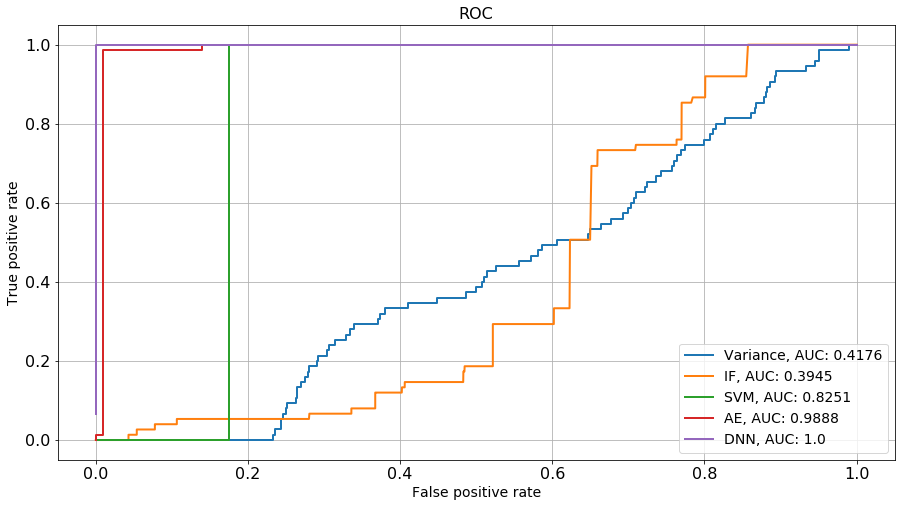

In [217]:
get_roc_curve(layers_test,[
                           ("Variance", "variance_score"),
                           ("IF", "if_score"),
                           ("SVM", "svm_score"),
                           ("AE", "cae_score"),
                           ("DNN", "ann_score_4"),
                          ]
             )

In [218]:
from sklearn import tree
from sklearn.ensemble import AdaBoostClassifier
bdt_clf = tree.DecisionTreeClassifier()
bdt_clf = bdt_clf.fit(np.vstack(layers_train["content_scaled"].values), layers_train["score"].astype(int))
layers_test["bdt_score"] = bdt_clf.predict(np.vstack(layers_test["content_scaled"].values))

In [219]:
ada_clf = AdaBoostClassifier(tree.DecisionTreeClassifier(max_depth=1),
                         algorithm="SAMME",
                         n_estimators=200)
ada_clf = ada_clf.fit(np.vstack(layers_train["content_scaled"].values), layers_train["score"].astype(int))
layers_test["ada_score"] = ada_clf.predict(np.vstack(layers_test["content_scaled"].values))

Normalized confusion matrix
[[ 1.  0.]
 [ 0.  1.]]


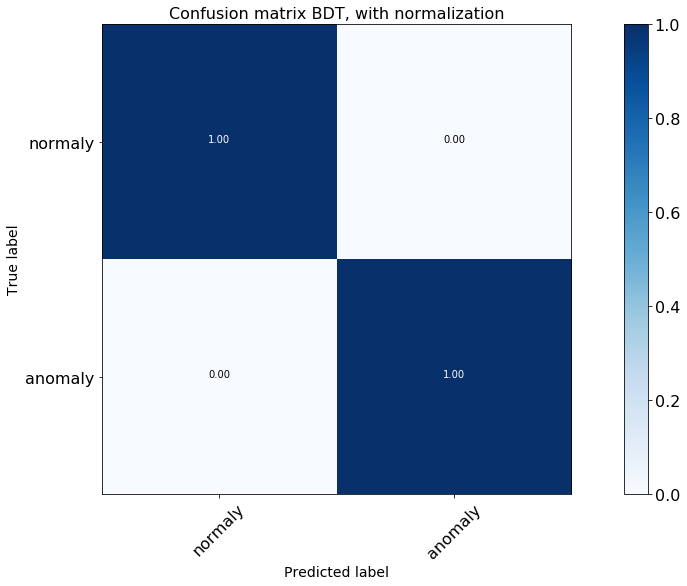

In [220]:
threshold = 0.0
y_pred = 2*(layers_test["bdt_score"] > threshold)-1
cnf_matrix = confusion_matrix(layers_test["score"].astype(int), y_pred)
# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=["normaly","anomaly"], normalize=True,
                      title='Confusion matrix BDT, with normalization')

Normalized confusion matrix
[[ 1.  0.]
 [ 0.  1.]]


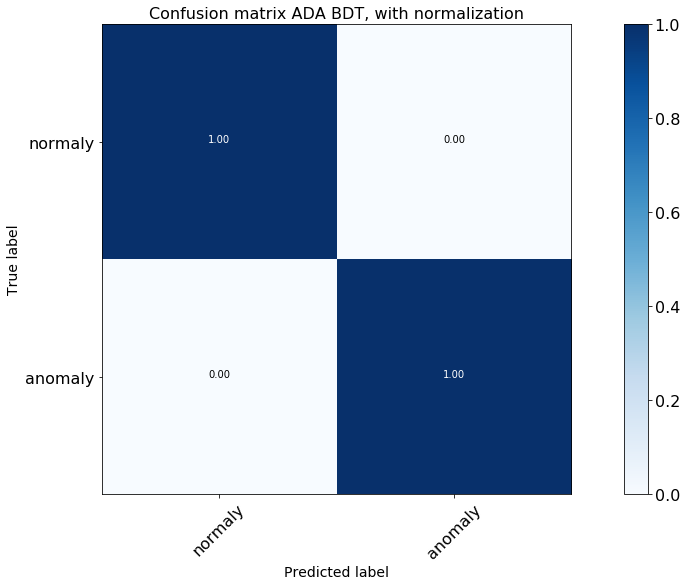

In [221]:
threshold = 0.0
y_pred = 2*(layers_test["ada_score"] > threshold)-1
cnf_matrix = confusion_matrix(layers_test["score"].astype(int), y_pred)
# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=["normaly","anomaly"], normalize=True,
                      title='Confusion matrix ADA BDT, with normalization')

Trying KNeighborsClassifier classifier:

In [222]:
from sklearn import neighbors
knclf = neighbors.KNeighborsClassifier(15, weights='distance')
knclf.fit(np.vstack(layers_train["content_scaled"].values),\
          -layers_train["score"].astype(int))

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=1, n_neighbors=15, p=2,
           weights='distance')

In [223]:
layers_test["knn_score"] = -knclf.predict(np.vstack(layers_test["content_scaled"].values))

Normalized confusion matrix
[[ 1.          0.        ]
 [ 0.01333333  0.98666667]]


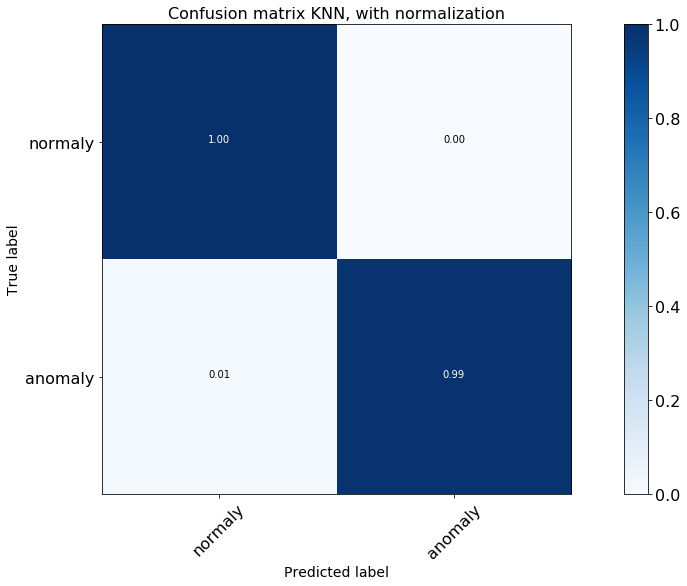

In [224]:
threshold = 0.0
y_pred = 2*(layers_test["knn_score"] > threshold)-1
cnf_matrix = confusion_matrix(layers_test["score"].astype(int), y_pred)
# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=["normaly","anomaly"], normalize=True,
                      title='Confusion matrix KNN, with normalization')

In [226]:
filename = './model_sktlearn/knn.sav'
joblib.dump(knclf, filename)

['./model_sktlearn/knn.sav']

Trying unsupervised algorithms: LOF. Optimizing LOF parameters first:

In [232]:
threshold = 0.0
result_lof = []
for i in range(5, 100, 2):
    lofclf = LocalOutlierFactor(n_neighbors=i, contamination=0.02)#It has to be a odd number
    layers_train["lof_score"] = -lofclf.fit_predict(np.vstack(layers_train["content_scaled"].values))
    y_pred = 2*(layers_train["lof_score"] > threshold)-1
    tn, fp, fn, tp = confusion_matrix(layers_train["score"].astype(int), y_pred).ravel()
    result_lof.append([i, tn, fp, fn, tp])

In [233]:
for i in range(105, 1000, 100):
    lofclf = LocalOutlierFactor(n_neighbors=i, contamination=0.02)#It has to be a odd number
    layers_train["lof_score"] = -lofclf.fit_predict(np.vstack(layers_train["content_scaled"].values))
    y_pred = 2*(layers_train["lof_score"] > threshold)-1
    tn, fp, fn, tp = confusion_matrix(layers_train["score"].astype(int), y_pred).ravel()
    result_lof.append([i, tn, fp, fn, tp])

In [234]:
for i in range(1005, 2000, 100):
    lofclf = LocalOutlierFactor(n_neighbors=i, contamination=0.02)#It has to be a odd number
    layers_train["lof_score"] = -lofclf.fit_predict(np.vstack(layers_train["content_scaled"].values))
    y_pred = 2*(layers_train["lof_score"] > threshold)-1
    tn, fp, fn, tp = confusion_matrix(layers_train["score"].astype(int), y_pred).ravel()
    result_lof.append([i, tn, fp, fn, tp])

In [235]:
fp_rate = []
tp_rate = []
for i in range(len(result_lof)):
    fp_rate.append([result_lof[i][0], result_lof[i][2]*1.0/(result_lof[i][1]+result_lof[i][2])])
    tp_rate.append([result_lof[i][0], result_lof[i][4]*1.0/(result_lof[i][3]+result_lof[i][4])])

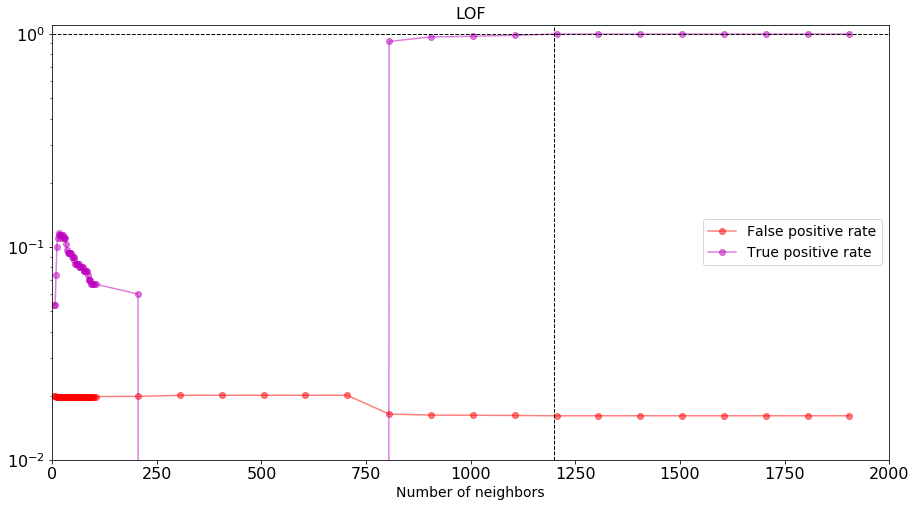

In [239]:
def plot_perf(der, rel, xaxis, yaxis, x1, x2, y1, y2, logx, logy):
    fig, ax = plt.subplots()
    if logy:
        ax.set_yscale('log')
    if logx:
        ax.set_xscale('log')
    a, b = zip(*der)
    c, d = zip(*rel)
    plt.ylim(y1, y2)
    plt.xlim(x1, x2)
    plt.plot(a, b, "ro-", alpha=0.5, label = "False positive rate")
    plt.plot(c, d, "mo-", alpha=0.5, label = "True positive rate")
    plt.axhline(1.00, color='k', linestyle='dashed', linewidth=1)
    #plt.axhline(0.01, color='g', linestyle='dashed', linewidth=1)
    if (xaxis == 'Number of neighbors'):
        plt.axvline(1200, color='k', linestyle='dashed', linewidth=1)
    elif (xaxis == 'Contamination'):
        plt.axvline(0.02, color='k', linestyle='dashed', linewidth=1)
    plt.title("LOF")
    plt.legend(loc='best')
    #plt.ylabel('Inertia')
    plt.xlabel(xaxis)
    plt.show()
    
plot_perf(fp_rate, tp_rate, 'Number of neighbors', '', 0, 2000, 0.01, 1.1, False, True)

In [240]:
threshold = 0.0
result_lof = []
for i in np.array(range(1, 500, 5))/1000.0:
    lofclf = LocalOutlierFactor(n_neighbors=1205, contamination=i)#It has to be a odd number
    layers_train["lof_score"] = -lofclf.fit_predict(np.vstack(layers_train["content_scaled"].values))
    y_pred = 2*(layers_train["lof_score"] > threshold)-1
    tn, fp, fn, tp = confusion_matrix(layers_train["score"].astype(int), y_pred).ravel()
    result_lof.append([i, tn, fp, fn, tp])

In [241]:
fp_rate_c = []
tp_rate_c = []
for i in range(len(result_lof)):
    fp_rate_c.append([result_lof[i][0], result_lof[i][2]*1.0/(result_lof[i][1]+result_lof[i][2])])
    tp_rate_c.append([result_lof[i][0], result_lof[i][4]*1.0/(result_lof[i][3]+result_lof[i][4])])

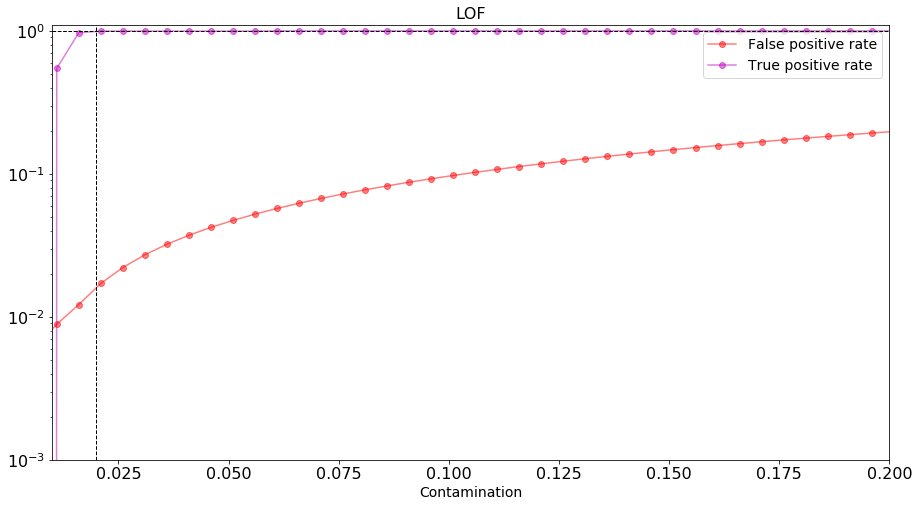

In [242]:
plot_perf(fp_rate_c, tp_rate_c, 'Contamination', '', 0.01, 0.2, 0.001, 1.1, False, True)

Choosing ...

In [244]:
# fit the model
lofclf = LocalOutlierFactor(n_neighbors=1205, contamination=0.02)#It has to be a odd number
layers_train["lof_score"] = -lofclf.fit_predict(np.vstack(layers_train["content_scaled"].values))

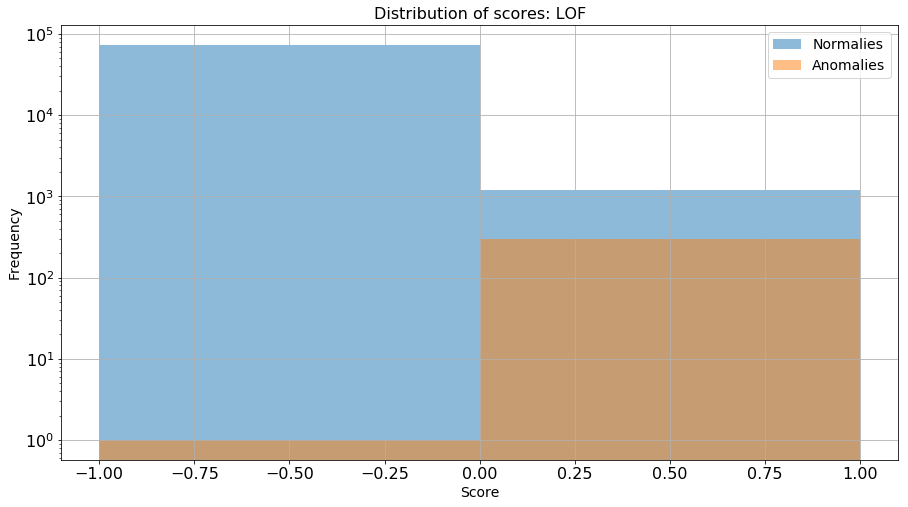

In [245]:
fig, ax = plt.subplots()
ax.set_yscale('log')
ax.grid()
bins = np.linspace(-1, +1, 3)
plt.hist(layers_train[layers_train["score"] < 0]["lof_score"], bins=bins, alpha=0.5, label="Normalies")
plt.hist(layers_train[layers_train["score"] > 0]["lof_score"], bins=bins, alpha=0.5, label="Anomalies")
plt.title("Distribution of scores: LOF")
plt.legend(loc='best')
plt.ylabel('Frequency')
plt.xlabel('Score')
plt.show()

Normalized confusion matrix
[[ 0.98390667  0.01609333]
 [ 0.00333333  0.99666667]]


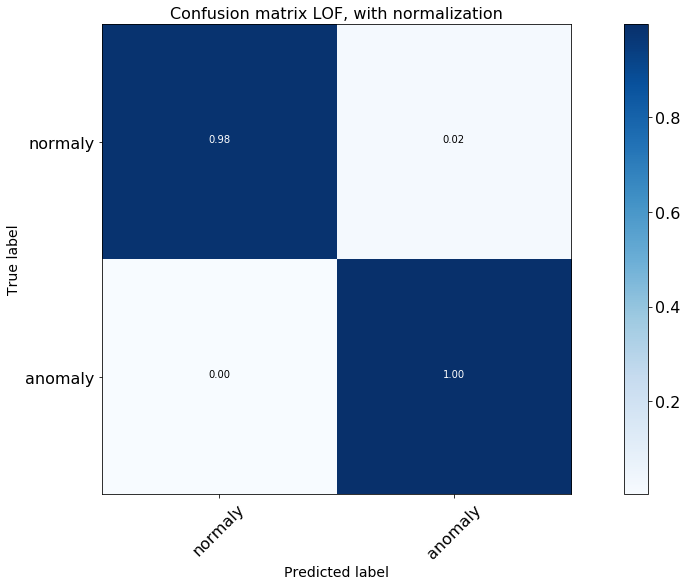

In [246]:
threshold = 0.0
y_pred = 2*(layers_train["lof_score"] > threshold)-1
cnf_matrix = confusion_matrix(layers_train["score"].astype(int), y_pred)
# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=["normaly","anomaly"], normalize=True,
                      title='Confusion matrix LOF, with normalization')

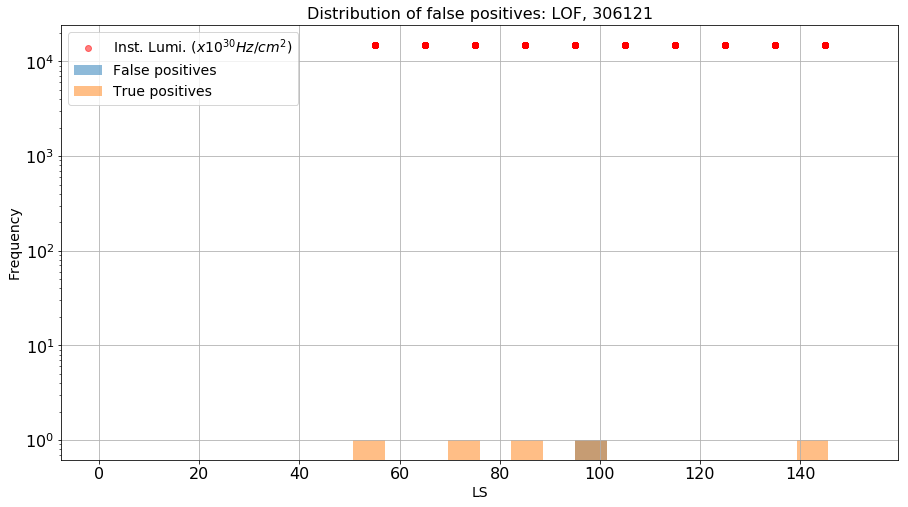

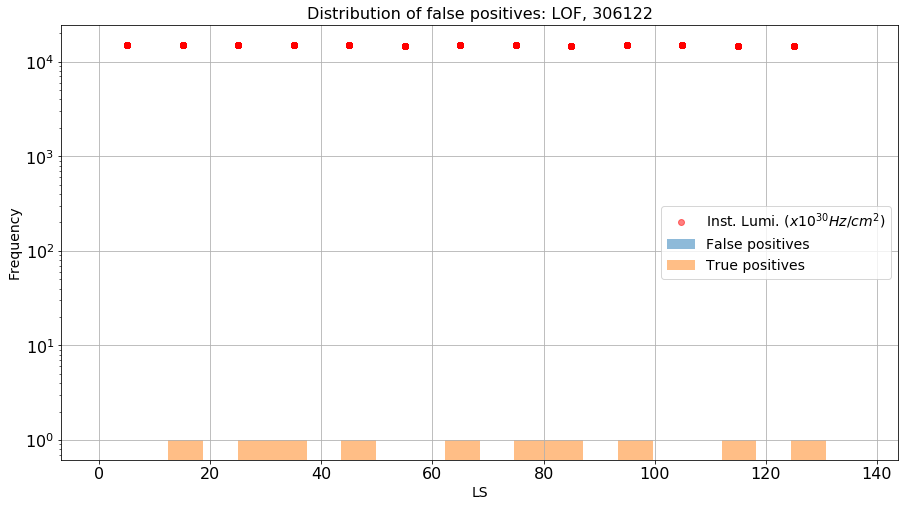

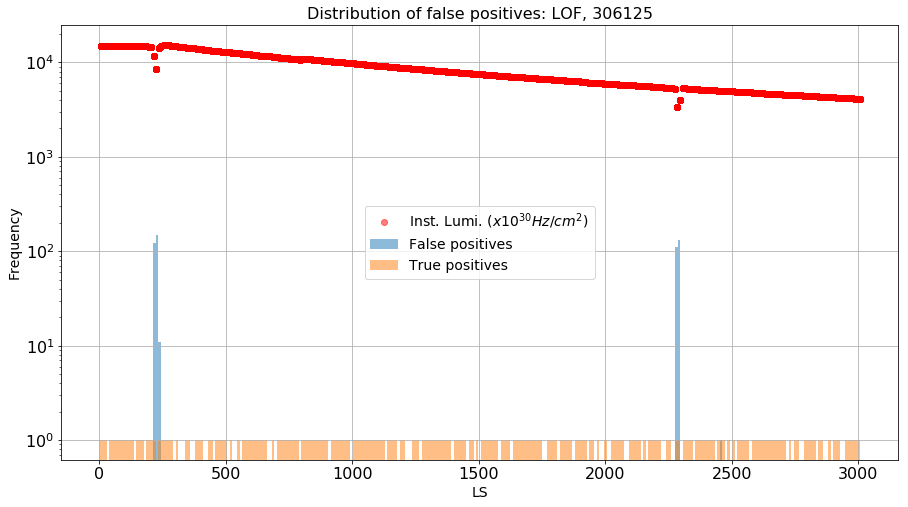

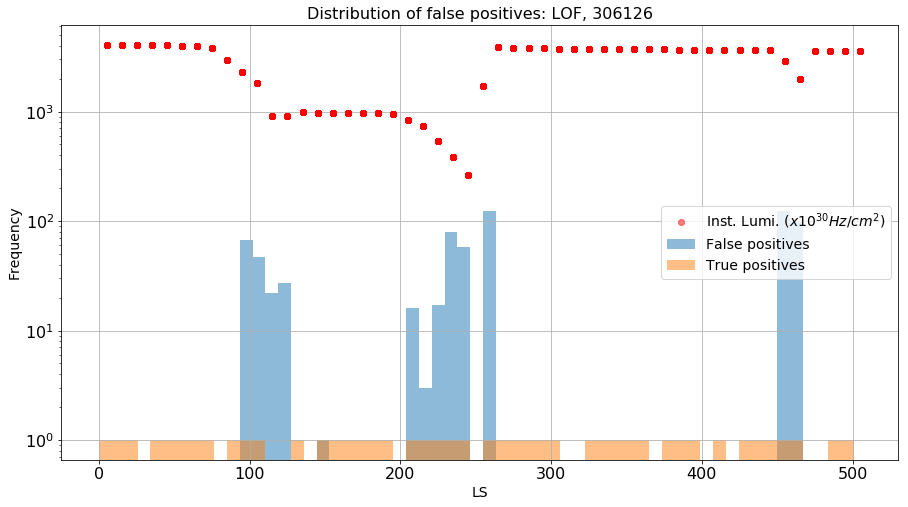

array([   0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.,   67.,   47.,   22.,   27.,    0.,    0.,    1.,
          0.,    0.,    0.,    0.,    0.,    0.,   16.,    3.,   17.,
         79.,   58.,    0.,  123.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
          0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,  124.,
         97.,    0.,    0.,    0.,    0.])

In [247]:
layers_train["averageLS"] = layers_train["group"].apply(deduceLS)
threshold = 0.0
plotFpVsLs(306121, 0, 0, 0, "Distribution of false positives: LOF, ", layers_train, "lof_score",\
           threshold, True, boundaries[boundaries["run"] == 306121]["ls_end"])
plotFpVsLs(306122, 0, 0, 0, "Distribution of false positives: LOF, ", layers_train, "lof_score",\
           threshold, True, boundaries[boundaries["run"] == 306122]["ls_end"])
plotFpVsLs(306125, 0, 0, 0, "Distribution of false positives: LOF, ", layers_train, "lof_score",\
           threshold, True, boundaries[boundaries["run"] == 306125]["ls_end"])
plotFpVsLs(306126, 0, 0, 0, "Distribution of false positives: LOF, ", layers_train, "lof_score",\
           threshold, True, boundaries[boundaries["run"] == 306126]["ls_end"])

Trying KMeans clustering algorithm. First of all let's find the optimal number of clusters (parameter to the algorithm) by scanning the average distance vs. number of clusters:

In [ ]:
means = []
for i in range(1, 300, 10):
    print i
    k_means = cluster.KMeans(n_clusters=i)
    k_means.fit(np.vstack(normalies_train["content_scaled"].values))
    means.append([i, k_means.inertia_])

1
11
21
31
41
51
61
71
81
91
101
111
121
131
141
151
161
171
181
191
201
211
221
231
241
251
261
271
281
291


In [ ]:
for i in range(300, 500, 10):
    print i
    k_means = cluster.KMeans(n_clusters=i)
    k_means.fit(np.vstack(normalies_train["content_scaled"].values))
    means.append([i, k_means.inertia_])

300
310
320
330
340
350
360
370
380
390
400
410
420
430
440
450
460


In [ ]:
for i in range(500, 1000, 100):
    print i
    k_means = cluster.KMeans(n_clusters=i)
    k_means.fit(np.vstack(normalies_train["content_scaled"].values))
    means.append([i, k_means.inertia_])

In [ ]:
for i in range(1000, 2000, 200):
    print i
    k_means = cluster.KMeans(n_clusters=i)
    k_means.fit(np.vstack(normalies_train["content_scaled"].values))
    means.append([i, k_means.inertia_])

In [ ]:
for i in range(2, 10, 1):
    print i
    k_means = cluster.KMeans(n_clusters=i)
    k_means.fit(np.vstack(normalies_train["content_scaled"].values))
    means.append([i, k_means.inertia_])

In [ ]:
def getKey(item):
    return item[0]

means = sorted(means, key=getKey)

In [ ]:
der = []
for i in range(0, len(means)-1):
    x, y = zip(*means)
    a = np.sqrt(y[i]/len(normalies_train))
    b = np.sqrt(y[i+1]/len(normalies_train))
    delta = (a-b)/a
    der.append([x[i], delta])

In [ ]:
rel = []
for i in range(0, len(means)-1):
    x, y = zip(*means)
    a = np.sqrt(y[i]/len(normalies_train))
    b = np.sqrt(y[i+1]/len(normalies_train))
    delta = (a-b)*100000/y[0]
    rel.append([x[i], delta])

In [ ]:
def plotDist(means, der, rel):
    fig, ax = plt.subplots()
    ax.set_yscale('log')
    ax.set_xscale('log')
    x, y = zip(*means)
    a, b = zip(*der)
    c, d = zip(*rel)
    plt.ylim(0.0001, 10.)
    plt.xlim(1, 2000)
    plt.plot(x, np.sqrt(np.array(y)/len(normalies_train)), "bo-", alpha=0.5, label="Average distance")
    plt.plot(a, b, "ro-", alpha=0.5, label = "Relative variation: (d$_{cls}$ - d$_{cls+1}$)/d$_{cls}$")
    plt.plot(c, d, "mo-", alpha=0.5, label = "Relative variation: (d$_{cls}$ - d$_{cls+1}$)/d$_{cls = 1}$\
    (x$10^{-5}$)")
    plt.axhline(0.05, color='k', linestyle='dashed', linewidth=1)
    plt.axhline(0.01, color='g', linestyle='dashed', linewidth=1)
    plt.axvline(100, color='k', linestyle='dashed', linewidth=1)
    plt.axvline(500, color='y', linestyle='dashed', linewidth=1)
    plt.title("K-Means clustering")
    plt.legend(loc='best')
    #plt.ylabel('Inertia')
    plt.xlabel('Number of clusters')
    plt.show()
    
plotDist(means, der, rel)

Choosing 450 clusters and training on the normalies only:

In [384]:
n_cls = 450
k_means = cluster.KMeans(n_clusters=n_cls)
distances = k_means.fit_transform(np.vstack(normalies["content_scaled"].values))
normalies["kmeans_score"] = k_means.labels_

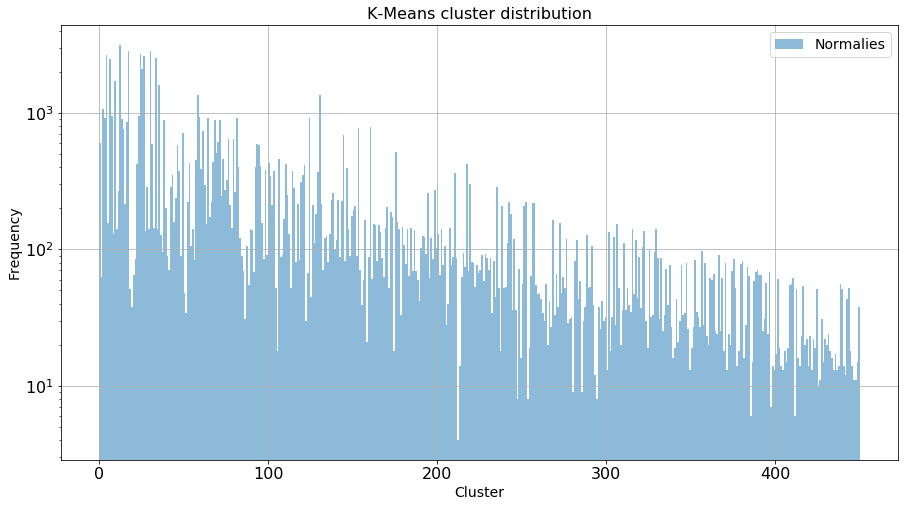

In [385]:
fig, ax = plt.subplots()
ax.set_yscale('log')
ax.grid()
bins = np.linspace(0, n_cls, n_cls+1)
plt.hist(normalies[normalies["score"] < 0]["kmeans_score"], bins=bins, alpha=0.5, label="Normalies")
#plt.hist(normalies[normalies["score"] > 0]["kmeans_score"], bins=bins, alpha=0.5, label="Anomalies")
plt.title("K-Means cluster distribution")
plt.legend(loc='best')
plt.ylabel('Frequency')
plt.xlabel('Cluster')
plt.show()

The minimal distance is used to assign the data to the clusters. Visualize the average distance within a cluster:

In [386]:
minim = []
for i in range(0, len(distances)):
    #print  min(distances[i])
    minim.append(min(distances[i]))

In [387]:
#print len(minim)
normalies["dist"] = minim
#print normalies["dist"]

In [388]:
temp1 = normalies.groupby(["kmeans_score"])[["dist"]].mean().reset_index()        

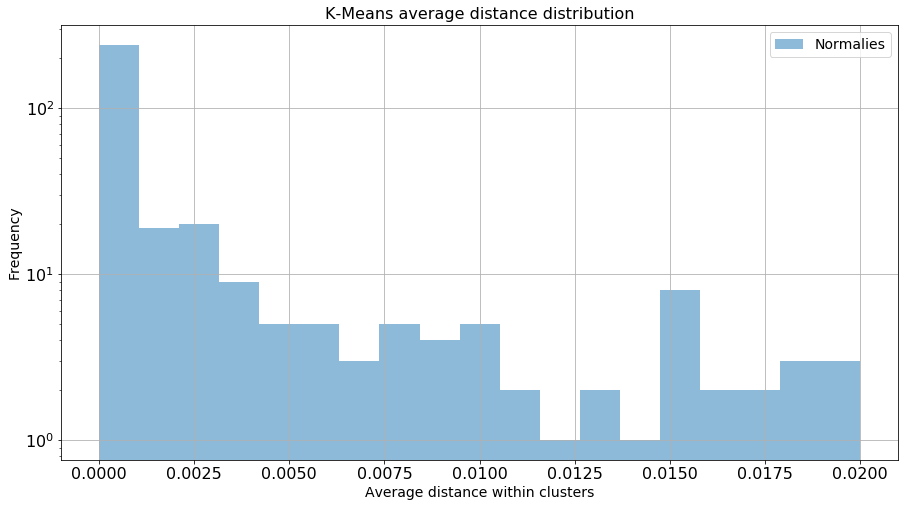

In [389]:
fig, ax = plt.subplots()
ax.set_yscale('log')
ax.grid()
bins = np.linspace(0, 0.02, 20)
plt.hist(temp1["dist"], bins=bins, alpha=0.5, label="Normalies")
plt.title("K-Means average distance distribution")
plt.legend(loc='best')
plt.ylabel('Frequency')
plt.xlabel('Average distance within clusters')
plt.show()

Predicting the distances of the test sample data with respect to the clusters and plotting the minimum distance for each point (dividing anomalies and normalies):

In [390]:
distances_test = k_means.transform(np.vstack(layers_test["content_scaled"].values))
minim = []
for i in range(0, len(distances_test)):
    #print  min(distances_test[i])
    minim.append(min(distances_test[i]))
layers_test["dist"] = minim

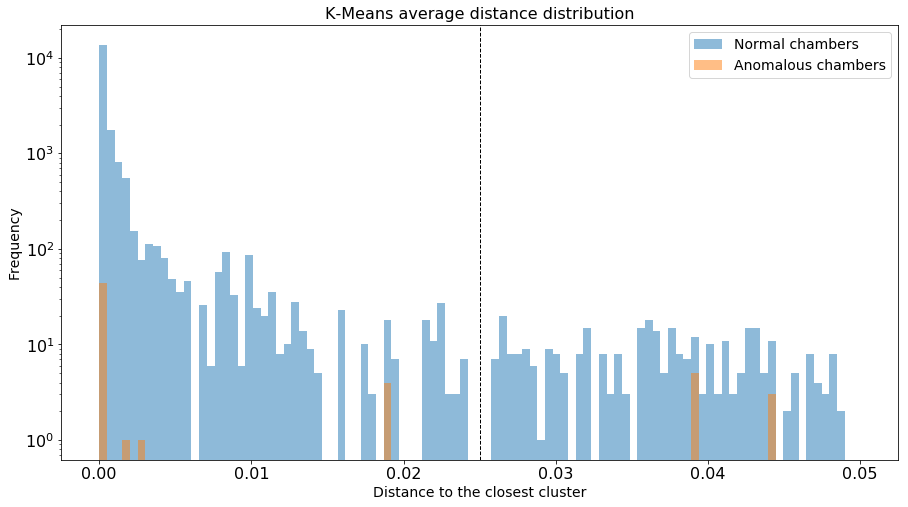

In [391]:
fig, ax = plt.subplots()
ax.set_yscale('log')
#ax.grid()
bins = np.linspace(0, 0.05, 100)
plt.hist(layers_test[layers_test["score"] < 0]["dist"], bins=bins, alpha=0.5, label="Normal chambers")
plt.hist(layers_test[layers_test["score"] > 0]["dist"], bins=bins, alpha=0.5, label="Anomalous chambers")
plt.axvline(0.025, color='k', linestyle='dashed', linewidth=1)
plt.title("K-Means average distance distribution")
plt.legend(loc='best')
plt.ylabel('Frequency')
plt.xlabel('Distance to the closest cluster')
plt.show()

Normalized confusion matrix
[[ 0.96437333  0.03562667]
 [ 0.66666667  0.33333333]]


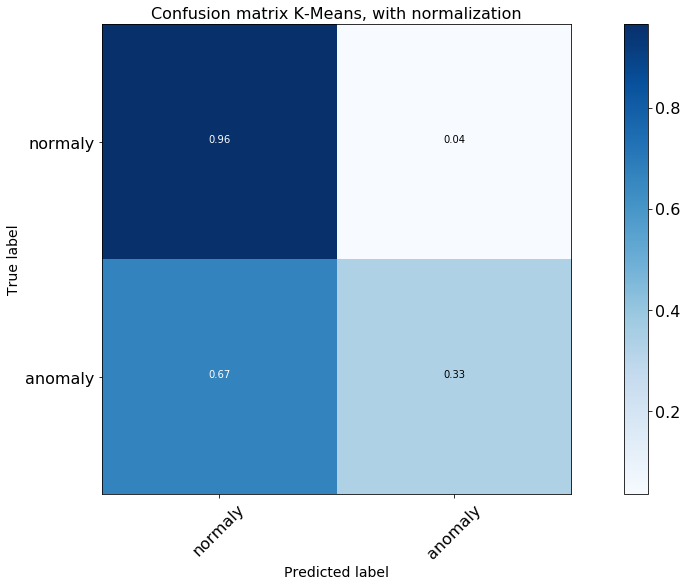

In [392]:
th_km = 0.025
y_pred = 2*(layers_test["dist"] > th_km)-1
cnf_matrix = confusion_matrix(layers_test["score"].astype(int), y_pred)
# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=["normaly","anomaly"], normalize=True,
                      title='Confusion matrix K-Means, with normalization')

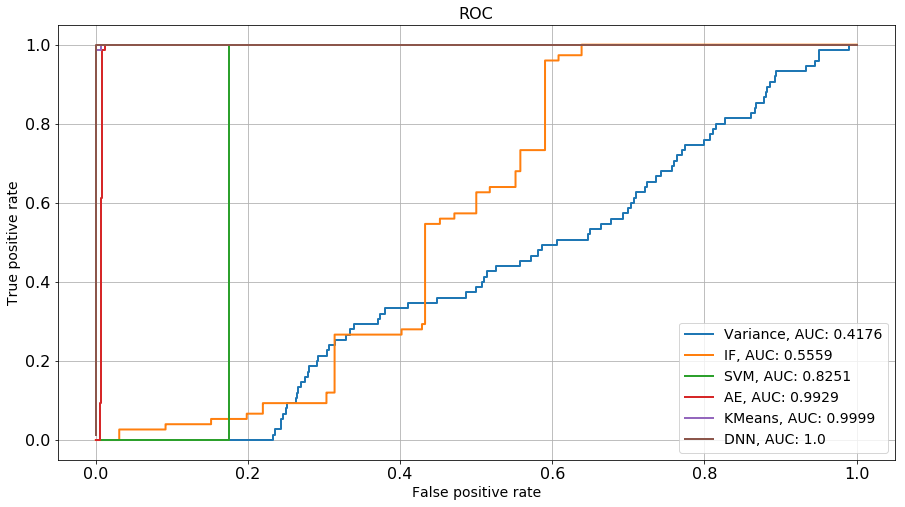

In [345]:
get_roc_curve(layers_test,[
                           ("Variance", "variance_score"),
                           ("IF", "if_score"),
                           ("SVM", "svm_score"),
                           ("AE", "cae_score"),
                           ("KMeans", "dist"),
                           ("DNN", "ann_score_4"),
                          ]
             )

In [346]:
filename = './model_sktlearn/kmeans.sav'
joblib.dump(k_means, filename)

['./model_sktlearn/kmeans.sav']